# TSNE Visualization

In [1]:
import os
import pandas as pd
import numpy as np

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN
from sklearn import metrics

import torch

from PIL import Image

from tqdm import tqdm


import matplotlib.pyplot as plt

from bring_features_and_file_paths import bring_features_and_file_paths
from bring_features_and_file_paths import get_BirdNET_detections

## Bring all the features and file paths

In [2]:
features_path = '/projects/MultiActiveAI/Samir_VICReg_Outputs/features_second_pass'
indices_path = '/projects/MultiActiveAI/Samir_VICReg_Outputs/indices_first_pass/exclude_indices.pth'
save_dpath = '/projects/MultiActiveAI/Samir_VICReg_Outputs/tsne_outputs_final'
# save_dpath = '/projects/MultiActiveAI/Samir_VICReg_Outputs/tsne_outputs_repetition'

In [3]:
features, file_paths = bring_features_and_file_paths(features_path)

We have 2136286 feature vectors.


In [4]:
altered_gain_indices = set()

for idx, fpath in tqdm(enumerate(file_paths)):
    fpath = ''.join([chr(int(x)) for x in fpath])
    try:
        if fpath.split('/')[1] in {"00004879", "00023764"}:
            altered_gain_indices.add(idx)
    except IndexError:
        continue

2136286it [04:21, 8177.59it/s]


In [4]:
exclude_indices = set(torch.load(indices_path))
# exclude_indices = set(torch.load(indices_path)) | altered_gain_indices
include_indices = [idx for idx in range(len(features)) if idx not in exclude_indices]
features = features[include_indices]
file_paths = file_paths[include_indices]

In [5]:
# do subsample manually
sub_sample = 0.1
assert sub_sample > 0.0 and sub_sample < 1.0
number_of_rows = features.shape[0]
n_samples = int(features.shape[0] * sub_sample)
indices = np.random.choice(number_of_rows, size=n_samples, replace=False)
features = features[indices, :]
file_paths = file_paths[indices, :]
print("We have {} feature vectors.".format(features.shape[0]))
#features, file_paths, indices = bring_features_and_file_paths('/grand/projects/BirdAudio/Soundscapes/Second_Features', sub_sample=0.1)
#features, file_paths, indices = bring_features_and_file_paths('/grand/projects/BirdAudio/Soundscapes/Features', sub_sample=0.99)
#features, file_paths, indices = bring_features_and_file_paths('/grand/projects/BirdAudio/Soundscapes/Xeno_Canto_Features/', sub_sample=0.999)

We have 197813 feature vectors.


In [6]:
features.shape

torch.Size([197813, 2048])

In [7]:
pca = PCA(n_components=50, svd_solver='full')
pca.fit(features)
pca_features = pca.transform(features)
pca_features.shape

(197813, 50)

In [8]:
fname='f_embedded.npy'
if not os.path.isfile(os.path.join(save_dpath, fname)):
    f_embedded = TSNE(n_components=2, learning_rate='auto', init='pca', perplexity=50).fit_transform(pca_features)
    f_embedded.shape
    np.save(os.path.join(save_dpath, fname), f_embedded)
else:
    f_embedded = np.load(os.path.join(save_dpath, fname))

/lus/theta-fs0/software/thetagpu/conda/2021-09-22/mconda3/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


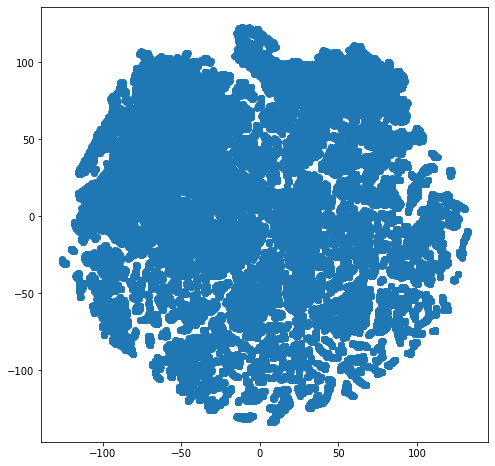

In [9]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot()
ax.scatter(f_embedded[:,0],f_embedded[:,1])

In [10]:
labels = DBSCAN(eps=1.2, min_samples=35).fit_predict(f_embedded)
# labels = DBSCAN(eps=2.0, min_samples=00).fit_predict(f_embedded) => 0.56, 

core_samples_mask = np.zeros_like(labels, dtype=bool)
core_samples_mask[labels != -1] = True
n_noise_points = list(labels).count(-1)
#set(label_predictions)

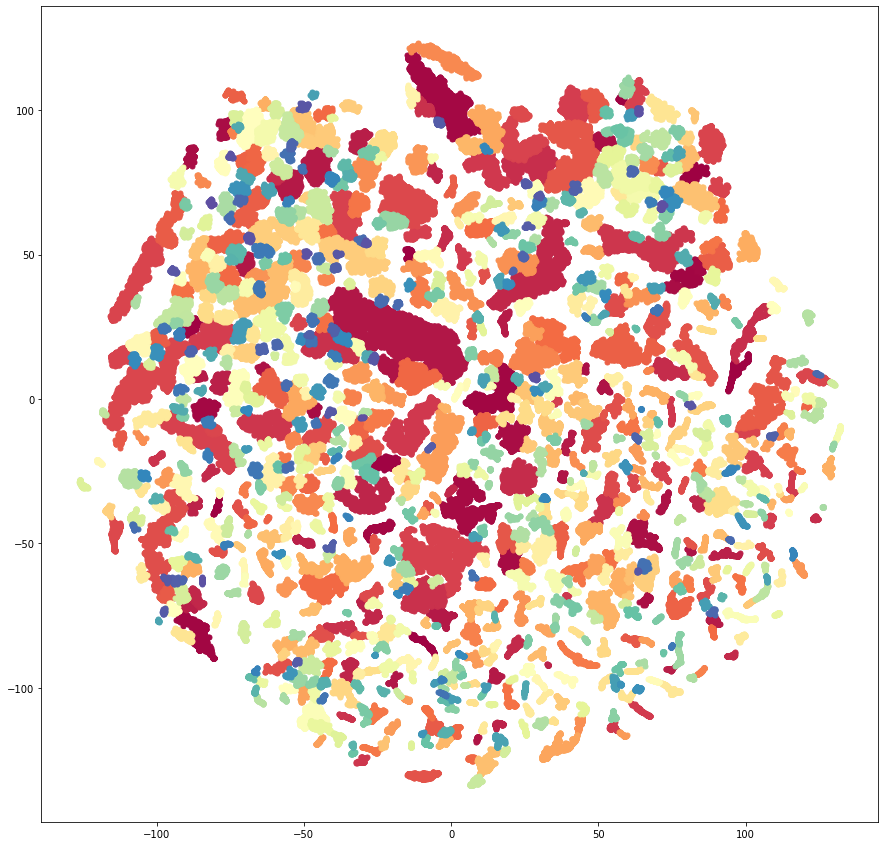

In [11]:
# Black removed and is used for noise instead.
print_outliers=False
unique_labels = set(labels)
colors = [plt.cm.Spectral(each) for each in np.linspace(0, 1, len(unique_labels))]

fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111)
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = labels == k
    #class_member_mask = labels == k
    xy = f_embedded[class_member_mask & core_samples_mask]
    ax.plot(
        xy[:, 0],
        xy[:, 1],
        "o",
        markerfacecolor=tuple(col),
        #markeredgecolor="k",
        markeredgecolor=col,
        markersize=5,
#         markersize=0.25,
    )

    if print_outliers:
        xy = f_embedded[class_member_mask & ~core_samples_mask]
        ax.plot(
            xy[:, 0],
            xy[:, 1],
            "o",
            markerfacecolor=tuple(col),
            markeredgecolor="k",
            markersize=0.1,
        )

fig.set_size_inches(15, 15)

In [12]:
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)
n_points_ = labels.shape[0]


print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)
print("Estimated number of labeled points: %d" % n_points_)
print(int(100*n_noise_/n_points_), "% of points in the data is noise")

Estimated number of clusters: 919
Estimated number of noise points: 17278
Estimated number of labeled points: 197813
8 % of points in the data is noise


In [13]:
features=f_embedded
labels=labels

In [14]:
image_paths=[]
features=[]
LABELS=[]
for fpath, feat, label in zip(file_paths,f_embedded,labels):
    if label != -1:
        file_path = ''.join([chr(int(x)) for x in fpath]).replace('~','')
        image_paths.append(file_path)
        features.append(feat)
        LABELS.append(label)
        print(file_path)

image_paths=np.array(image_paths)
features=np.array(features)
labels=np.array(LABELS)

set1/00023764/20210607_STUDY/20210607T050000+0000_REC_198.png
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_220.png
set1/00023764/20210531_STUDY/20210531T100000+0000_REC_118.png
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_1764.png
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_608.png
set1/00023764/20210530_STUDY/20210530T180000+0000_REC_112.png
set1/00023764/20210609_STUDY/20210609T200000+0000_REC_284.png
set1/00023771/20210704_STUDY/20210704T030852-0500_Rec_250.png
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_1250.png
set1/00023764/20210604_STUDY/20210604T040000+0000_REC_99.png
set2/00023757/20210718_STUDY/20210718T030852-0500_Rec_430.png
set1/00023795/20210630_STUDY/20210630T170006-0500_Rec_635.png
set1/00023795/20210630_STUDY/20210630T095441-0500_Rec_735.png
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_21.png
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_1579.png
set2/00023795/20210716_STUDY/20210716T170006-0500_Rec_332.png
set2/00

set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_1056.png
set1/00023788/20210630_schedule/20210630T030852-0500_Rec_1011.png
set1/00023764/20210525_STUDY/20210525T150000+0000_REC_46.png
set1/00023764/20210525_STUDY/20210525T010000+0000_REC_21.png
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_2543.png
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_2444.png
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_305.png
set3/00023734/20210813_STUDY/20210813T030845-0500_Rec_1349.png
set1/00023764/20210612_STUDY/20210612T010000+0000_REC_275.png
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_104.png
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1565.png
set3/00023734/20210813_STUDY/20210813T202300-0500_Rec_511.png
set1/00023764/20210615_STUDY/20210615T040000+0000_REC_35.png
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_2467.png
set3/00023757/20210817_STUDY/20210817T202300-0500_Rec_1.png
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_2572.png
se

set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_2301.png
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_2650.png
set2/00023734/20210720_STUDY/20210720T170008-0500_Rec_842.png
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_552.png
set1/00023764/20210528_STUDY/20210528T140000+0000_REC_293.png
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_886.png
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_980.png
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_971.png
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_1541.png
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_2530.png
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_2062.png
set1/00023788/20210704_schedule/20210704T202300-0500_Rec_1241.png
set2/00023734/20210720_STUDY/20210720T030853-0500_Rec_716.png
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_1214.png
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_171.png
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_440

set1/00023764/20210613_STUDY/20210613T090000+0000_REC_334.png
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_768.png
set3/00023734/20210817_STUDY/20210817T131739-0500_Rec_1106.png
set3/00023788/20210813_schedule/20210813T131729-0500_Rec_205.png
set1/00023764/20210526_STUDY/20210526T200000+0000_REC_5.png
set1/00023795/20210629_STUDY/20210629T164024-0500_Rec_69.png
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_1155.png
set2/00023700/20210715_STUDY/20210715T202300-0500_Rec_927.png
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_1062.png
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_1285.png
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_1251.png
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_1481.png
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_415.png
set1/00023757/20210703_STUDY/20210703T234600-0500_Rec_1029.png
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_54.png
set2/00023771/20210717_STUDY/20210717T202300-0500_Rec_750.png

set2/00023764/20210728_STUDY/20210728T131727+0000_REC_220.png
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_2273.png
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_436.png
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_2436.png
set1/00023788/20210630_schedule/20210630T131737-0500_Rec_259.png
set2/00023795/20210722_STUDY/20210722T131736-0500_Rec_1075.png
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_63.png
set1/00023771/20210704_STUDY/20210704T202300-0500_Rec_1317.png
set2/00023771/20210717_STUDY/20210717T063148-0500_Rec_876.png
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_2286.png
set1/00023734/20210706_STUDY/20210706T063149-0500_Rec_1267.png
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_1219.png
set1/00023764/20210605_STUDY/20210605T180000+0000_REC_24.png
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_713.png
set2/00023700/20210716_STUDY/20210716T170000-0500_Rec_730.png
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_1306.

set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_976.png
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_52.png
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_1553.png
set3/00023734/20210815_STUDY/20210815T170008-0500_Rec_287.png
set1/00023764/20210531_STUDY/20210531T010000+0000_REC_398.png
set2/00004862/20210720_STUDY/20210720T131728-0500_Rec_523.png
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_2692.png
set2/00023788/20210716_schedule/20210716T095442-0500_Rec_27.png
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_1590.png
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_2212.png
set2/00023757/20210715_STUDY/20210715T030845-0500_Rec_1250.png
set1/00023771/20210701_STUDY/20210701T095442-0500_Rec_772.png
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_933.png
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_314.png
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_795.png
set3/00023795/20210815_STUDY/20210815T131736-0500_Rec_1042.png
s

set1/00023788/20210704_schedule/20210704T202300-0500_Rec_885.png
set1/00023734/20210630_STUDY/20210630T131739-0500_Rec_768.png
set3/00023795/20210815_STUDY/20210815T095441-0500_Rec_496.png
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_2001.png
set3/00023757/20210816_STUDY/20210816T234600-0500_Rec_1159.png
set1/00023771/20210629_STUDY/20210629T131730-0500_Rec_137.png
set3/00004879/20210819_STUDY/20210819T131728-0500_Rec_1042.png
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_2063.png
set1/00023764/20210528_STUDY/20210528T110000+0000_REC_36.png
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_438.png
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_1321.png
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_1789.png
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_929.png
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_947.png
set2/00023788/20210718_schedule/20210718T202300-0500_Rec_675.png
set1/00023764/20210620_STUDY/20210620T000000+0000_REC_28

set2/00023795/20210717_STUDY/20210717T131736-0500_Rec_216.png
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_1315.png
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_211.png
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_1016.png
set3/00023771/20210813_STUDY/20210813T095435-0500_Rec_549.png
set3/00023734/20210815_STUDY/20210815T170008-0500_Rec_503.png
set2/00023700/20210720_STUDY/20210720T063143-0500_Rec_654.png
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_2071.png
set2/00023788/20210721_schedule/20210721T164032-0500_Rec_112.png
set1/00023764/20210603_STUDY/20210603T030000+0000_REC_279.png
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_1746.png
set1/00023771/20210703_STUDY/20210703T030853-0500_Rec_644.png
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_489.png
set2/00023734/20210715_STUDY/20210715T131730-0500_Rec_982.png
set2/00023795/20210721_STUDY/20210721T063146-0500_Rec_32.png
set2/00023734/20210720_STUDY/20210720T234600-0500_Rec_740.png
se

set3/00023734/20210818_STUDY/20210818T131738-0500_Rec_619.png
set1/00023764/20210611_STUDY/20210611T050000+0000_REC_394.png
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_718.png
set3/00023734/20210814_STUDY/20210814T234600-0500_Rec_456.png
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_436.png
set1/00023764/20210529_STUDY/20210529T050000+0000_REC_49.png
set1/00023771/20210628_STUDY/20210628T170000-0500_Rec_250.png
set1/00023764/20210530_STUDY/20210530T020000+0000_REC_304.png
set3/00023734/20210817_STUDY/20210817T131739-0500_Rec_1075.png
set1/00023795/20210701_STUDY/20210701T131736-0500_Rec_30.png
set1/00023788/20210701_schedule/20210701T170007-0500_Rec_730.png
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_2619.png
set2/00023764/20210726_STUDY/20210726T131727+0000_REC_1246.png
set1/00023788/20210703_schedule/20210703T063147-0500_Rec_748.png
set3/00023757/20210812_STUDY/20210812T202300-0500_Rec_391.png
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_1164.png


set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_194.png
set1/00023795/20210630_STUDY/20210630T095441-0500_Rec_249.png
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_1631.png
set1/00023764/20210602_STUDY/20210602T180000+0000_REC_152.png
set1/00023764/20210525_STUDY/20210525T000000+0000_REC_346.png
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_1498.png
set1/00023734/20210701_STUDY/20210701T170008-0500_Rec_900.png
set1/00023795/20210705_STUDY/20210705T030852-0500_Rec_94.png
set1/00023795/20210705_STUDY/20210705T131736-0500_Rec_839.png
set1/00023764/20210525_STUDY/20210525T080000+0000_REC_248.png
set2/00023757/20210717_STUDY/20210717T234600-0500_Rec_639.png
set2/00023700/20210717_STUDY/20210717T063143-0500_Rec_618.png
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_994.png
set1/00023764/20210613_STUDY/20210613T080000+0000_REC_267.png
set2/00023795/20210721_STUDY/20210721T131736-0500_Rec_1234.png
set1/00023734/20210701_STUDY/20210701T170008-0500_Rec_954.png
set3/0

set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_223.png
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_23.png
set1/00023764/20210619_STUDY/20210619T150000+0000_REC_386.png
set1/00023734/20210702_STUDY/20210702T063149-0500_Rec_1166.png
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_1202.png
set3/00023734/20210814_STUDY/20210814T170007-0500_Rec_556.png
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_31.png
set1/00023734/20210705_STUDY/20210705T030853-0500_Rec_495.png
set1/00023764/20210606_STUDY/20210606T070000+0000_REC_323.png
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_733.png
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_17.png
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_180.png
set1/00023764/20210610_STUDY/20210610T070000+0000_REC_181.png
set1/00023788/20210704_schedule/20210704T234600-0500_Rec_1168.png
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_1714.png
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_2150.png
set

set2/00023757/20210716_STUDY/20210716T202300-0500_Rec_615.png
set1/00023764/20210527_STUDY/20210527T190000+0000_REC_33.png
set1/00023764/20210607_STUDY/20210607T020000+0000_REC_380.png
set1/00023771/20210701_STUDY/20210701T131737-0500_Rec_1122.png
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_2101.png
set1/00023795/20210704_STUDY/20210704T202300-0500_Rec_473.png
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_1461.png
set1/00023734/20210628_STUDY/20210628T202300-0500_Rec_861.png
set3/00023734/20210820_STUDY/20210820T063149-0500_Rec_297.png
set2/00004862/20210716_STUDY/20210716T131741-0500_Rec_425.png
set1/00023795/20210705_STUDY/20210705T063147-0500_Rec_102.png
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_1828.png
set3/00023771/20210812_STUDY/20210812T234550-0500_Rec_1324.png
set3/00023771/20210813_STUDY/20210813T234600-0500_Rec_1203.png
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_1182.png
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_135.png
se

set2/00023764/20210725_STUDY/20210725T063138+0000_REC_2240.png
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_143.png
set2/00023757/20210715_STUDY/20210715T170007-0500_Rec_502.png
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_786.png
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_2620.png
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_708.png
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_2671.png
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_184.png
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_862.png
set2/00023788/20210717_schedule/20210717T234600-0500_Rec_1080.png
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_556.png
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_1691.png
set3/00023795/20210818_STUDY/20210818T170006-0500_Rec_1321.png
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_97.png
set2/00023771/20210715_STUDY/20210715T030845-0500_Rec_367.png
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_66.pn

set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_559.png
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_90.png
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_2185.png
set1/00023764/20210527_STUDY/20210527T140000+0000_REC_95.png
set1/00023734/20210630_STUDY/20210630T234600-0500_Rec_1337.png
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_1962.png
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_1384.png
set2/00023795/20210721_STUDY/20210721T234600-0500_Rec_1244.png
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_689.png
set3/00023757/20210820_STUDY/20210820T131737-0500_Rec_757.png
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1341.png
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_1055.png
set1/00023764/20210602_STUDY/20210602T170000+0000_REC_48.png
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_483.png
set1/00023764/20210620_STUDY/20210620T170000+0000_REC_313.png
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_940.png
set1

set3/00004862/20210816_STUDY/20210816T170000-0500_Rec_1837.png
set3/00023795/20210815_STUDY/20210815T170006-0500_Rec_875.png
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_757.png
set3/00023734/20210818_STUDY/20210818T030853-0500_Rec_1332.png
set1/00023764/20210601_STUDY/20210601T110000+0000_REC_51.png
set3/00023734/20210812_STUDY/20210812T170000-0500_Rec_10.png
set1/00023795/20210702_STUDY/20210702T234600-0500_Rec_993.png
set3/00023734/20210813_STUDY/20210813T202300-0500_Rec_928.png
set1/00023764/20210610_STUDY/20210610T140000+0000_REC_174.png
set1/00023764/20210601_STUDY/20210601T060000+0000_REC_82.png
set2/00023788/20210721_schedule/20210721T030853-0500_Rec_1218.png
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_1087.png
set3/00023795/20210817_STUDY/20210817T030851-0500_Rec_780.png
set1/00023764/20210614_STUDY/20210614T090000+0000_REC_286.png
set1/00023764/20210620_STUDY/20210620T180000+0000_REC_375.png
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_581.png
s

set1/00023764/20210528_STUDY/20210528T210000+0000_REC_217.png
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_1212.png
set1/00023795/20210702_STUDY/20210702T234600-0500_Rec_641.png
set1/00023734/20210630_STUDY/20210630T170009-0500_Rec_1017.png
set1/00023757/20210629_STUDY/20210629T234600-0500_Rec_882.png
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_20.png
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_974.png
set1/00023788/20210701_schedule/20210701T030853-0500_Rec_796.png
set2/00023788/20210722_schedule/20210722T095442-0500_Rec_501.png
set1/00023771/20210628_STUDY/20210628T170000-0500_Rec_474.png
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_497.png
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_619.png
set2/00023771/20210715_STUDY/20210715T164025-0500_Rec_92.png
set1/00023734/20210630_STUDY/20210630T095444-0500_Rec_970.png
set2/00023757/20210717_STUDY/20210717T234600-0500_Rec_5.png
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_887.png
set2

set1/00023788/20210629_schedule/20210629T170007-0500_Rec_1145.png
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_1886.png
set2/00023788/20210719_schedule/20210719T095442-0500_Rec_3.png
set2/00023764/20210723_STUDY/20210723T131727+0000_REC_412.png
set1/00023764/20210603_STUDY/20210603T010000+0000_REC_132.png
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_2694.png
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_107.png
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_2554.png
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_2482.png
set2/00023771/20210715_STUDY/20210715T063140-0500_Rec_797.png
set1/00023764/20210605_STUDY/20210605T140000+0000_REC_301.png
set2/00023788/20210716_schedule/20210716T170007-0500_Rec_321.png
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_434.png
set3/00023734/20210813_STUDY/20210813T030845-0500_Rec_591.png
set3/00023734/20210813_STUDY/20210813T170008-0500_Rec_183.png
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_426.

set1/00023771/20210629_STUDY/20210629T170007-0500_Rec_997.png
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_613.png
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_1202.png
set2/00023795/20210721_STUDY/20210721T234600-0500_Rec_190.png
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_329.png
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_765.png
set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_771.png
set1/00023788/20210701_schedule/20210701T131738-0500_Rec_629.png
set2/00023734/20210719_STUDY/20210719T170008-0500_Rec_1243.png
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_2389.png
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_471.png
set2/00023734/20210721_STUDY/20210721T095444-0500_Rec_657.png
set1/00023764/20210526_STUDY/20210526T200000+0000_REC_149.png
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_1254.png
set1/00023764/20210527_STUDY/20210527T180000+0000_REC_306.png
set2/00023788/20210714_schedule/20210714T170000-0500_Rec_923

set1/00023757/20210705_STUDY/20210705T131737-0500_Rec_739.png
set2/00023757/20210719_STUDY/20210719T202300-0500_Rec_1.png
set1/00023764/20210526_STUDY/20210526T110000+0000_REC_11.png
set2/00023757/20210715_STUDY/20210715T030845-0500_Rec_1196.png
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_416.png
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_890.png
set1/00023764/20210531_STUDY/20210531T170000+0000_REC_299.png
set1/00023757/20210701_STUDY/20210701T170007-0500_Rec_340.png
set1/00023764/20210617_STUDY/20210617T070000+0000_REC_392.png
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_890.png
set2/00023734/20210721_STUDY/20210721T202300-0500_Rec_171.png
set1/00023764/20210616_STUDY/20210616T060000+0000_REC_216.png
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_1017.png
set2/00023764/20210726_STUDY/20210726T131727+0000_REC_877.png
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_1558.png
set3/00023795/20210815_STUDY/20210815T063146-0500_Rec_1272.png
set1/00

set3/00023788/20210813_schedule/20210813T202300-0500_Rec_94.png
set3/00023771/20210816_STUDY/20210816T170007-0500_Rec_970.png
set2/00023757/20210719_STUDY/20210719T202300-0500_Rec_135.png
set1/00023771/20210706_STUDY/20210706T030853-0500_Rec_190.png
set2/00023700/20210718_STUDY/20210718T202300-0500_Rec_914.png
set2/00023757/20210721_STUDY/20210721T063147-0500_Rec_339.png
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_1591.png
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_824.png
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1543.png
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_846.png
set2/00023700/20210717_STUDY/20210717T095438-0500_Rec_1115.png
set1/00023734/20210701_STUDY/20210701T131739-0500_Rec_558.png
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_417.png
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_101.png
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_2352.png
set1/00023764/20210615_STUDY/20210615T110000+0000_REC_19.png


set2/00023795/20210719_STUDY/20210719T095441-0500_Rec_1129.png
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_949.png
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_1873.png
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_1176.png
set2/00004862/20210727_STUDY/20210727T131728-0500_Rec_46.png
set3/00004879/20210826_STUDY/20210826T131729-0500_Rec_816.png
set1/00023757/20210706_STUDY/20210706T030852-0500_Rec_1169.png
set3/00023757/20210819_STUDY/20210819T131736-0500_Rec_1163.png
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_2576.png
set2/00023788/20210714_schedule/20210714T202300-0500_Rec_249.png
set2/00023788/20210714_schedule/20210714T170000-0500_Rec_164.png
set3/00023734/20210819_STUDY/20210819T030853-0500_Rec_575.png
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_952.png
set2/00023788/20210721_schedule/20210721T164032-0500_Rec_17.png
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_1414.png
set2/00023771/20210722_STUDY/20210722T030852-0500_Rec

set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_1040.png
set2/00023788/20210715_schedule/20210715T095435-0500_Rec_765.png
set2/00023757/20210721_STUDY/20210721T202300-0500_Rec_643.png
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_2435.png
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_58.png
set3/00023795/20210816_STUDY/20210816T234600-0500_Rec_369.png
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_432.png
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_1175.png
set1/00023764/20210605_STUDY/20210605T210000+0000_REC_167.png
set1/00023734/20210706_STUDY/20210706T095444-0500_Rec_908.png
set1/00023764/20210617_STUDY/20210617T050000+0000_REC_4.png
set1/00023764/20210526_STUDY/20210526T110000+0000_REC_139.png
set3/00023788/20210812_schedule/20210812T170000-0500_Rec_235.png
set1/00023764/20210619_STUDY/20210619T090000+0000_REC_95.png
set1/00023764/20210616_STUDY/20210616T160000+0000_REC_181.png
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_385.png


set1/00023788/20210629_schedule/20210629T030845-0500_Rec_787.png
set3/00023734/20210816_STUDY/20210816T170008-0500_Rec_970.png
set1/00023795/20210630_STUDY/20210630T164031-0500_Rec_89.png
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_2550.png
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_215.png
set3/00004862/20210816_STUDY/20210816T131727-0500_Rec_455.png
set3/00023734/20210814_STUDY/20210814T170007-0500_Rec_211.png
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_1194.png
set3/00023757/20210813_STUDY/20210813T202300-0500_Rec_815.png
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec_1268.png
set2/00023757/20210721_STUDY/20210721T202300-0500_Rec_839.png
set2/00023795/20210717_STUDY/20210717T131736-0500_Rec_1139.png
set2/00023734/20210719_STUDY/20210719T234600-0500_Rec_690.png
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_2625.png
set2/00023734/20210721_STUDY/20210721T234600-0500_Rec_800.png
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_704.png
s

set1/00023764/20210608_STUDY/20210608T070000+0000_REC_385.png
set2/00023771/20210722_STUDY/20210722T030852-0500_Rec_525.png
set2/00023795/20210714_STUDY/20210714T234550-0500_Rec_1039.png
set1/00023757/20210704_STUDY/20210704T170007-0500_Rec_1296.png
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_754.png
set2/00023795/20210718_STUDY/20210718T095441-0500_Rec_309.png
set2/00023795/20210718_STUDY/20210718T202300-0500_Rec_1070.png
set3/00004862/20210827_STUDY/20210827T131729-0500_Rec_1043.png
set1/00023788/20210630_schedule/20210630T202300-0500_Rec_598.png
set2/00023734/20210716_STUDY/20210716T063149-0500_Rec_48.png
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_1622.png
set2/00023764/20210716_STUDY/20210716T131727+0000_REC_399.png
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_2149.png
set2/00023771/20210720_STUDY/20210720T202300-0500_Rec_408.png
set3/00023771/20210814_STUDY/20210814T095442-0500_Rec_1280.png
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_280.png

set3/00023771/20210817_STUDY/20210817T063147-0500_Rec_574.png
set1/00023757/20210702_STUDY/20210702T131736-0500_Rec_537.png
set2/00023795/20210720_STUDY/20210720T170006-0500_Rec_1261.png
set1/00023764/20210610_STUDY/20210610T200000+0000_REC_113.png
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_905.png
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_1680.png
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_380.png
set3/00023788/20210813_schedule/20210813T095434-0500_Rec_14.png
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_720.png
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_732.png
set1/00023764/20210603_STUDY/20210603T220000+0000_REC_125.png
set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_1188.png
set2/00023788/20210718_schedule/20210718T234600-0500_Rec_786.png
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_324.png
set1/00023734/20210628_STUDY/20210628T170000-0500_Rec_14.png
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_1009.png


set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_748.png
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_725.png
set1/00023771/20210702_STUDY/20210702T202300-0500_Rec_57.png
set2/00023700/20210716_STUDY/20210716T063143-0500_Rec_122.png
set1/00023764/20210529_STUDY/20210529T030000+0000_REC_94.png
set1/00023795/20210702_STUDY/20210702T131736-0500_Rec_233.png
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_223.png
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_397.png
set1/00023764/20210531_STUDY/20210531T050000+0000_REC_13.png
set2/00023757/20210717_STUDY/20210717T063148-0500_Rec_947.png
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_2556.png
set1/00023764/20210614_STUDY/20210614T090000+0000_REC_319.png
set2/00023788/20210718_schedule/20210718T234600-0500_Rec_157.png
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_1193.png
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_2057.png
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_77.png
set

set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_1562.png
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_1864.png
set2/00023788/20210719_schedule/20210719T234600-0500_Rec_806.png
set1/00023764/20210610_STUDY/20210610T090000+0000_REC_377.png
set3/00023734/20210817_STUDY/20210817T234600-0500_Rec_1057.png
set2/00023700/20210715_STUDY/20210715T095435-0500_Rec_801.png
set1/00023764/20210620_STUDY/20210620T090000+0000_REC_92.png
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_2422.png
set2/00023771/20210717_STUDY/20210717T030852-0500_Rec_1334.png
set1/00023764/20210603_STUDY/20210603T030000+0000_REC_14.png
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_730.png
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_2342.png
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_1386.png
set2/00023734/20210716_STUDY/20210716T030854-0500_Rec_247.png
set2/00023734/20210717_STUDY/20210717T030853-0500_Rec_432.png
set1/00023764/20210603_STUDY/20210603T040000+0000_REC_278.png


set2/00023764/20210718_STUDY/20210718T170000+0000_REC_343.png
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_1222.png
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_2680.png
set2/00023700/20210721_STUDY/20210721T063143-0500_Rec_907.png
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_2042.png
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_1276.png
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_1828.png
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_1426.png
set1/00023764/20210616_STUDY/20210616T180000+0000_REC_33.png
set1/00023771/20210706_STUDY/20210706T030853-0500_Rec_47.png
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_182.png
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_1637.png
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_1117.png
set1/00023764/20210610_STUDY/20210610T080000+0000_REC_174.png
set1/00023788/20210704_schedule/20210704T063148-0500_Rec_259.png
set2/00023757/20210719_STUDY/20210719T202300-0500_Rec_1168.pn

set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_117.png
set2/00023700/20210720_STUDY/20210720T170000-0500_Rec_569.png
set1/00023764/20210616_STUDY/20210616T030000+0000_REC_139.png
set1/00023757/20210705_STUDY/20210705T063147-0500_Rec_753.png
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_1713.png
set1/00023788/20210702_schedule/20210702T170007-0500_Rec_289.png
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_553.png
set2/00004862/20210719_STUDY/20210719T131728-0500_Rec_1071.png
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_2581.png
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_2206.png
set2/00023700/20210718_STUDY/20210718T202300-0500_Rec_801.png
set2/00023771/20210718_STUDY/20210718T095442-0500_Rec_118.png
set2/00023700/20210721_STUDY/20210721T202300-0500_Rec_742.png
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_1898.png
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_327.png
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_287.p

set1/00023764/20210620_STUDY/20210620T110000+0000_REC_172.png
set1/00023764/20210609_STUDY/20210609T060000+0000_REC_78.png
set1/00023734/20210702_STUDY/20210702T202300-0500_Rec_590.png
set3/00023734/20210817_STUDY/20210817T234600-0500_Rec_1170.png
set1/00023764/20210614_STUDY/20210614T180000+0000_REC_156.png
set2/00023764/20210715_STUDY/20210715T170000+0000_REC_395.png
set1/00023757/20210628_STUDY/20210628T170000-0500_Rec_269.png
set3/00004879/20210824_STUDY/20210824T131728-0500_Rec_730.png
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_696.png
set2/00023795/20210717_STUDY/20210717T234600-0500_Rec_613.png
set2/00023771/20210715_STUDY/20210715T030845-0500_Rec_1192.png
set2/00023771/20210715_STUDY/20210715T170007-0500_Rec_414.png
set1/00023788/20210628_schedule/20210628T170000-0500_Rec_8.png
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_1005.png
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_307.png
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_1755.png
set3

set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_722.png
set2/00023734/20210717_STUDY/20210717T170008-0500_Rec_187.png
set2/00023757/20210720_STUDY/20210720T095442-0500_Rec_77.png
set1/00023788/20210705_schedule/20210705T030852-0500_Rec_240.png
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_1142.png
set2/00023734/20210716_STUDY/20210716T234600-0500_Rec_107.png
set2/00023788/20210715_schedule/20210715T234600-0500_Rec_845.png
set1/00023757/20210629_STUDY/20210629T234600-0500_Rec_387.png
set1/00023734/20210703_STUDY/20210703T030854-0500_Rec_1192.png
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_2186.png
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_406.png
set1/00023788/20210703_schedule/20210703T030852-0500_Rec_704.png
set1/00023757/20210705_STUDY/20210705T063147-0500_Rec_987.png
set2/00004862/20210725_STUDY/20210725T131727-0500_Rec_382.png
set1/00023795/20210702_STUDY/20210702T030851-0500_Rec_868.png
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_2195.

set1/00023764/20210525_STUDY/20210525T090000+0000_REC_394.png
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_1143.png
set2/00023764/20210720_STUDY/20210720T131727+0000_REC_1205.png
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_1165.png
set2/00023734/20210719_STUDY/20210719T234600-0500_Rec_535.png
set1/00023764/20210619_STUDY/20210619T210000+0000_REC_132.png
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_2590.png
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_1414.png
set2/00023734/20210718_STUDY/20210718T063149-0500_Rec_339.png
set3/00023734/20210817_STUDY/20210817T170007-0500_Rec_972.png
set1/00023757/20210628_STUDY/20210628T170000-0500_Rec_1042.png
set2/00023788/20210717_schedule/20210717T234600-0500_Rec_731.png
set1/00023795/20210703_STUDY/20210703T170006-0500_Rec_646.png
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_675.png
set1/00023734/20210703_STUDY/20210703T063149-0500_Rec_1155.png
set2/00023795/20210720_STUDY/20210720T202300-0500_Rec_1113.p

set1/00023788/20210704_schedule/20210704T030852-0500_Rec_464.png
set1/00023764/20210614_STUDY/20210614T170000+0000_REC_8.png
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_1946.png
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_2594.png
set2/00023771/20210720_STUDY/20210720T170007-0500_Rec_244.png
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec_582.png
set1/00023771/20210705_STUDY/20210705T234600-0500_Rec_1151.png
set3/00023757/20210814_STUDY/20210814T234600-0500_Rec_685.png
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_329.png
set1/00023764/20210528_STUDY/20210528T230000+0000_REC_337.png
set2/00023771/20210719_STUDY/20210719T170008-0500_Rec_265.png
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_1848.png
set1/00023771/20210703_STUDY/20210703T131737-0500_Rec_591.png
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_2019.png
set1/00023771/20210703_STUDY/20210703T131737-0500_Rec_396.png
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_66.png
set

set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_1158.png
set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_54.png
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_1536.png
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_544.png
set1/00023764/20210603_STUDY/20210603T000000+0000_REC_87.png
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_1197.png
set1/00023795/20210630_STUDY/20210630T202300-0500_Rec_1040.png
set2/00023700/20210721_STUDY/20210721T234553-0500_Rec_17.png
set1/00023795/20210704_STUDY/20210704T131735-0500_Rec_105.png
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_269.png
set1/00023788/20210704_schedule/20210704T234600-0500_Rec_843.png
set1/00023788/20210630_schedule/20210630T030852-0500_Rec_1263.png
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_2692.png
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_1224.png
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_1146.png
set1/00023764/20210612_STUDY/20210612T230000+0000_REC_359.p

set3/00023771/20210817_STUDY/20210817T095442-0500_Rec_974.png
set2/00023700/20210717_STUDY/20210717T095438-0500_Rec_42.png
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_836.png
set1/00023771/20210702_STUDY/20210702T095442-0500_Rec_1260.png
set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_1457.png
set1/00023771/20210701_STUDY/20210701T202300-0500_Rec_984.png
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_106.png
set2/00023700/20210719_STUDY/20210719T095438-0500_Rec_816.png
set1/00023771/20210703_STUDY/20210703T170007-0500_Rec_349.png
set3/00023734/20210816_STUDY/20210816T131738-0500_Rec_753.png
set2/00023757/20210721_STUDY/20210721T095442-0500_Rec_491.png
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_1115.png
set1/00023764/20210606_STUDY/20210606T020000+0000_REC_132.png
set1/00023788/20210629_schedule/20210629T234600-0500_Rec_1277.png
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_963.png
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1852.png
s

set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_914.png
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_366.png
set1/00023734/20210705_STUDY/20210705T234600-0500_Rec_952.png
set2/00023757/20210721_STUDY/20210721T170007-0500_Rec_760.png
set2/00023700/20210722_STUDY/20210722T063143-0500_Rec_434.png
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_842.png
set1/00023764/20210605_STUDY/20210605T190000+0000_REC_35.png
set3/00023734/20210820_STUDY/20210820T095444-0500_Rec_1273.png
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_698.png
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_1446.png
set3/00023771/20210812_STUDY/20210812T234550-0500_Rec_219.png
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_1596.png
set2/00023788/20210721_schedule/20210721T170007-0500_Rec_104.png
set1/00023764/20210619_STUDY/20210619T220000+0000_REC_316.png
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_2660.png
set1/00023764/20210610_STUDY/20210610T220000+0000_REC_205.png

set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_2281.png
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_1179.png
set3/00023734/20210820_STUDY/20210820T131739-0500_Rec_704.png
set1/00023771/20210702_STUDY/20210702T202300-0500_Rec_90.png
set1/00023757/20210629_STUDY/20210629T170007-0500_Rec_1274.png
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_189.png
set3/00004879/20210819_STUDY/20210819T131728-0500_Rec_307.png
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_2557.png
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_2580.png
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_866.png
set3/00023734/20210814_STUDY/20210814T234600-0500_Rec_24.png
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_1017.png
set1/00023764/20210606_STUDY/20210606T080000+0000_REC_194.png
set2/00023757/20210721_STUDY/20210721T234600-0500_Rec_578.png
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_1648.png
set1/00023795/20210705_STUDY/20210705T063147-0500_Rec_832.png


set2/00023795/20210714_STUDY/20210714T170000-0500_Rec_199.png
set3/00023795/20210820_STUDY/20210820T063146-0500_Rec_686.png
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_1265.png
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_2359.png
set2/00023771/20210717_STUDY/20210717T170007-0500_Rec_741.png
set2/00023734/20210719_STUDY/20210719T030854-0500_Rec_450.png
set1/00023788/20210629_schedule/20210629T030845-0500_Rec_1030.png
set1/00023764/20210530_STUDY/20210530T030000+0000_REC_398.png
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_1704.png
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_2079.png
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_2101.png
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_972.png
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_1258.png
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_145.png
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_161.png
set1/00023757/20210703_STUDY/20210703T164032-0500_Rec_46.png

set1/00023764/20210531_STUDY/20210531T010000+0000_REC_339.png
set1/00023734/20210706_STUDY/20210706T063149-0500_Rec_1070.png
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_2655.png
set2/00023700/20210716_STUDY/20210716T063143-0500_Rec_1127.png
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_36.png
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_2603.png
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1230.png
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_1032.png
set1/00023795/20210701_STUDY/20210701T234600-0500_Rec_1011.png
set2/00023734/20210719_STUDY/20210719T170008-0500_Rec_1031.png
set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_606.png
set3/00023795/20210815_STUDY/20210815T202300-0500_Rec_154.png
set1/00023757/20210702_STUDY/20210702T095442-0500_Rec_258.png
set2/00023771/20210721_STUDY/20210721T131737-0500_Rec_859.png
set2/00023757/20210719_STUDY/20210719T063147-0500_Rec_236.png
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_205.png
s

set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2470.png
set2/00023700/20210716_STUDY/20210716T030848-0500_Rec_1317.png
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_557.png
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_2212.png
set3/00023734/20210817_STUDY/20210817T170007-0500_Rec_704.png
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_674.png
set2/00023771/20210717_STUDY/20210717T063148-0500_Rec_1156.png
set2/00023734/20210717_STUDY/20210717T030853-0500_Rec_740.png
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_1122.png
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_1496.png
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_2390.png
set1/00023764/20210608_STUDY/20210608T180000+0000_REC_184.png
set2/00023700/20210717_STUDY/20210717T063143-0500_Rec_189.png
set1/00023764/20210605_STUDY/20210605T230000+0000_REC_18.png
set2/00023700/20210721_STUDY/20210721T170000-0500_Rec_217.png
set1/00023764/20210527_STUDY/20210527T060000+0000_REC_184.png
se

set2/00023795/20210721_STUDY/20210721T234600-0500_Rec_297.png
set2/00023764/20210716_STUDY/20210716T131727+0000_REC_898.png
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_313.png
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_605.png
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_2302.png
set2/00023700/20210716_STUDY/20210716T095438-0500_Rec_963.png
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_283.png
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_569.png
set1/00023734/20210702_STUDY/20210702T095443-0500_Rec_674.png
set1/00023788/20210703_schedule/20210703T030852-0500_Rec_791.png
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_59.png
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_466.png
set1/00023734/20210702_STUDY/20210702T202300-0500_Rec_462.png
set2/00023788/20210721_schedule/20210721T063148-0500_Rec_44.png
set1/00023764/20210612_STUDY/20210612T170000+0000_REC_171.png
set2/00023771/20210719_STUDY/20210719T030853-0500_Rec_87.pn

set3/00023734/20210813_STUDY/20210813T234600-0500_Rec_650.png
set1/00023764/20210609_STUDY/20210609T220000+0000_REC_24.png
set1/00023764/20210528_STUDY/20210528T120000+0000_REC_134.png
set1/00023764/20210621_STUDY/20210621T150000+0000_REC_39.png
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_1008.png
set1/00023771/20210703_STUDY/20210703T095443-0500_Rec_46.png
set2/00023757/20210718_STUDY/20210718T030852-0500_Rec_565.png
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_877.png
set1/00023734/20210705_STUDY/20210705T234600-0500_Rec_1252.png
set3/00023757/20210814_STUDY/20210814T170007-0500_Rec_308.png
set1/00023764/20210608_STUDY/20210608T130000+0000_REC_240.png
set2/00023734/20210720_STUDY/20210720T063148-0500_Rec_1000.png
set2/00023771/20210722_STUDY/20210722T030852-0500_Rec_816.png
set2/00004862/20210725_STUDY/20210725T131727-0500_Rec_199.png
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_526.png
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_1182.png
set2/00

set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_2443.png
set2/00023795/20210721_STUDY/20210721T095441-0500_Rec_434.png
set1/00023764/20210616_STUDY/20210616T050000+0000_REC_115.png
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_551.png
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_1238.png
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_779.png
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_1232.png
set3/00023734/20210813_STUDY/20210813T170008-0500_Rec_1054.png
set3/00023771/20210813_STUDY/20210813T095435-0500_Rec_442.png
set3/00023734/20210819_STUDY/20210819T063149-0500_Rec_1304.png
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_595.png
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_547.png
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_1743.png
set1/00023764/20210614_STUDY/20210614T110000+0000_REC_278.png
set3/00023795/20210820_STUDY/20210820T030851-0500_Rec_315.png
set1/00023764/20210618_STUDY/20210618T230000+0000_REC_134.png
se

set2/00023788/20210715_schedule/20210715T063140-0500_Rec_1194.png
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_1076.png
set1/00023764/20210607_STUDY/20210607T050000+0000_REC_192.png
set2/00023757/20210722_STUDY/20210722T030852-0500_Rec_1293.png
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1095.png
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_1946.png
set1/00023734/20210704_STUDY/20210704T202300-0500_Rec_870.png
set2/00023757/20210715_STUDY/20210715T164024-0500_Rec_3.png
set1/00023764/20210527_STUDY/20210527T180000+0000_REC_282.png
set3/00023795/20210820_STUDY/20210820T131736-0500_Rec_753.png
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_2294.png
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_2036.png
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_2136.png
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2136.png
set1/00023795/20210630_STUDY/20210630T131736-0500_Rec_1338.png
set3/00023771/20210814_STUDY/20210814T234600-0500_Rec_107.p

set2/00023734/20210721_STUDY/20210721T234600-0500_Rec_230.png
set2/00004862/20210722_STUDY/20210722T131727-0500_Rec_1189.png
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_294.png
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_2477.png
set2/00023734/20210715_STUDY/20210715T030845-0500_Rec_619.png
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_114.png
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_2171.png
set1/00023795/20210705_STUDY/20210705T063147-0500_Rec_2.png
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_1466.png
set2/00023771/20210720_STUDY/20210720T063148-0500_Rec_1182.png
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_429.png
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_2465.png
set1/00023788/20210702_schedule/20210702T234600-0500_Rec_585.png
set1/00023795/20210629_STUDY/20210629T063139-0500_Rec_470.png
set2/00023757/20210720_STUDY/20210720T202300-0500_Rec_1280.png
set2/00023771/20210721_STUDY/20210721T131737-0500_Rec_665.png


set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_362.png
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_1273.png
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_1253.png
set1/00023771/20210630_STUDY/20210630T234600-0500_Rec_199.png
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_1068.png
set1/00023771/20210705_STUDY/20210705T170008-0500_Rec_991.png
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_2616.png
set3/00023771/20210812_STUDY/20210812T234550-0500_Rec_170.png
set3/00004879/20210822_STUDY/20210822T131728-0500_Rec_1066.png
set3/00023757/20210812_STUDY/20210812T170000-0500_Rec_705.png
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_881.png
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_1327.png
set2/00023771/20210721_STUDY/20210721T063148-0500_Rec_1136.png
set1/00023764/20210615_STUDY/20210615T060000+0000_REC_91.png
set1/00023764/20210601_STUDY/20210601T030000+0000_REC_199.png
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_1313.png
s

set3/00023771/20210813_STUDY/20210813T234600-0500_Rec_1294.png
set1/00023764/20210604_STUDY/20210604T050000+0000_REC_59.png
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_1537.png
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_312.png
set1/00023764/20210613_STUDY/20210613T140000+0000_REC_40.png
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_275.png
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_2573.png
set2/00023757/20210721_STUDY/20210721T202300-0500_Rec_662.png
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_1048.png
set1/00023734/20210630_STUDY/20210630T131739-0500_Rec_406.png
set3/00023757/20210816_STUDY/20210816T063147-0500_Rec_739.png
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_1936.png
set3/00004862/20210827_STUDY/20210827T131729-0500_Rec_839.png
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_1714.png
set3/00023771/20210816_STUDY/20210816T095442-0500_Rec_118.png
set1/00023771/20210705_STUDY/20210705T234600-0500_Rec_1222.png
set

set2/00023734/20210718_STUDY/20210718T202300-0500_Rec_859.png
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_2069.png
set3/00023734/20210815_STUDY/20210815T202300-0500_Rec_388.png
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_367.png
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_1467.png
set2/00023771/20210718_STUDY/20210718T202300-0500_Rec_775.png
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_530.png
set3/00023734/20210816_STUDY/20210816T131738-0500_Rec_723.png
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec_396.png
set3/00023771/20210812_STUDY/20210812T170000-0500_Rec_1154.png
set2/00023700/20210722_STUDY/20210722T095438-0500_Rec_508.png
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_361.png
set3/00023788/20210813_schedule/20210813T202300-0500_Rec_873.png
set1/00023764/20210621_STUDY/20210621T040000+0000_REC_178.png
set1/00023734/20210629_STUDY/20210629T131730-0500_Rec_1078.png
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_519.pn

set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_1745.png
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_1191.png
set3/00023788/20210813_schedule/20210813T234600-0500_Rec_715.png
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_706.png
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_1099.png
set2/00023771/20210714_STUDY/20210714T202300-0500_Rec_1038.png
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_982.png
set1/00023757/20210703_STUDY/20210703T095442-0500_Rec_23.png
set3/00023734/20210816_STUDY/20210816T095443-0500_Rec_515.png
set1/00023795/20210705_STUDY/20210705T131736-0500_Rec_1042.png
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_234.png
set1/00023764/20210615_STUDY/20210615T110000+0000_REC_336.png
set2/00023757/20210721_STUDY/20210721T234600-0500_Rec_558.png
set1/00023764/20210527_STUDY/20210527T120000+0000_REC_83.png
set3/00023788/20210812_schedule/20210812T234550-0500_Rec_458.png
set3/00023795/20210820_STUDY/20210820T095441-0500_Rec_261.

set2/00023764/20210717_STUDY/20210717T170000+0000_REC_2552.png
set3/00023795/20210815_STUDY/20210815T234600-0500_Rec_1330.png
set1/00023764/20210616_STUDY/20210616T020000+0000_REC_74.png
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_1127.png
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_1059.png
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_989.png
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_918.png
set1/00023764/20210530_STUDY/20210530T030000+0000_REC_206.png
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_359.png
set1/00023795/20210704_STUDY/20210704T234600-0500_Rec_572.png
set1/00023788/20210629_schedule/20210629T202300-0500_Rec_148.png
set1/00023764/20210531_STUDY/20210531T030000+0000_REC_67.png
set3/00023771/20210815_STUDY/20210815T131738-0500_Rec_1252.png
set3/00023771/20210815_STUDY/20210815T170007-0500_Rec_1261.png
set3/00023734/20210819_STUDY/20210819T063149-0500_Rec_571.png
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_230.pn

set2/00004862/20210719_STUDY/20210719T131728-0500_Rec_466.png
set1/00023757/20210702_STUDY/20210702T095442-0500_Rec_1243.png
set1/00023764/20210530_STUDY/20210530T220000+0000_REC_106.png
set2/00023788/20210718_schedule/20210718T131737-0500_Rec_118.png
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_865.png
set2/00004862/20210724_STUDY/20210724T131727-0500_Rec_951.png
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_1141.png
set3/00023788/20210813_schedule/20210813T170007-0500_Rec_1096.png
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_509.png
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_1883.png
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_1030.png
set3/00023788/20210812_schedule/20210812T234550-0500_Rec_380.png
set2/00004862/20210724_STUDY/20210724T131727-0500_Rec_819.png
set2/00023734/20210715_STUDY/20210715T131730-0500_Rec_1119.png
set3/00023734/20210814_STUDY/20210814T234600-0500_Rec_764.png
set1/00023734/20210701_STUDY/20210701T170008-0500_Rec_8

set1/00023771/20210702_STUDY/20210702T234600-0500_Rec_976.png
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_727.png
set1/00023788/20210702_schedule/20210702T063148-0500_Rec_1306.png
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_2365.png
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_649.png
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_1254.png
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_565.png
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1881.png
set1/00023771/20210701_STUDY/20210701T202300-0500_Rec_675.png
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_557.png
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_411.png
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1568.png
set2/00023734/20210719_STUDY/20210719T030854-0500_Rec_757.png
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_1303.png
set3/00023795/20210814_STUDY/20210814T202300-0500_Rec_630.png
set1/00023764/20210601_STUDY/20210601T010000+0000_REC_340.png

set2/00023700/20210717_STUDY/20210717T030848-0500_Rec_483.png
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_1332.png
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_1567.png
set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_1179.png
set2/00023795/20210721_STUDY/20210721T131736-0500_Rec_1188.png
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_597.png
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_358.png
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_1035.png
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_2680.png
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_353.png
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_861.png
set2/00023734/20210719_STUDY/20210719T131739-0500_Rec_1268.png
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_439.png
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_2545.png
set1/00023764/20210608_STUDY/20210608T190000+0000_REC_333.png
set2/00023771/20210718_STUDY/20210718T063147-0500_Rec_1097.

set1/00023771/20210629_STUDY/20210629T164025-0500_Rec_90.png
set1/00023764/20210607_STUDY/20210607T120000+0000_REC_13.png
set2/00023771/20210722_STUDY/20210722T063148-0500_Rec_1119.png
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_437.png
set3/00023757/20210815_STUDY/20210815T095442-0500_Rec_1110.png
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_1015.png
set1/00023757/20210704_STUDY/20210704T030851-0500_Rec_908.png
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_596.png
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_488.png
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_358.png
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_674.png
set2/00023771/20210717_STUDY/20210717T170007-0500_Rec_21.png
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_1209.png
set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_875.png
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_1661.png
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_1110.png
se

set3/00004862/20210824_STUDY/20210824T131728-0500_Rec_774.png
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_1715.png
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_1289.png
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_1033.png
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_587.png
set1/00023764/20210604_STUDY/20210604T100000+0000_REC_201.png
set2/00023734/20210715_STUDY/20210715T202300-0500_Rec_1141.png
set1/00023764/20210621_STUDY/20210621T120000+0000_REC_100.png
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1716.png
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_1626.png
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_1118.png
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_289.png
set1/00023795/20210701_STUDY/20210701T202300-0500_Rec_593.png
set1/00023764/20210608_STUDY/20210608T050000+0000_REC_2.png
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_2122.png
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_2562.png
s

set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_1022.png
set3/00023757/20210813_STUDY/20210813T234600-0500_Rec_1342.png
set2/00023734/20210718_STUDY/20210718T202300-0500_Rec_420.png
set2/00023734/20210720_STUDY/20210720T030853-0500_Rec_688.png
set2/00023757/20210715_STUDY/20210715T234600-0500_Rec_404.png
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_1200.png
set1/00023795/20210703_STUDY/20210703T202300-0500_Rec_413.png
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_1171.png
set2/00023734/20210719_STUDY/20210719T095444-0500_Rec_149.png
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_1646.png
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_590.png
set3/00023734/20210820_STUDY/20210820T131739-0500_Rec_986.png
set3/00023795/20210813_STUDY/20210813T234600-0500_Rec_509.png
set3/00023771/20210814_STUDY/20210814T131737-0500_Rec_1341.png
set1/00023764/20210621_STUDY/20210621T020000+0000_REC_322.png
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_2551.png
s

set1/00023764/20210527_STUDY/20210527T130000+0000_REC_250.png
set2/00023734/20210717_STUDY/20210717T131738-0500_Rec_207.png
set1/00023771/20210703_STUDY/20210703T170007-0500_Rec_392.png
set2/00023795/20210716_STUDY/20210716T170006-0500_Rec_1074.png
set2/00023771/20210721_STUDY/20210721T030853-0500_Rec_439.png
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_2536.png
set2/00023734/20210715_STUDY/20210715T030845-0500_Rec_755.png
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_2017.png
set2/00023734/20210720_STUDY/20210720T063148-0500_Rec_1022.png
set3/00023757/20210819_STUDY/20210819T202300-0500_Rec_580.png
set1/00023734/20210629_STUDY/20210629T131730-0500_Rec_105.png
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_363.png
set2/00023795/20210719_STUDY/20210719T095441-0500_Rec_162.png
set1/00023771/20210706_STUDY/20210706T063148-0500_Rec_1168.png
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_731.png
set1/00023771/20210702_STUDY/20210702T095442-0500_Rec_694.png
set

set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_312.png
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_2501.png
set1/00023764/20210614_STUDY/20210614T170000+0000_REC_128.png
set3/00023795/20210816_STUDY/20210816T063146-0500_Rec_1042.png
set3/00023795/20210816_STUDY/20210816T234600-0500_Rec_985.png
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_51.png
set1/00023764/20210607_STUDY/20210607T120000+0000_REC_278.png
set2/00023771/20210719_STUDY/20210719T234600-0500_Rec_528.png
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_478.png
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_626.png
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_578.png
set3/00023788/20210813_schedule/20210813T170007-0500_Rec_251.png
set2/00023700/20210720_STUDY/20210720T170000-0500_Rec_802.png
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_597.png
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_676.png
set2/00023734/20210720_STUDY/20210720T131738-0500_Rec_313.png
set2

set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_2696.png
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_902.png
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_447.png
set2/00023700/20210720_STUDY/20210720T095438-0500_Rec_93.png
set1/00023764/20210613_STUDY/20210613T170000+0000_REC_230.png
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_1316.png
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_2068.png
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_778.png
set1/00023757/20210629_STUDY/20210629T131729-0500_Rec_1228.png
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_448.png
set1/00023764/20210612_STUDY/20210612T230000+0000_REC_101.png
set3/00023795/20210815_STUDY/20210815T202300-0500_Rec_10.png
set2/00023788/20210719_schedule/20210719T095442-0500_Rec_347.png
set3/00004862/20210816_STUDY/20210816T170000-0500_Rec_1308.png
set1/00023764/20210617_STUDY/20210617T100000+0000_REC_242.png
set3/00023795/20210814_STUDY/20210814T131736-0500_Rec_398.png
se

set3/00023771/20210816_STUDY/20210816T170007-0500_Rec_1184.png
set2/00023700/20210719_STUDY/20210719T170000-0500_Rec_255.png
set1/00023795/20210705_STUDY/20210705T095442-0500_Rec_195.png
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_647.png
set3/00004862/20210816_STUDY/20210816T131727-0500_Rec_958.png
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_739.png
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_521.png
set1/00023757/20210703_STUDY/20210703T030852-0500_Rec_86.png
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_319.png
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_1668.png
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_528.png
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_310.png
set2/00023700/20210715_STUDY/20210715T202300-0500_Rec_310.png
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_2548.png
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_925.png
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_1153.png
set1/

set1/00023764/20210525_STUDY/20210525T000000+0000_REC_365.png
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_1245.png
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_2601.png
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_491.png
set2/00023771/20210716_STUDY/20210716T170007-0500_Rec_762.png
set1/00023764/20210612_STUDY/20210612T110000+0000_REC_335.png
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_164.png
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_884.png
set3/00023795/20210813_STUDY/20210813T234600-0500_Rec_983.png
set1/00023788/20210702_schedule/20210702T131737-0500_Rec_1015.png
set2/00023757/20210720_STUDY/20210720T170007-0500_Rec_1018.png
set2/00023734/20210717_STUDY/20210717T170008-0500_Rec_1208.png
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_500.png
set1/00023764/20210609_STUDY/20210609T120000+0000_REC_264.png
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_2302.png
set2/00023700/20210720_STUDY/20210720T095438-0500_Rec_805.png

set1/00023795/20210704_STUDY/20210704T164030-0500_Rec_61.png
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_805.png
set1/00023788/20210702_schedule/20210702T030852-0500_Rec_677.png
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_1893.png
set1/00023771/20210703_STUDY/20210703T030853-0500_Rec_826.png
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_164.png
set2/00023734/20210720_STUDY/20210720T095443-0500_Rec_1243.png
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_24.png
set1/00023757/20210706_STUDY/20210706T030852-0500_Rec_556.png
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_670.png
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_2203.png
set2/00023700/20210719_STUDY/20210719T234553-0500_Rec_660.png
set1/00023734/20210702_STUDY/20210702T063149-0500_Rec_401.png
set1/00023764/20210619_STUDY/20210619T020000+0000_REC_218.png
set1/00023764/20210608_STUDY/20210608T070000+0000_REC_332.png
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_1005.png


set3/00023734/20210819_STUDY/20210819T202300-0500_Rec_777.png
set3/00023771/20210812_STUDY/20210812T202300-0500_Rec_1091.png
set1/00023788/20210630_schedule/20210630T202300-0500_Rec_935.png
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_607.png
set1/00023795/20210701_STUDY/20210701T095441-0500_Rec_273.png
set2/00023734/20210714_STUDY/20210714T170000-0500_Rec_113.png
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_377.png
set2/00023757/20210714_STUDY/20210714T202300-0500_Rec_986.png
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_207.png
set2/00023795/20210718_STUDY/20210718T063146-0500_Rec_632.png
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_629.png
set3/00023757/20210817_STUDY/20210817T030852-0500_Rec_464.png
set1/00023764/20210525_STUDY/20210525T050000+0000_REC_311.png
set3/00023795/20210815_STUDY/20210815T170006-0500_Rec_15.png
set3/00023757/20210815_STUDY/20210815T170007-0500_Rec_287.png
set1/00023795/20210702_STUDY/20210702T234600-0500_Rec_208.png
se

set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_970.png
set1/00023764/20210618_STUDY/20210618T040000+0000_REC_319.png
set1/00023764/20210610_STUDY/20210610T010000+0000_REC_210.png
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_2054.png
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_507.png
set3/00023734/20210814_STUDY/20210814T063149-0500_Rec_846.png
set2/00023788/20210720_schedule/20210720T170007-0500_Rec_691.png
set1/00023764/20210525_STUDY/20210525T050000+0000_REC_397.png
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_516.png
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1720.png
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_423.png
set2/00023771/20210716_STUDY/20210716T030853-0500_Rec_677.png
set1/00023795/20210702_STUDY/20210702T131736-0500_Rec_1081.png
set2/00023734/20210721_STUDY/20210721T234600-0500_Rec_387.png
set3/00023795/20210817_STUDY/20210817T063146-0500_Rec_1157.png
set2/00023757/20210717_STUDY/20210717T170007-0500_Rec_197.png
s

set1/00023795/20210703_STUDY/20210703T131735-0500_Rec_812.png
set2/00023734/20210717_STUDY/20210717T170008-0500_Rec_1216.png
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_1771.png
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_47.png
set3/00023795/20210813_STUDY/20210813T234600-0500_Rec_1181.png
set3/00023757/20210813_STUDY/20210813T170007-0500_Rec_193.png
set2/00023700/20210720_STUDY/20210720T030848-0500_Rec_587.png
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_2584.png
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_1154.png
set1/00023764/20210530_STUDY/20210530T230000+0000_REC_285.png
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_800.png
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_708.png
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_1879.png
set2/00023764/20210727_STUDY/20210727T131727+0000_REC_92.png
set2/00023788/20210716_schedule/20210716T030852-0500_Rec_466.png
set1/00023764/20210525_STUDY/20210525T180000+0000_REC_74.png
se

set1/00023771/20210706_STUDY/20210706T030853-0500_Rec_332.png
set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_382.png
set2/00023734/20210720_STUDY/20210720T095443-0500_Rec_612.png
set1/00023764/20210606_STUDY/20210606T230000+0000_REC_145.png
set3/00023757/20210815_STUDY/20210815T202300-0500_Rec_130.png
set1/00023734/20210703_STUDY/20210703T202300-0500_Rec_366.png
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_111.png
set3/00023757/20210813_STUDY/20210813T234600-0500_Rec_1190.png
set1/00023788/20210706_schedule/20210706T030853-0500_Rec_1079.png
set2/00023757/20210722_STUDY/20210722T095442-0500_Rec_212.png
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_954.png
set1/00023764/20210531_STUDY/20210531T220000+0000_REC_115.png
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_1457.png
set1/00023764/20210615_STUDY/20210615T170000+0000_REC_276.png
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_776.png
set1/00023734/20210701_STUDY/20210701T063149-0500_Rec_508.png

set2/00023764/20210716_STUDY/20210716T234549+0000_REC_1701.png
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_2667.png
set1/00023764/20210617_STUDY/20210617T140000+0000_REC_130.png
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_2163.png
set1/00023795/20210706_STUDY/20210706T131736-0500_Rec_915.png
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_1187.png
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_1316.png
set1/00023764/20210526_STUDY/20210526T120000+0000_REC_202.png
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_532.png
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_1143.png
set1/00023788/20210704_schedule/20210704T202300-0500_Rec_291.png
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_1408.png
set1/00023757/20210704_STUDY/20210704T202300-0500_Rec_1325.png
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_78.png
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_904.png
set2/00023734/20210717_STUDY/20210717T063148-0500_Rec_851

set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_829.png
set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_104.png
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_93.png
set1/00023764/20210620_STUDY/20210620T170000+0000_REC_169.png
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_1714.png
set2/00023734/20210722_STUDY/20210722T030853-0500_Rec_1350.png
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_2458.png
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_402.png
set2/00023757/20210717_STUDY/20210717T095442-0500_Rec_93.png
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_2179.png
set1/00023757/20210705_STUDY/20210705T030852-0500_Rec_97.png
set1/00023771/20210705_STUDY/20210705T170008-0500_Rec_200.png
set1/00023788/20210704_schedule/20210704T234600-0500_Rec_417.png
set2/00023734/20210716_STUDY/20210716T170008-0500_Rec_563.png
set2/00023795/20210722_STUDY/20210722T095441-0500_Rec_1253.png
set1/00023757/20210702_STUDY/20210702T131736-0500_Rec_445.png
set

set3/00023757/20210819_STUDY/20210819T234600-0500_Rec_966.png
set3/00023757/20210816_STUDY/20210816T131736-0500_Rec_320.png
set3/00023795/20210813_STUDY/20210813T131729-0500_Rec_1106.png
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_859.png
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_372.png
set3/00023795/20210816_STUDY/20210816T234600-0500_Rec_420.png
set2/00023795/20210716_STUDY/20210716T030851-0500_Rec_393.png
set2/00023788/20210716_schedule/20210716T234600-0500_Rec_342.png
set3/00023734/20210816_STUDY/20210816T095443-0500_Rec_1228.png
set1/00023734/20210701_STUDY/20210701T030854-0500_Rec_71.png
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_344.png
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_910.png
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_1692.png
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_123.png
set1/00023734/20210630_STUDY/20210630T170009-0500_Rec_1077.png
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_1062.png
s

set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_107.png
set1/00023764/20210525_STUDY/20210525T200000+0000_REC_227.png
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_129.png
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_43.png
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_1.png
set1/00023795/20210629_STUDY/20210629T095434-0500_Rec_585.png
set2/00023788/20210716_schedule/20210716T063148-0500_Rec_243.png
set2/00023757/20210717_STUDY/20210717T095442-0500_Rec_1014.png
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_344.png
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_271.png
set1/00023788/20210702_schedule/20210702T170007-0500_Rec_935.png
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_558.png
set3/00004862/20210813_STUDY/20210813T131729-0500_Rec_310.png
set2/00023700/20210720_STUDY/20210720T063143-0500_Rec_1251.png
set1/00023764/20210607_STUDY/20210607T000000+0000_REC_110.png
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_1074.png
se

set3/00023757/20210815_STUDY/20210815T164032-0500_Rec_76.png
set2/00023795/20210718_STUDY/20210718T095441-0500_Rec_712.png
set3/00023771/20210814_STUDY/20210814T063147-0500_Rec_497.png
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_151.png
set1/00023764/20210614_STUDY/20210614T100000+0000_REC_154.png
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_1219.png
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_266.png
set1/00023734/20210702_STUDY/20210702T095443-0500_Rec_1204.png
set2/00023795/20210721_STUDY/20210721T170006-0500_Rec_1032.png
set3/00023757/20210813_STUDY/20210813T170007-0500_Rec_1247.png
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_164.png
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_2117.png
set1/00023764/20210608_STUDY/20210608T070000+0000_REC_361.png
set3/00023757/20210813_STUDY/20210813T095435-0500_Rec_1325.png
set1/00023764/20210621_STUDY/20210621T210000+0000_REC_224.png
set1/00023771/20210702_STUDY/20210702T234600-0500_Rec_484.png


set1/00023764/20210602_STUDY/20210602T060000+0000_REC_109.png
set2/00023734/20210719_STUDY/20210719T170008-0500_Rec_928.png
set1/00023764/20210610_STUDY/20210610T190000+0000_REC_397.png
set1/00023771/20210629_STUDY/20210629T131730-0500_Rec_449.png
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_726.png
set2/00023788/20210720_schedule/20210720T030853-0500_Rec_296.png
set1/00023764/20210527_STUDY/20210527T020000+0000_REC_108.png
set3/00023795/20210813_STUDY/20210813T131729-0500_Rec_671.png
set3/00023771/20210814_STUDY/20210814T234600-0500_Rec_974.png
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_911.png
set1/00023764/20210611_STUDY/20210611T100000+0000_REC_122.png
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_2549.png
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_1603.png
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_766.png
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_956.png
set2/00023788/20210720_schedule/20210720T234600-0500_Rec_340.png


set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_214.png
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_143.png
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_1171.png
set3/00023771/20210816_STUDY/20210816T131737-0500_Rec_630.png
set3/00023795/20210812_STUDY/20210812T202300-0500_Rec_707.png
set1/00023764/20210613_STUDY/20210613T020000+0000_REC_344.png
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_62.png
set1/00023734/20210706_STUDY/20210706T063149-0500_Rec_603.png
set2/00023757/20210716_STUDY/20210716T170007-0500_Rec_632.png
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_2659.png
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_584.png
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_228.png
set2/00023700/20210718_STUDY/20210718T063143-0500_Rec_711.png
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_313.png
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_254.png
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_633.png
set2/00

set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_327.png
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_368.png
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_599.png
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_380.png
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_763.png
set3/00023795/20210820_STUDY/20210820T095441-0500_Rec_1199.png
set1/00023795/20210706_STUDY/20210706T063147-0500_Rec_652.png
set1/00023757/20210629_STUDY/20210629T131729-0500_Rec_29.png
set1/00023764/20210610_STUDY/20210610T110000+0000_REC_125.png
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_767.png
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_518.png
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_167.png
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_1546.png
set3/00023788/20210812_schedule/20210812T170000-0500_Rec_1030.png
set2/00023795/20210722_STUDY/20210722T030851-0500_Rec_931.png
set1/00023771/20210706_STUDY/20210706T063148-0500_Rec_265.p

set2/00023795/20210715_STUDY/20210715T234600-0500_Rec_882.png
set1/00023764/20210610_STUDY/20210610T180000+0000_REC_370.png
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_310.png
set1/00023764/20210603_STUDY/20210603T010000+0000_REC_115.png
set1/00023764/20210616_STUDY/20210616T030000+0000_REC_119.png
set3/00004862/20210820_STUDY/20210820T131728-0500_Rec_211.png
set2/00023734/20210718_STUDY/20210718T030853-0500_Rec_514.png
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_1507.png
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_1580.png
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_2076.png
set3/00023771/20210816_STUDY/20210816T170007-0500_Rec_833.png
set1/00023764/20210531_STUDY/20210531T010000+0000_REC_54.png
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_834.png
set2/00023764/20210718_STUDY/20210718T131727+0000_REC_684.png
set1/00023788/20210705_schedule/20210705T030852-0500_Rec_224.png
set2/00023700/20210719_STUDY/20210719T131733-0500_Rec_508.png
set

set2/00023764/20210716_STUDY/20210716T170000+0000_REC_956.png
set1/00023764/20210608_STUDY/20210608T060000+0000_REC_186.png
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_235.png
set2/00004862/20210721_STUDY/20210721T131727-0500_Rec_154.png
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_691.png
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_2377.png
set2/00023734/20210718_STUDY/20210718T030853-0500_Rec_524.png
set1/00023764/20210605_STUDY/20210605T230000+0000_REC_253.png
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_610.png
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_39.png
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_59.png
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_1627.png
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_1997.png
set1/00023788/20210701_schedule/20210701T030853-0500_Rec_139.png
set2/00023734/20210718_STUDY/20210718T234600-0500_Rec_656.png
set3/00023757/20210813_STUDY/20210813T234600-0500_Rec_307.png
set1

set3/00023734/20210817_STUDY/20210817T234600-0500_Rec_863.png
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_538.png
set2/00023700/20210717_STUDY/20210717T063143-0500_Rec_37.png
set3/00023734/20210812_STUDY/20210812T170000-0500_Rec_377.png
set1/00023764/20210527_STUDY/20210527T190000+0000_REC_43.png
set3/00023757/20210816_STUDY/20210816T202300-0500_Rec_518.png
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_588.png
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_1169.png
set1/00023788/20210705_schedule/20210705T131737-0500_Rec_198.png
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_1022.png
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_43.png
set2/00023795/20210717_STUDY/20210717T030851-0500_Rec_1001.png
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_468.png
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_2572.png
set1/00023795/20210703_STUDY/20210703T030851-0500_Rec_1269.png
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_222.png


set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_619.png
set1/00023795/20210701_STUDY/20210701T202300-0500_Rec_760.png
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_192.png
set1/00023771/20210629_STUDY/20210629T131730-0500_Rec_1060.png
set1/00023764/20210621_STUDY/20210621T180000+0000_REC_148.png
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_1124.png
set1/00023795/20210703_STUDY/20210703T170006-0500_Rec_665.png
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_259.png
set1/00023764/20210610_STUDY/20210610T180000+0000_REC_84.png
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_629.png
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_106.png
set3/00023757/20210815_STUDY/20210815T095442-0500_Rec_1270.png
set2/00023734/20210721_STUDY/20210721T063149-0500_Rec_853.png
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_2103.png
set1/00023757/20210704_STUDY/20210704T095441-0500_Rec_1229.png
set3/00004862/20210820_STUDY/20210820T131728-0500_Rec_1087.png
set

set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_421.png
set1/00023764/20210620_STUDY/20210620T230000+0000_REC_114.png
set1/00023764/20210614_STUDY/20210614T210000+0000_REC_74.png
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_1304.png
set1/00023771/20210701_STUDY/20210701T202300-0500_Rec_3.png
set2/00023734/20210718_STUDY/20210718T063149-0500_Rec_1225.png
set3/00023734/20210812_STUDY/20210812T202300-0500_Rec_715.png
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1740.png
set2/00023771/20210718_STUDY/20210718T202300-0500_Rec_32.png
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_2126.png
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_220.png
set1/00023788/20210704_schedule/20210704T234600-0500_Rec_1029.png
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_5.png
set1/00023788/20210706_schedule/20210706T063148-0500_Rec_1201.png
set2/00023734/20210717_STUDY/20210717T131738-0500_Rec_602.png
set1/00023771/20210705_STUDY/20210705T030853-0500_Rec_189.png
se

set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_102.png
set1/00023771/20210701_STUDY/20210701T170007-0500_Rec_1270.png
set1/00023771/20210705_STUDY/20210705T234600-0500_Rec_891.png
set1/00023764/20210527_STUDY/20210527T020000+0000_REC_299.png
set3/00023795/20210819_STUDY/20210819T234600-0500_Rec_806.png
set1/00023764/20210611_STUDY/20210611T170000+0000_REC_49.png
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_1178.png
set2/00023771/20210719_STUDY/20210719T170008-0500_Rec_1202.png
set2/00023795/20210716_STUDY/20210716T095441-0500_Rec_299.png
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_73.png
set2/00023788/20210718_schedule/20210718T131737-0500_Rec_854.png
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_232.png
set2/00023771/20210716_STUDY/20210716T202300-0500_Rec_568.png
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_2613.png
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_140.png
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_53.png
set1

set1/00023764/20210616_STUDY/20210616T140000+0000_REC_285.png
set1/00023771/20210701_STUDY/20210701T131737-0500_Rec_727.png
set2/00023771/20210715_STUDY/20210715T131730-0500_Rec_910.png
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_96.png
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_1071.png
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_1237.png
set1/00023764/20210617_STUDY/20210617T150000+0000_REC_348.png
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_1019.png
set1/00023771/20210701_STUDY/20210701T131737-0500_Rec_135.png
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_670.png
set1/00023788/20210705_schedule/20210705T170008-0500_Rec_1184.png
set1/00023764/20210620_STUDY/20210620T150000+0000_REC_244.png
set1/00023757/20210705_STUDY/20210705T234600-0500_Rec_699.png
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_613.png
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_816.png
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_2248.png
s

set2/00023795/20210717_STUDY/20210717T170006-0500_Rec_903.png
set1/00023764/20210613_STUDY/20210613T080000+0000_REC_261.png
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_1182.png
set2/00023764/20210715_STUDY/20210715T170000+0000_REC_252.png
set1/00023795/20210703_STUDY/20210703T030851-0500_Rec_711.png
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_1587.png
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_142.png
set2/00023771/20210715_STUDY/20210715T170007-0500_Rec_1042.png
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_994.png
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_560.png
set2/00023771/20210720_STUDY/20210720T063148-0500_Rec_855.png
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_2619.png
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_590.png
set1/00023771/20210704_STUDY/20210704T164032-0500_Rec_70.png
set3/00023757/20210819_STUDY/20210819T202300-0500_Rec_378.png
set3/00023795/20210816_STUDY/20210816T095441-0500_Rec_1325.pn

set1/00023764/20210614_STUDY/20210614T220000+0000_REC_38.png
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_2617.png
set3/00023795/20210819_STUDY/20210819T131736-0500_Rec_1130.png
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_2696.png
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_961.png
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_1264.png
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_197.png
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_524.png
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_503.png
set3/00023795/20210814_STUDY/20210814T202300-0500_Rec_1057.png
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_828.png
set1/00023764/20210603_STUDY/20210603T080000+0000_REC_133.png
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_727.png
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_1173.png
set1/00023771/20210706_STUDY/20210706T030853-0500_Rec_412.png
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_2488.png
se

set3/00023734/20210819_STUDY/20210819T095444-0500_Rec_709.png
set3/00023734/20210818_STUDY/20210818T095443-0500_Rec_787.png
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_1281.png
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_794.png
set1/00023795/20210703_STUDY/20210703T202300-0500_Rec_361.png
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_155.png
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_165.png
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_1966.png
set2/00023771/20210716_STUDY/20210716T170007-0500_Rec_831.png
set1/00023734/20210705_STUDY/20210705T030853-0500_Rec_1284.png
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_454.png
set3/00023734/20210814_STUDY/20210814T170007-0500_Rec_1017.png
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_1389.png
set1/00023764/20210525_STUDY/20210525T120000+0000_REC_89.png
set2/00023771/20210720_STUDY/20210720T170007-0500_Rec_568.png
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_1891.png


set1/00023734/20210704_STUDY/20210704T131738-0500_Rec_140.png
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_1231.png
set1/00023764/20210620_STUDY/20210620T200000+0000_REC_273.png
set1/00023734/20210629_STUDY/20210629T131730-0500_Rec_1102.png
set1/00023764/20210529_STUDY/20210529T170000+0000_REC_1.png
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_1433.png
set1/00023764/20210613_STUDY/20210613T220000+0000_REC_109.png
set1/00023764/20210528_STUDY/20210528T140000+0000_REC_59.png
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_1928.png
set1/00023764/20210609_STUDY/20210609T150000+0000_REC_112.png
set2/00023788/20210716_schedule/20210716T063148-0500_Rec_218.png
set3/00023734/20210813_STUDY/20210813T234600-0500_Rec_525.png
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_999.png
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_151.png
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_1170.png
set3/00023734/20210812_STUDY/20210812T170000-0500_Rec_1051.png
se

set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_577.png
set1/00023795/20210701_STUDY/20210701T063146-0500_Rec_1035.png
set2/00023788/20210716_schedule/20210716T063148-0500_Rec_28.png
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_1164.png
set2/00023700/20210720_STUDY/20210720T030848-0500_Rec_524.png
set2/00023700/20210717_STUDY/20210717T170000-0500_Rec_274.png
set1/00023795/20210628_STUDY/20210628T170000-0500_Rec_521.png
set1/00023795/20210701_STUDY/20210701T063146-0500_Rec_444.png
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_818.png
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_488.png
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_1198.png
set2/00023764/20210717_STUDY/20210717T131727+0000_REC_613.png
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_1426.png
set1/00023764/20210531_STUDY/20210531T110000+0000_REC_349.png
set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_766.png
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_860.png
se

set1/00023771/20210628_STUDY/20210628T170000-0500_Rec_1062.png
set2/00023734/20210715_STUDY/20210715T202300-0500_Rec_1166.png
set1/00023795/20210630_STUDY/20210630T095441-0500_Rec_1107.png
set2/00023700/20210717_STUDY/20210717T095438-0500_Rec_454.png
set2/00023700/20210722_STUDY/20210722T063143-0500_Rec_625.png
set1/00023764/20210528_STUDY/20210528T190000+0000_REC_368.png
set2/00023757/20210721_STUDY/20210721T063147-0500_Rec_756.png
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_337.png
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_1048.png
set1/00023764/20210526_STUDY/20210526T200000+0000_REC_365.png
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_2272.png
set3/00023771/20210816_STUDY/20210816T063147-0500_Rec_1038.png
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_1474.png
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_690.png
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_1036.png
set1/00023764/20210602_STUDY/20210602T010000+0000_REC_47.png
s

set2/00004862/20210719_STUDY/20210719T131728-0500_Rec_156.png
set2/00023795/20210715_STUDY/20210715T202300-0500_Rec_649.png
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_1340.png
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_1023.png
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec_1287.png
set1/00023795/20210706_STUDY/20210706T063147-0500_Rec_1235.png
set1/00023764/20210613_STUDY/20210613T010000+0000_REC_152.png
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_902.png
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_2197.png
set2/00004862/20210720_STUDY/20210720T131728-0500_Rec_1095.png
set1/00023795/20210705_STUDY/20210705T030852-0500_Rec_184.png
set1/00023795/20210705_STUDY/20210705T131736-0500_Rec_671.png
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_1488.png
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1194.png
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_201.png
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_15

set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_1349.png
set1/00023764/20210603_STUDY/20210603T080000+0000_REC_392.png
set1/00023771/20210630_STUDY/20210630T131737-0500_Rec_1157.png
set3/00023734/20210812_STUDY/20210812T234550-0500_Rec_392.png
set3/00023795/20210817_STUDY/20210817T030851-0500_Rec_141.png
set1/00023771/20210703_STUDY/20210703T202300-0500_Rec_182.png
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_1069.png
set2/00004862/20210725_STUDY/20210725T131727-0500_Rec_137.png
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_1739.png
set1/00023734/20210630_STUDY/20210630T131739-0500_Rec_109.png
set3/00023771/20210815_STUDY/20210815T063148-0500_Rec_596.png
set2/00004879/20210615_STUDY/20210615T130000-0500_Rec_173.png
set1/00023788/20210706_schedule/20210706T164032-0500_Rec_12.png
set1/00023764/20210608_STUDY/20210608T040000+0000_REC_90.png
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_920.png
set3/00023757/20210814_STUDY/20210814T030852-0500_Rec_470.png
set

set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_2277.png
set2/00023757/20210721_STUDY/20210721T202300-0500_Rec_474.png
set1/00023764/20210616_STUDY/20210616T130000+0000_REC_255.png
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1186.png
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_1950.png
set2/00023700/20210718_STUDY/20210718T095438-0500_Rec_765.png
set3/00023795/20210815_STUDY/20210815T234600-0500_Rec_1037.png
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_697.png
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_1047.png
set1/00023771/20210630_STUDY/20210630T234600-0500_Rec_680.png
set1/00023771/20210704_STUDY/20210704T095442-0500_Rec_668.png
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_1242.png
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_1027.png
set2/00023734/20210722_STUDY/20210722T030853-0500_Rec_346.png
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_1279.png
set2/00023788/20210720_schedule/20210720T202300-0500_Rec_589.p

set1/00023795/20210629_STUDY/20210629T095434-0500_Rec_850.png
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2691.png
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_1891.png
set1/00023788/20210701_schedule/20210701T063148-0500_Rec_545.png
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_146.png
set2/00023700/20210716_STUDY/20210716T095438-0500_Rec_1343.png
set3/00023757/20210816_STUDY/20210816T063147-0500_Rec_723.png
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_159.png
set1/00023757/20210630_STUDY/20210630T234600-0500_Rec_1064.png
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_1230.png
set2/00023700/20210719_STUDY/20210719T170000-0500_Rec_574.png
set2/00023795/20210716_STUDY/20210716T202300-0500_Rec_401.png
set3/00023795/20210816_STUDY/20210816T131736-0500_Rec_398.png
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_2079.png
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_1382.png
set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_1059.p

set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_679.png
set1/00023771/20210630_STUDY/20210630T202300-0500_Rec_167.png
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_704.png
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_1053.png
set2/00023757/20210720_STUDY/20210720T095442-0500_Rec_789.png
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_1626.png
set1/00023764/20210612_STUDY/20210612T100000+0000_REC_13.png
set2/00023788/20210719_schedule/20210719T063147-0500_Rec_1174.png
set1/00023771/20210706_STUDY/20210706T030853-0500_Rec_564.png
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_2457.png
set2/00004862/20210719_STUDY/20210719T131728-0500_Rec_1127.png
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_752.png
set3/00004862/20210820_STUDY/20210820T131728-0500_Rec_339.png
set1/00023764/20210618_STUDY/20210618T210000+0000_REC_13.png
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_781.png
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_1320.png
s

set1/00023764/20210621_STUDY/20210621T140000+0000_REC_138.png
set1/00023764/20210608_STUDY/20210608T030000+0000_REC_118.png
set1/00023764/20210527_STUDY/20210527T080000+0000_REC_16.png
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_488.png
set2/00023771/20210717_STUDY/20210717T170007-0500_Rec_302.png
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_2197.png
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_666.png
set1/00023764/20210608_STUDY/20210608T210000+0000_REC_376.png
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_1009.png
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_967.png
set1/00023764/20210607_STUDY/20210607T220000+0000_REC_276.png
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_1552.png
set3/00023757/20210819_STUDY/20210819T131736-0500_Rec_1102.png
set1/00023771/20210701_STUDY/20210701T170007-0500_Rec_47.png
set3/00004862/20210816_STUDY/20210816T131727-0500_Rec_311.png
set1/00023764/20210615_STUDY/20210615T060000+0000_REC_119.png
set2/0

set2/00023795/20210716_STUDY/20210716T234600-0500_Rec_604.png
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_374.png
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_577.png
set3/00023757/20210812_STUDY/20210812T170000-0500_Rec_684.png
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_2103.png
set1/00023757/20210704_STUDY/20210704T063147-0500_Rec_3.png
set2/00023700/20210721_STUDY/20210721T234553-0500_Rec_408.png
set3/00023734/20210817_STUDY/20210817T234600-0500_Rec_374.png
set3/00023795/20210819_STUDY/20210819T170006-0500_Rec_396.png
set2/00023788/20210718_schedule/20210718T030853-0500_Rec_1275.png
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_681.png
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_1809.png
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_254.png
set1/00023771/20210702_STUDY/20210702T063147-0500_Rec_511.png
set3/00023757/20210819_STUDY/20210819T131736-0500_Rec_1263.png
set2/00023795/20210720_STUDY/20210720T095441-0500_Rec_266.png
set

set1/00023764/20210609_STUDY/20210609T130000+0000_REC_275.png
set2/00023734/20210719_STUDY/20210719T234600-0500_Rec_1024.png
set1/00023795/20210701_STUDY/20210701T063146-0500_Rec_836.png
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_373.png
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_762.png
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_1137.png
set2/00004862/20210725_STUDY/20210725T131727-0500_Rec_746.png
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_1280.png
set2/00023757/20210715_STUDY/20210715T234600-0500_Rec_1328.png
set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_127.png
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_1779.png
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_2231.png
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_1266.png
set2/00023795/20210722_STUDY/20210722T063146-0500_Rec_591.png
set1/00023757/20210706_STUDY/20210706T030852-0500_Rec_307.png
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1101.png


set1/00023788/20210704_schedule/20210704T170007-0500_Rec_1102.png
set1/00023734/20210702_STUDY/20210702T170008-0500_Rec_1177.png
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_723.png
set1/00023764/20210614_STUDY/20210614T010000+0000_REC_97.png
set3/00023771/20210812_STUDY/20210812T234550-0500_Rec_400.png
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_1816.png
set1/00023771/20210702_STUDY/20210702T030852-0500_Rec_3.png
set1/00023757/20210702_STUDY/20210702T063147-0500_Rec_216.png
set2/00023700/20210720_STUDY/20210720T030848-0500_Rec_1055.png
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_2665.png
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_542.png
set3/00004879/20210822_STUDY/20210822T131728-0500_Rec_1240.png
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_1129.png
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_428.png
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_1224.png
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_1196.png

set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_768.png
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_1222.png
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_1021.png
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_1244.png
set2/00023788/20210722_schedule/20210722T030852-0500_Rec_166.png
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_1167.png
set3/00023757/20210816_STUDY/20210816T030852-0500_Rec_1178.png
set2/00023734/20210721_STUDY/20210721T234600-0500_Rec_1211.png
set1/00023771/20210705_STUDY/20210705T063148-0500_Rec_670.png
set1/00023795/20210629_STUDY/20210629T164024-0500_Rec_7.png
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_1582.png
set1/00023764/20210603_STUDY/20210603T210000+0000_REC_327.png
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_993.png
set1/00023764/20210602_STUDY/20210602T120000+0000_REC_128.png
set1/00023788/20210703_schedule/20210703T202300-0500_Rec_910.png
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_23

set3/00023734/20210814_STUDY/20210814T063149-0500_Rec_239.png
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_170.png
set1/00023764/20210528_STUDY/20210528T200000+0000_REC_82.png
set1/00023764/20210614_STUDY/20210614T040000+0000_REC_243.png
set1/00023734/20210628_STUDY/20210628T202300-0500_Rec_709.png
set2/00023764/20210716_STUDY/20210716T131727+0000_REC_1104.png
set2/00023734/20210720_STUDY/20210720T170008-0500_Rec_909.png
set2/00023795/20210716_STUDY/20210716T170006-0500_Rec_896.png
set1/00023764/20210608_STUDY/20210608T090000+0000_REC_387.png
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_2036.png
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_1208.png
set1/00023795/20210704_STUDY/20210704T170007-0500_Rec_127.png
set3/00023757/20210814_STUDY/20210814T234600-0500_Rec_605.png
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_2278.png
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_1495.png
set1/00023757/20210702_STUDY/20210702T202300-0500_Rec_51.png
set2/

set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_1186.png
set3/00023771/20210813_STUDY/20210813T234600-0500_Rec_1153.png
set1/00023764/20210527_STUDY/20210527T110000+0000_REC_77.png
set1/00023771/20210706_STUDY/20210706T030853-0500_Rec_383.png
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_615.png
set1/00023764/20210614_STUDY/20210614T040000+0000_REC_353.png
set1/00023771/20210702_STUDY/20210702T095442-0500_Rec_530.png
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_134.png
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_172.png
set2/00023757/20210718_STUDY/20210718T095442-0500_Rec_1025.png
set1/00023764/20210621_STUDY/20210621T010000+0000_REC_207.png
set1/00023764/20210613_STUDY/20210613T110000+0000_REC_371.png
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_1062.png
set1/00023788/20210703_schedule/20210703T164031-0500_Rec_109.png
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_1294.png
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_333.png
s

set2/00023757/20210721_STUDY/20210721T131737-0500_Rec_436.png
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_419.png
set1/00023764/20210615_STUDY/20210615T040000+0000_REC_360.png
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_1464.png
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_166.png
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_455.png
set2/00023788/20210717_schedule/20210717T202300-0500_Rec_561.png
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_2287.png
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_2208.png
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_2165.png
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_547.png
set3/00004862/20210827_STUDY/20210827T131729-0500_Rec_1338.png
set1/00023764/20210611_STUDY/20210611T040000+0000_REC_37.png
set1/00023788/20210630_schedule/20210630T063147-0500_Rec_1210.png
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_1464.png
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_2177

set2/00023771/20210716_STUDY/20210716T131738-0500_Rec_552.png
set3/00004862/20210825_STUDY/20210825T131727-0500_Rec_457.png
set1/00023764/20210610_STUDY/20210610T190000+0000_REC_31.png
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_2059.png
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_981.png
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_2310.png
set2/00023771/20210721_STUDY/20210721T164032-0500_Rec_125.png
set2/00023764/20210727_STUDY/20210727T131727+0000_REC_1251.png
set1/00023788/20210701_schedule/20210701T095443-0500_Rec_937.png
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_2534.png
set2/00023700/20210720_STUDY/20210720T234553-0500_Rec_205.png
set2/00023788/20210718_schedule/20210718T170007-0500_Rec_1118.png
set1/00023764/20210525_STUDY/20210525T190000+0000_REC_47.png
set2/00023700/20210720_STUDY/20210720T131733-0500_Rec_288.png
set2/00023788/20210719_schedule/20210719T030852-0500_Rec_490.png
set2/00023700/20210715_STUDY/20210715T234553-0500_Rec_798.

set1/00023757/20210706_STUDY/20210706T131737-0500_Rec_658.png
set2/00023700/20210722_STUDY/20210722T131733-0500_Rec_429.png
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_2028.png
set2/00023734/20210720_STUDY/20210720T030853-0500_Rec_1045.png
set1/00023771/20210704_STUDY/20210704T131737-0500_Rec_372.png
set1/00023771/20210703_STUDY/20210703T030853-0500_Rec_679.png
set1/00023764/20210525_STUDY/20210525T070000+0000_REC_112.png
set1/00023764/20210612_STUDY/20210612T080000+0000_REC_291.png
set2/00023757/20210722_STUDY/20210722T030852-0500_Rec_1138.png
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_1548.png
set3/00023734/20210815_STUDY/20210815T234600-0500_Rec_250.png
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_861.png
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_1534.png
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_922.png
set1/00023764/20210615_STUDY/20210615T230000+0000_REC_361.png
set3/00023734/20210819_STUDY/20210819T095444-0500_Rec_227.png
set

set1/00023764/20210607_STUDY/20210607T120000+0000_REC_12.png
set2/00023788/20210718_schedule/20210718T202300-0500_Rec_1159.png
set3/00023734/20210820_STUDY/20210820T095444-0500_Rec_236.png
set1/00023788/20210701_schedule/20210701T095443-0500_Rec_811.png
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_320.png
set2/00023734/20210714_STUDY/20210714T170000-0500_Rec_1256.png
set2/00023795/20210722_STUDY/20210722T030851-0500_Rec_894.png
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_2401.png
set2/00023764/20210719_STUDY/20210719T131727+0000_REC_960.png
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_1235.png
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_1213.png
set1/00023764/20210527_STUDY/20210527T170000+0000_REC_49.png
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_276.png
set1/00023757/20210629_STUDY/20210629T170007-0500_Rec_92.png
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_2017.png
set3/00023788/20210813_schedule/20210813T202300-0500_Rec_454.

set2/00023764/20210717_STUDY/20210717T170000+0000_REC_349.png
set1/00023764/20210603_STUDY/20210603T180000+0000_REC_284.png
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_560.png
set2/00023795/20210716_STUDY/20210716T030851-0500_Rec_846.png
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_914.png
set3/00023788/20210813_schedule/20210813T234600-0500_Rec_691.png
set1/00023795/20210629_STUDY/20210629T202300-0500_Rec_550.png
set1/00023764/20210603_STUDY/20210603T020000+0000_REC_209.png
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_1408.png
set2/00023757/20210715_STUDY/20210715T063140-0500_Rec_852.png
set1/00023757/20210628_STUDY/20210628T202300-0500_Rec_261.png
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_813.png
set2/00023788/20210719_schedule/20210719T131737-0500_Rec_1322.png
set1/00023764/20210603_STUDY/20210603T110000+0000_REC_89.png
set1/00023764/20210619_STUDY/20210619T030000+0000_REC_60.png
set2/00023771/20210716_STUDY/20210716T095443-0500_Rec_236.png
se

set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_1756.png
set1/00023788/20210702_schedule/20210702T063148-0500_Rec_186.png
set3/00023771/20210813_STUDY/20210813T170007-0500_Rec_896.png
set1/00023757/20210629_STUDY/20210629T234600-0500_Rec_634.png
set2/00023734/20210715_STUDY/20210715T131730-0500_Rec_496.png
set1/00023764/20210606_STUDY/20210606T050000+0000_REC_254.png
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_151.png
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_528.png
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_98.png
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_699.png
set1/00023764/20210612_STUDY/20210612T000000+0000_REC_226.png
set1/00023764/20210604_STUDY/20210604T100000+0000_REC_223.png
set3/00023795/20210819_STUDY/20210819T131736-0500_Rec_605.png
set2/00023795/20210716_STUDY/20210716T030851-0500_Rec_1333.png
set2/00023734/20210716_STUDY/20210716T170008-0500_Rec_901.png
set1/00023771/20210705_STUDY/20210705T095443-0500_Rec_1313.png


set2/00023700/20210715_STUDY/20210715T063140-0500_Rec_933.png
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_1811.png
set2/00023700/20210716_STUDY/20210716T131733-0500_Rec_140.png
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_316.png
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_208.png
set3/00023771/20210813_STUDY/20210813T234600-0500_Rec_775.png
set3/00023757/20210815_STUDY/20210815T095442-0500_Rec_1297.png
set1/00023795/20210630_STUDY/20210630T131736-0500_Rec_884.png
set3/00023795/20210815_STUDY/20210815T202300-0500_Rec_806.png
set1/00023734/20210704_STUDY/20210704T202300-0500_Rec_194.png
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_2225.png
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_530.png
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_1724.png
set3/00023771/20210813_STUDY/20210813T030845-0500_Rec_1243.png
set1/00023734/20210701_STUDY/20210701T234600-0500_Rec_879.png
set1/00023734/20210704_STUDY/20210704T131738-0500_Rec_467.png


set1/00023764/20210601_STUDY/20210601T010000+0000_REC_238.png
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_383.png
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_1717.png
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_94.png
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_1138.png
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1952.png
set3/00023757/20210815_STUDY/20210815T131737-0500_Rec_166.png
set2/00023788/20210715_schedule/20210715T095435-0500_Rec_136.png
set2/00004862/20210728_STUDY/20210728T063138-0500_Rec_450.png
set2/00023734/20210720_STUDY/20210720T131738-0500_Rec_238.png
set1/00023764/20210610_STUDY/20210610T210000+0000_REC_24.png
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_1297.png
set1/00023764/20210526_STUDY/20210526T120000+0000_REC_391.png
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_250.png
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_1279.png
set2/00023795/20210717_STUDY/20210717T131736-0500_Rec_1064.png
s

set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_67.png
set2/00023788/20210718_schedule/20210718T095443-0500_Rec_159.png
set1/00023764/20210614_STUDY/20210614T050000+0000_REC_306.png
set2/00023795/20210720_STUDY/20210720T063146-0500_Rec_215.png
set1/00023764/20210531_STUDY/20210531T140000+0000_REC_133.png
set2/00023788/20210715_schedule/20210715T131730-0500_Rec_106.png
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_316.png
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_735.png
set1/00023788/20210701_schedule/20210701T030853-0500_Rec_324.png
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_493.png
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_1877.png
set3/00004862/20210824_STUDY/20210824T131728-0500_Rec_497.png
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_1565.png
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_2238.png
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_246.png
set1/00023795/20210701_STUDY/20210701T063146-0500_Rec_505.p

set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_1020.png
set3/00023795/20210818_STUDY/20210818T234600-0500_Rec_861.png
set2/00004862/20210727_STUDY/20210727T131728-0500_Rec_271.png
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_769.png
set1/00023764/20210602_STUDY/20210602T060000+0000_REC_324.png
set2/00023734/20210718_STUDY/20210718T030853-0500_Rec_1220.png
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_1580.png
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_209.png
set3/00023734/20210812_STUDY/20210812T234550-0500_Rec_167.png
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_887.png
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_108.png
set1/00023734/20210703_STUDY/20210703T202300-0500_Rec_471.png
set1/00023764/20210524_STUDY/20210524T230000+0000_REC_178.png
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_2231.png
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_595.png
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_312.png
set2

set2/00023757/20210716_STUDY/20210716T063147-0500_Rec_883.png
set3/00023734/20210814_STUDY/20210814T234600-0500_Rec_125.png
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_654.png
set1/00023764/20210611_STUDY/20210611T090000+0000_REC_145.png
set2/00023771/20210721_STUDY/20210721T170007-0500_Rec_699.png
set2/00023700/20210715_STUDY/20210715T131730-0500_Rec_505.png
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_2160.png
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_2649.png
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_1673.png
set2/00023734/20210717_STUDY/20210717T170008-0500_Rec_965.png
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_636.png
set2/00023734/20210719_STUDY/20210719T170008-0500_Rec_582.png
set1/00023764/20210526_STUDY/20210526T150000+0000_REC_328.png
set1/00023795/20210701_STUDY/20210701T131736-0500_Rec_1038.png
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_1781.png
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_1107.png
se

set1/00023788/20210704_schedule/20210704T095442-0500_Rec_771.png
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_1017.png
set1/00023764/20210620_STUDY/20210620T230000+0000_REC_397.png
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_261.png
set2/00023757/20210719_STUDY/20210719T030852-0500_Rec_256.png
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_1086.png
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_2526.png
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_1193.png
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_2612.png
set1/00023764/20210531_STUDY/20210531T220000+0000_REC_71.png
set2/00023771/20210719_STUDY/20210719T095443-0500_Rec_54.png
set1/00023764/20210602_STUDY/20210602T020000+0000_REC_260.png
set1/00023788/20210701_schedule/20210701T030853-0500_Rec_616.png
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_2098.png
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_201.png
set3/00023771/20210813_STUDY/20210813T170007-0500_Rec_236.pn

set1/00023764/20210603_STUDY/20210603T050000+0000_REC_324.png
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_809.png
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_1643.png
set1/00023734/20210705_STUDY/20210705T131739-0500_Rec_602.png
set2/00023795/20210717_STUDY/20210717T234600-0500_Rec_1002.png
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_1779.png
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_1301.png
set1/00023764/20210616_STUDY/20210616T070000+0000_REC_217.png
set2/00023734/20210715_STUDY/20210715T170008-0500_Rec_711.png
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_510.png
set2/00023734/20210716_STUDY/20210716T063149-0500_Rec_140.png
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_1261.png
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_363.png
set1/00023764/20210606_STUDY/20210606T110000+0000_REC_266.png
set1/00023764/20210607_STUDY/20210607T010000+0000_REC_53.png
set1/00023764/20210607_STUDY/20210607T030000+0000_REC_183.pn

set2/00023734/20210720_STUDY/20210720T030853-0500_Rec_708.png
set1/00023771/20210703_STUDY/20210703T170007-0500_Rec_505.png
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_2087.png
set1/00023764/20210529_STUDY/20210529T140000+0000_REC_175.png
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_61.png
set1/00023764/20210604_STUDY/20210604T020000+0000_REC_395.png
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_958.png
set1/00023764/20210607_STUDY/20210607T020000+0000_REC_35.png
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_1659.png
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_2017.png
set1/00023764/20210527_STUDY/20210527T140000+0000_REC_73.png
set2/00023788/20210718_schedule/20210718T030853-0500_Rec_151.png
set3/00023734/20210813_STUDY/20210813T202300-0500_Rec_1259.png
set1/00023788/20210704_schedule/20210704T234600-0500_Rec_264.png
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_1134.png
set2/00023757/20210717_STUDY/20210717T030852-0500_Rec_317.png


set3/00023795/20210816_STUDY/20210816T030851-0500_Rec_198.png
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_999.png
set2/00023795/20210720_STUDY/20210720T131736-0500_Rec_1007.png
set1/00023795/20210705_STUDY/20210705T063147-0500_Rec_724.png
set1/00023788/20210628_schedule/20210628T170000-0500_Rec_608.png
set1/00023795/20210705_STUDY/20210705T030852-0500_Rec_423.png
set2/00023757/20210721_STUDY/20210721T234600-0500_Rec_318.png
set3/00023734/20210819_STUDY/20210819T095444-0500_Rec_1126.png
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_629.png
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_2168.png
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_2256.png
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_115.png
set2/00023734/20210719_STUDY/20210719T095444-0500_Rec_887.png
set1/00023764/20210617_STUDY/20210617T140000+0000_REC_219.png
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_123.png
set2/00023700/20210718_STUDY/20210718T170000-0500_Rec_1289.png


set2/00023764/20210721_STUDY/20210721T170000+0000_REC_589.png
set1/00023788/20210628_schedule/20210628T202300-0500_Rec_864.png
set2/00023788/20210721_schedule/20210721T063148-0500_Rec_39.png
set2/00023734/20210721_STUDY/20210721T095444-0500_Rec_728.png
set3/00023757/20210816_STUDY/20210816T234600-0500_Rec_587.png
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_1081.png
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_2478.png
set1/00023764/20210613_STUDY/20210613T000000+0000_REC_320.png
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_207.png
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_930.png
set1/00023795/20210702_STUDY/20210702T202300-0500_Rec_404.png
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_41.png
set1/00023764/20210612_STUDY/20210612T090000+0000_REC_270.png
set2/00023700/20210716_STUDY/20210716T234553-0500_Rec_101.png
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_1034.png
set3/00023795/20210817_STUDY/20210817T030851-0500_Rec_70.png
se

set2/00023764/20210717_STUDY/20210717T170000+0000_REC_1761.png
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_848.png
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_1926.png
set2/00023757/20210718_STUDY/20210718T131737-0500_Rec_206.png
set3/00004862/20210816_STUDY/20210816T131727-0500_Rec_128.png
set2/00004862/20210728_STUDY/20210728T063138-0500_Rec_93.png
set1/00023771/20210630_STUDY/20210630T063148-0500_Rec_402.png
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_2446.png
set1/00023771/20210630_STUDY/20210630T170007-0500_Rec_695.png
set2/00023788/20210721_schedule/20210721T234600-0500_Rec_1030.png
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_2071.png
set1/00023764/20210610_STUDY/20210610T230000+0000_REC_93.png
set2/00023771/20210715_STUDY/20210715T063140-0500_Rec_306.png
set1/00023764/20210618_STUDY/20210618T130000+0000_REC_349.png
set1/00023734/20210628_STUDY/20210628T202300-0500_Rec_86.png
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_386.png
set

set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_132.png
set1/00023757/20210630_STUDY/20210630T170007-0500_Rec_19.png
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_401.png
set1/00023764/20210531_STUDY/20210531T090000+0000_REC_225.png
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_1295.png
set1/00023788/20210630_schedule/20210630T202300-0500_Rec_800.png
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_668.png
set2/00023795/20210717_STUDY/20210717T131736-0500_Rec_96.png
set1/00023764/20210616_STUDY/20210616T210000+0000_REC_174.png
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_809.png
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_2491.png
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_751.png
set1/00023764/20210611_STUDY/20210611T180000+0000_REC_214.png
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_135.png
set3/00023771/20210813_STUDY/20210813T095435-0500_Rec_360.png
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_135.png
set3/

set1/00023734/20210703_STUDY/20210703T202300-0500_Rec_1146.png
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_1554.png
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_959.png
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_151.png
set3/00023734/20210815_STUDY/20210815T095443-0500_Rec_848.png
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_495.png
set2/00023771/20210714_STUDY/20210714T170000-0500_Rec_954.png
set3/00023795/20210819_STUDY/20210819T131736-0500_Rec_474.png
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_2665.png
set2/00023771/20210718_STUDY/20210718T063147-0500_Rec_491.png
set2/00023788/20210716_schedule/20210716T030852-0500_Rec_1021.png
set2/00023700/20210718_STUDY/20210718T234553-0500_Rec_536.png
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_1847.png
set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_603.png
set1/00023764/20210528_STUDY/20210528T040000+0000_REC_243.png
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_502.png


set1/00023788/20210630_schedule/20210630T063147-0500_Rec_684.png
set3/00023795/20210818_STUDY/20210818T131735-0500_Rec_825.png
set1/00023788/20210705_schedule/20210705T202300-0500_Rec_1150.png
set3/00023757/20210813_STUDY/20210813T234600-0500_Rec_1024.png
set2/00023771/20210717_STUDY/20210717T202300-0500_Rec_1349.png
set1/00023764/20210617_STUDY/20210617T050000+0000_REC_115.png
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_188.png
set2/00023734/20210717_STUDY/20210717T030853-0500_Rec_567.png
set3/00023734/20210815_STUDY/20210815T202300-0500_Rec_21.png
set2/00023795/20210720_STUDY/20210720T030851-0500_Rec_941.png
set3/00023757/20210818_STUDY/20210818T131737-0500_Rec_550.png
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_1166.png
set3/00023734/20210815_STUDY/20210815T095443-0500_Rec_444.png
set2/00023771/20210716_STUDY/20210716T234600-0500_Rec_680.png
set1/00023788/20210702_schedule/20210702T131737-0500_Rec_670.png
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_2654

set2/00023795/20210716_STUDY/20210716T170006-0500_Rec_534.png
set2/00004862/20210727_STUDY/20210727T131728-0500_Rec_252.png
set2/00023795/20210718_STUDY/20210718T202300-0500_Rec_973.png
set1/00023764/20210608_STUDY/20210608T130000+0000_REC_294.png
set2/00023795/20210718_STUDY/20210718T063146-0500_Rec_715.png
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_251.png
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_868.png
set1/00023764/20210528_STUDY/20210528T010000+0000_REC_93.png
set2/00023771/20210714_STUDY/20210714T234550-0500_Rec_63.png
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_1260.png
set3/00023734/20210814_STUDY/20210814T131739-0500_Rec_197.png
set3/00023795/20210815_STUDY/20210815T170006-0500_Rec_800.png
set2/00023771/20210722_STUDY/20210722T095442-0500_Rec_326.png
set3/00023788/20210813_schedule/20210813T131729-0500_Rec_1042.png
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_2041.png
set3/00023757/20210815_STUDY/20210815T202300-0500_Rec_1029.png
set

set2/00023771/20210718_STUDY/20210718T202300-0500_Rec_623.png
set2/00023788/20210720_schedule/20210720T202300-0500_Rec_144.png
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_983.png
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_1212.png
set2/00023734/20210720_STUDY/20210720T095443-0500_Rec_493.png
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_1024.png
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_586.png
set1/00023795/20210628_STUDY/20210628T170000-0500_Rec_268.png
set1/00023795/20210628_STUDY/20210628T170000-0500_Rec_933.png
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_1847.png
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_1016.png
set2/00023788/20210718_schedule/20210718T234600-0500_Rec_527.png
set3/00004879/20210826_STUDY/20210826T131729-0500_Rec_1049.png
set2/00023795/20210719_STUDY/20210719T063146-0500_Rec_438.png
set2/00023700/20210719_STUDY/20210719T131733-0500_Rec_361.png
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_11

set2/00023734/20210716_STUDY/20210716T063149-0500_Rec_63.png
set1/00023757/20210705_STUDY/20210705T030852-0500_Rec_787.png
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_1762.png
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_973.png
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_611.png
set1/00023764/20210603_STUDY/20210603T020000+0000_REC_170.png
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_911.png
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_2480.png
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_577.png
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_11.png
set2/00023757/20210716_STUDY/20210716T095442-0500_Rec_496.png
set1/00023764/20210529_STUDY/20210529T080000+0000_REC_174.png
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_1643.png
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_205.png
set1/00023771/20210705_STUDY/20210705T095443-0500_Rec_1027.png
set3/00023771/20210812_STUDY/20210812T170000-0500_Rec_631.png
set

set2/00023795/20210721_STUDY/20210721T234600-0500_Rec_724.png
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_1005.png
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_1959.png
set2/00023788/20210722_schedule/20210722T095442-0500_Rec_678.png
set3/00023757/20210815_STUDY/20210815T170007-0500_Rec_634.png
set1/00023771/20210704_STUDY/20210704T063147-0500_Rec_771.png
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_134.png
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_362.png
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_1506.png
set1/00023734/20210705_STUDY/20210705T234600-0500_Rec_635.png
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_2628.png
set2/00023771/20210717_STUDY/20210717T030852-0500_Rec_616.png
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_621.png
set2/00023795/20210718_STUDY/20210718T095441-0500_Rec_714.png
set2/00023700/20210717_STUDY/20210717T170000-0500_Rec_928.png
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_1242.png


set1/00023764/20210525_STUDY/20210525T210000+0000_REC_17.png
set1/00023788/20210701_schedule/20210701T202300-0500_Rec_236.png
set2/00023788/20210722_schedule/20210722T030852-0500_Rec_417.png
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_1277.png
set3/00004879/20210821_STUDY/20210821T131728-0500_Rec_254.png
set3/00023734/20210820_STUDY/20210820T063149-0500_Rec_974.png
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_365.png
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_1402.png
set1/00023771/20210702_STUDY/20210702T170007-0500_Rec_73.png
set2/00023700/20210718_STUDY/20210718T170000-0500_Rec_604.png
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_908.png
set2/00023795/20210715_STUDY/20210715T095434-0500_Rec_409.png
set1/00023764/20210621_STUDY/20210621T000000+0000_REC_55.png
set1/00023771/20210702_STUDY/20210702T063147-0500_Rec_2.png
set2/00004862/20210724_STUDY/20210724T131727-0500_Rec_84.png
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_1488.png
se

set1/00023764/20210618_STUDY/20210618T060000+0000_REC_333.png
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_1265.png
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_2425.png
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_675.png
set3/00023757/20210814_STUDY/20210814T063147-0500_Rec_338.png
set1/00023757/20210630_STUDY/20210630T095442-0500_Rec_505.png
set2/00023764/20210721_STUDY/20210721T131727+0000_REC_1162.png
set2/00023757/20210718_STUDY/20210718T234600-0500_Rec_163.png
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_721.png
set2/00004862/20210728_STUDY/20210728T063138-0500_Rec_756.png
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_51.png
set2/00023757/20210719_STUDY/20210719T202300-0500_Rec_675.png
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_504.png
set1/00023764/20210605_STUDY/20210605T090000+0000_REC_242.png
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_181.png
set1/00023788/20210705_schedule/20210705T030852-0500_Rec_121.png
set

set1/00023764/20210528_STUDY/20210528T230000+0000_REC_40.png
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_402.png
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_1469.png
set2/00023700/20210722_STUDY/20210722T030848-0500_Rec_1191.png
set1/00023764/20210620_STUDY/20210620T120000+0000_REC_323.png
set3/00023757/20210814_STUDY/20210814T234600-0500_Rec_1123.png
set2/00023788/20210718_schedule/20210718T095443-0500_Rec_780.png
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_1403.png
set1/00023757/20210702_STUDY/20210702T164031-0500_Rec_67.png
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_1017.png
set1/00023757/20210630_STUDY/20210630T131737-0500_Rec_1072.png
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_1351.png
set1/00023764/20210531_STUDY/20210531T080000+0000_REC_159.png
set1/00023764/20210619_STUDY/20210619T070000+0000_REC_192.png
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_701.png
set1/00023734/20210703_STUDY/20210703T202300-0500_Rec_1019.

set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_1791.png
set1/00023734/20210628_STUDY/20210628T234550-0500_Rec_529.png
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_2414.png
set3/00023734/20210812_STUDY/20210812T234550-0500_Rec_717.png
set3/00023734/20210815_STUDY/20210815T095443-0500_Rec_560.png
set3/00023795/20210817_STUDY/20210817T131735-0500_Rec_514.png
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_2577.png
set2/00023771/20210714_STUDY/20210714T202300-0500_Rec_633.png
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_875.png
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_429.png
set3/00023795/20210814_STUDY/20210814T170007-0500_Rec_766.png
set1/00023795/20210701_STUDY/20210701T131736-0500_Rec_1104.png
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_1383.png
set1/00023764/20210614_STUDY/20210614T090000+0000_REC_1.png
set1/00023764/20210525_STUDY/20210525T080000+0000_REC_187.png
set1/00023764/20210621_STUDY/20210621T060000+0000_REC_355.png
set3/

set2/00023700/20210714_STUDY/20210714T234550-0500_Rec_84.png
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_1255.png
set1/00023764/20210609_STUDY/20210609T220000+0000_REC_162.png
set1/00023764/20210621_STUDY/20210621T100000+0000_REC_113.png
set1/00023764/20210618_STUDY/20210618T180000+0000_REC_49.png
set2/00023757/20210719_STUDY/20210719T202300-0500_Rec_35.png
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_2082.png
set3/00023734/20210820_STUDY/20210820T030854-0500_Rec_1258.png
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_810.png
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_1971.png
set1/00023764/20210601_STUDY/20210601T020000+0000_REC_57.png
set1/00023764/20210622_STUDY/20210622T040000+0000_REC_213.png
set3/00023757/20210815_STUDY/20210815T131737-0500_Rec_622.png
set1/00023734/20210705_STUDY/20210705T131739-0500_Rec_782.png
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_1146.png
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_580.png
set1

set2/00023788/20210719_schedule/20210719T095442-0500_Rec_1259.png
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_401.png
set1/00023795/20210704_STUDY/20210704T170007-0500_Rec_1231.png
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_492.png
set2/00023788/20210718_schedule/20210718T234600-0500_Rec_658.png
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_1559.png
set3/00023771/20210812_STUDY/20210812T202300-0500_Rec_1041.png
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_981.png
set2/00023734/20210717_STUDY/20210717T095443-0500_Rec_169.png
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_717.png
set1/00023795/20210628_STUDY/20210628T202300-0500_Rec_122.png
set2/00023771/20210718_STUDY/20210718T131737-0500_Rec_964.png
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_504.png
set3/00023757/20210816_STUDY/20210816T131736-0500_Rec_884.png
set1/00023757/20210704_STUDY/20210704T095441-0500_Rec_1350.png
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_21

set1/00023771/20210630_STUDY/20210630T234600-0500_Rec_877.png
set3/00023771/20210816_STUDY/20210816T170007-0500_Rec_573.png
set2/00023771/20210721_STUDY/20210721T063148-0500_Rec_530.png
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_632.png
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_936.png
set1/00023771/20210706_STUDY/20210706T030853-0500_Rec_987.png
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_1877.png
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_1494.png
set1/00023771/20210701_STUDY/20210701T030852-0500_Rec_437.png
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_504.png
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_583.png
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_653.png
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_1185.png
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_1120.png
set3/00023795/20210817_STUDY/20210817T030851-0500_Rec_384.png
set2/00023757/20210719_STUDY/20210719T095442-0500_Rec_1236.png


set2/00023764/20210726_STUDY/20210726T170000+0000_REC_2212.png
set1/00023734/20210630_STUDY/20210630T234600-0500_Rec_556.png
set2/00023734/20210715_STUDY/20210715T095435-0500_Rec_545.png
set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_510.png
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_493.png
set1/00023764/20210618_STUDY/20210618T000000+0000_REC_213.png
set1/00023734/20210704_STUDY/20210704T030853-0500_Rec_340.png
set3/00023734/20210816_STUDY/20210816T170008-0500_Rec_934.png
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_1053.png
set3/00023771/20210817_STUDY/20210817T063147-0500_Rec_604.png
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_2627.png
set2/00004862/20210728_STUDY/20210728T063138-0500_Rec_526.png
set1/00023764/20210610_STUDY/20210610T040000+0000_REC_155.png
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_2373.png
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_960.png
set3/00023795/20210814_STUDY/20210814T131736-0500_Rec_188.png
set1

set3/00004879/20210814_STUDY/20210814T131728-0500_Rec_464.png
set2/00023757/20210720_STUDY/20210720T095442-0500_Rec_1048.png
set1/00023734/20210702_STUDY/20210702T170008-0500_Rec_130.png
set3/00023757/20210818_STUDY/20210818T131737-0500_Rec_982.png
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_2199.png
set1/00023734/20210702_STUDY/20210702T095443-0500_Rec_260.png
set2/00023734/20210718_STUDY/20210718T030853-0500_Rec_208.png
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_2260.png
set1/00023734/20210628_STUDY/20210628T202300-0500_Rec_242.png
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_63.png
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_286.png
set2/00023700/20210717_STUDY/20210717T063143-0500_Rec_217.png
set2/00023788/20210721_schedule/20210721T234600-0500_Rec_50.png
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_923.png
set3/00023734/20210813_STUDY/20210813T202300-0500_Rec_1320.png
set1/00023795/20210703_STUDY/20210703T202300-0500_Rec_708.png
set

set3/00023734/20210815_STUDY/20210815T170008-0500_Rec_92.png
set1/00023795/20210704_STUDY/20210704T234600-0500_Rec_1257.png
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_1197.png
set1/00023764/20210620_STUDY/20210620T080000+0000_REC_273.png
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_1499.png
set3/00023757/20210814_STUDY/20210814T063147-0500_Rec_789.png
set3/00023795/20210820_STUDY/20210820T095441-0500_Rec_683.png
set2/00023788/20210716_schedule/20210716T095442-0500_Rec_1244.png
set2/00023771/20210717_STUDY/20210717T131737-0500_Rec_55.png
set2/00023795/20210718_STUDY/20210718T095441-0500_Rec_1101.png
set2/00023700/20210718_STUDY/20210718T202300-0500_Rec_1181.png
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_624.png
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_1740.png
set1/00023764/20210618_STUDY/20210618T230000+0000_REC_316.png
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_32.png
set1/00023795/20210705_STUDY/20210705T202300-0500_Rec_357.png
s

set1/00023795/20210701_STUDY/20210701T202300-0500_Rec_876.png
set1/00023764/20210605_STUDY/20210605T000000+0000_REC_107.png
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_526.png
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_376.png
set1/00023764/20210528_STUDY/20210528T230000+0000_REC_332.png
set1/00023764/20210602_STUDY/20210602T230000+0000_REC_326.png
set1/00023764/20210617_STUDY/20210617T210000+0000_REC_253.png
set2/00023734/20210721_STUDY/20210721T030854-0500_Rec_622.png
set1/00023734/20210704_STUDY/20210704T202300-0500_Rec_828.png
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_171.png
set1/00023795/20210701_STUDY/20210701T095441-0500_Rec_992.png
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2163.png
set3/00023795/20210818_STUDY/20210818T095441-0500_Rec_552.png
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_1823.png
set1/00023788/20210701_schedule/20210701T170007-0500_Rec_1294.png
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_1284.png
s

set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_2565.png
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_488.png
set2/00023795/20210714_STUDY/20210714T170000-0500_Rec_640.png
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_2096.png
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_1253.png
set1/00023764/20210611_STUDY/20210611T110000+0000_REC_282.png
set1/00023771/20210703_STUDY/20210703T234600-0500_Rec_778.png
set2/00023734/20210719_STUDY/20210719T095444-0500_Rec_956.png
set2/00023795/20210716_STUDY/20210716T095441-0500_Rec_413.png
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_2371.png
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_466.png
set2/00023764/20210716_STUDY/20210716T131727+0000_REC_75.png
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_1105.png
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2124.png
set1/00023764/20210610_STUDY/20210610T200000+0000_REC_282.png
set2/00023757/20210722_STUDY/20210722T030852-0500_Rec_759.png
set

set2/00004862/20210720_STUDY/20210720T131728-0500_Rec_904.png
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_756.png
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_335.png
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_1336.png
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_1097.png
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_1324.png
set3/00023795/20210815_STUDY/20210815T030851-0500_Rec_1136.png
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_1345.png
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_1114.png
set1/00023795/20210704_STUDY/20210704T202300-0500_Rec_436.png
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_883.png
set3/00023771/20210812_STUDY/20210812T202300-0500_Rec_976.png
set1/00023788/20210703_schedule/20210703T030852-0500_Rec_819.png
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_123.png
set1/00023771/20210628_STUDY/20210628T170000-0500_Rec_636.png
set1/00023771/20210702_STUDY/20210702T202300-0500_Rec_1069

set2/00023757/20210721_STUDY/20210721T030852-0500_Rec_94.png
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1149.png
set1/00023788/20210705_schedule/20210705T202300-0500_Rec_90.png
set1/00023764/20210608_STUDY/20210608T230000+0000_REC_150.png
set2/00023757/20210719_STUDY/20210719T170007-0500_Rec_265.png
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_897.png
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_199.png
set1/00023764/20210605_STUDY/20210605T170000+0000_REC_273.png
set2/00023757/20210718_STUDY/20210718T234600-0500_Rec_711.png
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_92.png
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_463.png
set1/00023764/20210612_STUDY/20210612T190000+0000_REC_131.png
set3/00023757/20210814_STUDY/20210814T170007-0500_Rec_333.png
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_139.png
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_61.png
set3/00023734/20210819_STUDY/20210819T063149-0500_Rec_183.png
set2/000

set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_484.png
set1/00023764/20210610_STUDY/20210610T150000+0000_REC_349.png
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_2505.png
set1/00023764/20210528_STUDY/20210528T160000+0000_REC_238.png
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_566.png
set2/00023795/20210720_STUDY/20210720T131736-0500_Rec_180.png
set1/00023788/20210706_schedule/20210706T095443-0500_Rec_95.png
set1/00023795/20210703_STUDY/20210703T202300-0500_Rec_430.png
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_841.png
set1/00023788/20210704_schedule/20210704T202300-0500_Rec_1242.png
set2/00023700/20210716_STUDY/20210716T234553-0500_Rec_28.png
set2/00023771/20210716_STUDY/20210716T030853-0500_Rec_821.png
set2/00023700/20210721_STUDY/20210721T170000-0500_Rec_41.png
set2/00023734/20210717_STUDY/20210717T063148-0500_Rec_188.png
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_966.png
set1/00023757/20210630_STUDY/20210630T063147-0500_Rec_782.png


set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_1368.png
set1/00023764/20210530_STUDY/20210530T220000+0000_REC_154.png
set1/00023764/20210617_STUDY/20210617T130000+0000_REC_389.png
set1/00023757/20210704_STUDY/20210704T234600-0500_Rec_108.png
set2/00023771/20210717_STUDY/20210717T170007-0500_Rec_17.png
set3/00023771/20210816_STUDY/20210816T234600-0500_Rec_36.png
set1/00023757/20210701_STUDY/20210701T063148-0500_Rec_1295.png
set1/00023764/20210610_STUDY/20210610T190000+0000_REC_355.png
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_1210.png
set1/00023795/20210704_STUDY/20210704T202300-0500_Rec_714.png
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_1923.png
set3/00023757/20210819_STUDY/20210819T234600-0500_Rec_1040.png
set2/00023757/20210719_STUDY/20210719T063147-0500_Rec_489.png
set3/00023734/20210812_STUDY/20210812T170000-0500_Rec_1011.png
set2/00023771/20210720_STUDY/20210720T202300-0500_Rec_991.png
set3/00004879/20210819_STUDY/20210819T131728-0500_Rec_441.png
s

set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_349.png
set1/00023764/20210527_STUDY/20210527T140000+0000_REC_115.png
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_2070.png
set3/00023795/20210817_STUDY/20210817T063146-0500_Rec_436.png
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_1869.png
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_403.png
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_1202.png
set3/00023734/20210817_STUDY/20210817T063149-0500_Rec_1111.png
set2/00023788/20210721_schedule/20210721T030853-0500_Rec_541.png
set2/00023771/20210715_STUDY/20210715T030845-0500_Rec_920.png
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_325.png
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_217.png
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_2566.png
set3/00023757/20210815_STUDY/20210815T131737-0500_Rec_27.png
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_1041.png
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_277.png


set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_808.png
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_670.png
set2/00023757/20210718_STUDY/20210718T095442-0500_Rec_365.png
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_1358.png
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_1458.png
set1/00023764/20210530_STUDY/20210530T070000+0000_REC_269.png
set1/00023764/20210612_STUDY/20210612T180000+0000_REC_272.png
set1/00023771/20210630_STUDY/20210630T170007-0500_Rec_160.png
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_781.png
set3/00023795/20210813_STUDY/20210813T164024-0500_Rec_98.png
set1/00023764/20210529_STUDY/20210529T170000+0000_REC_302.png
set1/00023764/20210610_STUDY/20210610T010000+0000_REC_347.png
set2/00023757/20210720_STUDY/20210720T063147-0500_Rec_1326.png
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_185.png
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_1157.png
set1/00023734/20210629_STUDY/20210629T030845-0500_Rec_1270.png
set3

set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_529.png
set3/00023795/20210820_STUDY/20210820T095441-0500_Rec_1192.png
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_767.png
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_1181.png
set2/00023757/20210716_STUDY/20210716T234600-0500_Rec_1098.png
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_386.png
set2/00023757/20210714_STUDY/20210714T202300-0500_Rec_806.png
set1/00023764/20210601_STUDY/20210601T170000+0000_REC_315.png
set2/00023771/20210716_STUDY/20210716T202300-0500_Rec_1069.png
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_1897.png
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_622.png
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_2321.png
set1/00023757/20210630_STUDY/20210630T234600-0500_Rec_600.png
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_997.png
set1/00023764/20210531_STUDY/20210531T160000+0000_REC_236.png
set2/00023771/20210718_STUDY/20210718T164032-0500_Rec_72.png
set

set2/00023764/20210728_STUDY/20210728T063138+0000_REC_1205.png
set2/00023734/20210717_STUDY/20210717T095443-0500_Rec_132.png
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_603.png
set2/00023757/20210721_STUDY/20210721T063147-0500_Rec_1191.png
set3/00023734/20210819_STUDY/20210819T063149-0500_Rec_608.png
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_1824.png
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_328.png
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_1304.png
set3/00023757/20210814_STUDY/20210814T095442-0500_Rec_624.png
set1/00023757/20210705_STUDY/20210705T170007-0500_Rec_628.png
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_818.png
set3/00023734/20210812_STUDY/20210812T170000-0500_Rec_88.png
set1/00023771/20210703_STUDY/20210703T030853-0500_Rec_1310.png
set1/00023764/20210608_STUDY/20210608T100000+0000_REC_43.png
set2/00023795/20210715_STUDY/20210715T063140-0500_Rec_618.png
set1/00023764/20210614_STUDY/20210614T200000+0000_REC_65.png
set

set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_922.png
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_2206.png
set1/00023764/20210601_STUDY/20210601T170000+0000_REC_80.png
set2/00023700/20210718_STUDY/20210718T095438-0500_Rec_865.png
set1/00023764/20210612_STUDY/20210612T010000+0000_REC_210.png
set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_83.png
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_387.png
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_2557.png
set1/00023771/20210702_STUDY/20210702T164032-0500_Rec_13.png
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_1233.png
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_1509.png
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_474.png
set1/00023788/20210706_schedule/20210706T131737-0500_Rec_672.png
set1/00023764/20210529_STUDY/20210529T130000+0000_REC_53.png
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_1189.png
set1/00023764/20210525_STUDY/20210525T090000+0000_REC_342.png
set1

set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_860.png
set2/00023757/20210717_STUDY/20210717T234600-0500_Rec_233.png
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_357.png
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_625.png
set1/00023795/20210705_STUDY/20210705T095442-0500_Rec_1081.png
set1/00023764/20210613_STUDY/20210613T020000+0000_REC_370.png
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_303.png
set1/00023764/20210610_STUDY/20210610T230000+0000_REC_111.png
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_33.png
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_791.png
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1237.png
set2/00023734/20210721_STUDY/20210721T131739-0500_Rec_692.png
set1/00023764/20210604_STUDY/20210604T090000+0000_REC_107.png
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_1084.png
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_705.png
set1/00023764/20210621_STUDY/20210621T140000+0000_REC_181.png
set1/0

set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_1094.png
set2/00023795/20210718_STUDY/20210718T030851-0500_Rec_380.png
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_2444.png
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_332.png
set2/00023757/20210720_STUDY/20210720T202300-0500_Rec_1068.png
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_2496.png
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_784.png
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_601.png
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_733.png
set2/00023734/20210718_STUDY/20210718T202300-0500_Rec_788.png
set1/00023757/20210630_STUDY/20210630T063147-0500_Rec_832.png
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_1074.png
set2/00023795/20210722_STUDY/20210722T164030-0500_Rec_59.png
set3/00023734/20210819_STUDY/20210819T095444-0500_Rec_80.png
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_1331.png
set1/00023764/20210618_STUDY/20210618T120000+0000_REC_126.png
set3

set1/00023788/20210702_schedule/20210702T063148-0500_Rec_815.png
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_1151.png
set2/00023700/20210714_STUDY/20210714T234550-0500_Rec_1336.png
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_991.png
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_946.png
set1/00023788/20210630_schedule/20210630T202300-0500_Rec_1197.png
set1/00023734/20210628_STUDY/20210628T170000-0500_Rec_63.png
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_1107.png
set2/00023757/20210717_STUDY/20210717T063148-0500_Rec_1257.png
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_220.png
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_41.png
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_687.png
set1/00023788/20210629_schedule/20210629T234600-0500_Rec_703.png
set1/00023771/20210701_STUDY/20210701T131737-0500_Rec_1270.png
set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_744.png
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_

set1/00023734/20210704_STUDY/20210704T131738-0500_Rec_606.png
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_1516.png
set1/00023764/20210614_STUDY/20210614T210000+0000_REC_142.png
set2/00023771/20210717_STUDY/20210717T063148-0500_Rec_126.png
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_620.png
set1/00023757/20210704_STUDY/20210704T202300-0500_Rec_473.png
set2/00023771/20210717_STUDY/20210717T202300-0500_Rec_1297.png
set3/00023795/20210816_STUDY/20210816T131736-0500_Rec_394.png
set3/00023757/20210816_STUDY/20210816T030852-0500_Rec_637.png
set2/00023757/20210720_STUDY/20210720T234600-0500_Rec_509.png
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1152.png
set1/00023795/20210706_STUDY/20210706T063147-0500_Rec_671.png
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_723.png
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_1531.png
set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_843.png
set1/00023764/20210601_STUDY/20210601T130000+0000_REC_223.png
set1

set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_1567.png
set2/00023734/20210715_STUDY/20210715T164025-0500_Rec_87.png
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_393.png
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_458.png
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_613.png
set3/00023734/20210815_STUDY/20210815T131738-0500_Rec_104.png
set3/00023757/20210819_STUDY/20210819T202300-0500_Rec_1344.png
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_1163.png
set1/00023764/20210604_STUDY/20210604T140000+0000_REC_271.png
set2/00023757/20210720_STUDY/20210720T234600-0500_Rec_185.png
set1/00023764/20210611_STUDY/20210611T190000+0000_REC_97.png
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_1303.png
set3/00023734/20210819_STUDY/20210819T131739-0500_Rec_1289.png
set2/00004879/20210627_STUDY/20210627T070000-0500_REC_154.png
set3/00004879/20210826_STUDY/20210826T131729-0500_Rec_742.png
set1/00023764/20210606_STUDY/20210606T170000+0000_REC_136.png
set3/

set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_1310.png
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_930.png
set3/00023734/20210818_STUDY/20210818T095443-0500_Rec_852.png
set2/00023795/20210722_STUDY/20210722T030851-0500_Rec_206.png
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_498.png
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_743.png
set3/00023771/20210816_STUDY/20210816T030852-0500_Rec_425.png
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_547.png
set2/00023771/20210717_STUDY/20210717T131737-0500_Rec_1030.png
set1/00023795/20210704_STUDY/20210704T063146-0500_Rec_1166.png
set2/00023771/20210720_STUDY/20210720T202300-0500_Rec_1331.png
set2/00023795/20210716_STUDY/20210716T234600-0500_Rec_685.png
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_2551.png
set2/00023757/20210719_STUDY/20210719T030852-0500_Rec_366.png
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_2455.png
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_679.png
se

set3/00023795/20210817_STUDY/20210817T131735-0500_Rec_550.png
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_1333.png
set3/00023734/20210816_STUDY/20210816T202300-0500_Rec_411.png
set1/00023764/20210619_STUDY/20210619T230000+0000_REC_36.png
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_642.png
set2/00023788/20210714_schedule/20210714T202300-0500_Rec_83.png
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_465.png
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_759.png
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_128.png
set2/00023734/20210721_STUDY/20210721T202300-0500_Rec_1171.png
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_74.png
set1/00023764/20210612_STUDY/20210612T190000+0000_REC_67.png
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_575.png
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_467.png
set1/00023771/20210701_STUDY/20210701T170007-0500_Rec_52.png
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_2078.png
set1/00

set2/00023771/20210716_STUDY/20210716T095443-0500_Rec_928.png
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_2454.png
set1/00023764/20210610_STUDY/20210610T120000+0000_REC_329.png
set1/00023757/20210629_STUDY/20210629T131729-0500_Rec_870.png
set1/00023764/20210605_STUDY/20210605T080000+0000_REC_392.png
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_548.png
set1/00023764/20210529_STUDY/20210529T070000+0000_REC_281.png
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_198.png
set1/00023764/20210605_STUDY/20210605T150000+0000_REC_150.png
set1/00023764/20210614_STUDY/20210614T130000+0000_REC_315.png
set2/00023771/20210722_STUDY/20210722T030852-0500_Rec_1046.png
set2/00023788/20210715_schedule/20210715T063140-0500_Rec_114.png
set3/00023795/20210816_STUDY/20210816T131736-0500_Rec_633.png
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_1338.png
set3/00023734/20210814_STUDY/20210814T202300-0500_Rec_542.png
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_681.png
se

set3/00004862/20210821_STUDY/20210821T131728-0500_Rec_711.png
set2/00023795/20210719_STUDY/20210719T170006-0500_Rec_600.png
set2/00023771/20210714_STUDY/20210714T234550-0500_Rec_969.png
set1/00023795/20210629_STUDY/20210629T063139-0500_Rec_873.png
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_2204.png
set1/00023771/20210703_STUDY/20210703T131737-0500_Rec_41.png
set1/00023771/20210630_STUDY/20210630T234600-0500_Rec_614.png
set3/00023771/20210814_STUDY/20210814T202300-0500_Rec_666.png
set1/00023788/20210702_schedule/20210702T063148-0500_Rec_541.png
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_1374.png
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_110.png
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_921.png
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_26.png
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_1360.png
set3/00023795/20210812_STUDY/20210812T202300-0500_Rec_836.png
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec_765.png
s

set1/00023788/20210705_schedule/20210705T131737-0500_Rec_207.png
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_187.png
set1/00023788/20210702_schedule/20210702T095442-0500_Rec_1280.png
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_847.png
set3/00023771/20210814_STUDY/20210814T095442-0500_Rec_965.png
set1/00023764/20210622_STUDY/20210622T020000+0000_REC_160.png
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_154.png
set3/00023795/20210812_STUDY/20210812T234550-0500_Rec_470.png
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_286.png
set3/00023771/20210815_STUDY/20210815T202300-0500_Rec_1021.png
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_1336.png
set3/00023771/20210812_STUDY/20210812T170000-0500_Rec_982.png
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_603.png
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_1182.png
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_713.png
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_777.pn

set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_1939.png
set1/00023757/20210702_STUDY/20210702T202300-0500_Rec_596.png
set1/00023764/20210526_STUDY/20210526T090000+0000_REC_372.png
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1848.png
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_2123.png
set1/00023734/20210704_STUDY/20210704T202300-0500_Rec_1051.png
set3/00023757/20210817_STUDY/20210817T234600-0500_Rec_559.png
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_196.png
set1/00023764/20210607_STUDY/20210607T050000+0000_REC_23.png
set3/00023757/20210819_STUDY/20210819T234600-0500_Rec_32.png
set1/00023795/20210701_STUDY/20210701T202300-0500_Rec_256.png
set1/00023788/20210702_schedule/20210702T131737-0500_Rec_1044.png
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_2581.png
set1/00023795/20210629_STUDY/20210629T170006-0500_Rec_1315.png
set1/00023788/20210706_schedule/20210706T095443-0500_Rec_510.png
set2/00023757/20210717_STUDY/20210717T030852-0500_Rec_980.p

set3/00004879/20210821_STUDY/20210821T131728-0500_Rec_828.png
set2/00023795/20210716_STUDY/20210716T202300-0500_Rec_216.png
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_1678.png
set1/00023771/20210630_STUDY/20210630T131737-0500_Rec_1021.png
set2/00004862/20210722_STUDY/20210722T131727-0500_Rec_364.png
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_2318.png
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_1266.png
set3/00023795/20210813_STUDY/20210813T131729-0500_Rec_1221.png
set1/00023764/20210605_STUDY/20210605T020000+0000_REC_58.png
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_580.png
set1/00023757/20210702_STUDY/20210702T234600-0500_Rec_1216.png
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_851.png
set1/00023764/20210614_STUDY/20210614T120000+0000_REC_51.png
set1/00023771/20210704_STUDY/20210704T131737-0500_Rec_651.png
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_2246.png
set1/00023771/20210703_STUDY/20210703T095443-0500_Rec_108.png
set

set1/00023764/20210612_STUDY/20210612T140000+0000_REC_297.png
set1/00023788/20210702_schedule/20210702T202300-0500_Rec_312.png
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_108.png
set1/00023788/20210702_schedule/20210702T170007-0500_Rec_345.png
set1/00023757/20210705_STUDY/20210705T030852-0500_Rec_1229.png
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_685.png
set2/00023771/20210719_STUDY/20210719T030853-0500_Rec_582.png
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_929.png
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_2023.png
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_1764.png
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_2673.png
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_898.png
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_1225.png
set2/00023795/20210720_STUDY/20210720T131736-0500_Rec_420.png
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_2385.png
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_2239

set2/00023764/20210727_STUDY/20210727T131727+0000_REC_535.png
set1/00023757/20210701_STUDY/20210701T095442-0500_Rec_1056.png
set3/00023734/20210817_STUDY/20210817T131739-0500_Rec_465.png
set1/00023764/20210613_STUDY/20210613T010000+0000_REC_227.png
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_371.png
set2/00023757/20210717_STUDY/20210717T063148-0500_Rec_519.png
set2/00023771/20210717_STUDY/20210717T170007-0500_Rec_194.png
set2/00023700/20210715_STUDY/20210715T170000-0500_Rec_1023.png
set1/00023788/20210702_schedule/20210702T131737-0500_Rec_333.png
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_2586.png
set2/00023734/20210716_STUDY/20210716T030854-0500_Rec_300.png
set1/00023764/20210617_STUDY/20210617T140000+0000_REC_125.png
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_118.png
set2/00023788/20210721_schedule/20210721T131737-0500_Rec_305.png
set2/00004862/20210725_STUDY/20210725T131727-0500_Rec_636.png
set1/00023764/20210530_STUDY/20210530T090000+0000_REC_391.png

set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_2307.png
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_1598.png
set1/00023764/20210601_STUDY/20210601T140000+0000_REC_323.png
set3/00023734/20210818_STUDY/20210818T063148-0500_Rec_571.png
set1/00023757/20210701_STUDY/20210701T202300-0500_Rec_205.png
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_1064.png
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_385.png
set2/00023734/20210722_STUDY/20210722T063148-0500_Rec_904.png
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_321.png
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_943.png
set1/00023771/20210703_STUDY/20210703T030853-0500_Rec_699.png
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_520.png
set1/00023764/20210613_STUDY/20210613T030000+0000_REC_191.png
set1/00023764/20210613_STUDY/20210613T230000+0000_REC_8.png
set2/00023764/20210719_STUDY/20210719T131727+0000_REC_652.png
set1/00023764/20210617_STUDY/20210617T090000+0000_REC_126.png
set1/00

set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_1331.png
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_836.png
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_727.png
set1/00023764/20210602_STUDY/20210602T040000+0000_REC_79.png
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_2506.png
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_925.png
set1/00023764/20210616_STUDY/20210616T200000+0000_REC_94.png
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_2095.png
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_2598.png
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_2477.png
set1/00023771/20210703_STUDY/20210703T234600-0500_Rec_1047.png
set1/00023764/20210616_STUDY/20210616T020000+0000_REC_268.png
set3/00004879/20210814_STUDY/20210814T131728-0500_Rec_190.png
set1/00023771/20210705_STUDY/20210705T030853-0500_Rec_307.png
set1/00023757/20210706_STUDY/20210706T063147-0500_Rec_1008.png
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_867.png
set

set2/00023764/20210718_STUDY/20210718T063138+0000_REC_1410.png
set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_566.png
set3/00023734/20210819_STUDY/20210819T202300-0500_Rec_1148.png
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_1305.png
set2/00023795/20210720_STUDY/20210720T202300-0500_Rec_366.png
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_831.png
set2/00023757/20210716_STUDY/20210716T202300-0500_Rec_687.png
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_1315.png
set2/00023734/20210720_STUDY/20210720T095443-0500_Rec_826.png
set3/00023734/20210817_STUDY/20210817T063149-0500_Rec_1007.png
set1/00023764/20210617_STUDY/20210617T070000+0000_REC_286.png
set3/00023771/20210815_STUDY/20210815T202300-0500_Rec_908.png
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_73.png
set1/00023764/20210601_STUDY/20210601T140000+0000_REC_234.png
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_1471.png
set2/00023795/20210718_STUDY/20210718T030851-0500_Rec_784.png
set

set1/00023795/20210629_STUDY/20210629T131729-0500_Rec_240.png
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_583.png
set1/00023764/20210605_STUDY/20210605T110000+0000_REC_62.png
set2/00023764/20210715_STUDY/20210715T170000+0000_REC_1532.png
set3/00023734/20210813_STUDY/20210813T170008-0500_Rec_200.png
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_846.png
set1/00023764/20210618_STUDY/20210618T010000+0000_REC_164.png
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_2042.png
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_1179.png
set3/00023771/20210812_STUDY/20210812T234550-0500_Rec_532.png
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_2041.png
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_489.png
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_223.png
set2/00023757/20210720_STUDY/20210720T202300-0500_Rec_1116.png
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_1310.png
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_351.png
set

set2/00023764/20210724_STUDY/20210724T063138+0000_REC_796.png
set3/00023757/20210820_STUDY/20210820T131737-0500_Rec_383.png
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_282.png
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_253.png
set2/00023788/20210720_schedule/20210720T234600-0500_Rec_523.png
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_678.png
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_1359.png
set1/00023764/20210620_STUDY/20210620T210000+0000_REC_172.png
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_768.png
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_477.png
set2/00023764/20210720_STUDY/20210720T131727+0000_REC_933.png
set2/00004862/20210720_STUDY/20210720T131728-0500_Rec_1020.png
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_2265.png
set2/00023734/20210719_STUDY/20210719T234600-0500_Rec_818.png
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_600.png
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_999.png

set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_1314.png
set2/00023734/20210719_STUDY/20210719T030854-0500_Rec_1244.png
set2/00023771/20210718_STUDY/20210718T202300-0500_Rec_399.png
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_334.png
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_484.png
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_1306.png
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_2536.png
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_48.png
set1/00023764/20210617_STUDY/20210617T050000+0000_REC_329.png
set3/00004879/20210814_STUDY/20210814T131728-0500_Rec_543.png
set1/00023734/20210630_STUDY/20210630T234600-0500_Rec_190.png
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_2560.png
set3/00023795/20210813_STUDY/20210813T131729-0500_Rec_1128.png
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_1251.png
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_1897.png
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_695.pn

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_1298.png
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_924.png
set1/00023764/20210603_STUDY/20210603T090000+0000_REC_71.png
set1/00023788/20210629_schedule/20210629T030845-0500_Rec_80.png
set3/00023795/20210818_STUDY/20210818T202300-0500_Rec_407.png
set2/00023700/20210717_STUDY/20210717T095438-0500_Rec_406.png
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_1511.png
set1/00023771/20210701_STUDY/20210701T202300-0500_Rec_807.png
set1/00023764/20210531_STUDY/20210531T190000+0000_REC_368.png
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_1036.png
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_2463.png
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_204.png
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_220.png
set1/00023764/20210531_STUDY/20210531T120000+0000_REC_132.png
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_132.png
set1/00023764/20210622_STUDY/20210622T040000+0000_REC_247.png


set2/00023757/20210721_STUDY/20210721T095442-0500_Rec_991.png
set2/00023734/20210720_STUDY/20210720T131738-0500_Rec_449.png
set1/00023764/20210602_STUDY/20210602T070000+0000_REC_142.png
set3/00023757/20210817_STUDY/20210817T030852-0500_Rec_287.png
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_624.png
set2/00023757/20210716_STUDY/20210716T234600-0500_Rec_736.png
set2/00023734/20210720_STUDY/20210720T170008-0500_Rec_971.png
set1/00023764/20210531_STUDY/20210531T080000+0000_REC_175.png
set1/00023764/20210617_STUDY/20210617T200000+0000_REC_142.png
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_508.png
set3/00023771/20210814_STUDY/20210814T170008-0500_Rec_209.png
set3/00023795/20210820_STUDY/20210820T030851-0500_Rec_138.png
set1/00023734/20210703_STUDY/20210703T170007-0500_Rec_1112.png
set3/00004862/20210820_STUDY/20210820T131728-0500_Rec_1354.png
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_1986.png
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_1800.png
set3

set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_1869.png
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_569.png
set1/00023764/20210529_STUDY/20210529T170000+0000_REC_37.png
set1/00023764/20210620_STUDY/20210620T080000+0000_REC_305.png
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_989.png
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_680.png
set3/00023771/20210815_STUDY/20210815T170007-0500_Rec_1276.png
set1/00023771/20210630_STUDY/20210630T063148-0500_Rec_924.png
set3/00004879/20210826_STUDY/20210826T131729-0500_Rec_1141.png
set1/00023734/20210703_STUDY/20210703T170007-0500_Rec_354.png
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_1748.png
set3/00004879/20210824_STUDY/20210824T131728-0500_Rec_70.png
set2/00023757/20210716_STUDY/20210716T170007-0500_Rec_288.png
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_2391.png
set2/00023771/20210719_STUDY/20210719T202300-0500_Rec_1203.png
set2/00023771/20210720_STUDY/20210720T030853-0500_Rec_574.png
set2

set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_974.png
set2/00023764/20210720_STUDY/20210720T131727+0000_REC_1081.png
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_1066.png
set3/00023757/20210813_STUDY/20210813T170007-0500_Rec_1280.png
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_1114.png
set2/00023795/20210721_STUDY/20210721T030851-0500_Rec_598.png
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_843.png
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_170.png
set1/00023764/20210527_STUDY/20210527T080000+0000_REC_267.png
set2/00023788/20210718_schedule/20210718T131737-0500_Rec_448.png
set2/00023700/20210717_STUDY/20210717T095438-0500_Rec_691.png
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_587.png
set1/00023788/20210705_schedule/20210705T170008-0500_Rec_349.png
set3/00023757/20210813_STUDY/20210813T095435-0500_Rec_1118.png
set3/00023757/20210819_STUDY/20210819T202300-0500_Rec_85.png
set3/00023757/20210814_STUDY/20210814T170007-0500_Rec_140.pn

set3/00023734/20210816_STUDY/20210816T131738-0500_Rec_955.png
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_2166.png
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_1352.png
set2/00023771/20210719_STUDY/20210719T202300-0500_Rec_1290.png
set1/00023795/20210703_STUDY/20210703T063146-0500_Rec_400.png
set1/00023764/20210608_STUDY/20210608T190000+0000_REC_98.png
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1897.png
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_950.png
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_93.png
set1/00023764/20210611_STUDY/20210611T230000+0000_REC_55.png
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_647.png
set3/00023771/20210815_STUDY/20210815T202300-0500_Rec_55.png
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_1157.png
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_411.png
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_296.png
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_1144.png
set2/0

In [15]:
str(image_paths[0])

'set1/00023764/20210607_STUDY/20210607T050000+0000_REC_198.png'

In [16]:
# Generate dataframe
df = pd.DataFrame(
   dict(
      x=features[:,0],
      y=features[:,1],
      paths=image_paths,
      labels=labels
   )
)

In [17]:
df

,x,y,paths,labels
0,55.911781,53.082493,set1/00023764/20210607_STUDY/20210607T050000+0...,80
1,62.338558,-100.753777,set3/00023795/20210817_STUDY/20210817T234600-0...,812
2,86.365318,78.219185,set1/00023764/20210531_STUDY/20210531T100000+0...,0
3,29.915009,-104.473923,set3/00004879/20210819_STUDY/20210819T234549-0...,398
4,-79.031761,-34.964443,set1/00023771/20210629_STUDY/20210629T030845-0...,1
...,...,...,...,...
180530,-7.442607,-130.941910,set3/00023734/20210813_STUDY/20210813T030845-0...,136
180531,-71.991364,-21.429605,set1/00023734/20210706_STUDY/20210706T063149-0...,618
180532,42.511147,87.052155,set1/00023764/20210620_STUDY/20210620T230000+0...,142
180533,-83.632874,-15.461312,set1/00023734/20210706_STUDY/20210706T095444-0...,98


In [18]:
df.to_csv(os.path.join(save_dpath, 'TSNE.csv'))

In [19]:
np.where(labels==-1)

(array([], dtype=int64),)

In [20]:
# The silhouette_score gives the average value for all the samples.
# This gives a perspective into the density and separation of the formed
# clusters
silhouette_avg = metrics.silhouette_score(df.loc[:, df.columns!='paths'], df['labels'])
print(
    "For n_clusters =",
    n_clusters_,
    "The average silhouette_score is :",
    silhouette_avg,
)

For n_clusters = 919 The average silhouette_score is : 0.7662094404543907


In [ ]:
BirdNET_BASE_PATH = '/grand/projects/BirdAudio/Soundscapes/BirdNET_Output'
Spectrograms_BASE_PATH = '/grand/projects/BirdAudio/Soundscapes/Second_Filtered_Spectrograms'
spectrogram_duration = 9.0
data = []
for row in df.iterrows():
    k = row[0]
    fpath = row[1]['paths']
    BirdNET_PATH = fpath[:53]+'.BirdNET.selections.txt'
    try:
        start_time = int(fpath[54:-4])*spectrogram_duration
        print(fpath)
        
        interval = (start_time, start_time + spectrogram_duration)
        data_elements = get_BirdNET_detections(os.path.join(BirdNET_BASE_PATH, BirdNET_PATH), interval, confidence_threshold = 0.0)
        for data_element in data_elements:
            data_element['x'] = row[1]['x']
            data_element['y'] = row[1]['y']
            data_element['labels'] = row[1]['labels']
            data_element['paths'] = row[1]['paths']

            data.append(data_element)
            print('Detection: ', data_element['detection'])
            print('Confidence: ', data_element['confidence'])

#         if k < 200:# or k > 4576:
#             img = Image.open(os.path.join(Spectrograms_BASE_PATH, fpath))
#             imgplot = plt.imshow(img)
#             plt.axis('off')
#             plt.show()

    except:
        print("Something was wrong with")
        print(fpath)


set1/00023764/20210607_STUDY/20210607T050000+0000_REC_198.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_220.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T100000+0000_REC_118.png
Detection:  Common Yellowthroat
Confidence:  0.101612836
Detection:  Indigo Bunting
Confidence:  0.44597757
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_1764.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_608.png
Detection:  Scarlet Tanager
Confidence:  0.2651009
Detection:  Scarlet Tanager
Confidence:  0.12033231
Detection:  Scarlet Tanager
Confidence:  0.117837876
set1/00023764/20210530_STUDY/20210530T180000+0000_REC_112.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T200000+0000_REC_284.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T030852-0500_Rec_250.png
Detection:  No detection
Conf

Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T170008-0500_Rec_330.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T030845-0500_Rec_275.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T170007-0500_Rec_517.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_653.png
Detection:  Mourning Dove
Confidence:  0.23318821
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_1857.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T095442-0500_Rec_280.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_2269.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_1158.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_255.png
Detection:  White-breasted Nuthatch
Confidence:  0.12

Detection:  Red-headed Woodpecker
Confidence:  0.17023246
Detection:  Downy Woodpecker
Confidence:  0.15780297
Detection:  Great Egret
Confidence:  0.1198791
Something was wrong with
set1/00023788/20210702_schedule/20210702T030852-0500_Rec_505.png
set3/00023795/20210820_STUDY/20210820T030851-0500_Rec_595.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T131736-0500_Rec_671.png
Detection:  White-breasted Nuthatch
Confidence:  0.9343741
Detection:  White-breasted Nuthatch
Confidence:  0.8329822
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_645.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T170008-0500_Rec_843.png
Detection:  Indigo Bunting
Confidence:  0.63066924
Detection:  Indigo Bunting
Confidence:  0.2419725
set1/00023795/20210630_STUDY/20210630T170006-0500_Rec_794.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T160000+0000_REC_15.png
Detection:  No detection
Confidence:

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T202300-0500_Rec_505.png
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_667.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_2065.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T202300-0500_Rec_689.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_2305.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_169.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_198.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_2133.png
Detection:  Blue Jay
Confidence:  0.126572
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_26.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/2021

Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_1676.png
Detection:  Eastern Wood-Pewee
Confidence:  0.19064334
Detection:  Eastern Wood-Pewee
Confidence:  0.93680143
Something was wrong with
set2/00023788/20210716_schedule/20210716T234600-0500_Rec_928.png
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_394.png
Detection:  Eastern Phoebe
Confidence:  0.99772257
set1/00023764/20210618_STUDY/20210618T140000+0000_REC_226.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T170000-0500_Rec_63.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_829.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_129.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T030000+0000_REC_268.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_447.png
D

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T030852-0500_Rec_708.png
set2/00004862/20210721_STUDY/20210721T131727-0500_Rec_1237.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_2679.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T131727+0000_REC_1249.png
Detection:  Eastern Wood-Pewee
Confidence:  0.95837355
set1/00023764/20210618_STUDY/20210618T150000+0000_REC_183.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.16265748
Detection:  Indigo Bunting
Confidence:  0.92007107
set1/00023795/20210703_STUDY/20210703T170006-0500_Rec_401.png
Detection:  Indigo Bunting
Confidence:  0.12720974
set2/00023795/20210714_STUDY/20210714T170000-0500_Rec_171.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T030854-0500_Rec_1222.png
Detection:  Eastern Wood-Pewee
Confidence:  0.32074666
set1/00023771/20210701_STUDY/2021

Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_75.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T202300-0500_Rec_584.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_767.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_1444.png
Detection:  Indigo Bunting
Confidence:  0.20235147
set1/00023771/20210705_STUDY/20210705T202300-0500_Rec_1104.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T131737-0500_Rec_1236.png
set1/00023764/20210528_STUDY/20210528T190000+0000_REC_28.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_1181.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_1932.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_S

Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_699.png
Detection:  Eastern Wood-Pewee
Confidence:  0.30617064
set2/00023757/20210719_STUDY/20210719T170007-0500_Rec_87.png
Detection:  Blue Jay
Confidence:  0.12999083
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_2351.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_1375.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T170000-0500_Rec_1013.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T131727-0500_Rec_1422.png
Detection:  Field Sparrow
Confidence:  0.8641821
Detection:  Indigo Bunting
Confidence:  0.2512716
Detection:  Indigo Bunting
Confidence:  0.45588586
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_165.png
Detection:  Blackpoll Warbler
Confidence:  0.15458553
set3/00023795/20210813_STUDY/20210813T131729-0500_Rec_743.png
Detection:  No detection
Conf

Detection:  Indigo Bunting
Confidence:  0.73112774
set2/00023734/20210719_STUDY/20210719T095444-0500_Rec_1206.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T095435-0500_Rec_1309.png
Detection:  Common Yellowthroat
Confidence:  0.11828778
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_280.png
Detection:  Great Crested Flycatcher
Confidence:  0.1630506
set2/00023734/20210722_STUDY/20210722T030853-0500_Rec_330.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T080000+0000_REC_320.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T095441-0500_Rec_480.png
Detection:  White-breasted Nuthatch
Confidence:  0.9371985
Detection:  White-breasted Nuthatch
Confidence:  0.54153013
Detection:  Cedar Waxwing
Confidence:  0.20134014
Detection:  White-breasted Nuthatch
Confidence:  0.9373286
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_2547.png
Detection:  No detection
Confidence:  1.0


Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T060000+0000_REC_257.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_516.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T131728-0500_Rec_226.png
Detection:  Indigo Bunting
Confidence:  0.6281683
Detection:  Indigo Bunting
Confidence:  0.16745153
set2/00023757/20210720_STUDY/20210720T170007-0500_Rec_985.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T131727+0000_REC_274.png
Detection:  White-breasted Nuthatch
Confidence:  0.83524674
Detection:  White-breasted Nuthatch
Confidence:  0.12273834
Detection:  Indigo Bunting
Confidence:  0.17175919
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_2581.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T202300-0500_Rec_754.png
Detection:  Eastern Wood-Pewee
Confidence:  0.31073266
set3/00023795/20210817_STUDY

Detection:  Indigo Bunting
Confidence:  0.2598056
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_2439.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T202300-0500_Rec_342.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_386.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99477166
Detection:  Northern Flicker
Confidence:  0.434678
Detection:  Red-bellied Woodpecker
Confidence:  0.11424676
Detection:  Eastern Wood-Pewee
Confidence:  0.98991686
set3/00023757/20210817_STUDY/20210817T234600-0500_Rec_580.png
Detection:  White-throated Sparrow
Confidence:  0.10596864
set2/00023734/20210716_STUDY/20210716T095444-0500_Rec_638.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_1461.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_33.png
Detection:  Indigo Bunting
Confidence:  0.2235104
Detection:  Cedar 

Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T234600-0500_Rec_105.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T095442-0500_Rec_1082.png
Detection:  Great Crested Flycatcher
Confidence:  0.111175224
set1/00023764/20210620_STUDY/20210620T120000+0000_REC_117.png
Detection:  Indigo Bunting
Confidence:  0.12019749
Detection:  Yellow Warbler
Confidence:  0.1035159
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1497.png
Detection:  Blue Jay
Confidence:  0.26561818
Something was wrong with
set1/00023788/20210704_schedule/20210704T131737-0500_Rec_130.png
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_1438.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_2273.png
Detection:  Indigo Bunting
Confidence:  0.10097473
Something was wrong with
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_1099.png
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_1119

Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_1422.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T170007-0500_Rec_1311.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_381.png
Detection:  Gray Catbird
Confidence:  0.7710309
set1/00023764/20210528_STUDY/20210528T090000+0000_REC_56.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_256.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T020000+0000_REC_230.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T131730-0500_Rec_338.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_1693.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T030852-0500_Rec_1203.png
Detection:  White-breasted Nuthatch
Confidence:  0.8766

Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T170007-0500_Rec_900.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T063146-0500_Rec_599.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_1182.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T063146-0500_Rec_776.png
Detection:  Eastern Wood-Pewee
Confidence:  0.44190872
set3/00023757/20210814_STUDY/20210814T063147-0500_Rec_185.png
Detection:  Ovenbird
Confidence:  0.16809598
Detection:  Red-bellied Woodpecker
Confidence:  0.2409265
Detection:  Brown-headed Cowbird
Confidence:  0.17294313
Detection:  Brown-headed Cowbird
Confidence:  0.1186041
set1/00023734/20210703_STUDY/20210703T131739-0500_Rec_73.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T095441-0500_Rec_949.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T23454

Detection:  Ruby-throated Hummingbird
Confidence:  0.70663095
Detection:  Eastern Wood-Pewee
Confidence:  0.2578474
Detection:  Ruby-throated Hummingbird
Confidence:  0.19007146
Detection:  Ruby-throated Hummingbird
Confidence:  0.7316231
set1/00023764/20210528_STUDY/20210528T150000+0000_REC_90.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T164031-0500_Rec_127.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_1334.png
Detection:  Gray Catbird
Confidence:  0.10293282
Detection:  Swainson's Thrush
Confidence:  0.12703064
set3/00023734/20210817_STUDY/20210817T202300-0500_Rec_904.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_974.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8356877
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_2657.png
Detection:  White-breasted Nuthatch
Confidence:  0.9483996
Detection:  White-breasted Nuthatch
Confidence

Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_203.png
Detection:  Baltimore Oriole
Confidence:  0.13398254
set2/00023771/20210716_STUDY/20210716T202300-0500_Rec_779.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_457.png
Detection:  Chimney Swift
Confidence:  0.20206943
Detection:  White-breasted Nuthatch
Confidence:  0.7225714
Detection:  White-breasted Nuthatch
Confidence:  0.875033
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_1044.png
Detection:  White-breasted Nuthatch
Confidence:  0.4921955
Something was wrong with
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_346.png
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_1918.png
Detection:  Blue Jay
Confidence:  0.39075992
Detection:  Blue Jay
Confidence:  0.10832906
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_630.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T200

Detection:  House Wren
Confidence:  0.12433111
Detection:  House Wren
Confidence:  0.11596698
set1/00023771/20210705_STUDY/20210705T202300-0500_Rec_1331.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T202300-0500_Rec_772.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T030852-0500_Rec_616.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_2401.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_1251.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99662447
set1/00023764/20210527_STUDY/20210527T080000+0000_REC_204.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T030853-0500_Rec_973.png
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_578.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_1076.png
Detection

Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_936.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_834.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_1262.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T202300-0500_Rec_105.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_2525.png
Detection:  Barn Swallow
Confidence:  0.14597242
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_183.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T170008-0500_Rec_714.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T234600-0500_Rec_256.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T095442-0500_Rec_1139.png
Detection:  No detection
Confidence:  1.0
Something wa

Detection:  Eastern Wood-Pewee
Confidence:  0.9356603
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_442.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T202300-0500_Rec_797.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T234600-0500_Rec_1019.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_2098.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T202300-0500_Rec_1082.png
Detection:  Chipping Sparrow
Confidence:  0.20981856
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_1463.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T063147-0500_Rec_427.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T130000+0000_REC_41.png
Detection:  Red-bellied Woodpecker
Confidence:  0.84487516
Detection:  Red-bellied Woodpecker
Confidence:  0.93037975
set2/00023771/20210719_S

Detection:  Indigo Bunting
Confidence:  0.24607633
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_2642.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_886.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T131729-0500_Rec_499.png
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1702.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_1169.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T230000+0000_REC_119.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T131727-0500_Rec_162.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_492.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_484.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_S

Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T020000+0000_REC_287.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T063140-0500_Rec_1130.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T030848-0500_Rec_997.png
Detection:  Indigo Bunting
Confidence:  0.12510869
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_941.png
Detection:  Eastern Wood-Pewee
Confidence:  0.69105434
Detection:  Eastern Wood-Pewee
Confidence:  0.9501697
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_1134.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T030852-0500_Rec_230.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_159.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_554.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+000

Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T110000+0000_REC_360.png
Detection:  Indigo Bunting
Confidence:  0.5339497
set3/00023757/20210815_STUDY/20210815T202300-0500_Rec_970.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_346.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_902.png
Detection:  Blue Jay
Confidence:  0.63356936
Detection:  Blue Jay
Confidence:  0.8712842
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_1644.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_2633.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_2659.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T063147-0500_Rec_994.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T03

Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_594.png
Detection:  Black-capped Chickadee
Confidence:  0.10504131
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_2192.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1189.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.72479856
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_1855.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T030848-0500_Rec_217.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T202300-0500_Rec_162.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T060000+0000_REC_278.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_1002.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_981.png
Detection:  No detectio

Detection:  House Wren
Confidence:  0.2081607
Detection:  Common Yellowthroat
Confidence:  0.2099878
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_1307.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T095442-0500_Rec_591.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/20210714T234550-0500_Rec_1214.png
set3/00023757/20210819_STUDY/20210819T234600-0500_Rec_847.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T090000+0000_REC_171.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_454.png
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_727.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T170006-0500_Rec_1167.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_2413.png
Detection:  No detection
Conf

Detection:  Indigo Bunting
Confidence:  0.91599387
set2/00023771/20210719_STUDY/20210719T095443-0500_Rec_1266.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_2440.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_278.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T095435-0500_Rec_25.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T131727+0000_REC_830.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_1394.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_1678.png
Detection:  Downy Woodpecker
Confidence:  0.6332039
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_494.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_2446.png
Detection:  Great Crested Flycatcher
Conf

Detection:  Field Sparrow
Confidence:  0.25325355
Detection:  Golden-winged Warbler
Confidence:  0.18389186
Detection:  Chipping Sparrow
Confidence:  0.14917344
Detection:  Golden-winged Warbler
Confidence:  0.72573245
Detection:  Field Sparrow
Confidence:  0.2099068
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_410.png
Detection:  Red-eyed Vireo
Confidence:  0.10422579
Detection:  Scarlet Tanager
Confidence:  0.13121057
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_529.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T095443-0500_Rec_1227.png
set1/00023771/20210701_STUDY/20210701T095442-0500_Rec_1059.png
Detection:  Scarlet Tanager
Confidence:  0.13137166
Detection:  Baltimore Oriole
Confidence:  0.12706403
Detection:  Scarlet Tanager
Confidence:  0.17444159
Detection:  Baltimore Oriole
Confidence:  0.1307965
set1/00023764/20210530_STUDY/20210530T210000+0000_REC_195.png
Detection:  Indigo Bunting
Confidence:

Detection:  Common Yellowthroat
Confidence:  0.9033168
Detection:  Red-winged Blackbird
Confidence:  0.206015
set1/00023757/20210630_STUDY/20210630T170007-0500_Rec_194.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_363.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T190000+0000_REC_178.png
Detection:  Cedar Waxwing
Confidence:  0.30221227
Detection:  Eastern Wood-Pewee
Confidence:  0.99210984
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_9.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T131733-0500_Rec_741.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T131727-0500_Rec_168.png
Detection:  Blue Jay
Confidence:  0.3159909
Detection:  Blue Jay
Confidence:  0.16733606
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_1497.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T095443-0500_Rec

Detection:  Red-eyed Vireo
Confidence:  0.4636749
Detection:  Blue Jay
Confidence:  0.116594166
Detection:  Red-eyed Vireo
Confidence:  0.48032647
set3/00023757/20210815_STUDY/20210815T095442-0500_Rec_735.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_2085.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_1165.png
Detection:  Mourning Dove
Confidence:  0.1340076
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_2029.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T070000+0000_REC_252.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T120000+0000_REC_246.png
Detection:  Scarlet Tanager
Confidence:  0.10553204
set2/00023795/20210721_STUDY/20210721T170006-0500_Rec_440.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T210000+0000_REC_381.png
Detection:  No detection
Confidence:  1.0
s

Detection:  Indigo Bunting
Confidence:  0.35680088
set2/00023757/20210721_STUDY/20210721T095442-0500_Rec_273.png
Detection:  House Wren
Confidence:  0.1197532
set3/00023757/20210816_STUDY/20210816T030852-0500_Rec_1258.png
Detection:  Ovenbird
Confidence:  0.15363303
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_2473.png
Detection:  Common Yellowthroat
Confidence:  0.19657484
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_15.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_451.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T040000+0000_REC_194.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T090000+0000_REC_74.png
Detection:  Mourning Dove
Confidence:  0.116132304
set2/00023734/20210722_STUDY/20210722T131738-0500_Rec_241.png
Detection:  White-breasted Nuthatch
Confidence:  0.9745889
Detection:  White-breasted Nuthatch
Confidence:  0.9735407
set1/000237

Detection:  Mourning Dove
Confidence:  0.43927446
Detection:  Rose-breasted Grosbeak
Confidence:  0.16261595
set1/00023734/20210628_STUDY/20210628T234550-0500_Rec_787.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_2548.png
Detection:  Indigo Bunting
Confidence:  0.47806507
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_944.png
Detection:  Hairy Woodpecker
Confidence:  0.10092266
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_1140.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9835686
Detection:  Eastern Wood-Pewee
Confidence:  0.9953792
Detection:  Eastern Wood-Pewee
Confidence:  0.9871105
set3/00023795/20210819_STUDY/20210819T131736-0500_Rec_836.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96336836
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_1459.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T095444-0500_Rec_304.png
Detection:  No detection
Confidence:  1.0
set2/00

Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_64.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T234600-0500_Rec_1291.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T180000+0000_REC_341.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_1944.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T131736-0500_Rec_1118.png
Detection:  Black-capped Chickadee
Confidence:  0.90052766
Detection:  Black-capped Chickadee
Confidence:  0.9772618
Detection:  Black-capped Chickadee
Confidence:  0.80119926
set2/00023795/20210720_STUDY/20210720T030851-0500_Rec_695.png
Detection:  Eastern Wood-Pewee
Confidence:  0.50938314
set2/00023771/20210722_STUDY/20210722T063148-0500_Rec_299.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T063140-0500_Rec

Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_138.png
Detection:  American Goldfinch
Confidence:  0.56350386
Detection:  Golden-winged Warbler
Confidence:  0.109016284
Detection:  American Goldfinch
Confidence:  0.6981232
Detection:  Golden-winged Warbler
Confidence:  0.13333233
Detection:  American Goldfinch
Confidence:  0.3305095
Detection:  Golden-winged Warbler
Confidence:  0.10031634
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_2216.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/20210714T202300-0500_Rec_623.png
set1/00023764/20210530_STUDY/20210530T020000+0000_REC_57.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T000000+0000_REC_144.png
Detection:  Red-bellied Woodpecker
Confidence:  0.22838673
Detection:  Red-bellied Woodpecker
Confidence:  0.2279794
Detection:  Indigo Bunting
Confidence:  0.10247049
set1/00023764/20210612_STUDY/2

Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T131735-0500_Rec_26.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T170007-0500_Rec_1090.png
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_1069.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T170000+0000_REC_269.png
Detection:  Eastern Bluebird
Confidence:  0.16778278
Detection:  Eastern Bluebird
Confidence:  0.2759556
set1/00023764/20210615_STUDY/20210615T190000+0000_REC_30.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T202300-0500_Rec_505.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T030845-0500_Rec_78.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T234600-0500_Rec_180.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T170006-0500_Rec_1175.png
Detection:  No 

Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_1658.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_93.png
Detection:  Indigo Bunting
Confidence:  0.97983164
Something was wrong with
set2/00023788/20210721_schedule/20210721T063148-0500_Rec_238.png
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_1101.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T202300-0500_Rec_498.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_972.png
Detection:  White-breasted Nuthatch
Confidence:  0.25450405
Detection:  Eastern Wood-Pewee
Confidence:  0.7937396
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_489.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_17.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210628_STUDY/20210628T202300-0500_Rec_539.p

Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T070000+0000_REC_207.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T234600-0500_Rec_434.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T180000+0000_REC_327.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_906.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_1800.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_1206.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T234600-0500_Rec_70.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_106.png
Detection:  White-breasted Nuthatch
Confidence:  0.31350422
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_818.png
Detection:  No detection
Confidence:  1.0
set

Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_849.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T030000+0000_REC_20.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_813.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_1827.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T202300-0500_Rec_509.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_1788.png
Detection:  American Goldfinch
Confidence:  0.84408164
Detection:  American Goldfinch
Confidence:  0.9946833
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_1770.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T030852-0500_Rec_708.png
Detection:  Eastern Wood-Pewee
Confidence:  0.111383826
Detection:  Eastern Wood-Pewee
Confidence: 

Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_277.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_754.png
Detection:  Indigo Bunting
Confidence:  0.11292581
set1/00023734/20210702_STUDY/20210702T095443-0500_Rec_611.png
Detection:  Indigo Bunting
Confidence:  0.1884438
Detection:  Indigo Bunting
Confidence:  0.579642
set1/00023764/20210613_STUDY/20210613T220000+0000_REC_2.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_1834.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_264.png
Detection:  American Goldfinch
Confidence:  0.86801744
Detection:  Indigo Bunting
Confidence:  0.18258098
Something was wrong with
set1/00023788/20210701_schedule/20210701T202300-0500_Rec_1033.png
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_559.png
Detection:  Baltimore Oriole
Confidence:  0.24632831

Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T100000+0000_REC_285.png
Detection:  Indigo Bunting
Confidence:  0.23378949
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_182.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T220000+0000_REC_378.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_352.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T234550-0500_Rec_949.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_726.png
Detection:  Indigo Bunting
Confidence:  0.94978225
Detection:  American Goldfinch
Confidence:  0.3120729
Detection:  Song Sparrow
Confidence:  0.18949345
set1/00023764/20210602_STUDY/20210602T170000+0000_REC_266.png
Detection:  Great Crested Flycatcher
Confidence:  0.99956006
Detection:  Indigo Bunting
Confidence:  0.15599918
Detection:  American Goldfinch
Confiden

Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T202300-0500_Rec_927.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_1062.png
Detection:  Indigo Bunting
Confidence:  0.59425557
Detection:  American Goldfinch
Confidence:  0.15425858
Detection:  Indigo Bunting
Confidence:  0.10659412
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_1285.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_1251.png
Detection:  Northern Cardinal
Confidence:  0.12729546
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_1481.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_415.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T234600-0500_Rec_1029.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_54.png
Detection:  Blue Jay
Confidence:  0.5

Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T095438-0500_Rec_338.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T063147-0500_Rec_202.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T234600-0500_Rec_278.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_2354.png
Detection:  Indigo Bunting
Confidence:  0.59517735
Detection:  Common Yellowthroat
Confidence:  0.124012366
Detection:  Indigo Bunting
Confidence:  0.1963842
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_1268.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T030852-0500_Rec_711.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5057092
Detection:  Eastern Wood-Pewee
Confidence:  0.20562239
Detection:  Eastern Wood-Pewee
Confidence:  0.2926783
Something was wrong with
set1/00023788/20210701_schedule/20210701T063148-0500_Rec_924.png
set2/

Detection:  Eastern Wood-Pewee
Confidence:  0.23783478
Detection:  Rose-breasted Grosbeak
Confidence:  0.18744569
Detection:  Warbling Vireo
Confidence:  0.117483556
Detection:  Rose-breasted Grosbeak
Confidence:  0.23464076
set3/00023771/20210812_STUDY/20210812T170000-0500_Rec_369.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_47.png
Detection:  Ovenbird
Confidence:  0.135234
Detection:  Ovenbird
Confidence:  0.11672415
set1/00023764/20210614_STUDY/20210614T220000+0000_REC_190.png
Detection:  Blue Jay
Confidence:  0.24812752
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_841.png
Detection:  Field Sparrow
Confidence:  0.107697405
Something was wrong with
set2/00023788/20210719_schedule/20210719T030852-0500_Rec_1238.png
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_2482.png
Detection:  Blue Jay
Confidence:  0.6797898
Detection:  Blue Jay
Confidence:  0.38401598
Detection:  Blue Jay
Confidence:  0.30218482
Something was 

Detection:  American Robin
Confidence:  0.83013576
Detection:  Red-eyed Vireo
Confidence:  0.2966935
set2/00023734/20210722_STUDY/20210722T063148-0500_Rec_436.png
Detection:  Common Yellowthroat
Confidence:  0.13387151
Detection:  American Robin
Confidence:  0.13228041
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_654.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_1441.png
Detection:  Blue Jay
Confidence:  0.97153634
Detection:  Blue Jay
Confidence:  0.88601404
Detection:  Blue Jay
Confidence:  0.86341804
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_2150.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_74.png
set1/00023795/20210704_STUDY/20210704T030851-0500_Rec_201.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T130000+0000_REC_198.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STU

Detection:  Eastern Wood-Pewee
Confidence:  0.9487399
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_1761.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_2485.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T170007-0500_Rec_1027.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_66.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T095442-0500_Rec_1270.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_357.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T095438-0500_Rec_26.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_529.png
Detection:  Blue Jay
Confidence:  0.12110027
set3/00023757/20210812_STUDY/20210812T202300-0500_Rec_1110.png
Detection:  No detection
Confidence:  1.0
set3

Detection:  Hairy Woodpecker
Confidence:  0.13066655
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_2087.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T131737-0500_Rec_1115.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T234600-0500_Rec_1220.png
Detection:  Hairy Woodpecker
Confidence:  0.10588108
set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_2688.png
Detection:  Solitary Sandpiper
Confidence:  0.16474342
Detection:  Eastern Kingbird
Confidence:  0.9975206
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_1340.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T170007-0500_Rec_267.png
Detection:  House Wren
Confidence:  0.12000433
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_826.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_994.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.13609628
Detection

Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T170007-0500_Rec_556.png
Detection:  Northern Flicker
Confidence:  0.10709946
set1/00023795/20210629_STUDY/20210629T202300-0500_Rec_1141.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T131737-0500_Rec_1283.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T234600-0500_Rec_1308.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_474.png
Detection:  American Goldfinch
Confidence:  0.88987833
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_220.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T170008-0500_Rec_313.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T234600-0500_Rec_671.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_817.png
Detection:  Downy Woodpecker
Confidence:  0.3923531
Detection:

Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_513.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_1554.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T030852-0500_Rec_271.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T131728-0500_Rec_853.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T234600-0500_Rec_1315.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_1978.png
Detection:  Blue Jay
Confidence:  0.16976161
set1/00023757/20210704_STUDY/20210704T170007-0500_Rec_16.png
Detection:  Downy Woodpecker
Confidence:  0.15419713
Detection:  Downy Woodpecker
Confidence:  0.12451625
Detection:  Ruby-throated Hummingbird
Confidence:  0.17596728
set1/00023757/20210704_STUDY/20210704T095441-0500_Rec_1121.png
Detection:  Indigo Bunting
Confidenc

Detection:  Northern Cardinal
Confidence:  0.8936089
Detection:  Red-eyed Vireo
Confidence:  0.317326
set2/00004862/20210724_STUDY/20210724T131727-0500_Rec_1011.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T202300-0500_Rec_1035.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_14.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T210000+0000_REC_327.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T170007-0500_Rec_239.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_2639.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_1195.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_1254.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T030852-0500_Rec_8.png
De

Detection:  Common Yellowthroat
Confidence:  0.22794917
Detection:  Golden-winged Warbler
Confidence:  0.1466803
set1/00023764/20210608_STUDY/20210608T220000+0000_REC_274.png
Detection:  Mourning Dove
Confidence:  0.10250621
set1/00023764/20210530_STUDY/20210530T040000+0000_REC_173.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T063147-0500_Rec_659.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6614735
set2/00023757/20210716_STUDY/20210716T063147-0500_Rec_485.png
Detection:  House Wren
Confidence:  0.10121993
Detection:  Indigo Bunting
Confidence:  0.150913
Detection:  House Wren
Confidence:  0.12219687
set1/00023764/20210526_STUDY/20210526T020000+0000_REC_147.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T063148-0500_Rec_1207.png
Detection:  Ring-billed Gull
Confidence:  0.11230008
Detection:  Wood Duck
Confidence:  0.15015395
set2/00023734/20210722_STUDY/20210722T131738-0500_Rec_1341.png
Detection:  No detect

Detection:  Eastern Wood-Pewee
Confidence:  0.20789607
Detection:  Eastern Wood-Pewee
Confidence:  0.59832156
set1/00023764/20210610_STUDY/20210610T080000+0000_REC_376.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_2338.png
Detection:  Blue Jay
Confidence:  0.98014325
Detection:  Blue Jay
Confidence:  0.98005015
Detection:  Blue Jay
Confidence:  0.9506941
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_2216.png
Detection:  Indigo Bunting
Confidence:  0.68805546
Detection:  Indigo Bunting
Confidence:  0.25427106
Detection:  American Goldfinch
Confidence:  0.23680696
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_979.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T234600-0500_Rec_1041.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T190000+0000_REC_338.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule

Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T210000+0000_REC_236.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_943.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T170000+0000_REC_320.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T190000+0000_REC_357.png
Detection:  Hairy Woodpecker
Confidence:  0.21393542
Detection:  Downy Woodpecker
Confidence:  0.10125526
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_762.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_1884.png
Detection:  Eastern Wood-Pewee
Confidence:  0.30190435
set1/00023764/20210620_STUDY/20210620T230000+0000_REC_351.png
Detection:  Indigo Bunting
Confidence:  0.250213
set2/00023795/20210716_STUDY/20210716T095441-0500_Rec_1019.png
Detection:  American Robin
Confidence:  0.18025115
Detection:  American Robin
Conf

Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_2286.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T063149-0500_Rec_1267.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_1219.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9934864
set1/00023764/20210605_STUDY/20210605T180000+0000_REC_24.png
Detection:  Northern Cardinal
Confidence:  0.69227135
Detection:  Indigo Bunting
Confidence:  0.27321658
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_713.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T170000-0500_Rec_730.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_1306.png
set3/00023734/20210819_STUDY/20210819T095444-0500_Rec_792.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9846758
set2/00023734/20210719_STUDY/20210719T063149-0500_

Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T130000+0000_REC_166.png
Detection:  Northern Cardinal
Confidence:  0.18278797
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_2407.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T170006-0500_Rec_457.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T030000+0000_REC_198.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_1706.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T120000+0000_REC_215.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_1963.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_2039.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2356.png
Detection:  No detection
Confidence:  1.0
set1/

Detection:  American Goldfinch
Confidence:  0.6758809
Detection:  American Goldfinch
Confidence:  0.33755055
set2/00023771/20210722_STUDY/20210722T030852-0500_Rec_111.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T202300-0500_Rec_577.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_490.png
Detection:  Common Yellowthroat
Confidence:  0.28673068
set1/00023795/20210705_STUDY/20210705T131736-0500_Rec_200.png
Detection:  Blue Jay
Confidence:  0.912001
Detection:  Blue Jay
Confidence:  0.1020802
Detection:  Red-tailed Hawk
Confidence:  0.15621378
Detection:  Blue Jay
Confidence:  0.14102438
Detection:  Cooper's Hawk
Confidence:  0.124320954
set3/00023757/20210812_STUDY/20210812T202300-0500_Rec_478.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T234600-0500_Rec_1097.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T200000+0000_REC_379.p

Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_978.png
Detection:  White-breasted Nuthatch
Confidence:  0.14773345
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_824.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T170006-0500_Rec_798.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_1107.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T095442-0500_Rec_93.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T095444-0500_Rec_1343.png
Detection:  Indigo Bunting
Confidence:  0.1532838
Detection:  Northern Cardinal
Confidence:  0.18632373
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_1214.png
Detection:  Blue Jay
Confidence:  0.15535875
Detection:  Blue Jay
Confidence:  0.33645177
Detection:  Blue Jay
Confidence:  0.39672434
set1/00023764/20210612_STUDY/20210612T150000+0000_REC_2

Detection:  Blue Jay
Confidence:  0.2851621
set2/00023771/20210715_STUDY/20210715T063140-0500_Rec_984.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_2486.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T095443-0500_Rec_758.png
Detection:  Indigo Bunting
Confidence:  0.11075781
set1/00023734/20210703_STUDY/20210703T030854-0500_Rec_1120.png
Detection:  Indigo Bunting
Confidence:  0.3070838
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_469.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_2614.png
Detection:  Eastern Wood-Pewee
Confidence:  0.43434018
Detection:  Indigo Bunting
Confidence:  0.77627593
Detection:  Eastern Wood-Pewee
Confidence:  0.25846255
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_288.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T131727+0000_REC_1020.png
Detection:  Black-capped C

Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T063146-0500_Rec_518.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.81181026
Detection:  Ruby-throated Hummingbird
Confidence:  0.12282721
Detection:  Ruby-throated Hummingbird
Confidence:  0.6444167
set2/00023771/20210716_STUDY/20210716T170007-0500_Rec_242.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T063146-0500_Rec_1155.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9933001
set2/00023700/20210714_STUDY/20210714T170000-0500_Rec_764.png
Detection:  Indigo Bunting
Confidence:  0.33468977
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_2301.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_1104.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T230000+0000_REC_70.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_684.png
De

Detection:  Baltimore Oriole
Confidence:  0.14304177
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1123.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_169.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_754.png
Detection:  Indigo Bunting
Confidence:  0.24601033
Detection:  Indigo Bunting
Confidence:  0.27166748
Detection:  Scarlet Tanager
Confidence:  0.29377377
set1/00023734/20210702_STUDY/20210702T063149-0500_Rec_156.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_413.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_1039.png
Detection:  European Starling
Confidence:  0.12929516
Detection:  Brown-headed Cowbird
Confidence:  0.10544008
Detection:  Blue-gray Gnatcatcher
Confidence:  0.103639156
set1/00023764/20210606_STUDY/20210606T130000+0000_REC_254.png
Detection:  Eastern

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T095442-0500_Rec_610.png
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_234.png
Detection:  Indigo Bunting
Confidence:  0.14477813
set3/00023734/20210813_STUDY/20210813T170008-0500_Rec_1024.png
Detection:  Eastern Wood-Pewee
Confidence:  0.912096
set1/00023734/20210703_STUDY/20210703T131739-0500_Rec_1347.png
Detection:  Indigo Bunting
Confidence:  0.29756674
Detection:  Indigo Bunting
Confidence:  0.4479924
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_1168.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_610.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_131.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T063147-0500_Rec_966.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T095444-0500_Rec_1291

Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T063146-0500_Rec_886.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T131727+0000_REC_1434.png
Detection:  Indigo Bunting
Confidence:  0.19423585
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_1984.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_1218.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_1169.png
Detection:  Blue Jay
Confidence:  0.36784527
Detection:  Blue Jay
Confidence:  0.29509446
Detection:  Blue Jay
Confidence:  0.89629626
set1/00023764/20210615_STUDY/20210615T030000+0000_REC_309.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_504.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T210000+0000_REC_354.png
Detection:  Eastern Kingbird
Confidence:  0.92316306
set3/0000

Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_2693.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T095442-0500_Rec_348.png
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_736.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T234600-0500_Rec_284.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_2334.png
Detection:  Indigo Bunting
Confidence:  0.8572577
Detection:  Indigo Bunting
Confidence:  0.3211993
Detection:  American Goldfinch
Confidence:  0.11500666
Detection:  Indigo Bunting
Confidence:  0.9758789
set1/00023764/20210618_STUDY/20210618T140000+0000_REC_237.png
Detection:  Great Crested Flycatcher
Confidence:  0.99744284
set1/00023764/20210525_STUDY/20210525T120000+0000_REC_346.png
Detection:  Common Yellowthroat
Confidence:  0.14307582
Detection:  Blue Jay
Confidence:  0.98686266
s

Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T060000+0000_REC_253.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T063140-0500_Rec_656.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T063148-0500_Rec_926.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T234600-0500_Rec_161.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T170007-0500_Rec_119.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_1176.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T131728-0500_Rec_208.png
Detection:  Common Yellowthroat
Confidence:  0.5834909
set1/00023757/20210630_STUDY/20210630T063147-0500_Rec_554.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_2194.png
Detection:  No detection
Confidence:  1.0
set1/00

Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_682.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T030854-0500_Rec_693.png
Detection:  Field Sparrow
Confidence:  0.4827048
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_1217.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T063146-0500_Rec_105.png
Detection:  Northern Flicker
Confidence:  0.33319777
set2/00023795/20210715_STUDY/20210715T131729-0500_Rec_432.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_628.png
Detection:  Indigo Bunting
Confidence:  0.107619904
Detection:  American Goldfinch
Confidence:  0.9407603
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_605.png
Detection:  Great Crested Flycatcher
Confidence:  0.994261
Something was wrong with
set2/00023788/20210719_schedule/20210719T095442-0500_Rec_1039.png
set1/00023795/20210703_STUDY/20210703T1

Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T120000+0000_REC_386.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_885.png
Detection:  Red-tailed Hawk
Confidence:  0.97551936
Detection:  Red-tailed Hawk
Confidence:  0.93974274
set1/00023764/20210619_STUDY/20210619T040000+0000_REC_112.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T120000+0000_REC_194.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_2044.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T202300-0500_Rec_1253.png
Detection:  Eastern Wood-Pewee
Confidence:  0.11845138
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_208.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_894.png
Detection:  Downy Woodpecker
Confidence:  0.34604228
Detection:  Hairy Woodpecker
Confidenc

Detection:  Great Crested Flycatcher
Confidence:  0.9977488
Detection:  Hairy Woodpecker
Confidence:  0.53152823
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_1413.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_1223.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_657.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T080000+0000_REC_94.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_1169.png
Detection:  White-breasted Nuthatch
Confidence:  0.21382132
set1/00023734/20210701_STUDY/20210701T131739-0500_Rec_994.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_460.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_1240.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T234600-0500_Rec_979.png
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_949.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T170007-0500_Rec_814.png
Detection:  Mourning Dove
Confidence:  0.43633533
set1/00023764/20210621_STUDY/20210621T130000+0000_REC_30.png
Detection:  Indigo Bunting
Confidence:  0.2788315
set2/00023795/20210719_STUDY/20210719T170006-0500_Rec_206.png
Detection:  Blue Jay
Confidence:  0.5291086
Detection:  Indigo Bunting
Confidence:  0.43970954
Detection:  Blue Jay
Confidence:  0.31808394
set1/00023764/20210608_STUDY/20210608T140000+0000_REC_258.png
Detection:  Baltimore Oriole
Confidence:  0.1194691
set2/00023700/20210719_STUDY/20210719T095438-0500_Rec_56.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T063147-0500_Rec_624.png
Detection:  No detection
Confidence:  1.0
set2/00023700/2021

Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_1145.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T030852-0500_Rec_808.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T234600-0500_Rec_1196.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1161.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_80.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T170008-0500_Rec_1163.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T030000+0000_REC_124.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T202300-0500_Rec_1130.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_1586.png
Detection:  No detection
Confidence:  1.0
set2/00023734/202

Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T060000+0000_REC_290.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_2646.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T202300-0500_Rec_1042.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T131737-0500_Rec_298.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1204.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_1260.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T170008-0500_Rec_550.png
Detection:  Indigo Bunting
Confidence:  0.27865553
Detection:  Indigo Bunting
Confidence:  0.58419365
set1/00023757/20210704_STUDY/20210704T234600-0500_Rec_1187.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T140000+0000_REC_103.png

Detection:  Cedar Waxwing
Confidence:  0.5920579
Detection:  Cedar Waxwing
Confidence:  0.2980433
Something was wrong with
set1/00023788/20210630_schedule/20210630T202300-0500_Rec_495.png
set2/00023734/20210718_STUDY/20210718T202300-0500_Rec_522.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.12569366
set1/00023795/20210704_STUDY/20210704T030851-0500_Rec_518.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T050000+0000_REC_21.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T131730-0500_Rec_393.png
Detection:  Cedar Waxwing
Confidence:  0.27808952
set2/00023757/20210714_STUDY/20210714T234550-0500_Rec_821.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_540.png
Detection:  American Goldfinch
Confidence:  0.3145378
Detection:  American Goldfinch
Confidence:  0.122019365
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_981.png
Detection:  Eastern Wood-Pewee


Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_359.png
Detection:  Hairy Woodpecker
Confidence:  0.5224868
Detection:  Eastern Wood-Pewee
Confidence:  0.93346035
set1/00023771/20210630_STUDY/20210630T202300-0500_Rec_1029.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T220000+0000_REC_125.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_430.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T063146-0500_Rec_275.png
Detection:  Blue Jay
Confidence:  0.26397684
Detection:  Blue Jay
Confidence:  0.35292894
Detection:  Blue Jay
Confidence:  0.41397896
set1/00023757/20210704_STUDY/20210704T030851-0500_Rec_1054.png
Detection:  Indigo Bunting
Confidence:  0.20270184
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_1255.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T202300-0500_Rec_249.pn

Detection:  Blue Jay
Confidence:  0.48428336
Detection:  Blue Jay
Confidence:  0.16998364
set1/00023764/20210604_STUDY/20210604T110000+0000_REC_255.png
Detection:  Scarlet Tanager
Confidence:  0.1073692
set1/00023795/20210706_STUDY/20210706T030852-0500_Rec_859.png
Detection:  Scarlet Tanager
Confidence:  0.9920013
Detection:  Scarlet Tanager
Confidence:  0.9984554
Detection:  Scarlet Tanager
Confidence:  0.99373055
set1/00023764/20210613_STUDY/20210613T170000+0000_REC_156.png
Detection:  White-breasted Nuthatch
Confidence:  0.8529815
Detection:  White-breasted Nuthatch
Confidence:  0.99210316
set1/00023757/20210701_STUDY/20210701T063148-0500_Rec_427.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_1179.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_2538.png
Detection:  Common Yellowthroat
Confidence:  0.14917207
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_243.png
Detection:

Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_301.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_198.png
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_377.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_139.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T030852-0500_Rec_68.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T234600-0500_Rec_1205.png
set1/00023757/20210630_STUDY/20210630T202300-0500_Rec_251.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T095442-0500_Rec_633.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T131727+0000_REC_1088.png
Detection:  Blue Jay
Confidence:  0.15719433
set1/00023764/20210607_STUDY/20210607T080000+0

Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_1861.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_2246.png
Detection:  Indigo Bunting
Confidence:  0.8624305
Detection:  Indigo Bunting
Confidence:  0.92131335
Detection:  Common Yellowthroat
Confidence:  0.13943224
set1/00023771/20210701_STUDY/20210701T095442-0500_Rec_201.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_971.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T160000+0000_REC_221.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.13952897
set3/00023771/20210816_STUDY/20210816T095442-0500_Rec_89.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T131738-0500_Rec_1308.png
Detection:  American Robin
Confidence:  0.3071171
set3/00023734/20210816_STUDY/20210816T170008-0500_Rec_941.png
Detection:  No detection
C

Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T202300-0500_Rec_327.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T030848-0500_Rec_216.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T230000+0000_REC_273.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T170000-0500_Rec_998.png
Detection:  Cedar Waxwing
Confidence:  0.10426409
set1/00023764/20210612_STUDY/20210612T180000+0000_REC_160.png
Detection:  Indigo Bunting
Confidence:  0.8755153
Detection:  Indigo Bunting
Confidence:  0.18045856
Detection:  Song Sparrow
Confidence:  0.13420664
Detection:  Indigo Bunting
Confidence:  0.16319862
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_2239.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_1912.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T234600-0500_Rec_499.png

Detection:  Black-capped Chickadee
Confidence:  0.11756016
Something was wrong with
set2/00023788/20210721_schedule/20210721T063148-0500_Rec_487.png
set1/00023764/20210530_STUDY/20210530T110000+0000_REC_268.png
Detection:  Indigo Bunting
Confidence:  0.15202154
Detection:  Indigo Bunting
Confidence:  0.11193424
Detection:  Mourning Dove
Confidence:  0.17043231
Detection:  Northern Cardinal
Confidence:  0.13259694
set1/00023764/20210614_STUDY/20210614T090000+0000_REC_32.png
Detection:  Mourning Dove
Confidence:  0.24500802
Detection:  Mourning Dove
Confidence:  0.34748554
set2/00023700/20210721_STUDY/20210721T170000-0500_Rec_1243.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T202300-0500_Rec_145.png
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_692.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_1475.png
Detection:  No detection
Confidence:  1.0
set3/00023795/2021

Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T095442-0500_Rec_1238.png
Detection:  Red-tailed Hawk
Confidence:  0.33543533
Detection:  Blue Jay
Confidence:  0.12643687
Detection:  Red-tailed Hawk
Confidence:  0.10235581
set3/00023734/20210813_STUDY/20210813T234600-0500_Rec_1074.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T160000+0000_REC_299.png
Detection:  Cedar Waxwing
Confidence:  0.18532425
Detection:  Cedar Waxwing
Confidence:  0.89239544
Detection:  Cedar Waxwing
Confidence:  0.48985997
Detection:  Blue Jay
Confidence:  0.23695426
set1/00023771/20210702_STUDY/20210702T234600-0500_Rec_1248.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_2427.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_89.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T063149-0500_Rec_1016.png
Detectio

Detection:  Hairy Woodpecker
Confidence:  0.16820605
set1/00023734/20210629_STUDY/20210629T030845-0500_Rec_476.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T131727+0000_REC_1172.png
Detection:  White-breasted Nuthatch
Confidence:  0.96573144
set2/00023700/20210720_STUDY/20210720T234553-0500_Rec_121.png
Detection:  Mourning Dove
Confidence:  0.107918434
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_2408.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_1280.png
set1/00023757/20210629_STUDY/20210629T234600-0500_Rec_671.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T000000+0000_REC_5.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T234600-0500_Rec_772.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_381.png
Detection:  No detection
Confidence:  1

Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_95.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_446.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_327.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T202300-0500_Rec_383.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_1096.png
Detection:  Eastern Wood-Pewee
Confidence:  0.55822825
Detection:  Ruby-throated Hummingbird
Confidence:  0.9490849
set1/00023757/20210705_STUDY/20210705T095442-0500_Rec_1135.png
Detection:  Black-capped Chickadee
Confidence:  0.1275905
set1/00023764/20210612_STUDY/20210612T100000+0000_REC_42.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T095442-0500_Rec_1011.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/202108

Detection:  Eastern Wood-Pewee
Confidence:  0.8640351
Detection:  Common Yellowthroat
Confidence:  0.49201685
set3/00004862/20210821_STUDY/20210821T131728-0500_Rec_1137.png
Detection:  Eastern Bluebird
Confidence:  0.110687345
Detection:  Eastern Bluebird
Confidence:  0.17523336
set1/00023764/20210610_STUDY/20210610T010000+0000_REC_16.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_676.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_1619.png
Detection:  Tree Swallow
Confidence:  0.38821962
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_155.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_1062.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T063147-0500_Rec_130.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_2495.png
Detection:  No detection


Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_875.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T063146-0500_Rec_245.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_1257.png
Detection:  White-breasted Nuthatch
Confidence:  0.7738383
Detection:  White-breasted Nuthatch
Confidence:  0.6365788
Detection:  Downy Woodpecker
Confidence:  0.991576
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1939.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T210000+0000_REC_81.png
Detection:  Indigo Bunting
Confidence:  0.22485583
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_142.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_484.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T080000+0000_REC_194.png
Detection:  No detection
Confid

Detection:  Common Yellowthroat
Confidence:  0.24302918
set1/00023734/20210704_STUDY/20210704T202300-0500_Rec_255.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T063147-0500_Rec_1046.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T131737-0500_Rec_936.png
set3/00004862/20210820_STUDY/20210820T131728-0500_Rec_827.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T000000+0000_REC_221.png
Detection:  Indigo Bunting
Confidence:  0.1116741
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_2647.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T030853-0500_Rec_1155.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T095442-0500_Rec_670.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T210000+0000_REC_277.png
Detection:  Scarlet Tanager
Confidence:  0.1093086
De

Detection:  American Goldfinch
Confidence:  0.75173163
Detection:  Indigo Bunting
Confidence:  0.38167697
Detection:  American Goldfinch
Confidence:  0.1329644
Detection:  American Goldfinch
Confidence:  0.6406882
set2/00023700/20210722_STUDY/20210722T063143-0500_Rec_212.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_841.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_486.png
Detection:  Common Yellowthroat
Confidence:  0.33223304
Detection:  Common Yellowthroat
Confidence:  0.10101867
Detection:  Common Yellowthroat
Confidence:  0.7980975
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_2666.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T234600-0500_Rec_64.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T020000+0000_REC_95.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T

Detection:  Eastern Wood-Pewee
Confidence:  0.9158393
set2/00023771/20210721_STUDY/20210721T202300-0500_Rec_922.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_1271.png
Detection:  Hairy Woodpecker
Confidence:  0.26528317
Detection:  Hairy Woodpecker
Confidence:  0.19666104
set1/00023734/20210701_STUDY/20210701T063149-0500_Rec_949.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_154.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_608.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_584.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T202300-0500_Rec_635.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T220000+0000_REC_283.png
Detection:  American Robin
Confidence:  0.10247953
set3/00004862/20210821_STUDY/20210821T23

Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T030853-0500_Rec_21.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_2156.png
Detection:  Indigo Bunting
Confidence:  0.90043634
Detection:  Indigo Bunting
Confidence:  0.90531284
set1/00023764/20210604_STUDY/20210604T130000+0000_REC_222.png
Detection:  Blue Jay
Confidence:  0.9836137
Detection:  Blue Jay
Confidence:  0.364526
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1483.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_1085.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T234600-0500_Rec_121.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_536.png
Detection:  Black-capped Chickadee
Confidence:  0.18245625
Detection:  Black-capped Chickadee
Confidence:  0.67494404
set2/00023795/20210717_STUDY/20210717T131736-05

Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_117.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T234553-0500_Rec_670.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T202300-0500_Rec_131.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_2406.png
Detection:  American Goldfinch
Confidence:  0.40211633
Detection:  American Goldfinch
Confidence:  0.2640114
set1/00023757/20210630_STUDY/20210630T131737-0500_Rec_167.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9508155
Detection:  Eastern Phoebe
Confidence:  0.17651303
set1/00023764/20210621_STUDY/20210621T180000+0000_REC_398.png
Detection:  Blue Jay
Confidence:  0.10728829
Detection:  Blue Jay
Confidence:  0.12060885
Detection:  Cedar Waxwing
Confidence:  0.108800024
set1/00023764/20210612_STUDY/20210612T000000+0000_REC_339.png
Detection:  Indigo Bunting
Confidence:  0.

Detection:  Eastern Wood-Pewee
Confidence:  0.998825
Detection:  Eastern Wood-Pewee
Confidence:  0.78668046
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_2482.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T030851-0500_Rec_305.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_1369.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T063149-0500_Rec_140.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_357.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_1697.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_1751.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T100000+0000_REC_283.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_98

Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_2547.png
Detection:  Indigo Bunting
Confidence:  0.11228509
Detection:  Blue Jay
Confidence:  0.24535257
Detection:  Song Sparrow
Confidence:  0.11565374
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1461.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T030852-0500_Rec_835.png
Detection:  Scarlet Tanager
Confidence:  0.2894714
Detection:  Scarlet Tanager
Confidence:  0.69393086
Detection:  Scarlet Tanager
Confidence:  0.56782943
set1/00023764/20210526_STUDY/20210526T200000+0000_REC_335.png
Detection:  Scarlet Tanager
Confidence:  0.44700664
Detection:  Scarlet Tanager
Confidence:  0.2841837
Detection:  Blue Jay
Confidence:  0.22835813
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_2660.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T030852-0500_Rec_268.png
Detection:  No detection
Confidence:  1.0
set3/0002

Detection:  Hairy Woodpecker
Confidence:  0.12614879
Something was wrong with
set2/00023788/20210721_schedule/20210721T063148-0500_Rec_842.png
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_508.png
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_1286.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_2049.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_826.png
Detection:  Blue Jay
Confidence:  0.10613937
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_1891.png
Detection:  Blue Jay
Confidence:  0.4737565
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_471.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_887.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T030853-0500_Rec_910.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8513881
set1/00023764/20210

Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T234600-0500_Rec_701.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_549.png
Detection:  Blue Jay
Confidence:  0.20582777
set3/00023771/20210814_STUDY/20210814T030852-0500_Rec_540.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T090000+0000_REC_100.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T234550-0500_Rec_1212.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T131739-0500_Rec_709.png
Detection:  Great Crested Flycatcher
Confidence:  0.26007354
set3/00023734/20210820_STUDY/20210820T063149-0500_Rec_354.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99743074
Detection:  Eastern Wood-Pewee
Confidence:  0.14913484
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_766.png
Detection:  Blue Jay
Confidence:  0.107875906
set3/00004862/20210816_STUDY/20

Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T150000+0000_REC_149.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T202300-0500_Rec_1120.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T063148-0500_Rec_798.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_1053.png
set2/00023795/20210717_STUDY/20210717T170006-0500_Rec_981.png
Detection:  Indigo Bunting
Confidence:  0.42982182
set1/00023734/20210704_STUDY/20210704T234600-0500_Rec_828.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T095443-0500_Rec_655.png
Detection:  Indigo Bunting
Confidence:  0.505819
set1/00023771/20210702_STUDY/20210702T202300-0500_Rec_899.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T110000+0000_REC_210.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6571193
set2/0

Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T170007-0500_Rec_1325.png
Detection:  Northern Cardinal
Confidence:  0.55113953
Detection:  Northern Cardinal
Confidence:  0.8200962
Detection:  House Wren
Confidence:  0.21568675
set1/00023764/20210607_STUDY/20210607T100000+0000_REC_27.png
Detection:  Great Crested Flycatcher
Confidence:  0.9971034
Detection:  Great Crested Flycatcher
Confidence:  0.99857616
Detection:  Great Crested Flycatcher
Confidence:  0.99745756
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_430.png
Detection:  Common Yellowthroat
Confidence:  0.16415143
set3/00023771/20210814_STUDY/20210814T030852-0500_Rec_348.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_1719.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T170007-0500_Rec_1195.png
set1/00023771/20210630_STUDY/20210630T170007-0500_Rec_615.png
Detection:  No det

Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_1246.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T131727+0000_REC_1268.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T140000+0000_REC_112.png
Detection:  Scarlet Tanager
Confidence:  0.98828155
set1/00023764/20210527_STUDY/20210527T070000+0000_REC_391.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T110000+0000_REC_262.png
Detection:  Scarlet Tanager
Confidence:  0.18735906
Detection:  Rose-breasted Grosbeak
Confidence:  0.11277914
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_402.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_545.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_1098.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T131739

Detection:  Eastern Wood-Pewee
Confidence:  0.38243186
Detection:  Great Crested Flycatcher
Confidence:  0.10225563
Detection:  White-breasted Nuthatch
Confidence:  0.13030893
Detection:  Eastern Wood-Pewee
Confidence:  0.1257237
set1/00023764/20210620_STUDY/20210620T080000+0000_REC_105.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_1245.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T095443-0500_Rec_420.png
Detection:  Blue Jay
Confidence:  0.1384422
Detection:  Blue Jay
Confidence:  0.14944036
set1/00023764/20210529_STUDY/20210529T050000+0000_REC_255.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_1116.png
Detection:  Indigo Bunting
Confidence:  0.9528056
Something was wrong with
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_514.png
set1/00023764/20210615_STUDY/20210615T010000+0000_REC_70.png
Detection:  Blue Jay
Confidence:  0.123814

Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T030854-0500_Rec_313.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_1951.png
Detection:  Eastern Kingbird
Confidence:  0.3662563
Detection:  Indigo Bunting
Confidence:  0.9291165
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_20.png
Detection:  American Goldfinch
Confidence:  0.4694682
Detection:  American Goldfinch
Confidence:  0.32824665
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_991.png
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_1560.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T030853-0500_Rec_810.png
Detection:  Scarlet Tanager
Confidence:  0.66494477
Detection:  Scarlet Tanager
Confidence:  0.9450157
Detection:  Scarlet Tanager
Confidence:  0.74734956
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_1339.png
Detection:  No detection
Confidence:  1.0
se

Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T131736-0500_Rec_30.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T170007-0500_Rec_730.png
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_2619.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T131727+0000_REC_1246.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T063147-0500_Rec_748.png
set3/00023757/20210812_STUDY/20210812T202300-0500_Rec_391.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_1164.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_1858.png
Detection:  Indigo Bunting
Confidence:  0.9465742
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_267.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T1

Detection:  Indigo Bunting
Confidence:  0.5835927
Detection:  Indigo Bunting
Confidence:  0.20343886
set1/00023764/20210530_STUDY/20210530T120000+0000_REC_60.png
Detection:  Indigo Bunting
Confidence:  0.45303354
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_231.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T234600-0500_Rec_137.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_1103.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_39.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T234600-0500_Rec_346.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T063143-0500_Rec_531.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T095442-0500_Rec_133.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_827.p

Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T202300-0500_Rec_1103.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_1158.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_1285.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_1031.png
Detection:  Eastern Wood-Pewee
Confidence:  0.59380937
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_786.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T202300-0500_Rec_27.png
Detection:  Great Crested Flycatcher
Confidence:  0.999244
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_284.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T180000+0000_REC_236.png
Detection:  Scarlet Tanager
Confidence:  0.11316314
set1/00023771/20210630_STUDY/20210630T202300-0500_Rec_1158.png
Detection:  Hairy Wo

Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T131736-0500_Rec_215.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_2192.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T095442-0500_Rec_547.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_393.png
Detection:  American Goldfinch
Confidence:  0.82374567
Detection:  American Goldfinch
Confidence:  0.9931859
Detection:  American Goldfinch
Confidence:  0.29452342
set1/00023764/20210531_STUDY/20210531T180000+0000_REC_245.png
Detection:  Northern Cardinal
Confidence:  0.39609644
Detection:  Great Crested Flycatcher
Confidence:  0.10482126
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_1165.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T202300-0500_Rec_832.png
set2/00023734/20210720_STUDY/20210720T234600-05

Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T170000-0500_Rec_829.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T170007-0500_Rec_930.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T202300-0500_Rec_1025.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_556.png
Detection:  House Sparrow
Confidence:  0.14007382
set3/00023734/20210820_STUDY/20210820T131739-0500_Rec_1195.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_863.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_1143.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T131739-0500_Rec_234.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T170006-0500_Rec_236.png
Detection:  No detection
Confidence:  1.0
set1/000237

Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_1307.png
Detection:  White-breasted Nuthatch
Confidence:  0.7716199
Detection:  White-breasted Nuthatch
Confidence:  0.23177606
Detection:  White-breasted Nuthatch
Confidence:  0.6519883
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_1178.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T202300-0500_Rec_688.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_1750.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_2192.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_104.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_1041.png
set1/00023764/20210616_STUDY/20210616T140000+0000_REC_110.png
Detection:  Rose-breasted Grosbeak
Confid

Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T131739-0500_Rec_661.png
Detection:  Common Yellowthroat
Confidence:  0.12360773
Something was wrong with
set1/00023788/20210704_schedule/20210704T063148-0500_Rec_191.png
set2/00023734/20210714_STUDY/20210714T234550-0500_Rec_1043.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T202300-0500_Rec_218.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T234600-0500_Rec_1161.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_423.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_1065.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T063139-0500_Rec_37.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T131739-0500_Rec_1023.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210

Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T210000+0000_REC_159.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T170006-0500_Rec_655.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_2266.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_1344.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T030854-0500_Rec_86.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T063148-0500_Rec_1341.png
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_1241.png
Detection:  White-breasted Nuthatch
Confidence:  0.14781453
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_116.png
Detection:  Indigo Bunting
Confidence:  0.3834898
Detection:  Blue Jay
Confidence:  0.10363387
Detection:  Blue Jay
Confidence:  0.8210047
set3/00023734/20210814

Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T100000+0000_REC_376.png
Detection:  Indigo Bunting
Confidence:  0.38194647
Detection:  Indigo Bunting
Confidence:  0.15187593
set2/00023764/20210726_STUDY/20210726T131727+0000_REC_1091.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_1665.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T140000+0000_REC_152.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_855.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_1838.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T090000+0000_REC_338.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T063147-0500_Rec_898.png
Detection:  Blue Jay
Confidence:  0.8275955
Detection:  Blue Jay
Confidence:  0.99078184
Detection:  Blue

Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T063143-0500_Rec_1302.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_1071.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T202300-0500_Rec_562.png
set1/00023771/20210704_STUDY/20210704T202300-0500_Rec_59.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T220000+0000_REC_124.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T164024-0500_Rec_47.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T234600-0500_Rec_620.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T202300-0500_Rec_386.png
Detection:  Mourning Dove
Confidence:  0.6634151
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_2661.png
Detection:  Indigo Bunting
Confidence:  0.42863452
Detection:  America

Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_614.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_225.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_533.png
Detection:  Eastern Wood-Pewee
Confidence:  0.37982705
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_787.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T234600-0500_Rec_408.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_1247.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_2290.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_1167.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T131727+0000_REC_838.png
Detection:  Cedar Waxwing
Confidence:  0.1711865

Detection:  Indigo Bunting
Confidence:  0.35864878
Detection:  Common Yellowthroat
Confidence:  0.2515773
Detection:  Indigo Bunting
Confidence:  0.97259325
Something was wrong with
set3/00023788/20210813_schedule/20210813T095434-0500_Rec_445.png
Something was wrong with
set1/00023788/20210701_schedule/20210701T131738-0500_Rec_369.png
set3/00023734/20210817_STUDY/20210817T170007-0500_Rec_735.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_849.png
Detection:  White-breasted Nuthatch
Confidence:  0.9908798
Detection:  White-breasted Nuthatch
Confidence:  0.97490567
Detection:  Red-breasted Nuthatch
Confidence:  0.13326836
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_1423.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T234600-0500_Rec_165.png
set3/00023771/20210812_STUDY/20210812T234550-0500_Rec_377.png
Detection:  No detection
Confidence:  1.0
set2/00023757/2021071

Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_2597.png
Detection:  Great Crested Flycatcher
Confidence:  0.60005784
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_1501.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T202300-0500_Rec_1083.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_2116.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T234600-0500_Rec_1051.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T190000+0000_REC_397.png
Detection:  Common Yellowthroat
Confidence:  0.2537933
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_486.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T030851-0500_Rec_643.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_1508.png
Detection:  No detection
C

Detection:  Baltimore Oriole
Confidence:  0.10569808
Detection:  Eastern Wood-Pewee
Confidence:  0.9956499
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_617.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_2511.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T030853-0500_Rec_188.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T131738-0500_Rec_442.png
Detection:  Cedar Waxwing
Confidence:  0.25132382
set1/00023771/20210705_STUDY/20210705T202300-0500_Rec_323.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_764.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T170007-0500_Rec_1108.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T170008-0500_Rec_1008.png
Detection:  Indigo Bunting
Confidence:  0.47019088
Detection:  Mourning Dove
Confidence:  0.

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_191.png
Something was wrong with
set3/00023788/20210813_schedule/20210813T170007-0500_Rec_1070.png
set3/00004879/20210822_STUDY/20210822T131728-0500_Rec_516.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T131729-0500_Rec_1147.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_20.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T234600-0500_Rec_0.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_911.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_462.png
Detection:  Indigo Bunting
Confidence:  0.10200514
Something was wrong with
set1/00023788/20210701_schedule/20210701T063148-0500_Rec_478.png
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_99

Detection:  Field Sparrow
Confidence:  0.17611554
Detection:  Common Yellowthroat
Confidence:  0.24066117
set1/00023764/20210611_STUDY/20210611T040000+0000_REC_199.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T131737-0500_Rec_102.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_646.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_891.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T140000+0000_REC_66.png
Detection:  Scarlet Tanager
Confidence:  0.4888537
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_931.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T131728-0500_Rec_365.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T202300-0500_Rec_1320.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T234600-0500_Rec

Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_148.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T030852-0500_Rec_653.png
Detection:  Eastern Wood-Pewee
Confidence:  0.77107036
set1/00023734/20210630_STUDY/20210630T095444-0500_Rec_1108.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1024.png
Detection:  Black-capped Chickadee
Confidence:  0.3169687
Detection:  Black-capped Chickadee
Confidence:  0.11201346
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_927.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T131736-0500_Rec_894.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T220000+0000_REC_311.png
Detection:  Field Sparrow
Confidence:  0.2482888
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_1659.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY

Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T095442-0500_Rec_38.png
Detection:  Black-capped Chickadee
Confidence:  0.14521442
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_476.png
Detection:  Eastern Bluebird
Confidence:  0.23370455
set2/00004862/20210727_STUDY/20210727T131728-0500_Rec_1144.png
Detection:  Indigo Bunting
Confidence:  0.15581352
set3/00023757/20210816_STUDY/20210816T202300-0500_Rec_1032.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T202300-0500_Rec_50.png
Detection:  Baltimore Oriole
Confidence:  0.16976966
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_2373.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_1941.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_1366.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_124.png
Detection:  N

Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T170007-0500_Rec_1334.png
Detection:  Blue Jay
Confidence:  0.34837633
Detection:  Blue Jay
Confidence:  0.2952852
Detection:  Blue Jay
Confidence:  0.11504361
set3/00023757/20210814_STUDY/20210814T095442-0500_Rec_1017.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_181.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T095442-0500_Rec_1180.png
set1/00023764/20210526_STUDY/20210526T170000+0000_REC_389.png
Detection:  Indigo Bunting
Confidence:  0.17559953
Detection:  Common Yellowthroat
Confidence:  0.6236977
Detection:  Rose-breasted Grosbeak
Confidence:  0.68236554
Detection:  Baltimore Oriole
Confidence:  0.21639037
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_2028.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T095438-0500_Rec_705.png
Detection:  In

Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T202300-0500_Rec_329.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T234600-0500_Rec_703.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T234600-0500_Rec_1299.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_348.png
Detection:  Great Blue Heron
Confidence:  0.17867231
Detection:  Great Egret
Confidence:  0.1570395
Detection:  Great Blue Heron
Confidence:  0.434149
Detection:  Great Egret
Confidence:  0.22317274
set1/00023795/20210701_STUDY/20210701T095441-0500_Rec_854.png
Detection:  Scarlet Tanager
Confidence:  0.9485737
set3/00023734/20210814_STUDY/20210814T234600-0500_Rec_187.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_239.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T050000+0000_REC_374.png
D

Detection:  White-breasted Nuthatch
Confidence:  0.5582966
Detection:  White-breasted Nuthatch
Confidence:  0.70502204
set2/00023795/20210714_STUDY/20210714T170000-0500_Rec_488.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T110000+0000_REC_353.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.1869876
Detection:  Rose-breasted Grosbeak
Confidence:  0.21996765
Detection:  Scarlet Tanager
Confidence:  0.112537004
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_898.png
Detection:  American Goldfinch
Confidence:  0.4379823
set2/00023771/20210717_STUDY/20210717T170007-0500_Rec_268.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T170008-0500_Rec_344.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_412.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_1426.png
Detection:  No detection
Confidence:  1.0
set2/0002373

Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T131739-0500_Rec_1331.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T095442-0500_Rec_212.png
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_676.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.38349557
set2/00004862/20210725_STUDY/20210725T131727-0500_Rec_480.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_1672.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T110000+0000_REC_95.png
Detection:  Eastern Towhee
Confidence:  0.23864965
Detection:  Great Crested Flycatcher
Confidence:  0.21863833
set1/00023764/20210527_STUDY/20210527T230000+0000_REC_254.png
Detection:  Northern Cardinal
Confidence:  0.25318858
Detection:  Black-capped Chickadee
Confidence:  0.10853452
Something was wrong with
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_

Detection:  White-breasted Nuthatch
Confidence:  0.3847909
Detection:  Blue Jay
Confidence:  0.10585871
Detection:  Red-bellied Woodpecker
Confidence:  0.11398989
Detection:  Blue Jay
Confidence:  0.10368994
Detection:  Blue Jay
Confidence:  0.143444
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_1600.png
Detection:  American Robin
Confidence:  0.16921313
Detection:  Common Yellowthroat
Confidence:  0.2722896
Detection:  Common Yellowthroat
Confidence:  0.15623167
set1/00023795/20210703_STUDY/20210703T030851-0500_Rec_931.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_2250.png
Detection:  Blue Jay
Confidence:  0.18475337
set1/00023764/20210528_STUDY/20210528T180000+0000_REC_121.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T202300-0500_Rec_1068.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_1242.png
Detection:  No detection
Confidence:  1.

Detection:  Wood Thrush
Confidence:  0.176685
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_2060.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_438.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T131730-0500_Rec_803.png
set2/00023734/20210718_STUDY/20210718T131739-0500_Rec_132.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T095442-0500_Rec_1020.png
Detection:  Indigo Bunting
Confidence:  0.38267502
set1/00023757/20210628_STUDY/20210628T170000-0500_Rec_144.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_60.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T131737-0500_Rec_213.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T110000+0000_REC_308.png
Detection:  Indigo Bunting
Confidence:  0.19127268
Detection:  E

Detection:  Eastern Wood-Pewee
Confidence:  0.97461176
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_1215.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9413709
Detection:  Eastern Wood-Pewee
Confidence:  0.81276584
Detection:  Eastern Wood-Pewee
Confidence:  0.98544914
set1/00023771/20210706_STUDY/20210706T131738-0500_Rec_221.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T234600-0500_Rec_997.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T100000+0000_REC_293.png
Detection:  Northern Cardinal
Confidence:  0.1376781
Detection:  Northern Cardinal
Confidence:  0.1158899
set3/00023757/20210814_STUDY/20210814T063147-0500_Rec_296.png
Detection:  Gray Catbird
Confidence:  0.33165285
Detection:  Swainson's Thrush
Confidence:  0.15127146
set1/00023764/20210620_STUDY/20210620T070000+0000_REC_130.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T090000+0000_REC_226.png
Detection: 

Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T095435-0500_Rec_1050.png
Detection:  Eastern Wood-Pewee
Confidence:  0.91281897
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_1440.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_1343.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T095444-0500_Rec_210.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_1739.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T063149-0500_Rec_1204.png
Detection:  Indigo Bunting
Confidence:  0.8077077
set2/00023700/20210717_STUDY/20210717T030848-0500_Rec_45.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T131739-0500_Rec_428.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_1704.png
Detection:  No detection
Confidence:  

Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_1097.png
Detection:  Common Yellowthroat
Confidence:  0.11472039
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_603.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T234600-0500_Rec_459.png
set2/00023771/20210720_STUDY/20210720T063148-0500_Rec_318.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T090000+0000_REC_176.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T131727+0000_REC_585.png
Detection:  Indigo Bunting
Confidence:  0.19440968
Detection:  Northern Cardinal
Confidence:  0.12377554
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_151.png
Detection:  Blue Jay
Confidence:  0.15773168
Detection:  Blue Jay
Confidence:  0.13665216
set1/00023734/20210705_STUDY/20210705T030853-0500_Rec_415.png
Detection:  No detection
Confidence:  1.0
set1/00023734/

Detection:  Eastern Wood-Pewee
Confidence:  0.9490374
Detection:  Eastern Phoebe
Confidence:  0.35896808
Detection:  Eastern Wood-Pewee
Confidence:  0.99801
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_2009.png
Detection:  American Robin
Confidence:  0.56681174
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_276.png
Detection:  Common Yellowthroat
Confidence:  0.2916676
set2/00023700/20210720_STUDY/20210720T030848-0500_Rec_229.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T063148-0500_Rec_1076.png
Detection:  Cedar Waxwing
Confidence:  0.6962613
set1/00023764/20210530_STUDY/20210530T170000+0000_REC_2.png
Detection:  Indigo Bunting
Confidence:  0.30903438
Detection:  Eastern Kingbird
Confidence:  0.2441951
set2/00023757/20210720_STUDY/20210720T030852-0500_Rec_463.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_2156.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_S

Detection:  Great Crested Flycatcher
Confidence:  0.5163954
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_2269.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T030852-0500_Rec_201.png
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_1196.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T030853-0500_Rec_442.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T202300-0500_Rec_1181.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T131736-0500_Rec_439.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T030854-0500_Rec_413.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_1823.png
Detection:  Blue Jay
Confidence:  0.9764004
Detection:  Blue Jay
Confidence:  0.96253353
Detection:  Blue Jay
Confidence:  0.8100644
set1/00023734/20210630_STUD

Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T170007-0500_Rec_468.png
Detection:  Green Heron
Confidence:  0.36012408
Detection:  Common Grackle
Confidence:  0.5542537
set1/00023757/20210703_STUDY/20210703T131737-0500_Rec_656.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T131739-0500_Rec_556.png
Detection:  Cedar Waxwing
Confidence:  0.9993575
Detection:  Cedar Waxwing
Confidence:  0.9901196
Detection:  Cedar Waxwing
Confidence:  0.9716661
Detection:  White-breasted Nuthatch
Confidence:  0.15631288
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_705.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_1131.png
Detection:  Eastern Wood-Pewee
Confidence:  0.30511284
Detection:  Northern Cardinal
Confidence:  0.22797807
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_1747.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T234600

Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T160000+0000_REC_41.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T030845-0500_Rec_390.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T234600-0500_Rec_682.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_454.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T095442-0500_Rec_497.png
Detection:  Blue Jay
Confidence:  0.16337249
set2/00023757/20210719_STUDY/20210719T030852-0500_Rec_271.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T095442-0500_Rec_796.png
Detection:  Hairy Woodpecker
Confidence:  0.14905605
set2/00023764/20210727_STUDY/20210727T131727+0000_REC_1095.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_193.png
Detection:  No detection
Confidence:  1.0
set3/000

Detection:  Indigo Bunting
Confidence:  0.13619868
Detection:  Brown-headed Cowbird
Confidence:  0.18345836
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_1694.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T090000+0000_REC_177.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T202300-0500_Rec_928.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_1196.png
Something was wrong with
set1/00023788/20210701_schedule/20210701T030853-0500_Rec_71.png
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_2452.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_2077.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_2592.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T234550-0500_Rec_1065.png
Detection:  No detect

Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T030852-0500_Rec_631.png
Detection:  Eastern Wood-Pewee
Confidence:  0.21235868
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_877.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T131729-0500_Rec_660.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T202300-0500_Rec_898.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T095443-0500_Rec_928.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_311.png
Detection:  Ovenbird
Confidence:  0.22036338
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_1675.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1081.png
Detection:  Blue Jay
Confidence:  0.17191854
Detection:  Eastern Wood-Pewee
Confidence:  0.9765196
set2/00023734/20210719_STUDY/20210719T234600-0500_R

Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T095444-0500_Rec_177.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T202300-0500_Rec_421.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_2468.png
Detection:  Blue Jay
Confidence:  0.15555084
Detection:  Blue Jay
Confidence:  0.1943123
Something was wrong with
set2/00023788/20210719_schedule/20210719T234600-0500_Rec_739.png
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_933.png
Detection:  Hairy Woodpecker
Confidence:  0.5573923
Detection:  Downy Woodpecker
Confidence:  0.2506739
Detection:  Hairy Woodpecker
Confidence:  0.3019779
Detection:  Downy Woodpecker
Confidence:  0.2989496
Something was wrong with
set2/00023788/20210717_schedule/20210717T063147-0500_Rec_694.png
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_1159.png
Detection:  Black-capped Chickadee
Confidence:  0.69339466
set3/00023734/20210815_STU

Confidence:  0.42982477
set2/00023795/20210717_STUDY/20210717T170006-0500_Rec_1096.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T170006-0500_Rec_42.png
Detection:  Indigo Bunting
Confidence:  0.11449975
set2/00023700/20210714_STUDY/20210714T234550-0500_Rec_439.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T131737-0500_Rec_1328.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_29.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T030854-0500_Rec_85.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_720.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T010000+0000_REC_65.png
Detection:  Common Yellowthroat
Confidence:  0.109237805
Detection:  Indigo Bunting
Confidence:  0.19022869
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_1089.png
Detectio

Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_1024.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_383.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T202300-0500_Rec_603.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_662.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_1239.png
Detection:  Hairy Woodpecker
Confidence:  0.52404356
Detection:  Downy Woodpecker
Confidence:  0.34478745
Detection:  Hairy Woodpecker
Confidence:  0.923109
Detection:  Downy Woodpecker
Confidence:  0.3315424
Detection:  Hairy Woodpecker
Confidence:  0.37067014
Detection:  Downy Woodpecker
Confidence:  0.111881375
set1/00023764/20210526_STUDY/20210526T210000+0000_REC_396.png
Detection:  Blue Jay
Confidence:  0.9875178
Detection:  Blue Jay
Confidence:  0.8850044
Detection:  

Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T063147-0500_Rec_1012.png
Detection:  Red-headed Woodpecker
Confidence:  0.1364057
Detection:  Red-eyed Vireo
Confidence:  0.5958705
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_1273.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T030852-0500_Rec_455.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_763.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T131729-0500_Rec_472.png
set1/00023764/20210621_STUDY/20210621T050000+0000_REC_184.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_227.png
Detection:  Northern Cardinal
Confidence:  0.11144843
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_68.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T234550-0500_Rec_1032.png
Detection:  No detection

Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T150000+0000_REC_278.png
Detection:  White-breasted Nuthatch
Confidence:  0.117625944
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_912.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T202300-0500_Rec_316.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T202300-0500_Rec_152.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_2272.png
Detection:  Indigo Bunting
Confidence:  0.36479455
Detection:  Indigo Bunting
Confidence:  0.30715036
Detection:  American Goldfinch
Confidence:  0.16119431
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_880.png
Detection:  Red-bellied Woodpecker
Confidence:  0.14495213
set1/00023764/20210619_STUDY/20210619T110000+0000_REC_10.png
Detection:  Great Crested Flycatcher
Confidence:  0.85284716
Detection:  Rose-breasted Grosbeak
Confidence:  0.11098957
s

Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_962.png
Detection:  Downy Woodpecker
Confidence:  0.25488758
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec_86.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_1238.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_1000.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_982.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T100000+0000_REC_355.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T202300-0500_Rec_615.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T190000+0000_REC_33.png
Detection:  Chimney Swift
Confidence:  0.11990893
set1/00023764/20210607_STUDY/20210607T020000+0000_REC_380.png
Detection:  No detection
Confidence:  1.0
set

set2/00023764/20210719_STUDY/20210719T063138+0000_REC_631.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_1187.png
Detection:  American Goldfinch
Confidence:  0.4400543
Detection:  Black-capped Chickadee
Confidence:  0.13633208
set1/00023771/20210704_STUDY/20210704T202300-0500_Rec_1289.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T170000+0000_REC_134.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8986621
Detection:  Northern Cardinal
Confidence:  0.31841886
Detection:  Northern Cardinal
Confidence:  0.909089
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_2691.png
Detection:  Blue Jay
Confidence:  0.9349498
Detection:  Blue Jay
Confidence:  0.7507856
Detection:  Blue Jay
Confidence:  0.9871622
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_134.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_1724.png
Detection:  No detection
Confid

Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T234600-0500_Rec_1347.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_862.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_251.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T170008-0500_Rec_529.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T095435-0500_Rec_1210.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_1692.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T131737-0500_Rec_663.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T131730-0500_Rec_733.png
Detection:  Red-eyed Vireo
Confidence:  0.1383138
Detection:  Red-eyed Vireo
Confidence:  0.10088408
set1/00023771/20210705_STUDY/20210705T063148-0500_Rec_1159.png
D

Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T131727+0000_REC_513.png
Detection:  White-breasted Nuthatch
Confidence:  0.74665236
Detection:  Hairy Woodpecker
Confidence:  0.4922965
Detection:  White-breasted Nuthatch
Confidence:  0.23916641
Detection:  Hairy Woodpecker
Confidence:  0.95954925
Something was wrong with
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_1263.png
Something was wrong with
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_583.png
set2/00023700/20210721_STUDY/20210721T234553-0500_Rec_1048.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_288.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T030853-0500_Rec_677.png
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_86.png
Detection:  Common Yellowthroat
Confidence:  0.17611466
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_350.png
Detection:  

Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1978.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_907.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_1717.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T063147-0500_Rec_959.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T234600-0500_Rec_200.png
set2/00023700/20210716_STUDY/20210716T095438-0500_Rec_771.png
Detection:  White-breasted Nuthatch
Confidence:  0.17741233
set3/00023795/20210814_STUDY/20210814T170007-0500_Rec_735.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_2107.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_1268.png
Detection:  No detection
Confidence:  1.0
set2/00023757/

Detection:  Baltimore Oriole
Confidence:  0.19344905
Detection:  Rose-breasted Grosbeak
Confidence:  0.15333134
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_742.png
Detection:  Eastern Wood-Pewee
Confidence:  0.94188464
Detection:  Eastern Wood-Pewee
Confidence:  0.50071764
set2/00004879/20210626_STUDY/20210626T100000-0500_REC_268.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T095434-0500_Rec_1043.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T202300-0500_Rec_811.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T095442-0500_Rec_280.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T202300-0500_Rec_243.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_522.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T131738-0500_Rec_1103.png
Detection:  Eastern Wood-Pew

Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T070000+0000_REC_372.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_964.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T095438-0500_Rec_1124.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_1954.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T131739-0500_Rec_1052.png
Detection:  Blue Jay
Confidence:  0.96399564
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_799.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_57.png
Detection:  American Goldfinch
Confidence:  0.1282208
set2/00004879/20210618_STUDY/20210618T070000-0500_REC_391.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T170007-0500_Rec_689.png
Detection:  No detection
Confidence:  1.0
set2/

Detection:  Downy Woodpecker
Confidence:  0.41918576
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_353.png
Detection:  Common Grackle
Confidence:  0.11211274
Detection:  Red-winged Blackbird
Confidence:  0.108083434
set1/00023795/20210704_STUDY/20210704T170007-0500_Rec_345.png
Detection:  Baltimore Oriole
Confidence:  0.133118
set1/00023764/20210610_STUDY/20210610T160000+0000_REC_145.png
Detection:  Northern Cardinal
Confidence:  0.14031011
set1/00023771/20210704_STUDY/20210704T063147-0500_Rec_206.png
Detection:  Indigo Bunting
Confidence:  0.18067414
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_1572.png
Detection:  Blue Jay
Confidence:  0.88557357
Detection:  Blue Jay
Confidence:  0.90497786
Detection:  Blue Jay
Confidence:  0.9557591
set1/00023764/20210615_STUDY/20210615T150000+0000_REC_37.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_2347.png
Detection:  Indigo Bunting
Confidence:  0.7705739
Detection:  Indigo Bu

Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_2016.png
Detection:  Common Yellowthroat
Confidence:  0.40998814
set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_1025.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T063147-0500_Rec_294.png
Detection:  Ovenbird
Confidence:  0.16351074
Detection:  Ovenbird
Confidence:  0.18151458
Detection:  Ovenbird
Confidence:  0.1786663
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_2270.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T131728-0500_Rec_294.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T000000+0000_REC_357.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T234600-0500_Rec_461.png
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_45.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/202

Detection:  Blue Jay
Confidence:  0.14078821
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_741.png
Detection:  Blue Jay
Confidence:  0.26714244
Detection:  Blue Jay
Confidence:  0.33391443
Detection:  Indigo Bunting
Confidence:  0.22764327
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_1702.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T030851-0500_Rec_934.png
Detection:  Indigo Bunting
Confidence:  0.92047906
Detection:  Indigo Bunting
Confidence:  0.1906612
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_1106.png
Detection:  Gray Catbird
Confidence:  0.10636943
Detection:  White-throated Sparrow
Confidence:  0.30398533
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_1200.png
Detection:  American Goldfinch
Confidence:  0.54641694
Detection:  Indigo Bunting
Confidence:  0.19687161
Detection:  Indigo Bunting
Confidence:  0.71250784
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_2536.png
Detection:  No detection
Confi

Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_1479.png
Detection:  Blue Jay
Confidence:  0.1551887
set1/00023795/20210701_STUDY/20210701T063146-0500_Rec_941.png
Detection:  Blue Jay
Confidence:  0.107220635
set2/00023757/20210719_STUDY/20210719T202300-0500_Rec_782.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_510.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T202300-0500_Rec_470.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_265.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T095441-0500_Rec_986.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T200000+0000_REC_330.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T234600-0500_Rec_1216.png
Detection:  No detection
Confidence:  1.0
Something was 

Detection:  Hairy Woodpecker
Confidence:  0.126461
set2/00023700/20210720_STUDY/20210720T131733-0500_Rec_1249.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9916755
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_2267.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T202300-0500_Rec_164.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.21365829
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_1224.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_2144.png
Detection:  Blackpoll Warbler
Confidence:  0.107573375
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_2589.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T131736-0500_Rec_1214.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T131729-0500_Rec_536.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_1518.png
Det

Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_240.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_75.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T095434-0500_Rec_117.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T095441-0500_Rec_54.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T080000+0000_REC_240.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T170007-0500_Rec_86.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_1104.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_1300.png
Detection:  Black-capped Chickadee
Confidence:  0.33846912
Detection:  Black-capped Chickadee
Confidence:  0.4959938
set1/00023734/20210703_STUDY/20210703T095444-0500_Re

Detection:  No detection
Confidence:  1.0
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_1691.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T170006-0500_Rec_1321.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_97.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T030845-0500_Rec_367.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_66.png
Detection:  White-throated Sparrow
Confidence:  0.1237355
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_179.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T164032-0500_Rec_43.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_744.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_1925.png
Detection:  No detection
Confidence:  1.0
set3/0

Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T170000-0500_Rec_289.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T234600-0500_Rec_671.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T234600-0500_Rec_153.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_1150.png
Detection:  Indigo Bunting
Confidence:  0.97375274
set1/00023764/20210618_STUDY/20210618T170000+0000_REC_374.png
Detection:  Indigo Bunting
Confidence:  0.9620724
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_241.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T200000+0000_REC_191.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T234600-0500_Rec_623.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T100000+0000_REC_178.png
Detection:  Indigo Bunting
Confidence:  0.1538

Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T030853-0500_Rec_282.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T063148-0500_Rec_374.png
set3/00023795/20210816_STUDY/20210816T030851-0500_Rec_425.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_1010.png
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_1255.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T131737-0500_Rec_1316.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T060000+0000_REC_88.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T202300-0500_Rec_62.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_65.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T095442-0500_

Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T202300-0500_Rec_1042.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T170000-0500_Rec_836.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_780.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T131737-0500_Rec_444.png
Detection:  Blue Jay
Confidence:  0.14688486
Something was wrong with
set1/00023788/20210705_schedule/20210705T202300-0500_Rec_463.png
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_1525.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_2699.png
Detection:  American Goldfinch
Confidence:  0.3294157
Detection:  American Goldfinch
Confidence:  0.86806244
set2/00023795/20210722_STUDY/20210722T095441-0500_Rec_207.png
Detection:  Black-capped Chickadee
Confidence:  0.19843632
Detection:  White-breasted Nuthatch
Confidence:  0

Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_2700.png
Detection:  Blue Jay
Confidence:  0.1088548
Detection:  White-breasted Nuthatch
Confidence:  0.12364198
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_832.png
Detection:  Cedar Waxwing
Confidence:  0.40088686
Detection:  Common Yellowthroat
Confidence:  0.1936691
set2/00023764/20210717_STUDY/20210717T131727+0000_REC_535.png
Detection:  Mourning Dove
Confidence:  0.1482264
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_47.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T063149-0500_Rec_666.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T234600-0500_Rec_1297.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T095443-0500_Rec_1237.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T131737-0500_Rec_705.png
Detection:  No detection
Confidenc

Detection:  Blue Jay
Confidence:  0.75790775
Detection:  Blue Jay
Confidence:  0.9403878
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_498.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T164034-0500_Rec_105.png
Detection:  Blue Jay
Confidence:  0.20326778
Detection:  Red-tailed Hawk
Confidence:  0.13471408
Detection:  Blue Jay
Confidence:  0.6576671
Detection:  Blue Jay
Confidence:  0.6505496
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_1204.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T030853-0500_Rec_556.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T000000+0000_REC_179.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T030854-0500_Rec_998.png
Detection:  Eastern Wood-Pewee
Confidence:  0.10303598
set2/00023757/20210714_STUDY/20210714T202300-0500_Rec_526.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STU

Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T131736-0500_Rec_1233.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_178.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_1167.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_1252.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_89.png
Detection:  No detection
Confidence:  1.0
set2/00004879/20210619_STUDY/20210619T210000-0500_REC_367.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T030000+0000_REC_306.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T200000+0000_REC_75.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T170000-0500_Rec_652.png
Detection:  No detection
Confidence:  1.0
set2/00023734/2021071

Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1018.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_198.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_186.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_609.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T170007-0500_Rec_508.png
Something was wrong with
set2/00023788/20210718_schedule/20210718T202300-0500_Rec_62.png
set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_1121.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T230000+0000_REC_284.png
Detection:  Hairy Woodpecker
Confidence:  0.14005767
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_28.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/

Detection:  Great Crested Flycatcher
Confidence:  0.9723299
set3/00023757/20210819_STUDY/20210819T202300-0500_Rec_630.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_118.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T131737-0500_Rec_946.png
set2/00023757/20210717_STUDY/20210717T095442-0500_Rec_374.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T130000+0000_REC_122.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T095442-0500_Rec_1197.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_789.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T202300-0500_Rec_1285.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T202300-0500_Rec_361.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20

Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T120000+0000_REC_257.png
Detection:  Blue Jay
Confidence:  0.22274025
Detection:  Red-bellied Woodpecker
Confidence:  0.12248326
Detection:  Blue Jay
Confidence:  0.55275357
Detection:  Blue Jay
Confidence:  0.5864793
Detection:  Common Grackle
Confidence:  0.13436888
set2/00023757/20210718_STUDY/20210718T063147-0500_Rec_1020.png
Detection:  Hairy Woodpecker
Confidence:  0.23342097
Detection:  Indigo Bunting
Confidence:  0.21270986
set1/00023764/20210530_STUDY/20210530T010000+0000_REC_186.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T063148-0500_Rec_1349.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T030845-0500_Rec_877.png
Detection:  Common Grackle
Confidence:  0.12122608
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_1149.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T131738-0500_Rec_1180

Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T060000+0000_REC_246.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T131737-0500_Rec_676.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T170007-0500_Rec_224.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_2236.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_1123.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_1073.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_976.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_177.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T095441-0500_Rec_1202.png
Detection:  White-breasted Nuthatch
Confidence:  0.57879525


Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_1189.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9583292
set1/00023764/20210607_STUDY/20210607T050000+0000_REC_248.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T131727-0500_Rec_330.png
Detection:  Blue Jay
Confidence:  0.6438256
Detection:  Blue Jay
Confidence:  0.8231125
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_378.png
Detection:  Mourning Dove
Confidence:  0.15916088
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_2091.png
Detection:  Eastern Wood-Pewee
Confidence:  0.52956766
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_929.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T140000+0000_REC_60.png
Detection:  Baltimore Oriole
Confidence:  0.5771892
Detection:  Rose-breasted Grosbeak
Confidence:  0.18703406
set2/00023700/20210717_STUDY/20210717T170000-0500_Rec_94.png
Detection:  No detec

Detection:  Blue Jay
Confidence:  0.79754424
Detection:  Blue Jay
Confidence:  0.90868133
Detection:  Blue Jay
Confidence:  0.7835727
set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_743.png
Detection:  Yellow-throated Vireo
Confidence:  0.25190333
Detection:  Scarlet Tanager
Confidence:  0.17657745
set1/00023764/20210526_STUDY/20210526T050000+0000_REC_398.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_538.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T095442-0500_Rec_272.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T170008-0500_Rec_1128.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_1056.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T234600-0500_Rec_1287.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T202300-0500_Rec_866.png
Detec

Detection:  Eastern Wood-Pewee
Confidence:  0.44329005
Detection:  Eastern Wood-Pewee
Confidence:  0.13848132
set2/00004879/20210615_STUDY/20210615T150000-0500_REC_157.png
Detection:  Black-capped Chickadee
Confidence:  0.15958908
Detection:  Black-capped Chickadee
Confidence:  0.13408066
Detection:  Rose-breasted Grosbeak
Confidence:  0.10501371
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_2451.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T234600-0500_Rec_1308.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T095442-0500_Rec_151.png
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_482.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_1257.png
Detection:  American Goldfinch
Confidence:  0.18463238
set2/00023734/20210720_STUDY/20210720T030853-0500_Rec_1019.png
Detection:  House Wren
Confidence:  0.99663585
Detection:  Eastern

Confidence:  1.0
set2/00004879/20210617_STUDY/20210617T070000-0500_REC_264.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_1101.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T095442-0500_Rec_263.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6898432
Detection:  White-breasted Nuthatch
Confidence:  0.2112957
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1777.png
Detection:  Mourning Dove
Confidence:  0.17398717
set1/00023757/20210629_STUDY/20210629T234600-0500_Rec_569.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T030851-0500_Rec_184.png
Detection:  Mourning Dove
Confidence:  0.13758045
Detection:  Hairy Woodpecker
Confidence:  0.115294956
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_1230.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T050000+0000_REC_351.png
Detection:  No detection
Confidence:  1.0
set3/00

Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T030852-0500_Rec_92.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_1326.png
Detection:  Indigo Bunting
Confidence:  0.35709772
Something was wrong with
set1/00023788/20210701_schedule/20210701T131738-0500_Rec_332.png
set2/00023771/20210715_STUDY/20210715T030845-0500_Rec_1314.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_293.png
Detection:  Canada Goose
Confidence:  0.10189626
set2/00023700/20210716_STUDY/20210716T131733-0500_Rec_466.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_467.png
Detection:  Black-capped Chickadee
Confidence:  0.54248625
Detection:  Black-capped Chickadee
Confidence:  0.20958406
set1/00023764/20210603_STUDY/20210603T150000+0000_REC_139.png
Detection:  Blue Jay
Confidence:  0.7627638
Detection:  Blue Jay
Confidence:  0.9192751
s

Detection:  Blue Jay
Confidence:  0.46825832
Detection:  Eastern Wood-Pewee
Confidence:  0.74607253
set1/00023757/20210703_STUDY/20210703T234600-0500_Rec_1274.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T030852-0500_Rec_744.png
set2/00023771/20210717_STUDY/20210717T030852-0500_Rec_1052.png
Detection:  Indigo Bunting
Confidence:  0.6744957
Detection:  Indigo Bunting
Confidence:  0.1176746
set1/00023764/20210621_STUDY/20210621T180000+0000_REC_88.png
Detection:  Indigo Bunting
Confidence:  0.37235743
set2/00023734/20210718_STUDY/20210718T063149-0500_Rec_881.png
Detection:  Indigo Bunting
Confidence:  0.41173652
Detection:  Indigo Bunting
Confidence:  0.23660919
Detection:  Indigo Bunting
Confidence:  0.66833097
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_2575.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_150.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99

Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_1434.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T170007-0500_Rec_312.png
Something was wrong with
set2/00023788/20210716_schedule/20210716T063148-0500_Rec_1093.png
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_1228.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_1109.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_61.png
Detection:  Common Yellowthroat
Confidence:  0.9477727
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_519.png
set3/00023734/20210816_STUDY/20210816T170008-0500_Rec_65.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9938984
Detection:  Eastern Wood-Pewee
Confidence:  0.9906014
set1/00023795/20210630_STUDY/20210630T063146-0500_Rec_532.png
Detection:  Baltimore Ori

Detection:  American Robin
Confidence:  0.82593477
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_767.png
Detection:  Baltimore Oriole
Confidence:  0.10370403
set2/00023700/20210714_STUDY/20210714T170000-0500_Rec_989.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T010000+0000_REC_64.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_432.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T030848-0500_Rec_992.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T202300-0500_Rec_748.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T170000-0500_Rec_134.png
Detection:  Mourning Dove
Confidence:  0.23567186
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_1153.png
Detection:  Common Nighthawk
Confidence:  0.11362636
Detection:  Common Yellowthroat
Confidence:  0.15361284
Something was wrong with
set2/0

Detection:  Scarlet Tanager
Confidence:  0.15923697
Detection:  Scarlet Tanager
Confidence:  0.4945744
set2/00023795/20210721_STUDY/20210721T063146-0500_Rec_586.png
Detection:  Eastern Wood-Pewee
Confidence:  0.15027365
Detection:  Blue Jay
Confidence:  0.16961624
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_2550.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T160000+0000_REC_59.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_1451.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T090000+0000_REC_191.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_593.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_872.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_1090.png
Detection:  No detection
Confidence:  1.0
set2/

Something was wrong with
set2/00023788/20210716_schedule/20210716T030852-0500_Rec_424.png
set3/00023757/20210819_STUDY/20210819T131736-0500_Rec_262.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T160000+0000_REC_303.png
Detection:  Black-capped Chickadee
Confidence:  0.43251884
Detection:  Black-capped Chickadee
Confidence:  0.23801214
set1/00023757/20210629_STUDY/20210629T234600-0500_Rec_343.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T202300-0500_Rec_28.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_2231.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_708.png
Detection:  Indigo Bunting
Confidence:  0.416853
set1/00023734/20210702_STUDY/20210702T030853-0500_Rec_840.png
Detection:  Cedar Waxwing
Confidence:  0.13615696
Detection:  Indigo Bunting
Confidence:  0.66666514
set1/00023764/20210611_STUDY/20210611T20

Detection:  Indigo Bunting
Confidence:  0.8400261
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_1380.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_822.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T131730-0500_Rec_67.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_956.png
Detection:  Red-headed Woodpecker
Confidence:  0.1762829
Detection:  Red-headed Woodpecker
Confidence:  0.11865475
set1/00023764/20210605_STUDY/20210605T160000+0000_REC_290.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9946709
Detection:  Northern Cardinal
Confidence:  0.14866735
Detection:  Eastern Wood-Pewee
Confidence:  0.98222315
set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_172.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T170007-0500_Rec_571.png
set3/00023771/20210813_STUDY/20210813T1317

Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_2433.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_309.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T131736-0500_Rec_1335.png
Detection:  Indigo Bunting
Confidence:  0.11326926
Detection:  Chimney Swift
Confidence:  0.22506246
set1/00023764/20210608_STUDY/20210608T070000+0000_REC_102.png
Detection:  Hairy Woodpecker
Confidence:  0.13359448
set3/00023734/20210819_STUDY/20210819T131739-0500_Rec_877.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T202300-0500_Rec_1050.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T160000+0000_REC_378.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T202300-0500_Rec_709.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T180000+0000_REC

Detection:  Eastern Kingbird
Confidence:  0.5919932
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_192.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_930.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_1989.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T234600-0500_Rec_1099.png
Detection:  Mourning Dove
Confidence:  0.37546477
Detection:  Mourning Dove
Confidence:  0.14473917
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_44.png
Detection:  Chipping Sparrow
Confidence:  0.14719377
Something was wrong with
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_1241.png
set3/00023795/20210818_STUDY/20210818T234600-0500_Rec_1119.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_1939.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_207

Detection:  Rose-breasted Grosbeak
Confidence:  0.10233139
Detection:  Rose-breasted Grosbeak
Confidence:  0.19082391
set3/00023734/20210812_STUDY/20210812T170000-0500_Rec_10.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T234600-0500_Rec_993.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.20952234
set3/00023734/20210813_STUDY/20210813T202300-0500_Rec_928.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T140000+0000_REC_174.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8976947
set1/00023764/20210601_STUDY/20210601T060000+0000_REC_82.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T030853-0500_Rec_1218.png
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_1087.png
set3/00023795/20210817_STUDY/20210817T030851-0500_Rec_780.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T090000+0

Confidence:  0.28870535
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_218.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_3.png
Detection:  House Sparrow
Confidence:  0.3639258
set3/00023734/20210812_STUDY/20210812T202300-0500_Rec_182.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T131737-0500_Rec_744.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T131727+0000_REC_186.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T150000+0000_REC_226.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T220000+0000_REC_268.png
Detection:  Indigo Bunting
Confidence:  0.22511636
Detection:  Scarlet Tanager
Confidence:  0.16170909
Detection:  Red-eyed Vireo
Confidence:  0.112308
set1/00023764/20210621_STUDY/20210621T140000+0000_REC_299.png
Detection:  Cedar Waxwing
Confidence:  0.2090267
set1/00023771/20210702

Detection:  Common Yellowthroat
Confidence:  0.123856686
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_181.png
Detection:  American Redstart
Confidence:  0.22163673
set3/00023757/20210817_STUDY/20210817T170007-0500_Rec_1343.png
Detection:  Mourning Dove
Confidence:  0.2177311
set1/00023764/20210620_STUDY/20210620T090000+0000_REC_102.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T131729-0500_Rec_315.png
set1/00023734/20210703_STUDY/20210703T234600-0500_Rec_1000.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T234600-0500_Rec_690.png
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_338.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_772.png
Detection:  American Goldfinch
Confidence:  0.31652272
Detection:  American Goldfinch
Confidence:  0.19347472
set1/00023795/20210629_STUDY/20210629T131729-0500_

Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T063147-0500_Rec_808.png
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_2463.png
Detection:  Northern Cardinal
Confidence:  0.1442147
Detection:  Indigo Bunting
Confidence:  0.14743513
Detection:  Palm Warbler
Confidence:  0.124644816
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_728.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1430.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T202300-0500_Rec_837.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T095442-0500_Rec_1004.png
Detection:  Red-tailed Hawk
Confidence:  0.102341145
Detection:  Indigo Bunting
Confidence:  0.20134644
Detection:  Downy Woodpecker
Confidence:  0.29829487
Detection:  Hairy Woodpecker
Confidence:  0.1322862
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_2409.png
Detection:  No detection
Con

Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_1578.png
Detection:  Indigo Bunting
Confidence:  0.82157296
Detection:  Indigo Bunting
Confidence:  0.79715264
set2/00023771/20210720_STUDY/20210720T202300-0500_Rec_1168.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_1465.png
Detection:  Indigo Bunting
Confidence:  0.111595206
Detection:  Indigo Bunting
Confidence:  0.102761574
set1/00023764/20210608_STUDY/20210608T130000+0000_REC_28.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T030000+0000_REC_221.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_182.png
Detection:  Blue Jay
Confidence:  0.2239038
Detection:  Eastern Wood-Pewee
Confidence:  0.86332154
Detection:  Eastern Wood-Pewee
Confidence:  0.980684
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_812.png
Detection:  No detection
Confidence:  

Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T180000+0000_REC_385.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T210000+0000_REC_326.png
Detection:  Common Yellowthroat
Confidence:  0.11082459
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_734.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T063148-0500_Rec_831.png
Detection:  Blue Jay
Confidence:  0.12358001
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_1844.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T131736-0500_Rec_57.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T063149-0500_Rec_942.png
Detection:  Brown-headed Cowbird
Confidence:  0.4914064
set1/00023757/20210629_STUDY/20210629T030845-0500_Rec_358.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T234600-0500_Rec_1021.png
Detection:  No detection
Confide

Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T131730-0500_Rec_18.png
Detection:  Northern Flicker
Confidence:  0.11916666
set1/00023795/20210701_STUDY/20210701T234600-0500_Rec_1070.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T040000+0000_REC_394.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T020000+0000_REC_42.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_706.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_192.png
Detection:  White-breasted Nuthatch
Confidence:  0.42495283
set2/00023700/20210720_STUDY/20210720T063143-0500_Rec_101.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_1527.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_363.png
Detection:  No detection
Confidence

Detection:  Baltimore Oriole
Confidence:  0.3005502
Detection:  Scarlet Tanager
Confidence:  0.25553834
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_1469.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T170006-0500_Rec_680.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_1992.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T160000+0000_REC_331.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_1185.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1017.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_1807.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_2388.png
Detection:  House Wren
Confidence:  0.22004518
Detection:  House Wren
Confidence:  0.25484836
Detect

Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_927.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T202300-0500_Rec_1138.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T050000+0000_REC_170.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T170006-0500_Rec_851.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_240.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T234600-0500_Rec_1222.png
set2/00004862/20210727_STUDY/20210727T131728-0500_Rec_327.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_2667.png
Detection:  Field Sparrow
Confidence:  0.112556666
Detection:  Blue Jay
Confidence:  0.26582178
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_379.png
Detection:  Ovenbird


Detection:  Chipping Sparrow
Confidence:  0.108461
set1/00023764/20210528_STUDY/20210528T210000+0000_REC_146.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_2304.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_460.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T030854-0500_Rec_555.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_938.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T030852-0500_Rec_304.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_629.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T170007-0500_Rec_846.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T090000+0000_REC_244.png
Detection:  No detection
Confidence:  1.0
set2/0002375

Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T063149-0500_Rec_548.png
Detection:  Blue Jay
Confidence:  0.15537387
Detection:  Blue Jay
Confidence:  0.9933595
Detection:  Eastern Wood-Pewee
Confidence:  0.97030616
Something was wrong with
set1/00023788/20210703_schedule/20210703T131737-0500_Rec_147.png
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_1201.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_2647.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T170007-0500_Rec_301.png
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_2086.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T210000+0000_REC_394.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_911.png
Detection:  Indigo Bunting
Confidence:  0.19700524
set1/00023795/20210629_STUDY/20210629T23

Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T030853-0500_Rec_94.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_27.png
set1/00023764/20210614_STUDY/20210614T160000+0000_REC_13.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.9815625
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_1864.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T030851-0500_Rec_1285.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99316216
set1/00023795/20210705_STUDY/20210705T030852-0500_Rec_1090.png
Detection:  American Robin
Confidence:  0.43213812
Detection:  American Robin
Confidence:  0.6162607
set2/00023734/20210715_STUDY/20210715T095435-0500_Rec_629.png
Detection:  Cedar Waxwing
Confidence:  0.13526647
set3/00023757/20210815_STUDY/20210815T202300-0500_Rec_1015.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T13172

Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_1585.png
Detection:  Mourning Dove
Confidence:  0.10637568
set2/00023734/20210718_STUDY/20210718T063149-0500_Rec_1001.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T030852-0500_Rec_1339.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T063143-0500_Rec_1327.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T170007-0500_Rec_1292.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T210000+0000_REC_217.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_1212.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T234600-0500_Rec_641.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T170009-0500_Rec_1017.png
Detection:  No detection
Confidence:  1.0
set1/00

Detection:  Ruby-throated Hummingbird
Confidence:  0.5289775
Detection:  Ruby-throated Hummingbird
Confidence:  0.30490842
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_2281.png
Detection:  American Goldfinch
Confidence:  0.12916398
Detection:  Song Sparrow
Confidence:  0.101027265
Detection:  Indigo Bunting
Confidence:  0.98041326
set3/00023757/20210820_STUDY/20210820T131737-0500_Rec_306.png
Detection:  Green Heron
Confidence:  0.53250253
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_1457.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_1406.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_950.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_1149.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T202300-0500_Rec_628.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_ST

Detection:  Field Sparrow
Confidence:  0.123457655
Detection:  Common Yellowthroat
Confidence:  0.12671107
set1/00023771/20210703_STUDY/20210703T234600-0500_Rec_45.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T170007-0500_Rec_350.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T170007-0500_Rec_1009.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T063140-0500_Rec_411.png
Detection:  Red-eyed Vireo
Confidence:  0.7532151
Detection:  Red-eyed Vireo
Confidence:  0.67022485
set2/00023795/20210717_STUDY/20210717T131736-0500_Rec_373.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_1857.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T180000+0000_REC_76.png
Detection:  Indigo Bunting
Confidence:  0.10592411
set1/00023764/20210603_STUDY/20210603T140000+0000_REC_17.png
Detection:  Red-bellied Woodpecker
C

Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T202300-0500_Rec_205.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_79.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_442.png
Detection:  Song Sparrow
Confidence:  0.3666486
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_698.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T095443-0500_Rec_879.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96517634
Detection:  House Wren
Confidence:  0.2657913
Detection:  Northern Flicker
Confidence:  0.19624251
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_135.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T095443-0500_Rec_1339.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T050000+0000_REC_115.png
Detection:  No detection
Confidence:  1.0
set1/000

Detection:  Baltimore Oriole
Confidence:  0.17685054
Detection:  Rose-breasted Grosbeak
Confidence:  0.121868834
Detection:  Cedar Waxwing
Confidence:  0.37983665
Detection:  Cedar Waxwing
Confidence:  0.10355228
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_418.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_743.png
Detection:  Eastern Wood-Pewee
Confidence:  0.2278112
Detection:  Eastern Wood-Pewee
Confidence:  0.1721153
Detection:  Eastern Wood-Pewee
Confidence:  0.11409828
Something was wrong with
set2/00023788/20210719_schedule/20210719T164032-0500_Rec_66.png
set2/00023757/20210721_STUDY/20210721T234600-0500_Rec_607.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T131736-0500_Rec_507.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9992613
Detection:  Eastern Wood-Pewee
Confidence:  0.99237555
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_796.png
Detection:  No detection
Confide

Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_1123.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.568428
set1/00023764/20210526_STUDY/20210526T100000+0000_REC_291.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_199.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_907.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_463.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_855.png
Detection:  Eastern Wood-Pewee
Confidence:  0.94272953
Detection:  Eastern Wood-Pewee
Confidence:  0.9666225
set1/00023764/20210613_STUDY/20210613T010000+0000_REC_22.png
Detection:  Eastern Bluebird
Confidence:  0.25848368
Detection:  Eastern Bluebird
Confidence:  0.17457719
Detection:  Eastern Bluebird
Confidence:  0.32950822
set2/00023764/20210723_STUDY/20210723T170000+0000_REC

Detection:  Blue Jay
Confidence:  0.29624015
Detection:  Blue Jay
Confidence:  0.19912139
Detection:  Blue Jay
Confidence:  0.19948997
set3/00023771/20210816_STUDY/20210816T030852-0500_Rec_612.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_403.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T170000-0500_Rec_278.png
Detection:  Indigo Bunting
Confidence:  0.101877674
set3/00023757/20210815_STUDY/20210815T063147-0500_Rec_1133.png
Detection:  Scarlet Tanager
Confidence:  0.10849565
Something was wrong with
set2/00023788/20210714_schedule/20210714T170000-0500_Rec_830.png
set1/00023771/20210704_STUDY/20210704T063147-0500_Rec_261.png
Detection:  Scarlet Tanager
Confidence:  0.13875248
set2/00023795/20210720_STUDY/20210720T234600-0500_Rec_46.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T063147-0500_Rec_1233.png
set1/00023734/20210629_STUDY/2

Detection:  American Robin
Confidence:  0.17053443
Detection:  American Robin
Confidence:  0.11506916
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_1313.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_818.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T131737-0500_Rec_647.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T030852-0500_Rec_996.png
set1/00023757/20210704_STUDY/20210704T170007-0500_Rec_376.png
Detection:  Indigo Bunting
Confidence:  0.11267454
set1/00023764/20210608_STUDY/20210608T050000+0000_REC_367.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T202300-0500_Rec_174.png
Something was wrong with
set1/00023788/20210630_schedule/20210630T063147-0500_Rec_370.png
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_636.png
Detection:  No detection
Confidence:

Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_8.png
Detection:  Blue Jay
Confidence:  0.99605703
Detection:  Blue Jay
Confidence:  0.96292734
Detection:  Blue Jay
Confidence:  0.9748955
set3/00023771/20210815_STUDY/20210815T131738-0500_Rec_640.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T131737-0500_Rec_400.png
Detection:  Wood Thrush
Confidence:  0.29709858
set1/00023764/20210601_STUDY/20210601T060000+0000_REC_55.png
Detection:  Mourning Dove
Confidence:  0.5695733
set1/00023764/20210525_STUDY/20210525T000000+0000_REC_261.png
Detection:  Indigo Bunting
Confidence:  0.8146343
Detection:  Indigo Bunting
Confidence:  0.6433499
Detection:  Indigo Bunting
Confidence:  0.3630755
set1/00023734/20210628_STUDY/20210628T202300-0500_Rec_1108.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T150000+0000_REC_357.png
Detection:  Indigo Bunting
Confidence:  0.12553589
Detection:

Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T202300-0500_Rec_1028.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T130000+0000_REC_267.png
Detection:  Indigo Bunting
Confidence:  0.31786165
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_157.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_1953.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T131737-0500_Rec_420.png
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_808.png
Detection:  Indigo Bunting
Confidence:  0.18280904
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_844.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T150000+0000_REC_143.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_2633.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T23

Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T030845-0500_Rec_1080.png
Detection:  Red-headed Woodpecker
Confidence:  0.17424406
Detection:  American Robin
Confidence:  0.35050312
Detection:  Swainson's Thrush
Confidence:  0.12573801
set1/00023771/20210628_STUDY/20210628T170000-0500_Rec_412.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T234600-0500_Rec_644.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_1561.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_447.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T234600-0500_Rec_1001.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T170008-0500_Rec_450.png
set1/00023764/20210612_STUDY/20210612T120000+0000_REC_295.png
Detection:  White-breasted Nuthatch
Confidence:  0.3341297

Detection:  Hairy Woodpecker
Confidence:  0.9976755
Detection:  Hairy Woodpecker
Confidence:  0.993536
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_727.png
Detection:  Ovenbird
Confidence:  0.24481098
Detection:  Ovenbird
Confidence:  0.27311274
Detection:  Eastern Wood-Pewee
Confidence:  0.25377265
Detection:  Ovenbird
Confidence:  0.12949519
set1/00023734/20210705_STUDY/20210705T131739-0500_Rec_1290.png
Detection:  American Goldfinch
Confidence:  0.76433843
Detection:  Indigo Bunting
Confidence:  0.14318405
set1/00023764/20210531_STUDY/20210531T090000+0000_REC_328.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T202300-0500_Rec_837.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_969.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_286.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/202

Detection:  Common Yellowthroat
Confidence:  0.22831398
Detection:  Indigo Bunting
Confidence:  0.2195648
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_810.png
Detection:  Scarlet Tanager
Confidence:  0.9965017
Detection:  Scarlet Tanager
Confidence:  0.9956458
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_710.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_693.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_181.png
Detection:  Blue Jay
Confidence:  0.1078419
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_2217.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_782.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T190000+0000_REC_83.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T030845-0500_Rec_678.png
Detection:  No detection
Confidence:  1.0


Detection:  Ruby-throated Hummingbird
Confidence:  0.121543564
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_662.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_62.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T020000+0000_REC_60.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_819.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_334.png
Detection:  Common Yellowthroat
Confidence:  0.113862164
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_209.png
Detection:  Indigo Bunting
Confidence:  0.1227991
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_188.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T040000+0000_REC_116.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T095443-0500_Rec_99.png
Detection:  No detectio

Detection:  Red-eyed Vireo
Confidence:  0.45131743
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_553.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_1683.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T234600-0500_Rec_267.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T030853-0500_Rec_833.png
Detection:  Eastern Wood-Pewee
Confidence:  0.22058037
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_623.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_818.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T234600-0500_Rec_416.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T202300-0500_Rec_440.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_2561.png
Detection:  No detection
Confidence:  1.

Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T010000+0000_REC_129.png
Detection:  Blue Jay
Confidence:  0.37583
set2/00023757/20210720_STUDY/20210720T030852-0500_Rec_1343.png
Detection:  Black-capped Chickadee
Confidence:  0.141784
set1/00023764/20210615_STUDY/20210615T060000+0000_REC_110.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T234600-0500_Rec_1050.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_410.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T063149-0500_Rec_673.png
Detection:  Cedar Waxwing
Confidence:  0.9877265
Detection:  Cedar Waxwing
Confidence:  0.9969759
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_2638.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_531.png
Detection:  Tennessee Warbler
Confidence:  0.14717951
set3/00023734/20210815_STUDY/20210815T17

Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T063146-0500_Rec_421.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T234600-0500_Rec_1339.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T220000+0000_REC_296.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1116.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T202300-0500_Rec_589.png
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_2453.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T131737-0500_Rec_673.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T202300-0500_Rec_1136.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.30598712
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_254.png
Detection:  No detection
Confidence:  1.0
set3/0000487

Detection:  Red-eyed Vireo
Confidence:  0.10286649
Detection:  Common Yellowthroat
Confidence:  0.14930001
Detection:  Eastern Wood-Pewee
Confidence:  0.9958687
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_1659.png
Detection:  House Finch
Confidence:  0.11913323
Detection:  Common Yellowthroat
Confidence:  0.13471714
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_720.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T170006-0500_Rec_65.png
Detection:  Black-capped Chickadee
Confidence:  0.19003375
Something was wrong with
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_611.png
Something was wrong with
set1/00023788/20210630_schedule/20210630T170008-0500_Rec_868.png
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_313.png
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_723.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_96.png
Detection:  B

set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_1208.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T063146-0500_Rec_384.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_804.png
Detection:  White-breasted Nuthatch
Confidence:  0.9097735
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_1712.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T202300-0500_Rec_1302.png
set1/00023764/20210606_STUDY/20210606T210000+0000_REC_26.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T170000-0500_Rec_1015.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T095443-0500_Rec_643.png
Detection:  Red-winged Blackbird
Confidence:  0.11217644
set1/00023795/20210703_STUDY/20210703T202300-0500_Rec_915.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T03085

Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T150000+0000_REC_372.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T170000-0500_Rec_1234.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T131737-0500_Rec_816.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_998.png
Something was wrong with
set1/00023788/20210630_schedule/20210630T202300-0500_Rec_1016.png
set1/00023757/20210630_STUDY/20210630T234600-0500_Rec_616.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T170000-0500_Rec_744.png
Detection:  Common Nighthawk
Confidence:  0.13954024
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_1110.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T234600-0500_Rec_706.png
Detection:  Cedar Waxwing
Confidence:  0.44563192
set1/00023764/20210612_STUDY/20210612T200000+0000_REC

Confidence:  0.59728456
Detection:  Black-capped Chickadee
Confidence:  0.85012186
Detection:  Black-capped Chickadee
Confidence:  0.24856077
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_354.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99695873
set1/00023764/20210619_STUDY/20210619T020000+0000_REC_257.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T131738-0500_Rec_306.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T095435-0500_Rec_867.png
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_1678.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T202300-0500_Rec_621.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_980.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1135.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9973355
set1/00023795

Detection:  Hairy Woodpecker
Confidence:  0.99231756
set3/00004862/20210827_STUDY/20210827T131729-0500_Rec_1326.png
Detection:  Common Yellowthroat
Confidence:  0.58208865
Detection:  Common Yellowthroat
Confidence:  0.9871176
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_801.png
set1/00023764/20210527_STUDY/20210527T040000+0000_REC_3.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_1075.png
Detection:  Eastern Wood-Pewee
Confidence:  0.45317596
set1/00023771/20210702_STUDY/20210702T202300-0500_Rec_627.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1289.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_1482.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_813.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-

Detection:  Northern Flicker
Confidence:  0.36331594
Detection:  Blue Jay
Confidence:  0.2421584
Detection:  Northern Flicker
Confidence:  0.5817907
set2/00023771/20210715_STUDY/20210715T131730-0500_Rec_333.png
Detection:  Great Crested Flycatcher
Confidence:  0.99619186
Detection:  Great Crested Flycatcher
Confidence:  0.9919795
Detection:  Chimney Swift
Confidence:  0.5173096
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_789.png
Detection:  Ovenbird
Confidence:  0.13644776
Detection:  Ovenbird
Confidence:  0.18655719
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_2426.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T131738-0500_Rec_1006.png
Detection:  Eastern Wood-Pewee
Confidence:  0.54100895
Detection:  Swainson's Thrush
Confidence:  0.11200172
set3/00023757/20210815_STUDY/20210815T202300-0500_Rec_1134.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T210000+0000_REC_176.png
Detection:  Eastern Woo

Confidence:  0.9859045
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_2503.png
Detection:  Blue Jay
Confidence:  0.9054603
Detection:  Blue Jay
Confidence:  0.9034196
Detection:  Blue Jay
Confidence:  0.7560754
set3/00023734/20210820_STUDY/20210820T131739-0500_Rec_853.png
Detection:  Blue Jay
Confidence:  0.20944391
Detection:  Blue Jay
Confidence:  0.82081926
Detection:  Blue Jay
Confidence:  0.8184225
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1514.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T050000+0000_REC_323.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T120000+0000_REC_392.png
Detection:  Eastern Wood-Pewee
Confidence:  0.10521387
set3/00023757/20210819_STUDY/20210819T234600-0500_Rec_612.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T095443-0500_Rec_810.png
Detection:  Indigo Bunting
Confidence:  0.6881807
Detection:  Cooper's Hawk
Confidence:  0.160

Detection:  Blue Jay
Confidence:  0.19617677
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_782.png
Detection:  Blue Jay
Confidence:  0.98892665
Detection:  Blue Jay
Confidence:  0.9423851
Detection:  Blue Jay
Confidence:  0.7395584
Something was wrong with
set1/00023788/20210706_schedule/20210706T030853-0500_Rec_1199.png
set3/00023795/20210813_STUDY/20210813T030845-0500_Rec_172.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_280.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T131730-0500_Rec_1094.png
Detection:  Cedar Waxwing
Confidence:  0.1840684
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_3.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T030845-0500_Rec_406.png
set1/00023734/20210703_STUDY/20210703T030854-0500_Rec_1149.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T063138+0000_RE

Detection:  Hairy Woodpecker
Confidence:  0.1755801
set1/00023771/20210702_STUDY/20210702T164032-0500_Rec_69.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_117.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T060000+0000_REC_173.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T170000-0500_Rec_90.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_2157.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_146.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_827.png
Detection:  Black-capped Chickadee
Confidence:  0.14394331
set1/00023764/20210617_STUDY/20210617T010000+0000_REC_185.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.28251624
set2/00023771/20210722_STUDY/20210722T030852-0500_Rec_565.png
Detection:  No detect

Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T095438-0500_Rec_462.png
Detection:  Hairy Woodpecker
Confidence:  0.11311644
Something was wrong with
set2/00023788/20210719_schedule/20210719T202300-0500_Rec_327.png
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_1281.png
set3/00023795/20210815_STUDY/20210815T030851-0500_Rec_30.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_1609.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_969.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_2273.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_1507.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_1098.png
set2/00023734/20210722_STUDY/20210722T030853-0500

Detection:  Eastern Wood-Pewee
Confidence:  0.92710966
set2/00023795/20210720_STUDY/20210720T234600-0500_Rec_1053.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_2253.png
Detection:  Baltimore Oriole
Confidence:  0.23662628
Detection:  Eastern Wood-Pewee
Confidence:  0.3690196
Detection:  Indigo Bunting
Confidence:  0.12827455
set1/00023764/20210525_STUDY/20210525T030000+0000_REC_214.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_558.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_1734.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T234600-0500_Rec_642.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_676.png
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_335.png
Detection:  Northern Flicker
Confidence:  0.140361

Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T063148-0500_Rec_1351.png
Detection:  American Goldfinch
Confidence:  0.2693716
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_2166.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_1823.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_770.png
Detection:  Indigo Bunting
Confidence:  0.1169012
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1483.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_0.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_195.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T234553-0500_Rec_321.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T170008-0500_Rec_494.png
Detection:  Blue Jay
Confidence:  0.9966529
Detection:  Black-cappe

Detection:  Blue Jay
Confidence:  0.986158
Detection:  Blue Jay
Confidence:  0.9695342
Detection:  Blue Jay
Confidence:  0.9519176
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_2107.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T170000-0500_Rec_2.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_2455.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T131737-0500_Rec_951.png
Detection:  White-breasted Nuthatch
Confidence:  0.96338785
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_1619.png
Detection:  Indigo Bunting
Confidence:  0.15960324
set1/00023764/20210618_STUDY/20210618T170000+0000_REC_285.png
Detection:  Blue Jay
Confidence:  0.13815354
Detection:  Blue Jay
Confidence:  0.33361968
Detection:  Eastern Wood-Pewee
Confidence:  0.9952814
set2/00023771/20210717_STUDY/20210717T202300-0500_Rec_1009.png
Detection:  No detection
Confidence:  1.0
set2/00023

Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_712.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_969.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_1393.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T202300-0500_Rec_760.png
set2/00023757/20210716_STUDY/20210716T202300-0500_Rec_306.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_1267.png
Detection:  Indigo Bunting
Confidence:  0.7332693
Detection:  Northern Waterthrush
Confidence:  0.15604348
set1/00023734/20210703_STUDY/20210703T202300-0500_Rec_702.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T234600-0500_Rec_1028.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_354.png
Detection:

Detection:  Indigo Bunting
Confidence:  0.993439
Detection:  Indigo Bunting
Confidence:  0.96357775
Something was wrong with
set1/00023788/20210629_schedule/20210629T202300-0500_Rec_930.png
Something was wrong with
set2/00023788/20210716_schedule/20210716T095442-0500_Rec_1099.png
set1/00023795/20210629_STUDY/20210629T170006-0500_Rec_41.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T160000+0000_REC_310.png
Detection:  Indigo Bunting
Confidence:  0.4591856
set3/00023771/20210815_STUDY/20210815T202300-0500_Rec_958.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_1173.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_461.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T030852-0500_Rec_528.png
set2/00023734/20210714_STUDY/20210714T170000-0500_Rec_1250.png
Detection:  Eastern Bluebird
Confidenc

Detection:  Common Yellowthroat
Confidence:  0.32546213
Detection:  American Goldfinch
Confidence:  0.10142184
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_2369.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_347.png
Detection:  American Goldfinch
Confidence:  0.10824379
Detection:  American Goldfinch
Confidence:  0.22806703
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_1010.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_665.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T170000+0000_REC_207.png
Detection:  Eastern Phoebe
Confidence:  0.14028871
Detection:  Eastern Wood-Pewee
Confidence:  0.9905183
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_2326.png
Detection:  Great Crested Flycatcher
Confidence:  0.14360422
set1/00023764/20210618_STUDY/20210618T110000+0000_REC_0.png
Detection:  No detection
Confidence:  1.0
set2/00023

Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_593.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T150000+0000_REC_44.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T095444-0500_Rec_183.png
Detection:  Indigo Bunting
Confidence:  0.8324868
Detection:  Indigo Bunting
Confidence:  0.73320013
set2/00023700/20210718_STUDY/20210718T202300-0500_Rec_1327.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T050000+0000_REC_139.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T170000-0500_Rec_582.png
Detection:  Mourning Dove
Confidence:  0.15893264
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_2500.png
Detection:  American Goldfinch
Confidence:  0.18431774
Detection:  American Goldfinch
Confidence:  0.68829495
Detection:  American Goldfinch
Confidence:  0.984518
set3/00004862/20210823_STUDY/20210823T131

Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_383.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_608.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T202300-0500_Rec_2.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T095441-0500_Rec_1202.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_2472.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T063149-0500_Rec_808.png
Detection:  Song Sparrow
Confidence:  0.21497966
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_729.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_2314.png
Detection:  American Goldfinch
Confidence:  0.5544661
set3/00004862/20210822_STUDY/20210822T131728-0500_Rec_1194.png
Detection:  No detection
Confidence:  1.0
s

Detection:  Common Yellowthroat
Confidence:  0.45578915
Something was wrong with
set2/00023788/20210718_schedule/20210718T202300-0500_Rec_1096.png
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_1135.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T095442-0500_Rec_1122.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T180000+0000_REC_202.png
Detection:  Baltimore Oriole
Confidence:  0.109364964
Detection:  Eastern Wood-Pewee
Confidence:  0.32160917
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_1140.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_1249.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.10751622
set2/00023757/20210716_STUDY/20210716T170007-0500_Rec_756.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T080000+0000_REC_29.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/202108

Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T202300-0500_Rec_971.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T140000+0000_REC_137.png
Detection:  Eastern Wood-Pewee
Confidence:  0.57324046
set2/00023757/20210715_STUDY/20210715T030845-0500_Rec_1252.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T000000+0000_REC_336.png
Detection:  Scarlet Tanager
Confidence:  0.124991566
Detection:  Rose-breasted Grosbeak
Confidence:  0.120118745
Detection:  Indigo Bunting
Confidence:  0.12341787
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_792.png
Detection:  Red-breasted Nuthatch
Confidence:  0.18191455
Something was wrong with
set3/00023788/20210813_schedule/20210813T202300-0500_Rec_1159.png
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_1220.png
Detection:  Baltimore Oriole
Confidence:  0.38718516
Detection:  Hairy Woodpecker
Confidence:  0.67126024
Detection:  Downy Woodpeck

Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T202300-0500_Rec_952.png
Detection:  Hairy Woodpecker
Confidence:  0.18478626
Detection:  Hairy Woodpecker
Confidence:  0.11273168
set1/00023795/20210630_STUDY/20210630T234600-0500_Rec_76.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T131728-0500_Rec_631.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_1921.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_1142.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T063149-0500_Rec_65.png
Detection:  Indigo Bunting
Confidence:  0.7934298
Detection:  Common Yellowthroat
Confidence:  0.17859289
Detection:  Common Yellowthroat
Confidence:  0.1262843
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_936.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T080000+00

Detection:  Eastern Wood-Pewee
Confidence:  0.9212535
Detection:  Eastern Wood-Pewee
Confidence:  0.98283213
set2/00023757/20210722_STUDY/20210722T030852-0500_Rec_459.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T180000+0000_REC_142.png
Detection:  Mourning Dove
Confidence:  0.22581065
Detection:  Rose-breasted Grosbeak
Confidence:  0.14219227
set1/00023764/20210601_STUDY/20210601T020000+0000_REC_121.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T234600-0500_Rec_150.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_211.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_1026.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_2160.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T095444-0500_Rec_1112.png
Detection:  Northern Flicker
Co

Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T180000+0000_REC_143.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T063147-0500_Rec_985.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_424.png
Detection:  Indigo Bunting
Confidence:  0.77360874
Detection:  American Goldfinch
Confidence:  0.17640679
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_2192.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T063148-0500_Rec_1021.png
Detection:  Black-capped Chickadee
Confidence:  0.7470624
set1/00023795/20210703_STUDY/20210703T202300-0500_Rec_625.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_691.png
Detection:  House Wren
Confidence:  0.38325116
Something was wrong with
set3/00023788/20210813_schedule/20210813T095434-0500_Rec_228.png
set1/00023734/20210629_STUDY/20210629T063140-0500_Rec

Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T095442-0500_Rec_1289.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_20.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T063147-0500_Rec_541.png
Detection:  Yellow-throated Vireo
Confidence:  0.19485609
Detection:  Red-eyed Vireo
Confidence:  0.15180205
Detection:  Scarlet Tanager
Confidence:  0.104568124
Detection:  Ovenbird
Confidence:  0.120312735
Detection:  Ovenbird
Confidence:  0.21710537
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_1943.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_1059.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_541.png
Detection:  Common Yellowthroat
Confidence:  0.23624039
Detection:  Indigo Bunting
Confidence:  0.10043017
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_22

Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T131727-0500_Rec_347.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T131733-0500_Rec_38.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T202300-0500_Rec_508.png
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_850.png
Detection:  Cedar Waxwing
Confidence:  0.9264712
Detection:  Cedar Waxwing
Confidence:  0.36204466
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_22.png
Detection:  Common Yellowthroat
Confidence:  0.15815343
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_1602.png
Detection:  Blue Jay
Confidence:  0.6637562
Detection:  Blue Jay
Confidence:  0.31007808
Detection:  Blue Jay
Confidence:  0.9681445
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_128.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T095438-0500_Rec_756.png
Detection:  No detection
Confidence:  1.0
Some

Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_26.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_1319.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_85.png
Detection:  White-breasted Nuthatch
Confidence:  0.91283494
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_1913.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T170008-0500_Rec_904.png
Detection:  American Goldfinch
Confidence:  0.12815411
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_964.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T131727+0000_REC_283.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T030852-0500_Rec_757.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T131727+0000_REC_843.png
Detection:  Cedar Waxwing
Confidence:  0.15036619
set2/000

Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T063140-0500_Rec_1097.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T131727+0000_REC_337.png
Detection:  Hairy Woodpecker
Confidence:  0.6737228
Detection:  Hairy Woodpecker
Confidence:  0.99633527
set3/00023734/20210813_STUDY/20210813T234600-0500_Rec_642.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T202300-0500_Rec_708.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_104.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_1289.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_2527.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_144.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_2132.p

set1/00023795/20210704_STUDY/20210704T131735-0500_Rec_93.png
Detection:  Indigo Bunting
Confidence:  0.5686701
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_2275.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_411.png
Detection:  Eastern Wood-Pewee
Confidence:  0.36800125
Detection:  Killdeer
Confidence:  0.11138245
set1/00023764/20210615_STUDY/20210615T150000+0000_REC_197.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T190000+0000_REC_365.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T040000+0000_REC_61.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T131737-0500_Rec_1326.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_225.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96391433
Detection:  Eastern Wood-Pewee
Confidence:  0.98953444
Detection:  Eastern Wood-Pewee
Con

Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_200.png
Detection:  Indigo Bunting
Confidence:  0.11240038
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_7.png
Detection:  American Goldfinch
Confidence:  0.2637348
Detection:  American Goldfinch
Confidence:  0.1690423
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_982.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_232.png
Detection:  Black-and-white Warbler
Confidence:  0.14494483
Detection:  Black-throated Green Warbler
Confidence:  0.12841384
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_239.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_545.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_558.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0

Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1106.png
Detection:  Common Grackle
Confidence:  0.12350294
Detection:  Common Grackle
Confidence:  0.16720442
Detection:  Red-winged Blackbird
Confidence:  0.13907158
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_1967.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T170000-0500_Rec_220.png
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_775.png
Detection:  Eastern Wood-Pewee
Confidence:  0.12045801
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_223.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_649.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T063147-0500_Rec_1222.png
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_1166.png
set1/00023764/20210616_STUDY/20210

Detection:  Black-capped Chickadee
Confidence:  0.11683064
Detection:  Northern Cardinal
Confidence:  0.25847286
Detection:  Northern Cardinal
Confidence:  0.972887
set1/00023757/20210705_STUDY/20210705T095442-0500_Rec_421.png
Detection:  Black-capped Chickadee
Confidence:  0.44602737
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1953.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_254.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T131736-0500_Rec_1300.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T131728-0500_Rec_970.png
Detection:  American Goldfinch
Confidence:  0.1157933
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_1117.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_2329.png
Detection:  Indigo Bunting
Confidence:  0.14666133
set1/00023764/20210529_STUDY/20210529T220000+0000_REC_334.png
Det

Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_1113.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1088.png
Detection:  Blue Jay
Confidence:  0.48440695
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_1275.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T202300-0500_Rec_844.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T170006-0500_Rec_1308.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_1868.png
Detection:  Blue Jay
Confidence:  0.84710664
Detection:  Blue Jay
Confidence:  0.4769169
Detection:  Mourning Dove
Confidence:  0.17938879
Detection:  Blue Jay
Confidence:  0.41990322
set1/00023764/20210622_STUDY/20210622T000000+0000_REC_84.png
Detection:  Common Yellowthroat
Confidence:  0.25555885
Detection:  Northern Flicker
Confidence:  0.5396226
Detection:  Nor

Detection:  American Robin
Confidence:  0.33987042
Detection:  Red-headed Woodpecker
Confidence:  0.11308825
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1543.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_846.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T095438-0500_Rec_1115.png
Detection:  Black-capped Chickadee
Confidence:  0.45489037
set1/00023734/20210701_STUDY/20210701T131739-0500_Rec_558.png
Detection:  Indigo Bunting
Confidence:  0.9362828
Detection:  Indigo Bunting
Confidence:  0.4875601
Something was wrong with
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_417.png
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_101.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_2352.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5106093
Detection:  White-breasted Nuthatch
Confidence:  0.10153219
Detection:  White-breasted 

Detection:  Field Sparrow
Confidence:  0.35741836
Detection:  Black-capped Chickadee
Confidence:  0.790663
Detection:  Blue Jay
Confidence:  0.15918507
set1/00023764/20210619_STUDY/20210619T000000+0000_REC_239.png
Detection:  Indigo Bunting
Confidence:  0.1179113
Detection:  Downy Woodpecker
Confidence:  0.17447871
Detection:  Wood Thrush
Confidence:  0.12124615
set3/00023734/20210814_STUDY/20210814T202300-0500_Rec_809.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T234600-0500_Rec_468.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_22.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T095443-0500_Rec_516.png
Detection:  Black-capped Chickadee
Confidence:  0.28671494
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_113.png
Detection:  Eastern Wood-Pewee
Confidence:  0.16740231
set2/00023764/20210720_STUDY/20210720T131727+0000_REC_66.png
Detection:  No detection


Detection:  Tree Swallow
Confidence:  0.7350606
Detection:  Common Yellowthroat
Confidence:  0.13876256
Detection:  Northern Cardinal
Confidence:  0.22632137
set1/00023764/20210613_STUDY/20210613T210000+0000_REC_22.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T095442-0500_Rec_1165.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T210000+0000_REC_28.png
Detection:  Indigo Bunting
Confidence:  0.90685564
set1/00023734/20210628_STUDY/20210628T202300-0500_Rec_686.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T140000+0000_REC_261.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.8258347
Detection:  Baltimore Oriole
Confidence:  0.11054768
set1/00023771/20210705_STUDY/20210705T202300-0500_Rec_741.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T100000+0000_REC_383.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817

Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T230000+0000_REC_230.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_934.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_1640.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T120000+0000_REC_392.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_1160.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T131741-0500_Rec_710.png
Detection:  American Goldfinch
Confidence:  0.2968868
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_223.png
Detection:  Northern Flicker
Confidence:  0.15506653
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_1233.png
Detection:  Common Yellowthroat
Confidence:  0.46699682
Detection:  Indigo Bunting
Confidence:  0.6855464
set3/00023795/20210815_STUDY/2021081

Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T131739-0500_Rec_608.png
Detection:  Indigo Bunting
Confidence:  0.19501555
set1/00023757/20210706_STUDY/20210706T131737-0500_Rec_1229.png
Detection:  Cedar Waxwing
Confidence:  0.117737174
set1/00023734/20210702_STUDY/20210702T095443-0500_Rec_276.png
Detection:  Blue Jay
Confidence:  0.23121147
Detection:  Blue Jay
Confidence:  0.8525657
set1/00023795/20210703_STUDY/20210703T063146-0500_Rec_917.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_2586.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T095441-0500_Rec_967.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_684.png
Detection:  Green Heron
Confidence:  0.24744698
set2/00023795/20210721_STUDY/20210721T234600-0500_Rec_261.png
Detection:  Cedar Waxwing
Confidence:  0.17899607
set3/00004862/20210819_STUDY/20210819T131728-

Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T170008-0500_Rec_973.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T095444-0500_Rec_201.png
Detection:  Field Sparrow
Confidence:  0.883731
set1/00023764/20210525_STUDY/20210525T070000+0000_REC_299.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T230000+0000_REC_91.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T000000+0000_REC_130.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_1032.png
Detection:  Indigo Bunting
Confidence:  0.77462435
Detection:  Indigo Bunting
Confidence:  0.107784346
Detection:  Blue Jay
Confidence:  0.19004522
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_1665.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_1793.png
Detection:  No detection
Confidence:  1.0
set3/0000487

Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T230000+0000_REC_375.png
Detection:  Baltimore Oriole
Confidence:  0.35642916
Detection:  Indigo Bunting
Confidence:  0.112738594
set1/00023764/20210527_STUDY/20210527T150000+0000_REC_27.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T170008-0500_Rec_1185.png
Detection:  Indigo Bunting
Confidence:  0.3302954
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_1289.png
set1/00023795/20210705_STUDY/20210705T030852-0500_Rec_222.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T030853-0500_Rec_848.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T131738-0500_Rec_719.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T120000+0000_REC_377.png
Detection:  Baltimore Oriole
Confidence:  0.13439973
Detection:  Rose-breasted Grosbeak
Confidence:  0.1054881

Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_2387.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T063149-0500_Rec_1204.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T131737-0500_Rec_1159.png
Something was wrong with
set1/00023788/20210701_schedule/20210701T131738-0500_Rec_802.png
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_1042.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T230000+0000_REC_352.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_580.png
Detection:  Indigo Bunting
Confidence:  0.10766602
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_155.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T030853-0500_Rec_93.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T

Detection:  Red-bellied Woodpecker
Confidence:  0.12713042
Detection:  Red-bellied Woodpecker
Confidence:  0.33241427
Detection:  Eastern Wood-Pewee
Confidence:  0.9606018
set3/00023795/20210815_STUDY/20210815T095441-0500_Rec_20.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T030852-0500_Rec_199.png
set3/00023771/20210815_STUDY/20210815T202300-0500_Rec_737.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_1222.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T030852-0500_Rec_441.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T095435-0500_Rec_264.png
set1/00023771/20210629_STUDY/20210629T170007-0500_Rec_892.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T234553-0500_Rec_169.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_S

Confidence:  0.51983774
set1/00023764/20210528_STUDY/20210528T070000+0000_REC_341.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_735.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_925.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T234600-0500_Rec_746.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T234600-0500_Rec_349.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T202300-0500_Rec_969.png
set2/00023700/20210716_STUDY/20210716T030848-0500_Rec_269.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T234600-0500_Rec_1184.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T170007-0500_Rec_102.png
set1/00023764/20210608_STUDY/20210608T160000+0000_REC_87.png
Detect

Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T234600-0500_Rec_286.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T202300-0500_Rec_258.png
Detection:  Eastern Phoebe
Confidence:  0.15958957
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_352.png
Detection:  Red-bellied Woodpecker
Confidence:  0.7990228
Detection:  Blue Jay
Confidence:  0.773392
Detection:  Red-bellied Woodpecker
Confidence:  0.21935213
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_103.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_1828.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_138.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T130000+0000_REC_159.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T131737-0500_Rec_1017.png
Detection:  No detection
Confidence:  1

Detection:  Indigo Bunting
Confidence:  0.36881816
Detection:  Indigo Bunting
Confidence:  0.12399545
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_617.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T070000+0000_REC_100.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T131727-0500_Rec_1180.png
Detection:  Common Yellowthroat
Confidence:  0.13650367
Detection:  Indigo Bunting
Confidence:  0.1327573
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_2264.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T180000+0000_REC_324.png
Detection:  Mourning Dove
Confidence:  0.10785602
set2/00023757/20210719_STUDY/20210719T095442-0500_Rec_518.png
Detection:  House Wren
Confidence:  0.40578374
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_626.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T040000+0000_REC_365.png
Detection:  No detection
Conf

Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T063148-0500_Rec_338.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T063146-0500_Rec_793.png
Detection:  Eastern Wood-Pewee
Confidence:  0.94659215
Detection:  Eastern Wood-Pewee
Confidence:  0.995423
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_260.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T030845-0500_Rec_114.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T131729-0500_Rec_1340.png
Detection:  Blue Jay
Confidence:  0.9472748
Detection:  Blue Jay
Confidence:  0.9347311
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_472.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T202300-0500_Rec_440.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T170006-0500_Rec_108.png
Detection:  No detection
Confidence:  1.0
set1/00023757

Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T095438-0500_Rec_152.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_337.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T030852-0500_Rec_253.png
Detection:  Mourning Dove
Confidence:  0.22472715
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_1263.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.23356576
Detection:  Ruby-throated Hummingbird
Confidence:  0.11504984
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_2178.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T080000+0000_REC_75.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T095444-0500_Rec_684.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_1852.png
Detection:  American Goldfinch
Confidence:  0.2916056
set2/00023771/20210721

Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_1383.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T170007-0500_Rec_422.png
Detection:  Eastern Wood-Pewee
Confidence:  0.94294316
Detection:  Eastern Wood-Pewee
Confidence:  0.9955029
Detection:  Eastern Wood-Pewee
Confidence:  0.9951508
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_853.png
Detection:  Red-bellied Woodpecker
Confidence:  0.30378264
Detection:  Indigo Bunting
Confidence:  0.36489528
Detection:  Indigo Bunting
Confidence:  0.38041148
set2/00023795/20210722_STUDY/20210722T063146-0500_Rec_1214.png
Detection:  Eastern Wood-Pewee
Confidence:  0.94004464
Detection:  Eastern Wood-Pewee
Confidence:  0.96418786
Detection:  Blue Jay
Confidence:  0.16512959
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_63.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T030853-0500_Rec_1335.png
Detection:  No detect

Detection:  Field Sparrow
Confidence:  0.8122436
Something was wrong with
set2/00023788/20210718_schedule/20210718T170007-0500_Rec_530.png
set1/00023764/20210603_STUDY/20210603T050000+0000_REC_252.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_1290.png
Detection:  Indigo Bunting
Confidence:  0.14268143
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_1350.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T131728-0500_Rec_503.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T030852-0500_Rec_833.png
Something was wrong with
set3/00023788/20210813_schedule/20210813T234600-0500_Rec_805.png
Something was wrong with
set2/00023788/20210720_schedule/20210720T234600-0500_Rec_411.png
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_2694.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T202300-0500_Rec_404.p

Detection:  Blue Jay
Confidence:  0.169325
Detection:  Blue Jay
Confidence:  0.145579
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_67.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_1016.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T030848-0500_Rec_58.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T095442-0500_Rec_455.png
set1/00023734/20210705_STUDY/20210705T095444-0500_Rec_2.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T170006-0500_Rec_97.png
Detection:  Blue Jay
Confidence:  0.97187054
Detection:  Eastern Wood-Pewee
Confidence:  0.5225664
Detection:  Blue Jay
Confidence:  0.49008474
set1/00023764/20210621_STUDY/20210621T190000+0000_REC_319.png
Detection:  Indigo Bunting
Confidence:  0.32327256
Detection:  White-breasted Nuthatch
Confidence:  0.4563674
set2/00023771/20210721_STUDY/20210

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T131737-0500_Rec_990.png
set1/00023764/20210602_STUDY/20210602T100000+0000_REC_359.png
Detection:  Indigo Bunting
Confidence:  0.23336963
Detection:  Baltimore Oriole
Confidence:  0.19238691
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_167.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T130000+0000_REC_345.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_1229.png
Detection:  Blue Jay
Confidence:  0.7862758
set3/00023734/20210813_STUDY/20210813T131730-0500_Rec_809.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T100000+0000_REC_284.png
Detection:  Eastern Kingbird
Confidence:  0.9710911
set1/00023771/20210706_STUDY/20210706T030853-0500_Rec_191.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T131727+0000_REC_1349.png
De

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T063147-0500_Rec_279.png
set1/00023795/20210704_STUDY/20210704T063146-0500_Rec_1343.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_959.png
Detection:  House Finch
Confidence:  0.11053668
set2/00023734/20210722_STUDY/20210722T131738-0500_Rec_815.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_2533.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_1639.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T030852-0500_Rec_644.png
Detection:  Scarlet Tanager
Confidence:  0.10372293
Detection:  Scarlet Tanager
Confidence:  0.15778378
Detection:  Scarlet Tanager
Confidence:  0.25303313
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_362.png
Detection:  No detection
Confidence:  1.0
set3/00023734/202

Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T202300-0500_Rec_1070.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T170008-0500_Rec_967.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_1020.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T063148-0500_Rec_678.png
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_1102.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_1109.png
Detection:  American Goldfinch
Confidence:  0.37549853
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_1292.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_2461.png
Detection:  Northern Flicker
Confidence:  0.947068
Detection:  Northern Flicker
Confidence:  0.7805073
set2/00023757/20210720_STUDY/20210720T170007-0500_Rec_185.png
Detection:  No detectio

Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_1145.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T030000+0000_REC_278.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_1338.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T063147-0500_Rec_1039.png
Detection:  Red-bellied Woodpecker
Confidence:  0.3230157
set1/00023764/20210612_STUDY/20210612T180000+0000_REC_28.png
Detection:  Blue Jay
Confidence:  0.15489683
Detection:  Wood Thrush
Confidence:  0.11036369
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_460.png
Detection:  Blue Jay
Confidence:  0.15170936
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_1382.png
Detection:  Common Yellowthroat
Confidence:  0.2262665
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_777.png
Detection:  Red-eyed Vireo
Confidence:  0.16676606
Detection:  Red-eyed Vireo
Conf

set1/00023764/20210530_STUDY/20210530T180000+0000_REC_217.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_133.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9901606
Detection:  Eastern Wood-Pewee
Confidence:  0.9850134
Detection:  Eastern Wood-Pewee
Confidence:  0.98656344
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_1235.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.37900397
set3/00023734/20210816_STUDY/20210816T234600-0500_Rec_447.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T030852-0500_Rec_276.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_109.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_498.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T170007-0500_Rec_905.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STU

Detection:  Song Sparrow
Confidence:  0.16489041
Detection:  Song Sparrow
Confidence:  0.15830949
Detection:  Indigo Bunting
Confidence:  0.10397013
set1/00023795/20210706_STUDY/20210706T030852-0500_Rec_1302.png
Detection:  Indigo Bunting
Confidence:  0.14830737
set2/00023771/20210719_STUDY/20210719T095443-0500_Rec_725.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T150000+0000_REC_108.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_2672.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T131727+0000_REC_1207.png
Detection:  Black-capped Chickadee
Confidence:  0.11769404
Detection:  White-breasted Nuthatch
Confidence:  0.9331663
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_604.png
Detection:  Mourning Dove
Confidence:  0.11104152
set1/00023764/20210529_STUDY/20210529T040000+0000_REC_12.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY

Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_2005.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T234550-0500_Rec_925.png
set3/00023757/20210816_STUDY/20210816T170007-0500_Rec_457.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T230000+0000_REC_205.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T030853-0500_Rec_380.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.2835048
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_227.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T170007-0500_Rec_943.png
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_189.png
Detection:  Blue Jay
Confidence:  0.736447
Detection:  Blue Jay
Confidence:  0.2374274
set1/00023764/20210525_STUDY/20210525T030000+0000_REC_226.png
Detection:  No detection
Co

Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_1287.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T131729-0500_Rec_1334.png
Detection:  American Goldfinch
Confidence:  0.2845619
set3/00023757/20210819_STUDY/20210819T170007-0500_Rec_1187.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_642.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T234600-0500_Rec_877.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T170007-0500_Rec_98.png
set3/00023734/20210817_STUDY/20210817T234600-0500_Rec_770.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T234600-0500_Rec_611.png
set3/00023795/20210816_STUDY/20210816T095441-0500_Rec_1001.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/202107

Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_432.png
Detection:  Indigo Bunting
Confidence:  0.2884605
Detection:  Indigo Bunting
Confidence:  0.42467818
Detection:  American Goldfinch
Confidence:  0.2598197
set3/00023757/20210819_STUDY/20210819T234600-0500_Rec_923.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T095442-0500_Rec_729.png
set2/00023757/20210718_STUDY/20210718T063147-0500_Rec_1349.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T202300-0500_Rec_211.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T030000+0000_REC_152.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T230000+0000_REC_73.png
Detection:  Northern Flicker
Confidence:  0.9922072
Detection:  Northern Flicker
Confidence:  0.9694885
Detection:  Northern Flicker
Confidence:  0.9838113
set3/00004879/202

Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T234600-0500_Rec_142.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T070000+0000_REC_375.png
Detection:  Canada Goose
Confidence:  0.11322903
set1/00023795/20210705_STUDY/20210705T234600-0500_Rec_1232.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T095438-0500_Rec_213.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_1090.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9976877
Detection:  Eastern Wood-Pewee
Confidence:  0.97941875
set1/00023764/20210621_STUDY/20210621T110000+0000_REC_302.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97455776
Detection:  Scarlet Tanager
Confidence:  0.18367794
Detection:  Scarlet Tanager
Confidence:  0.9981536
set1/00023734/20210628_STUDY/20210628T202300-0500_Rec_899.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T170007-0500_Rec_1049.png


Detection:  Indigo Bunting
Confidence:  0.14199002
Detection:  Indigo Bunting
Confidence:  0.14331903
set1/00023764/20210602_STUDY/20210602T110000+0000_REC_110.png
Detection:  Common Yellowthroat
Confidence:  0.215716
Detection:  Indigo Bunting
Confidence:  0.33600348
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_1726.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T202300-0500_Rec_206.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T234550-0500_Rec_544.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_491.png
Detection:  Eastern Wood-Pewee
Confidence:  0.3930587
Detection:  Red-bellied Woodpecker
Confidence:  0.98795927
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_838.png
Detection:  American Goldfinch
Confidence:  0.9250176
set1/00023764/20210529_STUDY/20210529T100000+0000_REC_152.png
Detection:  Indigo Bunting
Confidence:  0.23324111
Detection:  Wh

Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T095442-0500_Rec_502.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1560.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_538.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_881.png
Detection:  Cedar Waxwing
Confidence:  0.29593346
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_106.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T030852-0500_Rec_659.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T063149-0500_Rec_1308.png
Detection:  Common Yellowthroat
Confidence:  0.13690287
Something was wrong with
set2/00023788/20210715_schedule/20210715T131730-0500_Rec_736.png
set1/00023764/20210621_STUDY/20210621T160000+0000_REC_288.png
Detection:  Indigo Bunting
Confidence:  0.9013317
set2

Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T010000+0000_REC_216.png
Detection:  Common Yellowthroat
Confidence:  0.12656118
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_933.png
Detection:  Mourning Dove
Confidence:  0.35706902
Detection:  Eastern Wood-Pewee
Confidence:  0.5641272
set1/00023757/20210706_STUDY/20210706T131737-0500_Rec_688.png
Detection:  Baltimore Oriole
Confidence:  0.1237692
Detection:  Red-tailed Hawk
Confidence:  0.26647967
Detection:  Blue Jay
Confidence:  0.1665049
set1/00023764/20210530_STUDY/20210530T210000+0000_REC_315.png
Detection:  Great Crested Flycatcher
Confidence:  0.94755536
Detection:  Great Crested Flycatcher
Confidence:  0.20596094
Something was wrong with
set3/00023788/20210813_schedule/20210813T170007-0500_Rec_563.png
set1/00023734/20210629_STUDY/20210629T030845-0500_Rec_676.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_1065.png
Detection:  Eastern Woo

Detection:  Baltimore Oriole
Confidence:  0.814853
Detection:  Indigo Bunting
Confidence:  0.9882537
set3/00023734/20210820_STUDY/20210820T030854-0500_Rec_1264.png
Detection:  Eastern Wood-Pewee
Confidence:  0.4383593
Detection:  Blue Jay
Confidence:  0.2727063
set2/00023771/20210715_STUDY/20210715T170007-0500_Rec_873.png
Detection:  Blue Jay
Confidence:  0.7679413
Detection:  Eastern Wood-Pewee
Confidence:  0.1835097
Detection:  Blue Jay
Confidence:  0.12410429
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_353.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.4898877
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1517.png
Detection:  Black-capped Chickadee
Confidence:  0.121117376
set2/00023771/20210717_STUDY/20210717T202300-0500_Rec_475.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T063147-0500_Rec_50.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_1278.png
Detection:  No de

Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T095441-0500_Rec_43.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T131730-0500_Rec_940.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_2151.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T131735-0500_Rec_59.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_1012.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T220000+0000_REC_358.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T131729-0500_Rec_409.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T130000+0000_REC_254.png
Detection:  Indigo Bunting
Confidence:  0.2593572
Detection:  Indigo Bunting
Confidence:  0.21469215
set3/00023795/20210813_STUDY/20210813T234600-0500_Rec_652.png
Detec

Detection:  White-breasted Nuthatch
Confidence:  0.40990135
Detection:  American Robin
Confidence:  0.40913218
set1/00023764/20210615_STUDY/20210615T090000+0000_REC_308.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T095442-0500_Rec_1110.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T063146-0500_Rec_407.png
Detection:  Blue Jay
Confidence:  0.104912795
Detection:  Blue Jay
Confidence:  0.12782073
set2/00023734/20210716_STUDY/20210716T063149-0500_Rec_124.png
Detection:  Indigo Bunting
Confidence:  0.1206215
set3/00023734/20210818_STUDY/20210818T030853-0500_Rec_97.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T080000+0000_REC_66.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_2076.png
Detection:  Common Yellowthroat
Confidence:  0.22346476
set1/00023757/20210705_STUDY/20210705T131737-0500_Rec_728.png
Detection:  Hairy Woodpecker

Detection:  Blue Jay
Confidence:  0.14130707
Detection:  Indigo Bunting
Confidence:  0.6889961
Detection:  Blue Jay
Confidence:  0.10402262
set1/00023764/20210602_STUDY/20210602T200000+0000_REC_192.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_156.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1961.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_137.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_2372.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T030845-0500_Rec_1236.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_1118.png
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_26.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.29855976
set1/00023771/20210

Detection:  American Goldfinch
Confidence:  0.1458818
set1/00023795/20210702_STUDY/20210702T063146-0500_Rec_952.png
Detection:  Baltimore Oriole
Confidence:  0.10275593
set2/00023757/20210719_STUDY/20210719T164032-0500_Rec_31.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_2603.png
Detection:  Indigo Bunting
Confidence:  0.23286743
Detection:  Common Yellowthroat
Confidence:  0.5721401
Detection:  Indigo Bunting
Confidence:  0.14859971
Detection:  Common Yellowthroat
Confidence:  0.13942619
Something was wrong with
set1/00023788/20210629_schedule/20210629T030845-0500_Rec_407.png
set2/00004862/20210721_STUDY/20210721T131727-0500_Rec_51.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T130000+0000_REC_332.png
Detection:  Common Yellowthroat
Confidence:  0.13620813
Something was wrong with
set2/00023788/20210717_schedule/20210717T095442-0500_Rec_792.png
set2/00023757/20210714_STUDY/20210714T170000-0500_R

Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_2200.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T234600-0500_Rec_329.png
Detection:  Hairy Woodpecker
Confidence:  0.11776769
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_705.png
Detection:  Green Heron
Confidence:  0.15029693
Detection:  Red-headed Woodpecker
Confidence:  0.15773758
Detection:  Green Heron
Confidence:  0.12193961
Detection:  Hairy Woodpecker
Confidence:  0.10106082
set2/00023771/20210720_STUDY/20210720T030853-0500_Rec_186.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_1440.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_194.png
Detection:  Indigo Bunting
Confidence:  0.78681415
Detection:  Indigo Bunting
Confidence:  0.153357
set1/00023764/20210526_STUDY/20210526T110000+0000_REC_338.png
Detection:  Rose-breasted Grosbeak
C

Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T131730-0500_Rec_102.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T150130-0500_Rec_282.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T210000+0000_REC_232.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_92.png
Something was wrong with
set2/00023788/20210720_schedule/20210720T234600-0500_Rec_241.png
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_604.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T010000+0000_REC_137.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T130000+0000_REC_361.png
Detection:  Northern Cardinal
Confidence:  0.110171154
set2/00023795/20210715_STUDY/20210715T063140-0500_Rec_665.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T

Detection:  Song Sparrow
Confidence:  0.21495691
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_925.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T095443-0500_Rec_895.png
Detection:  Red-bellied Woodpecker
Confidence:  0.9594926
Something was wrong with
set2/00023788/20210718_schedule/20210718T164032-0500_Rec_47.png
set1/00023757/20210703_STUDY/20210703T030852-0500_Rec_292.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T131730-0500_Rec_1157.png
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_2178.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T170007-0500_Rec_771.png
Detection:  Indigo Bunting
Confidence:  0.708617
set3/00023757/20210814_STUDY/20210814T030852-0500_Rec_285.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T202300-0500_Rec_681.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210

Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T110000+0000_REC_159.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T131737-0500_Rec_863.png
Detection:  Cedar Waxwing
Confidence:  0.8039692
Detection:  Cedar Waxwing
Confidence:  0.10798744
set1/00023734/20210704_STUDY/20210704T202300-0500_Rec_1256.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T131728-0500_Rec_564.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_45.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T030852-0500_Rec_323.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T120000+0000_REC_56.png
Detection:  Indigo Bunting
Confidence:  0.22278407
Detection:  Blue Jay
Confidence:  0.12631123
Detection:  Eastern Wood-Pewee
Confidence:  0.50120723
Something was wrong with
set1/00023788/20210629_schedule/20210629

Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T234600-0500_Rec_522.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_2566.png
Detection:  American Goldfinch
Confidence:  0.9886578
Detection:  American Goldfinch
Confidence:  0.1451409
set1/00023764/20210615_STUDY/20210615T130000+0000_REC_17.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.220267
set3/00023771/20210817_STUDY/20210817T131737-0500_Rec_114.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_1276.png
Detection:  Canada Goose
Confidence:  0.1510836
set1/00023734/20210701_STUDY/20210701T030854-0500_Rec_789.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_316.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T010000+0000_REC_262.png
Detection:  Eastern Kingbird
Confidence:  0.96249336
set3/00023795/20210816_STUD

Detection:  Northern Cardinal
Confidence:  0.6394667
Detection:  Great Crested Flycatcher
Confidence:  0.14145538
set2/00023700/20210715_STUDY/20210715T063140-0500_Rec_206.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T190000+0000_REC_282.png
Detection:  Indigo Bunting
Confidence:  0.5869357
Detection:  Hairy Woodpecker
Confidence:  0.38118333
Detection:  Downy Woodpecker
Confidence:  0.17643966
set3/00023734/20210813_STUDY/20210813T030845-0500_Rec_304.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T234600-0500_Rec_177.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T090000+0000_REC_91.png
Detection:  Eastern Kingbird
Confidence:  0.107453726
set3/00004879/20210822_STUDY/20210822T131728-0500_Rec_207.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T170006-0500_Rec_546.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/2021

Detection:  Eastern Wood-Pewee
Confidence:  0.6091664
set3/00023771/20210816_STUDY/20210816T030852-0500_Rec_768.png
Detection:  Mourning Dove
Confidence:  0.13716517
set3/00023771/20210815_STUDY/20210815T234600-0500_Rec_468.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_1311.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T095441-0500_Rec_1097.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99991345
Detection:  Eastern Wood-Pewee
Confidence:  0.99994516
Detection:  Eastern Wood-Pewee
Confidence:  0.99928266
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_2643.png
Detection:  Indigo Bunting
Confidence:  0.25834396
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_1937.png
Detection:  Indigo Bunting
Confidence:  0.9850803
set1/00023757/20210702_STUDY/20210702T131736-0500_Rec_344.png
Detection:  Red-bellied Woodpecker
Confidence:  0.9700646
Detection:  Red-bellied Woodpecker
Confidence:  0.

Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_1319.png
Detection:  American Robin
Confidence:  0.23490661
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_2255.png
Detection:  Mourning Dove
Confidence:  0.3682926
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_2004.png
Detection:  American Goldfinch
Confidence:  0.57471216
set1/00023757/20210706_STUDY/20210706T131737-0500_Rec_380.png
Detection:  Indigo Bunting
Confidence:  0.17007113
set3/00023734/20210815_STUDY/20210815T234600-0500_Rec_588.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T170008-0500_Rec_365.png
Detection:  Common Grackle
Confidence:  0.10221337
set3/00023757/20210816_STUDY/20210816T131736-0500_Rec_317.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_1423.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_1168.png
Detection:  

Detection:  Indigo Bunting
Confidence:  0.14754277
set1/00023757/20210705_STUDY/20210705T030852-0500_Rec_535.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_938.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T080000+0000_REC_253.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1226.png
Detection:  Red-headed Woodpecker
Confidence:  0.292256
Detection:  Eastern Wood-Pewee
Confidence:  0.9928369
Detection:  Eastern Wood-Pewee
Confidence:  0.99382496
Something was wrong with
set2/00023788/20210714_schedule/20210714T202300-0500_Rec_1192.png
set2/00023700/20210721_STUDY/20210721T202300-0500_Rec_45.png
Detection:  Mourning Dove
Confidence:  0.62506825
Detection:  Mourning Dove
Confidence:  0.15233676
Something was wrong with
set2/00023788/20210715_schedule/20210715T131730-0500_Rec_416.png
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_1281.png
Dete

Detection:  Rose-breasted Grosbeak
Confidence:  0.5458722
Detection:  Baltimore Oriole
Confidence:  0.12511572
Detection:  Rose-breasted Grosbeak
Confidence:  0.9581997
Something was wrong with
set2/00023788/20210719_schedule/20210719T063147-0500_Rec_18.png
set2/00023795/20210720_STUDY/20210720T234600-0500_Rec_1042.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_2139.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_878.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_778.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1078.png
Detection:  Indigo Bunting
Confidence:  0.34581292
Detection:  American Goldfinch
Confidence:  0.19902661
Detection:  Indigo Bunting
Confidence:  0.21804078
Detection:  Song Sparrow
Confidence:  0.21511604
Detection:  American Goldfinch
Confidence:  0.13992251


Detection:  Eastern Kingbird
Confidence:  0.21546768
set1/00023764/20210529_STUDY/20210529T230000+0000_REC_277.png
Detection:  Indigo Bunting
Confidence:  0.12598993
set1/00023764/20210617_STUDY/20210617T160000+0000_REC_105.png
Detection:  Blue Jay
Confidence:  0.13630012
set1/00023764/20210609_STUDY/20210609T110000+0000_REC_177.png
Detection:  Red-bellied Woodpecker
Confidence:  0.38346598
Detection:  Eastern Wood-Pewee
Confidence:  0.19583727
set2/00023795/20210722_STUDY/20210722T131736-0500_Rec_1040.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T234600-0500_Rec_236.png
Something was wrong with
set3/00023788/20210813_schedule/20210813T095434-0500_Rec_429.png
set1/00023764/20210620_STUDY/20210620T000000+0000_REC_157.png
Detection:  Indigo Bunting
Confidence:  0.16369367
set1/00023764/20210610_STUDY/20210610T000000+0000_REC_55.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T234553-0500_

Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_1060.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T170008-0500_Rec_162.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T202300-0500_Rec_394.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_2598.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_516.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T095443-0500_Rec_548.png
set2/00023734/20210720_STUDY/20210720T030853-0500_Rec_1251.png
Detection:  Indigo Bunting
Confidence:  0.21421137
Detection:  Indigo Bunting
Confidence:  0.4651994
set3/00023734/20210813_STUDY/20210813T202300-0500_Rec_847.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T131728-0500_Rec_743.png
Detection:  No d

Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T090000+0000_REC_390.png
Detection:  Great Crested Flycatcher
Confidence:  0.90087533
Detection:  Great Crested Flycatcher
Confidence:  0.9519148
set2/00023757/20210716_STUDY/20210716T234600-0500_Rec_91.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T234600-0500_Rec_756.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T030853-0500_Rec_24.png
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_768.png
Detection:  Hairy Woodpecker
Confidence:  0.6101593
Detection:  Downy Woodpecker
Confidence:  0.2556519
Detection:  Hairy Woodpecker
Confidence:  0.37009123
Detection:  Downy Woodpecker
Confidence:  0.16690214
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_929.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_905.png
Detection:  Red-eyed Vireo
Confidence:  0

Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_234.png
Detection:  American Goldfinch
Confidence:  0.42994073
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_2213.png
Detection:  Mourning Dove
Confidence:  0.1617246
Something was wrong with
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_605.png
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_1235.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_1331.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T010000+0000_REC_190.png
Detection:  Great Crested Flycatcher
Confidence:  0.29637378
set1/00023771/20210630_STUDY/20210630T202300-0500_Rec_889.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_2513.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T030848-0500_Rec_1225.png
Detection:  No detection
Confidenc

Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_1815.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T095442-0500_Rec_178.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T131728-0500_Rec_450.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_1603.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T030852-0500_Rec_781.png
set2/00023771/20210722_STUDY/20210722T095442-0500_Rec_129.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_1875.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_172.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_1.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/202107

Detection:  Indigo Bunting
Confidence:  0.51105714
Detection:  American Goldfinch
Confidence:  0.10639798
set3/00023757/20210818_STUDY/20210818T131737-0500_Rec_783.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T131727+0000_REC_1069.png
Detection:  Black-capped Chickadee
Confidence:  0.9474276
Detection:  Black-capped Chickadee
Confidence:  0.95126516
Detection:  Black-capped Chickadee
Confidence:  0.9931855
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_2176.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T131733-0500_Rec_53.png
Detection:  White-breasted Nuthatch
Confidence:  0.13528246
Detection:  American Robin
Confidence:  0.12793721
Detection:  Red-bellied Woodpecker
Confidence:  0.12072258
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_448.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_1710.png
Detection:  Eastern Wood-Pewee
Confidence:  0.921

Detection:  Common Yellowthroat
Confidence:  0.14657074
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_1136.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T202300-0500_Rec_798.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T234600-0500_Rec_1172.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_904.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T030845-0500_Rec_235.png
set3/00023757/20210817_STUDY/20210817T170007-0500_Rec_461.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T170008-0500_Rec_848.png
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_665.png
Detection:  European Starling
Confidence:  0.19277789
Detection:  Indigo Bunting
Confidence:  0.9928832
set3/00023771/20210813_STUDY/20210813T030845-0500_Rec_672.png
Detection:  No

Detection:  Mourning Dove
Confidence:  0.17040743
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_496.png
Detection:  Indigo Bunting
Confidence:  0.7027012
set1/00023795/20210703_STUDY/20210703T131735-0500_Rec_228.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_1884.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T030848-0500_Rec_89.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_490.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_1119.png
Detection:  White-breasted Nuthatch
Confidence:  0.5404601
set1/00023795/20210705_STUDY/20210705T063147-0500_Rec_757.png
Detection:  Indigo Bunting
Confidence:  0.19912699
Something was wrong with
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_204.png
set2/00023734/20210721_STUDY/20210721T170008-0500_Rec_1039.png
Detection:  No detection
Confidenc

Confidence:  0.109481156
Detection:  Northern Flicker
Confidence:  0.12243359
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_1396.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T190000+0000_REC_384.png
Detection:  Cedar Waxwing
Confidence:  0.110771365
set1/00023764/20210602_STUDY/20210602T040000+0000_REC_231.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T131729-0500_Rec_1229.png
Detection:  Wood Thrush
Confidence:  0.15456589
Detection:  Scarlet Tanager
Confidence:  0.10211878
set1/00023764/20210529_STUDY/20210529T100000+0000_REC_375.png
Detection:  Eastern Wood-Pewee
Confidence:  0.80351704
Detection:  Great Crested Flycatcher
Confidence:  0.19763961
Detection:  Baltimore Oriole
Confidence:  0.16788189
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_2362.png
Detection:  Indigo Bunting
Confidence:  0.5888684
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_1826.png
Detection:  No detection
Confi

Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T063146-0500_Rec_852.png
Detection:  Indigo Bunting
Confidence:  0.16146968
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_1593.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T095441-0500_Rec_344.png
Detection:  Eastern Wood-Pewee
Confidence:  0.933648
Detection:  White-breasted Nuthatch
Confidence:  0.93160963
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_836.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T202300-0500_Rec_49.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T230000+0000_REC_28.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T095442-0500_Rec_942.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T131736-0500_Rec_380.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T220000+00

Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T220000+0000_REC_197.png
Detection:  Blue Jay
Confidence:  0.26365578
Detection:  Blue Jay
Confidence:  0.2788178
Detection:  Blue Jay
Confidence:  0.13527556
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_673.png
Detection:  Red-bellied Woodpecker
Confidence:  0.8082739
Detection:  Northern Cardinal
Confidence:  0.18557777
Detection:  Northern Flicker
Confidence:  0.10603517
Detection:  Black-capped Chickadee
Confidence:  0.14902331
Detection:  Black-capped Chickadee
Confidence:  0.50022066
set1/00023764/20210612_STUDY/20210612T120000+0000_REC_200.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_56.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T030852-0500_Rec_776.png
set3/00023795/20210820_STUDY/20210820T164030-0500_Rec_106.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20

Detection:  Eastern Wood-Pewee
Confidence:  0.9980945
Detection:  Eastern Wood-Pewee
Confidence:  0.99911624
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_1564.png
Detection:  Black-capped Chickadee
Confidence:  0.22308886
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_1707.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_823.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T170007-0500_Rec_766.png
Detection:  Eastern Wood-Pewee
Confidence:  0.95210373
Detection:  Eastern Wood-Pewee
Confidence:  0.9950452
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_2667.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_1225.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T030845-0500_Rec_1283.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0

Detection:  Eastern Wood-Pewee
Confidence:  0.11165426
Detection:  Eastern Wood-Pewee
Confidence:  0.44008446
set1/00023734/20210629_STUDY/20210629T131730-0500_Rec_332.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T202300-0500_Rec_898.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_1113.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T131737-0500_Rec_682.png
set3/00023757/20210814_STUDY/20210814T030852-0500_Rec_1238.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T131735-0500_Rec_605.png
Detection:  Chimney Swift
Confidence:  0.1348025
Detection:  Chimney Swift
Confidence:  0.103528135
set2/00023764/20210718_STUDY/20210718T131727+0000_REC_825.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T030852-0500_Rec_673.png
Detection:  No detection
Confidence:  1.0
set3/0000487

Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T131727+0000_REC_162.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T095442-0500_Rec_771.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_1371.png
Detection:  Common Yellowthroat
Confidence:  0.30281433
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_816.png
Detection:  Common Yellowthroat
Confidence:  0.14264354
set1/00023764/20210602_STUDY/20210602T140000+0000_REC_368.png
Detection:  Blue Jay
Confidence:  0.11232576
set3/00023771/20210812_STUDY/20210812T202300-0500_Rec_1125.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T100000+0000_REC_21.png
Detection:  Indigo Bunting
Confidence:  0.22243299
Detection:  Indigo Bunting
Confidence:  0.7884815
set1/00023771/20210702_STUDY/20210702T095442-0500_Rec_770.png
Detection:  Scarlet Tanager
Confidence:  0.22988771
set3/00023795/20210819_ST

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_461.png
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_2346.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_2428.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T202300-0500_Rec_727.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T131737-0500_Rec_1232.png
set2/00023757/20210716_STUDY/20210716T202300-0500_Rec_854.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T131739-0500_Rec_530.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T234600-0500_Rec_455.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_2681.png
Detection:  Indigo Bunting
Confidence:  0.5018303
set2/00023700/20210714_STUDY/20210714T

Detection:  Indigo Bunting
Confidence:  0.23226786
set1/00023795/20210704_STUDY/20210704T234600-0500_Rec_825.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T010000+0000_REC_88.png
Detection:  Tree Swallow
Confidence:  0.36132836
set1/00023764/20210605_STUDY/20210605T120000+0000_REC_117.png
Detection:  Eastern Wood-Pewee
Confidence:  0.3586763
Detection:  Scarlet Tanager
Confidence:  0.13966197
Detection:  Eastern Phoebe
Confidence:  0.42670974
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_2067.png
Detection:  Indigo Bunting
Confidence:  0.53606033
set1/00023734/20210630_STUDY/20210630T202300-0500_Rec_871.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T063140-0500_Rec_936.png
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_926.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T095443-0500_Rec_205.png
set3/00023795/

Detection:  Indigo Bunting
Confidence:  0.21604568
Detection:  Indigo Bunting
Confidence:  0.40630323
Detection:  Baltimore Oriole
Confidence:  0.13589346
Detection:  American Robin
Confidence:  0.1300816
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_473.png
Detection:  Scarlet Tanager
Confidence:  0.10375302
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_253.png
Detection:  Ovenbird
Confidence:  0.12592663
Detection:  Ovenbird
Confidence:  0.2812647
Detection:  Ovenbird
Confidence:  0.4620687
set1/00023764/20210530_STUDY/20210530T160000+0000_REC_18.png
Detection:  Scarlet Tanager
Confidence:  0.15275411
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_107.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T100000+0000_REC_171.png
Detection:  American Robin
Confidence:  0.282452
Detection:  American Robin
Confidence:  0.3828446
Detection:  Blue Jay
Confidence:  0.96104485
Something was wrong with
set1/00023788/20210704_schedule/202107

Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_713.png
Detection:  Blue Jay
Confidence:  0.23247445
Detection:  Northern Flicker
Confidence:  0.1537519
Detection:  Blue Jay
Confidence:  0.18671995
set3/00023757/20210814_STUDY/20210814T170007-0500_Rec_630.png
Detection:  Green Heron
Confidence:  0.114103794
Something was wrong with
set2/00023788/20210716_schedule/20210716T030852-0500_Rec_501.png
set1/00023764/20210607_STUDY/20210607T210000+0000_REC_78.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.1301895
Detection:  Eastern Bluebird
Confidence:  0.10127093
Detection:  Blue Jay
Confidence:  0.60344976
Detection:  Blue Jay
Confidence:  0.6643679
Something was wrong with
set3/00023788/20210812_schedule/20210812T170000-0500_Rec_851.png
set2/00023795/20210722_STUDY/20210722T131736-0500_Rec_1137.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_646.png
Detection:  No detection
Confidence

Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1155.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T110000+0000_REC_226.png
Detection:  Indigo Bunting
Confidence:  0.25124967
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_66.png
Detection:  Swainson's Thrush
Confidence:  0.1969128
Detection:  Eastern Wood-Pewee
Confidence:  0.95213366
Detection:  Eastern Wood-Pewee
Confidence:  0.22611734
set1/00023764/20210525_STUDY/20210525T120000+0000_REC_39.png
Detection:  Ovenbird
Confidence:  0.122218125
Detection:  Ovenbird
Confidence:  0.10306435
Detection:  Ovenbird
Confidence:  0.2603777
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_1249.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T170007-0500_Rec_417.png
Detection:  Common Nighthawk
Confidence:  0.8698684
Detection:  Common Nighthawk
Confidence:  0.15131126
set1/00023757/20210704_STUDY/20210704T095441-050

Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T170007-0500_Rec_308.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_800.png
Detection:  Baltimore Oriole
Confidence:  0.26296163
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_333.png
Detection:  Indigo Bunting
Confidence:  0.23327577
set2/00023734/20210718_STUDY/20210718T063149-0500_Rec_1189.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T210000+0000_REC_317.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_1045.png
set2/00023757/20210719_STUDY/20210719T170007-0500_Rec_1337.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T063140-0500_Rec_601.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_47.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T2

Detection:  Indigo Bunting
Confidence:  0.96482986
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_1132.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_127.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T170006-0500_Rec_788.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T095442-0500_Rec_1226.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_2670.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T131738-0500_Rec_1215.png
set3/00023734/20210814_STUDY/20210814T095444-0500_Rec_90.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T030845-0500_Rec_202.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_2234.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_

Confidence:  0.8753069
Detection:  Indigo Bunting
Confidence:  0.762415
Detection:  American Goldfinch
Confidence:  0.42596826
set2/00023700/20210715_STUDY/20210715T131730-0500_Rec_880.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_661.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T131737-0500_Rec_640.png
set2/00023771/20210716_STUDY/20210716T202300-0500_Rec_1313.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T063148-0500_Rec_477.png
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1997.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_801.png
Detection:  Indigo Bunting
Confidence:  0.79714704
set2/00004862/20210724_STUDY/20210724T131727-0500_Rec_1351.png
Detection:  Belted Kingfisher
Confidence:  0.13459691
Detection:  Indigo Bunting
Confidence:  0.124

Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_2057.png
Detection:  Indigo Bunting
Confidence:  0.9851419
Detection:  Indigo Bunting
Confidence:  0.132512
set1/00023734/20210704_STUDY/20210704T030853-0500_Rec_24.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_1055.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T202300-0500_Rec_524.png
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_403.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1829.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_480.png
Detection:  Indigo Bunting
Confidence:  0.17746288
Detection:  Common Yellowthroat
Confidence:  0.14991447
Detection:  Indigo Bunting
Confidence:  0.2085355
set1/00023764/20210531_STUDY/20210531T220000+0000_REC_163.png
Detection:  No detection
Confiden

Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_688.png
Detection:  Blue Jay
Confidence:  0.2776936
Detection:  Blue Jay
Confidence:  0.22142659
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_988.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T200000+0000_REC_397.png
Detection:  Indigo Bunting
Confidence:  0.9733295
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_553.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_124.png
set3/00023771/20210815_STUDY/20210815T234600-0500_Rec_833.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T095441-0500_Rec_373.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T030852-0500_Rec_973.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_42.png
Detection:  No detection

Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T200000+0000_REC_63.png
Detection:  Red-bellied Woodpecker
Confidence:  0.9195087
Detection:  Eastern Wood-Pewee
Confidence:  0.99208176
Detection:  Scarlet Tanager
Confidence:  0.5966472
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_1612.png
Detection:  Common Grackle
Confidence:  0.18322827
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_514.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T234550-0500_Rec_1093.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T030000+0000_REC_305.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1940.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T090000+0000_REC_232.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_1124.png
Detection:  No detection
Confidence:  1.0
set1/00023795/202

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T095442-0500_Rec_1315.png
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_1986.png
Detection:  Common Yellowthroat
Confidence:  0.19585018
Something was wrong with
set1/00023788/20210702_schedule/20210702T030852-0500_Rec_304.png
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_2152.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_1930.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_1963.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T170007-0500_Rec_57.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T120000+0000_REC_247.png
Detection:  Black-capped Chickadee
Confidence:  0.13043083
set1/00023734/20210701_STUDY/20210701T063149-0500_Rec_352.png
Detection:  No detection
Confidence:  1.0
set2/00004862/2

Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T202300-0500_Rec_66.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T230000+0000_REC_139.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T030853-0500_Rec_163.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T170007-0500_Rec_1250.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_2102.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_882.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_425.png
Detection:  Hairy Woodpecker
Confidence:  0.20434552
Detection:  Downy Woodpecker
Confidence:  0.11096581
set2/00004862/20210716_STUDY/20210716T131741-0500_Rec_742.png
Detection:  Indigo Bunting
Confidence:  0.47881582
set2/00004862/20210726_STUDY/20210726T234550-0500_Re

Detection:  Great Crested Flycatcher
Confidence:  0.9711058
Detection:  Eastern Wood-Pewee
Confidence:  0.9601443
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_764.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T170008-0500_Rec_500.png
Detection:  American Robin
Confidence:  0.14783305
Detection:  Common Yellowthroat
Confidence:  0.14418647
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_1270.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_47.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_418.png
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_79.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T234600-0500_Rec_290.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T131727-0500_Rec_193.png
Detection:  No detection
Confidence:  1.0
set1

Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T030852-0500_Rec_888.png
Detection:  Eastern Wood-Pewee
Confidence:  0.49465063
Something was wrong with
set1/00023788/20210630_schedule/20210630T170008-0500_Rec_1153.png
Something was wrong with
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_902.png
set1/00023764/20210527_STUDY/20210527T090000+0000_REC_373.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_2470.png
Detection:  Blue Jay
Confidence:  0.11737383
Detection:  Blue Jay
Confidence:  0.16593416
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_1252.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_959.png
set3/00023734/20210817_STUDY/20210817T234600-0500_Rec_1021.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T234600-0500_Rec_511.png
set3/00023757

Detection:  Common Yellowthroat
Confidence:  0.13318156
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_2142.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_757.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T230000+0000_REC_308.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_616.png
Detection:  American Goldfinch
Confidence:  0.43176103
Something was wrong with
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_1151.png
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_1417.png
Detection:  Common Yellowthroat
Confidence:  0.5145657
set1/00023764/20210529_STUDY/20210529T120000+0000_REC_261.png
Detection:  Baltimore Oriole
Confidence:  0.14377427
Detection:  Northern Cardinal
Confidence:  0.2557132
set1/00023764/20210616_STUDY/20210616T060000+0000_REC_259.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/2021

Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T202300-0500_Rec_977.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T160000+0000_REC_396.png
Detection:  Northern Cardinal
Confidence:  0.57383466
Detection:  Eastern Wood-Pewee
Confidence:  0.7795079
Detection:  Eastern Wood-Pewee
Confidence:  0.94584185
set2/00023700/20210719_STUDY/20210719T131733-0500_Rec_66.png
Detection:  Baltimore Oriole
Confidence:  0.20184755
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_652.png
Detection:  American Goldfinch
Confidence:  0.96891385
set1/00023757/20210705_STUDY/20210705T170007-0500_Rec_742.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_2266.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_1901.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T170000-0500_Rec_1172.png
Detection:  No detect

Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T234600-0500_Rec_1305.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T140000+0000_REC_293.png
Detection:  Wood Thrush
Confidence:  0.1691157
Detection:  Rose-breasted Grosbeak
Confidence:  0.10242391
set2/00023795/20210715_STUDY/20210715T234600-0500_Rec_1124.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_1061.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_532.png
Detection:  Baltimore Oriole
Confidence:  0.3499891
Detection:  Scarlet Tanager
Confidence:  0.4873659
Detection:  Red-eyed Vireo
Confidence:  0.1318152
set2/00023757/20210716_STUDY/20210716T063147-0500_Rec_156.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T131739-0500_Rec_596.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Re

Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T110000+0000_REC_318.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T202300-0500_Rec_97.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T202300-0500_Rec_868.png
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_193.png
Detection:  Barn Swallow
Confidence:  0.25702056
Detection:  Barn Swallow
Confidence:  0.5870263
Detection:  Barn Swallow
Confidence:  0.19363001
set1/00023764/20210528_STUDY/20210528T140000+0000_REC_29.png
Detection:  Indigo Bunting
Confidence:  0.2581883
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_1289.png
Detection:  Blue Jay
Confidence:  0.397468
Detection:  Eastern Wood-Pewee
Confidence:  0.13170625
set2/00023757/20210716_STUDY/20210716T202300-0500_Rec_967.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T131728-0500_Rec_274.png
Detection:  Ind

Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T010000+0000_REC_54.png
Detection:  Indigo Bunting
Confidence:  0.8842373
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_75.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T030845-0500_Rec_384.png
set2/00023771/20210721_STUDY/20210721T030853-0500_Rec_20.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_9.png
Detection:  Common Nighthawk
Confidence:  0.9768098
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_1439.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_1119.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T030852-0500_Rec_1190.png
Detection:  Hairy Woodpecker
Confidence:  0.4774496
Detection:  Hairy Woodpecker
Confidence:  0.7604475
set2/00023771/20210720_STUDY/20210720T095443-0500_Rec_1179.png

Detection:  Northern Cardinal
Confidence:  0.19506654
set1/00023734/20210704_STUDY/20210704T030853-0500_Rec_581.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_34.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T030853-0500_Rec_1038.png
Detection:  Indigo Bunting
Confidence:  0.36911592
set1/00023764/20210605_STUDY/20210605T060000+0000_REC_88.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T030853-0500_Rec_572.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T131728-0500_Rec_1177.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_45.png
Detection:  Mourning Dove
Confidence:  0.3951162
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_295.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_540.png
Detection:  No detection
Confidence: 

Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T095444-0500_Rec_342.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T202300-0500_Rec_1103.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_1208.png
Detection:  Eastern Wood-Pewee
Confidence:  0.992343
Detection:  Eastern Wood-Pewee
Confidence:  0.9929785
Detection:  Eastern Wood-Pewee
Confidence:  0.999329
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_2229.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99634653
Detection:  Blue Jay
Confidence:  0.17770897
Detection:  Eastern Wood-Pewee
Confidence:  0.9915519
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_2033.png
Detection:  Indigo Bunting
Confidence:  0.8083989
set2/00023700/20210721_STUDY/20210721T170000-0500_Rec_516.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T131727+0000_REC_159.png
Detection:  No detection
Confi

Detection:  Northern Cardinal
Confidence:  0.18473123
Detection:  Northern Cardinal
Confidence:  0.8865469
set2/00023795/20210716_STUDY/20210716T202300-0500_Rec_805.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T100000+0000_REC_208.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T030853-0500_Rec_1069.png
set1/00023795/20210705_STUDY/20210705T030852-0500_Rec_498.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T170008-0500_Rec_627.png
Detection:  Red-headed Woodpecker
Confidence:  0.34168717
Detection:  Downy Woodpecker
Confidence:  0.16218986
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_985.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T030000+0000_REC_61.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T100000+0000_REC_250.png
Detection:  Eastern Wood-Pewee
Confidence:  0.73

Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_852.png
Detection:  American Goldfinch
Confidence:  0.10020981
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_1297.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_1779.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T131737-0500_Rec_24.png
Detection:  Northern Cardinal
Confidence:  0.47249162
Detection:  Northern Cardinal
Confidence:  0.17153585
Detection:  Indigo Bunting
Confidence:  0.11391968
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_614.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T234600-0500_Rec_59.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_236.png
Detection:  White-breasted Nuthatch
Confidence:  0.7417169
Detection:  Eastern Wood-Pewee
Confidence:  0.13703166
Detection:  Eastern Wood-Pew

Detection:  American Robin
Confidence:  0.26051837
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_2060.png
Detection:  Mallard
Confidence:  0.14976951
Detection:  Indigo Bunting
Confidence:  0.26252484
set1/00023771/20210703_STUDY/20210703T202300-0500_Rec_727.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_281.png
Detection:  Killdeer
Confidence:  0.12606291
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_334.png
Detection:  Indigo Bunting
Confidence:  0.12858689
set3/00023795/20210815_STUDY/20210815T234600-0500_Rec_596.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T095444-0500_Rec_1168.png
Detection:  Indigo Bunting
Confidence:  0.5513992
Detection:  Indigo Bunting
Confidence:  0.87439364
Something was wrong with
set3/00023788/20210813_schedule/20210813T030845-0500_Rec_1176.png
set2/00023757/20210715_STUDY/20210715T131729-0500_Rec_490.png
Detection:  No detection
Confidence:  1.0
set3

Detection:  Common Yellowthroat
Confidence:  0.2021102
Something was wrong with
set2/00023788/20210720_schedule/20210720T202300-0500_Rec_414.png
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_773.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T030853-0500_Rec_1191.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_1177.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_2021.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_370.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_1173.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_2023.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T063146-0500_Rec_1283.png
Detection:  No detection
Confidence:  1.0
set3/00023795/202

Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T170006-0500_Rec_74.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T063140-0500_Rec_730.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T210000+0000_REC_49.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T030851-0500_Rec_236.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T160000+0000_REC_242.png
Detection:  Cedar Waxwing
Confidence:  0.2992118
set1/00023757/20210703_STUDY/20210703T095442-0500_Rec_407.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T063147-0500_Rec_699.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_944.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T120000+0000_REC_49.png
Detection:  Common Yellowthroat
Confidence:  0.11612522
set1

Detection:  American Robin
Confidence:  0.23233683
set3/00023771/20210815_STUDY/20210815T234600-0500_Rec_272.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T060000+0000_REC_217.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_366.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T234550-0500_Rec_366.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_2405.png
Detection:  Common Yellowthroat
Confidence:  0.23472802
Detection:  Common Yellowthroat
Confidence:  0.17742406
Detection:  Common Yellowthroat
Confidence:  0.11760759
Detection:  Indigo Bunting
Confidence:  0.10495879
set3/00023795/20210813_STUDY/20210813T234600-0500_Rec_154.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T170007-0500_Rec_1038.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T2023

Detection:  Eastern Wood-Pewee
Confidence:  0.6393286
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_848.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T030848-0500_Rec_76.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_2670.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T030851-0500_Rec_634.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T210000+0000_REC_375.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_907.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_941.png
Detection:  Indigo Bunting
Confidence:  0.1555253
Something was wrong with
set2/00023788/20210717_schedule/20210717T234600-0500_Rec_1171.png
set1/00023764/20210616_STUDY/20210616T070000+0000_REC_260.png
Detection:  No detection
Confidence:  1.0
set2/00023795/2

Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_775.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T234600-0500_Rec_1350.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T010000+0000_REC_321.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_104.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_184.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T095434-0500_Rec_1.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T164032-0500_Rec_128.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T030851-0500_Rec_1233.png
Detection:  Great Crested Flycatcher
Confidence:  0.93952364
set1/00023795/20210628_STUDY/20210628T202300-0500_Rec_540.png
Detection:  No detection
Confidence:  1.0
set

Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_591.png
Detection:  Indigo Bunting
Confidence:  0.21844186
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_471.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_37.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_988.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_2063.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.107651114
set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_1323.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T063140-0500_Rec_785.png
Detection:  Great Crested Flycatcher
Confidence:  0.8831761
Detection:  Blue Jay
Confidence:  0.1941933
Detection:  Great Crested Flycatcher
Confidence:  0.6389684
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_1342.png
Detection:  No

Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_210.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_2503.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_2298.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T202300-0500_Rec_267.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T063147-0500_Rec_398.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_912.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_680.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_1011.png
Detection:  Mourning Dove
Confidence:  0.1687897
Detection:  Red-bellied Woodpecker
Confidence:  0.19588271
set3/00004879/20210824_STUDY/20210824T131728-0500_Rec_441

Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T202300-0500_Rec_856.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_622.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_853.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_537.png
Detection:  Indigo Bunting
Confidence:  0.12788282
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_517.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T030852-0500_Rec_139.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T063147-0500_Rec_843.png
Detection:  Blue Jay
Confidence:  0.8014286
set1/00023771/20210706_STUDY/20210706T030853-0500_Rec_580.png
Detection:  Scarlet Tanager
Confidence:  0.24138062
Detection:  Eastern Wood-Pewee
Confidence:  0.105195574
Detection:  Eastern Wood-Pewee
Confidence:  0.948

Detection:  Eastern Wood-Pewee
Confidence:  0.98533624
Detection:  Eastern Wood-Pewee
Confidence:  0.94253093
set2/00023734/20210716_STUDY/20210716T202300-0500_Rec_528.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_2113.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_1560.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_2246.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T030848-0500_Rec_101.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T030852-0500_Rec_840.png
Detection:  Mourning Dove
Confidence:  0.15313879
Detection:  Mourning Dove
Confidence:  0.44954622
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_1282.png
Detection:  Swainson's Thrush
Confidence:  0.118769825
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_332.png
Detection:  No detection


Detection:  White-breasted Nuthatch
Confidence:  0.726646
Detection:  Scarlet Tanager
Confidence:  0.54913664
Detection:  Scarlet Tanager
Confidence:  0.55663437
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_1109.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T202300-0500_Rec_484.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_191.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T030852-0500_Rec_778.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T131733-0500_Rec_1317.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T095444-0500_Rec_162.png
Detection:  Common Yellowthroat
Confidence:  0.104748525
set3/00023795/20210820_STUDY/20210820T030851-0500_Rec_1077.png
Detection:  White-throated Sparrow
Confidence:  0.10403218
Detection:  Eastern Wood-Pewee
Confidence:  0.9732351
set2/00023771/2021071

Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T170008-0500_Rec_1125.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_1944.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_705.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T110000+0000_REC_83.png
Detection:  Baltimore Oriole
Confidence:  0.15816201
Detection:  Eastern Wood-Pewee
Confidence:  0.62317514
Detection:  Eastern Kingbird
Confidence:  0.111792274
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_2639.png
Detection:  Indigo Bunting
Confidence:  0.46779507
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_2318.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T131738-0500_Rec_166.png
Detection:  Black-capped Chickadee
Confidence:  0.45681092
Detection:  Northern Cardinal
Confidence:  0.15441829
Detection:  Northern Cardin

Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T234600-0500_Rec_43.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_950.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_641.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_2655.png
Detection:  Mourning Dove
Confidence:  0.1271883
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_839.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_334.png
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_935.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_876.png
Detection:  Eastern Wood-Pewee
Confidence:  0.90420157
Detection:  Eastern Wood-Pewee
Confidence:  0.96658474
Detection:  Eastern Wood-Pewee
Confidence:  0.980569
set2/0002375

Detection:  Black-capped Chickadee
Confidence:  0.121686555
set2/00023757/20210722_STUDY/20210722T030852-0500_Rec_487.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_210.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_2178.png
Detection:  Blue Jay
Confidence:  0.98348296
Detection:  Blue Jay
Confidence:  0.16948952
Detection:  Blue Jay
Confidence:  0.9188227
set1/00023764/20210604_STUDY/20210604T140000+0000_REC_77.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_1269.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_659.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T220000+0000_REC_77.png
Detection:  Cedar Waxwing
Confidence:  0.11501251
Detection:  Cedar Waxwing
Confidence:  0.76426107
Detection:  Cedar Waxwing
Confidence:  0.5320026
set3/00023757

Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_416.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_28.png
Detection:  Red-bellied Woodpecker
Confidence:  0.18625936
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_1610.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_38.png
Detection:  Eastern Wood-Pewee
Confidence:  0.40725416
set3/00023795/20210816_STUDY/20210816T063146-0500_Rec_14.png
Detection:  Ovenbird
Confidence:  0.12961355
Detection:  Ovenbird
Confidence:  0.12626816
Detection:  Ovenbird
Confidence:  0.105505
Something was wrong with
set2/00023788/20210720_schedule/20210720T234600-0500_Rec_220.png
set1/00023795/20210629_STUDY/20210629T063139-0500_Rec_228.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_1863.png
Detection:  No detection
Confidence:  1.0
set1/00023795/202107

Confidence:  0.8682923
Detection:  Blue Jay
Confidence:  0.15916653
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_1596.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T131737-0500_Rec_43.png
set2/00023734/20210721_STUDY/20210721T063149-0500_Rec_569.png
Detection:  Indigo Bunting
Confidence:  0.46571627
Detection:  American Goldfinch
Confidence:  0.2446667
set1/00023764/20210609_STUDY/20210609T140000+0000_REC_322.png
Detection:  Black-capped Chickadee
Confidence:  0.13674314
Detection:  Eastern Wood-Pewee
Confidence:  0.478123
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_805.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T063147-0500_Rec_685.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T131737-0500_Rec_656.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_837.png
Detection:  No detectio

Detection:  House Wren
Confidence:  0.51468736
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_1007.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_381.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T000000+0000_REC_50.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_326.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T095441-0500_Rec_871.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T131727-0500_Rec_772.png
Detection:  Indigo Bunting
Confidence:  0.99519366
Detection:  Indigo Bunting
Confidence:  0.18635884
Detection:  Indigo Bunting
Confidence:  0.3403478
set1/00023734/20210630_STUDY/20210630T131739-0500_Rec_1235.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T234600-0500_Rec_1036.png
Detection:  No detection
Confidence:  1.0
set1/0002

Detection:  American Redstart
Confidence:  0.10429863
set2/00023757/20210720_STUDY/20210720T234600-0500_Rec_1349.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T210000+0000_REC_394.png
Detection:  Cedar Waxwing
Confidence:  0.7001829
Detection:  Cedar Waxwing
Confidence:  0.87411857
set1/00023764/20210616_STUDY/20210616T140000+0000_REC_147.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T063148-0500_Rec_991.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T063140-0500_Rec_618.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_858.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T131737-0500_Rec_664.png
set1/00023757/20210701_STUDY/20210701T030852-0500_Rec_664.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T131739-0500_Rec_1072.png
Detecti

Detection:  Indigo Bunting
Confidence:  0.15574934
set1/00023757/20210705_STUDY/20210705T063147-0500_Rec_1035.png
Detection:  Downy Woodpecker
Confidence:  0.16940981
Detection:  Hairy Woodpecker
Confidence:  0.104173206
Detection:  Eastern Wood-Pewee
Confidence:  0.3962532
Detection:  Downy Woodpecker
Confidence:  0.99399275
set3/00023795/20210813_STUDY/20210813T131729-0500_Rec_1075.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.12682527
set3/00023757/20210815_STUDY/20210815T131737-0500_Rec_5.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_2277.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T030852-0500_Rec_1220.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9049673
Detection:  Northern Cardinal
Confidence:  0.8503032
set1/00023764/20210610_STUDY/20210610T200000+0000_REC_171.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T

Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_1648.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T170008-0500_Rec_345.png
Detection:  House Wren
Confidence:  0.10376309
Detection:  Indigo Bunting
Confidence:  0.16087349
Something was wrong with
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_412.png
set2/00023757/20210720_STUDY/20210720T095442-0500_Rec_23.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T030853-0500_Rec_65.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_1799.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T234600-0500_Rec_1292.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T234600-0500_Rec_288.png
set1/00023764/20210527_STUDY/20210527T210000+0000_REC_380.png
Detection:  No detection
Confidence

Detection:  Red-bellied Woodpecker
Confidence:  0.9816057
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_2507.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_744.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T060000+0000_REC_18.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T131727+0000_REC_1442.png
Detection:  Blue Jay
Confidence:  0.20451534
Detection:  Blue Jay
Confidence:  0.7501159
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1436.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_970.png
set2/00023771/20210714_STUDY/20210714T202300-0500_Rec_854.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_611.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T131733-0500_Rec_51.png
Detection:  No

Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T234600-0500_Rec_351.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T090000+0000_REC_114.png
Detection:  Tree Swallow
Confidence:  0.8912475
Detection:  Tree Swallow
Confidence:  0.6789664
set2/00023700/20210716_STUDY/20210716T030848-0500_Rec_1049.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9970059
set3/00023771/20210814_STUDY/20210814T131737-0500_Rec_980.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_539.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1612.png
Detection:  Downy Woodpecker
Confidence:  0.107379526
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_5.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_440.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_

Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_182.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T095444-0500_Rec_927.png
Detection:  Green Heron
Confidence:  0.1275425
Detection:  Chimney Swift
Confidence:  0.9004945
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1041.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_145.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_2194.png
Detection:  Blue Jay
Confidence:  0.22587074
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_2061.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_873.png
Detection:  American Goldfinch
Confidence:  0.114436895
set2/00023771/20210721_STUDY/20210721T131737-0500_Rec_876.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T131736-0500_Re

Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T131739-0500_Rec_510.png
Detection:  Cedar Waxwing
Confidence:  0.11610887
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_720.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T202300-0500_Rec_548.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T030000+0000_REC_37.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_28.png
Detection:  Indigo Bunting
Confidence:  0.13048127
set2/00023734/20210721_STUDY/20210721T234600-0500_Rec_654.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T095441-0500_Rec_791.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T063143-0500_Rec_431.png
Detection:  Blue Jay
Confidence:  0.30585533
Detection:  Red-tailed Hawk
Confidence:  0.1098001
Detection:  Northern Flicker
Confidence:  0.56426495
Dete

Detection:  Black-capped Chickadee
Confidence:  0.5211019
set3/00023757/20210816_STUDY/20210816T202300-0500_Rec_280.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_34.png
Detection:  Red-eyed Vireo
Confidence:  0.21560471
Detection:  Red-eyed Vireo
Confidence:  0.18997508
set2/00023700/20210718_STUDY/20210718T170000-0500_Rec_331.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_914.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_2288.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T063147-0500_Rec_492.png
Detection:  Red-bellied Woodpecker
Confidence:  0.16914837
Detection:  Ovenbird
Confidence:  0.1247531
Detection:  Scarlet Tanager
Confidence:  0.14548135
set3/00023795/20210820_STUDY/20210820T030851-0500_Rec_89.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T1700

Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_1523.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T095442-0500_Rec_873.png
set1/00023764/20210610_STUDY/20210610T020000+0000_REC_235.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T220000+0000_REC_133.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_1917.png
Detection:  Common Yellowthroat
Confidence:  0.11821356
Detection:  Common Yellowthroat
Confidence:  0.19079141
set1/00023795/20210704_STUDY/20210704T234600-0500_Rec_667.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_312.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T095441-0500_Rec_1236.png
Detection:  Northern Cardinal
Confidence:  0.1325555
set1/00023764/20210604_STUDY/20210604T130000+0000_REC_25

Detection:  Red-eyed Vireo
Confidence:  0.15396228
Detection:  Red-eyed Vireo
Confidence:  0.3358822
set1/00023764/20210607_STUDY/20210607T010000+0000_REC_379.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_1181.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_161.png
Detection:  American Goldfinch
Confidence:  0.10664461
Detection:  American Goldfinch
Confidence:  0.35176155
set2/00023734/20210721_STUDY/20210721T234600-0500_Rec_506.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T063148-0500_Rec_1198.png
set1/00023764/20210621_STUDY/20210621T050000+0000_REC_118.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210628_STUDY/20210628T202300-0500_Rec_1214.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_1927.png
Detection:  No detection
Confidence:  1.0
Something

Detection:  Black-capped Chickadee
Confidence:  0.14106895
Detection:  Black-capped Chickadee
Confidence:  0.11120765
Detection:  Black-capped Chickadee
Confidence:  0.3477582
set1/00023764/20210612_STUDY/20210612T090000+0000_REC_141.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_1071.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T234600-0500_Rec_826.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_91.png
Detection:  Eastern Wood-Pewee
Confidence:  0.38953456
Detection:  Blue Jay
Confidence:  0.18312728
Detection:  Blue Jay
Confidence:  0.6702783
set2/00023734/20210717_STUDY/20210717T030853-0500_Rec_817.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T030848-0500_Rec_669.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_398.png
Detection:  Ruby-throated Hummingbir

Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T063147-0500_Rec_265.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T131728-0500_Rec_959.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T095443-0500_Rec_984.png
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_797.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T000000+0000_REC_383.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T202300-0500_Rec_99.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T170008-0500_Rec_264.png
set2/00023700/20210719_STUDY/20210719T095438-0500_Rec_1230.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_914.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T131728-0500_

Detection:  Mourning Dove
Confidence:  0.1234
Detection:  Mourning Dove
Confidence:  0.102087505
Something was wrong with
set2/00023788/20210719_schedule/20210719T030852-0500_Rec_43.png
Something was wrong with
set2/00023788/20210718_schedule/20210718T202300-0500_Rec_709.png
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_158.png
Detection:  Blue Jay
Confidence:  0.15402158
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_762.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_188.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_488.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T170007-0500_Rec_928.png
Detection:  Red-bellied Woodpecker
Confidence:  0.14285947
Detection:  Red-bellied Woodpecker
Confidence:  0.33888662
set2/00023734/20210714_STUDY/20210714T170000-0500_Rec_1273.png
Detection:  Eastern Bluebird
Confidence:  0.80187225
set1/0002

Detection:  Cedar Waxwing
Confidence:  0.5891858
Detection:  Cedar Waxwing
Confidence:  0.5137491
Detection:  Cedar Waxwing
Confidence:  0.1856464
set1/00023764/20210619_STUDY/20210619T040000+0000_REC_366.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T130000+0000_REC_324.png
Detection:  Indigo Bunting
Confidence:  0.15678518
Detection:  Northern Cardinal
Confidence:  0.10008772
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_10.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T180000+0000_REC_95.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_1303.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T010000+0000_REC_317.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T095442-0500_Rec_436.png
Detection:  Great Crested Flycatcher
Confidence:  0.6131886
set3/00004862/20210817_STUDY/20210817T170000-

Detection:  Song Sparrow
Confidence:  0.32742727
Detection:  Indigo Bunting
Confidence:  0.21744029
Detection:  Indigo Bunting
Confidence:  0.48510092
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_2681.png
Detection:  Indigo Bunting
Confidence:  0.46089154
set1/00023764/20210525_STUDY/20210525T060000+0000_REC_20.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_535.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_604.png
Detection:  Eastern Kingbird
Confidence:  0.9917242
Detection:  Eastern Kingbird
Confidence:  0.9977882
Detection:  Common Yellowthroat
Confidence:  0.8651576
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_2106.png
Detection:  Blue Jay
Confidence:  0.49728665
Detection:  Red-breasted Nuthatch
Confidence:  0.1054724
Detection:  Blue Jay
Confidence:  0.44523817
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_1919.png
Detection:  No detection
Confidenc

Detection:  Common Yellowthroat
Confidence:  0.24579029
set2/00023734/20210719_STUDY/20210719T234600-0500_Rec_25.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_412.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_461.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_171.png
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_613.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T100000+0000_REC_311.png
Detection:  Downy Woodpecker
Confidence:  0.2211151
Detection:  Rose-breasted Grosbeak
Confidence:  0.14055137
Detection:  Eastern Wood-Pewee
Confidence:  0.8025615
set1/00023764/20210617_STUDY/20210617T170000+0000_REC_162.png
Detection:  Hairy Woodpecker
Confidence:  0.9953322
Detection:  Hairy Woodpecker
Confidence:  0.9811426
Detection:  Hairy Woodpecker
Confidence:  0.98

Detection:  Eastern Wood-Pewee
Confidence:  0.9957029
Detection:  Red-bellied Woodpecker
Confidence:  0.34978062
Detection:  Red-bellied Woodpecker
Confidence:  0.99609226
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_550.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T010000+0000_REC_384.png
Detection:  Mourning Dove
Confidence:  0.3662112
set1/00023771/20210701_STUDY/20210701T095442-0500_Rec_753.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T202300-0500_Rec_1259.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T063147-0500_Rec_1056.png
Detection:  House Wren
Confidence:  0.26160255
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1089.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T234600-0500_Rec_643.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T030000+0000_REC_233.png
Detection:  No detectio

Detection:  Eastern Wood-Pewee
Confidence:  0.99673766
set1/00023771/20210701_STUDY/20210701T095442-0500_Rec_768.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T234600-0500_Rec_608.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T234600-0500_Rec_70.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_1255.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.25513232
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_2474.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T202300-0500_Rec_33.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_539.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T095434-0500_Rec_718.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T095441-0500_Rec_358.png
Detection:  No detection
Confid

Detection:  Indigo Bunting
Confidence:  0.14239831
set2/00023757/20210716_STUDY/20210716T095442-0500_Rec_974.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T140000+0000_REC_81.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_1287.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T040000+0000_REC_214.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_125.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_298.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8161611
Something was wrong with
set2/00023788/20210716_schedule/20210716T202300-0500_Rec_307.png
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_483.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T030853-0500_Rec_213.png
Detection:  No detection
Confidence:  1.0
Something was w

Confidence:  0.4629719
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_560.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T131730-0500_Rec_1321.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T130000+0000_REC_397.png
Detection:  Indigo Bunting
Confidence:  0.8957389
Detection:  Common Yellowthroat
Confidence:  0.56590956
set1/00023764/20210606_STUDY/20210606T100000+0000_REC_219.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_459.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_1750.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T131738-0500_Rec_912.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_406.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T063140-0500_Rec_1234.png
Detection:  No d

Detection:  Eastern Wood-Pewee
Confidence:  0.42070192
Detection:  Downy Woodpecker
Confidence:  0.17428225
Something was wrong with
set1/00023788/20210705_schedule/20210705T202300-0500_Rec_772.png
Something was wrong with
set1/00023788/20210704_schedule/20210704T131737-0500_Rec_845.png
set1/00023764/20210529_STUDY/20210529T180000+0000_REC_291.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_31.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T131737-0500_Rec_978.png
set2/00023734/20210720_STUDY/20210720T164033-0500_Rec_5.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_1288.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T063147-0500_Rec_1323.png
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_331.png
Detection:  No detection
Confidence:  1.0
set2/00023700

Detection:  American Goldfinch
Confidence:  0.7638928
Detection:  Indigo Bunting
Confidence:  0.99674183
Detection:  American Goldfinch
Confidence:  0.15344529
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_340.png
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_2561.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T063148-0500_Rec_211.png
Detection:  Eastern Wood-Pewee
Confidence:  0.62196666
Something was wrong with
set2/00023788/20210719_schedule/20210719T131737-0500_Rec_51.png
set1/00023764/20210618_STUDY/20210618T050000+0000_REC_59.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_1114.png
Detection:  Common Yellowthroat
Confidence:  0.37766027
Something was wrong with
set1/00023788/20210703_schedule/20210703T164031-0500_Rec_68.png
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_2446.png
Detection:  Common Yellowthroat
Confidence:  0.1914035
set2/00023

Detection:  Indigo Bunting
Confidence:  0.68017256
Detection:  White-breasted Nuthatch
Confidence:  0.32521617
set3/00023771/20210816_STUDY/20210816T095442-0500_Rec_803.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_1363.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_1901.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_319.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_1783.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T095442-0500_Rec_966.png
Detection:  Ovenbird
Confidence:  0.13281377
Detection:  Ovenbird
Confidence:  0.12563641
Something was wrong with
set1/00023788/20210701_schedule/20210701T131738-0500_Rec_810.png
set3/00023795/20210820_STUDY/20210820T164030-0500_Rec_8.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T063147-0500_Rec_598.png
Something was wrong with
set1/00023788/20210705_schedule/20210705T170008-0500_Rec_147.png
set1/00023764/20210601_STUDY/20210601T030000+0000_REC_56.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1692.png
Detection:  White-breasted Nuthatch
Confidence:  0.85483325
Detection:  Eastern Wood-Pewee
Confidence:  0.2559204
set1/00023764/20210601_STUDY/20210601T020000+0000_REC_52.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T164032-0500_Rec_50.png
set1/00023764/20210603_STUDY/20210603T160000+0000_REC_306.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.10388906
Detection:  Indigo Bunting
Confidence:  0.19690813
Detection:  American Robin
Confidence:  0.22814538
set1/00023764/20210527_STUDY/20210527T120000+0000_REC_229.png
Detection:  No detect

Detection:  Northern Cardinal
Confidence:  0.120025404
Detection:  Downy Woodpecker
Confidence:  0.1057905
set2/00023764/20210720_STUDY/20210720T131727+0000_REC_750.png
Detection:  Blue Jay
Confidence:  0.9118623
Detection:  White-breasted Nuthatch
Confidence:  0.90215665
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1543.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_749.png
Detection:  Indigo Bunting
Confidence:  0.111148
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_2058.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T063147-0500_Rec_74.png
set1/00023764/20210608_STUDY/20210608T170000+0000_REC_53.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6119363
set3/00023757/20210814_STUDY/20210814T095442-0500_Rec_431.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T095435-0500_Rec_804.png
Detection:  No detection
Confidence:

Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_1101.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T202300-0500_Rec_660.png
set1/00023764/20210602_STUDY/20210602T150000+0000_REC_160.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T202300-0500_Rec_431.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T131739-0500_Rec_1000.png
Detection:  Ovenbird
Confidence:  0.10203837
set1/00023734/20210701_STUDY/20210701T063149-0500_Rec_1086.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_595.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T030000+0000_REC_44.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_933.png
Detection:  Indigo Bunting
Confidence:  0.21464998
set3/00004879/20210814_STUDY/20210814T063139-05

Detection:  Red-bellied Woodpecker
Confidence:  0.9804181
Detection:  Red-bellied Woodpecker
Confidence:  0.97027
Detection:  Red-bellied Woodpecker
Confidence:  0.971392
set3/00023795/20210814_STUDY/20210814T170007-0500_Rec_648.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_210.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_717.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T140000+0000_REC_236.png
Detection:  Red-bellied Woodpecker
Confidence:  0.98836166
Detection:  Northern Cardinal
Confidence:  0.1235487
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_96.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210622_STUDY/20210622T020000+0000_REC_321.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_1414.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20

Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T063147-0500_Rec_316.png
Detection:  House Wren
Confidence:  0.11563685
Detection:  House Wren
Confidence:  0.11259796
set2/00023734/20210722_STUDY/20210722T030853-0500_Rec_421.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_1079.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T130000+0000_REC_317.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_1093.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T063147-0500_Rec_262.png
Detection:  Blue Jay
Confidence:  0.24662425
Detection:  Blue Jay
Confidence:  0.22012056
set2/00023734/20210715_STUDY/20210715T131730-0500_Rec_481.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T202300-0500_Rec_971.png
Detection:  Mourning Dove
Confidence:  0.4034958
set1/00023795/202

Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T234600-0500_Rec_118.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T063148-0500_Rec_1316.png
Detection:  Swainson's Thrush
Confidence:  0.14638542
Detection:  Red-eyed Vireo
Confidence:  0.12308182
set1/00023764/20210611_STUDY/20210611T010000+0000_REC_182.png
Detection:  Downy Woodpecker
Confidence:  0.21220528
set1/00023764/20210604_STUDY/20210604T060000+0000_REC_22.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_384.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_77.png
Detection:  Eastern Wood-Pewee
Confidence:  0.17610838
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_112.png
Detection:  Tennessee Warbler
Confidence:  0.1651119
Detection:  Tennessee Warbler
Confidence:  0.17570375
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_1469.png
Detection:  No d

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T063148-0500_Rec_1067.png
set1/00023764/20210615_STUDY/20210615T080000+0000_REC_387.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T030852-0500_Rec_800.png
Detection:  Scarlet Tanager
Confidence:  0.8962481
Detection:  Scarlet Tanager
Confidence:  0.83677244
Detection:  Scarlet Tanager
Confidence:  0.9859104
set1/00023771/20210703_STUDY/20210703T234600-0500_Rec_351.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T131739-0500_Rec_1282.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_1456.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_1719.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T140000+0000_REC_3.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STU

Detection:  Indigo Bunting
Confidence:  0.25047702
Detection:  American Goldfinch
Confidence:  0.11672541
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_279.png
Detection:  Northern Cardinal
Confidence:  0.36676043
Something was wrong with
set3/00023788/20210813_schedule/20210813T202300-0500_Rec_706.png
set2/00023795/20210718_STUDY/20210718T170006-0500_Rec_1292.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T095444-0500_Rec_847.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T202300-0500_Rec_215.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T131738-0500_Rec_60.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T131727+0000_REC_577.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_257.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/2021071

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T030853-0500_Rec_985.png
set2/00023795/20210716_STUDY/20210716T030851-0500_Rec_791.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_714.png
Detection:  Indigo Bunting
Confidence:  0.6300498
set2/00023795/20210716_STUDY/20210716T030851-0500_Rec_837.png
Detection:  Baltimore Oriole
Confidence:  0.114632644
set1/00023771/20210703_STUDY/20210703T095443-0500_Rec_985.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_470.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T234553-0500_Rec_1327.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_327.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T070000+0000_REC_374.png
Detection:  No detection
Confidence:  1.0
set2/00023764/2

Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_1010.png
Detection:  Mourning Dove
Confidence:  0.21921854
Something was wrong with
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_651.png
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_2517.png
Detection:  Wilson's Warbler
Confidence:  0.7577535
Detection:  Wilson's Warbler
Confidence:  0.5575075
Detection:  Common Yellowthroat
Confidence:  0.9219366
Detection:  Wilson's Warbler
Confidence:  0.23793365
Detection:  Yellow-rumped Warbler
Confidence:  0.11499423
set3/00023757/20210813_STUDY/20210813T170007-0500_Rec_167.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T010000+0000_REC_184.png
Detection:  Blue Jay
Confidence:  0.4747588
set1/00023795/20210702_STUDY/20210702T202300-0500_Rec_1150.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T202300-0500_Rec_863.png
Detection:  No detection
Confidence:  1.0
set

Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_352.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_526.png
Detection:  Red-bellied Woodpecker
Confidence:  0.21612245
Detection:  Indigo Bunting
Confidence:  0.13833435
Detection:  Common Yellowthroat
Confidence:  0.101807125
set3/00023771/20210814_STUDY/20210814T030852-0500_Rec_754.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T170007-0500_Rec_172.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_295.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_851.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T131728-0500_Rec_168.png
Detection:  Common Yellowthroat
Confidence:  0.13022102
Detection:  Indigo Bunting
Confidence:  0.11897436
Detection:  Indigo Bunting
Confidence:  

Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T000000+0000_REC_357.png
Detection:  American Goldfinch
Confidence:  0.23679401
Detection:  Eastern Wood-Pewee
Confidence:  0.20079574
Detection:  Common Yellowthroat
Confidence:  0.21464705
Detection:  Common Yellowthroat
Confidence:  0.33021334
set2/00023700/20210714_STUDY/20210714T234550-0500_Rec_581.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T131729-0500_Rec_764.png
Detection:  Mourning Dove
Confidence:  0.29342923
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_319.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_237.png
Detection:  House Sparrow
Confidence:  0.1087711
Detection:  Blue Jay
Confidence:  0.6636057
Something was wrong with
set1/00023788/20210630_schedule/20210630T030852-0500_Rec_1194.png
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_205.png
Detection:  No detection
Confidence:  1.0
set3

Detection:  Blue Jay
Confidence:  0.2079169
Detection:  Red-breasted Nuthatch
Confidence:  0.1124052
Detection:  Common Nighthawk
Confidence:  0.10896581
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_36.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_891.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_91.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_2512.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T010000+0000_REC_304.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T180000+0000_REC_79.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T095442-0500_Rec_244.png
Something was wrong with
set2/00023788/20210715_schedule/20210715T095435-0500_Rec_831.png
set3/00004862/20210825_STUDY/20210825T170000

Detection:  American Goldfinch
Confidence:  0.595973
Detection:  Eastern Bluebird
Confidence:  0.17417064
set3/00023734/20210820_STUDY/20210820T030854-0500_Rec_306.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T170007-0500_Rec_611.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T063147-0500_Rec_421.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T200000+0000_REC_300.png
Detection:  Indigo Bunting
Confidence:  0.2740947
Something was wrong with
set2/00023788/20210720_schedule/20210720T131738-0500_Rec_758.png
set1/00023764/20210616_STUDY/20210616T160000+0000_REC_130.png
Detection:  American Robin
Confidence:  0.8920982
Detection:  Downy Woodpecker
Confidence:  0.23237376
Detection:  Hairy Woodpecker
Confidence:  0.14597262
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_1133.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_929

Detection:  Eastern Wood-Pewee
Confidence:  0.99094605
Something was wrong with
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_664.png
Something was wrong with
set2/00023788/20210721_schedule/20210721T030853-0500_Rec_773.png
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_1041.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_108.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_165.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T170008-0500_Rec_1086.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7974787
Detection:  Eastern Wood-Pewee
Confidence:  0.2021742
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_2482.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_440.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T131737-0500_Rec_208.png
Detection:

Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T120000+0000_REC_358.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T202300-0500_Rec_629.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_423.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T131727+0000_REC_1062.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_2212.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T063149-0500_Rec_690.png
Detection:  Blue Jay
Confidence:  0.48102844
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_1177.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T202300-0500_Rec_26.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T131733-0500_Rec_959.png
Detection:  No detection
Confidence:  1.0
set2/00023734/202

Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T234600-0500_Rec_1056.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_205.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_894.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T170000-0500_Rec_1069.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_956.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_398.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T100000+0000_REC_293.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T170008-0500_Rec_1326.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T030852-0500_Rec_1303.png
set2/00023700/20210720_STUDY/202

Detection:  No detection
Confidence:  1.0
set2/00023700/20210714_STUDY/20210714T170000-0500_Rec_1264.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T030853-0500_Rec_1266.png
set2/00023757/20210718_STUDY/20210718T202300-0500_Rec_623.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T020000+0000_REC_4.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_29.png
set1/00023795/20210701_STUDY/20210701T234600-0500_Rec_1346.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_2141.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_1331.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T190000+0000_REC_392.png
Detection:  Eastern Towhee
Confidence:  0.10631909
Something was wrong with
set1/00023788/

set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_31.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T170007-0500_Rec_654.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T030000+0000_REC_322.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_566.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T131735-0500_Rec_599.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T170000+0000_REC_8.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T095441-0500_Rec_1162.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_2010.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T095442-0500_Rec_111.png
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_976.png
Detection:  No de

Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_809.png
Detection:  Chipping Sparrow
Confidence:  0.15181789
set1/00023764/20210612_STUDY/20210612T010000+0000_REC_45.png
Detection:  White-breasted Nuthatch
Confidence:  0.7254801
Detection:  White-breasted Nuthatch
Confidence:  0.7645154
Detection:  White-breasted Nuthatch
Confidence:  0.10496408
Something was wrong with
set1/00023788/20210630_schedule/20210630T202300-0500_Rec_113.png
set1/00023734/20210701_STUDY/20210701T234600-0500_Rec_800.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T202300-0500_Rec_724.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_1306.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T180000+0000_REC_120.png
Detection:  Baltimore Oriole
Confidence:  0.14604501
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_435.png
Detection:  Great Blue H

Detection:  Ruby-throated Hummingbird
Confidence:  0.20920524
set2/00023700/20210718_STUDY/20210718T170000-0500_Rec_56.png
Detection:  Indigo Bunting
Confidence:  0.8662623
set2/00023757/20210719_STUDY/20210719T063147-0500_Rec_926.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T202300-0500_Rec_539.png
Detection:  Cedar Waxwing
Confidence:  0.14631683
set1/00023764/20210611_STUDY/20210611T080000+0000_REC_148.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T030845-0500_Rec_678.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T030852-0500_Rec_917.png
Detection:  Great Crested Flycatcher
Confidence:  0.9283759
set1/00023764/20210609_STUDY/20210609T080000+0000_REC_360.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T234600-0500_Rec_404.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T131728-0500_Rec_910.png
Detection: 

Confidence:  0.11736769
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_1074.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T095442-0500_Rec_552.png
Detection:  Hairy Woodpecker
Confidence:  0.9922133
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_488.png
Detection:  Gray Catbird
Confidence:  0.12953484
Detection:  Common Yellowthroat
Confidence:  0.16442077
Detection:  Red-winged Blackbird
Confidence:  0.12549502
set1/00023764/20210611_STUDY/20210611T220000+0000_REC_158.png
Detection:  Indigo Bunting
Confidence:  0.61472917
Something was wrong with
set2/00023788/20210721_schedule/20210721T170007-0500_Rec_1329.png
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1663.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T131736-0500_Rec_1050.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8633675
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_255.png
set2/00023757/202

Detection:  Scarlet Tanager
Confidence:  0.1983016
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_1233.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T170007-0500_Rec_723.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T030852-0500_Rec_11.png
set1/00023734/20210706_STUDY/20210706T063149-0500_Rec_111.png
Detection:  Indigo Bunting
Confidence:  0.9218203
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_95.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.8122083
Detection:  Ruby-throated Hummingbird
Confidence:  0.5553444
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_1089.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T150000+0000_REC_369.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T131737-0500_Rec_212.png
set1/00023764/20210527_STUDY/20210527T010000+0000_REC_43.

set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_55.png
Detection:  House Sparrow
Confidence:  0.10650686
set1/00023757/20210704_STUDY/20210704T170007-0500_Rec_405.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_1210.png
Detection:  Ovenbird
Confidence:  0.1585173
Detection:  Ovenbird
Confidence:  0.10651199
set1/00023764/20210531_STUDY/20210531T210000+0000_REC_41.png
Detection:  Black-capped Chickadee
Confidence:  0.107386895
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_198.png
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_2235.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T131727-0500_Rec_1324.png
Detection:  Red-winged Blackbird
Confidence:  0.109417364
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_1087.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T164024-0500_Rec_26.png
Detection:  No detection
Confi

Confidence:  0.8246994
Detection:  Blue Jay
Confidence:  0.49771583
Detection:  Blue Jay
Confidence:  0.57743245
set1/00023734/20210630_STUDY/20210630T131739-0500_Rec_308.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T020000+0000_REC_33.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_1189.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_125.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_391.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_1703.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_243.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T030000+0000_REC_241.png
Detection:  Canada Goose
Confidence:  0.297924
set2/00023764/20210717_STUDY/20210717T131727+0000

Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_591.png
Detection:  Eastern Wood-Pewee
Confidence:  0.94244653
Detection:  Eastern Wood-Pewee
Confidence:  0.9863949
Detection:  Eastern Wood-Pewee
Confidence:  0.9809909
set2/00023795/20210718_STUDY/20210718T170006-0500_Rec_646.png
Detection:  Indigo Bunting
Confidence:  0.23757349
set3/00023734/20210819_STUDY/20210819T202300-0500_Rec_469.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T095443-0500_Rec_963.png
Detection:  Hairy Woodpecker
Confidence:  0.2041441
Detection:  Downy Woodpecker
Confidence:  0.11584641
set1/00023764/20210618_STUDY/20210618T100000+0000_REC_285.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_1009.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T210000+0000_REC_226.png
Detection:  Eastern Wood-Pewee
Confidence:  0.1384833
set2/00023764/20210722_S

set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_1114.png
Detection:  Blue Jay
Confidence:  0.562295
Detection:  Blue Jay
Confidence:  0.19001254
Something was wrong with
set2/00023788/20210718_schedule/20210718T202300-0500_Rec_669.png
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_907.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T202300-0500_Rec_1196.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_333.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_209.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T170000+0000_REC_279.png
Detection:  Blue Jay
Confidence:  0.17120735
Detection:  Blue Jay
Confidence:  0.19876537
Detection:  Blue Jay
Confidence:  0.16872999
set1/00023764/20210604_STUDY/20210604T120000+0000_REC_295.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T050

Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T100000+0000_REC_19.png
Detection:  Blue Jay
Confidence:  0.3659275
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_536.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T150130-0500_Rec_142.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_727.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6994034
Detection:  Eastern Wood-Pewee
Confidence:  0.667035
set1/00023757/20210705_STUDY/20210705T170007-0500_Rec_862.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9867337
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_2062.png
Detection:  Indigo Bunting
Confidence:  0.10755164
Detection:  Blue Jay
Confidence:  0.22252932
set2/00023734/20210720_STUDY/20210720T234600-0500_Rec_89.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T230000+0000_REC_178.png
Detection:  Indigo Bunting
Confidenc

Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_2620.png
Detection:  Eastern Kingbird
Confidence:  0.35390925
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_760.png
Detection:  Black-capped Chickadee
Confidence:  0.650703
set3/00023734/20210812_STUDY/20210812T202300-0500_Rec_947.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_164.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T234550-0500_Rec_611.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_1035.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T131736-0500_Rec_448.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T063147-0500_Rec_80.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_985.png
Detection:  No detection
Confidence: 

Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T063147-0500_Rec_1091.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_1076.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5077831
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_1134.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T063143-0500_Rec_592.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T202300-0500_Rec_1011.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_2154.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T202300-0500_Rec_680.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T234600-0500_Rec_941.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T220000+0000_REC_316.png
Detection:  No detection
Confidence:  1.0
set1/

Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_1453.png
Detection:  Barn Swallow
Confidence:  0.33471498
set3/00023757/20210814_STUDY/20210814T095442-0500_Rec_978.png
Detection:  Mourning Dove
Confidence:  0.4020419
Something was wrong with
set1/00023788/20210629_schedule/20210629T063140-0500_Rec_1289.png
set1/00023764/20210615_STUDY/20210615T020000+0000_REC_277.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_1154.png
Detection:  American Goldfinch
Confidence:  0.67072535
Detection:  American Goldfinch
Confidence:  0.7594485
set2/00023757/20210718_STUDY/20210718T063147-0500_Rec_776.png
Detection:  Indigo Bunting
Confidence:  0.1989359
Detection:  Great Crested Flycatcher
Confidence:  0.45383018
set2/00023795/20210715_STUDY/20210715T234600-0500_Rec_910.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T095441-0500_Rec_45.png
Detection:  No detection
Confidence:  1.0
set1/00023764

Detection:  Rose-breasted Grosbeak
Confidence:  0.13237466
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_833.png
Detection:  Green Heron
Confidence:  0.12010189
Detection:  Green Heron
Confidence:  0.14726141
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_1677.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T131737-0500_Rec_657.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T200000+0000_REC_258.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9937323
Detection:  Black-capped Chickadee
Confidence:  0.2719558
set3/00023734/20210817_STUDY/20210817T131739-0500_Rec_1152.png
Detection:  Indigo Bunting
Confidence:  0.17473109
Detection:  Least Flycatcher
Confidence:  0.10925476
Detection:  Indigo Bunting
Confidence:  0.47198933
set1/00023795/20210630_STUDY/20210630T095441-0500_Rec_1161.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T190000+0000_REC_231.png
Detection:  Eas

Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_414.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_40.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_1671.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T030851-0500_Rec_737.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_1257.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T030851-0500_Rec_387.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_2046.png
Detection:  Common Yellowthroat
Confidence:  0.16818966
set1/00023764/20210608_STUDY/20210608T230000+0000_REC_178.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_1704.png
Detection:  No detection
Confidence:  1.0
set2/

Detection:  Blue Jay
Confidence:  0.12534517
Detection:  Blue Jay
Confidence:  0.17343922
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_229.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_312.png
Detection:  Indigo Bunting
Confidence:  0.37343293
set1/00023734/20210705_STUDY/20210705T234600-0500_Rec_662.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_1571.png
Detection:  Song Sparrow
Confidence:  0.125072
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_772.png
Detection:  Indigo Bunting
Confidence:  0.9382566
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_70.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_810.png
Detection:  Common Grackle
Confidence:  0.1491461
Detection:  Cedar Waxwing
Confidence:  0.48096794
Detection:  Cedar Waxwing
Confidence:  0.6281701
set2/00023771/20210720_STUDY/20210720T063148-0500_Rec

set3/00023795/20210815_STUDY/20210815T234600-0500_Rec_905.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_424.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T131730-0500_Rec_1026.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_1432.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T170007-0500_Rec_630.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_264.png
Detection:  Blue Jay
Confidence:  0.90259385
Detection:  Blue Jay
Confidence:  0.21950018
Detection:  Blue Jay
Confidence:  0.5327817
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_1222.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T170000-0500_Rec_533.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_1391.png
Detection:

Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_2594.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T170007-0500_Rec_244.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec_582.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T234600-0500_Rec_1151.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T234600-0500_Rec_685.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_329.png
Detection:  Field Sparrow
Confidence:  0.18634254
Detection:  Golden-winged Warbler
Confidence:  0.12674144
set1/00023764/20210528_STUDY/20210528T230000+0000_REC_337.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T170008-0500_Rec_265.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_1848

Detection:  Blue Jay
Confidence:  0.14821377
set2/00023795/20210718_STUDY/20210718T170006-0500_Rec_74.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_1977.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_2133.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T030848-0500_Rec_398.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T095444-0500_Rec_1106.png
Detection:  Northern Cardinal
Confidence:  0.3801787
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_2203.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T030852-0500_Rec_1063.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T234600-0500_Rec_699.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_586.png
Detection:  No detection
Confidence:  1.0
Some

Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_756.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T131735-0500_Rec_1242.png
Detection:  Canada Goose
Confidence:  0.102621034
Detection:  Northern Cardinal
Confidence:  0.422195
set1/00023764/20210606_STUDY/20210606T230000+0000_REC_80.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T202300-0500_Rec_994.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T234600-0500_Rec_706.png
set3/00023795/20210815_STUDY/20210815T030851-0500_Rec_244.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T170000-0500_Rec_819.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T210000+0000_REC_15.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T095442-0500_Rec

Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_2368.png
Detection:  Indigo Bunting
Confidence:  0.9134201
Detection:  Indigo Bunting
Confidence:  0.959972
set2/00023734/20210717_STUDY/20210717T131738-0500_Rec_351.png
Detection:  Red-tailed Hawk
Confidence:  0.107840024
set1/00023757/20210704_STUDY/20210704T030851-0500_Rec_798.png
Detection:  Eastern Wood-Pewee
Confidence:  0.19853702
Detection:  Eastern Wood-Pewee
Confidence:  0.39806625
set1/00023764/20210531_STUDY/20210531T050000+0000_REC_83.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T131730-0500_Rec_1022.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T095442-0500_Rec_138.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T170006-0500_Rec_1068.png
Detection:  Scarlet Tanager
Confidence:  0.18251885
Detection:  Scarlet Tanager
Confidence:  0.28658396
Detection:  Scarlet Tanager
Co

Detection:  Common Yellowthroat
Confidence:  0.137449
set2/00023734/20210716_STUDY/20210716T170008-0500_Rec_124.png
Detection:  Common Yellowthroat
Confidence:  0.6453985
set3/00004862/20210821_STUDY/20210821T131728-0500_Rec_1065.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_2401.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_654.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T131739-0500_Rec_72.png
Detection:  Indigo Bunting
Confidence:  0.16695596
set1/00023764/20210610_STUDY/20210610T200000+0000_REC_339.png
Detection:  Northern Cardinal
Confidence:  0.7287232
set3/00023771/20210812_STUDY/20210812T202300-0500_Rec_680.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_1127.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_1039.png
Detection:  No d

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_931.png
set1/00023764/20210604_STUDY/20210604T220000+0000_REC_196.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T170008-0500_Rec_865.png
Detection:  Northern Cardinal
Confidence:  0.5577936
Detection:  Black-capped Chickadee
Confidence:  0.15580949
Detection:  Black-capped Chickadee
Confidence:  0.5822588
Detection:  Northern Cardinal
Confidence:  0.21990162
Detection:  Black-capped Chickadee
Confidence:  0.1074209
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_2684.png
Detection:  Common Yellowthroat
Confidence:  0.20557065
Detection:  Song Sparrow
Confidence:  0.11614298
Detection:  Common Yellowthroat
Confidence:  0.25772184
set1/00023764/20210603_STUDY/20210603T170000+0000_REC_346.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T170008-0500_Rec_100.png
Detection:  No detection
Confi

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T095442-0500_Rec_1169.png
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_385.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_144.png
Detection:  American Goldfinch
Confidence:  0.12757742
set3/00023795/20210816_STUDY/20210816T234600-0500_Rec_73.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T202300-0500_Rec_372.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_1074.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T063143-0500_Rec_899.png
Detection:  Hairy Woodpecker
Confidence:  0.71914285
set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_1044.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_318.png
Detection:  No detection
Confidence:  1.0
Something 

Detection:  Indigo Bunting
Confidence:  0.6443171
set1/00023764/20210527_STUDY/20210527T030000+0000_REC_153.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T020000+0000_REC_255.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_1198.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T063148-0500_Rec_818.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T131737-0500_Rec_1067.png
set2/00023700/20210715_STUDY/20210715T170000-0500_Rec_1186.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7042998
Detection:  Baltimore Oriole
Confidence:  0.2466072
Detection:  Eastern Bluebird
Confidence:  0.20165567
set1/00023734/20210705_STUDY/20210705T030853-0500_Rec_885.png
Detection:  Indigo Bunting
Confidence:  0.7924149
Detection:  Indigo Bunting
Confidence:  0.25870648
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_27.

Detection:  Northern Flicker
Confidence:  0.16595401
set3/00023734/20210818_STUDY/20210818T063148-0500_Rec_159.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_2451.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2696.png
Detection:  Blue Jay
Confidence:  0.16429707
Detection:  Blue Jay
Confidence:  0.13239045
set3/00023795/20210814_STUDY/20210814T030851-0500_Rec_1225.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T202300-0500_Rec_960.png
Detection:  Hairy Woodpecker
Confidence:  0.20753151
Something was wrong with
set3/00023788/20210813_schedule/20210813T095434-0500_Rec_465.png
Something was wrong with
set1/00023788/20210628_schedule/20210628T234550-0500_Rec_452.png
set1/00023757/20210704_STUDY/20210704T030851-0500_Rec_202.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_603.png
Detection:  No dete

Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T050000+0000_REC_58.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T063146-0500_Rec_412.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_2286.png
Detection:  American Goldfinch
Confidence:  0.3164507
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_1255.png
Detection:  Indigo Bunting
Confidence:  0.22749026
set2/00023700/20210715_STUDY/20210715T131730-0500_Rec_357.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1314.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_830.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T131736-0500_Rec_1137.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T063148-0500_Rec_433.png
Detection:  Eastern Wood-Pewee
Confidenc

Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_532.png
Detection:  Red-headed Woodpecker
Confidence:  0.13933235
Detection:  Red-bellied Woodpecker
Confidence:  0.10458784
Detection:  Downy Woodpecker
Confidence:  0.1265419
Detection:  American Robin
Confidence:  0.28832296
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_1003.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_1327.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_2016.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_442.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T170008-0500_Rec_845.png
Detection:  Hairy Woodpecker
Confidence:  0.5501242
set3/00023795/20210816_STUDY/20210816T063146-0500_Rec_503.png
Detection:  Eastern Wood-Pewee
Confidence:  0.63460773
Detection:  Blue Jay
Confi

Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T170007-0500_Rec_296.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9933628
Detection:  Eastern Wood-Pewee
Confidence:  0.9954827
Detection:  Eastern Wood-Pewee
Confidence:  0.9956512
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_1849.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T110000+0000_REC_295.png
Detection:  Black-capped Chickadee
Confidence:  0.4766367
Detection:  Eastern Wood-Pewee
Confidence:  0.94342947
set2/00023700/20210715_STUDY/20210715T234553-0500_Rec_952.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T202300-0500_Rec_880.png
set2/00023734/20210717_STUDY/20210717T095443-0500_Rec_983.png
Detection:  Black-capped Chickadee
Confidence:  0.8792362
Detection:  Black-capped Chickadee
Confidence:  0.89158976
Detection:  Killdeer
Confidence:  0.12345946
set1/00023795/20210705_STUDY/2021070

Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_1424.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T063146-0500_Rec_321.png
Detection:  Eastern Wood-Pewee
Confidence:  0.90799844
Detection:  Eastern Wood-Pewee
Confidence:  0.9613633
Detection:  White-throated Sparrow
Confidence:  0.102253035
Detection:  Blackburnian Warbler
Confidence:  0.10217738
set3/00023771/20210816_STUDY/20210816T095442-0500_Rec_669.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T095444-0500_Rec_1125.png
Detection:  Northern Flicker
Confidence:  0.9943245
Detection:  Northern Flicker
Confidence:  0.9951958
set1/00023764/20210614_STUDY/20210614T100000+0000_REC_30.png
Detection:  Common Yellowthroat
Confidence:  0.11087788
Detection:  Indigo Bunting
Confidence:  0.2184386
Detection:  American Goldfinch
Confidence:  0.1101635
Detection:  Indigo Bunting
Confidence:  0.5748459
set1/00023734/20210629_STUDY/20210629T063140-050

Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T202300-0500_Rec_1155.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_62.png
Detection:  Swainson's Thrush
Confidence:  0.39735925
Detection:  Northern Flicker
Confidence:  0.23759869
Detection:  Swainson's Thrush
Confidence:  0.22808875
Detection:  American Robin
Confidence:  0.18829745
set1/00023764/20210525_STUDY/20210525T060000+0000_REC_79.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1275.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T080000+0000_REC_366.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_676.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T202300-0500_Rec_880.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T202300-0500_Rec_971

Detection:  Scarlet Tanager
Confidence:  0.178705
set2/00023700/20210715_STUDY/20210715T234553-0500_Rec_473.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_242.png
Detection:  Field Sparrow
Confidence:  0.52217925
Detection:  Great Crested Flycatcher
Confidence:  0.67664593
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_743.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T060000+0000_REC_286.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_909.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T080000+0000_REC_178.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T170007-0500_Rec_403.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_65.png
Detection:  White-throated Sparrow
Confidence:  0.112677075
set2/00023795/20210717_STUDY/202

set3/00023795/20210819_STUDY/20210819T234600-0500_Rec_174.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T095442-0500_Rec_1282.png
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_447.png
Detection:  Eastern Wood-Pewee
Confidence:  0.936789
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_2413.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_1565.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T063147-0500_Rec_380.png
Detection:  Scarlet Tanager
Confidence:  0.10852341
Detection:  Indigo Bunting
Confidence:  0.3639563
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_640.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T131727-0500_Rec_476.png
Detection:  Cedar Waxwing
Confidence:  0.24128431
Detection:  Common Yellowthroat
Confidence:  0.3369922
Detection:  Common Yellowthroat
Confidence:  

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_206.png
set2/00023700/20210721_STUDY/20210721T095438-0500_Rec_575.png
Detection:  Black-capped Chickadee
Confidence:  0.10895504
Detection:  Red-bellied Woodpecker
Confidence:  0.9255241
set1/00023771/20210702_STUDY/20210702T202300-0500_Rec_799.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_111.png
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_621.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T131730-0500_Rec_558.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T234600-0500_Rec_722.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T234600-0500_Rec_870.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_289.png
Detection:  Blue 

Detection:  Hairy Woodpecker
Confidence:  0.12640211
Detection:  Hairy Woodpecker
Confidence:  0.2168682
set1/00023757/20210705_STUDY/20210705T234600-0500_Rec_34.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T063140-0500_Rec_1032.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T063148-0500_Rec_371.png
set1/00023764/20210603_STUDY/20210603T170000+0000_REC_17.png
Detection:  Red-bellied Woodpecker
Confidence:  0.10727715
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_730.png
Detection:  Eastern Wood-Pewee
Confidence:  0.11827735
set1/00023764/20210606_STUDY/20210606T220000+0000_REC_196.png
Detection:  Eastern Kingbird
Confidence:  0.91043144
Something was wrong with
set3/00023788/20210813_schedule/20210813T131729-0500_Rec_716.png
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_281.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T010000+0000_R

Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T202300-0500_Rec_968.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T063147-0500_Rec_747.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1251.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_444.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T030845-0500_Rec_1009.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97328305
Detection:  Eastern Wood-Pewee
Confidence:  0.73927265
set2/00023795/20210718_STUDY/20210718T131736-0500_Rec_221.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_2350.png
Detection:  Great Crested Flycatcher
Confidence:  0.9885949
set2/00004862/20210721_STUDY/20210721T131727-0500_Rec_395.png
Detection:  American Goldfinch
Confidence:  0.6364786
set2/00023734/20210721_ST

Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T150000+0000_REC_164.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_531.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T210000+0000_REC_292.png
Detection:  Hairy Woodpecker
Confidence:  0.10463906
Detection:  Hairy Woodpecker
Confidence:  0.35222256
Detection:  Downy Woodpecker
Confidence:  0.20620437
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_1435.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T140000+0000_REC_56.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9201427
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_377.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_58.png
Detection:  Common Yellowthroat
Confidence:  0.4604825
Detection:  Indigo Bunting
Confidence:  0.5640259
set2/00023771/20210722_STUDY/20210722T0

Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_2634.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T234600-0500_Rec_803.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T210000+0000_REC_387.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T234600-0500_Rec_870.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_616.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T063147-0500_Rec_1089.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T100000+0000_REC_261.png
Detection:  Great Crested Flycatcher
Confidence:  0.65426934
set2/00023757/20210714_STUDY/20210714T234550-0500_Rec_871.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T095442-0500_Rec_407.png
Detection:  White-breasted Nuthatch
Confide

Detection:  Northern Flicker
Confidence:  0.8342927
Detection:  Eastern Bluebird
Confidence:  0.14565665
Detection:  Northern Flicker
Confidence:  0.58989334
set2/00023757/20210716_STUDY/20210716T030852-0500_Rec_828.png
Detection:  Eastern Wood-Pewee
Confidence:  0.76947975
Detection:  Eastern Wood-Pewee
Confidence:  0.19861835
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_125.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_449.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T234550-0500_Rec_1106.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_2097.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T063146-0500_Rec_482.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T040000+0000_REC_367.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T063138

Confidence:  0.102153234
Detection:  Eastern Wood-Pewee
Confidence:  0.2489242
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_77.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_1974.png
Detection:  Northern Flicker
Confidence:  0.9933207
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_1048.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8178895
Detection:  Eastern Wood-Pewee
Confidence:  0.98345757
Detection:  Eastern Wood-Pewee
Confidence:  0.86141807
set1/00023771/20210701_STUDY/20210701T095442-0500_Rec_377.png
Detection:  Indigo Bunting
Confidence:  0.3781339
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_1045.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T110000+0000_REC_37.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T170000-0500_Rec_392.png
Detection:  Cedar Waxwing
Confidence:  0.5226429
Detection:  Cedar Waxwing
Confidence:  0.3409

Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_2553.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_713.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T131729-0500_Rec_448.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T063148-0500_Rec_906.png
Detection:  Ovenbird
Confidence:  0.110085286
Detection:  Ovenbird
Confidence:  0.10264321
set1/00023764/20210611_STUDY/20210611T080000+0000_REC_294.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T030845-0500_Rec_62.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_1490.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T070000+0000_REC_223.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_1340.png
Detection:  N

Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_0.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210628_STUDY/20210628T202300-0500_Rec_1131.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T063147-0500_Rec_261.png
Detection:  House Wren
Confidence:  0.48074025
Detection:  House Wren
Confidence:  0.7635085
set1/00023795/20210705_STUDY/20210705T131736-0500_Rec_0.png
Detection:  American Robin
Confidence:  0.42666382
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_111.png
Detection:  Indigo Bunting
Confidence:  0.14239664
Detection:  Common Yellowthroat
Confidence:  0.12148377
Detection:  Common Yellowthroat
Confidence:  0.15405823
Detection:  Common Yellowthroat
Confidence:  0.6974626
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_842.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T202300-0500_Rec_1336.png
Detection:  No detection
Confidence:  

Confidence:  0.30264968
Detection:  Red-bellied Woodpecker
Confidence:  0.5218546
set3/00023734/20210816_STUDY/20210816T131738-0500_Rec_753.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T095442-0500_Rec_491.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_1115.png
Detection:  Blue Jay
Confidence:  0.4548537
set1/00023764/20210606_STUDY/20210606T020000+0000_REC_132.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T234600-0500_Rec_1277.png
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_963.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1852.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_733.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_575.png
Detection:  Blue Jay
Confidence: 

Detection:  Eastern Wood-Pewee
Confidence:  0.9343146
set3/00023771/20210814_STUDY/20210814T030852-0500_Rec_393.png
Detection:  Mourning Dove
Confidence:  0.20118873
set1/00023764/20210525_STUDY/20210525T160000+0000_REC_334.png
Detection:  Indigo Bunting
Confidence:  0.6233472
set1/00023795/20210705_STUDY/20210705T063147-0500_Rec_651.png
Detection:  White-breasted Nuthatch
Confidence:  0.41851974
Detection:  White-breasted Nuthatch
Confidence:  0.97447133
Detection:  White-breasted Nuthatch
Confidence:  0.9150081
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_139.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T063146-0500_Rec_1124.png
Detection:  Eastern Wood-Pewee
Confidence:  0.2967087
Detection:  Eastern Wood-Pewee
Confidence:  0.9605594
Something was wrong with
set2/00023788/20210720_schedule/20210720T131738-0500_Rec_920.png
set2/00023734/20210715_STUDY/20210715T095435-0500_Rec_257.png
Detection:  No detection
Confidence:  1.0
set2/0002376

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T202300-0500_Rec_742.png
Something was wrong with
set1/00023788/20210702_schedule/20210702T234600-0500_Rec_1244.png
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_830.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T164032-0500_Rec_55.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_1160.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9847438
Detection:  Eastern Wood-Pewee
Confidence:  0.89247566
Detection:  Eastern Wood-Pewee
Confidence:  0.9848049
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_25.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T202300-0500_Rec_806.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T063147-0500_Rec_955.png
Detection:  Red-eyed Vireo
Confidence:  0.51445574
Detection:  Scarlet Tana

Detection:  Scarlet Tanager
Confidence:  0.11140032
Detection:  Baltimore Oriole
Confidence:  0.10000843
Detection:  Scarlet Tanager
Confidence:  0.14035353
Detection:  Scarlet Tanager
Confidence:  0.21956609
Detection:  Eastern Wood-Pewee
Confidence:  0.13646345
set3/00023734/20210817_STUDY/20210817T170007-0500_Rec_1340.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T140000+0000_REC_301.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.8686864
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_1007.png
Detection:  Blue Jay
Confidence:  0.10444937
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_1177.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_502.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_1789.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_1211.pn

Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_16.png
Detection:  Baltimore Oriole
Confidence:  0.231819
Something was wrong with
set1/00023788/20210701_schedule/20210701T030853-0500_Rec_1094.png
set1/00023757/20210629_STUDY/20210629T131729-0500_Rec_289.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T202300-0500_Rec_838.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_1824.png
Detection:  Eastern Bluebird
Confidence:  0.65158373
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_180.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_803.png
Detection:  Hairy Woodpecker
Confidence:  0.15914792
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_56.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_2396.png
Detection:  Common Yellowthroat
Confidence:  0

Detection:  Tree Swallow
Confidence:  0.9452188
Detection:  Tree Swallow
Confidence:  0.9875552
set2/00023771/20210721_STUDY/20210721T063148-0500_Rec_1008.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T095441-0500_Rec_1239.png
Detection:  Indigo Bunting
Confidence:  0.23833716
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_1569.png
Detection:  Indigo Bunting
Confidence:  0.9773177
Detection:  Northern Cardinal
Confidence:  0.51657057
Detection:  Song Sparrow
Confidence:  0.87466156
set1/00023795/20210705_STUDY/20210705T030852-0500_Rec_942.png
Detection:  Indigo Bunting
Confidence:  0.14082962
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_1440.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_2565.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_2582.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8351257
Detection:  Eastern Wood-Pewe

Detection:  Eastern Wood-Pewee
Confidence:  0.8723587
Detection:  Eastern Wood-Pewee
Confidence:  0.9629796
set2/00023700/20210720_STUDY/20210720T170000-0500_Rec_235.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_634.png
Detection:  Hairy Woodpecker
Confidence:  0.1284668
Detection:  Hairy Woodpecker
Confidence:  0.13353932
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_1734.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T234600-0500_Rec_800.png
set3/00023734/20210814_STUDY/20210814T170007-0500_Rec_1045.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99320567
Detection:  Eastern Wood-Pewee
Confidence:  0.95619416
Detection:  Northern Cardinal
Confidence:  0.10009054
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_79.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T131739-0500_Rec_1281.png
Detection:  Blue Jay
Confidence: 

Detection:  Eastern Kingbird
Confidence:  0.97739625
Detection:  Eastern Kingbird
Confidence:  0.98339695
Detection:  Eastern Kingbird
Confidence:  0.875242
set1/00023764/20210609_STUDY/20210609T120000+0000_REC_123.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5637112
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_369.png
Detection:  Indigo Bunting
Confidence:  0.74370587
Detection:  Indigo Bunting
Confidence:  0.22737364
Detection:  Common Yellowthroat
Confidence:  0.10536416
set2/00023700/20210722_STUDY/20210722T063143-0500_Rec_463.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7634646
Detection:  Common Yellowthroat
Confidence:  0.16215323
set2/00023771/20210715_STUDY/20210715T063140-0500_Rec_26.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_1159.png
Detection:  House Wren
Confidence:  0.12944956
Detection:  House Wren
Confidence:  0.2063351
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_338.png
Detection:  In

Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T170000-0500_Rec_233.png
Detection:  Common Yellowthroat
Confidence:  0.15353383
set1/00023764/20210618_STUDY/20210618T030000+0000_REC_186.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_1112.png
Detection:  Indigo Bunting
Confidence:  0.9611576
Detection:  Indigo Bunting
Confidence:  0.98686427
Detection:  Indigo Bunting
Confidence:  0.9843827
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_121.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_1290.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T030854-0500_Rec_190.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T234553-0500_Rec_1014.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T063148-0500_Rec_63.png
Detection:  No detection
Confidence:  1.0
s

Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_66.png
Detection:  Blue Jay
Confidence:  0.87613034
Detection:  Blue Jay
Confidence:  0.8723901
set1/00023764/20210531_STUDY/20210531T040000+0000_REC_10.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T202300-0500_Rec_857.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T063149-0500_Rec_1286.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_2683.png
Detection:  Eastern Kingbird
Confidence:  0.9482609
set1/00023757/20210702_STUDY/20210702T234600-0500_Rec_541.png
Detection:  Eastern Wood-Pewee
Confidence:  0.12027183
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_1159.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_1131.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T131727+0000_REC_

Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T170006-0500_Rec_1306.png
Detection:  Scarlet Tanager
Confidence:  0.99856514
Detection:  Scarlet Tanager
Confidence:  0.9989999
Detection:  Scarlet Tanager
Confidence:  0.85117483
set2/00023734/20210717_STUDY/20210717T030853-0500_Rec_669.png
Detection:  Indigo Bunting
Confidence:  0.11877547
Detection:  Chipping Sparrow
Confidence:  0.11114322
set2/00023734/20210719_STUDY/20210719T030854-0500_Rec_1147.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_2290.png
Detection:  Blue Jay
Confidence:  0.91170484
Detection:  Blue Jay
Confidence:  0.90440774
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_2602.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_1230.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T063146-0500_Rec_445.png
Detection:  Red-bellied Woodpecker
Confidenc

Detection:  Indigo Bunting
Confidence:  0.33348587
Detection:  Indigo Bunting
Confidence:  0.9723343
Something was wrong with
set2/00023788/20210716_schedule/20210716T030852-0500_Rec_1154.png
set1/00023757/20210629_STUDY/20210629T170007-0500_Rec_692.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_690.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_2460.png
Detection:  Indigo Bunting
Confidence:  0.6606643
Detection:  Indigo Bunting
Confidence:  0.20273127
set2/00023757/20210718_STUDY/20210718T202300-0500_Rec_1031.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T202300-0500_Rec_193.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_968.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T120000+0000_REC_14.png
Detection:  No detection
Confidence:  1.0
set2/00023764/202107

Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_1230.png
Detection:  Indigo Bunting
Confidence:  0.3482156
set1/00023795/20210702_STUDY/20210702T095441-0500_Rec_233.png
Detection:  Northern Cardinal
Confidence:  0.42379823
Detection:  Northern Cardinal
Confidence:  0.8874628
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_520.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_1109.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T202300-0500_Rec_540.png
set1/00023764/20210613_STUDY/20210613T080000+0000_REC_224.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_681.png
Detection:  Great Crested Flycatcher
Confidence:  0.956193
Detection:  Eastern Wood-Pewee
Confidence:  0.9837302
Detection:  Eastern Wood-Pewee
Confidence:  0.9761864
Detection:  Great Crested Flycatcher
Confide

Detection:  Blue Jay
Confidence:  0.31210148
set3/00023771/20210817_STUDY/20210817T131737-0500_Rec_743.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_1887.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_934.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_569.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210728_STUDY/20210728T063138-0500_Rec_261.png
Detection:  Eastern Kingbird
Confidence:  0.985058
Detection:  Barn Swallow
Confidence:  0.3068051
Detection:  Eastern Kingbird
Confidence:  0.75941306
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_36.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T090000+0000_REC_351.png
Detection:  Scarlet Tanager
Confidence:  0.11807319
set2/00023734/20210715_STUDY/20210715T131730-0500_Rec_360.png
Detection:  Common Yellowthroat
Confidence:  

Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T234553-0500_Rec_44.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_576.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_1348.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T160000+0000_REC_299.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T234600-0500_Rec_217.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T063149-0500_Rec_1314.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T234600-0500_Rec_1204.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_1729.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98076344
set2/00023757/20210720_STUDY/20210720T095442-0500_Rec_1240.png
Detection:  No detection
Confidence:  1.0
set2/

Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T220000+0000_REC_157.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T202300-0500_Rec_595.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T202300-0500_Rec_754.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T000000+0000_REC_138.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.13053857
Detection:  Baltimore Oriole
Confidence:  0.111983225
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_88.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_551.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_883.png
Detection:  Indigo Bunting
Confidence:  0.9936615
set3/00023734/20210812_STUDY/20210812T170000-0500_Rec_646.png
Detection:  White-breasted Nuthatch
Confidence:  0.2649895
Detection:  Red-breasted Nuthat

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T063140-0500_Rec_945.png
set3/00023734/20210813_STUDY/20210813T234600-0500_Rec_903.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T180000+0000_REC_128.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T234600-0500_Rec_31.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T202300-0500_Rec_571.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_398.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T170008-0500_Rec_1269.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_2556.png
Detection:  Warbling Vireo
Confidence:  0.14551716
Detection:  Gray Catbird
Confidence:  0.5102383
Detection:  Common Yellowthroat
Confidence:  0.14598168
Detection:  Indigo Bunting

Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_910.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_1072.png
Detection:  Blue Jay
Confidence:  0.29573795
set1/00023734/20210628_STUDY/20210628T202300-0500_Rec_963.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_1892.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T030852-0500_Rec_824.png
Detection:  Eastern Wood-Pewee
Confidence:  0.49124467
set1/00023757/20210705_STUDY/20210705T234600-0500_Rec_344.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T140000+0000_REC_67.png
Detection:  Scarlet Tanager
Confidence:  0.20995566
Detection:  Baltimore Oriole
Confidence:  0.13016514
Detection:  Rose-breasted Grosbeak
Confidence:  0.10065273
Detection:  Northern Cardinal
Confidence:  0.19982523
set1/00023734/20210704_STUDY/20210704

Detection:  Blue Jay
Confidence:  0.41677818
set1/00023764/20210620_STUDY/20210620T210000+0000_REC_151.png
Detection:  Indigo Bunting
Confidence:  0.5693203
Detection:  Indigo Bunting
Confidence:  0.7774655
Something was wrong with
set2/00023788/20210714_schedule/20210714T170000-0500_Rec_987.png
set3/00023734/20210814_STUDY/20210814T202300-0500_Rec_308.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T070000+0000_REC_145.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T030851-0500_Rec_1103.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_166.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_743.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T131727-0500_Rec_984.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_780.png
Detection:  No d

Detection:  Indigo Bunting
Confidence:  0.13813815
Detection:  Indigo Bunting
Confidence:  0.53458124
set1/00023734/20210704_STUDY/20210704T202300-0500_Rec_892.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T095442-0500_Rec_1115.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_658.png
Detection:  Common Yellowthroat
Confidence:  0.35391364
set3/00023757/20210817_STUDY/20210817T234600-0500_Rec_87.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_852.png
Detection:  Red-headed Woodpecker
Confidence:  0.105708055
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1934.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T131737-0500_Rec_1256.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T095435-0500_Rec_540.png
set3/00023734/20210817_STUDY/20210817T170007-05

Detection:  Indigo Bunting
Confidence:  0.9206201
Detection:  Black-capped Chickadee
Confidence:  0.866949
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_489.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T063148-0500_Rec_1205.png
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_2298.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T080000+0000_REC_98.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T200000+0000_REC_37.png
Detection:  Warbling Vireo
Confidence:  0.26388893
set2/00023795/20210717_STUDY/20210717T030851-0500_Rec_901.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T202300-0500_Rec_854.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_2084.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T234600-0500_Rec_740.png
Det

Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T131736-0500_Rec_285.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T063148-0500_Rec_222.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T170006-0500_Rec_0.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T131737-0500_Rec_605.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T202300-0500_Rec_295.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T131728-0500_Rec_1189.png
Detection:  White-breasted Nuthatch
Confidence:  0.22819604
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_1285.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T095442-0500_Rec_716.png
Detection:  Indigo Bunting
Confidence:  0.42224628
Detection:  House Wren
Confidence:  0.23604336
Something was wrong with
set3/00023788/20210813_sche

Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_821.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T063147-0500_Rec_1234.png
Detection:  Indigo Bunting
Confidence:  0.10167171
Detection:  Indigo Bunting
Confidence:  0.19930916
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_1225.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_591.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T202300-0500_Rec_292.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T063149-0500_Rec_836.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T040000+0000_REC_67.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_398.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T202300-0500_Rec_891.png
Det

Detection:  Indigo Bunting
Confidence:  0.34909308
set3/00023757/20210817_STUDY/20210817T131737-0500_Rec_694.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_311.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T170000-0500_Rec_1048.png
Detection:  Gray Catbird
Confidence:  0.11021985
Detection:  Baltimore Oriole
Confidence:  0.10238513
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_467.png
Detection:  Red-bellied Woodpecker
Confidence:  0.14362583
Detection:  Eastern Wood-Pewee
Confidence:  0.9853402
set2/00023700/20210716_STUDY/20210716T131733-0500_Rec_378.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T063139-0500_Rec_598.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T170006-0500_Rec_485.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T164024-0500_Rec_35.png
Detection:  Wood Thrush
Conf

Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T095441-0500_Rec_365.png
Detection:  White-breasted Nuthatch
Confidence:  0.90820706
Detection:  White-breasted Nuthatch
Confidence:  0.8293579
set1/00023771/20210702_STUDY/20210702T095442-0500_Rec_498.png
Detection:  Scarlet Tanager
Confidence:  0.31472585
set1/00023771/20210702_STUDY/20210702T170007-0500_Rec_603.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T190000+0000_REC_268.png
Detection:  Blue Jay
Confidence:  0.7244159
Detection:  Blue Jay
Confidence:  0.37798455
Detection:  Blue Jay
Confidence:  0.656431
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_2309.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_1363.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_377.png
set2/00023700/20210716_STUDY/20210716T095438-0500_Rec_188.png
Det

Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_1172.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T063146-0500_Rec_946.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_2474.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1472.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T131727+0000_REC_304.png
Detection:  White-breasted Nuthatch
Confidence:  0.7927806
Detection:  White-breasted Nuthatch
Confidence:  0.93034434
set2/00023795/20210721_STUDY/20210721T170006-0500_Rec_1151.png
Detection:  Indigo Bunting
Confidence:  0.8241792
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_779.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T090000+0000_REC_160.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821

Detection:  Eastern Wood-Pewee
Confidence:  0.56861085
Detection:  Indigo Bunting
Confidence:  0.3911603
Detection:  Eastern Wood-Pewee
Confidence:  0.33706707
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_57.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T020000+0000_REC_30.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_2007.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T202300-0500_Rec_482.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_2317.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T230000+0000_REC_1.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_2325.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T030853-0500_Rec_793.png
Detection:  No detection
Confidence:  1.0
set3/0002

Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_2049.png
Detection:  American Goldfinch
Confidence:  0.15319927
Detection:  Red-breasted Nuthatch
Confidence:  0.13371305
set1/00023771/20210629_STUDY/20210629T170007-0500_Rec_603.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T095443-0500_Rec_922.png
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_9.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T131737-0500_Rec_296.png
Detection:  Red-bellied Woodpecker
Confidence:  0.10116805
set1/00023764/20210601_STUDY/20210601T090000+0000_REC_98.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T095438-0500_Rec_903.png
Detection:  Indigo Bunting
Confidence:  0.24223079
Detection:  Hairy Woodpecker
Confidence:  0.99914455
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_945.png
Detection:  Baltimore Oriole
Confi

Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T234600-0500_Rec_874.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_2482.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T170008-0500_Rec_651.png
Detection:  White-breasted Nuthatch
Confidence:  0.1818787
Detection:  Common Yellowthroat
Confidence:  0.10684728
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_712.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_865.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T234550-0500_Rec_1273.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_439.png
Detection:  White-breasted Nuthatch
Confidence:  0.36598086
set3/00023734/20210820_STUDY/20210820T164034-0500_Rec_87.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210

Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T095444-0500_Rec_120.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T202300-0500_Rec_1060.png
set1/00023795/20210628_STUDY/20210628T202300-0500_Rec_1255.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T202300-0500_Rec_630.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_2549.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T234600-0500_Rec_742.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_1200.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T050000+0000_REC_248.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_622.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T063146-0500_Rec_78.

Detection:  Eastern Wood-Pewee
Confidence:  0.99749833
Detection:  Eastern Wood-Pewee
Confidence:  0.9671783
Detection:  Blue Jay
Confidence:  0.21476528
set2/00023771/20210715_STUDY/20210715T063140-0500_Rec_1106.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_445.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T131728-0500_Rec_364.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_79.png
Detection:  Blue Jay
Confidence:  0.5205135
Detection:  Northern Cardinal
Confidence:  0.11777219
Detection:  Blue Jay
Confidence:  0.60601103
Detection:  Blue Jay
Confidence:  0.95904857
set2/00023757/20210715_STUDY/20210715T234600-0500_Rec_1334.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T063149-0500_Rec_59.png
Detection:  American Goldfinch
Confidence:  0.20484197
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_1327.png


Detection:  Indigo Bunting
Confidence:  0.67521477
set2/00023771/20210719_STUDY/20210719T202300-0500_Rec_939.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_1454.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_999.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T095442-0500_Rec_579.png
Detection:  Indigo Bunting
Confidence:  0.3139595
Detection:  Downy Woodpecker
Confidence:  0.9941923
set1/00023764/20210525_STUDY/20210525T040000+0000_REC_212.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_117.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T202300-0500_Rec_475.png
set1/00023764/20210602_STUDY/20210602T040000+0000_REC_254.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_1205.png
Detecti

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T063147-0500_Rec_555.png
set2/00023734/20210716_STUDY/20210716T030854-0500_Rec_632.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1415.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T063148-0500_Rec_828.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T030845-0500_Rec_475.png
set3/00023795/20210814_STUDY/20210814T095441-0500_Rec_641.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_1346.png
Detection:  Mourning Dove
Confidence:  0.12134492
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_533.png
Detection:  White-breasted Nuthatch
Confidence:  0.659561
set1/00023757/20210704_STUDY/20210704T170007-0500_Rec_533.png
Detection:  Blue Jay
Confidence:  0.9884475
Detection:  Blue Jay
C

Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_733.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_632.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T210000+0000_REC_67.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T131736-0500_Rec_1022.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T131736-0500_Rec_1095.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_1456.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T234600-0500_Rec_820.png
set1/00023764/20210526_STUDY/20210526T230000+0000_REC_234.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T234600-0500_Rec_358.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/0002

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T202300-0500_Rec_594.png
Something was wrong with
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_1249.png
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_959.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_766.png
Detection:  Common Yellowthroat
Confidence:  0.13181667
set1/00023764/20210606_STUDY/20210606T020000+0000_REC_388.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_663.png
Detection:  Tree Swallow
Confidence:  0.1830531
Detection:  Indigo Bunting
Confidence:  0.98954177
set2/00023734/20210718_STUDY/20210718T131739-0500_Rec_208.png
Detection:  Cedar Waxwing
Confidence:  0.13508797
Detection:  American Robin
Confidence:  0.9061139
set2/00023700/20210715_STUDY/20210715T095435-0500_Rec_730.png
Detection:  Indigo Bunting
Confidence:  0.6291247
Detection:  East

Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T131737-0500_Rec_329.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T170000+0000_REC_131.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T030852-0500_Rec_1322.png
Detection:  House Wren
Confidence:  0.13040355
Detection:  House Wren
Confidence:  0.40486005
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_1206.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_2452.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_2151.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_919.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_502.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T030852-0500_Rec_102.png
Detectio

Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_2323.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_25.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T110000+0000_REC_126.png
Detection:  Hairy Woodpecker
Confidence:  0.44819003
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_338.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_25.png
Detection:  Common Yellowthroat
Confidence:  0.51264405
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_1050.png
Detection:  Northern Flicker
Confidence:  0.12786873
Something was wrong with
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_1236.png
set2/00023734/20210716_STUDY/20210716T030854-0500_Rec_453.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T170000+0000_REC_46.png
Detection:  Indigo Bunting
Confidence:  0.

Confidence:  0.49894533
Detection:  Cedar Waxwing
Confidence:  0.96997446
set1/00023764/20210615_STUDY/20210615T170000+0000_REC_303.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T050000+0000_REC_72.png
Detection:  Mourning Dove
Confidence:  0.14757644
set2/00023771/20210719_STUDY/20210719T202300-0500_Rec_176.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T170007-0500_Rec_403.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T095442-0500_Rec_1284.png
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_2552.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_399.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_735.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T060000+0000_REC_5.png
Detection:  No detection
Confidence:  1

Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T030000+0000_REC_188.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_475.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_1075.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T202300-0500_Rec_1335.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_124.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_1053.png
Detection:  Indigo Bunting
Confidence:  0.15208845
Detection:  Common Yellowthroat
Confidence:  0.120574065
set1/00023771/20210629_STUDY/20210629T234600-0500_Rec_1269.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T200000+0000_REC_287.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T131727+0000_REC_27

Detection:  Blue Jay
Confidence:  0.6595071
Detection:  Blue Jay
Confidence:  0.7164494
Detection:  Blue Jay
Confidence:  0.51339686
set2/00023700/20210718_STUDY/20210718T063143-0500_Rec_1252.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_1972.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T030853-0500_Rec_1125.png
set1/00023764/20210531_STUDY/20210531T150000+0000_REC_130.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.89490074
Detection:  Great Crested Flycatcher
Confidence:  0.8352746
Detection:  Great Crested Flycatcher
Confidence:  0.95355856
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_2635.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T131729-0500_Rec_765.png
Detection:  Scarlet Tanager
Confidence:  0.105266616
set1/00023764/20210528_STUDY/20210528T020000+0000_REC_67.png
Detection:  No detection
Confidence:  1.0
s

Confidence:  0.11901084
Detection:  Black-and-white Warbler
Confidence:  0.100453086
set2/00023764/20210726_STUDY/20210726T131727+0000_REC_464.png
Detection:  Baltimore Oriole
Confidence:  0.18959539
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_733.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T202300-0500_Rec_941.png
set2/00023700/20210719_STUDY/20210719T095438-0500_Rec_834.png
Detection:  Northern Flicker
Confidence:  0.98832893
set1/00023734/20210629_STUDY/20210629T234600-0500_Rec_1007.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T170007-0500_Rec_96.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T234600-0500_Rec_727.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T180000+0000_REC_243.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_2395.png
Detection:  

Detection:  White-breasted Nuthatch
Confidence:  0.39989802
Detection:  White-breasted Nuthatch
Confidence:  0.9577542
Detection:  White-breasted Nuthatch
Confidence:  0.8806529
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_441.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_890.png
Detection:  American Goldfinch
Confidence:  0.8510522
Detection:  Common Yellowthroat
Confidence:  0.13147497
set3/00023795/20210820_STUDY/20210820T030851-0500_Rec_681.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_296.png
Something was wrong with
set2/00023788/20210717_schedule/20210717T234600-0500_Rec_320.png
set1/00023734/20210630_STUDY/20210630T170009-0500_Rec_1281.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T030853-0500_Rec_135.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec

Detection:  Red-bellied Woodpecker
Confidence:  0.9906336
Something was wrong with
set2/00023788/20210716_schedule/20210716T202300-0500_Rec_1207.png
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_778.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_2700.png
Detection:  Cedar Waxwing
Confidence:  0.22290185
Detection:  Ruby-throated Hummingbird
Confidence:  0.28091523
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_149.png
Detection:  White-breasted Nuthatch
Confidence:  0.12020937
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_1029.png
Detection:  No detection
Confidence:  1.0
set2/00004879/20210615_STUDY/20210615T140000-0500_REC_361.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T063146-0500_Rec_866.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_459.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/2021

Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T131737-0500_Rec_1093.png
Detection:  Blue Jay
Confidence:  0.102992125
Detection:  Blue Jay
Confidence:  0.33276036
set1/00023795/20210630_STUDY/20210630T063146-0500_Rec_290.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_1941.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T234600-0500_Rec_1269.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_2334.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_540.png
set1/00023771/20210704_STUDY/20210704T202300-0500_Rec_120.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T170007-0500_Rec_1210.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_797.png
Detection:  No detection

Detection:  Blue Jay
Confidence:  0.6183643
Detection:  American Robin
Confidence:  0.123330586
Detection:  Blue Jay
Confidence:  0.2049516
Detection:  American Robin
Confidence:  0.112720415
set1/00023734/20210628_STUDY/20210628T170000-0500_Rec_942.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_251.png
set1/00023764/20210617_STUDY/20210617T040000+0000_REC_156.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1039.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T170008-0500_Rec_522.png
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_1217.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T170006-0500_Rec_1097.png
Detection:  Blue Jay
Confidence:  0.9922983
Detection:  Blue Jay
Confidence:  0.98878306
Detection:  Blue Jay
Confidence:  0.9797742
set2/00004862/

Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T050000+0000_REC_7.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_446.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.13459495
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_649.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_888.png
Detection:  Blue Jay
Confidence:  0.8002168
Detection:  Blue Jay
Confidence:  0.96162194
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_1093.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T063148-0500_Rec_118.png
Detection:  Eastern Wood-Pewee
Confidence:  0.15490983
set2/00023757/20210718_STUDY/20210718T030852-0500_Rec_1085.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T063147-0500_Rec_411.png
set1/00023795/20210702_STUDY/20210702T030851-0500_Rec_411.pn

Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T095444-0500_Rec_311.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_32.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T131738-0500_Rec_700.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_2103.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_2415.png
Detection:  Common Yellowthroat
Confidence:  0.85136145
Detection:  Indigo Bunting
Confidence:  0.43960583
Detection:  Indigo Bunting
Confidence:  0.25987673
Detection:  Common Yellowthroat
Confidence:  0.15690458
set2/00023771/20210716_STUDY/20210716T234600-0500_Rec_669.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T131730-0500_Rec_780.png
Detection:  White-breasted Nuthatch
Confidence:  0.39481562
set1/00023764/20210603_STUDY/20210603T0

Detection:  Common Yellowthroat
Confidence:  0.35454917
Detection:  Song Sparrow
Confidence:  0.12060919
set3/00023734/20210819_STUDY/20210819T131739-0500_Rec_703.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T234600-0500_Rec_618.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T030851-0500_Rec_513.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T070000+0000_REC_369.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T234600-0500_Rec_642.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T234600-0500_Rec_250.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_598.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T063148-0500_Rec_16.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T010000+0000_REC_84.png
Det

Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T170008-0500_Rec_131.png
Detection:  Indigo Bunting
Confidence:  0.64451474
set1/00023764/20210618_STUDY/20210618T230000+0000_REC_217.png
Detection:  Mourning Dove
Confidence:  0.30245596
Detection:  Mourning Dove
Confidence:  0.147362
set3/00023734/20210816_STUDY/20210816T202300-0500_Rec_1351.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T234600-0500_Rec_1337.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T234600-0500_Rec_180.png
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_12.png
set2/00023771/20210717_STUDY/20210717T030852-0500_Rec_996.png
Detection:  Indigo Bunting
Confidence:  0.5197003
Detection:  Indigo Bunting
Confidence:  0.20648856
set3/00023757/20210814_STUDY/20210814T063147-0500_Rec_660.png
Detection:  Red-bellied Woodpecker
Confidence:  0.56475824
Detection:  

Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1204.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T070000+0000_REC_265.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T030853-0500_Rec_1110.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T170007-0500_Rec_606.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_2590.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_972.png
Detection:  American Goldfinch
Confidence:  0.5635134
Detection:  Red-eyed Vireo
Confidence:  0.3655183
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_2063.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T063147-0500_Rec_204.png
Detection:  Ovenbird
Confidence:  0.11134673
Detection:  Blackburnian Warbler
Confidence:  0.11110434


Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_367.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_471.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_978.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_1086.png
Detection:  Eastern Wood-Pewee
Confidence:  0.40426344
Detection:  Eastern Wood-Pewee
Confidence:  0.9809761
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_2127.png
Detection:  Field Sparrow
Confidence:  0.13850732
Something was wrong with
set1/00023788/20210629_schedule/20210629T095435-0500_Rec_1339.png
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_463.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_711.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_1833.png

Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_1902.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T030853-0500_Rec_172.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T234600-0500_Rec_714.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T030848-0500_Rec_11.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T030000+0000_REC_63.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T063147-0500_Rec_1248.png
Detection:  Baltimore Oriole
Confidence:  0.15506966
set2/00023795/20210720_STUDY/20210720T131736-0500_Rec_178.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T230000+0000_REC_296.png
Detection:  Indigo Bunting
Confidence:  0.9101973
Detection:  Northern Cardinal
Confidence:  0.12671599
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec

Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_1456.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T170008-0500_Rec_1023.png
Detection:  Indigo Bunting
Confidence:  0.91838545
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_2601.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T131728-0500_Rec_43.png
Detection:  Field Sparrow
Confidence:  0.88899225
set1/00023757/20210705_STUDY/20210705T170007-0500_Rec_647.png
Detection:  Northern Flicker
Confidence:  0.39903378
set2/00023771/20210719_STUDY/20210719T234600-0500_Rec_564.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_2131.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T063147-0500_Rec_44.png
Detection:  Ovenbird
Confidence:  0.13884044
Detection:  American Redstart
Confidence:  0.11903343
Detection:  Eastern Wood-Pewee
Confiden

Confidence:  0.82775146
Something was wrong with
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_713.png
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_1540.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T180000+0000_REC_273.png
Detection:  Blue Jay
Confidence:  0.4012669
set3/00023757/20210813_STUDY/20210813T202300-0500_Rec_439.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_464.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_1107.png
Detection:  Indigo Bunting
Confidence:  0.88495547
Detection:  Indigo Bunting
Confidence:  0.72488034
set1/00023795/20210630_STUDY/20210630T202300-0500_Rec_993.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_1587.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T060000+0000_REC_364.png
Detection:  No detection
Confid

Detection:  Hairy Woodpecker
Confidence:  0.15577874
Detection:  Hairy Woodpecker
Confidence:  0.110291995
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_321.png
Detection:  Indigo Bunting
Confidence:  0.10674198
set1/00023764/20210607_STUDY/20210607T100000+0000_REC_45.png
Detection:  Great Crested Flycatcher
Confidence:  0.9991685
Detection:  Great Crested Flycatcher
Confidence:  0.27249825
Detection:  Great Crested Flycatcher
Confidence:  0.9982547
set1/00023795/20210703_STUDY/20210703T170006-0500_Rec_387.png
Detection:  Indigo Bunting
Confidence:  0.11018992
Something was wrong with
set2/00023788/20210720_schedule/20210720T170007-0500_Rec_33.png
set2/00023771/20210718_STUDY/20210718T095442-0500_Rec_148.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_720.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T190000+0000_REC_10.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_ST

Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T095434-0500_Rec_17.png
set1/00023771/20210706_STUDY/20210706T063148-0500_Rec_635.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_2131.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9828414
set2/00023734/20210717_STUDY/20210717T063148-0500_Rec_1258.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_1802.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_785.png
Detection:  Eastern Kingbird
Confidence:  0.31124586
Detection:  Eastern Kingbird
Confidence:  0.823176
Detection:  Common Yellowthroat
Confidence:  0.17833085
Detection:  Eastern Kingbird
Confidence:  0.1335326
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_730.png
Detection:  Common Yellowthroat
Confidence:  0.122850075
Detection:  Common Yellowthroat
Confidence:  

Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T164032-0500_Rec_17.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_2200.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T131728-0500_Rec_1410.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T170000-0500_Rec_827.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_2121.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_1222.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_837.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T131737-0500_Rec_1331.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T170007-0500_Rec_1015.png
set1/00023764/20210621_STUDY/20

Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_463.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_1905.png
Detection:  American Goldfinch
Confidence:  0.4549189
Detection:  American Goldfinch
Confidence:  0.467646
set1/00023764/20210526_STUDY/20210526T160000+0000_REC_64.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T202300-0500_Rec_1022.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_1803.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_135.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_505.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_949.png
set1/00023757/20210703_STUDY/20210703T095442-0500_Rec_739.png
Detection: 

Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T131738-0500_Rec_0.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_29.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_2386.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_163.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_951.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T170007-0500_Rec_1227.png
set3/00023795/20210820_STUDY/20210820T095441-0500_Rec_692.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T170000+0000_REC_248.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5434225
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_879.png
Detection:  Red-tailed Hawk
Confidence:  0.16239578
Detection:  Blu

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T131738-0500_Rec_881.png
set3/00023795/20210818_STUDY/20210818T095441-0500_Rec_59.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T095442-0500_Rec_959.png
Detection:  Eastern Wood-Pewee
Confidence:  0.484855
set1/00023764/20210527_STUDY/20210527T150000+0000_REC_86.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_794.png
Detection:  Red-bellied Woodpecker
Confidence:  0.18802293
set1/00023734/20210701_STUDY/20210701T170008-0500_Rec_568.png
Detection:  Indigo Bunting
Confidence:  0.85897994
Detection:  Indigo Bunting
Confidence:  0.22068322
Detection:  Mourning Dove
Confidence:  0.3793286
set3/00023795/20210818_STUDY/20210818T202300-0500_Rec_1261.png
Detection:  White-throated Sparrow
Confidence:  0.104931176
set3/00023734/20210814_STUDY/20210814T202300-0500_Rec_217.png
Detection:  No detection
Con

Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_15.png
Detection:  Blue Jay
Confidence:  0.6636853
Detection:  Blue Jay
Confidence:  0.32839152
Detection:  Blue Jay
Confidence:  0.8767452
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_1678.png
Detection:  American Goldfinch
Confidence:  0.3597094
Detection:  Mourning Dove
Confidence:  0.106397025
set1/00023764/20210620_STUDY/20210620T160000+0000_REC_19.png
Detection:  Eastern Wood-Pewee
Confidence:  0.88088286
set2/00023771/20210720_STUDY/20210720T202300-0500_Rec_1273.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T202300-0500_Rec_221.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_330.png
Detection:  Blue Jay
Confidence:  0.8607165
Detection:  Blue Jay
Confidence:  0.6166423
Detection:  Blue Jay
Confidence:  0.49884015
set3/00023795/20210814_STUDY/20210814T131736-0500_Rec_443.png
Detection:  No

Detection:  House Wren
Confidence:  0.5679875
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_601.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_117.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T095443-0500_Rec_1082.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T050000+0000_REC_264.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_2169.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_865.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T063148-0500_Rec_1027.png
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_2580.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_2049.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUD

Detection:  Eastern Wood-Pewee
Confidence:  0.9440043
set3/00023757/20210814_STUDY/20210814T202300-0500_Rec_589.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T030000+0000_REC_192.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_524.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T131727+0000_REC_631.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T234600-0500_Rec_961.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T131737-0500_Rec_701.png
Detection:  White-breasted Nuthatch
Confidence:  0.7332553
Detection:  White-breasted Nuthatch
Confidence:  0.33787778
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_677.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_1983.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/2021072

Detection:  Indigo Bunting
Confidence:  0.20659985
set2/00023764/20210716_STUDY/20210716T131727+0000_REC_401.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9923712
Detection:  Eastern Wood-Pewee
Confidence:  0.9537598
set2/00023700/20210717_STUDY/20210717T030848-0500_Rec_996.png
Detection:  Indigo Bunting
Confidence:  0.3984535
set3/00023757/20210814_STUDY/20210814T234600-0500_Rec_308.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T030853-0500_Rec_957.png
Detection:  House Wren
Confidence:  0.7660649
Detection:  Northern Cardinal
Confidence:  0.945633
Detection:  Eastern Wood-Pewee
Confidence:  0.19956098
set2/00023795/20210722_STUDY/20210722T063146-0500_Rec_1200.png
Detection:  Blue Jay
Confidence:  0.31997538
set2/00004862/20210722_STUDY/20210722T131727-0500_Rec_575.png
Detection:  Blue-gray Gnatcatcher
Confidence:  0.3361564
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_246.png
Detection:  Black-capped Chickadee
Confidence:  0.7712687
s

Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T170006-0500_Rec_235.png
Detection:  American Robin
Confidence:  0.48704964
set1/00023764/20210618_STUDY/20210618T060000+0000_REC_185.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T063149-0500_Rec_976.png
Detection:  American Goldfinch
Confidence:  0.3098985
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_153.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T030852-0500_Rec_411.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_1402.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_522.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T063147-0500_Rec_549.png
set2/00023771/20210716_STUDY/20210716T030853-0500_Rec_996.png
Detection:  Indigo Bunting
Confidence:  0.1051764
Detect

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T170007-0500_Rec_245.png
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_702.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210714_STUDY/20210714T202300-0500_Rec_1017.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_567.png
Detection:  Eastern Kingbird
Confidence:  0.97830963
Detection:  Eastern Kingbird
Confidence:  0.7159588
Detection:  American Goldfinch
Confidence:  0.44862658
set2/00023757/20210718_STUDY/20210718T202300-0500_Rec_585.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_1339.png
set2/00023771/20210717_STUDY/20210717T063148-0500_Rec_470.png
Detection:  Black-capped Chickadee
Confidence:  0.75916696
Detection:  Black-capped Chickadee
Confidence:  0.32828185
set1/00023764/20210607_STUDY/20210607T040000+0000_REC_56.png
D

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_1268.png
set2/00023757/20210716_STUDY/20210716T095442-0500_Rec_1080.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_2484.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_1276.png
set1/00023764/20210603_STUDY/20210603T110000+0000_REC_203.png
Detection:  Indigo Bunting
Confidence:  0.26168126
set3/00023757/20210819_STUDY/20210819T170007-0500_Rec_1317.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T180000+0000_REC_391.png
Detection:  Indigo Bunting
Confidence:  0.21545532
Detection:  Common Yellowthroat
Confidence:  0.122779675
Detection:  Indigo Bunting
Confidence:  0.6661169
set3/00023734/20210813_STUDY/20210813T234600-0500_Rec_1266.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_

Detection:  American Robin
Confidence:  0.34679168
Detection:  American Robin
Confidence:  0.108342715
Detection:  American Robin
Confidence:  0.50197953
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_1422.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_1396.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T210000+0000_REC_100.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98293716
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_1032.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T030854-0500_Rec_1085.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T234600-0500_Rec_828.png
set1/00023764/20210613_STUDY/20210613T050000+0000_REC_258.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_865.png
Detection:  American Goldfinch
Confidence:  0.4886556

Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T140000+0000_REC_157.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_299.png
Detection:  Indigo Bunting
Confidence:  0.47048804
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_1232.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T234600-0500_Rec_829.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T131739-0500_Rec_185.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_647.png
Detection:  American Goldfinch
Confidence:  0.14068627
set2/00023771/20210717_STUDY/20210717T131737-0500_Rec_1106.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_156.png
Detection:  American Goldfinch
Confidence:  0.88200766
Detection:  American Goldfinch
Confidence:  0.5932611
set1/00023764/20210526_STUDY/202105

Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T170000-0500_Rec_1218.png
Detection:  European Starling
Confidence:  0.21417391
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_793.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T131729-0500_Rec_516.png
Detection:  Red-bellied Woodpecker
Confidence:  0.37138262
set1/00023764/20210612_STUDY/20210612T100000+0000_REC_148.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T050000+0000_REC_346.png
Detection:  Hairy Woodpecker
Confidence:  0.110742114
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_488.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T200000+0000_REC_396.png
Detection:  Eastern Bluebird
Confidence:  0.4040535
Something was wrong with
set2/00023788/20210716_schedule/20210716T234600-0500_Rec_1114.png
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_969.png
Detection:  No detection


Detection:  Blue Jay
Confidence:  0.22051997
set3/00023734/20210814_STUDY/20210814T063149-0500_Rec_878.png
Detection:  Common Grackle
Confidence:  0.12247866
Something was wrong with
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_624.png
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_1300.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T210000+0000_REC_333.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T234600-0500_Rec_882.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_1306.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T095442-0500_Rec_1181.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T202300-0500_Rec_740.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T131737-0500_Rec_1330.png
Detection:  No detection
Confidence:  1.0
set3/00004862/202108

Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_56.png
Detection:  Red-winged Blackbird
Confidence:  0.12953502
set1/00023764/20210613_STUDY/20210613T020000+0000_REC_201.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_2218.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_1422.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T131737-0500_Rec_1212.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T030852-0500_Rec_1238.png
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_1811.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_758.png
Detection:  Blackpoll Warbler
Confidence:  0.14228344
set2/00023795/20210720_STUDY/20210720T030851-0500_Rec_785.png
Detection:  No detection
Confidence:  1.0
set3/

Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T060000+0000_REC_236.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T060000+0000_REC_294.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T030853-0500_Rec_618.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_804.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_231.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_1465.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T063148-0500_Rec_144.png
Detection:  Indigo Bunting
Confidence:  0.1630297
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_1660.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T095438-0500_Rec_1333.png
Detection:  No detection
Confidence:  1.0
set3/000237

Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T030000+0000_REC_125.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_916.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T131727+0000_REC_426.png
Detection:  Ring-billed Gull
Confidence:  0.2529323
set1/00023795/20210701_STUDY/20210701T202300-0500_Rec_995.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_1062.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_410.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T100000+0000_REC_373.png
Detection:  Common Yellowthroat
Confidence:  0.11979619
Detection:  Rose-breasted Grosbeak
Confidence:  0.345887
set1/00023764/20210528_STUDY/20210528T010000+0000_REC_263.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T070000

Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_419.png
Detection:  Common Yellowthroat
Confidence:  0.79431117
set2/00023795/20210716_STUDY/20210716T030851-0500_Rec_1244.png
Detection:  Blue Jay
Confidence:  0.77040154
Detection:  Blue Jay
Confidence:  0.7254166
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_105.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_594.png
Detection:  Indigo Bunting
Confidence:  0.28276485
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_312.png
Detection:  American Goldfinch
Confidence:  0.8906585
Detection:  American Goldfinch
Confidence:  0.8198358
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_857.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T170006-0500_Rec_838.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_644.png
set

Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_2076.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T170008-0500_Rec_226.png
Detection:  Red-bellied Woodpecker
Confidence:  0.107834764
set1/00023764/20210528_STUDY/20210528T180000+0000_REC_323.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T060000+0000_REC_170.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T110000+0000_REC_199.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T202300-0500_Rec_1219.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T202300-0500_Rec_38.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_1787.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T234550-0500_Rec_81.png
Detection:  No detection
Confidence:  1.0
set

Detection:  Eastern Wood-Pewee
Confidence:  0.99739194
set2/00023700/20210716_STUDY/20210716T234553-0500_Rec_623.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T131728-0500_Rec_1333.png
Detection:  Blue Jay
Confidence:  0.28241736
Detection:  Blue Jay
Confidence:  0.28686833
Detection:  Eastern Wood-Pewee
Confidence:  0.9447202
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_321.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T170007-0500_Rec_1180.png
set3/00023734/20210818_STUDY/20210818T131738-0500_Rec_432.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_1143.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T202300-0500_Rec_21.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T202300-0500_Rec_919.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_

Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1737.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T170006-0500_Rec_793.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T170000+0000_REC_156.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_1282.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_879.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T030852-0500_Rec_1305.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_921.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T202300-0500_Rec_684.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T090000+0000_REC_28.png
Detection:  No detection
Confidence:  1.0
set3/00004862/202108

Detection:  Eastern Wood-Pewee
Confidence:  0.66039646
Detection:  Eastern Wood-Pewee
Confidence:  0.6269222
set1/00023764/20210616_STUDY/20210616T060000+0000_REC_396.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T202300-0500_Rec_569.png
set1/00023764/20210611_STUDY/20210611T180000+0000_REC_159.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T234600-0500_Rec_126.png
set1/00023734/20210702_STUDY/20210702T202300-0500_Rec_879.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_463.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_2405.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_2010.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T234600-0500_Rec_118

Confidence:  0.6939375
set1/00023795/20210703_STUDY/20210703T164030-0500_Rec_27.png
Detection:  Baltimore Oriole
Confidence:  0.13191295
set1/00023795/20210629_STUDY/20210629T095434-0500_Rec_1318.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_950.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_973.png
Detection:  Common Nighthawk
Confidence:  0.4689453
Detection:  Yellow-throated Vireo
Confidence:  0.2442479
set2/00023734/20210716_STUDY/20210716T234600-0500_Rec_890.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T202300-0500_Rec_1206.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T063140-0500_Rec_110.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.2509193
set2/00023700/20210720_STUDY/20210720T030848-0500_Rec_957.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T202300-05

Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T180000+0000_REC_189.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T040000+0000_REC_147.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_827.png
Detection:  Cedar Waxwing
Confidence:  0.84369355
set2/00023771/20210716_STUDY/20210716T234600-0500_Rec_718.png
Detection:  Belted Kingfisher
Confidence:  0.42974246
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_2358.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_312.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T131730-0500_Rec_98.png
set1/00023764/20210620_STUDY/20210620T020000+0000_REC_265.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T234600-0500_Rec_1247.png
Detection:  No detection
Confidence:  1.0
set1/00023764/2

Confidence:  0.38967338
set1/00023757/20210630_STUDY/20210630T095442-0500_Rec_929.png
Detection:  House Wren
Confidence:  0.11341829
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_2445.png
Detection:  Indigo Bunting
Confidence:  0.29753456
Detection:  Baltimore Oriole
Confidence:  0.10654042
set3/00023734/20210812_STUDY/20210812T202300-0500_Rec_531.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_473.png
Detection:  Mourning Dove
Confidence:  0.383088
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_846.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T202300-0500_Rec_410.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T095444-0500_Rec_200.png
Detection:  White-breasted Nuthatch
Confidence:  0.81363213
Detection:  White-breasted Nuthatch
Confidence:  0.8942385
Detection:  White-breasted Nuthatch
Confidence:  0.9587179
set1/00023764/20210530_STUDY/20210530T

Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T234600-0500_Rec_723.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T202300-0500_Rec_1048.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T131737-0500_Rec_808.png
set1/00023764/20210611_STUDY/20210611T020000+0000_REC_47.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T030853-0500_Rec_1204.png
set2/00023734/20210718_STUDY/20210718T095444-0500_Rec_245.png
Detection:  Black-capped Chickadee
Confidence:  0.13633116
Detection:  Black-capped Chickadee
Confidence:  0.88048273
set2/00023771/20210716_STUDY/20210716T131738-0500_Rec_1080.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_2579.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T063146-0500_Rec_1280.png
Detection:  No detection
Confidence: 

Detection:  Great Crested Flycatcher
Confidence:  0.99279296
set2/00023795/20210714_STUDY/20210714T170000-0500_Rec_1057.png
Detection:  Blue Jay
Confidence:  0.28797263
Detection:  Blue Jay
Confidence:  0.2643876
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_789.png
Detection:  Indigo Bunting
Confidence:  0.17213708
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_1073.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_1073.png
Detection:  Blue Jay
Confidence:  0.19612037
Detection:  Blue Jay
Confidence:  0.7465542
Detection:  Blue Jay
Confidence:  0.53626186
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_2188.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T030853-0500_Rec_1042.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8009414
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_571.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/2021081

Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T131737-0500_Rec_521.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T220000+0000_REC_158.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97827345
Detection:  Indigo Bunting
Confidence:  0.33826974
Detection:  Eastern Wood-Pewee
Confidence:  0.97446465
set3/00023734/20210816_STUDY/20210816T095443-0500_Rec_994.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T234600-0500_Rec_438.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T095444-0500_Rec_637.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_461.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T164024-0500_Rec_13.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1439.png
Detection:  No detection
Confidence:  1.0
set3/00

Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T095438-0500_Rec_589.png
Detection:  Red-bellied Woodpecker
Confidence:  0.83842313
Detection:  Indigo Bunting
Confidence:  0.3028455
Detection:  Red-bellied Woodpecker
Confidence:  0.14030083
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_1028.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T160000+0000_REC_284.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_703.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T131739-0500_Rec_1132.png
Detection:  Northern Cardinal
Confidence:  0.106881194
Detection:  Black-capped Chickadee
Confidence:  0.10673909
set3/00023734/20210820_STUDY/20210820T131739-0500_Rec_182.png
Detection:  Blue Jay
Confidence:  0.9675354
Detection:  Blue Jay
Confidence:  0.6310109
Detection:  Field Sparrow
Confidence:  0.16707845
Detection:  Blue Jay
Confidence:  0.9284314
Something was wrong

Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1047.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T131730-0500_Rec_756.png
Detection:  Eastern Wood-Pewee
Confidence:  0.27056852
set3/00023757/20210816_STUDY/20210816T131736-0500_Rec_1318.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T234600-0500_Rec_1136.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T202300-0500_Rec_707.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T160000+0000_REC_11.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_1131.png
Detection:  Red-breasted Nuthatch
Confidence:  0.12686916
Detection:  White-breasted Nuthatch
Confidence:  0.12219002
Detection:  White-breasted Nuthatch
Confidence:  0.24219182
Detection:  Eastern Wood-Pewee
Confidence:  0.20806372
set1/00023764/20210616_

Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T170007-0500_Rec_425.png
Detection:  Indigo Bunting
Confidence:  0.1482809
set1/00023764/20210614_STUDY/20210614T000000+0000_REC_76.png
Detection:  Mourning Dove
Confidence:  0.76246214
set1/00023764/20210619_STUDY/20210619T210000+0000_REC_207.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98265344
Detection:  Indigo Bunting
Confidence:  0.8052666
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_503.png
Detection:  Indigo Bunting
Confidence:  0.72778976
Detection:  American Goldfinch
Confidence:  0.37443572
Detection:  Indigo Bunting
Confidence:  0.44208086
Detection:  Common Yellowthroat
Confidence:  0.8816706
set2/00004862/20210720_STUDY/20210720T131728-0500_Rec_467.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_799.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_2102.png
Detection:  No detection
Confidence:  1.0
set3/0

Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T040000+0000_REC_83.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_667.png
Detection:  Indigo Bunting
Confidence:  0.9002354
Detection:  Indigo Bunting
Confidence:  0.5884742
Detection:  Song Sparrow
Confidence:  0.13089615
set2/00023764/20210726_STUDY/20210726T131727+0000_REC_1089.png
Detection:  Blue Jay
Confidence:  0.8793727
Detection:  Blue Jay
Confidence:  0.4744325
set2/00023734/20210718_STUDY/20210718T131739-0500_Rec_952.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T170008-0500_Rec_1192.png
Detection:  Indigo Bunting
Confidence:  0.16480911
set1/00023757/20210706_STUDY/20210706T063147-0500_Rec_642.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T164032-0500_Rec_79.png
Detection:  Common Grackle
Confidence:  0.11666974
Detection:  Blue Jay
Confidence:  0.18472965
Detection:  Red-headed Woodpecker
Confi

Detection:  Eastern Wood-Pewee
Confidence:  0.30379528
Detection:  Ovenbird
Confidence:  0.105591044
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_1709.png
Detection:  Common Yellowthroat
Confidence:  0.23741029
Detection:  Indigo Bunting
Confidence:  0.120422885
Detection:  Field Sparrow
Confidence:  0.10811389
set2/00023700/20210720_STUDY/20210720T063143-0500_Rec_1132.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99616915
set3/00023795/20210818_STUDY/20210818T131735-0500_Rec_1281.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_2564.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T131728-0500_Rec_480.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T040000+0000_REC_365.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T030852-0500_Rec_96.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.41767874
set1/00023764/20210

Detection:  Eastern Wood-Pewee
Confidence:  0.9736604
set1/00023734/20210629_STUDY/20210629T063140-0500_Rec_177.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T095438-0500_Rec_861.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_925.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T210000+0000_REC_102.png
Detection:  Field Sparrow
Confidence:  0.41359025
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_804.png
Detection:  Common Yellowthroat
Confidence:  0.26415682
Something was wrong with
set2/00023788/20210720_schedule/20210720T234600-0500_Rec_729.png
set1/00023764/20210529_STUDY/20210529T160000+0000_REC_284.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T131736-0500_Rec_1042.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T030851-0500_Rec_720.png
Detection:  Scarlet Tanager
Confidence:  0.

Detection:  Eastern Wood-Pewee
Confidence:  0.99993527
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_845.png
Detection:  Scarlet Tanager
Confidence:  0.4339677
Detection:  Scarlet Tanager
Confidence:  0.23959866
Detection:  Scarlet Tanager
Confidence:  0.17301539
Detection:  Red-eyed Vireo
Confidence:  0.14724684
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_336.png
Detection:  Indigo Bunting
Confidence:  0.113473065
Detection:  Eastern Bluebird
Confidence:  0.99474156
set1/00023764/20210610_STUDY/20210610T090000+0000_REC_370.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_293.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T234600-0500_Rec_152.png
Detection:  Mourning Dove
Confidence:  0.45629606
Detection:  Mourning Dove
Confidence:  0.26793724
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_2659.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/202107

Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T164028-0500_Rec_62.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T170006-0500_Rec_958.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T170006-0500_Rec_79.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_674.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_2.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T170008-0500_Rec_157.png
Detection:  Eastern Wood-Pewee
Confidence:  0.41396275
Detection:  Northern Flicker
Confidence:  0.17946278
Detection:  American Robin
Confidence:  0.21394616
set3/00023771/20210816_STUDY/20210816T063147-0500_Rec_1277.png
Detection:  Red-eyed Vireo
Confidence:  0.5495433
Detection:  Great Crested Flycatcher
Confidence:  0.11007581
set1/00023757/20210704_STUDY/20210704T030851-05

Detection:  Cedar Waxwing
Confidence:  0.25963658
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_640.png
Detection:  Chimney Swift
Confidence:  0.78991157
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_56.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T090000+0000_REC_209.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_1664.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T170007-0500_Rec_110.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_81.png
Detection:  Common Yellowthroat
Confidence:  0.20767294
Detection:  Field Sparrow
Confidence:  0.11604121
Detection:  Indigo Bunting
Confidence:  0.9572666
Detection:  Common Yellowthroat
Confidence:  0.28288525
set1/00023734/20210629_STUDY/20210629T131730-0500_Rec_471.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210728_STUDY/20210728T063138+

Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_2030.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_1281.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_1269.png
Detection:  Indigo Bunting
Confidence:  0.68774295
Detection:  House Wren
Confidence:  0.1936448
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_1217.png
Detection:  Common Yellowthroat
Confidence:  0.33110756
Detection:  Common Yellowthroat
Confidence:  0.43656772
set1/00023795/20210629_STUDY/20210629T131729-0500_Rec_648.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T063148-0500_Rec_248.png
Detection:  Field Sparrow
Confidence:  0.17035282
set1/00023764/20210607_STUDY/20210607T140000+0000_REC_141.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_834.png
Detection:  Hairy Woodpecker
Co

Detection:  Blue Jay
Confidence:  0.19115128
Detection:  Eastern Wood-Pewee
Confidence:  0.96292925
Detection:  Blue Jay
Confidence:  0.48622605
set3/00023771/20210813_STUDY/20210813T095435-0500_Rec_442.png
Detection:  Swainson's Thrush
Confidence:  0.6241744
set3/00023734/20210819_STUDY/20210819T063149-0500_Rec_1304.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9909871
Detection:  Eastern Wood-Pewee
Confidence:  0.99766845
Detection:  Eastern Wood-Pewee
Confidence:  0.9986564
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_595.png
Detection:  Indigo Bunting
Confidence:  0.17030564
Detection:  Common Yellowthroat
Confidence:  0.16896431
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_547.png
Detection:  Blue Jay
Confidence:  0.11438872
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_1743.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T110000+0000_REC_278.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.14763373
Detection:  

Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T202300-0500_Rec_570.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_1004.png
set1/00023764/20210607_STUDY/20210607T160000+0000_REC_261.png
Detection:  Eastern Phoebe
Confidence:  0.23352319
Detection:  Eastern Wood-Pewee
Confidence:  0.9953466
set2/00023757/20210720_STUDY/20210720T030852-0500_Rec_683.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7713676
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_751.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_1393.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_2097.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T202300-0500_Rec_778.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_241.png


Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T030845-0500_Rec_615.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T030853-0500_Rec_141.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T095441-0500_Rec_39.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_960.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_204.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_907.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_1612.png
Detection:  House Finch
Confidence:  0.37114555
Something was wrong with
set1/00023788/20210703_schedule/20210703T131737-0500_Rec_346.png
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_862.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/2

set2/00023795/20210715_STUDY/20210715T095434-0500_Rec_749.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_274.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_801.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T131738-0500_Rec_569.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T202300-0500_Rec_265.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T131735-0500_Rec_1103.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_927.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T202300-0500_Rec_403.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_54.png
Detection:  Indigo Bunting
Confidence:  0.46006277
set1/00023734/20210703_STUDY/20210703T234600-0500_Rec_1

Detection:  Scarlet Tanager
Confidence:  0.10304983
Detection:  Ovenbird
Confidence:  0.100830674
Detection:  Scarlet Tanager
Confidence:  0.11673527
Detection:  Ovenbird
Confidence:  0.104263954
set1/00023764/20210604_STUDY/20210604T020000+0000_REC_173.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T131741-0500_Rec_1235.png
Detection:  Common Yellowthroat
Confidence:  0.29023352
Detection:  Field Sparrow
Confidence:  0.11950066
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_1009.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T080000+0000_REC_216.png
Detection:  Mourning Dove
Confidence:  0.24879435
Something was wrong with
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_454.png
set2/00023700/20210717_STUDY/20210717T030848-0500_Rec_874.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_882.png
Detection:  Blue Jay
Confidence:  0.5797388
set2/00023757/

Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_983.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T140000+0000_REC_220.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.7308572
Detection:  Rose-breasted Grosbeak
Confidence:  0.8001736
set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_1038.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T131729-0500_Rec_1153.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_387.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T095442-0500_Rec_14.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T220000+0000_REC_68.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_2692.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T150000+0000_R

Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T095441-0500_Rec_105.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_1094.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T063140-0500_Rec_1080.png
Detection:  Hairy Woodpecker
Confidence:  0.1428164
set2/00023734/20210720_STUDY/20210720T131738-0500_Rec_192.png
Detection:  Chimney Swift
Confidence:  0.108774975
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_712.png
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_2216.png
Detection:  Blue Jay
Confidence:  0.21134935
Detection:  Blue Jay
Confidence:  0.18545566
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_941.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T030852-0500_Rec_68.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_1021.png
Detection:  White-breasted Nuthat

set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_975.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_1108.png
Detection:  Blue Jay
Confidence:  0.15715505
set2/00023771/20210720_STUDY/20210720T063148-0500_Rec_70.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T131737-0500_Rec_1199.png
set1/00023757/20210701_STUDY/20210701T095442-0500_Rec_1144.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T030853-0500_Rec_490.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T234600-0500_Rec_361.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T095442-0500_Rec_1213.png
Detection:  Black-capped Chickadee
Confidence:  0.11187059
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_829.png
Detection:  Downy Woodpecker
Confidence:  0.35580808
set3/00004879/20210815_STUDY/20210815T234549

Detection:  Mourning Dove
Confidence:  0.19294178
set1/00023764/20210531_STUDY/20210531T180000+0000_REC_357.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_217.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T095438-0500_Rec_889.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T100000+0000_REC_199.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T170000-0500_Rec_712.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9903882
Detection:  Eastern Wood-Pewee
Confidence:  0.7681597
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_2678.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T063140-0500_Rec_751.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T230000+0000_REC_128.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T080000+0000_R

Detection:  Eastern Wood-Pewee
Confidence:  0.99889576
Detection:  Eastern Wood-Pewee
Confidence:  0.99878865
Detection:  Eastern Wood-Pewee
Confidence:  0.9979049
set3/00004879/20210826_STUDY/20210826T131729-0500_Rec_442.png
Detection:  Swainson's Thrush
Confidence:  0.42325374
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_1822.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T030852-0500_Rec_1351.png
Detection:  Blue Jay
Confidence:  0.7091483
Detection:  Blue Jay
Confidence:  0.9293613
Detection:  Blue Jay
Confidence:  0.9215601
Something was wrong with
set2/00023788/20210716_schedule/20210716T234600-0500_Rec_828.png
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_1978.png
Detection:  Song Sparrow
Confidence:  0.21942759
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_1219.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_1202.png
Detection:  No detection
Confidence:  1.0
set3/000

Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T131739-0500_Rec_752.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T202300-0500_Rec_1329.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T030853-0500_Rec_1044.png
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_1938.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_456.png
Detection:  American Goldfinch
Confidence:  0.5452198
Detection:  American Goldfinch
Confidence:  0.8479932
Detection:  American Goldfinch
Confidence:  0.14556259
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_474.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T010000+0000_REC_125.png
Detection:  Blue Jay
Confidence:  0.16159563
Detection:  Blue Jay
Confidence:  0.6266099
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_1565.png
Detection:

Detection:  Blue Jay
Confidence:  0.60369796
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_2295.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_276.png
Detection:  Blue Jay
Confidence:  0.5386235
Detection:  Blue Jay
Confidence:  0.6523562
Detection:  Blue Jay
Confidence:  0.58139646
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_776.png
Detection:  American Robin
Confidence:  0.34779912
set1/00023764/20210528_STUDY/20210528T020000+0000_REC_22.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_784.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T120000+0000_REC_343.png
Detection:  Hairy Woodpecker
Confidence:  0.21454792
set2/00023757/20210719_STUDY/20210719T095442-0500_Rec_514.png
Detection:  House Wren
Confidence:  0.9585648
Detection:  House Wren
Confidence:  0.11474548
set1/00023764/20210525_STUDY/20210525T170000+0000_REC_351.png
Det

Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_1457.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_515.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T030000+0000_REC_46.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T030851-0500_Rec_626.png
Detection:  Scarlet Tanager
Confidence:  0.9979663
Detection:  Scarlet Tanager
Confidence:  0.99197066
Detection:  Scarlet Tanager
Confidence:  0.77667636
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_2575.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T170007-0500_Rec_479.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T131729-0500_Rec_572.png
set1/00023734/20210704_STUDY/20210704T202300-0500_Rec_581.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STU

Detection:  White-breasted Nuthatch
Confidence:  0.39315307
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_2426.png
Detection:  American Goldfinch
Confidence:  0.31916013
Something was wrong with
set3/00023788/20210813_schedule/20210813T131729-0500_Rec_1333.png
Something was wrong with
set1/00023788/20210703_schedule/20210703T030852-0500_Rec_1348.png
set3/00023771/20210812_STUDY/20210812T234550-0500_Rec_78.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T131728-0500_Rec_552.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_938.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T131737-0500_Rec_485.png
Something was wrong with
set2/00023788/20210716_schedule/20210716T234600-0500_Rec_1282.png
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_980.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T095442

Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_469.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T030852-0500_Rec_553.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T060000+0000_REC_273.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_979.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T131728-0500_Rec_833.png
Detection:  American Goldfinch
Confidence:  0.6837046
Detection:  American Goldfinch
Confidence:  0.32693404
Detection:  Indigo Bunting
Confidence:  0.28538516
set2/00023771/20210714_STUDY/20210714T170000-0500_Rec_1294.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_2130.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T170007-0500_Rec_208.png
set1/00023764/202106

Detection:  Red-bellied Woodpecker
Confidence:  0.14921607
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_911.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T063148-0500_Rec_411.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T131729-0500_Rec_1193.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T050000+0000_REC_153.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T202300-0500_Rec_986.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T131739-0500_Rec_1180.png
Detection:  Indigo Bunting
Confidence:  0.45976716
set2/00023795/20210718_STUDY/20210718T131736-0500_Rec_970.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T030852-0500_Rec_1285.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T202300-0500_Rec_34.png
Detection:  No detection
Confidence:

Detection:  Indigo Bunting
Confidence:  0.15224613
set1/00023764/20210617_STUDY/20210617T190000+0000_REC_208.png
Detection:  Blue Jay
Confidence:  0.31104663
Detection:  Ruby-throated Hummingbird
Confidence:  0.11826864
set1/00023764/20210608_STUDY/20210608T010000+0000_REC_140.png
Detection:  Hairy Woodpecker
Confidence:  0.21506688
Detection:  Downy Woodpecker
Confidence:  0.16730751
Something was wrong with
set1/00023788/20210630_schedule/20210630T095442-0500_Rec_930.png
set2/00004862/20210724_STUDY/20210724T131727-0500_Rec_475.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T170008-0500_Rec_910.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T202300-0500_Rec_107.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T095442-0500_Rec_223.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_226.png
Detection:  No detection
Confidence:  1.0
se

Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T020000+0000_REC_34.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_293.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T030852-0500_Rec_1132.png
Detection:  Chimney Swift
Confidence:  0.20437326
Detection:  Ruby-throated Hummingbird
Confidence:  0.10046689
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_935.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_340.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_852.png
Detection:  White-breasted Nuthatch
Confidence:  0.16487888
Detection:  White-breasted Nuthatch
Confidence:  0.14599413
set2/00023771/20210719_STUDY/20210719T234600-0500_Rec_847.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_1855.png
Detection:  No dete

Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T131727-0500_Rec_106.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_227.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1975.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T030852-0500_Rec_1320.png
Detection:  Tennessee Warbler
Confidence:  0.18432814
Detection:  Ovenbird
Confidence:  0.15198274
set3/00004862/20210824_STUDY/20210824T131728-0500_Rec_559.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_2159.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T063147-0500_Rec_405.png
Detection:  Red-eyed Vireo
Confidence:  0.36531436
Detection:  Ovenbird
Confidence:  0.13255294
Detection:  Yellow-throated Vireo
Confidence:  0.1197831
Detection:  Ovenbird
Confidence:  0.10202522
set2/00023764/

Detection:  Common Yellowthroat
Confidence:  0.24355802
set3/00023795/20210815_STUDY/20210815T234600-0500_Rec_616.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1478.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T000000+0000_REC_279.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_70.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_437.png
Detection:  Blue Jay
Confidence:  0.14477567
set1/00023764/20210602_STUDY/20210602T150000+0000_REC_159.png
Detection:  Cedar Waxwing
Confidence:  0.1574182
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_170.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_2536.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T202300-0500_Rec_1186.png
Detection:  No detection
Confidence:  

Detection:  Blue Jay
Confidence:  0.22895315
set2/00023795/20210718_STUDY/20210718T202300-0500_Rec_680.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210714_STUDY/20210714T202300-0500_Rec_1162.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T030853-0500_Rec_857.png
Detection:  Indigo Bunting
Confidence:  0.20061083
Detection:  Indigo Bunting
Confidence:  0.33506617
Detection:  Downy Woodpecker
Confidence:  0.13380821
set3/00023734/20210815_STUDY/20210815T234600-0500_Rec_619.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_940.png
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_375.png
Detection:  Indigo Bunting
Confidence:  0.2442095
Something was wrong with
set3/00023788/20210812_schedule/20210812T170000-0500_Rec_1044.png
Something was wrong with
set2/00023788/20210716_schedule/20210716T030852-0500_Rec_1031.png
set2/00023734/20210714_STUDY/20210714T202

Detection:  No detection
Confidence:  1.0
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_2479.png
Detection:  Blue Jay
Confidence:  0.10237399
Detection:  House Wren
Confidence:  0.27409914
Detection:  Blue Jay
Confidence:  0.28151682
set3/00023734/20210819_STUDY/20210819T030853-0500_Rec_505.png
Detection:  Black-and-white Warbler
Confidence:  0.15259829
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_107.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T131730-0500_Rec_1124.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8157293
set2/00023795/20210720_STUDY/20210720T095441-0500_Rec_1267.png
Detection:  Indigo Bunting
Confidence:  0.43172845
Detection:  Indigo Bunting
Confidence:  0.5545422
Something was wrong with
set2/00023788/20210716_schedule/20210716T234600-0500_Rec_1299.png
set3/00023734/20210816_STUDY/20210816T234600-0500_Rec_1274.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_5

Detection:  American Goldfinch
Confidence:  0.93507713
Detection:  American Goldfinch
Confidence:  0.74573886
set1/00023764/20210619_STUDY/20210619T190000+0000_REC_251.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9904356
Detection:  Indigo Bunting
Confidence:  0.53466743
set3/00023771/20210815_STUDY/20210815T170007-0500_Rec_121.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T090000+0000_REC_239.png
Detection:  Scarlet Tanager
Confidence:  0.19780397
Detection:  Scarlet Tanager
Confidence:  0.13562973
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_208.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T030852-0500_Rec_1315.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_1708.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_1878.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210

Detection:  Indigo Bunting
Confidence:  0.13363405
set1/00023764/20210615_STUDY/20210615T010000+0000_REC_393.png
Detection:  Wood Thrush
Confidence:  0.10759787
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_1265.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T131730-0500_Rec_1345.png
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_1439.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_271.png
Detection:  Ovenbird
Confidence:  0.13962801
Detection:  Tennessee Warbler
Confidence:  0.6184894
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_496.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_327.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_1324.png
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_253.png
Detection:  No de

Confidence:  0.42737597
set2/00023771/20210716_STUDY/20210716T202300-0500_Rec_952.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_2531.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T234550-0500_Rec_511.png
Something was wrong with
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_253.png
set2/00023795/20210715_STUDY/20210715T095434-0500_Rec_122.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T020000+0000_REC_239.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_111.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T130000+0000_REC_271.png
Detection:  Downy Woodpecker
Confidence:  0.99298745
Detection:  Eastern Wood-Pewee
Confidence:  0.9506754
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_713.png
Detection:  No detection
Confidence:  1.0
se

set2/00023757/20210717_STUDY/20210717T234600-0500_Rec_94.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T131739-0500_Rec_1170.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T131739-0500_Rec_973.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_341.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_1163.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T170006-0500_Rec_281.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T095443-0500_Rec_1183.png
Detection:  Indigo Bunting
Confidence:  0.4065158
Detection:  Indigo Bunting
Confidence:  0.44000185
set2/00023700/20210722_STUDY/20210722T030848-0500_Rec_1093.png
Detection:  Indigo Bunting
Confidence:  0.20606285
Detection:  Indigo Bunting
Confidence:  0.24745563
set3/00023757/20210818_STUDY/20210818T170007-0

Detection:  Blue Jay
Confidence:  0.20510474
set2/00023700/20210717_STUDY/20210717T063143-0500_Rec_1339.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T063143-0500_Rec_304.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T050000+0000_REC_214.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_892.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_254.png
Detection:  Field Sparrow
Confidence:  0.10295539
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_528.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T202300-0500_Rec_809.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_147.png
Detection:  White-breasted Nuthatch
Confidence:  0.8596388
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_1321.png
Detection:  No detection
Confidenc

Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T095435-0500_Rec_497.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T230000+0000_REC_272.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T202300-0500_Rec_614.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T131739-0500_Rec_304.png
Detection:  Eastern Wood-Pewee
Confidence:  0.55012584
set1/00023764/20210612_STUDY/20210612T060000+0000_REC_4.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1156.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T131733-0500_Rec_257.png
Detection:  Indigo Bunting
Confidence:  0.36527377
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_480.png
Detection:  Chipping Sparrow
Confidence:  0.12065618
set1/00023795/20210704_STUDY/20210704T170007-0500_Rec_921.png
Detection:  Black-capped Chickad

Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T131728-0500_Rec_43.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T095438-0500_Rec_516.png
Detection:  Red-eyed Vireo
Confidence:  0.10037813
Detection:  Red-eyed Vireo
Confidence:  0.14877447
set2/00023700/20210714_STUDY/20210714T170000-0500_Rec_300.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_280.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_20.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T200000+0000_REC_99.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T234600-0500_Rec_1106.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T170000-0500_Rec_671.png
Detection:  Black-capped Chickadee
Confidence:  0.15840283
set1/00023757/20210702_STUDY/20210702T095442-0500_R

Detection:  Blue Jay
Confidence:  0.7422547
Detection:  Blue Jay
Confidence:  0.9615807
Detection:  Gray Catbird
Confidence:  0.27315968
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_343.png
Detection:  American Goldfinch
Confidence:  0.3238639
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_2654.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_690.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T030000+0000_REC_398.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_1085.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_299.png
set3/00023795/20210812_STUDY/20210812T202300-0500_Rec_1141.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_736.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/2

Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T170006-0500_Rec_1339.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T170006-0500_Rec_1120.png
Detection:  White-breasted Nuthatch
Confidence:  0.7207944
set2/00023771/20210719_STUDY/20210719T095443-0500_Rec_243.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T170007-0500_Rec_266.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T131738-0500_Rec_247.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_1004.png
Detection:  House Finch
Confidence:  0.10782289
Detection:  Indigo Bunting
Confidence:  0.38847867
set2/00023700/20210718_STUDY/20210718T063143-0500_Rec_405.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99500656
Detection:  Eastern Wood-Pewee
Confidence:  0.2983761
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_764.png
Detection:  No detection

Detection:  Common Yellowthroat
Confidence:  0.10835459
Something was wrong with
set1/00023788/20210629_schedule/20210629T164024-0500_Rec_103.png
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_517.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T202300-0500_Rec_150.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_21.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T030853-0500_Rec_50.png
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_2030.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T131728-0500_Rec_460.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_2109.png
Detection:  American Goldfinch
Confidence:  0.14232942
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_359.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_

Detection:  Common Yellowthroat
Confidence:  0.24453725
Detection:  Indigo Bunting
Confidence:  0.118313245
Detection:  Common Yellowthroat
Confidence:  0.13105547
Detection:  Indigo Bunting
Confidence:  0.1302175
Something was wrong with
set1/00023788/20210628_schedule/20210628T170000-0500_Rec_593.png
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_597.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_116.png
Detection:  Red-tailed Hawk
Confidence:  0.14582367
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_2131.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T095442-0500_Rec_850.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T095442-0500_Rec_887.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T090000+0000_REC_8.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_33.png
De

Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T030845-0500_Rec_935.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_1196.png
Detection:  Blue Jay
Confidence:  0.40849888
Detection:  Gray Catbird
Confidence:  0.15604903
Detection:  Blue Jay
Confidence:  0.29769644
Detection:  Gray Catbird
Confidence:  0.21153307
Something was wrong with
set1/00023788/20210705_schedule/20210705T131737-0500_Rec_591.png
set2/00023795/20210717_STUDY/20210717T234600-0500_Rec_1262.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T234600-0500_Rec_1168.png
set3/00023757/20210816_STUDY/20210816T095442-0500_Rec_1022.png
Detection:  Mourning Dove
Confidence:  0.15507856
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_220.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.20015809
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_1899.png
Detection:  No detection
Confidence:  1.0


Detection:  Eastern Wood-Pewee
Confidence:  0.9678428
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_1970.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T063147-0500_Rec_184.png
Detection:  Ovenbird
Confidence:  0.26852164
set1/00023795/20210629_STUDY/20210629T164024-0500_Rec_62.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_38.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T234600-0500_Rec_1343.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_1049.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_1661.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9946396
Detection:  Eastern Wood-Pewee
Confidence:  0.97142506
set2/00023771/20210719_STUDY/20210719T170008-0500_Rec_1039.png
Detection:  American Goldfinch
Confidence:  0.16617335
set2/00023757/20210722_STUDY

Detection:  Common Yellowthroat
Confidence:  0.15225768
Detection:  Common Yellowthroat
Confidence:  0.24639608
Detection:  Common Yellowthroat
Confidence:  0.14150743
set3/00023795/20210819_STUDY/20210819T170006-0500_Rec_880.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_721.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_37.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_1286.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T170007-0500_Rec_900.png
Detection:  Common Nighthawk
Confidence:  0.32179308
set2/00023700/20210720_STUDY/20210720T131733-0500_Rec_98.png
Detection:  Indigo Bunting
Confidence:  0.8762803
Detection:  Eastern Bluebird
Confidence:  0.7686685
Detection:  American Robin
Confidence:  0.1431796
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1136.png
Detection:  Eastern Wood-

Confidence:  0.11975213
Detection:  Indigo Bunting
Confidence:  0.9702552
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_67.png
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_276.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_534.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_2340.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_697.png
Detection:  Scarlet Tanager
Confidence:  0.51695514
Detection:  Scarlet Tanager
Confidence:  0.82840544
Detection:  Scarlet Tanager
Confidence:  0.45782608
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_1741.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_839.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T131737-0500_Rec_595.png
Detection:  Cedar Waxwing
Confidenc

Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T170007-0500_Rec_1227.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_433.png
Detection:  Great Egret
Confidence:  0.67204833
Detection:  Great Egret
Confidence:  0.6290155
set2/00023734/20210720_STUDY/20210720T131738-0500_Rec_119.png
Detection:  Red-bellied Woodpecker
Confidence:  0.13422574
Detection:  Red-bellied Woodpecker
Confidence:  0.459158
Detection:  Black-capped Chickadee
Confidence:  0.11931166
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_2510.png
Detection:  Common Yellowthroat
Confidence:  0.23883384
set2/00023795/20210716_STUDY/20210716T095441-0500_Rec_510.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T230000+0000_REC_3.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T131737-0500_Rec_1351.png
Detection:  American Goldfinch
Confidence:  0.11730185
set3/00004862/20

Detection:  American Robin
Confidence:  0.28809687
set1/00023764/20210617_STUDY/20210617T130000+0000_REC_28.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_2019.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T202300-0500_Rec_858.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T170000-0500_Rec_1241.png
set3/00023795/20210813_STUDY/20210813T164024-0500_Rec_59.png
Detection:  Northern Flicker
Confidence:  0.5807629
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_1369.png
Detection:  Eastern Wood-Pewee
Confidence:  0.13954435
set1/00023764/20210603_STUDY/20210603T040000+0000_REC_346.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T140000+0000_REC_388.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_82.png
Detection:  Common Yellowthroat
Confidence:  0

Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T234600-0500_Rec_92.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_892.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_682.png
set1/00023795/20210705_STUDY/20210705T234600-0500_Rec_1297.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T234600-0500_Rec_284.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_85.png
Detection:  White-breasted Nuthatch
Confidence:  0.30746362
Detection:  Indigo Bunting
Confidence:  0.16463973
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_614.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T090000+0000_REC_259.png
Detection:  Scarlet Tanager
Confidence:  0.40992403
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_1004.png

Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_361.png
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_2684.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T095443-0500_Rec_1204.png
Detection:  White-breasted Nuthatch
Confidence:  0.48632634
Something was wrong with
set2/00023788/20210717_schedule/20210717T063147-0500_Rec_1185.png
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_659.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_112.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T131727-0500_Rec_474.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_130.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T131737-0500_Rec_775.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_

Detection:  Ruby-throated Hummingbird
Confidence:  0.19395952
Detection:  Ruby-throated Hummingbird
Confidence:  0.14468212
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_893.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T131727+0000_REC_968.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_83.png
Detection:  Blue Jay
Confidence:  0.5441823
Detection:  Blue Jay
Confidence:  0.581866
set1/00023764/20210526_STUDY/20210526T080000+0000_REC_63.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_930.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_258.png
Detection:  Mourning Dove
Confidence:  0.100518726
Detection:  Mourning Dove
Confidence:  0.76546025
set2/00023734/20210715_STUDY/20210715T202300-0500_Rec_705.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210728_STUDY/20210728T063138+0

Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_375.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T080000+0000_REC_370.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T202300-0500_Rec_122.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T060000+0000_REC_135.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T095442-0500_Rec_1207.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T234600-0500_Rec_621.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T234600-0500_Rec_1040.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_1049.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T170008-0500_Rec_764.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210

Detection:  Hairy Woodpecker
Confidence:  0.99816656
set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_605.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T234550-0500_Rec_1267.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T030851-0500_Rec_1243.png
Detection:  Eastern Wood-Pewee
Confidence:  0.94899684
Detection:  Eastern Wood-Pewee
Confidence:  0.9949452
Detection:  Eastern Wood-Pewee
Confidence:  0.99963
Something was wrong with
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_687.png
set3/00023771/20210815_STUDY/20210815T202300-0500_Rec_536.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_1097.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T095434-0500_Rec_1252.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_1265.png
Detection:  No detection
Confidence:  1.0
set3/

Confidence:  0.7007724
set2/00023757/20210720_STUDY/20210720T170007-0500_Rec_1317.png
Detection:  Northern Cardinal
Confidence:  0.87678015
Detection:  Northern Cardinal
Confidence:  0.9667681
Detection:  Northern Cardinal
Confidence:  0.63833493
set2/00023700/20210716_STUDY/20210716T063143-0500_Rec_1034.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T095441-0500_Rec_437.png
Detection:  Hairy Woodpecker
Confidence:  0.26048592
Detection:  American Robin
Confidence:  0.13727783
Detection:  Hairy Woodpecker
Confidence:  0.474655
Detection:  American Robin
Confidence:  0.2373412
Detection:  Northern Flicker
Confidence:  0.20214553
set3/00023734/20210814_STUDY/20210814T095444-0500_Rec_604.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9606571
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_473.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T170007-0500_Rec_338.png
set2/00023734/2021

Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T030852-0500_Rec_654.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T131737-0500_Rec_1038.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T170008-0500_Rec_702.png
Detection:  Indigo Bunting
Confidence:  0.12455956
Detection:  Song Sparrow
Confidence:  0.16488563
Detection:  Eastern Towhee
Confidence:  0.124767706
set2/00023771/20210717_STUDY/20210717T131737-0500_Rec_940.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_514.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_2622.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T234600-0500_Rec_857.png
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_910.png
Detection:  American Goldfinch
Confidence:  0.48898932
set1/00023757/20210701_STUDY/20210701T20

Detection:  Common Yellowthroat
Confidence:  0.16037089
set1/00023771/20210630_STUDY/20210630T234600-0500_Rec_244.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_769.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T202300-0500_Rec_1276.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T060000+0000_REC_260.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T030851-0500_Rec_693.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_2538.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T234600-0500_Rec_707.png
Detection:  Hairy Woodpecker
Confidence:  0.12883012
set2/00023771/20210716_STUDY/20210716T234600-0500_Rec_247.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_774.png
Detection:  No detection
Confidence: 

Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/20210714T170000-0500_Rec_1246.png
set2/00023771/20210719_STUDY/20210719T095443-0500_Rec_1322.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_612.png
Detection:  Common Yellowthroat
Confidence:  0.16601744
set1/00023764/20210620_STUDY/20210620T230000+0000_REC_102.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_617.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_700.png
Detection:  American Goldfinch
Confidence:  0.8846854
Detection:  American Goldfinch
Confidence:  0.90419984
Detection:  American Goldfinch
Confidence:  0.38495216
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_1239.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T063149-0500_Rec_911.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STU

Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T140000+0000_REC_40.png
Detection:  Hairy Woodpecker
Confidence:  0.2736535
Detection:  Downy Woodpecker
Confidence:  0.10350849
Detection:  Hairy Woodpecker
Confidence:  0.3183439
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_275.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_2573.png
Detection:  Blue Jay
Confidence:  0.2349385
set2/00023757/20210721_STUDY/20210721T202300-0500_Rec_662.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_1048.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T131739-0500_Rec_406.png
Detection:  Indigo Bunting
Confidence:  0.35161617
Detection:  Indigo Bunting
Confidence:  0.9098116
set3/00023757/20210816_STUDY/20210816T063147-0500_Rec_739.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.11526679
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_1936

Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_1545.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T095441-0500_Rec_797.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8833329
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_639.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T130000+0000_REC_239.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T160000+0000_REC_262.png
Detection:  Red-bellied Woodpecker
Confidence:  0.93116796
set1/00023734/20210703_STUDY/20210703T063149-0500_Rec_1031.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_919.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_1089.png
Detection:  Indigo Bunting
Confidence:  0.46039376
set2/00004862/20210727_STUDY/20210727T131728-0500_Rec_1056.png
Detection:  Barn Swall

Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T040000+0000_REC_209.png
Detection:  Scarlet Tanager
Confidence:  0.22622979
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_1366.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_303.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T030848-0500_Rec_1030.png
Detection:  Eastern Wood-Pewee
Confidence:  0.87918663
set3/00023771/20210814_STUDY/20210814T170008-0500_Rec_1286.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_2226.png
Detection:  American Goldfinch
Confidence:  0.11415085
set1/00023764/20210527_STUDY/20210527T210000+0000_REC_291.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_1865.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T180000+0000_REC_139.png
Detection:  Eastern Blu

set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_1602.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_92.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T095442-0500_Rec_1284.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T170007-0500_Rec_1240.png
Something was wrong with
set1/00023788/20210702_schedule/20210702T030852-0500_Rec_927.png
set1/00023771/20210701_STUDY/20210701T202300-0500_Rec_1213.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T170007-0500_Rec_7.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_2245.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_768.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_124.png
Detection:  No detection
Con

Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T095444-0500_Rec_973.png
Detection:  Common Yellowthroat
Confidence:  0.11286013
Detection:  Indigo Bunting
Confidence:  0.18397315
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_1312.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.30242866
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_852.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T202300-0500_Rec_60.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_380.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_2486.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_2057.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T080000+0000_REC_194.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T1

Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T131736-0500_Rec_1151.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T030845-0500_Rec_1108.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_1003.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_1069.png
Detection:  Green Heron
Confidence:  0.109547116
Detection:  Red-headed Woodpecker
Confidence:  0.6478995
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_460.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T030852-0500_Rec_248.png
set2/00023700/20210722_STUDY/20210722T030848-0500_Rec_47.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_391.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T230000+0000_REC_246.png
Detection:  Eastern Wood-Pewee
Confi

Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_2359.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T063147-0500_Rec_91.png
Detection:  Great Crested Flycatcher
Confidence:  0.8410156
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_433.png
Detection:  American Goldfinch
Confidence:  0.13209929
Detection:  Indigo Bunting
Confidence:  0.99210465
set3/00023734/20210816_STUDY/20210816T234600-0500_Rec_821.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_1879.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_801.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_950.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T202300-0500_Rec_28.png
Detection:  Eastern Wood-Pewee
Confidence:  0.75449973
set3/00004862/20210819_STUDY/20

Detection:  Eastern Wood-Pewee
Confidence:  0.9962613
Detection:  White-breasted Nuthatch
Confidence:  0.74981046
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_1313.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T220000+0000_REC_250.png
Detection:  Red-bellied Woodpecker
Confidence:  0.12069031
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_822.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_76.png
Detection:  Indigo Bunting
Confidence:  0.15376215
set2/00023764/20210718_STUDY/20210718T131727+0000_REC_1273.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_214.png
Detection:  House Finch
Confidence:  0.17221989
Detection:  House Finch
Confidence:  0.45654285
Detection:  House Finch
Confidence:  0.45099702
Detection:  Warbling Vireo
Confidence:  0.11086262
set1/00023771/20210704_STUDY/20210704T131737-0500_Rec_16.png
Detection:  Baltimore

Detection:  Common Yellowthroat
Confidence:  0.73739463
set1/00023764/20210525_STUDY/20210525T110000+0000_REC_40.png
Detection:  Eastern Wood-Pewee
Confidence:  0.2043983
Detection:  Northern Cardinal
Confidence:  0.1457648
set1/00023757/20210630_STUDY/20210630T202300-0500_Rec_99.png
Detection:  Hairy Woodpecker
Confidence:  0.14582402
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_1330.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_665.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_240.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.100131676
set2/00023795/20210715_STUDY/20210715T131729-0500_Rec_655.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T030851-0500_Rec_770.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T020000+0000_REC_68.png
Detection:  No detection
Confidence:  1.0
set2/00023764/202

Detection:  American Robin
Confidence:  0.1075872
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_2516.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_643.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T164032-0500_Rec_95.png
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_1831.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.9492028
Detection:  Ruby-throated Hummingbird
Confidence:  0.75734484
set1/00023734/20210630_STUDY/20210630T095444-0500_Rec_688.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T170000-0500_Rec_401.png
Detection:  Great Crested Flycatcher
Confidence:  0.24630927
Detection:  Great Crested Flycatcher
Confidence:  0.12970498
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_2031.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T063147-

Detection:  Eastern Wood-Pewee
Confidence:  0.65586185
Detection:  Great Crested Flycatcher
Confidence:  0.15949042
Detection:  Eastern Wood-Pewee
Confidence:  0.6888898
set1/00023764/20210606_STUDY/20210606T050000+0000_REC_141.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_2472.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T030851-0500_Rec_460.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_77.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T230000+0000_REC_47.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8164401
set2/00004862/20210728_STUDY/20210728T063138-0500_Rec_107.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_890.png
set1/00023764/20210615_STUDY/20210615T120000+0000_REC_12.png
Detection:  Rose-breasted Grosbeak
Confidenc

Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T095444-0500_Rec_272.png
Detection:  Blue Jay
Confidence:  0.35305488
Detection:  Blue Jay
Confidence:  0.7805677
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_1661.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2080.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_72.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_837.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T234600-0500_Rec_29.png
Detection:  Blue Jay
Confidence:  0.105087794
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_1182.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_725.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T234553-0500_Rec_974.png
Detection:  

Detection:  White-breasted Nuthatch
Confidence:  0.27306205
set2/00023700/20210715_STUDY/20210715T063140-0500_Rec_1306.png
Detection:  Indigo Bunting
Confidence:  0.5008093
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_2068.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T063140-0500_Rec_918.png
Detection:  Indigo Bunting
Confidence:  0.6595964
Detection:  Eastern Wood-Pewee
Confidence:  0.4410688
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_24.png
Detection:  Blue Jay
Confidence:  0.7900963
set1/00023795/20210705_STUDY/20210705T202300-0500_Rec_852.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_1444.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_24.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_2178.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210

Confidence:  0.14667754
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_499.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T170007-0500_Rec_876.png
set1/00023764/20210610_STUDY/20210610T230000+0000_REC_204.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T230000+0000_REC_271.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T030852-0500_Rec_804.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_1095.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_1226.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_545.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_1207.png
Detection:  Mourning Dove
Confidence:  0.74490356
set1/00023734/20210704_STUDY/20210704T23460

Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_498.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T131727+0000_REC_186.png
Detection:  Eastern Wood-Pewee
Confidence:  0.27216852
Detection:  Eastern Wood-Pewee
Confidence:  0.22678666
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_852.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9400451
Detection:  Eastern Wood-Pewee
Confidence:  0.9309584
Detection:  Hairy Woodpecker
Confidence:  0.39302927
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_635.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T131728-0500_Rec_935.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T170000+0000_REC_166.png
Detection:  Great Crested Flycatcher
Confidence:  0.9094965
set2/00004862/20210718_STUDY/20210718T131727-0500_Rec_672.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.9508635
Detect

Confidence:  0.37891868
Detection:  Eastern Wood-Pewee
Confidence:  0.9870914
Detection:  Indigo Bunting
Confidence:  0.32088295
set2/00023795/20210722_STUDY/20210722T063146-0500_Rec_284.png
Detection:  Eastern Wood-Pewee
Confidence:  0.32462066
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_981.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_196.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_227.png
set2/00023764/20210715_STUDY/20210715T170000+0000_REC_1724.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_2.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T202300-0500_Rec_78.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_380.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T0400

Detection:  Common Yellowthroat
Confidence:  0.2563338
Detection:  Indigo Bunting
Confidence:  0.13618696
Detection:  Common Yellowthroat
Confidence:  0.19460626
set2/00023771/20210721_STUDY/20210721T030853-0500_Rec_861.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T063148-0500_Rec_859.png
set2/00023734/20210721_STUDY/20210721T170008-0500_Rec_465.png
Detection:  Hairy Woodpecker
Confidence:  0.90447193
Detection:  American Goldfinch
Confidence:  0.12112646
Detection:  American Robin
Confidence:  0.12411545
set1/00023764/20210615_STUDY/20210615T230000+0000_REC_115.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T170008-0500_Rec_441.png
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_2600.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T030852-0500_Rec_630.png
set2/00023771/20210715_STUDY/20210

Detection:  Eastern Wood-Pewee
Confidence:  0.123546705
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_390.png
Detection:  Eastern Wood-Pewee
Confidence:  0.26335344
Detection:  Blue Jay
Confidence:  0.17287296
set2/00023771/20210722_STUDY/20210722T063148-0500_Rec_919.png
Detection:  Northern Cardinal
Confidence:  0.13918664
set2/00023771/20210715_STUDY/20210715T095435-0500_Rec_1213.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_637.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1563.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T063143-0500_Rec_14.png
Detection:  Hairy Woodpecker
Confidence:  0.9696537
Detection:  Red-eyed Vireo
Confidence:  0.106850706
Detection:  Red-eyed Vireo
Confidence:  0.14064695
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_1525.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T234600-0500_Rec_76.png
set3/00023757/20210815_STUDY/20210815T202300-0500_Rec_445.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T070000+0000_REC_262.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T131737-0500_Rec_415.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_2232.png
Detection:  Indigo Bunting
Confidence:  0.5514062
Detection:  Common Yellowthroat
Confidence:  0.1034454
Detection:  Indigo Bunting
Confidence:  0.17135611
Detection:  Field Sparrow
Confidence:  0.15783983
Detection:  Indigo Bunting
Confidence:  0.95547616
set3/00023795/20210817_STUDY/20210817T063146-0500_Rec_940.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_1091.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY

Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_1313.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_1573.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_765.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T095442-0500_Rec_1343.png
Detection:  Indigo Bunting
Confidence:  0.39840633
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_1021.png
set3/00023757/20210816_STUDY/20210816T063147-0500_Rec_850.png
Detection:  Eastern Wood-Pewee
Confidence:  0.32571885
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_2689.png
Detection:  Cedar Waxwing
Confidence:  0.9097581
Detection:  Cedar Waxwing
Confidence:  0.11551126
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_772.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T131736-0500_Rec_11

Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1549.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T100000+0000_REC_257.png
Detection:  Eastern Wood-Pewee
Confidence:  0.94697666
Detection:  Rose-breasted Grosbeak
Confidence:  0.24341023
Detection:  Rose-breasted Grosbeak
Confidence:  0.6537188
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_2651.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_324.png
Detection:  Blue Jay
Confidence:  0.33614334
Detection:  Blue Jay
Confidence:  0.19168799
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_573.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T030851-0500_Rec_1189.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T095438-0500_Rec_269.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T131727+0000

Detection:  American Robin
Confidence:  0.7612515
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_1189.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210622_STUDY/20210622T010000+0000_REC_310.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T063140-0500_Rec_1229.png
set1/00023764/20210613_STUDY/20210613T000000+0000_REC_356.png
Detection:  Blue Jay
Confidence:  0.18058403
Detection:  Indigo Bunting
Confidence:  0.5914442
Detection:  Indigo Bunting
Confidence:  0.34522027
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1804.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_1125.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_152.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T090000+0000_REC_365.png
Detection:  Great Crested Flycatcher
Confidence:  0.8783067
Detect

Detection:  Blue Jay
Confidence:  0.7129732
set1/00023734/20210706_STUDY/20210706T030854-0500_Rec_746.png
Detection:  Indigo Bunting
Confidence:  0.1252585
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_332.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T170007-0500_Rec_1288.png
Detection:  Blue Jay
Confidence:  0.16171362
set3/00023734/20210812_STUDY/20210812T234550-0500_Rec_145.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_2575.png
Detection:  Blue Jay
Confidence:  0.16490398
set3/00023757/20210816_STUDY/20210816T095442-0500_Rec_1076.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_2692.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T131736-0500_Rec_416.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_944.png
Detection:  No detection
Confidence:  1.0
se

Detection:  Blue Jay
Confidence:  0.16050385
set1/00023757/20210704_STUDY/20210704T095441-0500_Rec_961.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_1095.png
Detection:  Indigo Bunting
Confidence:  0.65677595
set1/00023757/20210705_STUDY/20210705T131737-0500_Rec_666.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T202300-0500_Rec_422.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T095442-0500_Rec_500.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T030854-0500_Rec_518.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_907.png
Detection:  Common Nighthawk
Confidence:  0.8351618
set3/00023795/20210813_STUDY/20210813T164024-0500_Rec_75.png
Detection:  Yellow-rumped Warbler
Confidence:  0.1941266
Detection:  Lincoln's Sparrow
Confidence:  0.1180123
set3/00023795/20210814_STUDY/2021081

Detection:  Common Nighthawk
Confidence:  0.32840115
Detection:  Blue Jay
Confidence:  0.22828405
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_473.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T095444-0500_Rec_578.png
Detection:  Cedar Waxwing
Confidence:  0.12962018
set1/00023771/20210706_STUDY/20210706T131738-0500_Rec_5.png
Detection:  Hairy Woodpecker
Confidence:  0.4427338
Detection:  Downy Woodpecker
Confidence:  0.18661228
Detection:  Wood Duck
Confidence:  0.110217
Detection:  Hairy Woodpecker
Confidence:  0.5254133
Detection:  Downy Woodpecker
Confidence:  0.23637147
set2/00023757/20210721_STUDY/20210721T131737-0500_Rec_616.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T234600-0500_Rec_675.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_1137.png
Detection:  House Sparrow
Confidence:  0.12540875
set1/00023757/20210706_STUDY/20210706T095442-0500_R

Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T131727+0000_REC_163.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T180000+0000_REC_232.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T095442-0500_Rec_1018.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_119.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_1222.png
set1/00023764/20210526_STUDY/20210526T220000+0000_REC_351.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T095438-0500_Rec_773.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_2663.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/20210714T202300-0500_Rec_560.png
Something was wrong with
set2/00023788/20210718

Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_279.png
Detection:  Indigo Bunting
Confidence:  0.7811089
set2/00023700/20210719_STUDY/20210719T170000-0500_Rec_669.png
Detection:  Baltimore Oriole
Confidence:  0.52577186
Detection:  Red-bellied Woodpecker
Confidence:  0.7646914
set1/00023764/20210606_STUDY/20210606T180000+0000_REC_368.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T063139-0500_Rec_1327.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T202300-0500_Rec_643.png
Detection:  Mourning Dove
Confidence:  0.34072006
Something was wrong with
set2/00023788/20210720_schedule/20210720T234600-0500_Rec_1222.png
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_247.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T063146-0500_Rec_666.png
Detection:  Red-bellied Woodpecker
Confidence:  0.27948332
Detection:  Red-bellied Woodpecker
Confidence:  0.569245
Dete

set1/00023757/20210701_STUDY/20210701T030852-0500_Rec_226.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_250.png
Detection:  Indigo Bunting
Confidence:  0.24367578
Detection:  Indigo Bunting
Confidence:  0.6312053
Something was wrong with
set1/00023788/20210706_schedule/20210706T095443-0500_Rec_79.png
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_1304.png
Detection:  Mourning Dove
Confidence:  0.132648
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_1096.png
Detection:  Red-breasted Nuthatch
Confidence:  0.19972585
Detection:  Red-breasted Nuthatch
Confidence:  0.14005019
Detection:  Common Nighthawk
Confidence:  0.73928565
set2/00023771/20210715_STUDY/20210715T170007-0500_Rec_713.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T202300-0500_Rec_925.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T050000+0000_REC_301.png
Detection:  No detection
Confid

Detection:  Song Sparrow
Confidence:  0.20084728
set1/00023734/20210702_STUDY/20210702T063149-0500_Rec_462.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T202300-0500_Rec_115.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T200000+0000_REC_314.png
Detection:  Scarlet Tanager
Confidence:  0.13486536
Detection:  Baltimore Oriole
Confidence:  0.15270902
set2/00023700/20210719_STUDY/20210719T131733-0500_Rec_1337.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T095442-0500_Rec_889.png
Detection:  Blue Jay
Confidence:  0.25256154
Detection:  Veery
Confidence:  0.1502791
Detection:  Black-capped Chickadee
Confidence:  0.18484446
set1/00023764/20210621_STUDY/20210621T120000+0000_REC_295.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T131727+0000_REC_1386.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_2

Detection:  Wood Thrush
Confidence:  0.14535
set1/00023757/20210703_STUDY/20210703T170006-0500_Rec_1.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_1122.png
Detection:  House Sparrow
Confidence:  0.12849745
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_2544.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T170007-0500_Rec_1181.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T131738-0500_Rec_753.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_585.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_2245.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_1149.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T063148-0500_Rec_1135.png
Detection:  No detection
Confidence:  1.0
set1/00

Detection:  Baltimore Oriole
Confidence:  0.13303846
set2/00023734/20210718_STUDY/20210718T030853-0500_Rec_1324.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T202300-0500_Rec_407.png
set1/00023771/20210704_STUDY/20210704T202300-0500_Rec_784.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T095441-0500_Rec_306.png
Detection:  Swainson's Thrush
Confidence:  0.1712002
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_1268.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T095441-0500_Rec_902.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T131739-0500_Rec_818.png
Detection:  Gray Catbird
Confidence:  0.26557988
Detection:  Blue Jay
Confidence:  0.73607886
Detection:  Blue Jay
Confidence:  0.9081857
set2/00023700/20210717_STUDY/20210717T095438-0500_Rec_939.png
Detection:  No detection
Confidence:  1.0
set1/00023734/202107

Detection:  House Finch
Confidence:  0.5670771
Detection:  House Finch
Confidence:  0.15191758
set1/00023764/20210528_STUDY/20210528T050000+0000_REC_30.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T131736-0500_Rec_42.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9982128
Detection:  Eastern Wood-Pewee
Confidence:  0.9972144
Detection:  Eastern Wood-Pewee
Confidence:  0.9994448
set1/00023795/20210701_STUDY/20210701T202300-0500_Rec_974.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_118.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T170000-0500_Rec_483.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T095442-0500_Rec_309.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T095435-0500_Rec_250.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T170000+0000_REC_80.pn

Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_846.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T095443-0500_Rec_809.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T234600-0500_Rec_993.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T234600-0500_Rec_163.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T030852-0500_Rec_780.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_2641.png
Detection:  Blue Jay
Confidence:  0.6367683
Detection:  American Goldfinch
Confidence:  0.25019297
Detection:  American Goldfinch
Confidence:  0.13456166
Detection:  Blue Jay
Confidence:  0.6355185
Something was wrong with
set1/00023788/20210706_schedule/20210706T063148-0500_Rec_221.png
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_331.png
Detection:  No detection
Confidence:  1.0
set2/000

set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_198.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T030848-0500_Rec_1335.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98813754
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_920.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_723.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T234600-0500_Rec_941.png
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_548.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_2689.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_1142.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_964.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_106.png


Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T095442-0500_Rec_853.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T170007-0500_Rec_1236.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T131738-0500_Rec_774.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T220000+0000_REC_211.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T131727-0500_Rec_597.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_1211.png
Detection:  Blue Jay
Confidence:  0.98645276
Detection:  Blue Jay
Confidence:  0.96159226
Detection:  Blue Jay
Confidence:  0.82149696
set1/00023764/20210605_STUDY/20210605T100000+0000_REC_377.png
Detection:  Wood Thrush
Confidence:  0.348603
Detection:  Baltimore Oriole
Confidence:  0.10718994
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_2027.png
Detection:  No 

Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_2244.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T131736-0500_Rec_1052.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T095441-0500_Rec_329.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_631.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_2481.png
Detection:  Indigo Bunting
Confidence:  0.15291841
Detection:  Green Heron
Confidence:  0.12427954
set1/00023757/20210701_STUDY/20210701T063148-0500_Rec_827.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T170007-0500_Rec_740.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T063140-0500_Rec_1325.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T095441-0500_Rec_288.png
Det

Detection:  Barn Swallow
Confidence:  0.44625363
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_826.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T030852-0500_Rec_243.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_392.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T170007-0500_Rec_1242.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T080000+0000_REC_97.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_999.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T170007-0500_Rec_1105.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_30.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_937.png
Detection:  No detection
Confidence:  1.0
set1/00023757/2

Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1648.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_1194.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_490.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T131739-0500_Rec_352.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T234600-0500_Rec_549.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T070000+0000_REC_75.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_18.png
Detection:  Indigo Bunting
Confidence:  0.28924793
Detection:  Golden-winged Warbler
Confidence:  0.13051234
Detection:  Common Yellowthroat
Confidence:  0.108468115
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_1495.png
Detection:  No detection
Confidence:  1.0
s

Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T202300-0500_Rec_891.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T030851-0500_Rec_305.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T110000+0000_REC_1.png
Detection:  Indigo Bunting
Confidence:  0.108173706
Detection:  Common Yellowthroat
Confidence:  0.10065634
Detection:  Great Crested Flycatcher
Confidence:  0.91359
Detection:  Scarlet Tanager
Confidence:  0.36754742
set2/00023757/20210720_STUDY/20210720T170007-0500_Rec_560.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_405.png
Detection:  Barn Swallow
Confidence:  0.16945617
Detection:  Barn Swallow
Confidence:  0.34197503
set1/00023734/20210703_STUDY/20210703T170007-0500_Rec_277.png
Detection:  Indigo Bunting
Confidence:  0.26610923
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_511.png
Detection:  No detection
Confiden

Detection:  Indigo Bunting
Confidence:  0.59751225
Detection:  Indigo Bunting
Confidence:  0.24595903
Detection:  Indigo Bunting
Confidence:  0.7872473
Something was wrong with
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_1118.png
set1/00023757/20210630_STUDY/20210630T234600-0500_Rec_147.png
Detection:  Hairy Woodpecker
Confidence:  0.113075145
set2/00023771/20210720_STUDY/20210720T234600-0500_Rec_29.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_1573.png
Detection:  Baltimore Oriole
Confidence:  0.15971397
Detection:  Northern Flicker
Confidence:  0.573116
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_1265.png
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_1368.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T095438-0500_Rec_105.png
Detection:  Red-eyed Vireo
Confidence:  0.17040047
set1/00023757/20210630_STUDY/20210630T234600-0500_Rec_487.png


Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_1819.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_341.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T170008-0500_Rec_269.png
Detection:  Blue Jay
Confidence:  0.10381302
Detection:  Blue Jay
Confidence:  0.15062304
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_1081.png
set1/00023764/20210617_STUDY/20210617T040000+0000_REC_178.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_1579.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T030848-0500_Rec_609.png
Detection:  Mourning Dove
Confidence:  0.58481437
set1/00023795/20210706_STUDY/20210706T131736-0500_Rec_142.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T200000+0000_REC_175.png
Detection:  No dete

Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T234600-0500_Rec_1340.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T030852-0500_Rec_1220.png
Detection:  Ovenbird
Confidence:  0.17404698
Detection:  Eastern Wood-Pewee
Confidence:  0.13920495
Detection:  Eastern Wood-Pewee
Confidence:  0.60845685
Detection:  Ovenbird
Confidence:  0.14681427
Detection:  Tennessee Warbler
Confidence:  0.10011956
Detection:  Ovenbird
Confidence:  0.16141643
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_803.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T095442-0500_Rec_1200.png
Detection:  Red-eyed Vireo
Confidence:  0.5465946
set3/00023771/20210814_STUDY/20210814T170008-0500_Rec_548.png
Detection:  Red-breasted Nuthatch
Confidence:  0.23129405
set3/00023795/20210813_STUDY/20210813T030845-0500_Rec_161.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T131737-0500_

Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_1141.png
Detection:  Blue Jay
Confidence:  0.4699829
Detection:  Blue Jay
Confidence:  0.6408324
Detection:  Blue Jay
Confidence:  0.5166405
Something was wrong with
set3/00023788/20210813_schedule/20210813T170007-0500_Rec_1096.png
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_509.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_1883.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_1030.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T234550-0500_Rec_380.png
set2/00004862/20210724_STUDY/20210724T131727-0500_Rec_819.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T131730-0500_Rec_1119.png
Detection:  Blue-gray Gnatcatcher
Confidence:  0.33567163
set3/00023734/20210814_STUDY/20210814T234600-0500_Rec_764.png
Detect

Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T120000+0000_REC_169.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.53015584
Detection:  Baltimore Oriole
Confidence:  0.21662493
Detection:  Scarlet Tanager
Confidence:  0.10857653
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_680.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_1672.png
Detection:  Indigo Bunting
Confidence:  0.21484378
set1/00023795/20210701_STUDY/20210701T170006-0500_Rec_63.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T170007-0500_Rec_359.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_2258.png
Detection:  Indigo Bunting
Confidence:  0.9557654
Detection:  Field Sparrow
Confidence:  0.7647644
set3/00023757/20210812_STUDY/20210812T170000-0500_Rec_1256.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T17

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_397.png
set1/00023764/20210614_STUDY/20210614T070000+0000_REC_237.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T131728-0500_Rec_592.png
Detection:  Indigo Bunting
Confidence:  0.17002904
set1/00023764/20210611_STUDY/20210611T060000+0000_REC_240.png
Detection:  Mourning Dove
Confidence:  0.10444718
set1/00023764/20210602_STUDY/20210602T120000+0000_REC_130.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_1355.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210628_STUDY/20210628T234550-0500_Rec_213.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_2267.png
Detection:  Indigo Bunting
Confidence:  0.1529406
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_575.png
Detection:  No detection
Confidence:  1.0
set1/0002

Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_501.png
Detection:  Cedar Waxwing
Confidence:  0.13668
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_227.png
Detection:  Blue Jay
Confidence:  0.1730197
set1/00023795/20210629_STUDY/20210629T063139-0500_Rec_26.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6617332
set1/00023734/20210629_STUDY/20210629T164025-0500_Rec_93.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_111.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_1544.png
Detection:  Indigo Bunting
Confidence:  0.12961103
set3/00023771/20210814_STUDY/20210814T063147-0500_Rec_529.png
Detection:  Yellow-throated Vireo
Confidence:  0.12750651
Detection:  Red-eyed Vireo
Confidence:  0.1121093
set2/00023734/20210714_STUDY/20210714T170000-0500_Rec_1111.png
Detection:  Field Sparrow
Confidence:  0.33379427
set2/00023734/20210721_S

Detection:  Red-winged Blackbird
Confidence:  0.19642861
set3/00023734/20210818_STUDY/20210818T030853-0500_Rec_260.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_410.png
Detection:  Red-eyed Vireo
Confidence:  0.11830235
set1/00023734/20210703_STUDY/20210703T063149-0500_Rec_6.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T234600-0500_Rec_1215.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T131736-0500_Rec_301.png
Detection:  Indigo Bunting
Confidence:  0.18411598
Detection:  Indigo Bunting
Confidence:  0.19078508
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_407.png
Detection:  House Sparrow
Confidence:  0.17771395
Detection:  Mourning Dove
Confidence:  0.74346936
set1/00023764/20210613_STUDY/20210613T210000+0000_REC_56.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_358.png
Detection:  No detection
Con

Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_2171.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T170000-0500_Rec_534.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_827.png
Detection:  Indigo Bunting
Confidence:  0.1096033
Something was wrong with
set2/00023788/20210718_schedule/20210718T202300-0500_Rec_1315.png
set2/00023700/20210715_STUDY/20210715T095435-0500_Rec_1092.png
Detection:  Blue Jay
Confidence:  0.93093026
Detection:  Blue Jay
Confidence:  0.8015358
set3/00023771/20210815_STUDY/20210815T170007-0500_Rec_399.png
Detection:  Red-breasted Nuthatch
Confidence:  0.310548
Something was wrong with
set2/00023788/20210722_schedule/20210722T030852-0500_Rec_574.png
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_962.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_

Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T060000+0000_REC_132.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_1161.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T170000+0000_REC_1599.png
Detection:  Blue Jay
Confidence:  0.11036866
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_2581.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_865.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T202300-0500_Rec_1084.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T063146-0500_Rec_900.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T030854-0500_Rec_67.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T030853-0500_Rec_627.png
Detection:  Scarlet Tanager
Confidence:  0.101543024
Detec

Detection:  Blue Jay
Confidence:  0.3568475
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_1090.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T030852-0500_Rec_553.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_1594.png
Detection:  Common Yellowthroat
Confidence:  0.2878976
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_846.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_885.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T095442-0500_Rec_185.png
set1/00023764/20210531_STUDY/20210531T030000+0000_REC_166.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_263.png
Detection:  Red-headed Woodpecker
Confidence:  0.12620789
Detection:  Field Sparrow
Confidence:  0.24524608
set3/00004879/20210819_STUDY/20210819T131728-0500_Rec_835

Something was wrong with
set3/00023788/20210813_schedule/20210813T202300-0500_Rec_326.png
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_1965.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_2010.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T063148-0500_Rec_513.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_737.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_1697.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T160000+0000_REC_25.png
Detection:  Eastern Wood-Pewee
Confidence:  0.44809905
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_1141.png
Detection:  Blue Jay
Confidence:  0.14306524
set1/00023764/20210528_STUDY/20210528T190000+0000_REC_178.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210524_STUDY/20210524T230000+0000_REC_146.p

Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_1350.png
Detection:  Eastern Wood-Pewee
Confidence:  0.980511
Detection:  Eastern Wood-Pewee
Confidence:  0.98840183
set1/00023764/20210608_STUDY/20210608T100000+0000_REC_78.png
Detection:  Indigo Bunting
Confidence:  0.21997811
Detection:  Indigo Bunting
Confidence:  0.2651155
set2/00004862/20210721_STUDY/20210721T131727-0500_Rec_1437.png
Detection:  Common Yellowthroat
Confidence:  0.10830732
set2/00023700/20210715_STUDY/20210715T170000-0500_Rec_1345.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_1264.png
Detection:  Eastern Wood-Pewee
Confidence:  0.84914625
Detection:  Eastern Wood-Pewee
Confidence:  0.9047361
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_490.png
Detection:  Blue Jay
Confidence:  0.377384
set2/00023795/20210717_STUDY/20210717T063146-0500_Rec_61.png
Detection:  Blue Jay
Confidence:  0.17216349
Detection:  Blue J

Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_2099.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T234600-0500_Rec_1095.png
Detection:  Cedar Waxwing
Confidence:  0.11365844
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_562.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T131736-0500_Rec_839.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T095441-0500_Rec_461.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T164032-0500_Rec_118.png
Detection:  No detection
Confidence:  1.0
set2/00004879/20210615_STUDY/20210615T120000-0500_REC_290.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_1490.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_1877.png
Detection:  No detection
Confidence:  1.0
set2/00023

Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T050000+0000_REC_148.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T095443-0500_Rec_3.png
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_102.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T234600-0500_Rec_47.png
set1/00023757/20210705_STUDY/20210705T131737-0500_Rec_1007.png
Detection:  Northern Cardinal
Confidence:  0.28138754
Detection:  Indigo Bunting
Confidence:  0.45893246
Something was wrong with
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_1222.png
set3/00023757/20210819_STUDY/20210819T170007-0500_Rec_149.png
Detection:  Northern Cardinal
Confidence:  0.2589819
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_780.png
Detection:  American Goldfinch
Confidence:  0.26569673
Detection:  American Goldfinch
Confidence:  0.19614567
set1/00023764/20210609_STUDY/20210609T080000+0000_RE

Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_565.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7318215
Detection:  Blue Jay
Confidence:  0.88678044
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1881.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T202300-0500_Rec_675.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_557.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_411.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1568.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T030854-0500_Rec_757.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_1303.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T202300-0500_Rec_630.png
Detection:  No detection
Conf

Detection:  Field Sparrow
Confidence:  0.1189376
Detection:  Field Sparrow
Confidence:  0.11547235
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_847.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_427.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_954.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_962.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T202300-0500_Rec_635.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_262.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_1721.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T170008-0500_Rec_1349.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_2283.png
Dete

Detection:  Palm Warbler
Confidence:  0.1404778
set2/00023795/20210719_STUDY/20210719T164031-0500_Rec_3.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_2359.png
Detection:  Common Yellowthroat
Confidence:  0.23978898
Detection:  Common Yellowthroat
Confidence:  0.3272676
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_2485.png
Detection:  Chipping Sparrow
Confidence:  0.10806282
set3/00023757/20210816_STUDY/20210816T131736-0500_Rec_1286.png
Detection:  Red-eyed Vireo
Confidence:  0.11441217
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_4.png
Detection:  Blue Jay
Confidence:  0.47497094
Detection:  Blue Jay
Confidence:  0.28142318
set1/00023764/20210614_STUDY/20210614T230000+0000_REC_97.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T050000+0000_REC_76.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_506.png


set2/00023764/20210722_STUDY/20210722T063138+0000_REC_2060.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T095442-0500_Rec_995.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T030852-0500_Rec_843.png
Detection:  Eastern Wood-Pewee
Confidence:  0.24450321
Detection:  Eastern Wood-Pewee
Confidence:  0.34238634
set1/00023764/20210528_STUDY/20210528T110000+0000_REC_388.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T131736-0500_Rec_46.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_449.png
set1/00023734/20210630_STUDY/20210630T234600-0500_Rec_955.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_550.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T234600-0500_Rec_344.png
Detection:  No detection
Confidence:  1.0
set2/00023

Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T030854-0500_Rec_451.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_810.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T220000+0000_REC_357.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T234600-0500_Rec_927.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_2131.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_898.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_169.png
Detection:  Mourning Dove
Confidence:  0.17592688
set1/00023757/20210702_STUDY/20210702T095442-0500_Rec_1321.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T180000+0000_REC_348.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714

Confidence:  0.123742014
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_1322.png
Detection:  Indigo Bunting
Confidence:  0.12795603
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_2700.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_2603.png
Detection:  Indigo Bunting
Confidence:  0.13122754
Detection:  Common Yellowthroat
Confidence:  0.11923164
Detection:  Common Yellowthroat
Confidence:  0.22600262
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_322.png
Detection:  Field Sparrow
Confidence:  0.2806935
Detection:  Golden-winged Warbler
Confidence:  0.1646742
set3/00023771/20210813_STUDY/20210813T170007-0500_Rec_892.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T095442-0500_Rec_704.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T030852-0500_Rec_1096.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T234600-0500

Detection:  Indigo Bunting
Confidence:  0.35118997
Detection:  American Goldfinch
Confidence:  0.102643535
Detection:  Common Yellowthroat
Confidence:  0.15471068
set2/00023764/20210727_STUDY/20210727T131727+0000_REC_496.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_2309.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T234600-0500_Rec_226.png
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_59.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T131727-0500_Rec_929.png
Detection:  Indigo Bunting
Confidence:  0.6992301
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_797.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_515.png
Detection:  Great Crested Flycatcher
Confidence:  0.98671037
Detection:  Great Crested Flycatcher
Confidence:  0.12102558
set3/00004862/20210817_STUDY/202108

Detection:  Common Yellowthroat
Confidence:  0.12195433
Detection:  Common Yellowthroat
Confidence:  0.11399605
set2/00023700/20210720_STUDY/20210720T202300-0500_Rec_125.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7852519
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_1903.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1524.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T131727+0000_REC_1065.png
Detection:  Northern Cardinal
Confidence:  0.10180682
set2/00023771/20210717_STUDY/20210717T170007-0500_Rec_1096.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T060000+0000_REC_163.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_728.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_771.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY

Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_344.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T030853-0500_Rec_381.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T170006-0500_Rec_1034.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T202300-0500_Rec_998.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_2581.png
Detection:  Chipping Sparrow
Confidence:  0.22549045
set1/00023734/20210704_STUDY/20210704T131738-0500_Rec_113.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_948.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_1846.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T234600-0500_Rec_1284.png
set3/00004879/2021082

Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T080000+0000_REC_385.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_2289.png
Detection:  Common Yellowthroat
Confidence:  0.18194059
set1/00023771/20210702_STUDY/20210702T030852-0500_Rec_445.png
Detection:  Hairy Woodpecker
Confidence:  0.10168437
Detection:  Eastern Wood-Pewee
Confidence:  0.12006355
set2/00023700/20210720_STUDY/20210720T234553-0500_Rec_1158.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T230000+0000_REC_361.png
Detection:  Indigo Bunting
Confidence:  0.17043144
Detection:  Common Yellowthroat
Confidence:  0.11862602
set2/00023795/20210717_STUDY/20210717T063146-0500_Rec_42.png
Detection:  Blue Jay
Confidence:  0.16980605
Detection:  Blue Jay
Confidence:  0.57826626
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_525.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/2021081

Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T130000+0000_REC_216.png
Detection:  Red-bellied Woodpecker
Confidence:  0.5240343
set1/00023734/20210706_STUDY/20210706T095444-0500_Rec_1020.png
Detection:  Black-capped Chickadee
Confidence:  0.26625675
Detection:  Black-capped Chickadee
Confidence:  0.6626394
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_2430.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_1697.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_263.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T230000+0000_REC_55.png
Detection:  Indigo Bunting
Confidence:  0.5268925
Detection:  American Goldfinch
Confidence:  0.10524111
set2/00023795/20210718_STUDY/20210718T202300-0500_Rec_1231.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_272.png
Detection: 

Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T131736-0500_Rec_712.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T220000+0000_REC_144.png
Detection:  Black-capped Chickadee
Confidence:  0.23035116
Detection:  Hairy Woodpecker
Confidence:  0.14622685
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_1529.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T234600-0500_Rec_606.png
set2/00023734/20210718_STUDY/20210718T095444-0500_Rec_673.png
Detection:  Red-winged Blackbird
Confidence:  0.1496646
set2/00023757/20210716_STUDY/20210716T063147-0500_Rec_511.png
Detection:  Indigo Bunting
Confidence:  0.1491099
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_2577.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T170006-0500_Rec_598.png
Detection:  Indigo Bunting
Confidence:  0.1883804
set1/00023795/20210701_STUDY/20210701T

Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T170007-0500_Rec_864.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_2359.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T030852-0500_Rec_565.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_1886.png
Detection:  Blue Jay
Confidence:  0.148376
set1/00023764/20210604_STUDY/20210604T060000+0000_REC_48.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T063140-0500_Rec_480.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_342.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T100000+0000_REC_172.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_2388.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210

Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_99.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_2012.png
Detection:  American Goldfinch
Confidence:  0.9314587
Detection:  American Goldfinch
Confidence:  0.17642015
Detection:  American Goldfinch
Confidence:  0.22416395
set2/00023757/20210714_STUDY/20210714T234550-0500_Rec_994.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_2684.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_743.png
Detection:  Red-bellied Woodpecker
Confidence:  0.99822897
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_408.png
set2/00023700/20210716_STUDY/20210716T234553-0500_Rec_421.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T170000-0500_Rec_1217.png
Detection:  No detection
Confidence:  1.0

Detection:  Northern Flicker
Confidence:  0.99562484
Detection:  Cedar Waxwing
Confidence:  0.9464813
Detection:  Northern Flicker
Confidence:  0.8119579
set3/00023795/20210813_STUDY/20210813T030845-0500_Rec_176.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_410.png
Detection:  American Goldfinch
Confidence:  0.5922209
Detection:  American Goldfinch
Confidence:  0.717508
set1/00023764/20210621_STUDY/20210621T190000+0000_REC_144.png
Detection:  Eastern Wood-Pewee
Confidence:  0.4918229
Detection:  Indigo Bunting
Confidence:  0.13753128
Detection:  Indigo Bunting
Confidence:  0.81508344
Detection:  Eastern Wood-Pewee
Confidence:  0.99189454
set3/00023757/20210819_STUDY/20210819T234600-0500_Rec_345.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T180000+0000_REC_91.png
Detection:  Baltimore Oriole
Confidence:  0.14632766
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_461.png
Detection:  No detec

Detection:  American Goldfinch
Confidence:  0.28706792
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_1153.png
Detection:  American Goldfinch
Confidence:  0.73340964
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_2673.png
Detection:  Blue Jay
Confidence:  0.98146814
Detection:  Blue Jay
Confidence:  0.9164577
Detection:  Blue Jay
Confidence:  0.9844193
set2/00023771/20210720_STUDY/20210720T170007-0500_Rec_627.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210622_STUDY/20210622T040000+0000_REC_138.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T100000+0000_REC_119.png
Detection:  Eastern Kingbird
Confidence:  0.5843884
Detection:  Eastern Kingbird
Confidence:  0.54041916
set1/00023795/20210705_STUDY/20210705T170007-0500_Rec_1178.png
Detection:  Indigo Bunting
Confidence:  0.16382109
set3/00023795/20210815_STUDY/20210815T030851-0500_Rec_799.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T

Detection:  Northern Cardinal
Confidence:  0.12839735
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_914.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T095438-0500_Rec_497.png
Detection:  Black-capped Chickadee
Confidence:  0.31753555
Detection:  Black-capped Chickadee
Confidence:  0.82032865
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_546.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T190000+0000_REC_41.png
Detection:  Indigo Bunting
Confidence:  0.66729957
Detection:  Scarlet Tanager
Confidence:  0.27708322
Detection:  Rose-breasted Grosbeak
Confidence:  0.11186491
set1/00023795/20210628_STUDY/20210628T202300-0500_Rec_160.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T140000+0000_REC_135.png
Detection:  Indigo Bunting
Confidence:  0.17583683
Detection:  White-breasted Nuthatch
Confidence:  0.1514657
set3/00023771/20210813_STUDY/20210813T063140-0500_Rec_621.p

Detection:  No detection
Confidence:  1.0
set2/00023700/20210714_STUDY/20210714T234550-0500_Rec_242.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T131728-0500_Rec_1133.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_1185.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T095443-0500_Rec_416.png
Detection:  Red-bellied Woodpecker
Confidence:  0.85828334
Detection:  Red-headed Woodpecker
Confidence:  0.12248342
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_422.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T131727-0500_Rec_1140.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T202300-0500_Rec_129.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_1754.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T170000+00

Detection:  Field Sparrow
Confidence:  0.33649158
Detection:  Indigo Bunting
Confidence:  0.83950347
Detection:  Indigo Bunting
Confidence:  0.82415015
set2/00023757/20210715_STUDY/20210715T095435-0500_Rec_665.png
Detection:  Northern Cardinal
Confidence:  0.15500543
Detection:  Eastern Wood-Pewee
Confidence:  0.8460449
set3/00023734/20210814_STUDY/20210814T170007-0500_Rec_116.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T063146-0500_Rec_907.png
Detection:  Wood Thrush
Confidence:  0.45069018
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_379.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99815434
Detection:  Eastern Wood-Pewee
Confidence:  0.99873
Detection:  Eastern Wood-Pewee
Confidence:  0.9997595
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_296.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T180000+0000_REC_210.png
Detection:  Baltimore Oriole
Confidence:  0.8934598
Detection:  Rose-breast

Detection:  Indigo Bunting
Confidence:  0.49957347
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_2702.png
Detection:  Blue Jay
Confidence:  0.40263072
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_742.png
Detection:  Blue Jay
Confidence:  0.8572984
Detection:  Blue Jay
Confidence:  0.6087143
Detection:  Blue Jay
Confidence:  0.6373711
set1/00023764/20210619_STUDY/20210619T200000+0000_REC_183.png
Detection:  Cedar Waxwing
Confidence:  0.55223614
Detection:  Eastern Wood-Pewee
Confidence:  0.99248695
set2/00023700/20210714_STUDY/20210714T170000-0500_Rec_433.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_2137.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T131736-0500_Rec_516.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_1388.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_1071.png

Detection:  Blue Jay
Confidence:  0.5679069
set2/00023764/20210728_STUDY/20210728T131727+0000_REC_67.png
Detection:  Eastern Bluebird
Confidence:  0.14908046
Detection:  Baltimore Oriole
Confidence:  0.22279619
set3/00023795/20210819_STUDY/20210819T170006-0500_Rec_959.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T170000-0500_Rec_148.png
Detection:  Indigo Bunting
Confidence:  0.19839485
set2/00023700/20210715_STUDY/20210715T202300-0500_Rec_271.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T234600-0500_Rec_528.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T100000+0000_REC_394.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.18677773
Detection:  Rose-breasted Grosbeak
Confidence:  0.1205772
Detection:  Scarlet Tanager
Confidence:  0.10015114
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_1323.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY

Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T063146-0500_Rec_185.png
Detection:  Eastern Wood-Pewee
Confidence:  0.26766038
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_230.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_2602.png
Detection:  Indigo Bunting
Confidence:  0.20392619
Detection:  Common Yellowthroat
Confidence:  0.12118094
Detection:  Common Yellowthroat
Confidence:  0.9417592
set1/00023764/20210617_STUDY/20210617T180000+0000_REC_42.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T170006-0500_Rec_947.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99768376
Detection:  Eastern Wood-Pewee
Confidence:  0.99806935
set1/00023764/20210528_STUDY/20210528T000000+0000_REC_186.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_1052.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9592012
set3/00004862/20

Detection:  American Goldfinch
Confidence:  0.47283706
Detection:  American Goldfinch
Confidence:  0.1613693
set3/00023771/20210814_STUDY/20210814T234600-0500_Rec_364.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T210000+0000_REC_198.png
Detection:  Northern Cardinal
Confidence:  0.97083694
set1/00023764/20210528_STUDY/20210528T220000+0000_REC_62.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T095444-0500_Rec_696.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9491236
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_1061.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T063143-0500_Rec_578.png
Detection:  Indigo Bunting
Confidence:  0.19510949
set3/00023795/20210818_STUDY/20210818T030851-0500_Rec_658.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_220.png
Detection:  Mourning Dove
Confidence:  0.62505203
set1/00023764/2021

Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T234600-0500_Rec_1243.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_1790.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_1717.png
Detection:  Blue Jay
Confidence:  0.21769656
Detection:  Blue Jay
Confidence:  0.8525338
set1/00023795/20210704_STUDY/20210704T030851-0500_Rec_40.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T170007-0500_Rec_118.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_884.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T000000+0000_REC_354.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_361.png
Detection:  Eastern Kingbird
Confidence:  0.976074
Detection:  Eastern Kingbird
Confidence:  0.9970318
set1/00023757/20

Detection:  Eastern Wood-Pewee
Confidence:  0.31098127
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_93.png
Detection:  Indigo Bunting
Confidence:  0.14925802
Detection:  Golden-winged Warbler
Confidence:  0.10941775
Detection:  Indigo Bunting
Confidence:  0.2928495
set2/00023757/20210719_STUDY/20210719T170007-0500_Rec_520.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T131738-0500_Rec_1203.png
Detection:  Indigo Bunting
Confidence:  0.9595732
Detection:  Indigo Bunting
Confidence:  0.8211531
Something was wrong with
set2/00023788/20210715_schedule/20210715T131730-0500_Rec_1234.png
set1/00023757/20210706_STUDY/20210706T030852-0500_Rec_1163.png
Detection:  Northern Cardinal
Confidence:  0.21562096
Detection:  Eastern Wood-Pewee
Confidence:  0.4024771
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_1888.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_1081.png
Detection:  No detection
Con

Detection:  Blue Jay
Confidence:  0.4527236
Detection:  Blue Jay
Confidence:  0.17487083
Detection:  Blue Jay
Confidence:  0.35742208
set2/00023757/20210714_STUDY/20210714T202300-0500_Rec_663.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_2629.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T234600-0500_Rec_88.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T220000+0000_REC_220.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T063148-0500_Rec_1295.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_1120.png
Detection:  Eastern Bluebird
Confidence:  0.67794305
Detection:  Eastern Bluebird
Confidence:  0.2738933
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_2185.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T170006-0500_Rec_844.png
Detection:

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T202300-0500_Rec_496.png
Something was wrong with
set1/00023788/20210702_schedule/20210702T131737-0500_Rec_300.png
Something was wrong with
set1/00023788/20210630_schedule/20210630T030852-0500_Rec_265.png
set1/00023764/20210525_STUDY/20210525T050000+0000_REC_118.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T234600-0500_Rec_363.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T234600-0500_Rec_132.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T030000+0000_REC_196.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_674.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_1318.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/202107

Detection:  Blue Jay
Confidence:  0.13412763
Detection:  Blue Jay
Confidence:  0.3377887
Detection:  Blue Jay
Confidence:  0.28178385
set1/00023764/20210616_STUDY/20210616T080000+0000_REC_13.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T000000+0000_REC_370.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.1202828
Detection:  Blue Jay
Confidence:  0.10802256
set1/00023764/20210605_STUDY/20210605T120000+0000_REC_78.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T170007-0500_Rec_1015.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9865849
Detection:  Scarlet Tanager
Confidence:  0.6286098
Detection:  Eastern Wood-Pewee
Confidence:  0.94088846
set2/00023700/20210718_STUDY/20210718T170000-0500_Rec_561.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1196.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T234600-0500_Rec_140.png
D

Detection:  Blue Jay
Confidence:  0.9870863
Detection:  Blue Jay
Confidence:  0.98988473
Detection:  Blue Jay
Confidence:  0.97277564
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_260.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T131728-0500_Rec_1002.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T131727-0500_Rec_517.png
Detection:  Northern Flicker
Confidence:  0.17260389
Something was wrong with
set1/00023788/20210704_schedule/20210704T234600-0500_Rec_998.png
set3/00023771/20210814_STUDY/20210814T030852-0500_Rec_482.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.13088112
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_2582.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_37.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_334.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20

Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T230000+0000_REC_301.png
Detection:  Baltimore Oriole
Confidence:  0.1893563
Detection:  Rose-breasted Grosbeak
Confidence:  0.14835027
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_2246.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_1203.png
set3/00004879/20210821_STUDY/20210821T131728-0500_Rec_734.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_474.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_2131.png
Detection:  House Finch
Confidence:  0.11591947
Detection:  Blue Jay
Confidence:  0.37227905
set2/00023795/20210722_STUDY/20210722T030851-0500_Rec_598.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T180000+0000_REC_394.png
Detection:  No detection
Confidence:  1.0
set2/00023700/202

Detection:  Rose-breasted Grosbeak
Confidence:  0.118149385
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_339.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T095442-0500_Rec_434.png
Detection:  Baltimore Oriole
Confidence:  0.47606775
Detection:  American Robin
Confidence:  0.1141118
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_627.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T234600-0500_Rec_1178.png
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_287.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_910.png
Detection:  Chipping Sparrow
Confidence:  0.17024738
set1/00023764/20210619_STUDY/20210619T090000+0000_REC_16.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_1203.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T095443-0500

Detection:  Common Yellowthroat
Confidence:  0.5584117
set1/00023764/20210601_STUDY/20210601T190000+0000_REC_139.png
Detection:  Red-bellied Woodpecker
Confidence:  0.90660566
Something was wrong with
set1/00023788/20210629_schedule/20210629T131729-0500_Rec_480.png
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_1167.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_163.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T130000+0000_REC_312.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.13585699
Something was wrong with
set2/00023788/20210718_schedule/20210718T234600-0500_Rec_935.png
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_1448.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T100000+0000_REC_228.png
Detection:  Hairy Woodpecker
Confidence:  0.99803346
set1/00023764/20210603_STUDY/20210603T110000+0000_REC_250.png
Detection:  Great Crested Flycat

Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_1128.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_1062.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T234600-0500_Rec_807.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_488.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_308.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T063146-0500_Rec_759.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T140000+0000_REC_269.png
Detection:  Blue Jay
Confidence:  0.10835606
Detection:  Blue Jay
Confidence:  0.15130799
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_877.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_1186.png
Detection:  N

Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_309.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T095441-0500_Rec_774.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T234600-0500_Rec_69.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T131738-0500_Rec_545.png
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_1324.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T234600-0500_Rec_1057.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_1012.png
set1/00023764/20210529_STUDY/20210529T200000+0000_REC_3.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T234550-0500_Rec_1254.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T131737-0500

Detection:  Eastern Wood-Pewee
Confidence:  0.39801857
Detection:  Eastern Bluebird
Confidence:  0.9466644
Detection:  Eastern Wood-Pewee
Confidence:  0.30461153
set2/00023795/20210717_STUDY/20210717T030851-0500_Rec_630.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T090000+0000_REC_138.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T170000+0000_REC_180.png
Detection:  Black-capped Chickadee
Confidence:  0.80975366
Detection:  Northern Cardinal
Confidence:  0.52308655
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_2128.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T170008-0500_Rec_1135.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_2096.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T150000+0000_REC_55.png
Detection:  Baltimore Oriole
Confidence:  0.15983279
Detection:  Scarlet Tanage

Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T100000+0000_REC_146.png
Detection:  Indigo Bunting
Confidence:  0.25738266
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_2299.png
Detection:  Cedar Waxwing
Confidence:  0.44518176
Detection:  Cedar Waxwing
Confidence:  0.35065052
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1574.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T170000-0500_Rec_251.png
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_913.png
Detection:  Baltimore Oriole
Confidence:  0.1147764
Detection:  Baltimore Oriole
Confidence:  0.122616775
set1/00023764/20210619_STUDY/20210619T180000+0000_REC_14.png
Detection:  Gray Catbird
Confidence:  0.15711957
Detection:  Rose-breasted Grosbeak
Confidence:  0.10605393
Detection:  Baltimore Oriole
Confidence:  0.6306454
Detection:  Eastern Wood-Pewee
Confidence:  0.9981269
set2/00023757/20210720_STUDY/20210720T131736

Detection:  American Goldfinch
Confidence:  0.12419775
Detection:  House Finch
Confidence:  0.10587584
Something was wrong with
set2/00023788/20210718_schedule/20210718T170007-0500_Rec_159.png
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_844.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_255.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_354.png
Detection:  House Wren
Confidence:  0.4158957
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_1292.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T200000+0000_REC_369.png
Detection:  Scarlet Tanager
Confidence:  0.624318
Detection:  Rose-breasted Grosbeak
Confidence:  0.44808945
set1/00023764/20210527_STUDY/20210527T180000+0000_REC_44.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T063148-0500_Rec_1222.png
Detection:  Ovenbird
Confidence:  0.39399326
Dete

Detection:  Blue Jay
Confidence:  0.12874314
Detection:  Blue Jay
Confidence:  0.7217964
Detection:  Blue Jay
Confidence:  0.29722214
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_363.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_1004.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T150000+0000_REC_394.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_223.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T150000+0000_REC_33.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T131739-0500_Rec_1192.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_2580.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7515897
set2/00023771/20210715_STUDY/20210715T131730-0500_Rec_1101.png
Detection:  Blue Jay
Confidence:  0.27290946
set1/00023734/20

Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T170006-0500_Rec_1319.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_1174.png
Detection:  Mourning Dove
Confidence:  0.14055969
Something was wrong with
set2/00023788/20210718_schedule/20210718T202300-0500_Rec_986.png
set1/00023795/20210629_STUDY/20210629T164024-0500_Rec_65.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T063140-0500_Rec_1015.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T095442-0500_Rec_1142.png
Detection:  House Wren
Confidence:  0.10448982
Detection:  House Wren
Confidence:  0.47194138
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_1290.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T095442-0500_Rec_1240.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_128.png
Detection:  I

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T131737-0500_Rec_520.png
Something was wrong with
set1/00023788/20210703_schedule/20210703T234600-0500_Rec_363.png
Something was wrong with
set3/00023788/20210813_schedule/20210813T095434-0500_Rec_868.png
set3/00023795/20210815_STUDY/20210815T170006-0500_Rec_150.png
Detection:  Blue Jay
Confidence:  0.45725206
set2/00023734/20210721_STUDY/20210721T030854-0500_Rec_765.png
Detection:  Indigo Bunting
Confidence:  0.12347522
set1/00023764/20210527_STUDY/20210527T070000+0000_REC_95.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T170000-0500_Rec_787.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1937.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T063148-0500_Rec_363.png
Detection:  Cedar Waxwing
Confidence:  0.1232314
Detection:  Black-capped Chickadee
Confidence

Detection:  Blue Jay
Confidence:  0.24257606
Detection:  Blue Jay
Confidence:  0.13625202
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_411.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_1310.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T200000+0000_REC_308.png
Detection:  Blue Jay
Confidence:  0.13565218
Detection:  Blue Jay
Confidence:  0.15805413
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_1956.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T170007-0500_Rec_25.png
Detection:  Baltimore Oriole
Confidence:  0.21285321
Detection:  American Robin
Confidence:  0.12930137
Detection:  Baltimore Oriole
Confidence:  0.44092783
Detection:  American Robin
Confidence:  0.13876896
set1/00023764/20210528_STUDY/20210528T210000+0000_REC_116.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T202300-0500_Rec_1093.png
Detectio

Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_666.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_2115.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T080000+0000_REC_114.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1649.png
Detection:  Great Crested Flycatcher
Confidence:  0.28014544
Detection:  Northern Cardinal
Confidence:  0.2705013
set1/00023764/20210531_STUDY/20210531T000000+0000_REC_97.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T202300-0500_Rec_809.png
set3/00023795/20210816_STUDY/20210816T234600-0500_Rec_639.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_945.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T063146-0500_Rec_805.png
Detec

Detection:  Indigo Bunting
Confidence:  0.10011331
Detection:  Black-capped Chickadee
Confidence:  0.6172056
Detection:  Red-bellied Woodpecker
Confidence:  0.1108461
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_2534.png
Detection:  Common Yellowthroat
Confidence:  0.19781654
Detection:  Common Yellowthroat
Confidence:  0.110051215
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_120.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_976.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_1281.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T030852-0500_Rec_129.png
Detection:  Hairy Woodpecker
Confidence:  0.30592585
Detection:  Downy Woodpecker
Confidence:  0.10054767
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_538.png
Detection:  Indigo Bunting
Confidence:  0.103464246
Detection:  Indigo Bunting
Confidence:  0.12523407
set1/000237

Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T202300-0500_Rec_165.png
Detection:  Indigo Bunting
Confidence:  0.13121384
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_736.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T030854-0500_Rec_1264.png
Detection:  White-breasted Nuthatch
Confidence:  0.2829084
Detection:  White-breasted Nuthatch
Confidence:  0.24432608
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_61.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_455.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_415.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_1336.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T131736-0500_Rec_1337.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T

Detection:  White-breasted Nuthatch
Confidence:  0.7329603
Detection:  White-breasted Nuthatch
Confidence:  0.6492419
set1/00023764/20210617_STUDY/20210617T190000+0000_REC_4.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T131739-0500_Rec_234.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T234550-0500_Rec_72.png
set2/00023700/20210716_STUDY/20210716T063143-0500_Rec_1125.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_94.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T095442-0500_Rec_174.png
Detection:  Great Crested Flycatcher
Confidence:  0.8156643
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1563.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_1757.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T063139-05

Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_87.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T234600-0500_Rec_884.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_2541.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_644.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1530.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_1311.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_239.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_2432.png
Detection:  American Goldfinch
Confidence:  0.10428317
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_2202.png
Detection:  No detection
Confidence:  1.0
set1/

Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T030853-0500_Rec_1081.png
Detection:  Indigo Bunting
Confidence:  0.39040035
set1/00023764/20210620_STUDY/20210620T060000+0000_REC_197.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T030853-0500_Rec_343.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_724.png
Detection:  Indigo Bunting
Confidence:  0.9518725
set1/00023764/20210528_STUDY/20210528T140000+0000_REC_43.png
Detection:  Indigo Bunting
Confidence:  0.60251707
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_820.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T010000+0000_REC_281.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T202300-0500_Rec_748.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_466.png
Detection:  No detection
Confidence:  

Detection:  Blue Jay
Confidence:  0.9080254
Detection:  Blue Jay
Confidence:  0.93948734
Detection:  Blue Jay
Confidence:  0.9799096
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_332.png
Detection:  Great Egret
Confidence:  0.16299783
set3/00023795/20210812_STUDY/20210812T234550-0500_Rec_843.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T095442-0500_Rec_687.png
Detection:  Scarlet Tanager
Confidence:  0.9997967
Detection:  Scarlet Tanager
Confidence:  0.9997726
Detection:  Scarlet Tanager
Confidence:  0.9998944
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_1143.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T030851-0500_Rec_249.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_2280.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_1195.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210

Detection:  Barn Swallow
Confidence:  0.18139394
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_668.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T170000-0500_Rec_220.png
Detection:  Great Crested Flycatcher
Confidence:  0.9993168
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_1228.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T030852-0500_Rec_374.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1206.png
Detection:  Common Yellowthroat
Confidence:  0.33369198
Detection:  Indigo Bunting
Confidence:  0.22777557
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_262.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_1048.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T030852-0500_Rec_854.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/2021

Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T220000+0000_REC_329.png
Detection:  Canada Goose
Confidence:  0.11729032
Something was wrong with
set2/00023788/20210716_schedule/20210716T202300-0500_Rec_627.png
set3/00023795/20210815_STUDY/20210815T030851-0500_Rec_960.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T131728-0500_Rec_851.png
Detection:  Indigo Bunting
Confidence:  0.8268962
Detection:  Indigo Bunting
Confidence:  0.60870427
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_1081.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T050000+0000_REC_363.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_983.png
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_933.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_1113.png
Detection:  No detection

Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T234553-0500_Rec_437.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T010000+0000_REC_394.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_368.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T130000+0000_REC_245.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.107896924
Detection:  Rose-breasted Grosbeak
Confidence:  0.12126961
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_610.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_1304.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_336.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T234553-0500_Rec_868.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T095443-050

Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T030852-0500_Rec_1047.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec_942.png
Detection:  Hairy Woodpecker
Confidence:  0.21381907
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_2080.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_882.png
set2/00023757/20210718_STUDY/20210718T234600-0500_Rec_1249.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_1849.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_454.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T030845-0500_Rec_640.png
set1/00023764/20210601_STUDY/20210601T040000+0000_REC_162.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T120000+0000_REC_395.pn

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T202300-0500_Rec_502.png
set1/00023764/20210620_STUDY/20210620T120000+0000_REC_17.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6264923
Detection:  Indigo Bunting
Confidence:  0.16753504
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_1089.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T234600-0500_Rec_915.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T234600-0500_Rec_450.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_1261.png
Detection:  Northern Flicker
Confidence:  0.13377048
Detection:  White-breasted Nuthatch
Confidence:  0.10266954
Detection:  White-breasted Nuthatch
Confidence:  0.7106978
set3/00023734/20210815_STUDY/20210815T164033-0500_Rec_72.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99461925
Detection:  Eastern Wood-Pewee
Confide

Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T170008-0500_Rec_479.png
Detection:  Indigo Bunting
Confidence:  0.22957675
set1/00023764/20210611_STUDY/20210611T130000+0000_REC_24.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T063147-0500_Rec_482.png
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_723.png
Detection:  Gray Catbird
Confidence:  0.34892717
Detection:  Indigo Bunting
Confidence:  0.74875367
Detection:  American Goldfinch
Confidence:  0.19648483
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_425.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_588.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T095441-0500_Rec_1304.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9788067
set1/00023764/20210606_STUDY/20210606T010000+0000_REC_135.png
Detection:  Indigo Bunting
Confidence:  0.3011358
set2/00023764/20210721_

Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_139.png
Detection:  Red-breasted Nuthatch
Confidence:  0.44102404
Detection:  Blue Jay
Confidence:  0.19004929
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_2299.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_2175.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_1719.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T131727-0500_Rec_1057.png
Detection:  Indigo Bunting
Confidence:  0.22613388
Detection:  Common Yellowthroat
Confidence:  0.12752898
Detection:  Indigo Bunting
Confidence:  0.30268285
Detection:  Common Yellowthroat
Confidence:  0.21743108
Detection:  Common Yellowthroat
Confidence:  0.35773614
Detection:  Indigo Bunting
Confidence:  0.23224247
set2/00023795/20210717_STUDY/20210717T131736-0500_Rec_234.png
Detection:  No detection
Confide

Detection:  Black-capped Chickadee
Confidence:  0.24677338
set2/00023734/20210718_STUDY/20210718T234600-0500_Rec_1281.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_491.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_550.png
Something was wrong with
set1/00023788/20210703_schedule/20210703T202300-0500_Rec_516.png
set1/00023757/20210704_STUDY/20210704T202300-0500_Rec_130.png
Detection:  Indigo Bunting
Confidence:  0.8257172
set2/00023795/20210721_STUDY/20210721T234600-0500_Rec_77.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_644.png
set2/00023771/20210719_STUDY/20210719T030853-0500_Rec_83.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T020000+0000_REC_122.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T23

Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T170000+0000_REC_203.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T060000+0000_REC_207.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_699.png
Detection:  American Goldfinch
Confidence:  0.12041119
Detection:  Blue Jay
Confidence:  0.14386556
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_2254.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T131727+0000_REC_1083.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T202300-0500_Rec_176.png
Something was wrong with
set1/00023788/20210706_schedule/20210706T095443-0500_Rec_256.png
set2/00023700/20210721_STUDY/20210721T234553-0500_Rec_173.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T063146-0500_Rec_560.png
Detection:  No detection
Confide

Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_2348.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T131727+0000_REC_1353.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T170000-0500_Rec_887.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_1612.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T164032-0500_Rec_78.png
set2/00023700/20210717_STUDY/20210717T030848-0500_Rec_1213.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T090000+0000_REC_88.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_2477.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T063143-0500_Rec_35.png
Detection:  Indigo Bunting
Confidence:  0.8976531
Detection:  Eastern Wood-P

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T095442-0500_Rec_696.png
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_1481.png
Detection:  Indigo Bunting
Confidence:  0.48575482
Detection:  Common Yellowthroat
Confidence:  0.23537667
Detection:  American Goldfinch
Confidence:  0.100720935
Something was wrong with
set2/00023788/20210714_schedule/20210714T170000-0500_Rec_1079.png
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_1075.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T063148-0500_Rec_1163.png
Detection:  White-breasted Nuthatch
Confidence:  0.9792123
Detection:  White-breasted Nuthatch
Confidence:  0.96312857
Detection:  Blue Jay
Confidence:  0.3721681
set1/00023764/20210527_STUDY/20210527T000000+0000_REC_222.png
Detection:  Scarlet Tanager
Confidence:  0.82162184
Something was wrong with
set2/00023788/20210719_schedule/20210719T030852-0500_Rec_186.png
set3/00004879/20

Detection:  Cedar Waxwing
Confidence:  0.112309806
Detection:  White-breasted Nuthatch
Confidence:  0.16671135
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_605.png
Detection:  Spotted Sandpiper
Confidence:  0.15047695
Detection:  Cedar Waxwing
Confidence:  0.3686036
set1/00023757/20210704_STUDY/20210704T095441-0500_Rec_214.png
Detection:  Indigo Bunting
Confidence:  0.23238727
set1/00023757/20210705_STUDY/20210705T170007-0500_Rec_900.png
Detection:  Eastern Wood-Pewee
Confidence:  0.20453039
Detection:  Eastern Phoebe
Confidence:  0.13954358
Detection:  Eastern Wood-Pewee
Confidence:  0.9879925
set2/00023757/20210716_STUDY/20210716T234600-0500_Rec_970.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_523.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_863.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T170008-0500_Rec_528.png
Detection:  Ind

Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T234600-0500_Rec_291.png
Detection:  Hairy Woodpecker
Confidence:  0.113803215
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_812.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T030851-0500_Rec_21.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T140000+0000_REC_301.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T131736-0500_Rec_771.png
Detection:  White-breasted Nuthatch
Confidence:  0.11500517
set3/00023734/20210816_STUDY/20210816T095443-0500_Rec_238.png
Detection:  Eastern Wood-Pewee
Confidence:  0.12230382
set3/00023771/20210816_STUDY/20210816T063147-0500_Rec_262.png
Detection:  Ovenbird
Confidence:  0.15162414
set2/00023771/20210722_STUDY/20210722T131737-0500_Rec_1343.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_1290.png
Detection:  White

Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T202300-0500_Rec_654.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_1145.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_1222.png
Detection:  Indigo Bunting
Confidence:  0.18844196
Something was wrong with
set1/00023788/20210630_schedule/20210630T170008-0500_Rec_985.png
set1/00023764/20210612_STUDY/20210612T080000+0000_REC_162.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T170006-0500_Rec_402.png
Detection:  White-breasted Nuthatch
Confidence:  0.33151394
set1/00023734/20210701_STUDY/20210701T170008-0500_Rec_1181.png
Detection:  American Goldfinch
Confidence:  0.4650018
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_1803.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T095438-0500_Rec_896.png
Detection:  Blue Jay
Confidence:  0.30945057
Detection:  Dow

Detection:  Hairy Woodpecker
Confidence:  0.1191658
Detection:  Rose-breasted Grosbeak
Confidence:  0.24627459
Detection:  Hairy Woodpecker
Confidence:  0.16598521
set1/00023764/20210618_STUDY/20210618T060000+0000_REC_220.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_596.png
Detection:  Indigo Bunting
Confidence:  0.5533708
Detection:  American Robin
Confidence:  0.25772956
Detection:  American Robin
Confidence:  0.61519426
set1/00023764/20210615_STUDY/20210615T110000+0000_REC_35.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T131738-0500_Rec_1109.png
Detection:  Indigo Bunting
Confidence:  0.14413732
set3/00023771/20210814_STUDY/20210814T063147-0500_Rec_121.png
Detection:  White-breasted Nuthatch
Confidence:  0.775913
Detection:  White-breasted Nuthatch
Confidence:  0.8910608
Detection:  Blue Jay
Confidence:  0.35978392
set1/00023764/20210616_STUDY/20210616T050000+0000_REC_206.png
Detection:  No 

Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T234600-0500_Rec_102.png
Detection:  Mourning Dove
Confidence:  0.7407337
set2/00023700/20210719_STUDY/20210719T131733-0500_Rec_102.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T131729-0500_Rec_98.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_1086.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6680407
Detection:  Eastern Wood-Pewee
Confidence:  0.5069608
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_1269.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T131729-0500_Rec_55.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T220000+0000_REC_335.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T030853-0500_Rec_389.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T063146-0500_Rec

Confidence:  0.4810784
Detection:  Cedar Waxwing
Confidence:  0.7469617
set3/00023757/20210814_STUDY/20210814T063147-0500_Rec_1058.png
Detection:  Red-eyed Vireo
Confidence:  0.47603637
Detection:  Scarlet Tanager
Confidence:  0.29004028
set1/00023764/20210529_STUDY/20210529T200000+0000_REC_20.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_1067.png
Detection:  Mourning Dove
Confidence:  0.22824393
Detection:  Ruby-throated Hummingbird
Confidence:  0.13266052
set2/00023734/20210716_STUDY/20210716T234600-0500_Rec_832.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_150.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99774015
Detection:  Eastern Wood-Pewee
Confidence:  0.9948691
Detection:  Red-winged Blackbird
Confidence:  0.18646674
Detection:  Common Grackle
Confidence:  0.14470093
set1/00023795/20210628_STUDY/20210628T202300-0500_Rec_69.png
Detection:  No detection
Confidence:  1.

Detection:  Eastern Wood-Pewee
Confidence:  0.9827759
Detection:  White-breasted Nuthatch
Confidence:  0.1157352
Detection:  Eastern Wood-Pewee
Confidence:  0.746065
Detection:  Eastern Wood-Pewee
Confidence:  0.9931218
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_1475.png
Detection:  Indigo Bunting
Confidence:  0.45578045
Detection:  Field Sparrow
Confidence:  0.13526992
set2/00023757/20210718_STUDY/20210718T202300-0500_Rec_440.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T234600-0500_Rec_485.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T070000+0000_REC_178.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T131738-0500_Rec_325.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1900.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T030854-0500_Rec_195.png
Detection:  No detection
Confiden

Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T202300-0500_Rec_501.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T170007-0500_Rec_684.png
Detection:  Eastern Wood-Pewee
Confidence:  0.64135176
set2/00023734/20210721_STUDY/20210721T030854-0500_Rec_1208.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_2322.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_505.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T050000+0000_REC_236.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T131738-0500_Rec_545.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T131736-0500_Rec_1211.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1147.png
Detection:  No detection
Confidence:  1.0
set3/

Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_1268.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_4.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T202300-0500_Rec_1064.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_133.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T234600-0500_Rec_1233.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_629.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T030851-0500_Rec_679.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_1042.png
Detection:  Yellow-throated Vireo
Confidence:  0.12478181
Detection:  Yellow-throated Vireo
Confidence:  0.10156654
set2/00004862/20210717_STUDY/20210717T234548-0500_

Detection:  Blue Jay
Confidence:  0.89266557
Detection:  Blue Jay
Confidence:  0.95145786
Detection:  Blue Jay
Confidence:  0.926344
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_462.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T080000+0000_REC_270.png
Detection:  Mourning Dove
Confidence:  0.13534789
set3/00023757/20210819_STUDY/20210819T202300-0500_Rec_523.png
Detection:  Mourning Dove
Confidence:  0.11893239
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_84.png
Detection:  Red-bellied Woodpecker
Confidence:  0.9978497
Detection:  Eastern Wood-Pewee
Confidence:  0.13859922
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_799.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_459.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T180000+0000_REC_266.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.22050501
Something was wrong with
set2/000237

Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_2534.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T170000-0500_Rec_96.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_53.png
Detection:  Eastern Wood-Pewee
Confidence:  0.29137424
Detection:  Eastern Wood-Pewee
Confidence:  0.6600118
set2/00023757/20210721_STUDY/20210721T095442-0500_Rec_274.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_47.png
Detection:  Black-capped Chickadee
Confidence:  0.24099013
Detection:  White-throated Sparrow
Confidence:  0.100889586
Something was wrong with
set2/00023788/20210718_schedule/20210718T131737-0500_Rec_1303.png
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_105.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T095442-0500_Rec_485.png
Detection:  No detection
Confidence:  1

Detection:  Eastern Wood-Pewee
Confidence:  0.9826035
Detection:  Indigo Bunting
Confidence:  0.5864281
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_26.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T202300-0500_Rec_699.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_472.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T202300-0500_Rec_609.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_155.png
Detection:  Common Yellowthroat
Confidence:  0.49296546
Detection:  American Goldfinch
Confidence:  0.24371713
Detection:  Indigo Bunting
Confidence:  0.9695855
set1/00023771/20210705_STUDY/20210705T063148-0500_Rec_1220.png
Detection:  Indigo Bunting
Confidence:  0.6292385
Detection:  Indigo Bunting
Confidence:  0.44630587
Detection:  Indigo Bunting
Confidence:  0.85031927
set3/00004879/20210821_STUDY/20210821T06313

Detection:  Blue Jay
Confidence:  0.36497724
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_528.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_121.png
Detection:  Common Nighthawk
Confidence:  0.1600744
Detection:  Common Nighthawk
Confidence:  0.36319265
set1/00023764/20210621_STUDY/20210621T090000+0000_REC_312.png
Detection:  Indigo Bunting
Confidence:  0.6624446
set1/00023764/20210609_STUDY/20210609T110000+0000_REC_41.png
Detection:  Northern Cardinal
Confidence:  0.19221942
Detection:  Eastern Wood-Pewee
Confidence:  0.33194765
set3/00023795/20210820_STUDY/20210820T063146-0500_Rec_76.png
Detection:  Eastern Wood-Pewee
Confidence:  0.28065127
Detection:  Eastern Wood-Pewee
Confidence:  0.98807764
Detection:  Eastern Wood-Pewee
Confidence:  0.6018129
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_114.png
Detection:  Indigo Bunting
Confidence:  0.18107161
Detection:  Black-capped Chickadee
Confidence:  0.40976775
set2/

Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_975.png
Detection:  Blue Jay
Confidence:  0.102346815
Detection:  Eastern Wood-Pewee
Confidence:  0.97675383
Detection:  Eastern Wood-Pewee
Confidence:  0.39216843
Detection:  Eastern Phoebe
Confidence:  0.103493415
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_1345.png
Detection:  Eastern Wood-Pewee
Confidence:  0.30953118
Detection:  Eastern Phoebe
Confidence:  0.15249975
Detection:  Eastern Wood-Pewee
Confidence:  0.9975176
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1639.png
Detection:  Common Yellowthroat
Confidence:  0.107829444
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_1207.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_316.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9728545
Detection:  Eastern Wood-Pewee
Confidence:  0.66211855
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_876.png
Detecti

Detection:  Blue Jay
Confidence:  0.30315614
set1/00023771/20210703_STUDY/20210703T095443-0500_Rec_30.png
Detection:  Downy Woodpecker
Confidence:  0.24878399
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2272.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T170007-0500_Rec_472.png
Detection:  Downy Woodpecker
Confidence:  0.9665073
Detection:  Hairy Woodpecker
Confidence:  0.120137915
Detection:  Downy Woodpecker
Confidence:  0.7879965
Detection:  Hairy Woodpecker
Confidence:  0.3781655
set1/00023764/20210606_STUDY/20210606T000000+0000_REC_357.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_606.png
Detection:  Hairy Woodpecker
Confidence:  0.72414637
Detection:  Hairy Woodpecker
Confidence:  0.17334284
Detection:  Downy Woodpecker
Confidence:  0.1364889
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_68.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715

Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_1601.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T030852-0500_Rec_414.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T170007-0500_Rec_139.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T234600-0500_Rec_676.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T170008-0500_Rec_728.png
Detection:  Eastern Bluebird
Confidence:  0.9141114
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_280.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T234600-0500_Rec_335.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1103.png
Detection:  Black-throated Green Warbler
Confidence:  0.27121565
Detection:  Golden-winged Warbler
Confidence:  0.108137295
Something was wrong with
set2/00

Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T140000+0000_REC_381.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T063148-0500_Rec_1135.png
Detection:  White-breasted Nuthatch
Confidence:  0.32378623
Detection:  White-breasted Nuthatch
Confidence:  0.8985735
Something was wrong with
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_28.png
set1/00023764/20210615_STUDY/20210615T000000+0000_REC_26.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_1900.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T090000+0000_REC_12.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T234600-0500_Rec_628.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_410.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T131736-0500_Rec_762.png
De

Detection:  Scarlet Tanager
Confidence:  0.9306631
set2/00023795/20210721_STUDY/20210721T095441-0500_Rec_968.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T020000+0000_REC_304.png
Detection:  Mourning Dove
Confidence:  0.26692605
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_2520.png
Detection:  Red-headed Woodpecker
Confidence:  0.11846416
Something was wrong with
set1/00023788/20210702_schedule/20210702T063148-0500_Rec_1212.png
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_955.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T131730-0500_Rec_1191.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T234600-0500_Rec_341.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T131739-0500_Rec_112.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_1157.png
Detection:  No detection
Confidence:  1.0

Something was wrong with
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_1110.png
set3/00023757/20210814_STUDY/20210814T063147-0500_Rec_782.png
Detection:  Red-headed Woodpecker
Confidence:  0.11285209
Detection:  Red-headed Woodpecker
Confidence:  0.15843037
Detection:  Hairy Woodpecker
Confidence:  0.116234444
Detection:  Downy Woodpecker
Confidence:  0.10342469
Detection:  Yellow-throated Vireo
Confidence:  0.10658236
Something was wrong with
set1/00023788/20210702_schedule/20210702T131737-0500_Rec_473.png
set3/00023734/20210813_STUDY/20210813T234600-0500_Rec_1125.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T170007-0500_Rec_686.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_1381.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T063147-0500_Rec_1306.png
Detection:  Indigo Bunting
Confidence:  0.6018095
set2/00004862/20210718_STUDY/20210718T131727-0500

Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_934.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T190000+0000_REC_118.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T063143-0500_Rec_509.png
Detection:  Eastern Wood-Pewee
Confidence:  0.86894965
Detection:  Red-eyed Vireo
Confidence:  0.1033727
Detection:  Eastern Wood-Pewee
Confidence:  0.13379712
Detection:  Red-eyed Vireo
Confidence:  0.11883526
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_856.png
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_2605.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T010000+0000_REC_368.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T202300-0500_Rec_451.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_1968.png
Detection: 

Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T070000+0000_REC_45.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T030851-0500_Rec_1029.png
Detection:  Eastern Wood-Pewee
Confidence:  0.87140334
Detection:  Eastern Wood-Pewee
Confidence:  0.6415488
set1/00023764/20210607_STUDY/20210607T000000+0000_REC_100.png
Detection:  Indigo Bunting
Confidence:  0.65590686
set1/00023734/20210701_STUDY/20210701T202300-0500_Rec_1248.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T030853-0500_Rec_1086.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_1455.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T063147-0500_Rec_764.png
Detection:  Northern Cardinal
Confidence:  0.26937294
set3/00023757/20210816_STUDY/20210816T095442-0500_Rec_481.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_625.pn

Detection:  Northern Flicker
Confidence:  0.2924766
Detection:  Blue Jay
Confidence:  0.42932233
set1/00023795/20210630_STUDY/20210630T170006-0500_Rec_412.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_2573.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T131737-0500_Rec_1168.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_1031.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97193354
Detection:  Eastern Wood-Pewee
Confidence:  0.95837724
Detection:  Eastern Wood-Pewee
Confidence:  0.99716824
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_962.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T120000+0000_REC_387.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_1682.png
Detection:  Blue Jay
Confidence:  0.1859933
Detection:  Blue Jay
Confidence:  0.16147177
s

Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T170007-0500_Rec_782.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9889032
Detection:  Eastern Wood-Pewee
Confidence:  0.97589
Detection:  American Goldfinch
Confidence:  0.31108132
Detection:  Eastern Wood-Pewee
Confidence:  0.29221722
set1/00023764/20210529_STUDY/20210529T190000+0000_REC_348.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T150000+0000_REC_141.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T170008-0500_Rec_1281.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_1174.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T060000+0000_REC_106.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_1547.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec

Detection:  Red-bellied Woodpecker
Confidence:  0.9408202
set1/00023734/20210703_STUDY/20210703T234600-0500_Rec_1279.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T131735-0500_Rec_1096.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T234550-0500_Rec_653.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T164032-0500_Rec_24.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T095442-0500_Rec_209.png
set3/00004879/20210824_STUDY/20210824T131728-0500_Rec_781.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_5.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_2153.png
Detection:  Mourning Dove
Confidence:  0.3372988
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_2370.png
Detection:  No detection
Confidence:  1.0
set2/0002377

Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T234600-0500_Rec_210.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T202300-0500_Rec_1109.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_664.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_1965.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T131727+0000_REC_1225.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1379.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210728_STUDY/20210728T063138-0500_Rec_512.png
Detection:  Song Sparrow
Confidence:  0.69283926
Detection:  Common Yellowthroat
Confidence:  0.10913283
Detection:  American Goldfinch
Confidence:  0.1445132
Detection:  Song Sparrow
Confidence:  0.7146909
set3/00023795/20210816_STUDY/20210816T131736-0500_Rec_129.png

Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T050000+0000_REC_251.png
Detection:  Mourning Dove
Confidence:  0.27980646
set2/00023734/20210721_STUDY/20210721T030854-0500_Rec_1191.png
Detection:  American Goldfinch
Confidence:  0.11366999
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_1384.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T180000+0000_REC_131.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1441.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_529.png
Detection:  Cedar Waxwing
Confidence:  0.8659784
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_371.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.10203111
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_306.png
Detection:  Indigo Bunting
Confidence:  0.65714085
Detection:  Gray Catbird
Confidence:  0.11744608
set2/00023734/202

set1/00023734/20210706_STUDY/20210706T095444-0500_Rec_588.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T070000+0000_REC_151.png
Detection:  Hairy Woodpecker
Confidence:  0.15864214
set1/00023764/20210620_STUDY/20210620T150000+0000_REC_77.png
Detection:  Scarlet Tanager
Confidence:  0.95789737
Detection:  Scarlet Tanager
Confidence:  0.8665154
set3/00023795/20210814_STUDY/20210814T095441-0500_Rec_538.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T095435-0500_Rec_1096.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_453.png
Detection:  Common Yellowthroat
Confidence:  0.21767022
Detection:  Mourning Dove
Confidence:  0.378503
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_577.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T140000+0000_REC_104.png
Detection:  Great Crested Flycatcher
Confidence:  0.9303535
Detection:  Hair

Detection:  White-breasted Nuthatch
Confidence:  0.3628805
set1/00023734/20210705_STUDY/20210705T234600-0500_Rec_162.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T063148-0500_Rec_441.png
Detection:  Scarlet Tanager
Confidence:  0.103892535
Detection:  White-breasted Nuthatch
Confidence:  0.5660311
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_776.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T070000+0000_REC_162.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_751.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T190000+0000_REC_319.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T095441-0500_Rec_544.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T170007-0500_Rec_176.png
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec

Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_861.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_64.png
Detection:  American Goldfinch
Confidence:  0.26183665
Detection:  American Goldfinch
Confidence:  0.26881945
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_2076.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_2530.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_692.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_1043.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T110000+0000_REC_227.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98278606
set2/00023771/20210714_STUDY/20210714T234550-0500_Rec_198.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T06314

Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T131729-0500_Rec_569.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T131729-0500_Rec_812.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T234600-0500_Rec_1137.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T000000+0000_REC_243.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T131739-0500_Rec_467.png
Detection:  Black-capped Chickadee
Confidence:  0.33459765
set1/00023764/20210609_STUDY/20210609T080000+0000_REC_265.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T202300-0500_Rec_971.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T095442-0500_Rec_419.png
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_799.png
Detection:  No detection
Confidence:  1.0
set3/00023757/2021

Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T131736-0500_Rec_585.png
Detection:  Scarlet Tanager
Confidence:  0.64746875
Detection:  Scarlet Tanager
Confidence:  0.13637936
Detection:  Scarlet Tanager
Confidence:  0.18945645
set2/00023771/20210716_STUDY/20210716T095443-0500_Rec_1328.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_1825.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_1199.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_450.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T063149-0500_Rec_837.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T030852-0500_Rec_1095.png
Detection:  White-breasted Nuthatch
Confidence:  0.54766935
Detection:  Indigo Bunting
Confidence:  0.11189439
set1/00023764/20210527_STUDY/20210527T23000

Detection:  Scarlet Tanager
Confidence:  0.75743556
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_2360.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T170000-0500_Rec_180.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1859.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_279.png
Detection:  Palm Warbler
Confidence:  0.11237015
Detection:  Blue Jay
Confidence:  0.18754978
set2/00023700/20210718_STUDY/20210718T234553-0500_Rec_168.png
Detection:  Mourning Dove
Confidence:  0.14488362
set1/00023795/20210629_STUDY/20210629T202300-0500_Rec_785.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T095435-0500_Rec_1124.png
set1/00023757/20210702_STUDY/20210702T095442-0500_Rec_695.png
Detection:  Wood Thrush
Confidence:  0.10530017
set1/00023764/20210526_STUDY/20210526T140000+0000_REC_315.png

Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T030852-0500_Rec_1027.png
Detection:  Field Sparrow
Confidence:  0.10263335
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_903.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T131727+0000_REC_686.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T202300-0500_Rec_1259.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_1107.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_302.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_2355.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_554.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_1019.png
Detection:  Common Yellowthroat
Confidence:  0.9743

Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_1707.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_273.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T063146-0500_Rec_374.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_1102.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T170006-0500_Rec_437.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_397.png
Detection:  Eastern Wood-Pewee
Confidence:  0.119184315
Detection:  Eastern Wood-Pewee
Confidence:  0.95402443
set1/00023757/20210704_STUDY/20210704T095441-0500_Rec_909.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T202300-0500_Rec_903.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_2

Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_120.png
Detection:  Common Yellowthroat
Confidence:  0.10987448
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_1978.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T131727+0000_REC_1471.png
Detection:  Black-capped Chickadee
Confidence:  0.33427504
Detection:  Great Crested Flycatcher
Confidence:  0.6768046
Detection:  Great Crested Flycatcher
Confidence:  0.9960079
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_1010.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_1767.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_932.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T000000+0000_REC_131.png
Detection:  Blue Jay
Confidence:  0.32008532
Detection:  Blue Jay
Confidence:  0.20550501
set1/00023764/20210616_STUD

set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_2096.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_207.png
Something was wrong with
set2/00023788/20210716_schedule/20210716T234600-0500_Rec_175.png
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_1043.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T063147-0500_Rec_123.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_2001.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/20210714T202300-0500_Rec_549.png
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_1944.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_2161.png
Detection:  American Goldfinch
Confidence:  0.8643242
Detection:  Eastern Wood-Pewee
Confidence:  0.73206913
Detection:  American Goldfinch
Con

Detection:  Common Yellowthroat
Confidence:  0.12302223
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1139.png
Detection:  Indigo Bunting
Confidence:  0.9662288
Detection:  Indigo Bunting
Confidence:  0.35828683
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_1307.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T090000+0000_REC_381.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T131737-0500_Rec_653.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_1213.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T200000+0000_REC_340.png
Detection:  Indigo Bunting
Confidence:  0.7043276
set3/00023734/20210816_STUDY/20210816T095443-0500_Rec_149.png
Detection:  Eastern Wood-Pewee
Confidence:  0.39473024
set1/00023757/20210628_STUDY/20210628T170000-0500_Rec_9.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20

Confidence:  0.13058272
set3/00023771/20210813_STUDY/20210813T202300-0500_Rec_383.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T095444-0500_Rec_1266.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T095438-0500_Rec_1281.png
Detection:  Indigo Bunting
Confidence:  0.66284347
Detection:  House Finch
Confidence:  0.4143927
Detection:  Cooper's Hawk
Confidence:  0.10038831
set1/00023764/20210612_STUDY/20210612T030000+0000_REC_319.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T110000+0000_REC_370.png
Detection:  Scarlet Tanager
Confidence:  0.9406648
set1/00023795/20210629_STUDY/20210629T170006-0500_Rec_776.png
Detection:  Black-capped Chickadee
Confidence:  0.2056963
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_1715.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T030851-0500_Rec_974.png
Detection:  Indigo Bunting
Confidence:  0.91085726
D

Confidence:  0.107993804
Detection:  White-breasted Nuthatch
Confidence:  0.19538355
set1/00023764/20210621_STUDY/20210621T160000+0000_REC_287.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_388.png
Detection:  Mourning Dove
Confidence:  0.10892707
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_980.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_1324.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_263.png
set1/00023795/20210703_STUDY/20210703T131735-0500_Rec_60.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T100000+0000_REC_362.png
Detection:  Scarlet Tanager
Confidence:  0.11380817
set1/00023764/20210606_STUDY/20210606T080000+0000_REC_374.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T131739-0500_Rec_1265.png
Detection:  East

Detection:  Eastern Wood-Pewee
Confidence:  0.7596139
Detection:  Eastern Wood-Pewee
Confidence:  0.7287894
set1/00023771/20210630_STUDY/20210630T234600-0500_Rec_1351.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T063147-0500_Rec_863.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T050000+0000_REC_177.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_725.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T063149-0500_Rec_817.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1961.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T063147-0500_Rec_1104.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T070000+0000_REC_200.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_790

Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_1017.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T131728-0500_Rec_1203.png
Detection:  Great Egret
Confidence:  0.17445791
Detection:  Downy Woodpecker
Confidence:  0.12424952
Detection:  Red-headed Woodpecker
Confidence:  0.11068064
Detection:  Downy Woodpecker
Confidence:  0.5233928
Detection:  Red-headed Woodpecker
Confidence:  0.22008966
set1/00023757/20210702_STUDY/20210702T131736-0500_Rec_723.png
Detection:  Scarlet Tanager
Confidence:  0.5694593
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1730.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T131730-0500_Rec_49.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T234600-0500_Rec_469.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T131737-0500_Rec_416.png
Detection:  Hairy Woodpecker
Confi

Confidence:  0.38003835
set1/00023734/20210629_STUDY/20210629T063140-0500_Rec_155.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_113.png
set1/00023764/20210611_STUDY/20210611T190000+0000_REC_235.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T063140-0500_Rec_637.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_508.png
Detection:  Magnolia Warbler
Confidence:  0.14063697
Detection:  Northern Cardinal
Confidence:  0.141617
Detection:  Eastern Wood-Pewee
Confidence:  0.98648596
set1/00023757/20210705_STUDY/20210705T131737-0500_Rec_866.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T170007-0500_Rec_662.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T170006-0500_Rec_1250.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T0

Detection:  Eastern Wood-Pewee
Confidence:  0.98718053
Detection:  Eastern Wood-Pewee
Confidence:  0.92366713
set2/00023764/20210722_STUDY/20210722T131727+0000_REC_586.png
Detection:  Blue Jay
Confidence:  0.12973547
set1/00023764/20210610_STUDY/20210610T080000+0000_REC_223.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T030851-0500_Rec_903.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T234600-0500_Rec_177.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_749.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96446234
Detection:  Eastern Wood-Pewee
Confidence:  0.9642629
Detection:  Eastern Wood-Pewee
Confidence:  0.96544534
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_152.png
Detection:  Common Yellowthroat
Confidence:  0.102561995
set3/00023757/20210818_STUDY/20210818T131737-0500_Rec_1179.png
Detection:  No detection
Confidence:  1.0
set2/00023757/2021071

Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T063140-0500_Rec_1344.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_2625.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T095444-0500_Rec_1069.png
Detection:  Ovenbird
Confidence:  0.32664406
Detection:  Ovenbird
Confidence:  0.46933872
Detection:  Ovenbird
Confidence:  0.37599832
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_1777.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T234600-0500_Rec_937.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_545.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_662.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T234600-0500_Rec_961.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/

Confidence:  0.30840415
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_2143.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T234600-0500_Rec_1052.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_889.png
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_1587.png
Detection:  Mourning Dove
Confidence:  0.12441617
set1/00023764/20210527_STUDY/20210527T090000+0000_REC_147.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_229.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_541.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T080000+0000_REC_179.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_1325.png
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_88

Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T170007-0500_Rec_507.png
Detection:  Indigo Bunting
Confidence:  0.8206501
Something was wrong with
set3/00023788/20210812_schedule/20210812T170000-0500_Rec_267.png
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_1334.png
Detection:  Red-breasted Nuthatch
Confidence:  0.1478593
Detection:  Red-breasted Nuthatch
Confidence:  0.43159616
Something was wrong with
set2/00023788/20210722_schedule/20210722T030852-0500_Rec_1117.png
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_1382.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T131736-0500_Rec_583.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T170000+0000_REC_308.png
Detection:  Red-bellied Woodpecker
Confidence:  0.9175526
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_595.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T063148-0500_Rec_

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T202300-0500_Rec_716.png
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_192.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T060000+0000_REC_61.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T234600-0500_Rec_98.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T170008-0500_Rec_1081.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T063146-0500_Rec_43.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99359715
Detection:  Eastern Wood-Pewee
Confidence:  0.97623074
Detection:  Eastern Wood-Pewee
Confidence:  0.99898726
set3/00023757/20210814_STUDY/20210814T234600-0500_Rec_296.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T095442-0500_Rec_5.png
Detection:  Red-bellied Woodpecker
Confidence:  0.967555
set3/0

Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_1238.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T170006-0500_Rec_617.png
Detection:  Blue Jay
Confidence:  0.10424445
Detection:  Black-capped Chickadee
Confidence:  0.10628057
Something was wrong with
set1/00023788/20210703_schedule/20210703T131737-0500_Rec_996.png
set3/00023771/20210815_STUDY/20210815T170007-0500_Rec_864.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T202300-0500_Rec_1244.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_1041.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T234600-0500_Rec_1311.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_1188.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_311.png
Detection: 

Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_2596.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T090000+0000_REC_186.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T000000+0000_REC_134.png
Detection:  Blue Jay
Confidence:  0.19241971
Detection:  Blue Jay
Confidence:  0.18288004
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_900.png
Detection:  House Sparrow
Confidence:  0.13772173
set1/00023764/20210620_STUDY/20210620T070000+0000_REC_26.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T010000+0000_REC_348.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_1084.png
set3/00023734/20210817_STUDY/20210817T170007-0500_Rec_93.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_980.png
Detection:  No detecti

Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T202300-0500_Rec_932.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T100000+0000_REC_88.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_99.png
Detection:  Scarlet Tanager
Confidence:  0.24442644
Detection:  Scarlet Tanager
Confidence:  0.9882528
Detection:  Scarlet Tanager
Confidence:  0.9694751
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_58.png
Detection:  White-throated Sparrow
Confidence:  0.1886134
Detection:  Field Sparrow
Confidence:  0.1695587
Detection:  Chipping Sparrow
Confidence:  0.10383508
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_1840.png
Detection:  Blue Jay
Confidence:  0.665998
set3/00023771/20210814_STUDY/20210814T234600-0500_Rec_753.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.20775881
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_786.png
Detection:  Common Yell

Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_703.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T050000+0000_REC_231.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_2234.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T170007-0500_Rec_1087.png
Detection:  Common Nighthawk
Confidence:  0.111222394
Something was wrong with
set2/00023788/20210722_schedule/20210722T095442-0500_Rec_1042.png
set1/00023764/20210612_STUDY/20210612T060000+0000_REC_61.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T170008-0500_Rec_1319.png
Detection:  Eastern Wood-Pewee
Confidence:  0.393712
set1/00023764/20210525_STUDY/20210525T030000+0000_REC_5.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_1868.png
Detection:  Eastern Wood-Pewee
Confidence:  0.12874055
set3/00004862/20210814_

Detection:  Great Blue Heron
Confidence:  0.19761717
Detection:  Canada Goose
Confidence:  0.123429954
set2/00023771/20210718_STUDY/20210718T095442-0500_Rec_995.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T030853-0500_Rec_30.png
set1/00023764/20210609_STUDY/20210609T040000+0000_REC_318.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T080000+0000_REC_122.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_705.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_2100.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T095444-0500_Rec_404.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_2223.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T030853-0500_

Detection:  Common Yellowthroat
Confidence:  0.22464685
Detection:  Blue Jay
Confidence:  0.1266069
Detection:  Field Sparrow
Confidence:  0.10100342
Detection:  Blue Jay
Confidence:  0.61404955
set1/00023764/20210615_STUDY/20210615T210000+0000_REC_314.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T063139-0500_Rec_757.png
Detection:  Hairy Woodpecker
Confidence:  0.2301467
set3/00023771/20210814_STUDY/20210814T131737-0500_Rec_275.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T095438-0500_Rec_530.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_1811.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T063143-0500_Rec_1153.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_655.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T095443-0500_Rec_1201.png
De

Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T131737-0500_Rec_1302.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_1117.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T100000+0000_REC_117.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_2505.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_464.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T180000+0000_REC_63.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T202300-0500_Rec_1238.png
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_150.png
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_1883.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T202300-0500_Rec_159.png
Detection

Detection:  Scarlet Tanager
Confidence:  0.19215028
Detection:  Scarlet Tanager
Confidence:  0.29900524
Detection:  Scarlet Tanager
Confidence:  0.86269784
Something was wrong with
set2/00023788/20210718_schedule/20210718T030853-0500_Rec_370.png
set2/00023757/20210718_STUDY/20210718T131737-0500_Rec_764.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_572.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210714_STUDY/20210714T234550-0500_Rec_288.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T080000+0000_REC_140.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T040000+0000_REC_9.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_604.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T000000+0000_REC_354.png
Detection:  Northern Cardinal
Confidence:  0.4879377
Detection:  North

Detection:  Cedar Waxwing
Confidence:  0.2229153
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_276.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T234600-0500_Rec_1059.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_94.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_1128.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_509.png
Detection:  Blue Jay
Confidence:  0.6409424
Detection:  Blue Jay
Confidence:  0.28093255
set1/00023764/20210531_STUDY/20210531T100000+0000_REC_361.png
Detection:  Great Crested Flycatcher
Confidence:  0.21552135
Detection:  Indigo Bunting
Confidence:  0.14213389
Detection:  Indigo Bunting
Confidence:  0.18306156
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_758.png
Detection:  Blue Jay
Confidence:  0.6398295
set2/00004862/20210726_STUDY/20210726T063137-0500_Re

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T095435-0500_Rec_946.png
Something was wrong with
set1/00023788/20210701_schedule/20210701T030853-0500_Rec_934.png
set2/00023771/20210717_STUDY/20210717T131737-0500_Rec_845.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T234600-0500_Rec_1115.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_889.png
Detection:  Eastern Wood-Pewee
Confidence:  0.31113267
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_2480.png
Detection:  Indigo Bunting
Confidence:  0.31103194
Detection:  American Goldfinch
Confidence:  0.13912362
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_1889.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_2689.png
Detection:  Indigo Bunting
Confidence:  0.93257415
Detection:  Indigo Bunting
Confidence:  0.1401996
set3/00004879/

Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_667.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T131737-0500_Rec_120.png
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_2536.png
Detection:  Indigo Bunting
Confidence:  0.11420015
Detection:  Eastern Wood-Pewee
Confidence:  0.4679897
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1724.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T180000+0000_REC_293.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_1909.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_2432.png
Detection:  Indigo Bunting
Confidence:  0.99674195
Detection:  Indigo Bunting
Confidence:  0.120061465
Something was wrong with
set3/00023788/20210813_schedule/20210813T202300-0500_Rec_61.png
set2/00023795/20210722_STUD

Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_1143.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_473.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T060000+0000_REC_215.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T170000-0500_Rec_1127.png
Detection:  Cedar Waxwing
Confidence:  0.23549648
Detection:  Cedar Waxwing
Confidence:  0.13536109
Detection:  Indigo Bunting
Confidence:  0.4865178
set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_443.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T131728-0500_Rec_1003.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_2069.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_1314.png
Detection:  House Finch
Confidence:  0.14727
Detection:

Detection:  American Goldfinch
Confidence:  0.1910979
Detection:  Indigo Bunting
Confidence:  0.10369574
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_363.png
Detection:  Warbling Vireo
Confidence:  0.107958004
Detection:  Blue Jay
Confidence:  0.16200285
Detection:  Field Sparrow
Confidence:  0.11331917
Detection:  Indigo Bunting
Confidence:  0.10549507
set2/00004862/20210727_STUDY/20210727T131728-0500_Rec_507.png
Detection:  Red-winged Blackbird
Confidence:  0.9960897
Detection:  Red-winged Blackbird
Confidence:  0.99605536
Detection:  Red-winged Blackbird
Confidence:  0.99773645
set2/00023700/20210720_STUDY/20210720T234553-0500_Rec_404.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_386.png
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_2250.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T202300-0500_Rec_629.png
set2/00023795/

Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T202300-0500_Rec_626.png
Detection:  Mourning Dove
Confidence:  0.45917267
Something was wrong with
set1/00023788/20210701_schedule/20210701T063148-0500_Rec_1308.png
set3/00023734/20210819_STUDY/20210819T202300-0500_Rec_1106.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T110000+0000_REC_145.png
Detection:  Baltimore Oriole
Confidence:  0.3879658
Detection:  Eastern Wood-Pewee
Confidence:  0.590648
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_674.png
Detection:  Eastern Wood-Pewee
Confidence:  0.86524355
Detection:  Eastern Wood-Pewee
Confidence:  0.9946121
set1/00023764/20210605_STUDY/20210605T030000+0000_REC_360.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T090000+0000_REC_125.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T110000+0000_REC_360.png
Detection:  No detection
Confidence:  1.0


Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T131727-0500_Rec_822.png
Detection:  Indigo Bunting
Confidence:  0.49522236
Detection:  Indigo Bunting
Confidence:  0.994947
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_508.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T131729-0500_Rec_680.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_2685.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_29.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T234600-0500_Rec_694.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_195.png
Detection:  Mourning Dove
Confidence:  0.10399164
set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_1227.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T170000-0500_Rec_284.png
Detection:  No detecti

Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T131739-0500_Rec_844.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_1405.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_2440.png
Detection:  Downy Woodpecker
Confidence:  0.48423856
Detection:  Hairy Woodpecker
Confidence:  0.15432677
Detection:  Downy Woodpecker
Confidence:  0.12359609
set1/00023757/20210701_STUDY/20210701T202300-0500_Rec_949.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_735.png
Detection:  American Goldfinch
Confidence:  0.110314004
set2/00023734/20210716_STUDY/20210716T095444-0500_Rec_661.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_475.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T010000+0000_REC_80.png
Detection:  Mourning Dove
Confidence:  0.8311008
set1/0002376

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T131737-0500_Rec_507.png
set1/00023795/20210703_STUDY/20210703T131735-0500_Rec_458.png
Detection:  Scarlet Tanager
Confidence:  0.33043092
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_2661.png
Detection:  Brown-headed Cowbird
Confidence:  0.21736693
Detection:  Song Sparrow
Confidence:  0.40417498
set3/00023795/20210814_STUDY/20210814T131736-0500_Rec_353.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_1287.png
Detection:  Indigo Bunting
Confidence:  0.1870098
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_1474.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_47.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_1775.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T010000+0000_REC_2

Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_591.png
Detection:  American Robin
Confidence:  0.27365527
set1/00023764/20210605_STUDY/20210605T090000+0000_REC_266.png
Detection:  Indigo Bunting
Confidence:  0.21214738
set3/00023734/20210819_STUDY/20210819T095444-0500_Rec_442.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_594.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_1295.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_867.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_2263.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_2590.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T131736-0500_Rec_929.png
Detection:  No detection
Confidence:  1.0
s

Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_38.png
Detection:  Black-capped Chickadee
Confidence:  0.6275269
Something was wrong with
set1/00023788/20210706_schedule/20210706T164032-0500_Rec_113.png
set1/00023757/20210701_STUDY/20210701T063148-0500_Rec_840.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_691.png
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_1330.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T202300-0500_Rec_285.png
Something was wrong with
set1/00023788/20210703_schedule/20210703T234600-0500_Rec_161.png
set1/00023764/20210620_STUDY/20210620T040000+0000_REC_11.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_329.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_1991.png


Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_1612.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T030852-0500_Rec_283.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T030852-0500_Rec_522.png
Detection:  Scarlet Tanager
Confidence:  0.7484166
Detection:  American Robin
Confidence:  0.105592415
Detection:  Scarlet Tanager
Confidence:  0.97117
Detection:  Scarlet Tanager
Confidence:  0.120607466
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_1203.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T030854-0500_Rec_215.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T095443-0500_Rec_605.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_30.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_847.png
Dete

Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_632.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T202300-0500_Rec_870.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T170007-0500_Rec_1143.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_47.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_2377.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T170000+0000_REC_101.png
Detection:  Baltimore Oriole
Confidence:  0.88063145
Detection:  Rose-breasted Grosbeak
Confidence:  0.10576728
set3/00023734/20210815_STUDY/20210815T202300-0500_Rec_935.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_999.png
Detection:  Indigo Bunting
Confidence:  0.16312808
Detection:  Blue Jay
Confidence:  0.15293807
s

Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T020000+0000_REC_64.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T030851-0500_Rec_745.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_1122.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T030853-0500_Rec_805.png
set1/00023771/20210629_STUDY/20210629T170007-0500_Rec_386.png
Detection:  Blue Jay
Confidence:  0.12630868
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_914.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T060000+0000_REC_258.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T234550-0500_Rec_106.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_2081.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T070000+0000_REC_9.p

set1/00023757/20210704_STUDY/20210704T234600-0500_Rec_115.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T170006-0500_Rec_1254.png
Detection:  Blue Jay
Confidence:  0.13722073
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_586.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T131735-0500_Rec_216.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T063147-0500_Rec_451.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_1554.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_1317.png
Detection:  American Robin
Confidence:  0.22962347
set2/00023771/20210716_STUDY/20210716T131738-0500_Rec_593.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_1557.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T230000+000

Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_2255.png
Detection:  Field Sparrow
Confidence:  0.12125022
set1/00023771/20210704_STUDY/20210704T030852-0500_Rec_1349.png
Detection:  Scarlet Tanager
Confidence:  0.10152232
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_1121.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_2200.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T164032-0500_Rec_113.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_1896.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_1143.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T050000+0000_REC_211.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_747.png
Detection:  No detection
Confidence:  1.

Detection:  House Wren
Confidence:  0.16801521
set1/00023795/20210630_STUDY/20210630T234600-0500_Rec_829.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_1388.png
Detection:  Common Yellowthroat
Confidence:  0.17986873
Detection:  Indigo Bunting
Confidence:  0.11589764
set1/00023771/20210701_STUDY/20210701T170007-0500_Rec_30.png
Detection:  House Finch
Confidence:  0.1442459
Detection:  Scarlet Tanager
Confidence:  0.55388904
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_128.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T131729-0500_Rec_300.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T234600-0500_Rec_784.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T095442-0500_Rec_179.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_1968.png
Detection:  No detection
Confidence:  1.

Detection:  Indigo Bunting
Confidence:  0.40927106
Detection:  Indigo Bunting
Confidence:  0.2308485
set2/00023757/20210715_STUDY/20210715T095435-0500_Rec_1317.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_998.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1241.png
Detection:  Eastern Bluebird
Confidence:  0.22693723
Something was wrong with
set2/00023788/20210721_schedule/20210721T170007-0500_Rec_1280.png
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_902.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T200000+0000_REC_170.png
Detection:  Scarlet Tanager
Confidence:  0.1455799
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_581.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_643.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_304.

Detection:  Scarlet Tanager
Confidence:  0.99818474
Detection:  Scarlet Tanager
Confidence:  0.9893439
Detection:  Scarlet Tanager
Confidence:  0.97860754
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_946.png
Detection:  Blue Jay
Confidence:  0.10391481
set1/00023771/20210701_STUDY/20210701T030852-0500_Rec_542.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T170000+0000_REC_112.png
Detection:  Downy Woodpecker
Confidence:  0.64481276
Detection:  Hairy Woodpecker
Confidence:  0.50192714
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_976.png
Detection:  Eastern Bluebird
Confidence:  0.2265838
Detection:  Indigo Bunting
Confidence:  0.13637623
Detection:  Common Yellowthroat
Confidence:  0.1307134
set1/00023764/20210621_STUDY/20210621T030000+0000_REC_178.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T030853-0500_Rec_1108.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/0002378

Detection:  Indigo Bunting
Confidence:  0.20345066
set3/00023757/20210816_STUDY/20210816T170007-0500_Rec_284.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.3288617
Detection:  Eastern Phoebe
Confidence:  0.5572991
Detection:  Ruby-throated Hummingbird
Confidence:  0.12731259
set1/00023764/20210525_STUDY/20210525T200000+0000_REC_149.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T095442-0500_Rec_906.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T202300-0500_Rec_152.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_498.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T170007-0500_Rec_235.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9981305
Detection:  Eastern Wood-Pewee
Confidence:  0.99786985
set3/00023734/20210819_STUDY/20210819T234600-0500_Rec_428.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_

Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T063147-0500_Rec_546.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_313.png
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_691.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_568.png
Detection:  American Goldfinch
Confidence:  0.22691527
Detection:  American Goldfinch
Confidence:  0.2140139
Detection:  House Finch
Confidence:  0.12484599
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_51.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_1897.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_628.png
Detection:  Great Crested Flycatcher
Confidence:  0.1610001
Something was wrong with
set2/00023788/20210715_schedule/20210715T170007-0500_Rec_1188.png
set3/00004879/202108

Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T234600-0500_Rec_1179.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_584.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T030000+0000_REC_244.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_733.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T234600-0500_Rec_422.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T202300-0500_Rec_180.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T234550-0500_Rec_250.png
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_445.png
Detection:  Baltimore Oriole
Confidence:  0.19086324
Detection:  Great Crested Flycatcher
Confidence:  0.9552469
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_878.png
Detect

Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_1768.png
Detection:  American Robin
Confidence:  0.9585206
Detection:  Cedar Waxwing
Confidence:  0.94833875
Detection:  American Robin
Confidence:  0.33252642
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_2442.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T131736-0500_Rec_1351.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_1904.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T131738-0500_Rec_1268.png
Detection:  Common Grackle
Confidence:  0.69954354
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_279.png
Detection:  Hairy Woodpecker
Confidence:  0.11412039
set1/00023764/20210619_STUDY/20210619T040000+0000_REC_96.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T190000+0000_REC_239.png
Detection:  Wood Thrush
Confidence:

Detection:  Ruby-throated Hummingbird
Confidence:  0.15907194
set2/00023795/20210719_STUDY/20210719T170006-0500_Rec_56.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_1658.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T131737-0500_Rec_219.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T234600-0500_Rec_263.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_1319.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T131737-0500_Rec_921.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_631.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T234600-0500_Rec_451.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210622_STUDY/20210622T020000+0000_REC_293.png
Detection:  No detection
Confidence:  1.0
S

Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_523.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_807.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T095442-0500_Rec_1024.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_530.png
Detection:  Gray Catbird
Confidence:  0.15641762
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_1844.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T210000+0000_REC_228.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T202300-0500_Rec_1313.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T202300-0500_Rec_73.png
set3/00023771/20210812_STUDY/20210812T170000-0500_Rec_72.png
Detection:  Indigo Bunting
Confidence:  0.9461744
Detection:  Least Fl

Confidence:  0.9910732
set2/00004862/20210720_STUDY/20210720T131728-0500_Rec_68.png
Detection:  Common Yellowthroat
Confidence:  0.12108727
set2/00023700/20210714_STUDY/20210714T202300-0500_Rec_1289.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T063148-0500_Rec_173.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T170000-0500_Rec_2343.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T120000+0000_REC_163.png
Detection:  Hairy Woodpecker
Confidence:  0.1938613
Detection:  Downy Woodpecker
Confidence:  0.15470453
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_617.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T040000+0000_REC_130.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T234600-0500_Rec_503.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T170007-0500_Rec_792.png
Detec

Detection:  American Goldfinch
Confidence:  0.5658214
set3/00004879/20210819_STUDY/20210819T131728-0500_Rec_1078.png
Detection:  American Goldfinch
Confidence:  0.15736386
Detection:  American Goldfinch
Confidence:  0.39712188
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_508.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_527.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_2552.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T063148-0500_Rec_1181.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T095441-0500_Rec_1020.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T180000+0000_REC_348.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T030853-0500_Rec_59.png
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_188

Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_345.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_1019.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T010000+0000_REC_52.png
Detection:  Baltimore Oriole
Confidence:  0.17468388
Detection:  Common Yellowthroat
Confidence:  0.1339953
set3/00004862/20210821_STUDY/20210821T131728-0500_Rec_789.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_2484.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1834.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T070000+0000_REC_261.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_1665.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T234600-0500_Rec_830

Confidence:  0.5659086
set3/00023795/20210816_STUDY/20210816T030851-0500_Rec_1129.png
Detection:  Eastern Wood-Pewee
Confidence:  0.60065496
Detection:  Eastern Wood-Pewee
Confidence:  0.23019733
Detection:  Eastern Wood-Pewee
Confidence:  0.2154134
set1/00023764/20210530_STUDY/20210530T180000+0000_REC_166.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T063146-0500_Rec_119.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_1017.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T063149-0500_Rec_584.png
Detection:  Indigo Bunting
Confidence:  0.14681737
Something was wrong with
set1/00023788/20210705_schedule/20210705T131737-0500_Rec_888.png
set3/00004862/20210821_STUDY/20210821T131728-0500_Rec_287.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_1229.png
set2/00023764/20210726_STUDY/20210726T1

Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T220000+0000_REC_198.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T234600-0500_Rec_953.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T095442-0500_Rec_506.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_584.png
Detection:  Red-eyed Vireo
Confidence:  0.1063224
Detection:  Yellow-throated Vireo
Confidence:  0.50814164
Detection:  Red-eyed Vireo
Confidence:  0.10113006
Detection:  Blue Jay
Confidence:  0.36244893
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_2556.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_1657.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T164030-0500_Rec_54.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T170007-0500_Rec_845.png
Detec

Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T030852-0500_Rec_405.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T160000+0000_REC_70.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T131727+0000_REC_259.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_157.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_71.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T050000+0000_REC_395.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T095441-0500_Rec_906.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T030848-0500_Rec_282.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T234600-0500_Rec_1335.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_

Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T095441-0500_Rec_623.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T170007-0500_Rec_523.png
set1/00023764/20210530_STUDY/20210530T210000+0000_REC_382.png
Detection:  Great Crested Flycatcher
Confidence:  0.9919003
Detection:  Scarlet Tanager
Confidence:  0.16451076
set2/00004862/20210722_STUDY/20210722T131727-0500_Rec_14.png
Detection:  Common Yellowthroat
Confidence:  0.12055533
Detection:  Indigo Bunting
Confidence:  0.3079941
Detection:  American Goldfinch
Confidence:  0.18850029
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_858.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T063148-0500_Rec_1010.png
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_2262.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_462.png
Detect

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T095443-0500_Rec_893.png
set2/00023757/20210720_STUDY/20210720T095442-0500_Rec_477.png
Detection:  Northern Cardinal
Confidence:  0.79076487
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_2589.png
Detection:  American Goldfinch
Confidence:  0.35231006
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_64.png
Detection:  Blue Jay
Confidence:  0.20062873
Detection:  Indigo Bunting
Confidence:  0.93037045
set3/00023795/20210817_STUDY/20210817T030851-0500_Rec_443.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T030848-0500_Rec_178.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T095442-0500_Rec_458.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_88.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_1162.png

Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T170000+0000_REC_140.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_511.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T150000+0000_REC_106.png
Detection:  Hairy Woodpecker
Confidence:  0.99753857
Detection:  Hairy Woodpecker
Confidence:  0.49062362
Detection:  Hairy Woodpecker
Confidence:  0.98129624
set2/00023795/20210714_STUDY/20210714T170000-0500_Rec_465.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T170008-0500_Rec_347.png
Detection:  Eastern Wood-Pewee
Confidence:  0.18059191
Detection:  Eastern Wood-Pewee
Confidence:  0.98613536
Detection:  Eastern Wood-Pewee
Confidence:  0.95138294
set2/00023734/20210721_STUDY/20210721T234600-0500_Rec_1116.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T164032-0500_Rec_9.png
Detection:  No detection
Confiden

Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_1028.png
Detection:  Indigo Bunting
Confidence:  0.16600409
set1/00023764/20210529_STUDY/20210529T100000+0000_REC_270.png
Detection:  Indigo Bunting
Confidence:  0.20614132
Detection:  Mourning Dove
Confidence:  0.12567344
set2/00023734/20210721_STUDY/20210721T030854-0500_Rec_1195.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_1322.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_583.png
Detection:  Indigo Bunting
Confidence:  0.12828913
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_352.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T131736-0500_Rec_135.png
Detection:  American Goldfinch
Confidence:  0.9778666
Detection:  Mourning Dove
Confidence:  0.19701923
set1/00023757/20210704_STUDY/20210704T234600-0500_Rec_207.png
Detection:  No detection
C

Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_1326.png
Detection:  Indigo Bunting
Confidence:  0.43534172
Detection:  Indigo Bunting
Confidence:  0.20141156
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_130.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_1173.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T030853-0500_Rec_1100.png
Detection:  Indigo Bunting
Confidence:  0.27325815
Detection:  Indigo Bunting
Confidence:  0.8333987
set1/00023764/20210601_STUDY/20210601T030000+0000_REC_125.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T170007-0500_Rec_746.png
Detection:  Hairy Woodpecker
Confidence:  0.31448317
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_631.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_1534.png
Detection:  Indigo Bunting
Confide

Detection:  Eastern Wood-Pewee
Confidence:  0.28511792
Detection:  Northern Cardinal
Confidence:  0.85700005
Detection:  Northern Cardinal
Confidence:  0.80347544
set3/00023757/20210818_STUDY/20210818T131737-0500_Rec_418.png
Detection:  Eastern Wood-Pewee
Confidence:  0.978583
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_455.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_434.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T131736-0500_Rec_302.png
Detection:  Blue Jay
Confidence:  0.10300141
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_1719.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T030853-0500_Rec_543.png
set2/00023771/20210722_STUDY/20210722T063148-0500_Rec_356.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T230000+0000_REC_57.png
Detection:  No detection
Confidence:  1.0
set1/

Detection:  Common Yellowthroat
Confidence:  0.23149571
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_536.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T164030-0500_Rec_16.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_118.png
set1/00023764/20210531_STUDY/20210531T160000+0000_REC_189.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T040000+0000_REC_42.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_1243.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_1180.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T095442-0500_Rec_1183.png
set1/00023734/20210706_STUDY/20210706T095444-0500_Rec_550.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/202106

Confidence:  0.21760552
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_540.png
Detection:  Red-eyed Vireo
Confidence:  0.15002258
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_1336.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T131737-0500_Rec_871.png
Detection:  Cedar Waxwing
Confidence:  0.22724354
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_2673.png
Detection:  Indigo Bunting
Confidence:  0.88072306
Something was wrong with
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_257.png
set1/00023795/20210705_STUDY/20210705T095442-0500_Rec_884.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_185.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T100000+0000_REC_347.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T110000+0000_REC_121.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
s

Detection:  Common Yellowthroat
Confidence:  0.8222866
set1/00023764/20210615_STUDY/20210615T230000+0000_REC_118.png
Detection:  American Robin
Confidence:  0.10468678
set3/00023734/20210814_STUDY/20210814T131739-0500_Rec_162.png
Detection:  Red-bellied Woodpecker
Confidence:  0.15571542
set2/00023700/20210721_STUDY/20210721T234553-0500_Rec_227.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_22.png
Detection:  American Robin
Confidence:  0.33733794
Detection:  Swainson's Thrush
Confidence:  0.18144917
Detection:  Northern Flicker
Confidence:  0.12761652
set1/00023764/20210621_STUDY/20210621T100000+0000_REC_382.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T234553-0500_Rec_1151.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T170006-0500_Rec_6.png
Detection:  Indigo Bunting
Confidence:  0.68680745
set2/00023771/20210716_STUDY/20210716T202300-0500_Rec_1341.png
Detec

set1/00023764/20210603_STUDY/20210603T060000+0000_REC_393.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_2670.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T202300-0500_Rec_298.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T030854-0500_Rec_641.png
Detection:  Indigo Bunting
Confidence:  0.16662672
set1/00023795/20210629_STUDY/20210629T202300-0500_Rec_517.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T131736-0500_Rec_817.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_2698.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8521956
set3/00023757/20210814_STUDY/20210814T234600-0500_Rec_460.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.50080496
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_193.png
Detection:  No detection
Confidence:  1.0
set2/00023734/2021071

set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_377.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_788.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9383098
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_1750.png
Detection:  Blue Jay
Confidence:  0.40859368
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_272.png
Detection:  Blue Jay
Confidence:  0.21648973
Detection:  Blue Jay
Confidence:  0.72709715
Detection:  Blue Jay
Confidence:  0.22360028
Something was wrong with
set1/00023788/20210706_schedule/20210706T030853-0500_Rec_444.png
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_559.png
Detection:  Black-capped Chickadee
Confidence:  0.20108573
set2/00023700/20210722_STUDY/20210722T063143-0500_Rec_878.png
Detection:  Baltimore Oriole
Confidence:  0.1236344
set3/00023795/20210812_STUDY/20210812T202300-0500_Rec_475.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T234549+0

Detection:  Indigo Bunting
Confidence:  0.9121828
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_483.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_806.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T130000+0000_REC_151.png
Detection:  Northern Cardinal
Confidence:  0.28467456
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_1325.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T170000-0500_Rec_130.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T131736-0500_Rec_880.png
Detection:  Indigo Bunting
Confidence:  0.41105318
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_2473.png
Detection:  Common Yellowthroat
Confidence:  0.503307
Detection:  Northern Cardinal
Confidence:  0.12916318
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_2205.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY

Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T095438-0500_Rec_472.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9804376
set1/00023764/20210531_STUDY/20210531T040000+0000_REC_293.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T131736-0500_Rec_285.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T164028-0500_Rec_98.png
Detection:  Common Yellowthroat
Confidence:  0.22618575
Detection:  Mourning Dove
Confidence:  0.2079161
set1/00023764/20210609_STUDY/20210609T120000+0000_REC_109.png
Detection:  Blue Jay
Confidence:  0.10584032
Detection:  Downy Woodpecker
Confidence:  0.52757806
Detection:  Hairy Woodpecker
Confidence:  0.26483074
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_835.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_1964.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T170008-0

Detection:  No detection
Confidence:  1.0
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_1212.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_1432.png
Detection:  Blue Jay
Confidence:  0.33095762
Detection:  Mourning Dove
Confidence:  0.18853691
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_721.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T170006-0500_Rec_1066.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_402.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_1318.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9980976
Detection:  Eastern Wood-Pewee
Confidence:  0.9988574
Detection:  Eastern Wood-Pewee
Confidence:  0.9903842
set1/00023764/20210525_STUDY/20210525T060000+0000_REC_218.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec

Detection:  American Goldfinch
Confidence:  0.11753642
Detection:  Indigo Bunting
Confidence:  0.9717693
Detection:  Common Yellowthroat
Confidence:  0.1690489
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_1988.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5743372
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_1679.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T202300-0500_Rec_224.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T180000+0000_REC_229.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_862.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_1052.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1324.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T170007-0500_Rec_791.png
Detection:  Indigo Bunting
Confide

Detection:  Indigo Bunting
Confidence:  0.4653494
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_1147.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T050000+0000_REC_368.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_950.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_2607.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_248.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T170000+0000_REC_25.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.9687433
Detection:  Eastern Wood-Pewee
Confidence:  0.98143506
set3/00004879/20210812_STUDY/20210812T150130-0500_Rec_126.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T234600-0500_Rec_437.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T234600-0

Detection:  Eastern Wood-Pewee
Confidence:  0.98859406
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_751.png
Detection:  Common Yellowthroat
Confidence:  0.3626429
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_1540.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T202300-0500_Rec_700.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.53119135
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_1325.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_281.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_1552.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T063148-0500_Rec_118.png
set3/00023734/20210820_STUDY/20210820T095444-0500_Rec_317.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T234600-0500_Rec_881.png
Detection:  No detection
Conf

Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T095435-0500_Rec_664.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9970188
Detection:  Eastern Phoebe
Confidence:  0.7126968
Detection:  Eastern Wood-Pewee
Confidence:  0.20904323
Something was wrong with
set2/00023788/20210716_schedule/20210716T170007-0500_Rec_437.png
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_1376.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T234600-0500_Rec_1260.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_67.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.30663347
set2/00023795/20210721_STUDY/20210721T063146-0500_Rec_67.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_1783.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T000000+0000_REC_116.png
Detection:  Red-tailed Hawk
Confidence:  0.1

Detection:  American Robin
Confidence:  0.18070999
Detection:  Red-tailed Hawk
Confidence:  0.11553873
set3/00023771/20210814_STUDY/20210814T131737-0500_Rec_964.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T063147-0500_Rec_94.png
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_1966.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T030845-0500_Rec_1133.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T234553-0500_Rec_745.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T030845-0500_Rec_491.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_1278.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T170006-0500_Rec_495.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T010000+0000_REC_134.png
Detection:  Com

Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T095435-0500_Rec_1245.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9920935
Detection:  Eastern Wood-Pewee
Confidence:  0.99065346
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_792.png
Detection:  Blue Jay
Confidence:  0.38814262
Detection:  Eastern Wood-Pewee
Confidence:  0.28773957
set1/00023764/20210612_STUDY/20210612T030000+0000_REC_351.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T234600-0500_Rec_329.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_2510.png
Detection:  Blue Jay
Confidence:  0.47804567
Detection:  Blue Jay
Confidence:  0.7986147
Detection:  American Goldfinch
Confidence:  0.42545047
set1/00023764/20210616_STUDY/20210616T090000+0000_REC_360.png
Detection:  Common Yellowthroat
Confidence:  0.10957834
set3/00023757/20210817_STUDY/20210817T170007-0500_Rec_173.png
Detection:  Tennessee Warbler

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T063148-0500_Rec_332.png
set1/00023764/20210601_STUDY/20210601T170000+0000_REC_1.png
Detection:  Red-bellied Woodpecker
Confidence:  0.4728272
Detection:  Red-bellied Woodpecker
Confidence:  0.9619875
set2/00023764/20210719_STUDY/20210719T131727+0000_REC_1248.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_1612.png
Detection:  American Goldfinch
Confidence:  0.40475652
Detection:  Field Sparrow
Confidence:  0.2656407
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_1878.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T170006-0500_Rec_50.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T095435-0500_Rec_88.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_1579.png
Detection:  No detection
Confidence:  1.0
set1

Detection:  Blue Jay
Confidence:  0.25924855
Detection:  Black-capped Chickadee
Confidence:  0.3079662
Detection:  Blue-gray Gnatcatcher
Confidence:  0.10548234
Detection:  Black-capped Chickadee
Confidence:  0.1291422
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_202.png
Detection:  Northern Cardinal
Confidence:  0.17653763
Detection:  Black-capped Chickadee
Confidence:  0.107121356
Something was wrong with
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_96.png
Something was wrong with
set2/00023788/20210716_schedule/20210716T234600-0500_Rec_1092.png
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_368.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T063147-0500_Rec_450.png
Detection:  Ovenbird
Confidence:  0.21492131
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_1322.png
Detection:  American Goldfinch
Confidence:  0.33832976
Detection:  Black-capped Chickadee
Confidence:  0.12975118
set2/00023757/20210720_STUDY/20210720

Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_937.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_298.png
Detection:  Song Sparrow
Confidence:  0.104467236
Detection:  American Robin
Confidence:  0.12759337
Detection:  House Finch
Confidence:  0.12574472
set1/00023734/20210629_STUDY/20210629T131730-0500_Rec_947.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T095444-0500_Rec_1252.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T063146-0500_Rec_856.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T030845-0500_Rec_1253.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T060000+0000_REC_245.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T234600-0500_Rec_1173.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20

Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_1306.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_1338.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_654.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_964.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T131739-0500_Rec_450.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T095443-0500_Rec_709.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T170007-0500_Rec_281.png
Detection:  Chimney Swift
Confidence:  0.1671517
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_1521.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_2314.png
Detection:  No detection
Confidence:  1.0
set3/000237

Detection:  Blue Jay
Confidence:  0.13305955
set3/00023757/20210819_STUDY/20210819T131736-0500_Rec_904.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T150000+0000_REC_81.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_231.png
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_155.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_1336.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T202300-0500_Rec_248.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T030854-0500_Rec_87.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T030852-0500_Rec_1073.png
set2/00023757/20210720_STUDY/20210720T202300-0500_Rec_812.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T170000-05

Detection:  White-breasted Nuthatch
Confidence:  0.28418097
Detection:  White-breasted Nuthatch
Confidence:  0.16316757
set2/00023700/20210716_STUDY/20210716T063143-0500_Rec_1293.png
Detection:  Hairy Woodpecker
Confidence:  0.21776144
set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_1082.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T095442-0500_Rec_900.png
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_1502.png
Detection:  Downy Woodpecker
Confidence:  0.69338256
set2/00023757/20210719_STUDY/20210719T030852-0500_Rec_210.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T063149-0500_Rec_747.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99938846
Detection:  Eastern Wood-Pewee
Confidence:  0.9991763
Detection:  Eastern Wood-Pewee
Confidence:  0.999383
set1/00023764/20210619_STUDY/20210619T210000+0000_REC_235.png
Detection:  No detection
Confidence:  1.0
set1/00023757/2021070

Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T063148-0500_Rec_308.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_1966.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_818.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T234550-0500_Rec_1326.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T170008-0500_Rec_785.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T200000+0000_REC_59.png
Detection:  Blue Jay
Confidence:  0.24912569
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_600.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T131738-0500_Rec_392.png
Detection:  Northern Flicker
Confidence:  0.6803273
Detection:  Northern Flicker
Confidence:  0.5294178
Detection:  Red-bellied Woodpecker
Confidence:  0.16822273
s

set1/00023764/20210602_STUDY/20210602T180000+0000_REC_154.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_493.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T202300-0500_Rec_393.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_207.png
Detection:  Indigo Bunting
Confidence:  0.42135045
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_996.png
Detection:  Indigo Bunting
Confidence:  0.25475314
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_1569.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_452.png
Detection:  House Sparrow
Confidence:  0.36927587
Detection:  House Sparrow
Confidence:  0.11122829
Detection:  Common Nighthawk
Confidence:  0.5227157
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_24.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T13

Detection:  Common Yellowthroat
Confidence:  0.11184321
Detection:  Common Yellowthroat
Confidence:  0.2893368
set1/00023764/20210527_STUDY/20210527T090000+0000_REC_23.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_527.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T131738-0500_Rec_656.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T202300-0500_Rec_313.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_736.png
Detection:  Scarlet Tanager
Confidence:  0.13498485
Detection:  Scarlet Tanager
Confidence:  0.10861992
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_2499.png
Detection:  Yellow-rumped Warbler
Confidence:  0.12538245
Detection:  Indigo Bunting
Confidence:  0.46822804
Detection:  Indigo Bunting
Confidence:  0.7225354
set2/00023757/20210718_STUDY/20210718T095442-0500_Rec_757.png
Detection:  No detection

Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T234600-0500_Rec_70.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T210000+0000_REC_239.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T020000+0000_REC_27.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T131730-0500_Rec_1071.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T095441-0500_Rec_649.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_2326.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T095442-0500_Rec_133.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T131737-0500_Rec_364.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T170000-0500_Rec_991.png
Detection:  Indigo Bunting
Confidence:  0.58065253
set1/00023764

Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T100000+0000_REC_248.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T170000-0500_Rec_232.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_696.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T131738-0500_Rec_456.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_914.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_492.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_2501.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_172.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_262.png
Detection:  No detection
Confidence:  1.0
set1/00023764/2021061

Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_535.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T210000+0000_REC_374.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_1805.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T095443-0500_Rec_1300.png
set1/00023757/20210630_STUDY/20210630T234600-0500_Rec_1164.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T063140-0500_Rec_1237.png
set1/00023764/20210618_STUDY/20210618T090000+0000_REC_294.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_1246.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_408.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T060000+

Detection:  Eastern Wood-Pewee
Confidence:  0.91854614
Detection:  Indigo Bunting
Confidence:  0.9165279
set2/00023795/20210716_STUDY/20210716T030851-0500_Rec_934.png
Detection:  American Goldfinch
Confidence:  0.28073266
set2/00023771/20210718_STUDY/20210718T202300-0500_Rec_123.png
Detection:  Chipping Sparrow
Confidence:  0.16542694
Detection:  Chipping Sparrow
Confidence:  0.3313026
set1/00023757/20210628_STUDY/20210628T202300-0500_Rec_531.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T063146-0500_Rec_841.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9625766
Detection:  Eastern Wood-Pewee
Confidence:  0.99723536
set1/00023771/20210630_STUDY/20210630T170007-0500_Rec_547.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T063148-0500_Rec_1154.png
set2/00023734/20210720_STUDY/20210720T170008-0500_Rec_573.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818

Detection:  Baltimore Oriole
Confidence:  0.24215621
Detection:  Blue Jay
Confidence:  0.15469347
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_244.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T234600-0500_Rec_883.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_376.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T234600-0500_Rec_284.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T070000+0000_REC_246.png
Detection:  Hairy Woodpecker
Confidence:  0.14633477
Detection:  Downy Woodpecker
Confidence:  0.10267074
set1/00023764/20210612_STUDY/20210612T000000+0000_REC_164.png
Detection:  Indigo Bunting
Confidence:  0.119787686
set1/00023764/20210607_STUDY/20210607T060000+0000_REC_66.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T063149-0500_Rec_218.png
Detection:  Eastern Wood-Pewee
Confiden

Detection:  Chipping Sparrow
Confidence:  0.18570516
Detection:  Field Sparrow
Confidence:  0.108667046
Detection:  Chipping Sparrow
Confidence:  0.16074757
Detection:  Nashville Warbler
Confidence:  0.16013466
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_380.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T202300-0500_Rec_427.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_309.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_170.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T170007-0500_Rec_1035.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_725.png
Detection:  Green Heron
Confidence:  0.13722023
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_1400.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T160000+0000_REC

Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T140000+0000_REC_130.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_2163.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T131736-0500_Rec_915.png
Detection:  Indigo Bunting
Confidence:  0.23985042
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_1187.png
Detection:  Blue Jay
Confidence:  0.1335842
Detection:  Blue Jay
Confidence:  0.41534778
Detection:  Blue Jay
Confidence:  0.20907687
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_1316.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T120000+0000_REC_202.png
Detection:  Red-bellied Woodpecker
Confidence:  0.97376615
Detection:  Red-bellied Woodpecker
Confidence:  0.8563086
Detection:  Hairy Woodpecker
Confidence:  0.13233086
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_532.png
Detection:  No detection
Confidence:  1.

Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_2523.png
Detection:  Great Crested Flycatcher
Confidence:  0.25896698
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_2612.png
Detection:  American Goldfinch
Confidence:  0.44825414
Detection:  American Goldfinch
Confidence:  0.99594444
set2/00023764/20210726_STUDY/20210726T131727+0000_REC_1448.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_764.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T095444-0500_Rec_1295.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T120000+0000_REC_335.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_1912.png
Detection:  Black-capped Chickadee
Confidence:  0.9665285
Something was wrong with
set2/00023788/20210714_schedule/20210714T170000-0500_Rec_135.png
set3/00023757/20210816_STUDY/202

Detection:  American Goldfinch
Confidence:  0.16337112
set1/00023764/20210606_STUDY/20210606T010000+0000_REC_213.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T080000+0000_REC_373.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T030848-0500_Rec_780.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_697.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_493.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_1197.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T234553-0500_Rec_743.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T070000+0000_REC_380.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T120000+0000_REC_317.png
Detection:  No detection
Confidence:  1.0
set2/000

Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T030852-0500_Rec_1033.png
Detection:  Black-capped Chickadee
Confidence:  0.21970142
Detection:  Downy Woodpecker
Confidence:  0.14457925
Something was wrong with
set2/00023788/20210717_schedule/20210717T234600-0500_Rec_983.png
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_930.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T050000+0000_REC_285.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T170008-0500_Rec_626.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T063149-0500_Rec_763.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_1821.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T080000+0000_REC_309.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_1001.png
Detec

Detection:  Blue Jay
Confidence:  0.31323418
Detection:  Blue Jay
Confidence:  0.6271883
Detection:  Blue Jay
Confidence:  0.708967
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_476.png
Detection:  Indigo Bunting
Confidence:  0.9813798
set3/00023757/20210817_STUDY/20210817T030852-0500_Rec_1258.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T170007-0500_Rec_392.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_2025.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_1001.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_1798.png
Detection:  Common Yellowthroat
Confidence:  0.38172433
Detection:  Indigo Bunting
Confidence:  0.77174306
set3/00023734/20210815_STUDY/20210815T131738-0500_Rec_151.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9941034
Detection:  Belted Kingfisher
Confidence:  0.189126

Detection:  Common Yellowthroat
Confidence:  0.8799539
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_2574.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T110000+0000_REC_397.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7569771
Detection:  Indigo Bunting
Confidence:  0.57161564
Detection:  Indigo Bunting
Confidence:  0.3351044
set2/00023771/20210719_STUDY/20210719T202300-0500_Rec_606.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T030853-0500_Rec_791.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_1266.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_775.png
Detection:  Hairy Woodpecker
Confidence:  0.16430172
set1/00023757/20210701_STUDY/20210701T170007-0500_Rec_1.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_1314.png
Detection:  No detection
Confi

Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_2471.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T202300-0500_Rec_1171.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_1348.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T202300-0500_Rec_743.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T234553-0500_Rec_1012.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T131729-0500_Rec_239.png
Detection:  Indigo Bunting
Confidence:  0.11065513
Detection:  American Goldfinch
Confidence:  0.91887003
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_872.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_582.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_2152

Detection:  American Goldfinch
Confidence:  0.5012934
Detection:  Blue Jay
Confidence:  0.8929824
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_2550.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_2042.png
Detection:  Eastern Wood-Pewee
Confidence:  0.69414234
Detection:  Eastern Wood-Pewee
Confidence:  0.9962863
Detection:  Blue Jay
Confidence:  0.46448714
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1992.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_1257.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T030853-0500_Rec_596.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T202300-0500_Rec_960.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T063148-0500_Rec_879.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_1254

Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T170000-0500_Rec_42.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T063149-0500_Rec_779.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9992065
Detection:  Red-headed Woodpecker
Confidence:  0.14980243
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_382.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T063146-0500_Rec_526.png
Detection:  White-breasted Nuthatch
Confidence:  0.21411614
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_631.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_2583.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T170000-0500_Rec_1184.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T060000+0000_REC_189.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610

Detection:  Eastern Wood-Pewee
Confidence:  0.26897424
Detection:  Wood Thrush
Confidence:  0.121904396
Detection:  Gray Catbird
Confidence:  0.49868098
Detection:  Wood Thrush
Confidence:  0.14393845
Detection:  Eastern Wood-Pewee
Confidence:  0.12963256
set1/00023771/20210703_STUDY/20210703T170007-0500_Rec_847.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T110000+0000_REC_356.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_33.png
Detection:  Hairy Woodpecker
Confidence:  0.86633164
Detection:  Great Crested Flycatcher
Confidence:  0.8205717
Detection:  Baltimore Oriole
Confidence:  0.11469381
Something was wrong with
set1/00023788/20210702_schedule/20210702T063148-0500_Rec_510.png
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_1180.png
Detection:  Indigo Bunting
Confidence:  0.2963156
Detection:  Common Yellowthroat
Confidence:  0.13644856
Detection:  Indigo Bunting
Confidence:  0.10561032

Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T063149-0500_Rec_1182.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8262211
Detection:  Eastern Wood-Pewee
Confidence:  0.80108804
Something was wrong with
set1/00023788/20210706_schedule/20210706T063148-0500_Rec_298.png
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_814.png
Detection:  Common Yellowthroat
Confidence:  0.15514345
Detection:  Indigo Bunting
Confidence:  0.11454607
Detection:  American Goldfinch
Confidence:  0.18072592
set3/00023757/20210816_STUDY/20210816T030852-0500_Rec_778.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T234600-0500_Rec_625.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_1205.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T095441-0500_Rec_1215.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T234600-0500_Rec_

Detection:  Indigo Bunting
Confidence:  0.24704242
set2/00023700/20210718_STUDY/20210718T234553-0500_Rec_48.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_334.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_1044.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_154.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T131738-0500_Rec_682.png
Detection:  Indigo Bunting
Confidence:  0.11018875
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_634.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1539.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_657.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T170008-0500_Rec_717.png
set1/00023795/202

Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_2017.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.13204418
set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_505.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T063148-0500_Rec_1344.png
Detection:  Mourning Dove
Confidence:  0.10011915
set2/00023771/20210721_STUDY/20210721T030853-0500_Rec_60.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T120000+0000_REC_142.png
Detection:  Blue Jay
Confidence:  0.12307818
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_736.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_829.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_104.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_93.png
Detection:  No detection
Confiden

Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_427.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_2443.png
Detection:  Chipping Sparrow
Confidence:  0.13466324
Detection:  Chipping Sparrow
Confidence:  0.16419496
Detection:  Chipping Sparrow
Confidence:  0.39659768
set2/00023757/20210718_STUDY/20210718T030852-0500_Rec_758.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_184.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.1026947
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_374.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T060000+0000_REC_335.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_1988.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_874.png
Detection:  No detection
Confi

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T202300-0500_Rec_961.png
set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_100.png
Detection:  Eastern Wood-Pewee
Confidence:  0.883388
set2/00023757/20210721_STUDY/20210721T063147-0500_Rec_1256.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T040000+0000_REC_25.png
Detection:  Hairy Woodpecker
Confidence:  0.18164508
set1/00023764/20210620_STUDY/20210620T080000+0000_REC_337.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_413.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_2073.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_2415.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_1587.png
Detection:  No detection
Confidence:  1.0
set3/000237

Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T131738-0500_Rec_68.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T200000+0000_REC_348.png
Detection:  Cedar Waxwing
Confidence:  0.43385538
Detection:  Cedar Waxwing
Confidence:  0.16025557
Detection:  Red-bellied Woodpecker
Confidence:  0.9987953
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_1653.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T095442-0500_Rec_141.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_1284.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_591.png
Detection:  Baltimore Oriole
Confidence:  0.12755641
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_444.png
Detection:  Great Crested Flycatcher
Confidence:  0.35811815
Detection:  Great Crested Flycatcher
Confidence:  0.71090275
set1/00023795/20210701

Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_425.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9695691
Something was wrong with
set3/00023788/20210813_schedule/20210813T164024-0500_Rec_28.png
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_1300.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_1131.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T170000-0500_Rec_807.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_650.png
Detection:  Scarlet Tanager
Confidence:  0.6935964
Detection:  Scarlet Tanager
Confidence:  0.6659986
Detection:  Scarlet Tanager
Confidence:  0.1824643
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_1410.png
Detection:  Northern Cardinal
Confidence:  0.5097286
Detection:  Northern Cardinal
Confidence:  0.32294753
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_

Detection:  Northern Flicker
Confidence:  0.6795025
Detection:  Mourning Dove
Confidence:  0.14265163
set1/00023757/20210702_STUDY/20210702T202300-0500_Rec_1334.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_378.png
Detection:  Hairy Woodpecker
Confidence:  0.43509686
set3/00023795/20210817_STUDY/20210817T131735-0500_Rec_711.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T095441-0500_Rec_33.png
Detection:  Cooper's Hawk
Confidence:  0.14590465
set1/00023764/20210606_STUDY/20210606T080000+0000_REC_169.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_210.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_2179.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_667.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T021852+0

Detection:  American Goldfinch
Confidence:  0.3554537
set3/00023795/20210818_STUDY/20210818T170006-0500_Rec_66.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T234600-0500_Rec_373.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.10869449
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_1124.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T202300-0500_Rec_77.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T202300-0500_Rec_1127.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T131737-0500_Rec_535.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T010000+0000_REC_85.png
Detection:  American Goldfinch
Confidence:  0.15200557
Detection:  Indigo Bunting
Confidence:  0.19842441
Detection:  Indigo Bunting
Confidence:  0.3165002
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_828.png
Detection:  No detectio

Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_683.png
Detection:  Indigo Bunting
Confidence:  0.98417425
set1/00023764/20210619_STUDY/20210619T190000+0000_REC_105.png
Detection:  Indigo Bunting
Confidence:  0.7299649
Detection:  Cedar Waxwing
Confidence:  0.8956598
Detection:  Eastern Wood-Pewee
Confidence:  0.8225178
set1/00023764/20210606_STUDY/20210606T100000+0000_REC_87.png
Detection:  Indigo Bunting
Confidence:  0.2853534
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_784.png
Detection:  Indigo Bunting
Confidence:  0.12703378
Detection:  Indigo Bunting
Confidence:  0.14669046
Detection:  Common Yellowthroat
Confidence:  0.10223365
Detection:  Indigo Bunting
Confidence:  0.14940768
Detection:  Yellow-rumped Warbler
Confidence:  0.13831092
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_372.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_277.png
Detection:  No detection

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_987.png
set1/00023764/20210606_STUDY/20210606T130000+0000_REC_268.png
Detection:  Common Yellowthroat
Confidence:  0.2448137
Detection:  Black-capped Chickadee
Confidence:  0.1948771
set2/00023734/20210714_STUDY/20210714T234550-0500_Rec_1047.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T095442-0500_Rec_0.png
Detection:  White-breasted Nuthatch
Confidence:  0.24373174
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_1002.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T095444-0500_Rec_407.png
Detection:  Canada Goose
Confidence:  0.37271523
Detection:  Common Yellowthroat
Confidence:  0.121186934
set1/00023764/20210531_STUDY/20210531T030000+0000_REC_194.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T234600-0500_Rec_265.png
Detection:  No detection
Conf

Detection:  Eastern Wood-Pewee
Confidence:  0.8037207
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_1651.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T131736-0500_Rec_0.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T095443-0500_Rec_691.png
Detection:  Green Heron
Confidence:  0.16229475
set2/00023734/20210720_STUDY/20210720T234600-0500_Rec_1174.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T010000+0000_REC_354.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T030853-0500_Rec_549.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T030854-0500_Rec_579.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T131738-0500_Rec_501.png
Detection:  Eastern Wood-Pewee
Confidence:  0.19887061
Detection:  Eastern Wood-Pewee
Confidence:  0.829861
set2/00023757/20210714_STUDY/20210714T1700

Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_2146.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T170007-0500_Rec_1105.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T220000+0000_REC_146.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210628_STUDY/20210628T234550-0500_Rec_831.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T030845-0500_Rec_217.png
Something was wrong with
set2/00023788/20210714_schedule/20210714T202300-0500_Rec_631.png
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_299.png
set1/00023764/20210529_STUDY/20210529T140000+0000_REC_164.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T170007-0500_Rec_540.png
Detection:  White-breasted Nuthatch
Confidence:  0.11045415
set1/00023764/20210530_STUDY/20210530T180000

Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_439.png
Detection:  Blue Jay
Confidence:  0.107322186
Detection:  White-breasted Nuthatch
Confidence:  0.91553175
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_818.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T063149-0500_Rec_1320.png
Detection:  Downy Woodpecker
Confidence:  0.9301523
set3/00023734/20210819_STUDY/20210819T234600-0500_Rec_213.png
Detection:  Blackpoll Warbler
Confidence:  0.23782529
set2/00004879/20210615_STUDY/20210615T150000-0500_REC_8.png
Detection:  Northern Cardinal
Confidence:  0.22834803
set3/00004862/20210825_STUDY/20210825T131727-0500_Rec_134.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T095442-0500_Rec_1011.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_772.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY

Detection:  Indigo Bunting
Confidence:  0.14891817
Detection:  American Goldfinch
Confidence:  0.341222
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_522.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T030000+0000_REC_210.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T131733-0500_Rec_568.png
Detection:  Red-bellied Woodpecker
Confidence:  0.786169
Detection:  American Robin
Confidence:  0.3158051
Detection:  Eastern Bluebird
Confidence:  0.17524439
Detection:  Baltimore Oriole
Confidence:  0.1447904
set3/00023795/20210815_STUDY/20210815T234600-0500_Rec_774.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_375.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.19454879
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2385.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_647.png
Detection:  Indigo 

Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T095442-0500_Rec_914.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.15500918
set3/00023771/20210812_STUDY/20210812T170000-0500_Rec_907.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T170007-0500_Rec_491.png
Detection:  Indigo Bunting
Confidence:  0.11608702
set2/00023700/20210715_STUDY/20210715T030845-0500_Rec_1143.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_732.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_1214.png
Detection:  Chipping Sparrow
Confidence:  0.15027897
set1/00023734/20210706_STUDY/20210706T063149-0500_Rec_204.png
Detection:  Indigo Bunting
Confidence:  0.7930039
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_70.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_360.png
Detection:  No 

Detection:  Indigo Bunting
Confidence:  0.87506384
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_346.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_2491.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T095438-0500_Rec_1152.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T230000+0000_REC_226.png
Detection:  Common Yellowthroat
Confidence:  0.1290345
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_474.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_2524.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T063148-0500_Rec_588.png
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_190.png
Detection:  Common Yellowthroat
Confidence:  0.15449303
Detection:  Field Sparrow
Confidence:  0.26984268
set2/00023764/20210723_STUDY/20210723T234549+0000_R

Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T234600-0500_Rec_914.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_115.png
Detection:  Blue Jay
Confidence:  0.16810696
Detection:  Blue Jay
Confidence:  0.15519947
Detection:  Blue Jay
Confidence:  0.11718177
set3/00023795/20210815_STUDY/20210815T063146-0500_Rec_1346.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.1422207
Detection:  Ruby-throated Hummingbird
Confidence:  0.18882301
set2/00023757/20210715_STUDY/20210715T095435-0500_Rec_875.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_479.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T131736-0500_Rec_884.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T234550-0500_Rec_1183.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedu

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T063148-0500_Rec_1.png
set1/00023734/20210702_STUDY/20210702T170008-0500_Rec_987.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T131738-0500_Rec_1086.png
Detection:  Belted Kingfisher
Confidence:  0.41857457
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_101.png
Detection:  House Finch
Confidence:  0.38898146
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_2497.png
Detection:  Mourning Dove
Confidence:  0.13586251
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_1191.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_1951.png
Detection:  Black-and-white Warbler
Confidence:  0.10397402
Detection:  Baltimore Oriole
Confidence:  0.12427568
set3/00023757/20210813_STUDY/20210813T202300-0500_Rec_297.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20

Detection:  Blue Jay
Confidence:  0.17158042
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_454.png
Detection:  Gray Catbird
Confidence:  0.52888155
set2/00023757/20210721_STUDY/20210721T234600-0500_Rec_576.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_873.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T131733-0500_Rec_1237.png
Detection:  Indigo Bunting
Confidence:  0.37158906
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_2355.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_225.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_2454.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_1465.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T030852-0500_Rec_1141.png
Detection:  No detection
Confidence:  1.

Detection:  Indigo Bunting
Confidence:  0.5275854
Detection:  Indigo Bunting
Confidence:  0.98363173
set3/00023734/20210819_STUDY/20210819T234600-0500_Rec_1174.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_1108.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_822.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_2007.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9808506
Detection:  Eastern Wood-Pewee
Confidence:  0.21683125
set1/00023795/20210630_STUDY/20210630T170006-0500_Rec_620.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T202300-0500_Rec_1165.png
Something was wrong with
set2/00023788/20210721_schedule/20210721T170007-0500_Rec_305.png
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_220.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_S

Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T170007-0500_Rec_326.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_284.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T095444-0500_Rec_344.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T030853-0500_Rec_403.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_190.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T020000+0000_REC_199.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T120000+0000_REC_182.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T170000-0500_Rec_878.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T063146-0500_Rec_1131.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8140569
Detection

Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T164034-0500_Rec_47.png
Detection:  White-breasted Nuthatch
Confidence:  0.4173167
Detection:  White-breasted Nuthatch
Confidence:  0.120468274
set1/00023764/20210608_STUDY/20210608T060000+0000_REC_375.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_148.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_1242.png
Detection:  Indigo Bunting
Confidence:  0.15966558
set1/00023764/20210621_STUDY/20210621T010000+0000_REC_189.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_201.png
Detection:  Downy Woodpecker
Confidence:  0.91162646
Detection:  Field Sparrow
Confidence:  0.18423475
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_1242.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T170000+0000_REC_2233.png
Detection:  Eastern Wood-Pewee
Confidence: 

Detection:  Indigo Bunting
Confidence:  0.13201459
Detection:  Common Yellowthroat
Confidence:  0.103146814
set2/00023757/20210718_STUDY/20210718T202300-0500_Rec_988.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T030854-0500_Rec_1117.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T200000+0000_REC_230.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T164034-0500_Rec_107.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_1076.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T170008-0500_Rec_344.png
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_795.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_1605.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T170007-0500_Rec_319.png
Detection

Detection:  Northern Cardinal
Confidence:  0.47030592
Detection:  Field Sparrow
Confidence:  0.112606235
Detection:  Northern Cardinal
Confidence:  0.12765662
Detection:  Indigo Bunting
Confidence:  0.102672294
set3/00023771/20210812_STUDY/20210812T202300-0500_Rec_1158.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T063148-0500_Rec_817.png
Detection:  Northern Cardinal
Confidence:  0.118905134
Detection:  Northern Cardinal
Confidence:  0.1312942
set1/00023764/20210603_STUDY/20210603T130000+0000_REC_166.png
Detection:  Baltimore Oriole
Confidence:  0.11562937
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_1718.png
Detection:  Common Yellowthroat
Confidence:  0.32156742
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_973.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T060000+0000_REC_108.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T063139-0500_Rec_1096.png
Detection

Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1173.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T131736-0500_Rec_58.png
Detection:  White-breasted Nuthatch
Confidence:  0.8809946
Detection:  White-breasted Nuthatch
Confidence:  0.86603606
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_1553.png
Detection:  Eastern Kingbird
Confidence:  0.98529565
Detection:  Eastern Kingbird
Confidence:  0.7421127
set2/00023795/20210717_STUDY/20210717T030851-0500_Rec_1233.png
Detection:  Blue Jay
Confidence:  0.83673173
Detection:  Indigo Bunting
Confidence:  0.13999395
set2/00023734/20210722_STUDY/20210722T030853-0500_Rec_77.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_696.png
Detection:  Song Sparrow
Confidence:  0.21122687
Detection:  Gray Catbird
Confidence:  0.19079587
Detection:  Indigo Bunting
Confidence:  0.991281
Detection:  Gray Catbird
Confidenc

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T030852-0500_Rec_101.png
set1/00023764/20210603_STUDY/20210603T140000+0000_REC_90.png
Detection:  American Goldfinch
Confidence:  0.14688514
set2/00023795/20210722_STUDY/20210722T095441-0500_Rec_1284.png
Detection:  Cedar Waxwing
Confidence:  0.100531615
Detection:  White-breasted Nuthatch
Confidence:  0.109347545
Detection:  American Robin
Confidence:  0.7450755
Something was wrong with
set2/00023788/20210720_schedule/20210720T170007-0500_Rec_174.png
set1/00023764/20210612_STUDY/20210612T120000+0000_REC_392.png
Detection:  Eastern Bluebird
Confidence:  0.16550067
Something was wrong with
set1/00023788/20210629_schedule/20210629T170007-0500_Rec_820.png
set2/00023795/20210717_STUDY/20210717T030851-0500_Rec_850.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_2545.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_

Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T131729-0500_Rec_310.png
Detection:  Indigo Bunting
Confidence:  0.23200196
set2/00023700/20210720_STUDY/20210720T063143-0500_Rec_1251.png
Detection:  Red-bellied Woodpecker
Confidence:  0.7607529
Detection:  Eastern Phoebe
Confidence:  0.15363137
Detection:  Eastern Wood-Pewee
Confidence:  0.11186842
Detection:  Eastern Wood-Pewee
Confidence:  0.9718677
set1/00023764/20210607_STUDY/20210607T000000+0000_REC_110.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_1074.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_1090.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_2047.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T131727+0000_REC_1401.png
Detection:  Blue Jay
Confidence:  0.5418644
Detection:  Blue Jay
Confidence:  0.32

Detection:  Indigo Bunting
Confidence:  0.11214904
set1/00023734/20210701_STUDY/20210701T063149-0500_Rec_761.png
Detection:  Eastern Bluebird
Confidence:  0.94671375
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_768.png
Detection:  Indigo Bunting
Confidence:  0.101134196
Detection:  Northern Cardinal
Confidence:  0.11576454
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_1196.png
Detection:  Hairy Woodpecker
Confidence:  0.109371185
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_799.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T202300-0500_Rec_123.png
Detection:  Blue Jay
Confidence:  0.11567543
Detection:  American Robin
Confidence:  0.20454197
Detection:  Baltimore Oriole
Confidence:  0.11190715
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_2474.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_1150.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_S

Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T202300-0500_Rec_936.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T100000+0000_REC_264.png
Detection:  Baltimore Oriole
Confidence:  0.12781297
Something was wrong with
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_977.png
set1/00023764/20210526_STUDY/20210526T090000+0000_REC_70.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T190000+0000_REC_172.png
Detection:  White-breasted Nuthatch
Confidence:  0.33658263
Detection:  White-breasted Nuthatch
Confidence:  0.8225845
Detection:  White-breasted Nuthatch
Confidence:  0.6514407
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_1306.png
set1/00023771/20210702_STUDY/20210702T234600-0500_Rec_465.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_1144.png
Detection:  No detection
Confidence:  1.0
set1/0

Detection:  Indigo Bunting
Confidence:  0.6552659
set1/00023764/20210608_STUDY/20210608T100000+0000_REC_366.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_445.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T234600-0500_Rec_1085.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_2696.png
Detection:  American Goldfinch
Confidence:  0.13292205
Detection:  American Goldfinch
Confidence:  0.2535338
set1/00023734/20210703_STUDY/20210703T131739-0500_Rec_348.png
Detection:  Indigo Bunting
Confidence:  0.959291
Detection:  Indigo Bunting
Confidence:  0.82970154
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_676.png
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_1254.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_2385.png
Detection:  No detection
Confidence:  1.0
set

Detection:  Blue Jay
Confidence:  0.97063476
Detection:  Blue Jay
Confidence:  0.944156
Detection:  Blue Jay
Confidence:  0.69630444
set2/00023734/20210719_STUDY/20210719T095444-0500_Rec_243.png
Detection:  Hairy Woodpecker
Confidence:  0.305995
Detection:  Downy Woodpecker
Confidence:  0.23038563
set1/00023764/20210614_STUDY/20210614T020000+0000_REC_259.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_2077.png
Detection:  American Goldfinch
Confidence:  0.36916345
Detection:  Field Sparrow
Confidence:  0.10353055
Detection:  Indigo Bunting
Confidence:  0.7501578
set1/00023764/20210620_STUDY/20210620T040000+0000_REC_257.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T030852-0500_Rec_150.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_914.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T030852-0500_Rec_558.png
Detec

Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T130000+0000_REC_187.png
Detection:  Northern Cardinal
Confidence:  0.10964855
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_1381.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T063146-0500_Rec_661.png
Detection:  Brown-headed Cowbird
Confidence:  0.1424622
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_1839.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_1775.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_1020.png
Detection:  Great Crested Flycatcher
Confidence:  0.99735993
Detection:  Great Crested Flycatcher
Confidence:  0.9985033
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_972.png
Detection:  Eastern Wood-Pewee
Confidence:  0.86336106
Detection:  Indigo Bunting
Confidence:  0.6793455
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1758

Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T095443-0500_Rec_1258.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T063146-0500_Rec_923.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T095442-0500_Rec_838.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_2205.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_1226.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T090000+0000_REC_32.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_191.png
Detection:  Black-capped Chickadee
Confidence:  0.775669
Detection:  Black-capped Chickadee
Confidence:  0.4700284
set1/00023764/20210607_STUDY/20210607T200000+0000_REC_239.png
Detection:  Eastern Wood-Pewee
Confidence:  0.664072
Detection:  Eastern Phoebe
Confidence:  

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T234600-0500_Rec_513.png
set2/00023771/20210719_STUDY/20210719T095443-0500_Rec_170.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T170000+0000_REC_172.png
Detection:  Eastern Wood-Pewee
Confidence:  0.28294384
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_1661.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_772.png
set3/00023734/20210820_STUDY/20210820T030854-0500_Rec_839.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T030854-0500_Rec_1044.png
Detection:  Indigo Bunting
Confidence:  0.66008025
set2/00023757/20210716_STUDY/20210716T202300-0500_Rec_84.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T220000+0000_REC_366.png
Detection:  Cedar Waxwing
Confidence:  0.110552244
Detection:  Indigo

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T234600-0500_Rec_89.png
set2/00023795/20210721_STUDY/20210721T095441-0500_Rec_474.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T063149-0500_Rec_1036.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T100000+0000_REC_261.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T100000+0000_REC_373.png
Detection:  Northern Cardinal
Confidence:  0.11006014
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_2648.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_2159.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6605989
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_905.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T063147-0500_Rec_1147.png
Detection:  Red-eyed Vireo
Confidence:  0.9046292
D

Detection:  Indigo Bunting
Confidence:  0.2563395
set3/00023757/20210814_STUDY/20210814T095442-0500_Rec_324.png
Detection:  White-breasted Nuthatch
Confidence:  0.9183642
Detection:  American Robin
Confidence:  0.8898834
Detection:  Indigo Bunting
Confidence:  0.35650054
Something was wrong with
set2/00023788/20210715_schedule/20210715T234600-0500_Rec_354.png
set1/00023795/20210629_STUDY/20210629T095434-0500_Rec_1036.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_286.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T095442-0500_Rec_726.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T063148-0500_Rec_438.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T190000+0000_REC_81.png
Detection:  Hairy Woodpecker
Confidence:  0.12959023
set3/00023771/20210815_STUDY/20210815T170007-0500_Rec_307.png
Detection:  No detection
Confidence:  1.0
set

Detection:  Scarlet Tanager
Confidence:  0.4719218
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_435.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T131730-0500_Rec_1227.png
Detection:  Black-capped Chickadee
Confidence:  0.11865316
Detection:  Eastern Wood-Pewee
Confidence:  0.23433976
set1/00023757/20210701_STUDY/20210701T170007-0500_Rec_102.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_345.png
Detection:  Indigo Bunting
Confidence:  0.20717642
Detection:  Common Yellowthroat
Confidence:  0.1474882
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_859.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_50.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_822.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T131737-0500_Rec_739.png
Detection:  No detectio

Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T210000+0000_REC_263.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T170007-0500_Rec_593.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_372.png
Detection:  Chipping Sparrow
Confidence:  0.12984009
Something was wrong with
set2/00023788/20210715_schedule/20210715T131730-0500_Rec_827.png
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_2233.png
Detection:  Indigo Bunting
Confidence:  0.9757993
Detection:  Indigo Bunting
Confidence:  0.47348914
Detection:  American Goldfinch
Confidence:  0.12224646
Detection:  American Goldfinch
Confidence:  0.3415399
Detection:  Indigo Bunting
Confidence:  0.1291968
set1/00023764/20210606_STUDY/20210606T110000+0000_REC_45.png
Detection:  Northern Flicker
Confidence:  0.26460153
Detection:  Yellow Warbler
Confidence:  0.25578412
Detection:  Baltimore Oriole
Confidence:  0.10736985
set3

Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_1219.png
Detection:  Mourning Dove
Confidence:  0.7673139
Something was wrong with
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_266.png
set1/00023734/20210702_STUDY/20210702T095443-0500_Rec_1204.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T170006-0500_Rec_1032.png
Detection:  Downy Woodpecker
Confidence:  0.15436168
Detection:  Eastern Wood-Pewee
Confidence:  0.116943605
Detection:  Red-bellied Woodpecker
Confidence:  0.9687338
Detection:  Eastern Wood-Pewee
Confidence:  0.2246713
Detection:  Black-capped Chickadee
Confidence:  0.1110411
set3/00023757/20210813_STUDY/20210813T170007-0500_Rec_1247.png
Detection:  Yellow-throated Vireo
Confidence:  0.21953706
Detection:  Yellow-throated Vireo
Confidence:  0.20149517
Detection:  Yellow-throated Vireo
Confidence:  0.10450589
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_164.png
Detection:

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T202300-0500_Rec_161.png
set3/00023757/20210814_STUDY/20210814T234600-0500_Rec_278.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_137.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_1436.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_1325.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_1384.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_800.png
Detection:  Blue Jay
Confidence:  0.13127983
set1/00023764/20210614_STUDY/20210614T220000+0000_REC_41.png
Detection:  Indigo Bunting
Confidence:  0.18383059
set1/00023734/20210628_STUDY/20210628T234550-0500_Rec_449.png
Detection:  No detection
Confidence:  1.0
Something was wrong wi

Detection:  Ruby-throated Hummingbird
Confidence:  0.14063843
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_2553.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_13.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T090000+0000_REC_25.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_468.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_278.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T130000+0000_REC_127.png
Detection:  Eastern Wood-Pewee
Confidence:  0.464996
Detection:  Northern Cardinal
Confidence:  0.64855516
Detection:  Eastern Wood-Pewee
Confidence:  0.8855234
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_671.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_1028.png
Detection:  Indigo Bunting
Co

Detection:  Eastern Wood-Pewee
Confidence:  0.8685821
Detection:  Eastern Wood-Pewee
Confidence:  0.41686925
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_847.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_1197.png
Detection:  Black-capped Chickadee
Confidence:  0.8947861
Detection:  Blue Jay
Confidence:  0.117299825
set2/00023757/20210720_STUDY/20210720T030852-0500_Rec_523.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T131737-0500_Rec_614.png
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_1407.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T063147-0500_Rec_890.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_2096.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_2388.png
Detection:  No detection
Confidence:  1.0
set3/00

Detection:  American Goldfinch
Confidence:  0.8880475
Detection:  American Goldfinch
Confidence:  0.3084191
Detection:  Indigo Bunting
Confidence:  0.15255176
Detection:  American Goldfinch
Confidence:  0.25453877
set1/00023771/20210629_STUDY/20210629T131730-0500_Rec_433.png
Detection:  Eastern Wood-Pewee
Confidence:  0.70423275
Detection:  Eastern Wood-Pewee
Confidence:  0.90624934
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_2538.png
Detection:  American Robin
Confidence:  0.56477606
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_725.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T131737-0500_Rec_153.png
Detection:  Eastern Wood-Pewee
Confidence:  0.18943754
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_1219.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T131727+0000_REC_484.png
Detection:  Black-capped Chickadee
Confidence:  0.16151956
set3/00023757/20210816_STUDY/20210816T131736-0500_Rec

Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T210000+0000_REC_41.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_63.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_1044.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_1225.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T063146-0500_Rec_175.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T170000-0500_Rec_163.png
Detection:  Indigo Bunting
Confidence:  0.10819329
set1/00023734/20210704_STUDY/20210704T170008-0500_Rec_1005.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T170008-0500_Rec_241.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_680.png
Detection:  No detection
Confidence:  1.0
set1/0002376

Detection:  Indigo Bunting
Confidence:  0.25671
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_1256.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T234600-0500_Rec_118.png
Detection:  No detection
Confidence:  1.0
set2/00004879/20210615_STUDY/20210615T140000-0500_REC_143.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T170007-0500_Rec_965.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_1259.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T130000+0000_REC_6.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.11555509
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_112.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T063148-0500_Rec_753.png
Detection:  Belted Kingfisher
Confidence:  0.10678387
Something was wrong with
set1/00023788/20210704_schedule/20210704T202300-0500_Rec_1063.png


Detection:  Eastern Wood-Pewee
Confidence:  0.14504406
Detection:  Eastern Wood-Pewee
Confidence:  0.44670078
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_817.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_1272.png
Detection:  White-breasted Nuthatch
Confidence:  0.10112793
Detection:  Black-capped Chickadee
Confidence:  0.31333205
Detection:  White-breasted Nuthatch
Confidence:  0.11740582
Detection:  Black-capped Chickadee
Confidence:  0.11976398
set3/00004879/20210822_STUDY/20210822T131728-0500_Rec_1073.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_831.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_1972.png
Detection:  Indigo Bunting
Confidence:  0.29430693
Detection:  Eastern Kingbird
Confidence:  0.15393409
set3/00023771/20210813_STUDY/20210813T063140-0500_Rec_402.png
Detection:  No detection
Confidence:  1.0
set3/

Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T040000+0000_REC_158.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_890.png
Detection:  Blue Jay
Confidence:  0.8270686
Detection:  Blue Jay
Confidence:  0.30194706
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_941.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_851.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_811.png
Detection:  Hairy Woodpecker
Confidence:  0.33831978
Detection:  Downy Woodpecker
Confidence:  0.25558817
Detection:  Red-headed Woodpecker
Confidence:  0.101943664
set2/00023757/20210717_STUDY/20210717T063148-0500_Rec_964.png
Detection:  American Robin
Confidence:  0.14536232
set1/00023764/20210614_STUDY/20210614T200000+0000_REC_77.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.95362693
Detection:  Great Crested Flycatche

Detection:  Common Nighthawk
Confidence:  0.10429829
Detection:  Yellow-throated Vireo
Confidence:  0.2449438
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_788.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T234600-0500_Rec_797.png
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_922.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T170008-0500_Rec_1026.png
Detection:  Indigo Bunting
Confidence:  0.60411793
Detection:  Mourning Dove
Confidence:  0.24358745
Something was wrong with
set1/00023788/20210703_schedule/20210703T030852-0500_Rec_36.png
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_748.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T063140-0500_Rec_4.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_307.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/

Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_1622.png
Detection:  Common Yellowthroat
Confidence:  0.3694296
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_825.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1142.png
Detection:  Eastern Wood-Pewee
Confidence:  0.37951416
Something was wrong with
set1/00023788/20210628_schedule/20210628T170000-0500_Rec_117.png
set1/00023764/20210620_STUDY/20210620T210000+0000_REC_75.png
Detection:  Scarlet Tanager
Confidence:  0.9735651
Detection:  Gray Catbird
Confidence:  0.19098434
set2/00023700/20210721_STUDY/20210721T202300-0500_Rec_272.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_1642.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_2542.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T202300-0500_Rec_609.png
Detection:  No d

Detection:  Hairy Woodpecker
Confidence:  0.12042583
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1789.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_1016.png
Detection:  Red-bellied Woodpecker
Confidence:  0.2251091
Detection:  Red-bellied Woodpecker
Confidence:  0.11420767
set3/00023771/20210816_STUDY/20210816T170007-0500_Rec_1204.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T234600-0500_Rec_663.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_1308.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_39.png
Detection:  Common Yellowthroat
Confidence:  0.26538506
Detection:  Indigo Bunting
Confidence:  0.98767334
Detection:  Field Sparrow
Confidence:  0.122561716
set2/00004862/20210722_STUDY/20210722T131727-0500_Rec_731.png
Detection:  Indigo Bunting
Confidence:  0.337363
set3/00004862/2021

Detection:  Ovenbird
Confidence:  0.17584544
Detection:  Magnolia Warbler
Confidence:  0.1116107
Detection:  Blackburnian Warbler
Confidence:  0.100570105
set3/00023771/20210814_STUDY/20210814T063147-0500_Rec_484.png
Detection:  Ovenbird
Confidence:  0.17915764
Detection:  Ovenbird
Confidence:  0.15672196
Detection:  Ovenbird
Confidence:  0.1526365
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_152.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T180000+0000_REC_127.png
Detection:  Northern Cardinal
Confidence:  0.14221352
Detection:  Northern Cardinal
Confidence:  0.1514134
Detection:  Northern Cardinal
Confidence:  0.30203137
set1/00023734/20210703_STUDY/20210703T234600-0500_Rec_891.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_792.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_362.png
Detection:  Mourning Dove
Confidence:  0.14858629
se

Confidence:  0.49682477
set1/00023764/20210528_STUDY/20210528T020000+0000_REC_71.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T131737-0500_Rec_579.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_1205.png
Detection:  Eastern Bluebird
Confidence:  0.17884183
Detection:  Red-breasted Nuthatch
Confidence:  0.65799
set1/00023771/20210702_STUDY/20210702T170007-0500_Rec_699.png
Detection:  American Goldfinch
Confidence:  0.81788003
Detection:  American Goldfinch
Confidence:  0.10543929
set3/00023771/20210816_STUDY/20210816T030852-0500_Rec_618.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T170007-0500_Rec_1300.png
set1/00023764/20210603_STUDY/20210603T060000+0000_REC_106.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_1014.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826

Detection:  Indigo Bunting
Confidence:  0.51665044
Detection:  Northern Cardinal
Confidence:  0.14146791
Detection:  American Robin
Confidence:  0.10151231
Detection:  Baltimore Oriole
Confidence:  0.23003101
Something was wrong with
set2/00023788/20210718_schedule/20210718T202300-0500_Rec_553.png
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_906.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T234600-0500_Rec_995.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T050000+0000_REC_95.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T234600-0500_Rec_723.png
set2/00023795/20210722_STUDY/20210722T063146-0500_Rec_218.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_64.png
Detection:  Indigo Bunting
Confidence:  0.38954157
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_2001.png
Detection:  No detect

Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_1263.png
Detection:  Black-capped Chickadee
Confidence:  0.23141141
Detection:  Black-capped Chickadee
Confidence:  0.27807584
Detection:  Black-capped Chickadee
Confidence:  0.35137144
set1/00023757/20210705_STUDY/20210705T030852-0500_Rec_429.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_363.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_2605.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_2094.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T063146-0500_Rec_29.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99830854
Detection:  Eastern Wood-Pewee
Confidence:  0.99921095
Detection:  Eastern Wood-Pewee
Confidence:  0.99922216
set3/00023795/20210818_STUDY/20210818T030851-0500_Rec_775.png
Detection:  

Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_1115.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_1440.png
Detection:  Common Yellowthroat
Confidence:  0.11477803
set1/00023764/20210604_STUDY/20210604T060000+0000_REC_273.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T095442-0500_Rec_190.png
Detection:  White-breasted Nuthatch
Confidence:  0.4964007
set3/00023734/20210816_STUDY/20210816T202300-0500_Rec_1049.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T202300-0500_Rec_569.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_929.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T190000+0000_REC_354.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T230000+0000_REC_316.png
Detection:  Great Crested Flyc

Detection:  Common Yellowthroat
Confidence:  0.42280966
Detection:  Indigo Bunting
Confidence:  0.103205234
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_1967.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T160000+0000_REC_211.png
Detection:  Baltimore Oriole
Confidence:  0.14458193
Detection:  Field Sparrow
Confidence:  0.15297519
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_776.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_551.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T170007-0500_Rec_703.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T170008-0500_Rec_449.png
Detection:  Indigo Bunting
Confidence:  0.55587083
Detection:  Indigo Bunting
Confidence:  0.8386055
Detection:  Indigo Bunting
Confidence:  0.9794545
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_2313.png
Detection:  Blue Jay
Confidence:  

Detection:  Eastern Wood-Pewee
Confidence:  0.9957749
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_284.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T030852-0500_Rec_656.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_609.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T170000+0000_REC_203.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_2438.png
Detection:  Indigo Bunting
Confidence:  0.99071175
Detection:  Indigo Bunting
Confidence:  0.14186151
Detection:  Common Yellowthroat
Confidence:  0.13341795
Detection:  Common Yellowthroat
Confidence:  0.31470993
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_1469.png
Detection:  Indigo Bunting
Confidence:  0.72351307
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_705.png
Detection:  Common Yellowthroat
Confidence:  0.103424415
Detection:  Indigo B

Confidence:  1.0
set1/00023734/20210628_STUDY/20210628T170000-0500_Rec_1263.png
Detection:  Blue Jay
Confidence:  0.21901862
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_1802.png
Detection:  Eastern Kingbird
Confidence:  0.26793322
Detection:  Indigo Bunting
Confidence:  0.9121485
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_538.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9985171
Detection:  Eastern Wood-Pewee
Confidence:  0.98952603
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_1085.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T140000+0000_REC_198.png
Detection:  Hairy Woodpecker
Confidence:  0.12130088
Detection:  Downy Woodpecker
Confidence:  0.114019565
set2/00023764/20210715_STUDY/20210715T155030+0000_REC_307.png
Detection:  Blue Jay
Confidence:  0.11915969
Detection:  Eastern Wood-Pewee
Confidence:  0.34690946
Detection:  Eastern Kingbird
Confidence:  0.6137583
set3/00023771/20210816_STUDY/20210816T063147-0500_

Detection:  Eastern Wood-Pewee
Confidence:  0.14360626
set1/00023771/20210705_STUDY/20210705T202300-0500_Rec_1284.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_2581.png
Detection:  Common Yellowthroat
Confidence:  0.33424324
Detection:  Eastern Kingbird
Confidence:  0.14102311
Detection:  Baltimore Oriole
Confidence:  0.38397256
Detection:  Song Sparrow
Confidence:  0.21269824
set1/00023764/20210608_STUDY/20210608T170000+0000_REC_276.png
Detection:  Blue Jay
Confidence:  0.108052894
Detection:  Blue Jay
Confidence:  0.56105906
Detection:  Blue Jay
Confidence:  0.2646781
Detection:  Chimney Swift
Confidence:  0.11972566
set2/00023795/20210721_STUDY/20210721T095441-0500_Rec_1194.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_1617.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T063148-0500_Rec_17.png
Detection:  Hairy Woodpecker
Confidence:  0.1760

Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T170007-0500_Rec_1116.png
Detection:  Hairy Woodpecker
Confidence:  0.36245954
set2/00023700/20210721_STUDY/20210721T095438-0500_Rec_1201.png
Detection:  Eastern Bluebird
Confidence:  0.7107724
Detection:  Baltimore Oriole
Confidence:  0.28666776
set2/00023771/20210721_STUDY/20210721T030853-0500_Rec_0.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_1572.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T090000+0000_REC_278.png
Detection:  Common Yellowthroat
Confidence:  0.1334182
Detection:  Common Yellowthroat
Confidence:  0.10133429
Something was wrong with
set1/00023788/20210629_schedule/20210629T164024-0500_Rec_14.png
set2/00023734/20210720_STUDY/20210720T063148-0500_Rec_926.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_864.png
Detection:  No detection
Confidence:  1

Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T040000+0000_REC_45.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T063149-0500_Rec_1054.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8297052
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_628.png
Detection:  Chipping Sparrow
Confidence:  0.12687635
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_2152.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T131737-0500_Rec_640.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T200000+0000_REC_226.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T063147-0500_Rec_416.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T202300-0500_Rec_113.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_988.png
Detection:  Baltimore Oriole
Confidence:

Detection:  Blue Jay
Confidence:  0.19548275
Detection:  Blue Jay
Confidence:  0.12798099
Detection:  Blue Jay
Confidence:  0.15408525
set3/00023795/20210820_STUDY/20210820T030851-0500_Rec_116.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T050000+0000_REC_102.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_1196.png
Detection:  Indigo Bunting
Confidence:  0.27147698
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_2182.png
Detection:  Hairy Woodpecker
Confidence:  0.9928946
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_1537.png
Detection:  Barn Swallow
Confidence:  0.28364396
Detection:  Barn Swallow
Confidence:  0.4003749
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_2126.png
Detection:  White-breasted Nuthatch
Confidence:  0.12326704
set1/00023764/20210526_STUDY/20210526T170000+0000_REC_214.png
Detection:  Ovenbird
Confidence:  0.12224747
Detection:  Mourning Dove
Confidence: 

Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T131737-0500_Rec_225.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_848.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_2371.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_1027.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T234600-0500_Rec_80.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T170008-0500_Rec_1331.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_749.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.5040198
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_269.png
Detection:  Indigo Bunting
Confidence:  0.7848437
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_555.png
Detection:  No detection
Confidence

Detection:  Mourning Dove
Confidence:  0.35867533
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_2386.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T170007-0500_Rec_873.png
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_943.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_1785.png
Detection:  Blue Jay
Confidence:  0.20020697
set2/00023771/20210720_STUDY/20210720T131738-0500_Rec_622.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_132.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T131728-0500_Rec_423.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_353.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T131736-0500_Rec_409.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_

Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_931.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_58.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T202300-0500_Rec_818.png
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_2314.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T202300-0500_Rec_1011.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T050000+0000_REC_248.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T131738-0500_Rec_201.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_1170.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T020000+0000_REC_86.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/202106

Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T202300-0500_Rec_503.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T160000+0000_REC_200.png
Detection:  Eastern Kingbird
Confidence:  0.22092998
set1/00023795/20210701_STUDY/20210701T170006-0500_Rec_473.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T234553-0500_Rec_101.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T202300-0500_Rec_524.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_412.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_966.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_824.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T170000-0500_Rec_878.png
Detection:  Baltimore Oriole
Confidence:  0.26552945


Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_1203.png
Detection:  Common Grackle
Confidence:  0.1524229
Something was wrong with
set2/00023788/20210720_schedule/20210720T234600-0500_Rec_112.png
set1/00023764/20210607_STUDY/20210607T080000+0000_REC_188.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T100000+0000_REC_393.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9940632
set1/00023764/20210603_STUDY/20210603T210000+0000_REC_381.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9352896
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_1959.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T063148-0500_Rec_248.png
Detection:  Eastern Phoebe
Confidence:  0.11496583
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_1293.png
Detection:  Eastern Wood-Pewee
Confidence:  0.73980445
Detection:  Northern Flicker
Confidence:  0.38221225
set3/00004862/20210826_STUDY/2

Detection:  American Goldfinch
Confidence:  0.69012266
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_826.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_1265.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T234600-0500_Rec_553.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_1071.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_1969.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T234600-0500_Rec_774.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T234600-0500_Rec_608.png
Detection:  Mourning Dove
Confidence:  0.11445167
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_738.png
Detection:  Indigo Bunting
Confidence:  0.83128893
Detection:  Common Yellowthroat
Confidence:  0.2697853
Detection:  Common Yellowthroat
Confid

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_121.png
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_688.png
Detection:  Red-eyed Vireo
Confidence:  0.11128894
Something was wrong with
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_898.png
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_182.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_1882.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_102.png
Detection:  American Goldfinch
Confidence:  0.13405757
set1/00023764/20210528_STUDY/20210528T030000+0000_REC_140.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_931.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T131739-0500_Rec_55.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY

Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_2076.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T040000+0000_REC_246.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_161.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T095435-0500_Rec_1197.png
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_2554.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T234600-0500_Rec_847.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T131728-0500_Rec_543.png
Detection:  Mallard
Confidence:  0.12695885
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_2656.png
Detection:  American Goldfinch
Confidence:  0.1717611
Detection:  White-crowned Sparrow
Confidence:  0.2595689
Detection:  American Goldfinch
Confidence:  0.11077351
set1/00023

Detection:  Northern Flicker
Confidence:  0.9948565
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_972.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_1309.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T202300-0500_Rec_236.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T131729-0500_Rec_560.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_1462.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T030854-0500_Rec_1156.png
Detection:  Cedar Waxwing
Confidence:  0.265141
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_2349.png
Detection:  American Goldfinch
Confidence:  0.1277088
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_762.png
set1/00023757/20210705_STUDY/20210705T030852-0500_Rec_1075.png
Detection:  Eastern Wood-Pewee
Confidence:  0

Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_1694.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_605.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_981.png
Detection:  Blue Jay
Confidence:  0.70787597
Detection:  Red-breasted Nuthatch
Confidence:  0.19462831
set1/00023795/20210701_STUDY/20210701T170006-0500_Rec_841.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_142.png
Detection:  Indigo Bunting
Confidence:  0.10515942
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_2547.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T170007-0500_Rec_888.png
Detection:  Hairy Woodpecker
Confidence:  0.9860817
set1/00023734/20210630_STUDY/20210630T170009-0500_Rec_1252.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T03084

Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T210000+0000_REC_188.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T120000+0000_REC_330.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.92627025
Detection:  Eastern Wood-Pewee
Confidence:  0.28134245
Detection:  Indigo Bunting
Confidence:  0.11536873
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_312.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_652.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_1677.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_1111.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_1030.png
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_2536.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96544045
Detection:  Eastern Wood-

Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T234600-0500_Rec_904.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_1045.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_752.png
Detection:  Eastern Bluebird
Confidence:  0.10841669
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_75.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T095435-0500_Rec_217.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.9225918
Detection:  Ruby-throated Hummingbird
Confidence:  0.6843334
Detection:  Ruby-throated Hummingbird
Confidence:  0.56359845
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_362.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T131738-0500_Rec_980.png
Detection:  Baltimore Oriole
Confidence:  0.10505847
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_558.png
Dete

Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T170007-0500_Rec_70.png
set3/00023757/20210812_STUDY/20210812T170000-0500_Rec_1052.png
Detection:  Common Nighthawk
Confidence:  0.24048893
Something was wrong with
set1/00023788/20210628_schedule/20210628T234550-0500_Rec_166.png
set1/00023771/20210628_STUDY/20210628T170000-0500_Rec_874.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T030853-0500_Rec_1015.png
Detection:  Indigo Bunting
Confidence:  0.33523735
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_36.png
Detection:  Black-capped Chickadee
Confidence:  0.93731254
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_1351.png
Detection:  Eastern Wood-Pewee
Confidence:  0.23870029
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_2517.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_989.png
Detection:  No detection
Confidence:  1.0
Something was wrong wit

Detection:  Eastern Wood-Pewee
Confidence:  0.9646691
Something was wrong with
set2/00023788/20210716_schedule/20210716T170007-0500_Rec_1077.png
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_559.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_2377.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T210000+0000_REC_193.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T234600-0500_Rec_226.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_550.png
Detection:  Field Sparrow
Confidence:  0.776034
set1/00023771/20210704_STUDY/20210704T131737-0500_Rec_1228.png
Detection:  Scarlet Tanager
Confidence:  0.36820033
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_264.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T030845-0500_Rec_246.png
Detection:  No detection
Confidence:  1.0
set2/

Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T063148-0500_Rec_268.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T030851-0500_Rec_557.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T030851-0500_Rec_1166.png
Detection:  Blue Jay
Confidence:  0.11820749
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_227.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T030851-0500_Rec_433.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T202300-0500_Rec_1057.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_2202.png
Detection:  American Goldfinch
Confidence:  0.12614413
Detection:  Common Yellowthroat
Confidence:  0.15915035
set3/00023757/20210817_STUDY/20210817T030852-0500_Rec_565.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T030851-0500_R

Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_927.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T150000+0000_REC_195.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.21438612
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_1209.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T095442-0500_Rec_1347.png
Detection:  Downy Woodpecker
Confidence:  0.21970083
set1/00023764/20210607_STUDY/20210607T180000+0000_REC_198.png
Detection:  Eastern Wood-Pewee
Confidence:  0.2624284
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_68.png
Detection:  Blue Jay
Confidence:  0.10254058
Detection:  Blue Jay
Confidence:  0.18157493
set2/00023757/20210719_STUDY/20210719T170007-0500_Rec_884.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_1458.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/2021081

Detection:  Eastern Wood-Pewee
Confidence:  0.47707978
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_1191.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_1473.png
Detection:  Indigo Bunting
Confidence:  0.18130562
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_1630.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T030853-0500_Rec_264.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_1173.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T131727+0000_REC_933.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_1084.png
Detection:  Blue Jay
Confidence:  0.4288737
Detection:  White-breasted Nuthatch
Confidence:  0.1056693
set3/00023795/20210816_STUDY/20210816T131736-0500_Rec_806.png
Detection:  White-breasted Nuthatch
Confidence:  0.37580225
set1/00023764/202105

Confidence:  0.23384146
Detection:  Indigo Bunting
Confidence:  0.28298873
set2/00023700/20210720_STUDY/20210720T095438-0500_Rec_826.png
Detection:  White-breasted Nuthatch
Confidence:  0.8170973
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_889.png
Detection:  Red-bellied Woodpecker
Confidence:  0.12599285
Detection:  Hairy Woodpecker
Confidence:  0.114123195
Detection:  Red-bellied Woodpecker
Confidence:  0.47481
set1/00023764/20210530_STUDY/20210530T000000+0000_REC_394.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T234600-0500_Rec_456.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T234553-0500_Rec_37.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_2166.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T030000+0000_REC_298.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec

Detection:  Hairy Woodpecker
Confidence:  0.10716446
Detection:  Hairy Woodpecker
Confidence:  0.103926025
set1/00023764/20210531_STUDY/20210531T050000+0000_REC_322.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T095443-0500_Rec_719.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T202300-0500_Rec_1220.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_2035.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T160000+0000_REC_330.png
Detection:  Northern Cardinal
Confidence:  0.20842254
Detection:  Downy Woodpecker
Confidence:  0.25034645
Detection:  Red-bellied Woodpecker
Confidence:  0.17508407
Something was wrong with
set2/00023788/20210714_schedule/20210714T202300-0500_Rec_871.png
set3/00023757/20210815_STUDY/20210815T131737-0500_Rec_1205.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T170000-0500_Re

Detection:  Ovenbird
Confidence:  0.13012949
Detection:  Tennessee Warbler
Confidence:  0.118038855
set3/00023757/20210820_STUDY/20210820T131737-0500_Rec_307.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_725.png
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_2625.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T202300-0500_Rec_1057.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T202300-0500_Rec_582.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/20210714T202300-0500_Rec_876.png
set1/00023764/20210601_STUDY/20210601T080000+0000_REC_196.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_553.png
Detection:  Common Yellowthroat
Confidence:  0.24347353
Detection:  Field Sparrow
Confidence:  0.102026545
set3/00023734/20210816_STUDY/

Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T234600-0500_Rec_815.png
Detection:  Hairy Woodpecker
Confidence:  0.23531392
set1/00023764/20210603_STUDY/20210603T220000+0000_REC_139.png
Detection:  Mourning Dove
Confidence:  0.10046323
Detection:  Hairy Woodpecker
Confidence:  0.2804916
set2/00023795/20210721_STUDY/20210721T164030-0500_Rec_12.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_202.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T234600-0500_Rec_1135.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T131727+0000_REC_147.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_839.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T080000+0000_REC_191.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_5

Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T131737-0500_Rec_418.png
set1/00023764/20210613_STUDY/20210613T190000+0000_REC_15.png
Detection:  Red-bellied Woodpecker
Confidence:  0.12224351
Detection:  Ruby-throated Hummingbird
Confidence:  0.57718474
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_1169.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_1232.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_1075.png
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_1846.png
Detection:  Common Yellowthroat
Confidence:  0.30990607
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_124.png
Detection:  American Goldfinch
Confidence:  0.23043725
Detection:  American Goldfinch
Confidence:  0.3561235
Detection:  American Goldfinch
Confidence:  0.6585797
set1/00023734/20210705_STUDY/20210705T170008-0500_Rec_299.png
Dete

Detection:  Eastern Wood-Pewee
Confidence:  0.18550028
set1/00023771/20210705_STUDY/20210705T030853-0500_Rec_151.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_1183.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T234600-0500_Rec_449.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_1159.png
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_468.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_2203.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T030848-0500_Rec_1030.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_883.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T131729-0500_Rec_81.png
Detection:  No detection
Confidence:  1.0
set2/00023795/202107

Detection:  Common Yellowthroat
Confidence:  0.31427914
set1/00023795/20210705_STUDY/20210705T234600-0500_Rec_1299.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T170007-0500_Rec_1181.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T170008-0500_Rec_254.png
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_24.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_2177.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_258.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_1574.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T150000+0000_REC_86.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T131737-0500_Rec_1041.png
set2/00004862/20210722_STUDY/2021

Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T120000+0000_REC_54.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T020000+0000_REC_341.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T202300-0500_Rec_691.png
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_1116.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_219.png
Detection:  White-breasted Nuthatch
Confidence:  0.7616957
Detection:  White-breasted Nuthatch
Confidence:  0.33723637
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_1171.png
Detection:  Yellow-throated Vireo
Confidence:  0.12519094
set2/00023795/20210717_STUDY/20210717T063146-0500_Rec_1260.png
Detection:  Baltimore Oriole
Confidence:  0.121713
set1/00023757/20210703_STUDY/20210703T095442-0500_Rec_94.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721

Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T095442-0500_Rec_294.png
Detection:  House Wren
Confidence:  0.23853537
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_1632.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T234600-0500_Rec_906.png
set2/00023734/20210721_STUDY/20210721T131739-0500_Rec_1303.png
Detection:  Indigo Bunting
Confidence:  0.22336397
Detection:  Indigo Bunting
Confidence:  0.5399146
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_379.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_1250.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_949.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_596.png
Detection:  Indigo Bunting
Confidence:  0.8228808
set3/00023734/20210814_STUDY/20210814T234600-0500_Rec_1165.png
De

Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T131729-0500_Rec_702.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_1731.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T202300-0500_Rec_1270.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_850.png
Detection:  Red-tailed Hawk
Confidence:  0.27699238
set1/00023764/20210607_STUDY/20210607T180000+0000_REC_126.png
Detection:  Scarlet Tanager
Confidence:  0.11304146
Detection:  Hairy Woodpecker
Confidence:  0.16746806
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_2667.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T202300-0500_Rec_1286.png
set1/00023764/20210612_STUDY/20210612T060000+0000_REC_40.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_2518.png
Detection:  American Goldf

Detection:  White-breasted Nuthatch
Confidence:  0.44508198
Detection:  White-breasted Nuthatch
Confidence:  0.2636524
Something was wrong with
set1/00023788/20210630_schedule/20210630T170008-0500_Rec_397.png
set1/00023757/20210704_STUDY/20210704T030851-0500_Rec_6.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_1165.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T234600-0500_Rec_894.png
Detection:  Mourning Dove
Confidence:  0.11194933
set2/00023757/20210720_STUDY/20210720T063147-0500_Rec_1155.png
Detection:  Red-bellied Woodpecker
Confidence:  0.8369164
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_412.png
Detection:  Eastern Bluebird
Confidence:  0.15506086
set2/00023734/20210715_STUDY/20210715T030845-0500_Rec_989.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_1624.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUD

Detection:  Red-bellied Woodpecker
Confidence:  0.44771287
Detection:  Red-bellied Woodpecker
Confidence:  0.29739887
Detection:  Red-bellied Woodpecker
Confidence:  0.10167749
set1/00023795/20210704_STUDY/20210704T030851-0500_Rec_416.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T095442-0500_Rec_542.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_682.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_2696.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_1065.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_522.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T030853-0500_Rec_45.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_2704.png
Detection:  No detection
Confid

Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T000000+0000_REC_124.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T170007-0500_Rec_496.png
Detection:  Yellow-throated Vireo
Confidence:  0.61219466
Detection:  Scarlet Tanager
Confidence:  0.124442615
Detection:  Eastern Wood-Pewee
Confidence:  0.122608416
set1/00023795/20210703_STUDY/20210703T170006-0500_Rec_508.png
Detection:  Common Grackle
Confidence:  0.19345845
set3/00023771/20210812_STUDY/20210812T202300-0500_Rec_38.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T202300-0500_Rec_1332.png
set2/00023700/20210716_STUDY/20210716T095438-0500_Rec_1018.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_2343.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T040000+0000_REC_389.png
Detection:  No detection
Confidence:  1.0
set1

Detection:  Mourning Dove
Confidence:  0.13525808
Detection:  Mourning Dove
Confidence:  0.1622219
set2/00023795/20210718_STUDY/20210718T095441-0500_Rec_1195.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T210000+0000_REC_61.png
Detection:  Blue Jay
Confidence:  0.1401203
set1/00023771/20210701_STUDY/20210701T030852-0500_Rec_317.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_1040.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_896.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T150000+0000_REC_378.png
Detection:  Black-capped Chickadee
Confidence:  0.11586799
Detection:  Black-capped Chickadee
Confidence:  0.13346002
Detection:  Rose-breasted Grosbeak
Confidence:  0.65451986
Detection:  Baltimore Oriole
Confidence:  0.11374498
set2/00023771/20210718_STUDY/20210718T063147-0500_Rec_66.png
Detection:  No detection


set1/00023764/20210610_STUDY/20210610T120000+0000_REC_119.png
Detection:  Hairy Woodpecker
Confidence:  0.1791475
Detection:  Red-bellied Woodpecker
Confidence:  0.17283188
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_1362.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_404.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T040000+0000_REC_331.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_44.png
Detection:  Indigo Bunting
Confidence:  0.93247133
Detection:  Indigo Bunting
Confidence:  0.91927946
Detection:  Nashville Warbler
Confidence:  0.17418322
set2/00023757/20210720_STUDY/20210720T095442-0500_Rec_818.png
Detection:  American Goldfinch
Confidence:  0.27835995
Detection:  American Robin
Confidence:  0.77211416
Detection:  American Robin
Confidence:  0.86400473
set1/00023757/20210701_STUDY/20210701T095442-0500_Rec_488.png
Detection:  No d

Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T095442-0500_Rec_927.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T210000+0000_REC_20.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T150000+0000_REC_154.png
Detection:  Indigo Bunting
Confidence:  0.23566052
Detection:  Indigo Bunting
Confidence:  0.8610126
set1/00023764/20210525_STUDY/20210525T090000+0000_REC_337.png
Detection:  Common Yellowthroat
Confidence:  0.1213452
Detection:  Mourning Dove
Confidence:  0.120430686
set1/00023764/20210613_STUDY/20210613T000000+0000_REC_119.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T131736-0500_Rec_1216.png
Detection:  Red-bellied Woodpecker
Confidence:  0.98029625
set3/00023795/20210813_STUDY/20210813T234600-0500_Rec_1159.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_137.png
Detection:  No detection
Co

Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T202300-0500_Rec_565.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_1604.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T030845-0500_Rec_1105.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T234600-0500_Rec_381.png
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_681.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_2251.png
Detection:  Blue Jay
Confidence:  0.26030907
Detection:  Blue Jay
Confidence:  0.6347776
Detection:  Gray Catbird
Confidence:  0.21258546
set2/00023757/20210719_STUDY/20210719T030852-0500_Rec_1305.png
Detection:  Northern Cardinal
Confidence:  0.9780336
Detection:  House Wren
Confidence:  0.84486985
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_5.png
Detection:  No detection
C

Detection:  Eastern Wood-Pewee
Confidence:  0.99573404
Detection:  Indigo Bunting
Confidence:  0.18749508
Detection:  Eastern Wood-Pewee
Confidence:  0.43506444
set1/00023764/20210608_STUDY/20210608T140000+0000_REC_219.png
Detection:  Eastern Wood-Pewee
Confidence:  0.14913139
set1/00023757/20210629_STUDY/20210629T030845-0500_Rec_29.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T202300-0500_Rec_501.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T063149-0500_Rec_1186.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T030853-0500_Rec_955.png
Detection:  Cedar Waxwing
Confidence:  0.7679641
Something was wrong with
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_348.png
set1/00023764/20210530_STUDY/20210530T170000+0000_REC_358.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T095442-0500_Rec_1309.png
Detection:  No detection
Confidence:  1.0


Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_535.png
Something was wrong with
set2/00023788/20210720_schedule/20210720T234600-0500_Rec_158.png
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_2043.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T030851-0500_Rec_566.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T202300-0500_Rec_775.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_1799.png
Detection:  Chipping Sparrow
Confidence:  0.16519016
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_2655.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_538.png
Detection:  Common Yellowthroat
Confidence:  0.74952966
set1/00023771/20210705_STUDY/20210705T170008-0500_Rec_1322.png
Detection:  Eastern Towhee
Confidence:  0.12321136
set1/0002376

Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_1170.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_2122.png
Detection:  Eastern Wood-Pewee
Confidence:  0.15313514
Detection:  Eastern Wood-Pewee
Confidence:  0.9375483
set1/00023764/20210603_STUDY/20210603T040000+0000_REC_70.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_1089.png
Detection:  Blue Jay
Confidence:  0.15200882
set3/00023795/20210814_STUDY/20210814T095441-0500_Rec_1052.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T000000+0000_REC_124.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_1094.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_2255.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T170000+0000_R

Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_362.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_533.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.48936713
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_1530.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_2063.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T234600-0500_Rec_61.png
set1/00023771/20210630_STUDY/20210630T202300-0500_Rec_114.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_381.png
set3/00023757/20210815_STUDY/20210815T170007-0500_Rec_347.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9546676
Detection:  Eastern Wood-Pewee
Confidence:  0.7186939
set2/00023700/20210719_STUDY/20210719T095438-0500_Rec_380.png
Detec

Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_494.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T095435-0500_Rec_1032.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_485.png
Detection:  Eastern Wood-Pewee
Confidence:  0.17801394
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_2154.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_1186.png
Detection:  Indigo Bunting
Confidence:  0.9560196
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_250.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_1707.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_274.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T131727-0500_Rec_210.png
Detection:  Indigo Bunting
Confidence:  0.7526372
Detection:  In

Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T202300-0500_Rec_874.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T234600-0500_Rec_134.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_118.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_223.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T131727-0500_Rec_307.png
Detection:  Blue Jay
Confidence:  0.96260303
Detection:  American Goldfinch
Confidence:  0.124450296
Detection:  Common Yellowthroat
Confidence:  0.10922173
Detection:  American Goldfinch
Confidence:  0.585688
set1/00023764/20210610_STUDY/20210610T170000+0000_REC_78.png
Detection:  Hairy Woodpecker
Confidence:  0.13136266
Detection:  Scarlet Tanager
Confidence:  0.12373542
set3/00023734/20210816_STUDY/20210816T131738-0500_Rec_810.png
Detection:  Blue Jay
Confidence:  0.950748

Detection:  Indigo Bunting
Confidence:  0.6156349
set1/00023757/20210701_STUDY/20210701T063148-0500_Rec_1091.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_278.png
Detection:  Baltimore Oriole
Confidence:  0.100529626
Detection:  Red-bellied Woodpecker
Confidence:  0.75515205
set2/00023771/20210715_STUDY/20210715T095435-0500_Rec_92.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_1895.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T202300-0500_Rec_60.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_1348.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98786074
Detection:  Eastern Wood-Pewee
Confidence:  0.9771161
Detection:  Eastern Wood-Pewee
Confidence:  0.83154494
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_267.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY

Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_796.png
Detection:  House Wren
Confidence:  0.10699577
set2/00004862/20210724_STUDY/20210724T131727-0500_Rec_641.png
Detection:  Cedar Waxwing
Confidence:  0.1688129
Detection:  Indigo Bunting
Confidence:  0.16411155
set2/00023771/20210721_STUDY/20210721T202300-0500_Rec_966.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T200000+0000_REC_290.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_569.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T095435-0500_Rec_726.png
Detection:  Blue Jay
Confidence:  0.114607364
Something was wrong with
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_664.png
Something was wrong with
set1/00023788/20210702_schedule/20210702T234600-0500_Rec_671.png
set2/00023795/20210714_STUDY/20210714T234550-0500_Rec_1328.png
Detection:  No detection

Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T234600-0500_Rec_1239.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T200000+0000_REC_66.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T170007-0500_Rec_170.png
set1/00023764/20210616_STUDY/20210616T180000+0000_REC_276.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_1747.png
Detection:  Indigo Bunting
Confidence:  0.101244524
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_1974.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T030852-0500_Rec_527.png
Detection:  Scarlet Tanager
Confidence:  0.30246645
Detection:  Eastern Wood-Pewee
Confidence:  0.14201592
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_1510.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_577.png


Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T164033-0500_Rec_94.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_1681.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T170000+0000_REC_342.png
Detection:  Baltimore Oriole
Confidence:  0.23952001
set2/00023700/20210716_STUDY/20210716T063143-0500_Rec_1067.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T120000+0000_REC_141.png
Detection:  Gray Catbird
Confidence:  0.30788413
set3/00023734/20210818_STUDY/20210818T063148-0500_Rec_1214.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T202300-0500_Rec_369.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_1229.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T095438-0500_Rec_1300.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_ST

Detection:  Indigo Bunting
Confidence:  0.27311593
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_81.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T131727+0000_REC_1087.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T234600-0500_Rec_344.png
set1/00023764/20210621_STUDY/20210621T180000+0000_REC_319.png
Detection:  Eastern Wood-Pewee
Confidence:  0.82522947
Detection:  Indigo Bunting
Confidence:  0.16292036
set2/00023795/20210722_STUDY/20210722T131736-0500_Rec_1037.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T131738-0500_Rec_230.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T030851-0500_Rec_1102.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9584119
Detection:  Eastern Wood-Pewee
Confidence:  0.37124076
Detection:  Eastern Wood-Pewee
Confidence:  0.92783916
set1/00023771/20210704_STUDY/20210704T095442-05

Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T234553-0500_Rec_993.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_865.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_251.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T164034-0500_Rec_112.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T131737-0500_Rec_976.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T202300-0500_Rec_180.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T170008-0500_Rec_573.png
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_199.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/20210714T234550-0500_Rec_299.png
set1/00023734/20210703_STUDY/20210703T095444-0500_

Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T131737-0500_Rec_160.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T170000-0500_Rec_36.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_813.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T202300-0500_Rec_1223.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T131737-0500_Rec_310.png
Detection:  White-breasted Nuthatch
Confidence:  0.900106
Detection:  White-breasted Nuthatch
Confidence:  0.7545021
Detection:  White-breasted Nuthatch
Confidence:  0.7041772
set1/00023771/20210705_STUDY/20210705T095443-0500_Rec_807.png
Detection:  Indigo Bunting
Confidence:  0.107012376
Something was wrong with
set1/00023788/20210701_schedule/20210701T063148-0500_Rec_895.png
set2/00004862/20210716_STUDY/20210716T131741-0500_Rec_184.png
Detection:  Common Yellowthroat
Confid

Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_653.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T063148-0500_Rec_1314.png
set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_1051.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_813.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T100000+0000_REC_47.png
Detection:  Baltimore Oriole
Confidence:  0.1297562
Detection:  Rose-breasted Grosbeak
Confidence:  0.10111413
Detection:  Baltimore Oriole
Confidence:  0.7308578
set1/00023795/20210704_STUDY/20210704T030851-0500_Rec_603.png
Detection:  Scarlet Tanager
Confidence:  0.8077329
Detection:  Scarlet Tanager
Confidence:  0.9783715
Detection:  Scarlet Tanager
Confidence:  0.9829284
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1945.png
Detection:  No detection
Confidence:  1.0
set3/00004

Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_840.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_105.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T030854-0500_Rec_1341.png
Detection:  Ovenbird
Confidence:  0.17808717
Detection:  American Redstart
Confidence:  0.14258693
Detection:  Tennessee Warbler
Confidence:  0.12231325
Detection:  Tennessee Warbler
Confidence:  0.48256928
Detection:  Ovenbird
Confidence:  0.17237593
Detection:  American Redstart
Confidence:  0.17223485
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_478.png
Detection:  White-breasted Nuthatch
Confidence:  0.15322174
set3/00023771/20210816_STUDY/20210816T095442-0500_Rec_1016.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_743.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_

Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T063146-0500_Rec_436.png
Detection:  Eastern Wood-Pewee
Confidence:  0.12873463
set1/00023764/20210529_STUDY/20210529T150000+0000_REC_270.png
Detection:  Common Yellowthroat
Confidence:  0.10584588
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_514.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T030851-0500_Rec_1335.png
Detection:  Downy Woodpecker
Confidence:  0.9117258
Detection:  Hairy Woodpecker
Confidence:  0.10310109
Detection:  Downy Woodpecker
Confidence:  0.73344475
Detection:  Eastern Wood-Pewee
Confidence:  0.44079837
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_459.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T131729-0500_Rec_339.png
set1/00023764/20210618_STUDY/20210618T230000+0000_REC_350.png
Detection:  Eastern Bluebird
Confidence:  0.24215122
Detection:  Eastern Bluebird
Confi

Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T131737-0500_Rec_418.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_1910.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_1126.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_574.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T130000+0000_REC_354.png
Detection:  Indigo Bunting
Confidence:  0.12660769
Detection:  Eastern Wood-Pewee
Confidence:  0.97546524
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_503.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T234600-0500_Rec_327.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.2432795
set2/00023734/20210717_STUDY/20210717T170008-0500_Rec_619.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T030

Something was wrong with
set1/00023788/20210702_schedule/20210702T234600-0500_Rec_211.png
Something was wrong with
set2/00023788/20210720_schedule/20210720T234600-0500_Rec_995.png
Something was wrong with
set1/00023788/20210701_schedule/20210701T202300-0500_Rec_237.png
set2/00023734/20210717_STUDY/20210717T063148-0500_Rec_700.png
Detection:  Indigo Bunting
Confidence:  0.1876751
set1/00023757/20210705_STUDY/20210705T063147-0500_Rec_808.png
Detection:  Northern Cardinal
Confidence:  0.15963028
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_1447.png
Detection:  Blue Jay
Confidence:  0.523368
Detection:  Blue Jay
Confidence:  0.6442584
Detection:  Blue Jay
Confidence:  0.87646306
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_589.png
Detection:  Black-capped Chickadee
Confidence:  0.16170248
Detection:  Black-capped Chickadee
Confidence:  0.59342307
Detection:  American Goldfinch
Confidence:  0.64830333
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_241.png
Detection:

Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T131727-0500_Rec_640.png
Detection:  Indigo Bunting
Confidence:  0.26641068
Detection:  Indigo Bunting
Confidence:  0.23469193
Detection:  American Goldfinch
Confidence:  0.12555172
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_414.png
Detection:  Indigo Bunting
Confidence:  0.91974086
Detection:  Red-winged Blackbird
Confidence:  0.103469186
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_610.png
Detection:  Blue Jay
Confidence:  0.7214049
set1/00023757/20210704_STUDY/20210704T063147-0500_Rec_61.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T063147-0500_Rec_162.png
Detection:  Ovenbird
Confidence:  0.12449074
Detection:  Ovenbird
Confidence:  0.13050798
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_1173.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_508.png
Detection:  No detection
Confidence:  1.

Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_2106.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_1137.png
Detection:  Blue Jay
Confidence:  0.11832815
Detection:  Eastern Wood-Pewee
Confidence:  0.9839888
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_262.png
Detection:  American Goldfinch
Confidence:  0.2869166
Detection:  American Goldfinch
Confidence:  0.6982757
set1/00023764/20210613_STUDY/20210613T230000+0000_REC_124.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.20801912
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_502.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T170000-0500_Rec_556.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T090000+0000_REC_49.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_1341.png
Detection:  Hairy Woodpeck

Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T063147-0500_Rec_52.png
Detection:  Ovenbird
Confidence:  0.108367115
Detection:  Red-eyed Vireo
Confidence:  0.104932584
Detection:  Hairy Woodpecker
Confidence:  0.60507524
Detection:  Hairy Woodpecker
Confidence:  0.23790666
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_612.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T131736-0500_Rec_910.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T063147-0500_Rec_1097.png
set2/00023734/20210715_STUDY/20210715T063140-0500_Rec_945.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T030854-0500_Rec_506.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T190000+0000_REC_114.png
Detection:  Hairy Woodpecker
Confidence:  0.34970486
Detection:  Downy Woodpecker
Confidence:  0.111171804
Detection:  Hairy

Detection:  Blue Jay
Confidence:  0.1849097
Detection:  Blue Jay
Confidence:  0.66561395
set1/00023757/20210704_STUDY/20210704T170007-0500_Rec_1074.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T070000+0000_REC_301.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T131733-0500_Rec_1276.png
Detection:  Eastern Wood-Pewee
Confidence:  0.58674073
Detection:  White-breasted Nuthatch
Confidence:  0.5727492
set1/00023734/20210704_STUDY/20210704T030853-0500_Rec_1346.png
Detection:  Indigo Bunting
Confidence:  0.96604496
Detection:  Indigo Bunting
Confidence:  0.9266251
set1/00023795/20210706_STUDY/20210706T131736-0500_Rec_820.png
Detection:  White-breasted Nuthatch
Confidence:  0.81449974
Detection:  White-breasted Nuthatch
Confidence:  0.9478891
Detection:  White-breasted Nuthatch
Confidence:  0.98368406
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_2654.png
Detection:  No detection
Confidence:  1.0
set2/00023757/2

Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T131737-0500_Rec_1055.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_624.png
Detection:  Eastern Wood-Pewee
Confidence:  0.12937722
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_794.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_391.png
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_1014.png
Detection:  American Goldfinch
Confidence:  0.1152902
Detection:  Eastern Wood-Pewee
Confidence:  0.83667976
set1/00023795/20210702_STUDY/20210702T170006-0500_Rec_195.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_1607.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T095442-0500_Rec_983.png
set2/00023757/20210721_STUDY/20210721T202300-0500_Rec_1228.png
Detectio

Detection:  American Goldfinch
Confidence:  0.25687066
set2/00023757/20210715_STUDY/20210715T234600-0500_Rec_895.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_1213.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T120000+0000_REC_316.png
Detection:  Northern Cardinal
Confidence:  0.14553247
Detection:  Wood Thrush
Confidence:  0.11130954
Detection:  Northern Cardinal
Confidence:  0.15071172
Detection:  Wood Thrush
Confidence:  0.11199399
Something was wrong with
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_1098.png
set3/00023734/20210815_STUDY/20210815T131738-0500_Rec_562.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T131736-0500_Rec_582.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T100000+0000_REC_367.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_1066.png
Dete

Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_194.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T210000+0000_REC_289.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_820.png
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_650.png
Detection:  House Finch
Confidence:  0.9406319
Detection:  House Finch
Confidence:  0.9341208
Detection:  House Finch
Confidence:  0.83736277
set1/00023757/20210704_STUDY/20210704T063147-0500_Rec_1301.png
Detection:  Eastern Wood-Pewee
Confidence:  0.119506024
Detection:  Eastern Wood-Pewee
Confidence:  0.2170691
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_191.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_237.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T234600-0500_Rec_791.png
Detection:  No detection
Confidence:  

Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_802.png
Detection:  Eastern Wood-Pewee
Confidence:  0.24029037
set2/00004862/20210721_STUDY/20210721T131727-0500_Rec_620.png
Detection:  Indigo Bunting
Confidence:  0.93457335
set1/00023764/20210604_STUDY/20210604T060000+0000_REC_154.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T063148-0500_Rec_1328.png
Detection:  Indigo Bunting
Confidence:  0.15123282
set1/00023734/20210704_STUDY/20210704T170008-0500_Rec_907.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T234600-0500_Rec_1317.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T140000+0000_REC_318.png
Detection:  Indigo Bunting
Confidence:  0.8567696
set1/00023764/20210529_STUDY/20210529T180000+0000_REC_313.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_750.png
Detection:  White-breas

set2/00023700/20210715_STUDY/20210715T030845-0500_Rec_995.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8160836
Detection:  Blue Jay
Confidence:  0.17960678
set1/00023757/20210630_STUDY/20210630T234600-0500_Rec_309.png
Detection:  Hairy Woodpecker
Confidence:  0.14174677
Detection:  Hairy Woodpecker
Confidence:  0.11623917
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_1367.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T234600-0500_Rec_576.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_833.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T230000+0000_REC_394.png
Detection:  American Robin
Confidence:  0.10836688
set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_1260.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T063147-0500_Rec_626.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.3332284
Detection:  Ruby-

Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T164031-0500_Rec_55.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T170000-0500_Rec_1314.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_959.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.18713063
set1/00023764/20210618_STUDY/20210618T020000+0000_REC_252.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T095442-0500_Rec_17.png
set1/00023757/20210628_STUDY/20210628T170000-0500_Rec_1122.png
Detection:  Eastern Wood-Pewee
Confidence:  0.10290684
set3/00023734/20210813_STUDY/20210813T202300-0500_Rec_432.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_1273.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T000000+0000_REC_244.png
Detection:  No detection
Confidence:  1.0
se

Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T230000+0000_REC_35.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T080000+0000_REC_26.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_1865.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_1436.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_1172.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T170007-0500_Rec_1327.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_970.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_1100.png
Detection:  Common Yellowthroat
Confidence:  0.30612358
set2/00023757/20210719_STUDY/20210719T202300-0500_Rec_115.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/2

Detection:  Eastern Wood-Pewee
Confidence:  0.98078316
Detection:  Eastern Wood-Pewee
Confidence:  0.9966757
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_320.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.86829215
Detection:  Ruby-throated Hummingbird
Confidence:  0.40324712
set2/00023700/20210720_STUDY/20210720T170000-0500_Rec_133.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T202300-0500_Rec_718.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_1174.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T131738-0500_Rec_902.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T170007-0500_Rec_87.png
set1/00023764/20210604_STUDY/20210604T030000+0000_REC_398.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T170000-0500_Rec_899.png
set1/

Detection:  Indigo Bunting
Confidence:  0.20032173
Detection:  White-breasted Nuthatch
Confidence:  0.13651802
Detection:  Indigo Bunting
Confidence:  0.36400825
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_1383.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_122.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T130000+0000_REC_247.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T170007-0500_Rec_241.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_2011.png
Detection:  Blue Jay
Confidence:  0.966774
Detection:  Blue Jay
Confidence:  0.9409658
Detection:  Blue Jay
Confidence:  0.9912977
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_940.png
Detection:  Indigo Bunting
Confidence:  0.96925396
Detection:  Indigo Bunting
Confidence:  0.68556535
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_2388.png


Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T095438-0500_Rec_280.png
Detection:  Red-eyed Vireo
Confidence:  0.111056075
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_618.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T202300-0500_Rec_240.png
set3/00023734/20210818_STUDY/20210818T063148-0500_Rec_764.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T030853-0500_Rec_713.png
Detection:  Indigo Bunting
Confidence:  0.12423087
Detection:  Scarlet Tanager
Confidence:  0.9556735
set2/00023700/20210720_STUDY/20210720T063143-0500_Rec_929.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T080000+0000_REC_267.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_1910.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T170

Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T095442-0500_Rec_742.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T063147-0500_Rec_642.png
Detection:  Common Grackle
Confidence:  0.1079954
Something was wrong with
set1/00023788/20210706_schedule/20210706T095443-0500_Rec_242.png
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_452.png
Detection:  American Goldfinch
Confidence:  0.19072555
set3/00004862/20210813_STUDY/20210813T131729-0500_Rec_140.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T170000+0000_REC_139.png
Detection:  Northern Flicker
Confidence:  0.2810434
set2/00023757/20210715_STUDY/20210715T063140-0500_Rec_936.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_1167.png
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_159.png
Detection:  No detection
Confidence:  1.0
set2/00023734/2021

Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T070000+0000_REC_53.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T030853-0500_Rec_663.png
Detection:  Eastern Wood-Pewee
Confidence:  0.40311116
Detection:  Eastern Wood-Pewee
Confidence:  0.15912718
set2/00023757/20210721_STUDY/20210721T131737-0500_Rec_611.png
Detection:  Hairy Woodpecker
Confidence:  0.10917699
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_1570.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T095438-0500_Rec_223.png
Detection:  Northern Flicker
Confidence:  0.7347336
Detection:  Northern Cardinal
Confidence:  0.18413445
Detection:  Northern Flicker
Confidence:  0.14465559
set2/00023795/20210718_STUDY/20210718T063146-0500_Rec_861.png
Detection:  White-breasted Nuthatch
Confidence:  0.110677
Detection:  Blue Jay
Confidence:  0.10102635
Detection:  Blue Jay
Confidence:  0.28660622
set1/00023764/20210525_STUDY/202

set3/00023795/20210816_STUDY/20210816T095441-0500_Rec_876.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9609926
Detection:  Eastern Wood-Pewee
Confidence:  0.9951739
Detection:  Eastern Wood-Pewee
Confidence:  0.96852475
set2/00023700/20210720_STUDY/20210720T202300-0500_Rec_9.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T095435-0500_Rec_1320.png
set2/00023757/20210720_STUDY/20210720T234600-0500_Rec_359.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_119.png
Detection:  Indigo Bunting
Confidence:  0.106445044
Detection:  Indigo Bunting
Confidence:  0.8104099
set1/00023734/20210702_STUDY/20210702T202300-0500_Rec_3.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T131739-0500_Rec_849.png
Detection:  Red-headed Woodpecker
Confidence:  0.1003361
set1/00023764/20210615_STUDY/20210615T130000+0000_REC_394.png
Detection:  Hairy Woodpecker
Co

Detection:  Eastern Wood-Pewee
Confidence:  0.56457925
Detection:  Eastern Wood-Pewee
Confidence:  0.9597215
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_1474.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T202300-0500_Rec_946.png
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_848.png
Detection:  Hairy Woodpecker
Confidence:  0.27760834
Detection:  Downy Woodpecker
Confidence:  0.19365023
Detection:  Hairy Woodpecker
Confidence:  0.23792134
Detection:  Downy Woodpecker
Confidence:  0.11307562
Detection:  Hairy Woodpecker
Confidence:  0.3861243
Detection:  Downy Woodpecker
Confidence:  0.23856924
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_1657.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_1001.png
Detection:  Indigo Bunting
Confidence:  0.10475566
Detection:  Eastern Wood-Pewee
Confidence:  0.79942054
set1/00023771/20210701_STUDY/20210701T23460

Detection:  Mourning Dove
Confidence:  0.1285963
set1/00023764/20210617_STUDY/20210617T090000+0000_REC_235.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T202300-0500_Rec_143.png
set3/00023734/20210813_STUDY/20210813T234600-0500_Rec_365.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T170007-0500_Rec_459.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_334.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_2372.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_6.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_904.png
set1/00023795/20210703_STUDY/20210703T063146-0500_Rec_958.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T170000

Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T131738-0500_Rec_839.png
Detection:  Blue Jay
Confidence:  0.39294422
Detection:  Blue Jay
Confidence:  0.10390584
Detection:  Blue Jay
Confidence:  0.20450969
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_449.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T030845-0500_Rec_36.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_2045.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_160.png
set2/00023795/20210720_STUDY/20210720T131736-0500_Rec_990.png
Detection:  American Robin
Confidence:  0.15904486
set2/00023771/20210715_STUDY/20210715T131730-0500_Rec_876.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_915.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_1277.png


Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_1213.png
set2/00023700/20210720_STUDY/20210720T170000-0500_Rec_724.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T234600-0500_Rec_573.png
set3/00023795/20210819_STUDY/20210819T170006-0500_Rec_737.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T170007-0500_Rec_425.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_264.png
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_409.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210628_STUDY/20210628T202300-0500_Rec_321.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T202300-0500_Rec_250.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T095444-0500_Rec_406.png
Detection:  White-breasted

Detection:  Eastern Wood-Pewee
Confidence:  0.96986365
Detection:  Eastern Wood-Pewee
Confidence:  0.5910331
Detection:  American Goldfinch
Confidence:  0.13454917
Detection:  Eastern Wood-Pewee
Confidence:  0.9508385
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_642.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T000000+0000_REC_15.png
Detection:  Indigo Bunting
Confidence:  0.2510554
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_1590.png
Detection:  American Goldfinch
Confidence:  0.20973001
Detection:  Indigo Bunting
Confidence:  0.547312
set1/00023757/20210703_STUDY/20210703T170006-0500_Rec_843.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_1256.png
Detection:  Indigo Bunting
Confidence:  0.67175287
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_241.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_1687.png
Detection:  Blu

Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T095444-0500_Rec_154.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T202300-0500_Rec_711.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_895.png
Detection:  Northern Flicker
Confidence:  0.19220628
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_1215.png
Detection:  Eastern Kingbird
Confidence:  0.9635703
Detection:  Eastern Kingbird
Confidence:  0.99195063
Detection:  Eastern Kingbird
Confidence:  0.9897452
set2/00023734/20210722_STUDY/20210722T131738-0500_Rec_1260.png
Detection:  Red-bellied Woodpecker
Confidence:  0.15658756
Detection:  Black-capped Chickadee
Confidence:  0.6251021
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_564.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_1119.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STU

Confidence:  0.9730214
set3/00023734/20210812_STUDY/20210812T234550-0500_Rec_704.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T190000+0000_REC_379.png
Detection:  Red-bellied Woodpecker
Confidence:  0.76494926
set1/00023764/20210614_STUDY/20210614T080000+0000_REC_4.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_706.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99821043
set1/00023764/20210616_STUDY/20210616T070000+0000_REC_81.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T095434-0500_Rec_865.png
Detection:  Blue Jay
Confidence:  0.20837356
Detection:  Blue Jay
Confidence:  0.67301303
Detection:  Blue Jay
Confidence:  0.4198675
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_2510.png
Detection:  American Goldfinch
Confidence:  0.94164294
Detection:  American Goldfinch
Confidence:  0.11805076
Detection:  American Goldfinch
Confidence:  0.28674954
Detect

Detection:  Eastern Wood-Pewee
Confidence:  0.99756974
Detection:  Eastern Wood-Pewee
Confidence:  0.99784124
Detection:  Eastern Wood-Pewee
Confidence:  0.990892
set1/00023795/20210629_STUDY/20210629T131729-0500_Rec_1161.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_1317.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T170000-0500_Rec_436.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_708.png
Detection:  Black-capped Chickadee
Confidence:  0.26042283
set1/00023764/20210528_STUDY/20210528T060000+0000_REC_75.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_407.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210714_STUDY/20210714T234550-0500_Rec_246.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_1872.png
Detection:  No detection
Con

Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1844.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T170007-0500_Rec_568.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6554963
Detection:  Indigo Bunting
Confidence:  0.6292127
set1/00023764/20210621_STUDY/20210621T030000+0000_REC_332.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T234600-0500_Rec_952.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_865.png
Something was wrong with
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_1182.png
set1/00023764/20210528_STUDY/20210528T100000+0000_REC_4.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_2062.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T180000+0000_REC_24.png
Detection:  No detection
Confidence:  1.0
set1/00023764

Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_2500.png
Detection:  Indigo Bunting
Confidence:  0.8536765
Detection:  Common Yellowthroat
Confidence:  0.21436368
Detection:  American Goldfinch
Confidence:  0.17070022
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_250.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_2380.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T210000+0000_REC_132.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T131727+0000_REC_1308.png
Detection:  White-breasted Nuthatch
Confidence:  0.1205513
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_860.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T131728-0500_Rec_595.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T234600-0500_Rec_659.png
Detection:  No detection
Conf

Detection:  Eastern Kingbird
Confidence:  0.26041573
set3/00004862/20210824_STUDY/20210824T131728-0500_Rec_738.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T202300-0500_Rec_1171.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_824.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_496.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_793.png
Detection:  Blue Jay
Confidence:  0.16427994
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_1992.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_2415.png
Detection:  Downy Woodpecker
Confidence:  0.16768444
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_1099.png
Detection:  Baltimore Oriole
Confidence:  0.6458047
Detection:  Eastern Wood-Pewee
Confidence:  0.18841578
set1/00023734/20210703_STUDY/202

Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T030000+0000_REC_100.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1184.png
Detection:  Common Nighthawk
Confidence:  0.48556268
Detection:  Common Nighthawk
Confidence:  0.16005422
set2/00023795/20210715_STUDY/20210715T202300-0500_Rec_494.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T095442-0500_Rec_632.png
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_485.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T030848-0500_Rec_174.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_724.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T131736-0500_Rec_712.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_645.png
Detection:  No detection
Confidence:  

Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T063146-0500_Rec_1192.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T150000+0000_REC_311.png
Detection:  Baltimore Oriole
Confidence:  0.17833084
set1/00023764/20210610_STUDY/20210610T130000+0000_REC_328.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_174.png
Detection:  Eastern Wood-Pewee
Confidence:  0.10200084
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec_1012.png
Detection:  White-breasted Nuthatch
Confidence:  0.95060974
Detection:  White-breasted Nuthatch
Confidence:  0.6278879
Something was wrong with
set1/00023788/20210701_schedule/20210701T170007-0500_Rec_24.png
set1/00023764/20210524_STUDY/20210524T213030+0000_REC_12.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T063140-0500_Rec_1248.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T

Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_394.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T170000-0500_Rec_127.png
Detection:  Downy Woodpecker
Confidence:  0.15519422
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_284.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_1171.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_877.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T202300-0500_Rec_1122.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T170000+0000_REC_376.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_1456.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T063146-0500_Rec_233.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9957

Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T202300-0500_Rec_187.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_1222.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_2468.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T000000+0000_REC_345.png
Detection:  Indigo Bunting
Confidence:  0.16455609
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_2312.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_747.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_916.png
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_1344.png
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_1289.png
Detection:  Black-capped Chickadee
Confidence:  0.14549997
Something was wrong

Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_2656.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T220000+0000_REC_188.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9950028
Detection:  Black-capped Chickadee
Confidence:  0.4113742
Detection:  Black-capped Chickadee
Confidence:  0.737533
set1/00023734/20210706_STUDY/20210706T030854-0500_Rec_314.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_1077.png
Detection:  Cedar Waxwing
Confidence:  0.8391844
Something was wrong with
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_1041.png
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_2675.png
Detection:  Chipping Sparrow
Confidence:  0.18571872
Something was wrong with
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_255.png
Something was wrong with
set2/00023788/20210721_schedule/20210721T131737-0500_Rec_731.png
set3/00004862/20210

Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T170007-0500_Rec_765.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_1444.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_832.png
Detection:  Mourning Dove
Confidence:  0.13372731
set2/00023757/20210718_STUDY/20210718T234600-0500_Rec_305.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_386.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7654222
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_812.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T202300-0500_Rec_867.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T030851-0500_Rec_324.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_2088.png
Detection:  No detection
Confidence:  1.0


Confidence:  0.14339039
set1/00023764/20210611_STUDY/20210611T140000+0000_REC_299.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9790333
Detection:  Red-bellied Woodpecker
Confidence:  0.90522766
Something was wrong with
set1/00023788/20210629_schedule/20210629T063140-0500_Rec_318.png
set2/00023764/20210715_STUDY/20210715T170000+0000_REC_1557.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_798.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_237.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T202300-0500_Rec_470.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T070000+0000_REC_214.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T131737-0500_Rec_500.png
Something was wrong with
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_1189.png
set1/0002

Detection:  Blue Jay
Confidence:  0.8740441
set1/00023757/20210705_STUDY/20210705T131737-0500_Rec_143.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T234600-0500_Rec_388.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_615.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96662927
set1/00023764/20210531_STUDY/20210531T020000+0000_REC_40.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_861.png
set3/00023734/20210813_STUDY/20210813T170008-0500_Rec_1055.png
Detection:  Blue Jay
Confidence:  0.23131962
Detection:  Eastern Wood-Pewee
Confidence:  0.6462907
Detection:  Blue Jay
Confidence:  0.15782939
Detection:  Blue Jay
Confidence:  0.3431811
set1/00023757/20210702_STUDY/20210702T131736-0500_Rec_795.png
Detection:  Mourning Dove
Confidence:  0.14078458
set3/00023734/20210814_STUDY/20210814T063149-0500_Rec_1043.png
Detection:  

Confidence:  0.10920315
set1/00023795/20210629_STUDY/20210629T063139-0500_Rec_1111.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_1954.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_1142.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5841953
Detection:  Red-bellied Woodpecker
Confidence:  0.6905428
Detection:  Indigo Bunting
Confidence:  0.49265996
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_556.png
Detection:  Red-bellied Woodpecker
Confidence:  0.19157283
Detection:  Indigo Bunting
Confidence:  0.19047916
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_2098.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_719.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_763.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9422024
Detection:  Eastern Wood-Pewee
Confidence: 

Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T030852-0500_Rec_286.png
Detection:  Hairy Woodpecker
Confidence:  0.12102119
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_1188.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_681.png
Detection:  Blue Jay
Confidence:  0.89118445
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_224.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T170000+0000_REC_104.png
Detection:  Northern Cardinal
Confidence:  0.23815489
Detection:  Eastern Wood-Pewee
Confidence:  0.99823785
Detection:  Eastern Wood-Pewee
Confidence:  0.7074041
set2/00023771/20210722_STUDY/20210722T095442-0500_Rec_1176.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T234600-0500_Rec_1337.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T095442-0500_Rec_129.png
Detection:  No detection
Confi

Detection:  Indigo Bunting
Confidence:  0.8778196
set1/00023734/20210702_STUDY/20210702T063149-0500_Rec_959.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T095442-0500_Rec_692.png
Detection:  House Wren
Confidence:  0.32818216
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_2523.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T095442-0500_Rec_1019.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_1357.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T210000+0000_REC_194.png
Detection:  Blue Jay
Confidence:  0.23484392
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_333.png
Detection:  Indigo Bunting
Confidence:  0.2796582
set2/00023795/20210720_STUDY/20210720T170006-0500_Rec_474.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T063140-0500_Rec_1267.png
Detection:  No detection
Confidence:

Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_2033.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T234600-0500_Rec_515.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T030851-0500_Rec_416.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T063146-0500_Rec_589.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T030852-0500_Rec_1266.png
Something was wrong with
set2/00023788/20210720_schedule/20210720T063148-0500_Rec_379.png
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_410.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_2292.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_782.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T131736-05

Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T140000+0000_REC_157.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T234600-0500_Rec_147.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_314.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_189.png
Detection:  American Goldfinch
Confidence:  0.12318867
set2/00023795/20210721_STUDY/20210721T030851-0500_Rec_997.png
Detection:  Eastern Wood-Pewee
Confidence:  0.83135533
Detection:  Indigo Bunting
Confidence:  0.18932429
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_1612.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T095442-0500_Rec_153.png
set2/00023734/20210718_STUDY/20210718T131739-0500_Rec_220.png
Detection:  Indigo Bunting
Confidence:  0.43118244
Detection:  American Robin
Confidence:  0.14359947
se

Detection:  Scarlet Tanager
Confidence:  0.1699532
Detection:  Baltimore Oriole
Confidence:  0.21852559
Detection:  American Robin
Confidence:  0.21282971
set1/00023764/20210606_STUDY/20210606T090000+0000_REC_274.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T095442-0500_Rec_1317.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T131738-0500_Rec_105.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_1334.png
Detection:  Red-eyed Vireo
Confidence:  0.36568695
Detection:  Red-eyed Vireo
Confidence:  0.4560632
Detection:  Eastern Wood-Pewee
Confidence:  0.9573855
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_1089.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_329.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T234600-0500_Rec_923.png
Detection:  No detection
Confidence:  1.0
s

Detection:  Common Yellowthroat
Confidence:  0.8966788
Detection:  Indigo Bunting
Confidence:  0.21132886
Detection:  Eastern Kingbird
Confidence:  0.90677834
set1/00023795/20210701_STUDY/20210701T131736-0500_Rec_562.png
Detection:  Scarlet Tanager
Confidence:  0.20868036
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2147.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T234600-0500_Rec_1297.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T202300-0500_Rec_694.png
Detection:  Mourning Dove
Confidence:  0.1772539
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_1197.png
Detection:  American Goldfinch
Confidence:  0.7874431
set3/00023795/20210814_STUDY/20210814T095441-0500_Rec_782.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T030852-0500_Rec_70.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_139.png
Detection:  Blue Jay

Detection:  Eastern Wood-Pewee
Confidence:  0.58133227
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_1158.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T063146-0500_Rec_1216.png
Detection:  Black-capped Chickadee
Confidence:  0.30831128
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_2048.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T234600-0500_Rec_720.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_2311.png
Detection:  American Robin
Confidence:  0.18112554
Detection:  Common Yellowthroat
Confidence:  0.2716733
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_689.png
Detection:  Blue Jay
Confidence:  0.6363131
Detection:  Blue Jay
Confidence:  0.8808012
Detection:  Blue Jay
Confidence:  0.18606244
Detection:  Red-breasted Nuthatch
Confidence:  0.10659912
Detection:  White-breasted Nuthatch
Confidence:  0.10554252
set1/00023764/20210606_STUD

Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_2573.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T030853-0500_Rec_1311.png
Detection:  Field Sparrow
Confidence:  0.9240953
Detection:  Ovenbird
Confidence:  0.21327393
Detection:  Tennessee Warbler
Confidence:  0.13555412
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_1437.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_1302.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T080000+0000_REC_358.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_2387.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T063148-0500_Rec_623.png
Something was wrong with
set3/00023788/20210812_schedule/20210812T234550-0500_Rec_96.png
set1/00023764/20210617_STUDY/20210617T190000

Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T095442-0500_Rec_636.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_205.png
Detection:  House Wren
Confidence:  0.1990207
Detection:  Indigo Bunting
Confidence:  0.629663
Detection:  House Wren
Confidence:  0.24225074
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_2437.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T202300-0500_Rec_770.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T131738-0500_Rec_719.png
Detection:  Red-headed Woodpecker
Confidence:  0.6880369
Detection:  Belted Kingfisher
Confidence:  0.14690806
Detection:  Red-breasted Nuthatch
Confidence:  0.1104229
Detection:  Field Sparrow
Confidence:  0.7466195
set2/00023795/20210715_STUDY/20210715T202300-0500_Rec_638.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_197.

Detection:  Gray Catbird
Confidence:  0.100375615
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_1585.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_1616.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_2070.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T234600-0500_Rec_970.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_2056.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T202300-0500_Rec_119.png
set3/00023795/20210818_STUDY/20210818T131735-0500_Rec_651.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_27.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T131737-0500_Rec_172.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_ST

Detection:  Eastern Wood-Pewee
Confidence:  0.7809911
Detection:  Eastern Wood-Pewee
Confidence:  0.9285676
Detection:  Eastern Wood-Pewee
Confidence:  0.53723097
set3/00023771/20210815_STUDY/20210815T234600-0500_Rec_1135.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_1493.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T090000+0000_REC_40.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T202300-0500_Rec_1090.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T200000+0000_REC_56.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T063140-0500_Rec_725.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T030851-0500_Rec_812.png
Detection:  Scarlet Tanager
Confidence:  0.90681183
Detection:  Scarlet Tanager
Confidence:  0.92668146
Detection:  Scarlet Tanager
Confidence:  0.985

Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_2678.png
Detection:  Eastern Kingbird
Confidence:  0.11916465
Detection:  Solitary Sandpiper
Confidence:  0.10562954
Detection:  Indigo Bunting
Confidence:  0.13753083
Detection:  Solitary Sandpiper
Confidence:  0.116510384
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_670.png
Detection:  Scarlet Tanager
Confidence:  0.13440043
Detection:  Baltimore Oriole
Confidence:  0.11628844
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_1077.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_869.png
set2/00023771/20210721_STUDY/20210721T202300-0500_Rec_255.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T131737-0500_Rec_645.png
set2/00023734/20210719_STUDY/20210719T170008-0500_Rec_1107.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210

Detection:  Blue Jay
Confidence:  0.6547809
Detection:  Blue Jay
Confidence:  0.10543003
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_1422.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T234553-0500_Rec_959.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T063147-0500_Rec_1136.png
Detection:  Black-capped Chickadee
Confidence:  0.15240823
Detection:  Black-capped Chickadee
Confidence:  0.9373265
Detection:  Black-capped Chickadee
Confidence:  0.110759676
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_1959.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T170000-0500_Rec_75.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_215.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_328.png
Detection:  Belted Kingfisher
Confidence:  0.90178657
set2/00023700/20210722_STUDY/20210

Detection:  Indigo Bunting
Confidence:  0.16666628
set1/00023764/20210612_STUDY/20210612T060000+0000_REC_329.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_1093.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T190000+0000_REC_145.png
Detection:  Hairy Woodpecker
Confidence:  0.322895
Detection:  Downy Woodpecker
Confidence:  0.17844966
Detection:  Blue Jay
Confidence:  0.17525066
Detection:  Blue Jay
Confidence:  0.10280609
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_1095.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T170000-0500_Rec_139.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9542036
Detection:  Eastern Wood-Pewee
Confidence:  0.997521
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_366.png
Detection:  Common Yellowthroat
Confidence:  0.109235466
set3/00023757/20210817_STUDY/20210817T170007-0500_Rec_970.png
Detection:  Mourning Dove
Con

set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_1184.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_2086.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T190000+0000_REC_174.png
Detection:  Eastern Bluebird
Confidence:  0.978567
Detection:  Eastern Bluebird
Confidence:  0.997618
set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_1157.png
Detection:  Eastern Wood-Pewee
Confidence:  0.16843764
set1/00023764/20210613_STUDY/20210613T050000+0000_REC_393.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T230000+0000_REC_168.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_714.png
Detection:  Black-capped Chickadee
Confidence:  0.1578035
Detection:  Black-capped Chickadee
Confidence:  0.50551647
set3/00004862/20210813_STUDY/20210813T131729-0500_Rec_1332.png
Detection:  Indigo Bunting
Confidence:  0.46322766
set3/00

Detection:  White-breasted Nuthatch
Confidence:  0.35604298
set3/00023795/20210815_STUDY/20210815T030851-0500_Rec_718.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_1195.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_820.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_2291.png
Detection:  Blue Jay
Confidence:  0.48647854
Detection:  Blue Jay
Confidence:  0.68650746
Detection:  Blue Jay
Confidence:  0.39171287
set1/00023757/20210702_STUDY/20210702T131736-0500_Rec_497.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_15.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.105589196
set1/00023757/20210630_STUDY/20210630T095442-0500_Rec_1031.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_1095.png
Detection:  No detection
Confiden

Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_396.png
Detection:  Mourning Dove
Confidence:  0.36195618
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_666.png
Detection:  Black-capped Chickadee
Confidence:  0.18843523
set1/00023757/20210630_STUDY/20210630T063147-0500_Rec_1255.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210728_STUDY/20210728T063138-0500_Rec_87.png
Detection:  Common Yellowthroat
Confidence:  0.17652087
set1/00023764/20210531_STUDY/20210531T140000+0000_REC_173.png
Detection:  Eastern Wood-Pewee
Confidence:  0.3916419
Detection:  Indigo Bunting
Confidence:  0.21483727
set1/00023771/20210703_STUDY/20210703T030853-0500_Rec_654.png
Detection:  Scarlet Tanager
Confidence:  0.15189324
Detection:  Scarlet Tanager
Confidence:  0.14559574
Detection:  Scarlet Tanager
Confidence:  0.36042035
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_796.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T1

Detection:  American Robin
Confidence:  0.3312181
Detection:  Northern Flicker
Confidence:  0.14282918
Detection:  Eastern Wood-Pewee
Confidence:  0.2813387
set2/00004862/20210717_STUDY/20210717T131728-0500_Rec_1036.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T050000+0000_REC_334.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T202300-0500_Rec_850.png
Detection:  Hairy Woodpecker
Confidence:  0.18845046
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_1130.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_144.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9968905
Detection:  Eastern Wood-Pewee
Confidence:  0.99751616
Detection:  Eastern Wood-Pewee
Confidence:  0.9958419
set2/00023771/20210716_STUDY/20210716T030853-0500_Rec_744.png
Detection:  Eastern Wood-Pewee
Confidence:  0.37673226
set1/00023734/20210703_STUDY/20210703T030854-0500_Rec_340.png
Detection:

Detection:  Ruby-throated Hummingbird
Confidence:  0.5580038
Detection:  Ruby-throated Hummingbird
Confidence:  0.71363056
Detection:  Eastern Wood-Pewee
Confidence:  0.12944512
Detection:  Ruby-throated Hummingbird
Confidence:  0.124238394
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_1288.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T170008-0500_Rec_107.png
set1/00023757/20210704_STUDY/20210704T170007-0500_Rec_894.png
Detection:  Indigo Bunting
Confidence:  0.58984
Detection:  Black-capped Chickadee
Confidence:  0.14891356
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_543.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_653.png
Detection:  Common Yellowthroat
Confidence:  0.15707898
Detection:  Indigo Bunting
Confidence:  0.11711216
set1/00023757/20210706_STUDY/20210706T063147-0500_Rec_325.png
Detection:  Eastern Wood-Pewee
Confidence:  0.85384405
set3/

Detection:  Scarlet Tanager
Confidence:  0.33037564
Detection:  Scarlet Tanager
Confidence:  0.28308535
set2/00023771/20210722_STUDY/20210722T095442-0500_Rec_1200.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_595.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T202300-0500_Rec_1335.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_43.png
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_888.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T130000+0000_REC_144.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T202300-0500_Rec_513.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_609.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500

Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_2151.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_2600.png
Detection:  Mourning Dove
Confidence:  0.24003202
Detection:  Mourning Dove
Confidence:  0.17864566
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_703.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T090000+0000_REC_260.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_643.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T131727+0000_REC_1254.png
Detection:  White-breasted Nuthatch
Confidence:  0.9960913
Detection:  White-breasted Nuthatch
Confidence:  0.87592643
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_1303.png
set1/00023734/20210703_STUDY/20210703T030854-0500_Rec_531.png
Detection:  No detection
Confidence:  1.0
S

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T234600-0500_Rec_983.png
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_1635.png
Detection:  Common Yellowthroat
Confidence:  0.22606826
set1/00023764/20210620_STUDY/20210620T180000+0000_REC_300.png
Detection:  Indigo Bunting
Confidence:  0.20367485
Detection:  Northern Cardinal
Confidence:  0.18096027
Detection:  Northern Cardinal
Confidence:  0.12418195
set1/00023764/20210611_STUDY/20210611T050000+0000_REC_92.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T210000+0000_REC_53.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_2232.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_2142.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_2112.png
Detection:  Common Yellowthroat
Confidence:  0.87

Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_89.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T060000+0000_REC_220.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_206.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_750.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T095441-0500_Rec_1185.png
Detection:  Black-capped Chickadee
Confidence:  0.12398569
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_271.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T020000+0000_REC_87.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_434.png
Detection:  Blue Jay
Confidence:  0.3671684
set2/00023734/20210722_STUDY/20210722T063148-0500_Rec_560.png
Detection:  Black-capped Chickadee
Confidence:

Detection:  Common Yellowthroat
Confidence:  0.5870028
Detection:  Eastern Kingbird
Confidence:  0.27285418
Detection:  Common Yellowthroat
Confidence:  0.13155466
Detection:  Eastern Kingbird
Confidence:  0.12532197
set1/00023795/20210630_STUDY/20210630T131736-0500_Rec_16.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T170007-0500_Rec_451.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T063149-0500_Rec_365.png
Detection:  Baltimore Oriole
Confidence:  0.21912818
Detection:  American Goldfinch
Confidence:  0.22262964
set1/00023764/20210530_STUDY/20210530T020000+0000_REC_22.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T050000+0000_REC_119.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T063139-0500_Rec_1016.png
Detection:  Hairy Woodpecker
Confidence:  0.10354347
set2/00023764/20210717_STUDY/20210717T131727+0000_REC_224.png
Detection:  No detect

Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T131733-0500_Rec_734.png
Detection:  Indigo Bunting
Confidence:  0.64637166
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_2022.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T131727-0500_Rec_604.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_659.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T090000+0000_REC_305.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_929.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_1293.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T131728-0500_Rec_173.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_1042.png
Detection:  No detection
Confidence:  1.0
set2/00023

Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T160000+0000_REC_188.png
Detection:  Eastern Wood-Pewee
Confidence:  0.95476246
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_427.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T030000+0000_REC_21.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T131736-0500_Rec_481.png
Detection:  Eastern Wood-Pewee
Confidence:  0.989198
Detection:  Eastern Wood-Pewee
Confidence:  0.9978073
Detection:  Eastern Wood-Pewee
Confidence:  0.99619114
set1/00023757/20210701_STUDY/20210701T095442-0500_Rec_1019.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T164032-0500_Rec_12.png
set1/00023734/20210705_STUDY/20210705T095444-0500_Rec_486.png
Detection:  Indigo Bunting
Confidence:  0.11647213
set2/00023734/20210722_STUDY/20210722T030853-0500_Rec_402.png
Detection:  No detection
Confidence:  1.0

Detection:  Downy Woodpecker
Confidence:  0.97723335
set2/00023771/20210720_STUDY/20210720T202300-0500_Rec_1027.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_2192.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_970.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T063149-0500_Rec_688.png
Detection:  Indigo Bunting
Confidence:  0.103262655
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_1328.png
Detection:  Eastern Wood-Pewee
Confidence:  0.92841005
Detection:  Eastern Wood-Pewee
Confidence:  0.9966407
Detection:  Eastern Wood-Pewee
Confidence:  0.9984907
set3/00023771/20210814_STUDY/20210814T234600-0500_Rec_203.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_1301.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_2002.png
Detection:  No detect

Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T230000+0000_REC_240.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T234600-0500_Rec_736.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T095443-0500_Rec_1052.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_246.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_1024.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_18.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T030851-0500_Rec_244.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T063146-0500_Rec_1119.png
Detection:  White-breasted Nuthatch
Confidence:  0.2882577
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_1524.png
Detection:  No detection
Confidence:  1.0
se

Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T095441-0500_Rec_1210.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_48.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T030853-0500_Rec_779.png
Detection:  Scarlet Tanager
Confidence:  0.9981629
Detection:  Scarlet Tanager
Confidence:  0.9990522
Detection:  Scarlet Tanager
Confidence:  0.96462184
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_1330.png
Detection:  Field Sparrow
Confidence:  0.13463387
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_1069.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_177.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_6.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_8.png
Detection:  Barn Swallow
Confidence:  0.87501293
D

Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_474.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T030853-0500_Rec_1351.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_1131.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_584.png
Detection:  Northern Flicker
Confidence:  0.9568055
Detection:  Indigo Bunting
Confidence:  0.27126443
Detection:  Indigo Bunting
Confidence:  0.94926614
set1/00023764/20210528_STUDY/20210528T150000+0000_REC_373.png
Detection:  Great Crested Flycatcher
Confidence:  0.99461335
set3/00023734/20210820_STUDY/20210820T131739-0500_Rec_1159.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T180000+0000_REC_32.png
Detection:  Gray Catbird
Confidence:  0.135131
Detection:  Baltimore Oriole
Confidence:  0.104375996
Detection:  Northern Cardinal
Confiden

Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_843.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_710.png
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_1788.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T040000+0000_REC_358.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_978.png
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_5.png
Detection:  White-breasted Nuthatch
Confidence:  0.87301064
Detection:  White-breasted Nuthatch
Confidence:  0.29644063
Detection:  Northern Flicker
Confidence:  0.7474069
set2/00023734/20210717_STUDY/20210717T170008-0500_Rec_1333.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_1358.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_

Detection:  Indigo Bunting
Confidence:  0.41225907
Detection:  Eastern Wood-Pewee
Confidence:  0.26226687
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_218.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T063148-0500_Rec_1132.png
set2/00023757/20210721_STUDY/20210721T095442-0500_Rec_1101.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T150000+0000_REC_151.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T170007-0500_Rec_622.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_1376.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_1035.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T202300-0500_Rec_550.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_1016.png
Detection

Confidence:  0.24948452
set2/00023771/20210721_STUDY/20210721T202300-0500_Rec_697.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_1057.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T090000+0000_REC_351.png
Detection:  Common Yellowthroat
Confidence:  0.11960843
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_1575.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.5517443
Detection:  Ruby-throated Hummingbird
Confidence:  0.36137846
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_1395.png
Detection:  Indigo Bunting
Confidence:  0.93431634
set1/00023764/20210609_STUDY/20210609T190000+0000_REC_251.png
Detection:  Scarlet Tanager
Confidence:  0.108407915
set1/00023764/20210615_STUDY/20210615T160000+0000_REC_89.png
Detection:  Wood Thrush
Confidence:  0.11195134
Detection:  Indigo Bunting
Confidence:  0.10545935
Something was wrong with
set2/00023788/20210719_schedule/20210719T170008-0

Detection:  Eastern Wood-Pewee
Confidence:  0.29411328
set3/00023795/20210812_STUDY/20210812T234550-0500_Rec_889.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_2212.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_790.png
Detection:  Blue Jay
Confidence:  0.17586952
Detection:  Eastern Wood-Pewee
Confidence:  0.101956174
set3/00023757/20210816_STUDY/20210816T131736-0500_Rec_1167.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T030851-0500_Rec_225.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_654.png
set2/00023700/20210719_STUDY/20210719T131733-0500_Rec_1273.png
Detection:  Indigo Bunting
Confidence:  0.80970323
set2/00023771/20210720_STUDY/20210720T170007-0500_Rec_867.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T131733-0500_Rec_41

Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_4.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T030852-0500_Rec_272.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T234600-0500_Rec_750.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_412.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T131728-0500_Rec_324.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T202300-0500_Rec_692.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T030845-0500_Rec_531.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T095443-0500_Rec_606.png
Detection:  Blue Jay
Confidence:  0.20625855
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_2516.png
Detection:  Indigo Bunting
Confidence:  0.28083852
set3/000048

Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_1269.png
Detection:  Red-eyed Vireo
Confidence:  0.10853322
Detection:  Red-eyed Vireo
Confidence:  0.110320926
set1/00023734/20210630_STUDY/20210630T234600-0500_Rec_1290.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T234553-0500_Rec_330.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T095438-0500_Rec_86.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_414.png
Detection:  Blue Jay
Confidence:  0.92868733
Detection:  Eastern Wood-Pewee
Confidence:  0.8995074
Detection:  Blue Jay
Confidence:  0.18661472
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_353.png
Detection:  Cedar Waxwing
Confidence:  0.50459695
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_2081.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_1452.png
Detection:  No dete

Detection:  Baltimore Oriole
Confidence:  0.27700156
Detection:  Scarlet Tanager
Confidence:  0.21804626
set2/00023771/20210717_STUDY/20210717T164032-0500_Rec_91.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_1071.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T020000+0000_REC_192.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_1309.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T150000+0000_REC_340.png
Detection:  Eastern Wood-Pewee
Confidence:  0.1092459
Detection:  Indigo Bunting
Confidence:  0.28024626
Detection:  Northern Cardinal
Confidence:  0.32623887
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_1319.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_520.png
Detection:  Baltimore Oriole
Confidence:  0.40818435
set2/00004862/20210718_STUDY/20210718

Confidence:  0.10174902
Detection:  Indigo Bunting
Confidence:  0.14434597
set3/00023795/20210819_STUDY/20210819T131736-0500_Rec_307.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T202300-0500_Rec_467.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_847.png
set3/00023795/20210813_STUDY/20210813T030845-0500_Rec_996.png
Detection:  House Finch
Confidence:  0.15063791
set1/00023795/20210701_STUDY/20210701T202300-0500_Rec_283.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_1032.png
Detection:  Eastern Bluebird
Confidence:  0.6233348
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_2497.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T234600-0500_Rec_341.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_733.png
Detection:  Cedar Waxwing
C

Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_102.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_1221.png
Detection:  House Finch
Confidence:  0.9549582
set2/00004862/20210722_STUDY/20210722T131727-0500_Rec_79.png
Detection:  Indigo Bunting
Confidence:  0.23556417
Detection:  American Goldfinch
Confidence:  0.123411074
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_2666.png
Detection:  Black-capped Chickadee
Confidence:  0.48959184
Detection:  Common Yellowthroat
Confidence:  0.14009354
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_723.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9766508
set1/00023764/20210609_STUDY/20210609T070000+0000_REC_39.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_1823.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T234600-0500_Rec_694.png
Detection:  

Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_893.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T120000+0000_REC_146.png
Detection:  Northern Cardinal
Confidence:  0.17880276
set2/00023795/20210717_STUDY/20210717T170006-0500_Rec_1143.png
Detection:  Indigo Bunting
Confidence:  0.9612115
Detection:  Indigo Bunting
Confidence:  0.44346365
set3/00004862/20210827_STUDY/20210827T131729-0500_Rec_271.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_1245.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T095442-0500_Rec_167.png
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_637.png
Detection:  Indigo Bunting
Confidence:  0.18944898
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_436.png
Detection:  Indigo Bunting
Confidence:  0.24275683
set2/00023757/20210714_STUDY/20210714T202300-0500

Detection:  Common Yellowthroat
Confidence:  0.11936221
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_2061.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T130000+0000_REC_373.png
Detection:  Indigo Bunting
Confidence:  0.13656233
set1/00023764/20210605_STUDY/20210605T210000+0000_REC_110.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T131737-0500_Rec_862.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_883.png
Detection:  Green Heron
Confidence:  0.16988587
Detection:  Ruby-throated Hummingbird
Confidence:  0.50417006
Something was wrong with
set1/00023788/20210629_schedule/20210629T030845-0500_Rec_207.png
set2/00023700/20210720_STUDY/20210720T170000-0500_Rec_59.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_198.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000

Detection:  Cedar Waxwing
Confidence:  0.10343449
set2/00023795/20210715_STUDY/20210715T063140-0500_Rec_1263.png
Detection:  Hairy Woodpecker
Confidence:  0.11414933
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_962.png
Detection:  Field Sparrow
Confidence:  0.16354422
Detection:  Indigo Bunting
Confidence:  0.15274192
set1/00023764/20210525_STUDY/20210525T230000+0000_REC_88.png
Detection:  Cedar Waxwing
Confidence:  0.75665987
Detection:  Mourning Dove
Confidence:  0.10988566
set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_1644.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_438.png
set1/00023771/20210704_STUDY/20210704T131737-0500_Rec_400.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T170000-0500_Rec_1217.png
Detection:  Northern Flicker
Confidence:  0.8374234
Detection:  Northern Flicker
Confidence:  0.9091616
set3/00004879/20210825_STUDY/20210825T170000

Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T080000+0000_REC_196.png
Detection:  Hairy Woodpecker
Confidence:  0.122720085
set3/00023734/20210813_STUDY/20210813T030845-0500_Rec_572.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T063147-0500_Rec_4.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T170007-0500_Rec_1219.png
Detection:  Yellow-throated Vireo
Confidence:  0.16268542
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_420.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T030845-0500_Rec_934.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9410217
Detection:  Eastern Wood-Pewee
Confidence:  0.9823178
Detection:  Eastern Wood-Pewee
Confidence:  0.96530014
set2/00004862/20210718_STUDY/20210718T131727-0500_Rec_335.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T234550-0500_Rec_1107.png
Detection:  No dete

Confidence:  0.100877374
set3/00023757/20210815_STUDY/20210815T131737-0500_Rec_60.png
Detection:  Eastern Bluebird
Confidence:  0.24204093
set2/00023771/20210716_STUDY/20210716T170007-0500_Rec_198.png
Detection:  Black-capped Chickadee
Confidence:  0.10831759
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_2353.png
Detection:  Gray Catbird
Confidence:  0.3564895
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_12.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_1321.png
Detection:  Eastern Wood-Pewee
Confidence:  0.13047436
set1/00023795/20210702_STUDY/20210702T202300-0500_Rec_658.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_2089.png
Detection:  Indigo Bunting
Confidence:  0.3867869
Detection:  Common Yellowthroat
Confidence:  0.13831757
Detection:  Indigo Bunting
Confidence:  0.27024934
Detection:  Indigo Bunting
Confidence:  0.9936126
set2/00023734/20210718_STUDY/20210

Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T234600-0500_Rec_512.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T030000+0000_REC_283.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T050000+0000_REC_67.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T164034-0500_Rec_19.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T234553-0500_Rec_1235.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T131727+0000_REC_1177.png
Detection:  Black-capped Chickadee
Confidence:  0.23034525
Something was wrong with
set1/00023788/20210704_schedule/20210704T095442-0500_Rec_1118.png
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_1039.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T063146-0500_Rec_1145.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20

Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_236.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T095442-0500_Rec_161.png
Detection:  Downy Woodpecker
Confidence:  0.93889457
Detection:  Downy Woodpecker
Confidence:  0.87076557
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_2254.png
Detection:  Chipping Sparrow
Confidence:  0.114493296
set1/00023764/20210621_STUDY/20210621T020000+0000_REC_62.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T131737-0500_Rec_1081.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T170000-0500_Rec_260.png
Something was wrong with
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_486.png
set3/00023757/20210818_STUDY/20210818T095442-0500_Rec_433.png
Detection:  White-breasted Nuthatch
Confidence:  0.77767247
Detection:  White-breasted Nuthatch
Confidence:  0.64977556

Detection:  Eastern Wood-Pewee
Confidence:  0.96951383
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_4.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T234600-0500_Rec_913.png
Detection:  Hairy Woodpecker
Confidence:  0.24118963
Detection:  Downy Woodpecker
Confidence:  0.12893301
Something was wrong with
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_761.png
set1/00023795/20210703_STUDY/20210703T131735-0500_Rec_37.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T170000-0500_Rec_218.png
Detection:  American Robin
Confidence:  0.36519676
Detection:  American Robin
Confidence:  0.1685045
Detection:  Hairy Woodpecker
Confidence:  0.116523154
Detection:  Hairy Woodpecker
Confidence:  0.67789847
Detection:  American Robin
Confidence:  0.27434304
Detection:  Downy Woodpecker
Confidence:  0.120733194
set2/00023700/20210720_STUDY/20210720T202300-0500_Rec_1097.png
Detection:  No detection
Confidence:  1.0
se

Detection:  Indigo Bunting
Confidence:  0.4055994
Detection:  American Goldfinch
Confidence:  0.1795262
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_162.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T030852-0500_Rec_204.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T063140-0500_Rec_131.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T140000+0000_REC_288.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T131737-0500_Rec_290.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_206.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_1585.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T230000+0000_REC_218.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T063148-0500_Rec_933.png
D

Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T170007-0500_Rec_715.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T202300-0500_Rec_544.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T080000+0000_REC_269.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_2493.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.20352617
Detection:  American Robin
Confidence:  0.13529883
set1/00023764/20210528_STUDY/20210528T070000+0000_REC_291.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_2286.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_2699.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_104.png
set1/00023757/20210706_STUDY/20210706T063147-0500_Rec_670.png
Detecti

Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_271.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T170000+0000_REC_349.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T140000+0000_REC_194.png
Detection:  Indigo Bunting
Confidence:  0.8812486
Detection:  Indigo Bunting
Confidence:  0.37538746
Something was wrong with
set1/00023788/20210702_schedule/20210702T063148-0500_Rec_1311.png
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_83.png
Detection:  Blue Jay
Confidence:  0.90692645
Detection:  Gray Catbird
Confidence:  0.2548923
Detection:  Common Grackle
Confidence:  0.22600026
Detection:  Blue Jay
Confidence:  0.8643684
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_1014.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97940814
Detection:  Eastern Wood-Pewee
Confidence:  0.9940799
Detection:  Eastern Wood-Pewee
Confidence:  0.99660575
set1/00023764/202106

Detection:  American Goldfinch
Confidence:  0.549919
Detection:  American Goldfinch
Confidence:  0.9935294
Detection:  American Goldfinch
Confidence:  0.99512154
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_884.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_917.png
Detection:  Blue Jay
Confidence:  0.16448922
Detection:  Blue Jay
Confidence:  0.2391552
Something was wrong with
set1/00023788/20210706_schedule/20210706T131737-0500_Rec_1038.png
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_1716.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T070000+0000_REC_99.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_1172.png
set3/00023771/20210816_STUDY/20210816T095442-0500_Rec_111.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T095442-0500_Rec_932.png
Detection:  No detection
Co

Detection:  Black-capped Chickadee
Confidence:  0.14457381
set3/00023771/20210813_STUDY/20210813T030845-0500_Rec_863.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T220000+0000_REC_383.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T202300-0500_Rec_43.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T234600-0500_Rec_837.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_388.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T170007-0500_Rec_872.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T234600-0500_Rec_294.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_850.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T202300-0500_Rec_400.png
Detection:  No detection
Confidence:  1.0
set1/0

Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_1034.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1755.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_1181.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_459.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T170000-0500_Rec_857.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_1429.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T170000-0500_Rec_144.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T202300-0500_Rec_1240.png
Detection:  Chipping Sparrow
Confidence:  0.112468645
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_680.png
Detection:  No detection
Confidence:  1.0
set2/

Detection:  Indigo Bunting
Confidence:  0.7126796
set1/00023764/20210620_STUDY/20210620T190000+0000_REC_398.png
Detection:  Indigo Bunting
Confidence:  0.121497564
Detection:  Indigo Bunting
Confidence:  0.16801573
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_1804.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_1280.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T095442-0500_Rec_278.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T020000+0000_REC_273.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_1378.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T210000+0000_REC_61.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T063148-0500_Rec_119.png
set2/00023795/20210718_STUDY/20210718T131736-0500_Rec_1223.png
Detect

Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T080000+0000_REC_272.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T095442-0500_Rec_1191.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_1573.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_2208.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_854.png
set2/00023757/20210718_STUDY/20210718T030852-0500_Rec_1226.png
Detection:  Northern Cardinal
Confidence:  0.95477766
Detection:  Northern Cardinal
Confidence:  0.8112279
set2/00023795/20210722_STUDY/20210722T131736-0500_Rec_281.png
Detection:  Indigo Bunting
Confidence:  0.93872267
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_148.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T170006-0500_Rec_958.png


Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1218.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T170007-0500_Rec_3.png
set1/00023757/20210703_STUDY/20210703T030852-0500_Rec_1135.png
Detection:  Indigo Bunting
Confidence:  0.5029987
set2/00023764/20210727_STUDY/20210727T131727+0000_REC_199.png
Detection:  Cedar Waxwing
Confidence:  0.23205943
set3/00023771/20210814_STUDY/20210814T095442-0500_Rec_387.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T131736-0500_Rec_1132.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T230000+0000_REC_296.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T190000+0000_REC_302.png
Detection:  American Robin
Confidence:  0.144878
Something was wrong with
set2/00023788/20210717_schedule/20210717T063147-0500_Rec_573.png
set3/00023757/20210813_STU

Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T131729-0500_Rec_884.png
set1/00023764/20210608_STUDY/20210608T130000+0000_REC_124.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.203899
set1/00023764/20210617_STUDY/20210617T000000+0000_REC_224.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T095434-0500_Rec_738.png
Detection:  Blue Jay
Confidence:  0.1009499
Detection:  Eastern Wood-Pewee
Confidence:  0.9565667
set2/00023757/20210719_STUDY/20210719T202300-0500_Rec_994.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T063140-0500_Rec_1153.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_965.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_20.png
Detection:  Baltimore Oriole
Confidence:  0.2334641
Detection:  Eastern Bluebird
Confidence:  0.21581173
Det

Detection:  House Finch
Confidence:  0.147263
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_803.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T131729-0500_Rec_327.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_1559.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T060000+0000_REC_313.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_204.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_1520.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T095435-0500_Rec_316.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T030845-0500_Rec_968.png
Detection:  Eastern Wood-Pewee
Confidence:  0.59882486
set1/00023764/20210529_STUDY/20210529T060000+0000_REC_117.png
Detection:  No detection
Confidence:  1.0
Som

Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T210000+0000_REC_330.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_2146.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T234600-0500_Rec_221.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T030848-0500_Rec_77.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T210000+0000_REC_219.png
Detection:  Black-capped Chickadee
Confidence:  0.10802071
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_199.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_1732.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_2703.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_1298.png
Detection:  Blue Jay
Confidence:  0.2734501


Detection:  Indigo Bunting
Confidence:  0.16089924
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_842.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T080000+0000_REC_249.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T234600-0500_Rec_92.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_520.png
Detection:  Hairy Woodpecker
Confidence:  0.16125304
Detection:  Red-headed Woodpecker
Confidence:  0.10290252
Detection:  Eastern Phoebe
Confidence:  0.13939476
Detection:  Red-eyed Vireo
Confidence:  0.12690592
Detection:  Eastern Wood-Pewee
Confidence:  0.11641875
Detection:  Eastern Wood-Pewee
Confidence:  0.9802798
set1/00023795/20210701_STUDY/20210701T063146-0500_Rec_294.png
Detection:  Scarlet Tanager
Confidence:  0.101076886
Something was wrong with
set2/00023788/20210718_schedule/20210718T131737-0500_Rec_261.png
set1/00023764/20210531_STUDY/20210531T210000+0000

Detection:  Common Yellowthroat
Confidence:  0.9606104
Detection:  Common Yellowthroat
Confidence:  0.9248072
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_644.png
Detection:  Common Yellowthroat
Confidence:  0.50120753
Detection:  Indigo Bunting
Confidence:  0.76998574
Detection:  Indigo Bunting
Confidence:  0.67863506
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_828.png
Detection:  Song Sparrow
Confidence:  0.10245797
set2/00023700/20210716_STUDY/20210716T131733-0500_Rec_1103.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T130000+0000_REC_242.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T063148-0500_Rec_851.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T170000-0500_Rec_1304.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T030853-0500_Rec_1152.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/2021071

Detection:  Ruby-throated Hummingbird
Confidence:  0.14840947
set3/00023771/20210813_STUDY/20210813T063140-0500_Rec_1014.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_405.png
set1/00023795/20210703_STUDY/20210703T202300-0500_Rec_158.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_277.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_448.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_860.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T063148-0500_Rec_721.png
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_2514.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T210000+0000_REC_200.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY

Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_1880.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T170007-0500_Rec_803.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T190000+0000_REC_208.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_1286.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T150000+0000_REC_48.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T234550-0500_Rec_1064.png
set1/00023795/20210630_STUDY/20210630T131736-0500_Rec_259.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T180000+0000_REC_119.png
Detection:  Mourning Dove
Confidence:  0.23792367
Something was wrong with
set2/00023788/20210721_schedule/20210721T063148-0500_Rec_256.png
set2/00023700/20210720_STUDY/20210720T17

Detection:  Mourning Dove
Confidence:  0.20188135
Detection:  Blackpoll Warbler
Confidence:  0.10510586
set1/00023764/20210607_STUDY/20210607T040000+0000_REC_225.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210714_STUDY/20210714T234550-0500_Rec_998.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T170008-0500_Rec_335.png
Detection:  Northern Flicker
Confidence:  0.17352904
set1/00023771/20210705_STUDY/20210705T202300-0500_Rec_23.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_312.png
Something was wrong with
set2/00023788/20210719_schedule/20210719T095442-0500_Rec_622.png
set1/00023771/20210701_STUDY/20210701T030852-0500_Rec_1301.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T030845-0500_Rec_909.png
Detection:  Eastern Phoebe
Confidence:  0.10323513
Detection:  Eastern Wood-Pewee
Confidence:  0.99372685
Detection:  Easte

Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T063146-0500_Rec_1131.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.13959898
Detection:  Ruby-throated Hummingbird
Confidence:  0.18381001
Detection:  Ruby-throated Hummingbird
Confidence:  0.40678272
Detection:  Red-headed Woodpecker
Confidence:  0.11038906
set1/00023764/20210614_STUDY/20210614T020000+0000_REC_134.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T063147-0500_Rec_220.png
set1/00023795/20210704_STUDY/20210704T131735-0500_Rec_585.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_2139.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_53.png
Detection:  Indigo Bunting
Confidence:  0.96501577
set1/00023771/20210704_STUDY/20210704T095442-0500_Rec_1181.png
Detection:  White-breasted Nuthatch
Confidence:  0.650607
Detection:  Blu

Detection:  American Robin
Confidence:  0.16828331
set1/00023734/20210701_STUDY/20210701T234600-0500_Rec_715.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T202300-0500_Rec_1266.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T131730-0500_Rec_464.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T234600-0500_Rec_1254.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_2404.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_1350.png
Detection:  Indigo Bunting
Confidence:  0.22067451
Detection:  White-breasted Nuthatch
Confidence:  0.9858673
Detection:  House Wren
Confidence:  0.8833362
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_1676.png
Detection:  Eastern Wood-Pewee
Confidence:  0.91183716
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_1533.png
Detection:  No detection
C

Detection:  Baltimore Oriole
Confidence:  0.33296558
Detection:  Eastern Wood-Pewee
Confidence:  0.76189226
Something was wrong with
set2/00023788/20210720_schedule/20210720T030853-0500_Rec_985.png
set1/00023764/20210615_STUDY/20210615T140000+0000_REC_148.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T202300-0500_Rec_804.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T030853-0500_Rec_688.png
Detection:  Eastern Bluebird
Confidence:  0.18458083
set1/00023764/20210611_STUDY/20210611T160000+0000_REC_387.png
Detection:  Indigo Bunting
Confidence:  0.9183102
Detection:  Northern Cardinal
Confidence:  0.4145808
Detection:  Northern Flicker
Confidence:  0.70655346
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_2224.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T063149-0500_Rec_756.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Re

Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_311.png
Detection:  Common Yellowthroat
Confidence:  0.4396926
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_1692.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T170007-0500_Rec_229.png
Detection:  Indigo Bunting
Confidence:  0.10502861
set3/00023757/20210817_STUDY/20210817T030852-0500_Rec_418.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T063147-0500_Rec_713.png
Detection:  White-breasted Nuthatch
Confidence:  0.13636315
Detection:  Ruby-throated Hummingbird
Confidence:  0.87608373
Detection:  Eastern Wood-Pewee
Confidence:  0.57555884
set2/00023795/20210716_STUDY/20210716T030851-0500_Rec_880.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T120000+0000_REC_160.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.564585
Detection:  American Robin
Confidence:  0.24857382
Detect

Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_159.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T131736-0500_Rec_1008.png
Detection:  White-breasted Nuthatch
Confidence:  0.103803575
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_385.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T131736-0500_Rec_1271.png
Detection:  Black-capped Chickadee
Confidence:  0.44510984
set2/00023795/20210717_STUDY/20210717T131736-0500_Rec_353.png
Detection:  Indigo Bunting
Confidence:  0.24468026
Detection:  American Goldfinch
Confidence:  0.32926196
set2/00023771/20210721_STUDY/20210721T170007-0500_Rec_1016.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T170007-0500_Rec_312.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_429.png
Detection:  Song Sparrow
Confidence:  0.103735134
Detection:  Son

Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T170007-0500_Rec_957.png
set2/00004862/20210727_STUDY/20210727T131728-0500_Rec_695.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T170000-0500_Rec_1292.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T063148-0500_Rec_668.png
Detection:  White-breasted Nuthatch
Confidence:  0.9640404
Detection:  Indigo Bunting
Confidence:  0.5859954
Detection:  White-breasted Nuthatch
Confidence:  0.60401654
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_334.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_1326.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T170000+0000_REC_50.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T063146-0500_Rec_1267.png
Detection:  No detection
Confidence:  1.0
Something w

Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_1085.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T200000+0000_REC_142.png
Detection:  Baltimore Oriole
Confidence:  0.23261733
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_1128.png
Detection:  Eastern Wood-Pewee
Confidence:  0.46897912
Detection:  Eastern Wood-Pewee
Confidence:  0.9924879
Detection:  Eastern Wood-Pewee
Confidence:  0.9765781
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_322.png
Detection:  American Goldfinch
Confidence:  0.38612798
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_1216.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_648.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1823.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T110000+0000_REC_243.png
Detection:  Rose-br

Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_1127.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_737.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T063147-0500_Rec_833.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T234600-0500_Rec_245.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_278.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_1522.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_1263.png
Detection:  Eastern Phoebe
Confidence:  0.9717676
Detection:  Eastern Wood-Pewee
Confidence:  0.14048634
Detection:  Eastern Wood-Pewee
Confidence:  0.9963863
set2/00023764/20210716_STUDY/20210716T131727+0000_REC_912.png
Detection:  Blue Jay
Confidence:  0.9580226
Dete

Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T131727+0000_REC_856.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_28.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T030853-0500_Rec_443.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1361.png
Detection:  Common Yellowthroat
Confidence:  0.93976843
Detection:  Warbling Vireo
Confidence:  0.23750332
set1/00023764/20210614_STUDY/20210614T090000+0000_REC_193.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T095444-0500_Rec_1175.png
Detection:  Northern Rough-winged Swallow
Confidence:  0.35254648
Detection:  Indigo Bunting
Confidence:  0.16108173
Detection:  Indigo Bunting
Confidence:  0.58625793
Something was wrong with
set1/00023788/20210704_schedule/20210704T202300-0500_Rec_474.png
set1/00023764/20210526_STUDY/20210526T030000+0000_RE

Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1525.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_455.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1512.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210714_STUDY/20210714T170000-0500_Rec_1007.png
Detection:  Blue Jay
Confidence:  0.17159657
Detection:  Indigo Bunting
Confidence:  0.34208727
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_984.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T170008-0500_Rec_223.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_2484.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_1512.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T095441-0500_Rec_496.png
Detec

Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T131736-0500_Rec_543.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T131737-0500_Rec_485.png
Detection:  Eastern Wood-Pewee
Confidence:  0.12071072
set2/00023757/20210719_STUDY/20210719T095442-0500_Rec_520.png
Detection:  House Wren
Confidence:  0.1568975
Detection:  House Wren
Confidence:  0.21015775
set2/00023757/20210719_STUDY/20210719T063147-0500_Rec_97.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T063148-0500_Rec_98.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_878.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T190000+0000_REC_260.png
Detection:  Indigo Bunting
Confidence:  0.10857169
Detection:  Northern Cardinal
Confidence:  0.10651982
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_783.png
Detection:  Eastern Wood-Pewee
Confidence: 

Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T234600-0500_Rec_901.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T202300-0500_Rec_578.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1175.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_789.png
Detection:  Indigo Bunting
Confidence:  0.15391935
Detection:  Indigo Bunting
Confidence:  0.1439015
Detection:  Indigo Bunting
Confidence:  0.16759354
Detection:  Common Yellowthroat
Confidence:  0.108312264
set2/00023771/20210719_STUDY/20210719T234600-0500_Rec_131.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_1244.png
Detection:  Eastern Towhee
Confidence:  0.11438203
set1/00023734/20210701_STUDY/20210701T030854-0500_Rec_229.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T030854-0500_Re

Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T202300-0500_Rec_981.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_958.png
Detection:  White-breasted Nuthatch
Confidence:  0.2878326
set2/00023700/20210715_STUDY/20210715T095435-0500_Rec_266.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9920935
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_180.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T234600-0500_Rec_664.png
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_386.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_267.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T050000+0000_REC_225.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_138.png
Detection:  No detection
Confidence:  1.0
set2/00

Detection:  Red-eyed Vireo
Confidence:  0.21906562
Detection:  Red-eyed Vireo
Confidence:  0.6790107
Detection:  Red-eyed Vireo
Confidence:  0.7050613
set2/00023771/20210719_STUDY/20210719T234600-0500_Rec_471.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_964.png
set1/00023764/20210614_STUDY/20210614T140000+0000_REC_194.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.85672456
Detection:  Rose-breasted Grosbeak
Confidence:  0.63259214
Detection:  American Robin
Confidence:  0.16891992
Detection:  Baltimore Oriole
Confidence:  0.10524785
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_1076.png
Detection:  Northern Flicker
Confidence:  0.10274894
Detection:  Northern Flicker
Confidence:  0.28070953
Detection:  Northern Flicker
Confidence:  0.1137583
Detection:  American Robin
Confidence:  0.11231503
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_1106.png
Detection:  No detection
Confidence:

Detection:  Eastern Wood-Pewee
Confidence:  0.2769729
Detection:  Eastern Wood-Pewee
Confidence:  0.6054057
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_491.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_134.png
Detection:  Blue Jay
Confidence:  0.97625273
Detection:  Blue Jay
Confidence:  0.62539697
Detection:  Blue Jay
Confidence:  0.24178077
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_1323.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T131728-0500_Rec_361.png
Detection:  Indigo Bunting
Confidence:  0.12340314
set2/00023757/20210716_STUDY/20210716T095442-0500_Rec_108.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T220000+0000_REC_152.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_1933.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_1474.p

Detection:  Blue Jay
Confidence:  0.1629617
set3/00023734/20210817_STUDY/20210817T063149-0500_Rec_514.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99296725
Detection:  Eastern Wood-Pewee
Confidence:  0.24211833
Detection:  Red-headed Woodpecker
Confidence:  0.10475973
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_541.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_502.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T202300-0500_Rec_887.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1766.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T095442-0500_Rec_1255.png
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_97.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T234600-0500_Rec_648.png
Detection:  No detection
Confidence:  1.0
set3/000237

Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T063140-0500_Rec_1079.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_589.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T131737-0500_Rec_594.png
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_271.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_333.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T095441-0500_Rec_1257.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_497.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T081340+0000_REC_151.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_254.png
Detection:  Blue Jay
Confidence:  0.91614014
Detection:  Blue Jay
Confidence

Detection:  Eastern Wood-Pewee
Confidence:  0.7708906
Something was wrong with
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_635.png
Something was wrong with
set2/00023788/20210720_schedule/20210720T170007-0500_Rec_270.png
set1/00023734/20210630_STUDY/20210630T170009-0500_Rec_921.png
Detection:  Black-capped Chickadee
Confidence:  0.3256389
Something was wrong with
set2/00023788/20210715_schedule/20210715T095435-0500_Rec_977.png
Something was wrong with
set1/00023788/20210701_schedule/20210701T095443-0500_Rec_1234.png
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_1869.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T131730-0500_Rec_949.png
set1/00023771/20210703_STUDY/20210703T202300-0500_Rec_1314.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T170008-0500_Rec_651.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T110000+0000_REC_5.png
D

Detection:  Ovenbird
Confidence:  0.13271001
Detection:  Common Nighthawk
Confidence:  0.16487074
Detection:  Ovenbird
Confidence:  0.19662236
set3/00023795/20210814_STUDY/20210814T202300-0500_Rec_899.png
Detection:  No detection
Confidence:  1.0
set2/00004879/20210623_STUDY/20210623T050000-0500_REC_247.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T234600-0500_Rec_214.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_185.png
Detection:  Indigo Bunting
Confidence:  0.4466792
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_81.png
Detection:  Blue Jay
Confidence:  0.24171503
Detection:  Blue Jay
Confidence:  0.123161666
Detection:  Blue Jay
Confidence:  0.12808022
set1/00023795/20210705_STUDY/20210705T063147-0500_Rec_297.png
Detection:  Blue Jay
Confidence:  0.47009894
Detection:  Blue Jay
Confidence:  0.17573549
set3/00023771/20210816_STUDY/20210816T063147-0500_Rec_1252.png
Detection:  Blue Jay


Detection:  No detection
Confidence:  1.0
set1/00023764/20210622_STUDY/20210622T040000+0000_REC_380.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_377.png
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_831.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9282218
set3/00023795/20210816_STUDY/20210816T030851-0500_Rec_515.png
Detection:  Mourning Dove
Confidence:  0.26097175
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_544.png
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_914.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T030000+0000_REC_320.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T095442-0500_Rec_994.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T095443-0500_Rec_202.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/2

Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T170007-0500_Rec_1323.png
Detection:  Northern Cardinal
Confidence:  0.10324425
Detection:  Indigo Bunting
Confidence:  0.11758249
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_2026.png
Detection:  Mourning Dove
Confidence:  0.10736591
Detection:  Ruby-throated Hummingbird
Confidence:  0.15386334
Detection:  Cedar Waxwing
Confidence:  0.107687235
set3/00023795/20210817_STUDY/20210817T131735-0500_Rec_598.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_515.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_399.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T063146-0500_Rec_1166.png
Detection:  Black-capped Chickadee
Confidence:  0.15653397
Detection:  Indigo Bunting
Confidence:  0.16658364
set2/00023734/20210715_STUDY/20210715T095435-0500_Rec_911.png
Detection:  No de

Detection:  American Goldfinch
Confidence:  0.1553025
set1/00023795/20210705_STUDY/20210705T030852-0500_Rec_184.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T131736-0500_Rec_671.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_1488.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1194.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_201.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_1575.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_833.png
Detection:  Black-capped Chickadee
Confidence:  0.4344838
Detection:  American Goldfinch
Confidence:  0.2578198
set2/00023764/20210723_STUDY/20210723T131727+0000_REC_903.png
Detection:  Eastern Towhee
Confidence:  0.11129451
Detection:  Blue Jay
Confidence:

Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T131738-0500_Rec_765.png
Detection:  Downy Woodpecker
Confidence:  0.9798063
Detection:  Hairy Woodpecker
Confidence:  0.10512298
Detection:  Downy Woodpecker
Confidence:  0.9492423
set2/00023771/20210721_STUDY/20210721T202300-0500_Rec_127.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_1222.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_977.png
Detection:  American Goldfinch
Confidence:  0.2547276
Detection:  American Robin
Confidence:  0.24070424
Something was wrong with
set2/00023788/20210717_schedule/20210717T063147-0500_Rec_430.png
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_1259.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T030854-0500_Rec_948.png
Detection:  Great Blue Heron
Confidence:  0.2653097
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_

Detection:  White-breasted Nuthatch
Confidence:  0.79790545
Detection:  White-breasted Nuthatch
Confidence:  0.9732036
Detection:  White-breasted Nuthatch
Confidence:  0.9212535
set1/00023764/20210621_STUDY/20210621T150000+0000_REC_184.png
Detection:  Indigo Bunting
Confidence:  0.456016
set3/00023795/20210817_STUDY/20210817T164030-0500_Rec_97.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T095442-0500_Rec_178.png
set2/00023771/20210718_STUDY/20210718T095442-0500_Rec_416.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_2626.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_1201.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T170007-0500_Rec_31.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T234600-0500_Rec_691.png
Detection:  No detection
Confidence:  1

Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T020000+0000_REC_97.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T234600-0500_Rec_596.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T095443-0500_Rec_181.png
Detection:  White-breasted Nuthatch
Confidence:  0.10520452
Detection:  White-breasted Nuthatch
Confidence:  0.9440489
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_1165.png
Detection:  Black-capped Chickadee
Confidence:  0.23292449
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_680.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_873.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_2430.png
Detection:  Blue Jay
Confidence:  0.3504042
Detection:  Blue Jay
Confidence:  0.5635935
set1/00023764/20210613_STUDY/20210613T220000+0000_REC_248.png
Detection:  No detection
Co

Detection:  Common Yellowthroat
Confidence:  0.19629611
Detection:  Northern Cardinal
Confidence:  0.22210172
set3/00004879/20210821_STUDY/20210821T131728-0500_Rec_899.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_1178.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T202300-0500_Rec_878.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T202300-0500_Rec_1202.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T063149-0500_Rec_614.png
Detection:  American Goldfinch
Confidence:  0.7233354
Detection:  Field Sparrow
Confidence:  0.2462899
Detection:  American Goldfinch
Confidence:  0.14151004
set1/00023795/20210629_STUDY/20210629T202300-0500_Rec_129.png
Detection:  Scarlet Tanager
Confidence:  0.26134962
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_1207.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/2021

Detection:  Ovenbird
Confidence:  0.3137404
Detection:  Ovenbird
Confidence:  0.2515874
Detection:  Ovenbird
Confidence:  0.12091318
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_720.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T234600-0500_Rec_680.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T170000-0500_Rec_1081.png
Detection:  Eastern Bluebird
Confidence:  0.16623189
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_2449.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T131733-0500_Rec_911.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_2569.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_994.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_1793.png
Detection:  No detection
Confidence:  1.0
set1/00023764/202106

Detection:  Eastern Wood-Pewee
Confidence:  0.9983693
Detection:  Eastern Wood-Pewee
Confidence:  0.86247814
set1/00023764/20210528_STUDY/20210528T220000+0000_REC_164.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T063140-0500_Rec_720.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_507.png
Detection:  Blue Jay
Confidence:  0.13229011
set3/00023734/20210815_STUDY/20210815T202300-0500_Rec_281.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_53.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_1273.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_1787.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_981.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_1

Detection:  American Goldfinch
Confidence:  0.5155692
Detection:  Indigo Bunting
Confidence:  0.5377222
Detection:  Indigo Bunting
Confidence:  0.3039194
Detection:  American Goldfinch
Confidence:  0.13343106
set1/00023764/20210526_STUDY/20210526T120000+0000_REC_301.png
Detection:  Blue Jay
Confidence:  0.28951085
Something was wrong with
set2/00023788/20210719_schedule/20210719T095442-0500_Rec_810.png
set3/00023757/20210818_STUDY/20210818T131737-0500_Rec_699.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T095434-0500_Rec_1219.png
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_1566.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_1624.png
Detection:  Eastern Wood-Pewee
Confidence:  0.71715105
Detection:  Indigo Bunting
Confidence:  0.31985906
set1/00023764/20210528_STUDY/20210528T020000+0000_REC_317.png
Detection:  No detection
Confidence:  1.0
set2/00004862/2021072

Detection:  Yellow-throated Vireo
Confidence:  0.13014975
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_313.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T202300-0500_Rec_575.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T170000-0500_Rec_1048.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T030851-0500_Rec_478.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T131739-0500_Rec_755.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_531.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T030852-0500_Rec_596.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T131737-0500_Rec_1259.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_698.png
Detection:  No detection
Confidence:  1.0
set1

Confidence:  0.6672039
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_2157.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T063148-0500_Rec_902.png
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1929.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_236.png
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_917.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_890.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T131728-0500_Rec_1421.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_824.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T010000+0000_REC_89.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T2

Confidence:  0.1023594
set1/00023771/20210629_STUDY/20210629T170007-0500_Rec_1190.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T030852-0500_Rec_1086.png
set1/00023764/20210613_STUDY/20210613T210000+0000_REC_150.png
Detection:  Hairy Woodpecker
Confidence:  0.94381493
Detection:  Downy Woodpecker
Confidence:  0.13050063
Detection:  Hairy Woodpecker
Confidence:  0.8649634
Detection:  Red-bellied Woodpecker
Confidence:  0.6962377
Detection:  Hairy Woodpecker
Confidence:  0.93293685
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_171.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T063147-0500_Rec_425.png
set1/00023757/20210703_STUDY/20210703T131737-0500_Rec_828.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_1743.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706

Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T160000+0000_REC_350.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_761.png
Detection:  Ovenbird
Confidence:  0.12564479
Detection:  Eastern Wood-Pewee
Confidence:  0.87419564
set2/00023734/20210716_STUDY/20210716T202300-0500_Rec_1024.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T131736-0500_Rec_793.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T170000-0500_Rec_50.png
set3/00023734/20210817_STUDY/20210817T063149-0500_Rec_298.png
Detection:  Ovenbird
Confidence:  0.48984766
Detection:  Ovenbird
Confidence:  0.3833613
set1/00023764/20210605_STUDY/20210605T100000+0000_REC_255.png
Detection:  Brown-headed Cowbird
Confidence:  0.198285
Detection:  Eastern Wood-Pewee
Confidence:  0.99860966
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_994.png
Detection

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T170007-0500_Rec_490.png
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_1390.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1362.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T070000+0000_REC_293.png
Detection:  Hairy Woodpecker
Confidence:  0.10617974
set2/00023757/20210716_STUDY/20210716T202300-0500_Rec_1143.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_2457.png
Detection:  Indigo Bunting
Confidence:  0.28204137
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_2244.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T000000+0000_REC_278.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T131737-0500_Rec_767.png
Detection:  No detection
Confidence:  1.0
set3/000237

Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_2665.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T030853-0500_Rec_1176.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T202300-0500_Rec_1172.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T140000+0000_REC_88.png
Detection:  Black-capped Chickadee
Confidence:  0.5179461
Detection:  Rose-breasted Grosbeak
Confidence:  0.14943556
set1/00023764/20210619_STUDY/20210619T120000+0000_REC_69.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_183.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T170008-0500_Rec_927.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T020000+0000_REC_378.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T063139-0500_

Detection:  Scarlet Tanager
Confidence:  0.12735648
Detection:  Wood Thrush
Confidence:  0.10107288
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_805.png
Detection:  Common Yellowthroat
Confidence:  0.20791021
set1/00023764/20210620_STUDY/20210620T010000+0000_REC_342.png
Detection:  Mourning Dove
Confidence:  0.2251984
set1/00023764/20210605_STUDY/20210605T110000+0000_REC_110.png
Detection:  Great Crested Flycatcher
Confidence:  0.69307506
set3/00023757/20210816_STUDY/20210816T063147-0500_Rec_1009.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T063147-0500_Rec_756.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_905.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9586018
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_2282.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T202300-0500_Rec_918.png
Detection:  No detection
Confidence:  1.0
set3/00004862/

Detection:  Blue Jay
Confidence:  0.31365398
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_151.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T234553-0500_Rec_1231.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T202300-0500_Rec_831.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_1193.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T030848-0500_Rec_599.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_908.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T063148-0500_Rec_669.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T234600-0500_Rec_550.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T210000+0000_REC_86.png
Detection:  No detection
Confidence:  1.0
set1/00023764/2021

Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T210000+0000_REC_298.png
Detection:  Indigo Bunting
Confidence:  0.14767176
Something was wrong with
set1/00023788/20210704_schedule/20210704T095442-0500_Rec_576.png
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_1380.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T170008-0500_Rec_956.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T095442-0500_Rec_571.png
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_1886.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_1644.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_2679.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T140000+0000_REC_79.png
Detection:  Downy Woodpecker
Confidence:  0.5152567
Detection:  Rose-breasted Gr

Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T131727-0500_Rec_248.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_2512.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_395.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_1807.png
Detection:  American Goldfinch
Confidence:  0.1284646
set1/00023764/20210528_STUDY/20210528T070000+0000_REC_131.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_135.png
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_854.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.16482934
Detection:  Ruby-throated Hummingbird
Confidence:  0.12432312
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_664.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147

Detection:  Blue Jay
Confidence:  0.22083136
Detection:  Blue Jay
Confidence:  0.13348937
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_338.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T234600-0500_Rec_253.png
Detection:  Hairy Woodpecker
Confidence:  0.10221331
set1/00023764/20210607_STUDY/20210607T200000+0000_REC_55.png
Detection:  Baltimore Oriole
Confidence:  0.30051115
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_764.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T202300-0500_Rec_933.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T220000+0000_REC_92.png
Detection:  American Goldfinch
Confidence:  0.15642698
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_1554.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1389.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T13000

set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_742.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T040000+0000_REC_89.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T220000+0000_REC_11.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T095443-0500_Rec_337.png
Detection:  American Goldfinch
Confidence:  0.41359574
Detection:  American Goldfinch
Confidence:  0.24437538
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_2006.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_1570.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_961.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T030852-0500_Rec_1014.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_1176.png
Detection:  No detection
Confidence:

Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_13.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210622_STUDY/20210622T040000+0000_REC_358.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T030851-0500_Rec_203.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T063147-0500_Rec_590.png
Detection:  White-breasted Nuthatch
Confidence:  0.17023991
set1/00023764/20210617_STUDY/20210617T230000+0000_REC_253.png
Detection:  White-breasted Nuthatch
Confidence:  0.13165243
Detection:  White-breasted Nuthatch
Confidence:  0.6586058
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_1787.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T202300-0500_Rec_1295.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_451.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/2

Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_273.png
Detection:  American Robin
Confidence:  0.84414905
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_209.png
Detection:  Blue Jay
Confidence:  0.8780353
Detection:  Blue Jay
Confidence:  0.5139842
Something was wrong with
set3/00023788/20210812_schedule/20210812T170000-0500_Rec_330.png
set2/00023734/20210716_STUDY/20210716T202300-0500_Rec_312.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T202300-0500_Rec_585.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T100000+0000_REC_143.png
Detection:  Eastern Phoebe
Confidence:  0.16557631
Detection:  Eastern Wood-Pewee
Confidence:  0.28475907
set3/00023757/20210814_STUDY/20210814T170007-0500_Rec_582.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T202300-0500_Rec_1202.png
Detection:  No detection
Confidence:  1.0
set3/00004879/202108

Detection:  Eastern Wood-Pewee
Confidence:  0.8367978
set2/00023795/20210722_STUDY/20210722T030851-0500_Rec_158.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_1949.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T095441-0500_Rec_646.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T095438-0500_Rec_731.png
Detection:  Blue Jay
Confidence:  0.19275701
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_206.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_56.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_1272.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T190000+0000_REC_198.png
Detection:  Great Crested Flycatcher
Confidence:  0.99136263
Detection:  Great Crested Flycatcher
Confidence:  0.121921174
set3/00004879/20210820_STUDY/

Detection:  Blue Jay
Confidence:  0.59942234
Detection:  Gray Catbird
Confidence:  0.6087804
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_1107.png
Something was wrong with
set1/00023788/20210702_schedule/20210702T063148-0500_Rec_261.png
set3/00023734/20210815_STUDY/20210815T234600-0500_Rec_987.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_2275.png
Detection:  Blue Jay
Confidence:  0.16259919
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_1061.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T202300-0500_Rec_380.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T063148-0500_Rec_1058.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_599.png
Detection:  Field Sparrow
Confidence:  0.1765287
set2/00023795/20210714_STUDY/20210714T170000-0500_Rec_650.png
Detection:  No detection
Co

Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_712.png
Detection:  Great Crested Flycatcher
Confidence:  0.1205646
set2/00023795/20210717_STUDY/20210717T170006-0500_Rec_1313.png
Detection:  Indigo Bunting
Confidence:  0.17725798
set1/00023757/20210704_STUDY/20210704T095441-0500_Rec_323.png
Detection:  Indigo Bunting
Confidence:  0.82792234
Detection:  Indigo Bunting
Confidence:  0.7684462
set1/00023734/20210701_STUDY/20210701T164034-0500_Rec_99.png
Detection:  American Goldfinch
Confidence:  0.11785169
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_1862.png
Detection:  Blue Jay
Confidence:  0.32567468
Detection:  Chimney Swift
Confidence:  0.5012901
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_1022.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_964.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T060000+0000_REC_250.png
Detection:  No 

Detection:  Common Yellowthroat
Confidence:  0.17080738
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_1122.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T120000+0000_REC_66.png
Detection:  Baltimore Oriole
Confidence:  0.81948423
Detection:  Baltimore Oriole
Confidence:  0.8030714
Something was wrong with
set2/00023788/20210719_schedule/20210719T030852-0500_Rec_918.png
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_1341.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_906.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T170007-0500_Rec_250.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T170008-0500_Rec_467.png
Detection:  Blue Jay
Confidence:  0.17468847
set1/00023771/20210629_STUDY/20210629T234600-0500_Rec_55.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1440.p

Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_459.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_751.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_1511.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_1006.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_545.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T050000+0000_REC_246.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_1186.png
Detection:  Eastern Bluebird
Confidence:  0.9890702
Detection:  Baltimore Oriole
Confidence:  0.19304343
Detection:  Eastern Wood-Pewee
Confidence:  0.3310232
Detection:  Eastern Bluebird
Confidence:  0.17883644
set1/00023764/20210526_STUDY/20210526T160000+0000_REC_23.

Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T202300-0500_Rec_1029.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T202300-0500_Rec_515.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T040000+0000_REC_20.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T234600-0500_Rec_407.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T063143-0500_Rec_351.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T131728-0500_Rec_876.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T095441-0500_Rec_190.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T202300-0500_Rec_357.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T170007-0500_Rec_645.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819

Confidence:  0.40143526
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_966.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_429.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T202300-0500_Rec_1152.png
set3/00023757/20210817_STUDY/20210817T202300-0500_Rec_1110.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_864.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T120000+0000_REC_14.png
Detection:  Eastern Wood-Pewee
Confidence:  0.934564
set2/00023734/20210716_STUDY/20210716T170008-0500_Rec_1229.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T010000+0000_REC_283.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97677714
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_611.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY

Detection:  Golden-winged Warbler
Confidence:  0.17720863
Detection:  Ruby-throated Hummingbird
Confidence:  0.9922984
set1/00023795/20210706_STUDY/20210706T030852-0500_Rec_100.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_979.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T170000-0500_Rec_501.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_113.png
Detection:  Hairy Woodpecker
Confidence:  0.3716958
Detection:  Downy Woodpecker
Confidence:  0.26868692
set1/00023757/20210703_STUDY/20210703T095442-0500_Rec_38.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_1367.png
Detection:  Indigo Bunting
Confidence:  0.22009529
set1/00023764/20210605_STUDY/20210605T120000+0000_REC_126.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9912696
Detection:  Indigo Bunting
Confidence:  0.80471116
set2/00023700/2021

Detection:  Indigo Bunting
Confidence:  0.76808065
Detection:  Indigo Bunting
Confidence:  0.80271304
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_2213.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_1677.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_1357.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T202300-0500_Rec_882.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_1269.png
Detection:  Eastern Wood-Pewee
Confidence:  0.12320499
Detection:  Blue Jay
Confidence:  0.18014868
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_1174.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_1429.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.11734216
set3/00023795/20210820_STUDY/20210820T030851-0500_Rec_117.png
Detection:  No detection

Detection:  Scarlet Tanager
Confidence:  0.11578096
set3/00004879/20210819_STUDY/20210819T131728-0500_Rec_457.png
Detection:  Blackpoll Warbler
Confidence:  0.2849401
set3/00023795/20210819_STUDY/20210819T164030-0500_Rec_10.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T131727+0000_REC_1096.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T095443-0500_Rec_1056.png
Detection:  Cedar Waxwing
Confidence:  0.43400058
set3/00023771/20210816_STUDY/20210816T234600-0500_Rec_285.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_907.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T030852-0500_Rec_1293.png
Detection:  Eastern Wood-Pewee
Confidence:  0.45450625
Detection:  Northern Flicker
Confidence:  0.26429647
Detection:  Blue Jay
Confidence:  0.20657656
set1/00023757/20210704_STUDY/20210704T202300-0500_Rec_495.png
Detection:  No detection
C

Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_1822.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T063143-0500_Rec_934.png
Detection:  White-breasted Nuthatch
Confidence:  0.1032807
Detection:  European Starling
Confidence:  0.12194204
set1/00023764/20210601_STUDY/20210601T100000+0000_REC_321.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.29758722
Detection:  Scarlet Tanager
Confidence:  0.14956209
Detection:  Common Yellowthroat
Confidence:  0.16515382
Something was wrong with
set1/00023788/20210630_schedule/20210630T170008-0500_Rec_1239.png
set1/00023764/20210527_STUDY/20210527T150000+0000_REC_325.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_2467.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_2669.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.118513696
Detection:  Ruby-throat

Detection:  Black-capped Chickadee
Confidence:  0.14753635
Something was wrong with
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_629.png
Something was wrong with
set1/00023788/20210703_schedule/20210703T063147-0500_Rec_131.png
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_1248.png
Detection:  Indigo Bunting
Confidence:  0.4661042
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_1463.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210714_STUDY/20210714T170000-0500_Rec_1224.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_792.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_60.png
Detection:  Indigo Bunting
Confidence:  0.6705158
Detection:  Indigo Bunting
Confidence:  0.844484
Something was wrong with
set2/00023788/20210716_schedule/20210716T202300-0500_Rec_612.png
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_650.png
Detection:  No detecti

Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T234600-0500_Rec_138.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T030852-0500_Rec_410.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T140000+0000_REC_198.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T030853-0500_Rec_295.png
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_613.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T050000+0000_REC_225.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_524.png
Detection:  Black-capped Chickadee
Confidence:  0.16699657
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_447.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T131728-0500_Rec_1174.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T20230

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_242.png
set2/00023700/20210721_STUDY/20210721T095438-0500_Rec_607.png
Detection:  American Robin
Confidence:  0.12915885
Detection:  Hairy Woodpecker
Confidence:  0.10773605
set1/00023764/20210609_STUDY/20210609T110000+0000_REC_329.png
Detection:  Red-bellied Woodpecker
Confidence:  0.20183717
Something was wrong with
set3/00023788/20210813_schedule/20210813T095434-0500_Rec_921.png
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_1885.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_1160.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_1680.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_1564.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_489.png
Detection

Detection:  Gray Catbird
Confidence:  0.17072469
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_159.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T234600-0500_Rec_1064.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_1230.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T170000-0500_Rec_574.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T202300-0500_Rec_401.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T131736-0500_Rec_398.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_2079.png
Detection:  Baltimore Oriole
Confidence:  0.7609118
Detection:  Eastern Wood-Pewee
Confidence:  0.9829669
Detection:  Indigo Bunting
Confidence:  0.17829482
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_1382.png
Detection:  No detection
Confidence:  1.0


set2/00023764/20210722_STUDY/20210722T063138+0000_REC_1799.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T063147-0500_Rec_790.png
Detection:  House Wren
Confidence:  0.12840289
Detection:  House Wren
Confidence:  0.3322124
set3/00023795/20210820_STUDY/20210820T131736-0500_Rec_1136.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99924207
Detection:  Eastern Wood-Pewee
Confidence:  0.9975285
Detection:  Eastern Wood-Pewee
Confidence:  0.7364161
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_1047.png
Detection:  Hairy Woodpecker
Confidence:  0.3927618
Detection:  Hairy Woodpecker
Confidence:  0.84555626
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_1201.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T110000+0000_REC_277.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_1076.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/202

Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T234600-0500_Rec_1138.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T131728-0500_Rec_283.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T202300-0500_Rec_439.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_1767.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T131728-0500_Rec_684.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T131736-0500_Rec_409.png
Detection:  Chimney Swift
Confidence:  0.5466264
Detection:  Chimney Swift
Confidence:  0.15432034
set3/00023734/20210814_STUDY/20210814T095444-0500_Rec_121.png
Detection:  Blue Jay
Confidence:  0.10814412
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_1864.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_525.png
D

Detection:  Hairy Woodpecker
Confidence:  0.6533549
Detection:  Eastern Wood-Pewee
Confidence:  0.27253044
Detection:  Indigo Bunting
Confidence:  0.47620028
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_329.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_1280.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T170006-0500_Rec_357.png
Detection:  Eastern Wood-Pewee
Confidence:  0.51778835
Detection:  American Goldfinch
Confidence:  0.57846946
set3/00023734/20210814_STUDY/20210814T131739-0500_Rec_1183.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T131738-0500_Rec_1185.png
Detection:  Northern Flicker
Confidence:  0.14946942
set1/00023764/20210604_STUDY/20210604T130000+0000_REC_167.png
Detection:  Scarlet Tanager
Confidence:  0.19574332
Detection:  Rose-breasted Grosbeak
Confidence:  0.16667014
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_562.png
Detec

Detection:  Indigo Bunting
Confidence:  0.26419085
Detection:  Common Yellowthroat
Confidence:  0.14762105
set1/00023764/20210602_STUDY/20210602T230000+0000_REC_371.png
Detection:  Common Yellowthroat
Confidence:  0.21497257
set2/00023700/20210717_STUDY/20210717T170000-0500_Rec_1218.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_914.png
Detection:  Indigo Bunting
Confidence:  0.24222852
set2/00023734/20210721_STUDY/20210721T063149-0500_Rec_824.png
Detection:  Indigo Bunting
Confidence:  0.49626327
set1/00023764/20210619_STUDY/20210619T120000+0000_REC_110.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.1481129
Detection:  Scarlet Tanager
Confidence:  0.10345026
set2/00023700/20210717_STUDY/20210717T095438-0500_Rec_1309.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9690508
set1/00023795/20210701_STUDY/20210701T095441-0500_Rec_559.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T131739-0500_R

Detection:  Cedar Waxwing
Confidence:  0.62296
Detection:  Mourning Dove
Confidence:  0.12666361
Detection:  Indigo Bunting
Confidence:  0.95919466
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_1192.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T095444-0500_Rec_433.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99977666
Detection:  Eastern Wood-Pewee
Confidence:  0.99883
Detection:  Eastern Wood-Pewee
Confidence:  0.99931467
set1/00023764/20210621_STUDY/20210621T210000+0000_REC_53.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T063146-0500_Rec_1335.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_634.png
Detection:  Eastern Wood-Pewee
Confidence:  0.17602806
Something was wrong with
set2/00023788/20210716_schedule/20210716T030852-0500_Rec_1005.png
set1/00023764/20210603_STUDY/20210603T070000+0000_REC_179.png
Detection:  No detection
Confidence:  1.0
set

Detection:  Eastern Wood-Pewee
Confidence:  0.96481097
set2/00023757/20210719_STUDY/20210719T234600-0500_Rec_838.png
Detection:  Chipping Sparrow
Confidence:  0.19596973
set3/00023734/20210818_STUDY/20210818T063148-0500_Rec_462.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T160000+0000_REC_203.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_1315.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_367.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T095444-0500_Rec_495.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_2128.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T210000+0000_REC_87.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_893.png
Detection:  No detection
Confidence:  1

Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_2570.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_873.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T202300-0500_Rec_961.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_561.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_2203.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T063147-0500_Rec_400.png
Detection:  Hairy Woodpecker
Confidence:  0.25506297
set1/00023757/20210630_STUDY/20210630T170007-0500_Rec_462.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_1596.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T202300-0500_Rec_489.png
Detection:  No detection
Confidence:  1.0
set2/000

set1/00023764/20210621_STUDY/20210621T180000+0000_REC_85.png
Detection:  Great Crested Flycatcher
Confidence:  0.1560406
Something was wrong with
set2/00023788/20210721_schedule/20210721T131737-0500_Rec_948.png
set3/00023771/20210814_STUDY/20210814T095442-0500_Rec_224.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T100000+0000_REC_189.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T030854-0500_Rec_1070.png
Detection:  Eastern Wood-Pewee
Confidence:  0.999551
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_744.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T095443-0500_Rec_424.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T131736-0500_Rec_598.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T131730-0500_Rec_191.png
set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_881.png
D

Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T131739-0500_Rec_1142.png
Detection:  Eastern Bluebird
Confidence:  0.188505
Detection:  House Finch
Confidence:  0.29050514
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_330.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T160000+0000_REC_54.png
Detection:  Eastern Wood-Pewee
Confidence:  0.11516329
set1/00023764/20210526_STUDY/20210526T000000+0000_REC_197.png
Detection:  Great Crested Flycatcher
Confidence:  0.9995865
Detection:  Great Crested Flycatcher
Confidence:  0.9987664
set1/00023757/20210628_STUDY/20210628T170000-0500_Rec_130.png
Detection:  Hairy Woodpecker
Confidence:  0.1628596
Detection:  Red-bellied Woodpecker
Confidence:  0.14098558
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_446.png
Detection:  Blue Jay
Confidence:  0.7337942
Detection:  Blue Jay
Confidence:  0.7993714
Detection:  Blue Jay
Confidence:  0.9129014
set1/00023771/20210704_STUD

Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_279.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T063147-0500_Rec_867.png
Detection:  Indigo Bunting
Confidence:  0.14368528
Detection:  Indigo Bunting
Confidence:  0.5738018
set2/00023757/20210715_STUDY/20210715T063140-0500_Rec_1038.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_1317.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9421095
set1/00023764/20210615_STUDY/20210615T090000+0000_REC_0.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_1724.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T110000+0000_REC_218.png
Detection:  Scarlet Tanager
Confidence:  0.4458962
set1/00023764/20210526_STUDY/20210526T140000+0000_REC_295.png
Detection:  Ovenbird
Confidence:  0.10829696
Detection:  Common Yellowthroat
Confidence

Detection:  Indigo Bunting
Confidence:  0.19090357
Detection:  Indigo Bunting
Confidence:  0.53573227
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_161.png
Detection:  White-breasted Nuthatch
Confidence:  0.90284544
Detection:  Eastern Wood-Pewee
Confidence:  0.9941847
Detection:  Eastern Wood-Pewee
Confidence:  0.99180824
set2/00023795/20210720_STUDY/20210720T063146-0500_Rec_609.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7278756
Detection:  White-breasted Nuthatch
Confidence:  0.20789026
Detection:  Eastern Wood-Pewee
Confidence:  0.6088926
Something was wrong with
set1/00023788/20210629_schedule/20210629T095435-0500_Rec_255.png
set2/00004862/20210718_STUDY/20210718T131727-0500_Rec_871.png
Detection:  Indigo Bunting
Confidence:  0.99484223
set1/00023764/20210601_STUDY/20210601T050000+0000_REC_285.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_2629.png
Detection:  American Goldfinch
Confidence:  0.7847996
Detection:  A

Detection:  American Goldfinch
Confidence:  0.86268556
Detection:  Field Sparrow
Confidence:  0.32023078
Detection:  American Goldfinch
Confidence:  0.96129644
set1/00023764/20210605_STUDY/20210605T030000+0000_REC_242.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210714_STUDY/20210714T234550-0500_Rec_478.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_428.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T170000-0500_Rec_634.png
Detection:  Hairy Woodpecker
Confidence:  0.100767896
set3/00023795/20210817_STUDY/20210817T030851-0500_Rec_901.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1394.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T234553-0500_Rec_795.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_930.png
Detection:  Blue Jay
Confidence:  0.1

Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T131737-0500_Rec_1170.png
Detection:  House Wren
Confidence:  0.390549
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_305.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_634.png
Detection:  Eastern Wood-Pewee
Confidence:  0.18746175
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_931.png
Detection:  Eastern Phoebe
Confidence:  0.2423551
Detection:  Eastern Wood-Pewee
Confidence:  0.17003524
Detection:  Eastern Wood-Pewee
Confidence:  0.9837945
set1/00023795/20210705_STUDY/20210705T234600-0500_Rec_727.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_865.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_882.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T180000+0000_REC_362.png
Detection:  No detection
Confidenc

Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T202300-0500_Rec_26.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T030852-0500_Rec_494.png
Detection:  Eastern Wood-Pewee
Confidence:  0.26521498
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_363.png
Detection:  Field Sparrow
Confidence:  0.12187498
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_689.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_893.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T150130-0500_Rec_451.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T131729-0500_Rec_841.png
Detection:  Wood Thrush
Confidence:  0.10392451
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1218.png
Detection:  Blue Jay
Confidence:  0.10878272
set1/00023764/20210610_STUDY/20210610T190000+0000_REC_393.png
Detection:  No detection
Confidenc

Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T170007-0500_Rec_884.png
Detection:  Wood Thrush
Confidence:  0.1237922
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_2207.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1138.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T234600-0500_Rec_1236.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T063148-0500_Rec_57.png
Detection:  Great Crested Flycatcher
Confidence:  0.33085886
set1/00023764/20210526_STUDY/20210526T000000+0000_REC_96.png
Detection:  Blue Jay
Confidence:  0.1441925
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_229.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_879.png
Detection:  Common Nighthawk
Confidence:  0.13990723
set1/00023764/20210525_STUDY/20210525T210000+0000_REC_219.png
Detection:  Northern Cardi

Detection:  Chipping Sparrow
Confidence:  0.24784388
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_1348.png
Detection:  Indigo Bunting
Confidence:  0.10455034
Something was wrong with
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_102.png
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_1141.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T030852-0500_Rec_249.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_1204.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T131737-0500_Rec_1051.png
set1/00023757/20210701_STUDY/20210701T030852-0500_Rec_433.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_2487.png
Detection:  Indigo Bunting
Confidence:  0.19524784
set3/00004862/20210821_STUDY/20210821T131728-0500_Rec_1047.png
Detection:  Eastern Wood-Pewee
Confidence:  0.15923123
se

Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_935.png
Detection:  Common Nighthawk
Confidence:  0.49445617
Detection:  Common Nighthawk
Confidence:  0.52992916
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_893.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_340.png
Detection:  Cedar Waxwing
Confidence:  0.19544035
Detection:  American Goldfinch
Confidence:  0.10857914
Detection:  Cedar Waxwing
Confidence:  0.9719515
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_831.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T131736-0500_Rec_929.png
Detection:  White-breasted Nuthatch
Confidence:  0.117449105
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_518.png
Detection:  American Goldfinch
Confidence:  0.10976002
Detection:  American Goldfinch
Confidence:  0.29761377
Something was wrong with
set2/00023788/20210715_schedule/20210715T20230

Detection:  Downy Woodpecker
Confidence:  0.50792634
Detection:  Common Yellowthroat
Confidence:  0.10943124
Detection:  Indigo Bunting
Confidence:  0.18758231
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_2234.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T202300-0500_Rec_332.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T060000+0000_REC_128.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T180000+0000_REC_116.png
Detection:  Baltimore Oriole
Confidence:  0.2905265
Something was wrong with
set3/00023788/20210812_schedule/20210812T234550-0500_Rec_595.png
set1/00023764/20210614_STUDY/20210614T060000+0000_REC_246.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_550.png
Detection:  Indigo Bunting
Confidence:  0.15827546
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_722.png
Detection:  No detection
Confidence:  1.0
se

Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T210000+0000_REC_394.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T080000+0000_REC_191.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_944.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T100000+0000_REC_193.png
Detection:  Indigo Bunting
Confidence:  0.8639293
Detection:  Indigo Bunting
Confidence:  0.14891407
set3/00023734/20210819_STUDY/20210819T131739-0500_Rec_739.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_84.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_377.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9981369
Detection:  Eastern Wood-Pewee
Confidence:  0.9982243
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_2104.png
Detection:  No detection
Confidence:  1.0
s

Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T030854-0500_Rec_1227.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_1443.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T234600-0500_Rec_887.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T030852-0500_Rec_1334.png
Detection:  Ovenbird
Confidence:  0.12633926
Detection:  Ovenbird
Confidence:  0.24466717
Detection:  Ovenbird
Confidence:  0.29371518
Detection:  Tennessee Warbler
Confidence:  0.12203253
set3/00023734/20210819_STUDY/20210819T063149-0500_Rec_982.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T131727+0000_REC_352.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_380.png
Detection:  Indigo Bunting
Confidence:  0.8911482
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_2363.png
Detection

set1/00023764/20210609_STUDY/20210609T220000+0000_REC_352.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T095438-0500_Rec_1198.png
Detection:  Blue Jay
Confidence:  0.22187614
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1010.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_821.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_1175.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T063146-0500_Rec_527.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T030852-0500_Rec_85.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T234600-0500_Rec_333.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T131737-0500_Rec_7.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210524_STUDY/20210524T230000+0000_REC_360.png

Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T202300-0500_Rec_1322.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T234600-0500_Rec_261.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_2359.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T131737-0500_Rec_718.png
Detection:  Downy Woodpecker
Confidence:  0.27855724
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_851.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9640805
set3/00023795/20210820_STUDY/20210820T095441-0500_Rec_347.png
Detection:  Eastern Wood-Pewee
Confidence:  0.90592295
Detection:  Eastern Wood-Pewee
Confidence:  0.3521175
set2/00023771/20210715_STUDY/20210715T063140-0500_Rec_825.png
Detection:  Blue Jay
Confidence:  0.5563911
Detection:  Blue Jay
Confidence:  0.18373653
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_908.png
Detection:  No detection
Conf

Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_630.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T050000+0000_REC_286.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T131736-0500_Rec_806.png
Detection:  Red-bellied Woodpecker
Confidence:  0.8350642
Detection:  Red-bellied Woodpecker
Confidence:  0.25824773
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_565.png
Detection:  Indigo Bunting
Confidence:  0.21323816
Detection:  Song Sparrow
Confidence:  0.5135661
set3/00023771/20210813_STUDY/20210813T095435-0500_Rec_36.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_2410.png
Detection:  Bay-breasted Warbler
Confidence:  0.11359476
set1/00023757/20210703_STUDY/20210703T131737-0500_Rec_885.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T095442-0500_Rec_663.png
Detection:  No detect

Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T170007-0500_Rec_747.png
Detection:  Common Nighthawk
Confidence:  0.2687232
Detection:  Common Nighthawk
Confidence:  0.27004927
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_989.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T063148-0500_Rec_679.png
Detection:  Eastern Wood-Pewee
Confidence:  0.998052
Detection:  Eastern Wood-Pewee
Confidence:  0.972843
set1/00023764/20210613_STUDY/20210613T040000+0000_REC_115.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T100000+0000_REC_231.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_1212.png
Detection:  Eastern Phoebe
Confidence:  0.26282793
Detection:  Eastern Wood-Pewee
Confidence:  0.20905198
set1/00023764/20210616_STUDY/20210616T050000+0000_REC_233.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T

Detection:  Scarlet Tanager
Confidence:  0.9956039
Detection:  White-breasted Nuthatch
Confidence:  0.2416786
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_2042.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T131739-0500_Rec_599.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T095435-0500_Rec_1205.png
Detection:  Common Yellowthroat
Confidence:  0.15211272
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_980.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T170007-0500_Rec_966.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T234600-0500_Rec_432.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T234600-0500_Rec_716.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210714_STUDY/20210714T234550-0500_Rec_1328.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T202

Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T131739-0500_Rec_781.png
Detection:  Common Grackle
Confidence:  0.17033687
Detection:  Field Sparrow
Confidence:  0.1965338
Something was wrong with
set1/00023788/20210705_schedule/20210705T030852-0500_Rec_132.png
set1/00023764/20210606_STUDY/20210606T170000+0000_REC_90.png
Detection:  Northern Cardinal
Confidence:  0.15229255
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_1505.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T170000-0500_Rec_809.png
Detection:  Chimney Swift
Confidence:  0.45004562
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2210.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T131727-0500_Rec_23.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T202300-0500_Rec_206.png
set3/00023795/20210819_STUDY/20210819T170006-0500_Rec_268.png
Detection:  Ea

Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_1176.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T063146-0500_Rec_964.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_396.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T170000+0000_REC_336.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_2043.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T202300-0500_Rec_533.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T030852-0500_Rec_891.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T095443-0500_Rec_461.png
Detection:  White-breasted Nuthatch
Confidence:  0.11100056
Detection:  White-breasted Nuthatch
Confidence:  0.17184441
set3/00004862/20210826_STUDY/20210826T170000-0

Detection:  White-breasted Nuthatch
Confidence:  0.87000054
Detection:  White-breasted Nuthatch
Confidence:  0.17367186
Detection:  White-breasted Nuthatch
Confidence:  0.9546445
set1/00023764/20210602_STUDY/20210602T010000+0000_REC_200.png
Detection:  Indigo Bunting
Confidence:  0.8482281
Detection:  Indigo Bunting
Confidence:  0.94791406
set3/00004862/20210820_STUDY/20210820T131728-0500_Rec_359.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_1736.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_2548.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T234600-0500_Rec_540.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_48.png
Detection:  Eastern Wood-Pewee
Confidence:  0.406608
set1/00023764/20210607_STUDY/20210607T000000+0000_REC_212.png
Detection:  Indigo Bunting
Confidence:  0.2062734
set1/00023771/

Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T234600-0500_Rec_915.png
Detection:  Hairy Woodpecker
Confidence:  0.12867458
Something was wrong with
set2/00023788/20210719_schedule/20210719T170008-0500_Rec_566.png
Something was wrong with
set2/00023788/20210717_schedule/20210717T095442-0500_Rec_1317.png
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_1994.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T030852-0500_Rec_167.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T234600-0500_Rec_124.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_1002.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99230653
Detection:  Eastern Wood-Pewee
Confidence:  0.9937562
Detection:  Eastern Wood-Pewee
Confidence:  0.95326334
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_1798.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T1700

Detection:  Blue Jay
Confidence:  0.9375975
Detection:  Blue Jay
Confidence:  0.9365308
Detection:  Blue Jay
Confidence:  0.95671564
set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_1051.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_373.png
Detection:  House Wren
Confidence:  0.13118106
Something was wrong with
set1/00023788/20210705_schedule/20210705T170008-0500_Rec_1119.png
set1/00023764/20210606_STUDY/20210606T150000+0000_REC_298.png
Detection:  Red-bellied Woodpecker
Confidence:  0.8771509
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_324.png
Detection:  Indigo Bunting
Confidence:  0.18817636
Detection:  Common Yellowthroat
Confidence:  0.15182292
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_2264.png
Detection:  American Goldfinch
Confidence:  0.6901693
Detection:  Common Yellowthroat
Confidence:  0.90720254
Detection:  Wilson's Warbler
Confidence:  0.115078315
Detection:  American Goldfinch
Confidence:  0.

Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T202300-0500_Rec_723.png
set1/00023757/20210630_STUDY/20210630T170007-0500_Rec_305.png
Detection:  Indigo Bunting
Confidence:  0.5970217
set2/00023734/20210720_STUDY/20210720T063148-0500_Rec_940.png
Detection:  Eastern Bluebird
Confidence:  0.8442516
Detection:  Eastern Bluebird
Confidence:  0.988063
set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_1284.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_1144.png
Detection:  Baltimore Oriole
Confidence:  0.63859373
set2/00023757/20210722_STUDY/20210722T095442-0500_Rec_686.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T180000+0000_REC_235.png
Detection:  Blue Jay
Confidence:  0.42013815
Detection:  Eastern Wood-Pewee
Confidence:  0.83330864
set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_693.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_ST

Detection:  American Goldfinch
Confidence:  0.17575034
Detection:  American Goldfinch
Confidence:  0.5733834
Detection:  American Goldfinch
Confidence:  0.27786422
set3/00023734/20210813_STUDY/20210813T131730-0500_Rec_577.png
Detection:  American Robin
Confidence:  0.19195524
set2/00023795/20210715_STUDY/20210715T063140-0500_Rec_598.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_1542.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T131727+0000_REC_750.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_2238.png
Detection:  Indigo Bunting
Confidence:  0.39308733
Detection:  American Goldfinch
Confidence:  0.18865244
Detection:  Common Yellowthroat
Confidence:  0.27642488
Detection:  American Goldfinch
Confidence:  0.1357828
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1172.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STU

Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T131738-0500_Rec_1034.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T234600-0500_Rec_148.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T090000+0000_REC_349.png
Detection:  Indigo Bunting
Confidence:  0.31020796
set1/00023764/20210525_STUDY/20210525T050000+0000_REC_232.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T110000+0000_REC_233.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210628_STUDY/20210628T170000-0500_Rec_502.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T234600-0500_Rec_627.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T170006-0500_Rec_1047.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_972.png
Detection:  No detection
Confidence:  1.0
set1/000237

Detection:  American Goldfinch
Confidence:  0.31916773
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_648.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T090000+0000_REC_7.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T234600-0500_Rec_1133.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T131737-0500_Rec_591.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_284.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T063147-0500_Rec_7.png
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_284.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T220000+0000_REC_133.png
Detection:  Scarlet Tanager
Confidence:  0.1930928
Detection:  Baltimore Oriole
Confidence:  0.18418969
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_1067.png
Detec

Detection:  Wood Thrush
Confidence:  0.14216836
set1/00023764/20210611_STUDY/20210611T150000+0000_REC_379.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_944.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9927857
Detection:  Eastern Wood-Pewee
Confidence:  0.10836333
set2/00023700/20210715_STUDY/20210715T234553-0500_Rec_8.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_253.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_1178.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T063149-0500_Rec_588.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T070000+0000_REC_361.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T131729-0500_Rec_1314.png
Detection:  Blackpoll Warbler
Confidence:  0.3899138
set1/00023734/20210705_STUDY/20210705T0954

Detection:  Eastern Bluebird
Confidence:  0.99855715
Detection:  Eastern Bluebird
Confidence:  0.975391
set1/00023764/20210607_STUDY/20210607T230000+0000_REC_316.png
Detection:  Hairy Woodpecker
Confidence:  0.11178328
Detection:  Scarlet Tanager
Confidence:  0.104102336
Detection:  Scarlet Tanager
Confidence:  0.64586943
Something was wrong with
set1/00023788/20210705_schedule/20210705T131737-0500_Rec_193.png
set1/00023764/20210615_STUDY/20210615T170000+0000_REC_231.png
Detection:  Baltimore Oriole
Confidence:  0.13191985
set2/00023795/20210716_STUDY/20210716T234600-0500_Rec_604.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_374.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_577.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T170000-0500_Rec_684.png
Detection:  Eastern Bluebird
Confidence:  0.7855842
set2/00023764/20210718_STUDY/20210718T234549+

Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T030854-0500_Rec_1340.png
Detection:  Blue Jay
Confidence:  0.2715511
Detection:  Hairy Woodpecker
Confidence:  0.63187134
set1/00023764/20210615_STUDY/20210615T130000+0000_REC_125.png
Detection:  Hairy Woodpecker
Confidence:  0.38403898
Detection:  Indigo Bunting
Confidence:  0.13580835
set2/00023734/20210721_STUDY/20210721T234600-0500_Rec_699.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_1854.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_1278.png
Detection:  Hairy Woodpecker
Confidence:  0.24719174
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_1320.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T140000+0000_REC_47.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_343.png
Detection:  No detection
Confidence:  1.0
set3/00004862/202108

Detection:  American Goldfinch
Confidence:  0.18189476
Detection:  American Goldfinch
Confidence:  0.28351253
Detection:  American Goldfinch
Confidence:  0.680477
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_1331.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_1258.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_818.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T030851-0500_Rec_658.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_113.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_1203.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T090000+0000_REC_368.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_1635.png
Detection:  No detection
Confidence:  1.0
S

Confidence:  0.13105398
set3/00023734/20210813_STUDY/20210813T202300-0500_Rec_785.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T202300-0500_Rec_1050.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T063140-0500_Rec_947.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T220000+0000_REC_308.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_632.png
Detection:  Mourning Dove
Confidence:  0.5915376
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_66.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T110000+0000_REC_244.png
Detection:  Black-capped Chickadee
Confidence:  0.49886176
set2/00023700/20210720_STUDY/20210720T131733-0500_Rec_449.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_958.png
set3/00023795/20210816_STUDY/2

Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T131729-0500_Rec_621.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T170006-0500_Rec_1071.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T210000+0000_REC_269.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T170007-0500_Rec_18.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T170008-0500_Rec_176.png
Detection:  Red-bellied Woodpecker
Confidence:  0.85975915
set1/00023734/20210702_STUDY/20210702T030853-0500_Rec_475.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T140000+0000_REC_282.png
Detection:  Blue Jay
Confidence:  0.50555605
Detection:  Blue Jay
Confidence:  0.52341026
set2/00023700/20210716_STUDY/20210716T234553-0500_Rec_33.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_900.png
Detection:  No detection


Detection:  Blue Jay
Confidence:  0.698151
Detection:  Blue Jay
Confidence:  0.73660046
Detection:  Blue Jay
Confidence:  0.85478234
set2/00023795/20210716_STUDY/20210716T234600-0500_Rec_418.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T100000+0000_REC_275.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T202300-0500_Rec_335.png
set2/00023757/20210717_STUDY/20210717T030852-0500_Rec_736.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6636687
Detection:  Eastern Wood-Pewee
Confidence:  0.33349583
set1/00023795/20210705_STUDY/20210705T095442-0500_Rec_722.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_1011.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T095443-0500_Rec_5.png
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_1277.png
Detection:  No detection
Confidence:  

Detection:  Indigo Bunting
Confidence:  0.11671274
Detection:  Common Yellowthroat
Confidence:  0.60670424
set3/00023757/20210813_STUDY/20210813T170007-0500_Rec_521.png
Detection:  Eastern Wood-Pewee
Confidence:  0.995862
Detection:  Eastern Wood-Pewee
Confidence:  0.95637226
Detection:  Eastern Wood-Pewee
Confidence:  0.99762434
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_2403.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T230000+0000_REC_113.png
Detection:  Cedar Waxwing
Confidence:  0.5880758
Detection:  Cedar Waxwing
Confidence:  0.108710945
set1/00023764/20210528_STUDY/20210528T020000+0000_REC_146.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T230000+0000_REC_46.png
Detection:  Northern Cardinal
Confidence:  0.628264
set2/00004862/20210720_STUDY/20210720T131728-0500_Rec_317.png
Detection:  Indigo Bunting
Confidence:  0.813109
set2/00023700/20210722_STUDY/20210722T030848-0500_Rec_1015.png
Detection:

Detection:  Blue Jay
Confidence:  0.55476564
Detection:  Blue Jay
Confidence:  0.9868038
set2/00023771/20210718_STUDY/20210718T164032-0500_Rec_129.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_714.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T234600-0500_Rec_761.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T220000+0000_REC_253.png
Detection:  Common Yellowthroat
Confidence:  0.11328606
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_2513.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T095441-0500_Rec_122.png
Detection:  Eastern Wood-Pewee
Confidence:  0.92864406
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_1061.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T234550-0500_Rec_5.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Re

Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_1822.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_1889.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_614.png
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_2203.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T030853-0500_Rec_1089.png
Detection:  Red-bellied Woodpecker
Confidence:  0.86733353
Detection:  Eastern Wood-Pewee
Confidence:  0.3876075
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_886.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T030852-0500_Rec_1053.png
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1954.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T095434-0500_Rec_1.png
Detection:  No detection
Confidence:  1.0


Detection:  Blue Jay
Confidence:  0.16744022
set1/00023764/20210617_STUDY/20210617T110000+0000_REC_155.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_188.png
Detection:  White-breasted Nuthatch
Confidence:  0.69215024
Detection:  Red-breasted Nuthatch
Confidence:  0.24446343
Detection:  Red-eyed Vireo
Confidence:  0.14802638
Detection:  White-breasted Nuthatch
Confidence:  0.66242456
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_2409.png
Detection:  White-throated Sparrow
Confidence:  0.46493715
Detection:  White-crowned Sparrow
Confidence:  0.13841422
Detection:  White-crowned Sparrow
Confidence:  0.20150368
Detection:  White-throated Sparrow
Confidence:  0.19068126
set1/00023764/20210606_STUDY/20210606T210000+0000_REC_27.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T095442-0500_Rec_813.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule

Detection:  Indigo Bunting
Confidence:  0.9752347
Detection:  Indigo Bunting
Confidence:  0.92748535
Detection:  American Goldfinch
Confidence:  0.1343786
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_137.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T202300-0500_Rec_177.png
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_907.png
Detection:  Common Yellowthroat
Confidence:  0.10170696
Detection:  Common Yellowthroat
Confidence:  0.8979916
set2/00023771/20210715_STUDY/20210715T170007-0500_Rec_368.png
Detection:  American Robin
Confidence:  0.8447684
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1878.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T170007-0500_Rec_738.png
Detection:  Eastern Wood-Pewee
Confidence:  0.45036915
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_1335.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/

Detection:  Blue Jay
Confidence:  0.49593127
Detection:  Indigo Bunting
Confidence:  0.10134805
Detection:  American Redstart
Confidence:  0.111515194
Detection:  Blue Jay
Confidence:  0.35627016
set1/00023764/20210531_STUDY/20210531T200000+0000_REC_313.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T234553-0500_Rec_278.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T063146-0500_Rec_6.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T170007-0500_Rec_553.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T095434-0500_Rec_963.png
set3/00023734/20210820_STUDY/20210820T131739-0500_Rec_1185.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T170008-0500_Rec_773.png
Detection:  Eastern Wood-Pewee
Confidence:  0.75430137
Detection:  Great Crested Flycatcher
Confidence:  0.8223512
set1/00023764/2021

Detection:  Song Sparrow
Confidence:  0.22966476
Detection:  American Goldfinch
Confidence:  0.5012058
set1/00023764/20210604_STUDY/20210604T010000+0000_REC_288.png
Detection:  Great Blue Heron
Confidence:  0.20090501
Detection:  Great Blue Heron
Confidence:  0.21355739
set1/00023757/20210704_STUDY/20210704T030851-0500_Rec_51.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_1076.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_1659.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_134.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_2346.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T080000+0000_REC_225.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_1839.png
Detection:  American Goldfinch
Confidenc

set1/00023771/20210629_STUDY/20210629T131730-0500_Rec_985.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_687.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T170000-0500_Rec_1900.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T095438-0500_Rec_1211.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T170006-0500_Rec_818.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T030852-0500_Rec_478.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T131728-0500_Rec_158.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T095442-0500_Rec_665.png
Detection:  White-breasted Nuthatch
Confidence:  0.23592365
Detection:  White-breasted Nuthatch
Confidence:  0.1058364
Detection:  White-breasted Nuthatch
Confidence:  0.2836406
set1/00023757/20210629_STUDY/2

Detection:  Blue Jay
Confidence:  0.5879537
Detection:  Blue Jay
Confidence:  0.6211496
Detection:  Blue Jay
Confidence:  0.7872233
Something was wrong with
set1/00023788/20210705_schedule/20210705T202300-0500_Rec_325.png
set1/00023795/20210705_STUDY/20210705T170007-0500_Rec_1088.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T234600-0500_Rec_529.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T170006-0500_Rec_453.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_248.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T170007-0500_Rec_439.png
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_404.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_1248.png
Detection:  Blue Jay
Confidence:  0.17272492
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_1966.

Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_2434.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_1199.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_973.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210524_STUDY/20210524T230000+0000_REC_98.png
Detection:  Common Yellowthroat
Confidence:  0.45742992
set3/00023734/20210816_STUDY/20210816T170008-0500_Rec_230.png
Detection:  Blue Jay
Confidence:  0.29791862
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_171.png
Detection:  Blue Jay
Confidence:  0.8107941
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_1430.png
Detection:  Blue Jay
Confidence:  0.12772696
set3/00023771/20210814_STUDY/20210814T095442-0500_Rec_382.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_2086.png
Detection:  No detection
Confidence:  1

Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_1701.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T202300-0500_Rec_948.png
set1/00023764/20210531_STUDY/20210531T020000+0000_REC_358.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T202300-0500_Rec_1179.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T202300-0500_Rec_470.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T100000+0000_REC_34.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_3.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T150000+0000_REC_207.png
Detection:  Red-bellied Woodpecker
Confidence:  0.9647937
Detection:  Eastern Bluebird
Confidence:  0.5650774
Detection:  Baltimore Oriole
Confidence:  0.41497228
Detection:  Red-bell

Detection:  Indigo Bunting
Confidence:  0.39116928
Detection:  Indigo Bunting
Confidence:  0.17497765
Detection:  Indigo Bunting
Confidence:  0.794185
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_600.png
Detection:  Black-capped Chickadee
Confidence:  0.14947104
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_382.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T160000+0000_REC_67.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T131736-0500_Rec_445.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.1212156
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_1756.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec_312.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_111.png
set3/00023734/20210817_STUDY/20210817T202300-0500_Rec_583.png
Detection:  No detection
Confidence: 

Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T170008-0500_Rec_463.png
Detection:  Blue Jay
Confidence:  0.89827824
set1/00023757/20210701_STUDY/20210701T170007-0500_Rec_255.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T170007-0500_Rec_640.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T170008-0500_Rec_239.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_3.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_331.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_1632.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_2383.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T131736-0500_Rec_847.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210

Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T030854-0500_Rec_261.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T170007-0500_Rec_1280.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8922764
set1/00023764/20210610_STUDY/20210610T110000+0000_REC_370.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_104.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_1462.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T081340+0000_REC_115.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T095438-0500_Rec_569.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_79.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_502.png
set2/00023795/20210718_

Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T030852-0500_Rec_66.png
Detection:  Chipping Sparrow
Confidence:  0.3030534
Detection:  Chipping Sparrow
Confidence:  0.14199401
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_2515.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T170007-0500_Rec_903.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T202300-0500_Rec_658.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_2678.png
Detection:  Brown-headed Cowbird
Confidence:  0.570472
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_2686.png
Detection:  Blue Jay
Confidence:  0.7143009
Detection:  Indigo Bunting
Confidence:  0.23670234
Detection:  Blue Jay
Confidence:  0.77825534
Detection:  Blue Jay
Confidence:  0.5282796
Detection:  Indigo Bunting
Confidence:  0.11877816
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_462.png
Detection:  No detection
C

Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T095443-0500_Rec_1186.png
Detection:  Red-bellied Woodpecker
Confidence:  0.12325937
Detection:  Black-capped Chickadee
Confidence:  0.11075053
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_731.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_695.png
Detection:  Eastern Wood-Pewee
Confidence:  0.26594096
set2/00023700/20210722_STUDY/20210722T095438-0500_Rec_927.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T095443-0500_Rec_560.png
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_1979.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_1173.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_1259.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T063149-05

Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_45.png
Detection:  Common Yellowthroat
Confidence:  0.11555876
set1/00023764/20210613_STUDY/20210613T150000+0000_REC_66.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T131735-0500_Rec_1199.png
Detection:  American Crow
Confidence:  0.18896209
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_1076.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_915.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T170006-0500_Rec_1189.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T131737-0500_Rec_1122.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_1263.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T234600-0500_Rec_167.png
Detection:  No detection
Confidence:  1

Detection:  Blue Jay
Confidence:  0.1917265
set1/00023771/20210628_STUDY/20210628T170000-0500_Rec_1053.png
Detection:  Eastern Wood-Pewee
Confidence:  0.15902066
Detection:  Eastern Wood-Pewee
Confidence:  0.18544504
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_626.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_53.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_1350.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_920.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_1047.png
Detection:  Common Nighthawk
Confidence:  0.90062743
set1/00023734/20210704_STUDY/20210704T170008-0500_Rec_141.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210728_STUDY/20210728T063138-0500_Rec_322.png
Detection:  Indigo Bunting
Confidence:  0.8691877
Detection:  Eastern Kingbird
Confid

Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_1259.png
Detection:  Indigo Bunting
Confidence:  0.9934863
set2/00023764/20210726_STUDY/20210726T131727+0000_REC_820.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T202300-0500_Rec_837.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T095441-0500_Rec_905.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_1563.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T110000+0000_REC_152.png
Detection:  Eastern Wood-Pewee
Confidence:  0.35046288
set1/00023764/20210530_STUDY/20210530T070000+0000_REC_17.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_2532.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T202300-0500_Rec_1135.png
Detection:  No detection
Confidence:  1.

Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T234600-0500_Rec_1070.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_2396.png
Detection:  Cedar Waxwing
Confidence:  0.48708037
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_196.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T131729-0500_Rec_1298.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T080000+0000_REC_275.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T170007-0500_Rec_484.png
Detection:  Black-capped Chickadee
Confidence:  0.8454254
Detection:  Eastern Wood-Pewee
Confidence:  0.7013219
Detection:  Black-capped Chickadee
Confidence:  0.41460282
Detection:  Eastern Wood-Pewee
Confidence:  0.9980357
Something was wrong with
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_1323.png
set2/00023764/20210724_STUDY/20210724T131727+0000_REC_54.png
Detection:  C

Detection:  Common Yellowthroat
Confidence:  0.36494842
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_576.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_970.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_679.png
Detection:  Eastern Kingbird
Confidence:  0.72754043
set3/00023795/20210818_STUDY/20210818T170006-0500_Rec_1287.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_717.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T164031-0500_Rec_9.png
Detection:  House Wren
Confidence:  0.13214226
Detection:  House Wren
Confidence:  0.22116892
set2/00023734/20210720_STUDY/20210720T131738-0500_Rec_690.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_2637.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T110000+0000

Detection:  Blue Jay
Confidence:  0.3069682
Something was wrong with
set1/00023788/20210629_schedule/20210629T131729-0500_Rec_759.png
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_183.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_388.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T202300-0500_Rec_31.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T164030-0500_Rec_0.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T095435-0500_Rec_210.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.80530876
Detection:  Ruby-throated Hummingbird
Confidence:  0.870325
Detection:  Ruby-throated Hummingbird
Confidence:  0.899367
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_2680.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_2272.png
Detection:  No detection
Confidence:  1.0

Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_781.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T234600-0500_Rec_1180.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T170008-0500_Rec_321.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T010000+0000_REC_186.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_579.png
set2/00023700/20210721_STUDY/20210721T202300-0500_Rec_271.png
Detection:  Mourning Dove
Confidence:  0.13476594
set1/00023764/20210605_STUDY/20210605T220000+0000_REC_126.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_299.png
Detection:  Black-capped Chickadee
Confidence:  0.10191477
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_642.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/202107

Detection:  Common Yellowthroat
Confidence:  0.21799366
Something was wrong with
set3/00023788/20210813_schedule/20210813T234600-0500_Rec_408.png
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_505.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T190000+0000_REC_28.png
Detection:  Indigo Bunting
Confidence:  0.81310034
Detection:  Common Yellowthroat
Confidence:  0.18992057
set1/00023734/20210704_STUDY/20210704T234600-0500_Rec_232.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T202300-0500_Rec_24.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T131737-0500_Rec_989.png
Detection:  Green Heron
Confidence:  0.10139144
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_2641.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_191.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T131738-0500_Rec_42

Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T234600-0500_Rec_334.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T202300-0500_Rec_1008.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_1179.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.14808162
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_1185.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T063149-0500_Rec_403.png
Detection:  Indigo Bunting
Confidence:  0.77080375
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_829.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_697.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_1574.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T063148-0500_Rec_994.png
Detection:  Indigo Bunting
Conf

Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T131729-0500_Rec_332.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_1168.png
Detection:  Indigo Bunting
Confidence:  0.14159438
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_1949.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T095441-0500_Rec_853.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_1260.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_2502.png
Detection:  Blue Jay
Confidence:  0.16295007
set2/00023734/20210718_STUDY/20210718T030853-0500_Rec_1331.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_2238.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_1610.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY

Detection:  Baltimore Oriole
Confidence:  0.10376051
Detection:  Indigo Bunting
Confidence:  0.1292214
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_1285.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_2140.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T131727+0000_REC_206.png
Detection:  Eastern Bluebird
Confidence:  0.10548526
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_552.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T030845-0500_Rec_856.png
Detection:  Eastern Wood-Pewee
Confidence:  0.11548206
set1/00023764/20210602_STUDY/20210602T180000+0000_REC_328.png
Detection:  Red-bellied Woodpecker
Confidence:  0.59346384
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_188.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_121.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531

Detection:  Warbling Vireo
Confidence:  0.11528651
set3/00023757/20210820_STUDY/20210820T131737-0500_Rec_33.png
Detection:  Green Heron
Confidence:  0.1240436
Detection:  Green Heron
Confidence:  0.10891668
set3/00023734/20210820_STUDY/20210820T063149-0500_Rec_1128.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T080000+0000_REC_374.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T030000+0000_REC_138.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_431.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_604.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T090000+0000_REC_363.png
Detection:  Baltimore Oriole
Confidence:  0.11738461
set3/00023771/20210814_STUDY/20210814T030852-0500_Rec_511.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.33083192
Something was wrong with
set1/000

Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T063148-0500_Rec_931.png
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_2504.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T170007-0500_Rec_718.png
Detection:  Red-breasted Nuthatch
Confidence:  0.49547303
Detection:  Red-breasted Nuthatch
Confidence:  0.5631841
set3/00023795/20210813_STUDY/20210813T234600-0500_Rec_614.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_39.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T030852-0500_Rec_451.png
Something was wrong with
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_789.png
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_1181.png
Detection:  White-breasted Nuthatch
Confidence:  0.27824917
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_916.png
Detection:  Indigo Bunting
Confidence: 

Detection:  Chimney Swift
Confidence:  0.10959878
Detection:  Chimney Swift
Confidence:  0.14150868
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_1582.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T210000+0000_REC_327.png
Detection:  Hairy Woodpecker
Confidence:  0.5029005
Detection:  Downy Woodpecker
Confidence:  0.15741019
Detection:  Hairy Woodpecker
Confidence:  0.23746417
Detection:  Eastern Wood-Pewee
Confidence:  0.1781517
Detection:  Downy Woodpecker
Confidence:  0.111793704
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_993.png
Detection:  Blue Jay
Confidence:  0.11435962
Detection:  Red-tailed Hawk
Confidence:  0.10228412
set1/00023764/20210602_STUDY/20210602T120000+0000_REC_128.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T202300-0500_Rec_910.png
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_238.png
Detection:  No detection
Confidence:  1.0
Something 

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_554.png
set1/00023764/20210528_STUDY/20210528T190000+0000_REC_229.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1202.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T131737-0500_Rec_369.png
set1/00023757/20210703_STUDY/20210703T234600-0500_Rec_453.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T170008-0500_Rec_1013.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_1607.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1531.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T180000+0000_REC_36.png
Detection:  Great Crested Flycatcher
Confidence:  0.999764
Detection:  Great Crested Flyc

Detection:  Ruby-throated Hummingbird
Confidence:  0.8283951
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_1170.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T095442-0500_Rec_1313.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T030853-0500_Rec_383.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T095442-0500_Rec_588.png
Something was wrong with
set2/00023788/20210715_schedule/20210715T234600-0500_Rec_64.png
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_1667.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T131733-0500_Rec_43.png
Detection:  Black-capped Chickadee
Confidence:  0.5638223
set1/00023734/20210705_STUDY/20210705T234600-0500_Rec_385.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_685.png
Detection:  No detection
Confidence:  1.0
Something was 

Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_2171.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_1157.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T234600-0500_Rec_280.png
Something was wrong with
set1/00023788/20210706_schedule/20210706T095443-0500_Rec_382.png
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_1005.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_2183.png
Detection:  Great Blue Heron
Confidence:  0.14312062
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_1185.png
Detection:  American Goldfinch
Confidence:  0.38538653
Detection:  American Robin
Confidence:  0.46014902
Detection:  Northern Flicker
Confidence:  0.10985249
set3/00023734/20210814_STUDY/20210814T063149-0500_Rec_696.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99564004
set3/00004879/20210813_STUDY/2021

Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T095442-0500_Rec_301.png
Detection:  Blue Jay
Confidence:  0.20869374
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_2539.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_406.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T080000+0000_REC_325.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T220000+0000_REC_343.png
Detection:  Cedar Waxwing
Confidence:  0.4127849
set1/00023757/20210703_STUDY/20210703T234600-0500_Rec_400.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T170008-0500_Rec_947.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_868.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T202300-0500_Rec_1297.png
Detection:  Hairy Woodpecker
Confidence:  0.10728069

Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T234600-0500_Rec_1062.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T095443-0500_Rec_912.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_859.png
Detection:  Indigo Bunting
Confidence:  0.2387811
Detection:  Indigo Bunting
Confidence:  0.8744063
set1/00023795/20210630_STUDY/20210630T131736-0500_Rec_704.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_29.png
Detection:  Blue Jay
Confidence:  0.10672047
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_193.png
Detection:  Indigo Bunting
Confidence:  0.10603956
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_2324.png
Detection:  Indigo Bunting
Confidence:  0.3917995
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_1371.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T234549+0

Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_758.png
Detection:  Scarlet Tanager
Confidence:  0.15366164
Detection:  Scarlet Tanager
Confidence:  0.17959778
Detection:  Scarlet Tanager
Confidence:  0.44753808
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_1292.png
Detection:  Blue Jay
Confidence:  0.23355919
Detection:  Blue Jay
Confidence:  0.4803915
Detection:  Blue Jay
Confidence:  0.20805827
set1/00023795/20210630_STUDY/20210630T095441-0500_Rec_74.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7047395
Something was wrong with
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_657.png
set1/00023734/20210630_STUDY/20210630T170009-0500_Rec_910.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T080000+0000_REC_199.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_1187.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_ST

Detection:  Black-capped Chickadee
Confidence:  0.7592223
Detection:  Black-capped Chickadee
Confidence:  0.9108357
set3/00023757/20210816_STUDY/20210816T234600-0500_Rec_482.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_2266.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8775315
set1/00023764/20210525_STUDY/20210525T180000+0000_REC_144.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T170007-0500_Rec_967.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T202300-0500_Rec_126.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_285.png
Detection:  Blue Jay
Confidence:  0.8278086
Detection:  Blue Jay
Confidence:  0.8040662
set2/00023795/20210715_STUDY/20210715T063140-0500_Rec_587.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_1210.png
Detection:  Ovenbird
Confidence:  

Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_1243.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T131728-0500_Rec_815.png
Detection:  Downy Woodpecker
Confidence:  0.10362311
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_711.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T030853-0500_Rec_1081.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_1876.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_843.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T234600-0500_Rec_1069.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T040000+0000_REC_362.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_1155.png
Detection:  No detection
Confidence:  1.0
set2/0

Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T131727+0000_REC_104.png
Detection:  Indigo Bunting
Confidence:  0.276236
set1/00023764/20210528_STUDY/20210528T010000+0000_REC_92.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_776.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5231234
Detection:  Eastern Wood-Pewee
Confidence:  0.68464017
Detection:  Eastern Wood-Pewee
Confidence:  0.86229396
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_828.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_983.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_756.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T130000+0000_REC_102.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T030851-0500_Rec_941.png
Detection:  No detection
Confidence:  1.

Detection:  Hairy Woodpecker
Confidence:  0.20082673
set3/00023771/20210815_STUDY/20210815T131738-0500_Rec_354.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_621.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T170008-0500_Rec_870.png
Detection:  House Sparrow
Confidence:  0.11145908
set2/00023700/20210717_STUDY/20210717T170000-0500_Rec_1259.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T063149-0500_Rec_79.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_640.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T202300-0500_Rec_826.png
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_2091.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T063147-0500_Rec_244.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8017132
Dete

Detection:  Barn Swallow
Confidence:  0.19019257
Detection:  Barn Swallow
Confidence:  0.2452024
set2/00023734/20210720_STUDY/20210720T095443-0500_Rec_1251.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_329.png
Detection:  Song Sparrow
Confidence:  0.1521138
Detection:  Common Yellowthroat
Confidence:  0.13809979
Detection:  Indigo Bunting
Confidence:  0.9642865
set1/00023795/20210705_STUDY/20210705T063147-0500_Rec_100.png
Detection:  Cedar Waxwing
Confidence:  0.10633672
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_285.png
Detection:  Cedar Waxwing
Confidence:  0.35840964
Detection:  Cedar Waxwing
Confidence:  0.1292674
set3/00004879/20210821_STUDY/20210821T131728-0500_Rec_1279.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_570.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T170006-0500_Rec_50.png
Detection:  Indigo Bunting
Confidence: 

Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_1495.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T202300-0500_Rec_51.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T030851-0500_Rec_238.png
Detection:  Mourning Dove
Confidence:  0.48141345
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_1139.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_1029.png
Detection:  Blue Jay
Confidence:  0.5420275
Detection:  Blue Jay
Confidence:  0.35837376
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_831.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T230000+0000_REC_339.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_1193.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_2593.png
Detec

Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T202300-0500_Rec_1329.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_1857.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_331.png
set2/00023700/20210722_STUDY/20210722T131733-0500_Rec_977.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T100000+0000_REC_309.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.105967194
set2/00023700/20210715_STUDY/20210715T202300-0500_Rec_759.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T140000+0000_REC_68.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.19494924
Detection:  Northern Cardinal
Confidence:  0.18639694
set2/00023757/20210722_STUDY/20210722T164032-0500_Rec_104.png
Detection:  Indigo Bunting
Confidence:  0.16016923
set1/00023771/20210705_STUDY/20210705T095

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T202300-0500_Rec_237.png
set1/00023771/20210705_STUDY/20210705T095443-0500_Rec_423.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T060000+0000_REC_135.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_1113.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T010000+0000_REC_236.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T170008-0500_Rec_1155.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T131730-0500_Rec_1072.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T030851-0500_Rec_557.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T170000+0000_REC_0.png
Detection:  Red-bellied Woodpecker
Confidence:  0.99797994
Detection:  Red-be

Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T131739-0500_Rec_399.png
Detection:  Common Yellowthroat
Confidence:  0.3167364
set2/00023771/20210720_STUDY/20210720T063148-0500_Rec_105.png
Detection:  Eastern Wood-Pewee
Confidence:  0.1300631
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_233.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T030854-0500_Rec_717.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_487.png
Detection:  Blue Jay
Confidence:  0.43857527
set3/00023795/20210816_STUDY/20210816T063146-0500_Rec_708.png
Detection:  Blue Jay
Confidence:  0.114340395
Detection:  Blue Jay
Confidence:  0.16863993
set3/00023757/20210817_STUDY/20210817T030852-0500_Rec_793.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_219.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_1513.png
Detection: 

Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T200000+0000_REC_51.png
Detection:  Hairy Woodpecker
Confidence:  0.65575314
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_1929.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_488.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_1996.png
Detection:  Blue Jay
Confidence:  0.19306706
set1/00023764/20210615_STUDY/20210615T220000+0000_REC_260.png
Detection:  Blue Jay
Confidence:  0.5251691
set3/00023734/20210812_STUDY/20210812T170000-0500_Rec_1259.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T140000+0000_REC_383.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.87886316
Detection:  Northern Cardinal
Confidence:  0.17658558
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_1411.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/000237

Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T150000+0000_REC_200.png
Detection:  Indigo Bunting
Confidence:  0.26141754
Detection:  Blue Jay
Confidence:  0.2913535
Something was wrong with
set2/00023788/20210717_schedule/20210717T095442-0500_Rec_462.png
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_991.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_1373.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_600.png
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_1313.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T080000+0000_REC_185.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T110000+0000_REC_248.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_256.png
Detection:  No detection
Confidence: 

Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T060000+0000_REC_163.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_406.png
Detection:  Eastern Wood-Pewee
Confidence:  0.4972031
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_13.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T202300-0500_Rec_1129.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T234600-0500_Rec_491.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_456.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T030852-0500_Rec_882.png
set2/00023771/20210720_STUDY/20210720T030853-0500_Rec_905.png
Detection:  Indigo Bunting
Confidence:  0.35440406
Detection:  Indigo Bunting
Confidence:  0.943372
Detection:  Eastern Wood-Pewee
Confidence:  0.6661321
set1/00023764/20

Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_777.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_2369.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9221184
set3/00004862/20210820_STUDY/20210820T131728-0500_Rec_235.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T170006-0500_Rec_48.png
Detection:  Scarlet Tanager
Confidence:  0.10796453
set2/00023700/20210721_STUDY/20210721T234553-0500_Rec_1291.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T170000+0000_REC_319.png
Detection:  Indigo Bunting
Confidence:  0.9449698
Detection:  Indigo Bunting
Confidence:  0.6259769
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_1466.png
Detection:  Common Yellowthroat
Confidence:  0.13515168
Detection:  Common Yellowthroat
Confidence:  0.10909046
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_2002.png
Detection:  No 

Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T140000+0000_REC_278.png
Detection:  Cedar Waxwing
Confidence:  0.7647745
Detection:  Northern Cardinal
Confidence:  0.10260144
set2/00004862/20210716_STUDY/20210716T131741-0500_Rec_323.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_1285.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_566.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.26382977
Something was wrong with
set2/00023788/20210716_schedule/20210716T095442-0500_Rec_279.png
set3/00023757/20210819_STUDY/20210819T234600-0500_Rec_1308.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T095442-0500_Rec_1205.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T063147-0500_Rec_1186.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T050000+0000_REC_1

Detection:  Indigo Bunting
Confidence:  0.6898876
Detection:  Indigo Bunting
Confidence:  0.3518902
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_188.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_1791.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T170007-0500_Rec_1078.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T030852-0500_Rec_141.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T095444-0500_Rec_535.png
Detection:  House Wren
Confidence:  0.118242726
set3/00023734/20210814_STUDY/20210814T202300-0500_Rec_858.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T202300-0500_Rec_230.png
Detection:  Mourning Dove
Confidence:  0.17372848
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_353.png
Detection:  Indigo Bunting
Confidence:  0.39568084
Detection:  Indigo Bunting
Confidence:  0.1

Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T234600-0500_Rec_773.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T202300-0500_Rec_1066.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_269.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T150000+0000_REC_7.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T020000+0000_REC_61.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_748.png
Detection:  Blue Jay
Confidence:  0.11508909
set1/00023764/20210612_STUDY/20210612T060000+0000_REC_157.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T063140-0500_Rec_672.png
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_982.png
Detection:  Indigo Bunting
Confidence:  0.48638296
set2/00004862/20210715_STU

Detection:  Indigo Bunting
Confidence:  0.6824217
Something was wrong with
set2/00023788/20210718_schedule/20210718T234600-0500_Rec_173.png
set1/00023764/20210605_STUDY/20210605T120000+0000_REC_372.png
Detection:  Scarlet Tanager
Confidence:  0.14528587
Detection:  Rose-breasted Grosbeak
Confidence:  0.22874682
Detection:  Baltimore Oriole
Confidence:  0.14430611
Detection:  Scarlet Tanager
Confidence:  0.10592307
set3/00023771/20210813_STUDY/20210813T170007-0500_Rec_905.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T030854-0500_Rec_1179.png
Detection:  Indigo Bunting
Confidence:  0.15791087
Detection:  American Goldfinch
Confidence:  0.191621
set2/00004862/20210719_STUDY/20210719T131728-0500_Rec_1007.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_2590.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_245.png
Detection:  No detection
Confidence:  1

Detection:  Red-bellied Woodpecker
Confidence:  0.20590371
set1/00023771/20210629_STUDY/20210629T234600-0500_Rec_957.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T234600-0500_Rec_624.png
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_1230.png
Detection:  Eastern Wood-Pewee
Confidence:  0.54519606
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_756.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_1100.png
Detection:  House Finch
Confidence:  0.37166938
Detection:  Eastern Wood-Pewee
Confidence:  0.28716218
set1/00023734/20210630_STUDY/20210630T170009-0500_Rec_984.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_1098.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_308.png
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_1106.p

Confidence:  0.15961342
Something was wrong with
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_1012.png
set2/00023757/20210715_STUDY/20210715T202300-0500_Rec_404.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T202300-0500_Rec_638.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T150000+0000_REC_188.png
Detection:  Black-capped Chickadee
Confidence:  0.13180557
Detection:  Mourning Dove
Confidence:  0.109357335
Detection:  Black-capped Chickadee
Confidence:  0.10759421
Detection:  Red-bellied Woodpecker
Confidence:  0.21892828
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_1034.png
Detection:  Indigo Bunting
Confidence:  0.23013875
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_465.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_26.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_1039.png
Det

Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T234550-0500_Rec_973.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_534.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T063147-0500_Rec_1244.png
Something was wrong with
set2/00023788/20210719_schedule/20210719T202300-0500_Rec_1040.png
set3/00023795/20210814_STUDY/20210814T234600-0500_Rec_506.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T202300-0500_Rec_876.png
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_662.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_90.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T210000+0000_REC_195.png
Detection:  Cedar Waxwing
Confidence:  0.15671445
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_381.png
Detection:  Easter

Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_67.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T030851-0500_Rec_359.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_799.png
Detection:  American Goldfinch
Confidence:  0.24865264
Detection:  Indigo Bunting
Confidence:  0.1945296
Something was wrong with
set2/00023788/20210721_schedule/20210721T234600-0500_Rec_1260.png
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_1322.png
Detection:  American Goldfinch
Confidence:  0.9908929
Detection:  American Goldfinch
Confidence:  0.8512644
Detection:  American Goldfinch
Confidence:  0.98021406
set3/00023734/20210820_STUDY/20210820T030854-0500_Rec_1039.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T063148-0500_Rec_1265.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T063148-0500_Rec_569

Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T000000+0000_REC_150.png
Detection:  Common Grackle
Confidence:  0.16968568
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_293.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_139.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T170000-0500_Rec_507.png
Detection:  Barn Swallow
Confidence:  0.52422017
set2/00023734/20210715_STUDY/20210715T170008-0500_Rec_716.png
Detection:  Blue Jay
Confidence:  0.10420131
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_1227.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T131729-0500_Rec_977.png
set1/00023764/20210605_STUDY/20210605T230000+0000_REC_231.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_160.png
Detection:  No detection
Confidence:  1.0
Something was wr

Detection:  Ovenbird
Confidence:  0.12017267
set1/00023795/20210628_STUDY/20210628T170000-0500_Rec_376.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T030852-0500_Rec_600.png
Detection:  Scarlet Tanager
Confidence:  0.28348544
Detection:  Scarlet Tanager
Confidence:  0.5923355
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_2114.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T170006-0500_Rec_374.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T234550-0500_Rec_415.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T130000+0000_REC_281.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_437.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_468.png
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_2646.png
Detection:  

Detection:  Eastern Wood-Pewee
Confidence:  0.5765206
Detection:  Eastern Wood-Pewee
Confidence:  0.977799
Detection:  Eastern Wood-Pewee
Confidence:  0.99852556
Something was wrong with
set2/00023788/20210720_schedule/20210720T030853-0500_Rec_1155.png
set1/00023764/20210610_STUDY/20210610T000000+0000_REC_0.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T234600-0500_Rec_1028.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_2189.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T202300-0500_Rec_179.png
Detection:  Great Crested Flycatcher
Confidence:  0.40482777
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_2044.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_782.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T202300-0500_Rec_200.png
Detection:  No detection
Confidence:  1.0

Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T130000+0000_REC_194.png
Detection:  Indigo Bunting
Confidence:  0.27295938
Detection:  Baltimore Oriole
Confidence:  0.10133921
Detection:  Blue Jay
Confidence:  0.107584074
set3/00023795/20210814_STUDY/20210814T234600-0500_Rec_1157.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T234553-0500_Rec_212.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T130000+0000_REC_147.png
Detection:  Baltimore Oriole
Confidence:  0.88388103
Detection:  Rose-breasted Grosbeak
Confidence:  0.10759165
Detection:  Brown-headed Cowbird
Confidence:  0.6299304
set3/00023771/20210813_STUDY/20210813T131729-0500_Rec_267.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_1347.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T095438-0500_Rec_595.png
Detection:  Indigo Bunting
Confidenc

Detection:  American Robin
Confidence:  0.123594895
Detection:  American Robin
Confidence:  0.15181464
Detection:  American Robin
Confidence:  0.108927436
set2/00023734/20210717_STUDY/20210717T095443-0500_Rec_1203.png
Detection:  Blue-gray Gnatcatcher
Confidence:  0.24711217
Detection:  Black-capped Chickadee
Confidence:  0.14944094
set2/00023700/20210716_STUDY/20210716T030848-0500_Rec_1115.png
Detection:  Common Yellowthroat
Confidence:  0.21506423
Detection:  Eastern Wood-Pewee
Confidence:  0.9107982
set1/00023764/20210603_STUDY/20210603T200000+0000_REC_137.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T080000+0000_REC_299.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210628_STUDY/20210628T202300-0500_Rec_907.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_158.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T234553-0500_Rec_1087.png
Detection:  N

set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_2700.png
Detection:  American Goldfinch
Confidence:  0.10563288
set2/00023700/20210717_STUDY/20210717T063143-0500_Rec_147.png
Detection:  Red-bellied Woodpecker
Confidence:  0.3343899
Detection:  Blue Jay
Confidence:  0.17371579
Detection:  Northern Flicker
Confidence:  0.10999346
set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_538.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T063149-0500_Rec_121.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T164032-0500_Rec_103.png
Detection:  Indigo Bunting
Confidence:  0.1421346
set2/00023764/20210721_STUDY/20210721T131727+0000_REC_457.png
Detection:  Eastern Kingbird
Confidence:  0.2096937
Detection:  Red-eyed Vireo
Confidence:  0.11229097
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_782.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T170008-0500_Rec_860.png
Detection:  B

Detection:  Indigo Bunting
Confidence:  0.9705123
Detection:  Black-capped Chickadee
Confidence:  0.13698868
set2/00023700/20210715_STUDY/20210715T170000-0500_Rec_357.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T202300-0500_Rec_1271.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_1207.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_817.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T030851-0500_Rec_83.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T131737-0500_Rec_241.png
set2/00023795/20210714_STUDY/20210714T170000-0500_Rec_480.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T170008-0500_Rec_986.png
Detection:  Indigo Bunting
Confidence:  0.20473112
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_798.png
D

Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_1852.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1183.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_1550.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T095443-0500_Rec_251.png
Detection:  White-breasted Nuthatch
Confidence:  0.77405477
Detection:  White-breasted Nuthatch
Confidence:  0.21766171
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_398.png
Detection:  Indigo Bunting
Confidence:  0.45639312
set1/00023764/20210617_STUDY/20210617T080000+0000_REC_234.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_1305.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.17201263
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_19.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20

Detection:  Blue Jay
Confidence:  0.9785098
set2/00023771/20210722_STUDY/20210722T131737-0500_Rec_22.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_1245.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T080000+0000_REC_47.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T030845-0500_Rec_383.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T063140-0500_Rec_658.png
set2/00023757/20210714_STUDY/20210714T234550-0500_Rec_380.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T190000+0000_REC_109.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T080000+0000_REC_136.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_1325.png
Detection:  Blue Jay
Confidence:  0.15477356
Detection:  Blue Jay
Confidence

Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T063146-0500_Rec_101.png
Detection:  Ovenbird
Confidence:  0.103576675
Detection:  Ovenbird
Confidence:  0.11392836
Detection:  Ovenbird
Confidence:  0.112156905
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2085.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T095434-0500_Rec_747.png
Detection:  Black-capped Chickadee
Confidence:  0.46473226
Detection:  Black-capped Chickadee
Confidence:  0.22360748
Detection:  Black-capped Chickadee
Confidence:  0.2957245
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_514.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T095443-0500_Rec_285.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99878174
Detection:  Eastern Wood-Pewee
Confidence:  0.99739206
Detection:  Eastern Wood-Pewee
Confidence:  0.997934
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_341.png
Detection:  No detection


Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T063147-0500_Rec_884.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T170008-0500_Rec_1262.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6656028
set3/00004862/20210816_STUDY/20210816T170000-0500_Rec_528.png
Detection:  Blue Jay
Confidence:  0.22872494
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_887.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T095441-0500_Rec_1080.png
Detection:  Blue Jay
Confidence:  0.6066487
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_932.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T202300-0500_Rec_1165.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T131729-0500_Rec_1423.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T230000+0000_REC_289.png
Detection:  No detection
Confidence:  1.0
s

Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T080000+0000_REC_52.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_182.png
Detection:  Blue Jay
Confidence:  0.75667167
Detection:  Blue Jay
Confidence:  0.9872513
Detection:  Blue Jay
Confidence:  0.9784454
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_383.png
Detection:  Blue Jay
Confidence:  0.93122274
Detection:  Blue Jay
Confidence:  0.94529647
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_467.png
Detection:  American Robin
Confidence:  0.15029755
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_201.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_2629.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8986823
Something was wrong with
set1/00023788/20210702_schedule/20210702T234600-0500_Rec_316.png
set1/00023795/20210704_STUDY/20210704T063146-0500_Rec_361.png
Detection:  No detecti

Detection:  Green Heron
Confidence:  0.36674374
set3/00023757/20210819_STUDY/20210819T131736-0500_Rec_65.png
Detection:  Eastern Phoebe
Confidence:  0.9989255
Detection:  Ruby-throated Hummingbird
Confidence:  0.74005526
Detection:  Ruby-throated Hummingbird
Confidence:  0.5470866
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_441.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T030851-0500_Rec_1276.png
Detection:  Blue Jay
Confidence:  0.14751078
set2/00023734/20210720_STUDY/20210720T030853-0500_Rec_805.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T131736-0500_Rec_750.png
Detection:  Blue Jay
Confidence:  0.14300981
Detection:  Northern Cardinal
Confidence:  0.20226696
set1/00023771/20210630_STUDY/20210630T170007-0500_Rec_378.png
Detection:  Indigo Bunting
Confidence:  0.19197789
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_2561.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_

Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T030853-0500_Rec_262.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T063140-0500_Rec_1221.png
Something was wrong with
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_1077.png
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_1907.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T131736-0500_Rec_915.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T095438-0500_Rec_917.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_738.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T210000+0000_REC_319.png
Detection:  Scarlet Tanager
Confidence:  0.13466103
Something was wrong with
set2/00023788/20210721_schedule/20210721T030853-0500_Rec_1138.png
set1/00023771/20210701_STUDY/20210701T202300-0500_

Confidence:  0.13572367
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_451.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T170007-0500_Rec_835.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_758.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_2340.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_17.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1973.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_1117.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9789122
Detection:  Eastern Wood-Pewee
Confidence:  0.13546723
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_1545.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T095442-0

Detection:  Indigo Bunting
Confidence:  0.122236356
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_2224.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T090000+0000_REC_372.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_939.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_988.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T040000+0000_REC_236.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_1848.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_2323.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_1089.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T202300-0500_Rec_977.png
Detection:  No detection
Confidence:  1.0
set2/000

Detection:  Great Crested Flycatcher
Confidence:  0.8237432
Detection:  Great Crested Flycatcher
Confidence:  0.13517171
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_182.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_174.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_1281.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T030851-0500_Rec_1013.png
Detection:  Eastern Wood-Pewee
Confidence:  0.71894234
Detection:  Indigo Bunting
Confidence:  0.12705489
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_974.png
Detection:  Red-bellied Woodpecker
Confidence:  0.6763286
Detection:  Black-capped Chickadee
Confidence:  0.12771511
Detection:  Red-bellied Woodpecker
Confidence:  0.6249694
set2/00004862/20210718_STUDY/20210718T131727-0500_Rec_688.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_22

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_1210.png
set1/00023771/20210630_STUDY/20210630T202300-0500_Rec_276.png
Detection:  Hairy Woodpecker
Confidence:  0.12143369
set3/00023734/20210820_STUDY/20210820T063149-0500_Rec_1124.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_1355.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T030000+0000_REC_262.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_2434.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_966.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T170000-0500_Rec_7.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T063146-0500_Rec_1104.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819

Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_2517.png
Detection:  Blue Jay
Confidence:  0.4969598
Detection:  Blue Jay
Confidence:  0.19529633
Detection:  Blue Jay
Confidence:  0.254537
set2/00023734/20210717_STUDY/20210717T170008-0500_Rec_275.png
Detection:  Blue-gray Gnatcatcher
Confidence:  0.59124416
Detection:  Black-capped Chickadee
Confidence:  0.13100849
Detection:  Red-bellied Woodpecker
Confidence:  0.25859255
Detection:  Blue-gray Gnatcatcher
Confidence:  0.106065825
set2/00023795/20210721_STUDY/20210721T170006-0500_Rec_576.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_1675.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_40.png
Detection:  Golden-winged Warbler
Confidence:  0.2021293
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_747.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/202107

Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T131733-0500_Rec_908.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T190000+0000_REC_263.png
Detection:  Indigo Bunting
Confidence:  0.84838307
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_644.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T131736-0500_Rec_658.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_691.png
Detection:  Indigo Bunting
Confidence:  0.11135377
set1/00023757/20210703_STUDY/20210703T095442-0500_Rec_308.png
Detection:  American Robin
Confidence:  0.16332816
Detection:  Wood Thrush
Confidence:  0.17535724
Detection:  Gray Catbird
Confidence:  0.12673359
Detection:  American Robin
Confidence:  0.12237374
set3/00023771/20210813_STUDY/20210813T170007-0500_Rec_1140.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_

Detection:  Indigo Bunting
Confidence:  0.5028671
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_714.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T131738-0500_Rec_67.png
Detection:  Black-capped Chickadee
Confidence:  0.20572484
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_760.png
Detection:  Eastern Bluebird
Confidence:  0.9418013
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_528.png
Detection:  White-throated Sparrow
Confidence:  0.2744536
Detection:  White-throated Sparrow
Confidence:  0.26063883
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_718.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T131738-0500_Rec_692.png
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_1625.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T063143-0500_Rec_818.png
Detection:  White-breasted Nuthatch
Confidence:  0.65175253
set2/0002370

Detection:  Eastern Wood-Pewee
Confidence:  0.6007411
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_50.png
Detection:  Red-eyed Vireo
Confidence:  0.31822553
Detection:  Red-eyed Vireo
Confidence:  0.26716444
set3/00023771/20210813_STUDY/20210813T095435-0500_Rec_310.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_1407.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_1417.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_840.png
set3/00023757/20210817_STUDY/20210817T131737-0500_Rec_655.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9153908
set1/00023764/20210621_STUDY/20210621T200000+0000_REC_234.png
Detection:  Northern Cardinal
Confidence:  0.97574264
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_816.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T23454

Detection:  Tree Swallow
Confidence:  0.621132
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_2365.png
Detection:  Song Sparrow
Confidence:  0.21884644
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_352.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_1145.png
Detection:  Green Heron
Confidence:  0.10113421
set1/00023764/20210616_STUDY/20210616T150000+0000_REC_111.png
Detection:  Eastern Wood-Pewee
Confidence:  0.23863871
set3/00023771/20210813_STUDY/20210813T063140-0500_Rec_848.png
Detection:  Ovenbird
Confidence:  0.12932318
Detection:  Black-and-white Warbler
Confidence:  0.10143148
Detection:  Ovenbird
Confidence:  0.24699077
set1/00023764/20210525_STUDY/20210525T060000+0000_REC_154.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_802.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_1246.png
Detection:  No detection
C

Detection:  Red-eyed Vireo
Confidence:  0.4428664
Detection:  Ovenbird
Confidence:  0.11024838
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_2440.png
Detection:  Common Yellowthroat
Confidence:  0.39001298
Detection:  Indigo Bunting
Confidence:  0.9143554
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_436.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98549926
Detection:  Eastern Wood-Pewee
Confidence:  0.9992699
Detection:  Eastern Wood-Pewee
Confidence:  0.99305326
set1/00023764/20210610_STUDY/20210610T070000+0000_REC_210.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T100000+0000_REC_67.png
Detection:  Indigo Bunting
Confidence:  0.6347293
Detection:  Indigo Bunting
Confidence:  0.121161886
set2/00023700/20210722_STUDY/20210722T131733-0500_Rec_646.png
Detection:  Eastern Wood-Pewee
Confidence:  0.90579194
Detection:  Mourning Dove
Confidence:  0.29300448
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_881.png
Detection:  No

Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T170000-0500_Rec_1000.png
Detection:  Eastern Bluebird
Confidence:  0.8577408
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1208.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_442.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_586.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_105.png
Detection:  Field Sparrow
Confidence:  0.12958334
Detection:  American Goldfinch
Confidence:  0.10145359
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_2111.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T210000+0000_REC_338.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T170007-0500_Rec_235.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T220000+0000_

Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_2348.png
Detection:  Blue Jay
Confidence:  0.19248962
Detection:  Blue Jay
Confidence:  0.22869559
Detection:  Blue Jay
Confidence:  0.42797977
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_825.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T095442-0500_Rec_1204.png
Detection:  White-breasted Nuthatch
Confidence:  0.24272874
set2/00023771/20210714_STUDY/20210714T202300-0500_Rec_141.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T234550-0500_Rec_905.png
set1/00023764/20210604_STUDY/20210604T200000+0000_REC_215.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T234600-0500_Rec_1001.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T095441-0500_Rec_81.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T170000+0000_RE

Detection:  Downy Woodpecker
Confidence:  0.98659724
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_1983.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_1318.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_361.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T030853-0500_Rec_364.png
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_739.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T095441-0500_Rec_722.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_706.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_2008.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_2303.png
Detection:  No detection
Confidence:  1.0
set2/00023795/2021071

Detection:  Eastern Wood-Pewee
Confidence:  0.9554516
Detection:  Eastern Wood-Pewee
Confidence:  0.8990788
set3/00023795/20210815_STUDY/20210815T202300-0500_Rec_704.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T030845-0500_Rec_679.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T063149-0500_Rec_1086.png
Detection:  Indigo Bunting
Confidence:  0.12941958
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1848.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T130000+0000_REC_127.png
Detection:  Northern Cardinal
Confidence:  0.23102011
Detection:  Northern Cardinal
Confidence:  0.17325006
Detection:  Northern Cardinal
Confidence:  0.1532705
set1/00023764/20210613_STUDY/20210613T200000+0000_REC_50.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_2253.png
Detection:  Indigo Bunting
Confidence:  0.9805736
Detection:  Indigo Bunting

Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_872.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_882.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_2636.png
Detection:  Field Sparrow
Confidence:  0.12743153
Detection:  American Goldfinch
Confidence:  0.11767774
set1/00023764/20210603_STUDY/20210603T060000+0000_REC_1.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T030853-0500_Rec_51.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_1167.png
Detection:  American Goldfinch
Confidence:  0.15652889
set3/00023757/20210817_STUDY/20210817T030852-0500_Rec_473.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T180000+0000_REC_20.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T063137-0500_Re

Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T234553-0500_Rec_564.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_1261.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_198.png
Detection:  White-breasted Nuthatch
Confidence:  0.6789561
set1/00023764/20210612_STUDY/20210612T160000+0000_REC_327.png
Detection:  Eastern Phoebe
Confidence:  0.91817063
Detection:  Eastern Wood-Pewee
Confidence:  0.99326587
set3/00023734/20210815_STUDY/20210815T170008-0500_Rec_1295.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_836.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T131735-0500_Rec_1213.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T130000+0000_REC_351.png
Detection:  Eastern Wood-Pewee
Confidence:  0.17595129
Detection:  Indigo Bunting
Co

Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T130000+0000_REC_196.png
Detection:  Indigo Bunting
Confidence:  0.13218799
set1/00023734/20210629_STUDY/20210629T063140-0500_Rec_1312.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T010000+0000_REC_367.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T170008-0500_Rec_1202.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_329.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_570.png
Detection:  Indigo Bunting
Confidence:  0.14031611
Detection:  Indigo Bunting
Confidence:  0.14606568
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_1427.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T030852-0500_Rec_842.png
set1/00023764/20210526_STUDY/20210526T160000+0000_REC_231.png
Detect

Confidence:  0.12908041
set3/00023734/20210814_STUDY/20210814T131739-0500_Rec_1204.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_588.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T063143-0500_Rec_646.png
Detection:  Eastern Bluebird
Confidence:  0.23647691
Detection:  Common Yellowthroat
Confidence:  0.12425185
Detection:  Indigo Bunting
Confidence:  0.9744178
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_974.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_1020.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1146.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_1399.png
Detection:  American Goldfinch
Confidence:  0.66026986
Detection:  American Goldfinch
Confidence:  0.48397115
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_1642.

Detection:  Indigo Bunting
Confidence:  0.9156988
set1/00023764/20210610_STUDY/20210610T220000+0000_REC_142.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T202300-0500_Rec_203.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_305.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T131737-0500_Rec_129.png
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_2241.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T095442-0500_Rec_1317.png
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_31.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_1718.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T180000+0000_REC_153.png
Detection:  Eastern Wood-Pewee
Confidence:  0.90306646
Detection:  Northern Cardin

Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_649.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T131739-0500_Rec_1323.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T030853-0500_Rec_573.png
Detection:  Scarlet Tanager
Confidence:  0.9950701
Detection:  Scarlet Tanager
Confidence:  0.7067201
Detection:  Scarlet Tanager
Confidence:  0.9601196
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_2697.png
Detection:  American Goldfinch
Confidence:  0.5471234
Detection:  Ruby-throated Hummingbird
Confidence:  0.17550358
Detection:  Downy Woodpecker
Confidence:  0.13069716
Detection:  American Goldfinch
Confidence:  0.11307247
set1/00023764/20210526_STUDY/20210526T010000+0000_REC_146.png
Detection:  Indigo Bunting
Confidence:  0.4950529
Detection:  Indigo Bunting
Confidence:  0.27681693
Detection:  Common Yellowthroat
Confidence:  0.29544795
Detection:  Indigo Bunting
Confidence:  0.20494783
se

Confidence:  0.92344636
set1/00023764/20210611_STUDY/20210611T030000+0000_REC_392.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_816.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_764.png
Detection:  Scarlet Tanager
Confidence:  0.52839667
Detection:  Scarlet Tanager
Confidence:  0.74907905
Detection:  Scarlet Tanager
Confidence:  0.9614253
Something was wrong with
set2/00023788/20210714_schedule/20210714T234550-0500_Rec_601.png
set1/00023764/20210605_STUDY/20210605T180000+0000_REC_49.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T170007-0500_Rec_705.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_901.png
Detection:  White-breasted Nuthatch
Confidence:  0.4217346
Detection:  White-breasted Nuthatch
Confidence:  0.19159657
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_1535.png
Detection:

Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T190000+0000_REC_222.png
Detection:  Blue Jay
Confidence:  0.18027917
set1/00023764/20210612_STUDY/20210612T150000+0000_REC_221.png
Detection:  Gray Catbird
Confidence:  0.109532766
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_1518.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T030852-0500_Rec_1275.png
Detection:  House Wren
Confidence:  0.2564316
Detection:  House Wren
Confidence:  0.2508007
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_135.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_1491.png
Detection:  White-breasted Nuthatch
Confidence:  0.7027885
Detection:  Great Crested Flycatcher
Confidence:  0.50729465
Detection:  Mourning Dove
Confidence:  0.103797495
set3/00023795/20210819_STUDY/20210819T131736-0500_Rec_1096.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/2021070

Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_1535.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_1294.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_781.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_2694.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_945.png
Detection:  Green Heron
Confidence:  0.19715336
set3/00023771/20210817_STUDY/20210817T095442-0500_Rec_1248.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T170008-0500_Rec_755.png
Detection:  Field Sparrow
Confidence:  0.10691649
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_105.png
Detection:  Blue Jay
Confidence:  0.10961378
Detection:  Blue Jay
Confidence:  0.1775576
set1/00023764/20210616_STUDY/20210616T090000+0000_REC_92.png


Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1314.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T180000+0000_REC_338.png
Detection:  Northern Cardinal
Confidence:  0.2648097
Detection:  Blue Jay
Confidence:  0.53290033
set1/00023734/20210704_STUDY/20210704T202300-0500_Rec_843.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T095434-0500_Rec_1287.png
Detection:  Wood Thrush
Confidence:  0.124612845
set1/00023764/20210614_STUDY/20210614T130000+0000_REC_334.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.3810203
Detection:  Rose-breasted Grosbeak
Confidence:  0.24254026
Something was wrong with
set2/00023788/20210718_schedule/20210718T063148-0500_Rec_1029.png
set1/00023764/20210606_STUDY/20210606T020000+0000_REC_310.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_2533.png
Detection:  Eastern Kingbird
Confidence:

Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_1081.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T095442-0500_Rec_1192.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_974.png
Detection:  Scarlet Tanager
Confidence:  0.19327192
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_86.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_1075.png
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_871.png
Detection:  Hairy Woodpecker
Confidence:  0.3459157
Detection:  Downy Woodpecker
Confidence:  0.19616038
Detection:  Hairy Woodpecker
Confidence:  0.4756026
Detection:  Downy Woodpecker
Confidence:  0.18526521
set1/00023795/20210705_STUDY/20210705T095442-0500_Rec_604.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T234553-0500_Rec_498.png
De

Detection:  Eastern Wood-Pewee
Confidence:  0.7193495
Detection:  Red-bellied Woodpecker
Confidence:  0.8001904
Detection:  Eastern Wood-Pewee
Confidence:  0.15372345
Detection:  Indigo Bunting
Confidence:  0.11940796
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_557.png
Detection:  Eastern Wood-Pewee
Confidence:  0.994368
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_152.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T164031-0500_Rec_11.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T234600-0500_Rec_742.png
set1/00023764/20210525_STUDY/20210525T170000+0000_REC_162.png
Detection:  Hairy Woodpecker
Confidence:  0.30207267
Detection:  Common Yellowthroat
Confidence:  0.11402228
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_244.png
Detection:  Blue Jay
Confidence:  0.45409527
set1/00023795/20210705_STUDY/20210705T164031-0500_Rec_120.png
Detection:  No detection
Confi

Detection:  Ruby-throated Hummingbird
Confidence:  0.32613665
set3/00023795/20210817_STUDY/20210817T030851-0500_Rec_651.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_678.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T030852-0500_Rec_520.png
set2/00023700/20210718_STUDY/20210718T063143-0500_Rec_1172.png
Detection:  Baltimore Oriole
Confidence:  0.33902317
Detection:  Black-capped Chickadee
Confidence:  0.21062227
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_1074.png
Detection:  Blue Jay
Confidence:  0.15233648
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1133.png
Detection:  Red-headed Woodpecker
Confidence:  0.17142005
Detection:  Common Grackle
Confidence:  0.11406437
Detection:  Red-bellied Woodpecker
Confidence:  0.10145314
Detection:  Common Grackle
Confidence:  0.109760344
set2/00023700/20210716_STUDY/20210716T030848-0500_Rec_206.png
Detection:  

Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_2688.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T130000+0000_REC_221.png
Detection:  Indigo Bunting
Confidence:  0.60954666
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_2589.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T200000+0000_REC_75.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_1306.png
Detection:  Hairy Woodpecker
Confidence:  0.17559296
set1/00023757/20210705_STUDY/20210705T063147-0500_Rec_995.png
Detection:  Eastern Wood-Pewee
Confidence:  0.12425721
set1/00023764/20210610_STUDY/20210610T200000+0000_REC_92.png
Detection:  Indigo Bunting
Confidence:  0.19254263
Something was wrong with
set2/00023788/20210720_schedule/20210720T170007-0500_Rec_195.png
set2/00023757/20210720_STUDY/20210720T063147-0500_Rec_72.png
Detection:  No detection
Confidence:

Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_151.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_16.png
Detection:  Hairy Woodpecker
Confidence:  0.1760088
set2/00023771/20210718_STUDY/20210718T095442-0500_Rec_86.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_2420.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T063149-0500_Rec_37.png
Detection:  Blue Jay
Confidence:  0.73678154
Detection:  Blue Jay
Confidence:  0.81769073
Detection:  Blue Jay
Confidence:  0.8264657
set1/00023757/20210703_STUDY/20210703T030852-0500_Rec_1054.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_359.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210628_STUDY/20210628T202300-0500_Rec_1301.png
Detection:  No detection
Confidence:  1.0
Something was wrong with

Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T234600-0500_Rec_608.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_2563.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T170008-0500_Rec_574.png
Detection:  House Wren
Confidence:  0.30355373
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_659.png
Detection:  American Goldfinch
Confidence:  0.10745092
Something was wrong with
set1/00023788/20210701_schedule/20210701T234600-0500_Rec_52.png
Something was wrong with
set1/00023788/20210629_schedule/20210629T063140-0500_Rec_527.png
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_2237.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_427.png
Detection:  No detection
Confidence:  1.0
set2/00004879/20210615_STUDY/20210615T140000-0500_REC_350.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_21

Detection:  Eastern Wood-Pewee
Confidence:  0.9508027
set1/00023795/20210702_STUDY/20210702T030851-0500_Rec_290.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T170006-0500_Rec_1337.png
Detection:  American Robin
Confidence:  0.92716914
Detection:  American Robin
Confidence:  0.5424383
Detection:  American Robin
Confidence:  0.46153337
set2/00023757/20210722_STUDY/20210722T095442-0500_Rec_308.png
Detection:  Blue Jay
Confidence:  0.7147942
Detection:  Blue Jay
Confidence:  0.74513835
Detection:  Blue Jay
Confidence:  0.68841815
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_367.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T230000+0000_REC_301.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_2142.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_1036.png
Detection:  No detection
Confidence:  1.0
set2/00023757

Detection:  Rose-breasted Grosbeak
Confidence:  0.27563217
Detection:  Baltimore Oriole
Confidence:  0.18666062
Something was wrong with
set1/00023788/20210702_schedule/20210702T234600-0500_Rec_601.png
set1/00023764/20210615_STUDY/20210615T140000+0000_REC_39.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T095441-0500_Rec_178.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T030854-0500_Rec_966.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_730.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T000000+0000_REC_259.png
Detection:  Indigo Bunting
Confidence:  0.29519457
Detection:  Great Crested Flycatcher
Confidence:  0.9962591
Detection:  Great Crested Flycatcher
Confidence:  0.99008113
set2/00023700/20210718_STUDY/20210718T202300-0500_Rec_333.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T030845-

Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T063147-0500_Rec_908.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T131728-0500_Rec_500.png
Detection:  Common Grackle
Confidence:  0.2877487
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_795.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T030000+0000_REC_230.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T030851-0500_Rec_422.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T063149-0500_Rec_873.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_2436.png
Detection:  Red-bellied Woodpecker
Confidence:  0.9874303
Detection:  Red-bellied Woodpecker
Confidence:  0.22230001
set2/00023700/20210715_STUDY/20210715T030845-0500_Rec_774.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T2345

Detection:  American Goldfinch
Confidence:  0.98364544
Something was wrong with
set2/00023788/20210719_schedule/20210719T095442-0500_Rec_236.png
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_2396.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T080000+0000_REC_313.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_711.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_722.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T164032-0500_Rec_51.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T170006-0500_Rec_568.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_2317.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T030852-0500_Rec_1121.png
Detection:  Indigo Bunting
Confidence:  0.12785865
Detection:  

Detection:  Common Yellowthroat
Confidence:  0.20637329
Detection:  Common Yellowthroat
Confidence:  0.2305777
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_376.png
Detection:  Indigo Bunting
Confidence:  0.70239884
Detection:  Indigo Bunting
Confidence:  0.62452257
Something was wrong with
set2/00023788/20210720_schedule/20210720T063148-0500_Rec_518.png
set1/00023764/20210617_STUDY/20210617T110000+0000_REC_20.png
Detection:  Blue Jay
Confidence:  0.153203
set1/00023795/20210628_STUDY/20210628T202300-0500_Rec_135.png
Detection:  Hairy Woodpecker
Confidence:  0.1272865
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_1415.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T120000+0000_REC_375.png
Detection:  Indigo Bunting
Confidence:  0.898227
Something was wrong with
set2/00023788/20210719_schedule/20210719T234600-0500_Rec_1125.png
set1/00023764/20210602_STUDY/20210602T130000+0000_REC_291.png
Detection:  Red-bellied Woodpecker
Confidence:  

Detection:  Barn Swallow
Confidence:  0.30224186
Detection:  Eastern Bluebird
Confidence:  0.10557505
set1/00023734/20210701_STUDY/20210701T131739-0500_Rec_124.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T150000+0000_REC_105.png
Detection:  White-breasted Nuthatch
Confidence:  0.7991168
Detection:  White-breasted Nuthatch
Confidence:  0.87978154
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_586.png
Detection:  Common Nighthawk
Confidence:  0.16909945
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_625.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_2272.png
Detection:  American Goldfinch
Confidence:  0.33977145
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_381.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_611.png
set2/00023795/20210719_STUDY/20210719T063146-0500_Rec_1330.png
Detection:  Blue Ja

Detection:  Northern Cardinal
Confidence:  0.14612442
Something was wrong with
set2/00023788/20210716_schedule/20210716T234600-0500_Rec_919.png
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_423.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_2518.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_1045.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T063146-0500_Rec_107.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T120000+0000_REC_298.png
Detection:  Scarlet Tanager
Confidence:  0.2790539
Detection:  Rose-breasted Grosbeak
Confidence:  0.11888533
set1/00023764/20210526_STUDY/20210526T110000+0000_REC_226.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T131739-0500_Rec_1220.png
Detection:  Eastern Kingbird
Confidence:  0.12070109
Detection:  Eastern Kingbird
Confidence:  0.98

Detection:  Tennessee Warbler
Confidence:  0.14012368
Detection:  American Redstart
Confidence:  0.1022165
Detection:  Ovenbird
Confidence:  0.1427647
Detection:  Black-throated Green Warbler
Confidence:  0.10241223
Detection:  Common Grackle
Confidence:  0.14806813
set2/00023771/20210716_STUDY/20210716T131738-0500_Rec_923.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T131738-0500_Rec_563.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T063146-0500_Rec_244.png
Detection:  Blue Jay
Confidence:  0.8757952
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_402.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T030853-0500_Rec_1188.png
Detection:  Common Yellowthroat
Confidence:  0.1949204
Detection:  American Goldfinch
Confidence:  0.13409288
Detection:  Indigo Bunting
Confidence:  0.73635435
Detection:  Indigo Bunting
Confidence:  0.35890284
set1/00023764/20210607_STUDY/20210607T09

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T202300-0500_Rec_435.png
Something was wrong with
set2/00023788/20210720_schedule/20210720T131738-0500_Rec_1287.png
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_1248.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_446.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_354.png
Detection:  Common Yellowthroat
Confidence:  0.21567541
Detection:  Indigo Bunting
Confidence:  0.96548456
set1/00023757/20210702_STUDY/20210702T164031-0500_Rec_72.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T202300-0500_Rec_347.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T030852-0500_Rec_54.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_2084.png
Detection:  No detection
C

Detection:  Northern Cardinal
Confidence:  0.642132
Detection:  Baltimore Oriole
Confidence:  0.21401006
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_2048.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T030852-0500_Rec_483.png
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1068.png
Detection:  Black-capped Chickadee
Confidence:  0.15525652
Detection:  Mourning Dove
Confidence:  0.18415667
set2/00023757/20210717_STUDY/20210717T234600-0500_Rec_1096.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_2297.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_1218.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T202300-0500_Rec_920.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_1498.png
Detection:  No detection
Confidence:  1.0
set1

Detection:  Indigo Bunting
Confidence:  0.8937825
Detection:  Field Sparrow
Confidence:  0.7860731
Something was wrong with
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_1204.png
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_1341.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_153.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T230000+0000_REC_110.png
Detection:  Common Yellowthroat
Confidence:  0.17770392
Detection:  Blue Jay
Confidence:  0.58873034
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_199.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T131737-0500_Rec_783.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_2327.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_772.png
Detection:  Common Yellowthroat
Confidence:  0.11090679
set2/00

Detection:  Indigo Bunting
Confidence:  0.9111093
set2/00023700/20210717_STUDY/20210717T030848-0500_Rec_280.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_642.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T170007-0500_Rec_773.png
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_1877.png
Detection:  Great Crested Flycatcher
Confidence:  0.40309048
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1000.png
Detection:  Blue Jay
Confidence:  0.65424055
Detection:  Eastern Wood-Pewee
Confidence:  0.25193417
Detection:  Blue Jay
Confidence:  0.9177646
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_1122.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_851.png
Detection:  Baltimore Oriole
Confidence:  0.14444037
Detection:  Indigo Bunting
Confidence:  0.15435697
set3/00023771/20210817_STUDY/20210817T131737-0500_

Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T131739-0500_Rec_957.png
Detection:  Indigo Bunting
Confidence:  0.73218524
Detection:  Indigo Bunting
Confidence:  0.1591514
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_297.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_819.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.2675699
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_1590.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_2380.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_425.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_823.png
Detection:  Indigo Bunting
Confidence:  0.56163406
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_192.png
Detection:  Cedar Waxwing
Confidence:  0.25170878
set1/00023757/20210705_STUDY/20210705T063147-0500_Rec_

Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T150000+0000_REC_92.png
Detection:  Ovenbird
Confidence:  0.14741579
Detection:  Ovenbird
Confidence:  0.11695845
Detection:  Ovenbird
Confidence:  0.16542843
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_1211.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T202300-0500_Rec_753.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T170007-0500_Rec_484.png
Detection:  American Goldfinch
Confidence:  0.119149685
Detection:  American Goldfinch
Confidence:  0.13252294
Detection:  American Goldfinch
Confidence:  0.15337928
set1/00023757/20210629_STUDY/20210629T030845-0500_Rec_4.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_503.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T080000+0000_REC_27.png
Detection:  No detection
Confidence:  1.0
Something was wr

Detection:  Tree Swallow
Confidence:  0.676175
Detection:  Tree Swallow
Confidence:  0.15299098
Detection:  Tree Swallow
Confidence:  0.35317641
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_287.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T202300-0500_Rec_764.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_1608.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T170008-0500_Rec_1161.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6047345
Something was wrong with
set3/00023788/20210813_schedule/20210813T234600-0500_Rec_374.png
set2/00023700/20210718_STUDY/20210718T170000-0500_Rec_693.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_408.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T063146-0500_Rec_731.png
Detection:  Red-breasted Nuthatch
Confidence:  0.5529603
set2/000

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T202300-0500_Rec_953.png
set2/00023757/20210719_STUDY/20210719T030852-0500_Rec_412.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_480.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_910.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_871.png
Detection:  Common Yellowthroat
Confidence:  0.12249399
Detection:  Song Sparrow
Confidence:  0.25854307
Detection:  Indigo Bunting
Confidence:  0.8058786
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_1933.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T210000+0000_REC_352.png
Detection:  Common Yellowthroat
Confidence:  0.105026826
Something was wrong with
set2/00023788/20210716_schedule/20210716T170007-0500_Rec_851.png
set2/00023771/20210720_ST

Detection:  Indigo Bunting
Confidence:  0.9786214
Detection:  Indigo Bunting
Confidence:  0.38003373
Detection:  American Goldfinch
Confidence:  0.1366577
Detection:  Indigo Bunting
Confidence:  0.93975604
set1/00023764/20210526_STUDY/20210526T120000+0000_REC_50.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T234600-0500_Rec_114.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T040000+0000_REC_387.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_1541.png
Detection:  Blue Jay
Confidence:  0.44311216
Detection:  Blue Jay
Confidence:  0.3992912
set1/00023734/20210703_STUDY/20210703T170007-0500_Rec_42.png
Detection:  Indigo Bunting
Confidence:  0.8339364
Detection:  Indigo Bunting
Confidence:  0.1341467
set2/00004862/20210722_STUDY/20210722T131727-0500_Rec_973.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T200000+0000_REC_326.png
Dete

Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_491.png
Detection:  American Goldfinch
Confidence:  0.3225363
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_1237.png
Detection:  Blue Jay
Confidence:  0.4375664
Detection:  Northern Flicker
Confidence:  0.10806437
set1/00023795/20210703_STUDY/20210703T030851-0500_Rec_801.png
Detection:  Blue Jay
Confidence:  0.8355351
Detection:  Blue Jay
Confidence:  0.8392699
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_59.png
Detection:  Downy Woodpecker
Confidence:  0.117307425
Detection:  Downy Woodpecker
Confidence:  0.23819374
Detection:  Hairy Woodpecker
Confidence:  0.100964546
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_1833.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_2049.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T063146-0500_Rec_909.png
Detection:  Eastern Wood-Pewee
Confide

set1/00023764/20210525_STUDY/20210525T200000+0000_REC_63.png
Detection:  Common Yellowthroat
Confidence:  0.80353576
set2/00023734/20210720_STUDY/20210720T095443-0500_Rec_588.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T210000+0000_REC_157.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T131728-0500_Rec_1410.png
Detection:  Barn Swallow
Confidence:  0.8828052
Detection:  Barn Swallow
Confidence:  0.4776882
set1/00023764/20210617_STUDY/20210617T010000+0000_REC_180.png
Detection:  Northern Cardinal
Confidence:  0.44690663
Detection:  Eastern Kingbird
Confidence:  0.9802917
set2/00004862/20210725_STUDY/20210725T131727-0500_Rec_1181.png
Detection:  Indigo Bunting
Confidence:  0.16477965
set1/00023771/20210703_STUDY/20210703T234600-0500_Rec_794.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T160000+0000_REC_340.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96758735
Detection:  N

Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T010000+0000_REC_212.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_8.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_1154.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_1744.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T095441-0500_Rec_994.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_2102.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T234600-0500_Rec_1239.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_708.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_108.png
Detection:  Indigo Bunting
Confidence:  0.100190766
set3/00004

Detection:  Indigo Bunting
Confidence:  0.1630971
Detection:  Indigo Bunting
Confidence:  0.34424084
Something was wrong with
set2/00023788/20210715_schedule/20210715T170007-0500_Rec_709.png
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_1587.png
Detection:  American Goldfinch
Confidence:  0.23089212
Detection:  American Goldfinch
Confidence:  0.36011913
set3/00023734/20210816_STUDY/20210816T234600-0500_Rec_1037.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_454.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_527.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_1275.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_1706.png
Detection:  Eastern Wood-Pewee
Confidence:  0.12152748
set3/00023771/20210817_STUDY/20210817T030852-0500_Rec_868.png
Detection:  No detection
Confidence:  

Detection:  Blue Jay
Confidence:  0.33386362
Detection:  Blue Jay
Confidence:  0.33847684
set1/00023795/20210703_STUDY/20210703T170006-0500_Rec_599.png
Detection:  Indigo Bunting
Confidence:  0.64595497
Detection:  Indigo Bunting
Confidence:  0.3649021
Detection:  Northern Cardinal
Confidence:  0.1733482
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1765.png
Detection:  American Goldfinch
Confidence:  0.77074194
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_849.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T131733-0500_Rec_469.png
Detection:  Barn Swallow
Confidence:  0.15855078
set2/00023700/20210717_STUDY/20210717T170000-0500_Rec_430.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_2539.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T202300-0500_Rec_357.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T170000-050

Detection:  Indigo Bunting
Confidence:  0.48309374
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_1783.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T063147-0500_Rec_982.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_47.png
set1/00023764/20210611_STUDY/20210611T150000+0000_REC_207.png
Detection:  Scarlet Tanager
Confidence:  0.13160303
set2/00023700/20210721_STUDY/20210721T063143-0500_Rec_515.png
Detection:  Red-eyed Vireo
Confidence:  0.2745662
Detection:  Red-eyed Vireo
Confidence:  0.32303584
Detection:  Eastern Wood-Pewee
Confidence:  0.46096545
set1/00023764/20210609_STUDY/20210609T190000+0000_REC_273.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T164034-0500_Rec_51.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T080000+0000_REC_241.png
Detection:  No detection
Confidence:  1.0
set1/000

Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T131728-0500_Rec_1139.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T131727+0000_REC_1251.png
Detection:  Eastern Wood-Pewee
Confidence:  0.12401716
set1/00023764/20210614_STUDY/20210614T070000+0000_REC_274.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T202300-0500_Rec_1320.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T030854-0500_Rec_779.png
Detection:  House Wren
Confidence:  0.13072248
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_1340.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T131736-0500_Rec_855.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_381.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T164031-0500_Rec_60.png
set1/00023795/2

Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_1891.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_1249.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_1131.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T131730-0500_Rec_672.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_1135.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T190000+0000_REC_0.png
Detection:  Indigo Bunting
Confidence:  0.19950378
Detection:  Indigo Bunting
Confidence:  0.9818279
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_1370.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_1985.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/202107

Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T164032-0500_Rec_44.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T234553-0500_Rec_391.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_1391.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T202300-0500_Rec_993.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T120000+0000_REC_70.png
Detection:  Indigo Bunting
Confidence:  0.85202926
set2/00023771/20210717_STUDY/20210717T063148-0500_Rec_1028.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_1290.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T170007-0500_Rec_854.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T030848-0500_Rec_369.png
Detection:  No detection
Confidence:  1.0
set2/0000486

Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T060000+0000_REC_122.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_276.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_1240.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_945.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T100000+0000_REC_176.png
Detection:  Indigo Bunting
Confidence:  0.3163611
Detection:  Rose-breasted Grosbeak
Confidence:  0.12897153
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_670.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T060000+0000_REC_73.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_664.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T063146-0500_Rec_257.p

Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_603.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_2014.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T030853-0500_Rec_1314.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_253.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_625.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T170007-0500_Rec_596.png
Detection:  Common Yellowthroat
Confidence:  0.10114039
Detection:  Indigo Bunting
Confidence:  0.5393042
set3/00023771/20210814_STUDY/20210814T095442-0500_Rec_292.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_774.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T120000+0000_REC_13.png

Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T131729-0500_Rec_466.png
Detection:  Blue Jay
Confidence:  0.17304817
Detection:  Great Crested Flycatcher
Confidence:  0.2115053
Detection:  Blue Jay
Confidence:  0.29799235
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_168.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_1582.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T095441-0500_Rec_67.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_882.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T095443-0500_Rec_1272.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T140000+0000_REC_264.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6697283
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_800.png
Detection:  No detection
Confidence:  1.0
set2/

Detection:  Mourning Dove
Confidence:  0.49204162
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_499.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9891522
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_623.png
Detection:  Indigo Bunting
Confidence:  0.22073023
Detection:  Common Yellowthroat
Confidence:  0.6639938
set2/00004862/20210724_STUDY/20210724T131727-0500_Rec_80.png
Detection:  Blue Jay
Confidence:  0.7136527
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_1895.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T131736-0500_Rec_876.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_1013.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_721.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_16.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T17

Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_2503.png
Detection:  Common Yellowthroat
Confidence:  0.10756195
Detection:  Common Yellowthroat
Confidence:  0.24425375
set2/00023771/20210722_STUDY/20210722T095442-0500_Rec_156.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T095442-0500_Rec_925.png
Detection:  Hairy Woodpecker
Confidence:  0.23485602
Detection:  Northern Flicker
Confidence:  0.14591557
set2/00023700/20210715_STUDY/20210715T095435-0500_Rec_457.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_571.png
Detection:  Indigo Bunting
Confidence:  0.12306183
set1/00023764/20210608_STUDY/20210608T220000+0000_REC_157.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_1024.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_1424.png
Detection:  No detecti

Detection:  Red-eyed Vireo
Confidence:  0.23936796
set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_1283.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_271.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_1231.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_2323.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_882.png
set1/00023795/20210630_STUDY/20210630T131736-0500_Rec_993.png
Detection:  Hairy Woodpecker
Confidence:  0.2550644
Detection:  Hairy Woodpecker
Confidence:  0.14906147
set1/00023764/20210620_STUDY/20210620T040000+0000_REC_227.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_1077.png
Detection:  Indigo Bunting
Confidence:  0.6882335
Detection:  Indigo Bunting
Confidence:  0.67891234
set3/

Detection:  Blue Jay
Confidence:  0.1328688
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_410.png
Detection:  Black-capped Chickadee
Confidence:  0.15901226
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_268.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T170008-0500_Rec_640.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T170008-0500_Rec_647.png
Detection:  Indigo Bunting
Confidence:  0.20662248
Detection:  White-breasted Nuthatch
Confidence:  0.9230644
set2/00004862/20210717_STUDY/20210717T131728-0500_Rec_235.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_1221.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_894.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_2234.png
Detection:  Eastern Bluebird
Confidence:  0.92437524
set1/00023764/20210603_STU

Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_794.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_311.png
Detection:  Indigo Bunting
Confidence:  0.11832388
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_463.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T070000+0000_REC_136.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T202300-0500_Rec_900.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_637.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T140000+0000_REC_199.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T030852-0500_Rec_487.png
Detection:  Mourning Dove
Confidence:  0.73651814
set1/00023795/20210704_STUDY/20210704T234600-0500_Rec_1143.png
Detection:  No detection
Confidence:  1.0
set1

Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_968.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T234600-0500_Rec_1025.png
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_1854.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T170007-0500_Rec_850.png
Detection:  Common Nighthawk
Confidence:  0.1582455
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_1102.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_963.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T131728-0500_Rec_157.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T131738-0500_Rec_626.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T095444-0500_Rec_382.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T234600-050

Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_634.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T202300-0500_Rec_261.png
Detection:  Mourning Dove
Confidence:  0.13531344
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_1013.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_910.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T063148-0500_Rec_1282.png
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_601.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T030852-0500_Rec_447.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T234600-0500_Rec_107.png
Something was wrong with
set1/00023788/20210702_schedule/20210702T095442-0500_Rec_851.png
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_

Detection:  Indigo Bunting
Confidence:  0.56509984
set1/00023757/20210630_STUDY/20210630T202300-0500_Rec_72.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.5803187
set1/00023764/20210611_STUDY/20210611T130000+0000_REC_23.png
Detection:  Red-bellied Woodpecker
Confidence:  0.12320738
Detection:  Red-bellied Woodpecker
Confidence:  0.28796223
Detection:  Red-bellied Woodpecker
Confidence:  0.34560746
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_2571.png
Detection:  Eastern Phoebe
Confidence:  0.34841377
Detection:  Eastern Wood-Pewee
Confidence:  0.10440349
Detection:  Eastern Wood-Pewee
Confidence:  0.98949146
set3/00004879/20210814_STUDY/20210814T131728-0500_Rec_602.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T170000+0000_REC_346.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T063147-0500_Rec_928.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec

Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_1657.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_359.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_415.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_1490.png
Detection:  Indigo Bunting
Confidence:  0.5087986
Detection:  Eastern Kingbird
Confidence:  0.56779194
set1/00023795/20210703_STUDY/20210703T170006-0500_Rec_1274.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1486.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T030000+0000_REC_132.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_726.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_47.png


Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T030845-0500_Rec_1243.png
Detection:  Eastern Wood-Pewee
Confidence:  0.1757491
Detection:  Swainson's Thrush
Confidence:  0.14019951
Detection:  American Robin
Confidence:  0.124874
Detection:  Northern Flicker
Confidence:  0.12288826
set1/00023734/20210701_STUDY/20210701T234600-0500_Rec_879.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T131738-0500_Rec_467.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T150000+0000_REC_389.png
Detection:  Blue Jay
Confidence:  0.47651866
Detection:  Blue Jay
Confidence:  0.11909971
Detection:  Blue Jay
Confidence:  0.10123807
set2/00023771/20210720_STUDY/20210720T063148-0500_Rec_14.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_298.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_635.png
Detection: 

Detection:  No detection
Confidence:  1.0
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_104.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_828.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_2528.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_434.png
Detection:  Indigo Bunting
Confidence:  0.13410066
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_1666.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T063146-0500_Rec_165.png
Detection:  White-breasted Nuthatch
Confidence:  0.19731268
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_669.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T131739-0500_Rec_731.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T131728-0500_Rec_491.png
Detection:  Common Yellowthroat
Con

Detection:  White-breasted Nuthatch
Confidence:  0.2878599
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_1077.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T220000+0000_REC_80.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T030851-0500_Rec_246.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T095442-0500_Rec_1296.png
Detection:  Great Crested Flycatcher
Confidence:  0.99635386
set2/00023771/20210720_STUDY/20210720T202300-0500_Rec_1187.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_1200.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_1972.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T180000+0000_REC_166.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_357.png
Detection:  No detection

Detection:  Indigo Bunting
Confidence:  0.8600718
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_8.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T202300-0500_Rec_1340.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T040000+0000_REC_210.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T170000+0000_REC_171.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T030000+0000_REC_208.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_995.png
Detection:  American Robin
Confidence:  0.67385083
Detection:  American Robin
Confidence:  0.4590616
Detection:  White-breasted Nuthatch
Confidence:  0.22441833
Detection:  American Robin
Confidence:  0.14913712
set2/00023700/20210720_STUDY/20210720T095438-0500_Rec_859.png
Detection:  Indigo Bunting
Confidence:  0.70326436
Detection:  Indigo Bunting
Confidence:  0.10

Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_178.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T063147-0500_Rec_458.png
Detection:  Scarlet Tanager
Confidence:  0.1079221
set1/00023734/20210630_STUDY/20210630T095444-0500_Rec_316.png
Detection:  Indigo Bunting
Confidence:  0.47284058
Detection:  Cedar Waxwing
Confidence:  0.12753223
set1/00023764/20210604_STUDY/20210604T050000+0000_REC_278.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_2443.png
Detection:  American Goldfinch
Confidence:  0.3281355
Detection:  Common Yellowthroat
Confidence:  0.13573514
Detection:  Indigo Bunting
Confidence:  0.9755009
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_316.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_1508.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T2023

Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T131738-0500_Rec_711.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T131727+0000_REC_1174.png
Detection:  White-breasted Nuthatch
Confidence:  0.10102385
set1/00023734/20210706_STUDY/20210706T095444-0500_Rec_1296.png
Detection:  Field Sparrow
Confidence:  0.7077296
set1/00023734/20210703_STUDY/20210703T234600-0500_Rec_361.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T131738-0500_Rec_788.png
set1/00023764/20210619_STUDY/20210619T150000+0000_REC_371.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.20079054
Detection:  Eastern Wood-Pewee
Confidence:  0.7196606
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_1048.png
set3/00023734/20210815_STUDY/20210815T170008-0500_Rec_57.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T080000+0000_REC_25

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T063140-0500_Rec_657.png
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_508.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T234600-0500_Rec_161.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_1388.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T010000+0000_REC_91.png
Detection:  Indigo Bunting
Confidence:  0.21978012
set2/00023757/20210720_STUDY/20210720T063147-0500_Rec_1098.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_527.png
Detection:  Eastern Wood-Pewee
Confidence:  0.57973945
Detection:  Eastern Wood-Pewee
Confidence:  0.23315261
set3/00023734/20210820_STUDY/20210820T030854-0500_Rec_963.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T100000+0000_REC_109.png


Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T170007-0500_Rec_666.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T202300-0500_Rec_735.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T063147-0500_Rec_811.png
Detection:  Downy Woodpecker
Confidence:  0.6441158
Detection:  Mourning Dove
Confidence:  0.11551938
Detection:  Downy Woodpecker
Confidence:  0.9336295
Something was wrong with
set2/00023788/20210718_schedule/20210718T131737-0500_Rec_562.png
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_1083.png
Detection:  Indigo Bunting
Confidence:  0.9175768
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_1338.png
Detection:  Blue Jay
Confidence:  0.27195802
set3/00004862/20210822_STUDY/20210822T131728-0500_Rec_680.png
Detection:  Common Yellowthroat
Confidence:  0.62630326
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_896.png
Detection:  Baltimore Oriole
Confidence:  0.10187433
set1/00023771/2

Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T131737-0500_Rec_281.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_511.png
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_908.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_1171.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T063146-0500_Rec_494.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T234600-0500_Rec_755.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T063146-0500_Rec_732.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T063147-0500_Rec_455.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T030000+0000_REC_113.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/202105

Detection:  Northern Cardinal
Confidence:  0.21297994
Detection:  Common Yellowthroat
Confidence:  0.17332289
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_520.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_694.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T020000+0000_REC_347.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T170008-0500_Rec_518.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_1743.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210622_STUDY/20210622T040000+0000_REC_208.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T170008-0500_Rec_575.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T131736-0500_Rec_428.png
Detection:  Indigo Bunting
Confidence:  0.59561026
Detection:  Indigo Bunting
Confidence:  0.820410

Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T131737-0500_Rec_653.png
Detection:  Great Crested Flycatcher
Confidence:  0.9981275
set1/00023764/20210528_STUDY/20210528T180000+0000_REC_215.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_438.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_794.png
Detection:  White-breasted Nuthatch
Confidence:  0.13925576
Detection:  White-breasted Nuthatch
Confidence:  0.8842016
set1/00023734/20210704_STUDY/20210704T030853-0500_Rec_30.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T095442-0500_Rec_664.png
Detection:  Downy Woodpecker
Confidence:  0.13477013
Detection:  Downy Woodpecker
Confidence:  0.81078583
Detection:  Hairy Woodpecker
Confidence:  0.12753081
set2/00023795/20210715_STUDY/20210715T095434-0500_Rec_1341.png
Detection:  No detection
Confidence:  1.0
set1/00023764/2021

Detection:  Blue Jay
Confidence:  0.69147617
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_241.png
Detection:  Blue Jay
Confidence:  0.28195307
set3/00023757/20210813_STUDY/20210813T202300-0500_Rec_1084.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T202300-0500_Rec_177.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T030853-0500_Rec_1289.png
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_417.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T030852-0500_Rec_1171.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8837815
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_2503.png
Detection:  Common Yellowthroat
Confidence:  0.8484358
Something was wrong with
set2/00023788/20210721_schedule/20210721T030853-0500_Rec_899.png
set3/00023795/20210813_STUDY/20210813T030845-0500_Rec_1141.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9862688
De

Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_796.png
Detection:  Blue Jay
Confidence:  0.19151972
Detection:  American Goldfinch
Confidence:  0.80007625
set1/00023764/20210601_STUDY/20210601T010000+0000_REC_238.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97358525
Detection:  Baltimore Oriole
Confidence:  0.55109704
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_383.png
Detection:  Indigo Bunting
Confidence:  0.36244518
Detection:  House Wren
Confidence:  0.4281357
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_1717.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_94.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_1138.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9114036
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1952.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T131737-0500_Rec_166.png


Confidence:  0.4248335
Detection:  Eastern Bluebird
Confidence:  0.7157044
Detection:  Red-winged Blackbird
Confidence:  0.113465376
set3/00023771/20210813_STUDY/20210813T030845-0500_Rec_47.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T131736-0500_Rec_1009.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T170008-0500_Rec_1245.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_38.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T140000+0000_REC_161.png
Detection:  Eastern Wood-Pewee
Confidence:  0.10503049
Detection:  Rose-breasted Grosbeak
Confidence:  0.14962575
Detection:  Baltimore Oriole
Confidence:  0.13242942
Detection:  Scarlet Tanager
Confidence:  0.119448714
set1/00023764/20210620_STUDY/20210620T150000+0000_REC_392.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T170006-0500_Rec_47.png
Dete

Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T202300-0500_Rec_1086.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T095441-0500_Rec_711.png
Detection:  Red-headed Woodpecker
Confidence:  0.11403428
Detection:  White-breasted Nuthatch
Confidence:  0.95660585
Detection:  Red-breasted Nuthatch
Confidence:  0.13624828
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_1236.png
Detection:  Least Flycatcher
Confidence:  0.20229249
Detection:  Least Flycatcher
Confidence:  0.23095223
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_1323.png
Detection:  Blue Jay
Confidence:  0.44073334
Detection:  White-breasted Nuthatch
Confidence:  0.16044353
Detection:  Blue Jay
Confidence:  0.56843776
set2/00023757/20210715_STUDY/20210715T234600-0500_Rec_169.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T131735-0500_Rec_526.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9673062
Detection:  E

Detection:  Common Grackle
Confidence:  0.28350505
Detection:  Green Heron
Confidence:  0.15861872
Detection:  Common Grackle
Confidence:  0.10481862
Detection:  Green Heron
Confidence:  0.11997514
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_2212.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T080000+0000_REC_14.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T030852-0500_Rec_1100.png
Detection:  Indigo Bunting
Confidence:  0.11557937
set3/00023771/20210814_STUDY/20210814T234600-0500_Rec_1234.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.47827616
set3/00023795/20210814_STUDY/20210814T095441-0500_Rec_362.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T131728-0500_Rec_161.png
Detection:  Palm Warbler
Confidence:  0.12805401
Detection:  White-crowned Sparrow
Confidence:  0.15907721
Detection:  Indigo Bunting
Confidence:  0.13916776
set2/00023771/20210721_STUDY/20

Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_354.png
Detection:  Cooper's Hawk
Confidence:  0.8885106
Detection:  Northern Flicker
Confidence:  0.12116181
Detection:  Cooper's Hawk
Confidence:  0.3081604
set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_460.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2343.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T202300-0500_Rec_448.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T030851-0500_Rec_1249.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T220000+0000_REC_34.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_1200.png
Detection:  White-breasted Nuthatch
Confidence:  0.65411353
set2/00023757/20210718_STUDY/20210718T202300-0500_Rec_587.png
Detection:  No detection
Confidence:  1

Detection:  Eastern Wood-Pewee
Confidence:  0.12816136
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_1787.png
Detection:  Eastern Wood-Pewee
Confidence:  0.10668645
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_51.png
Detection:  Downy Woodpecker
Confidence:  0.144955
set1/00023795/20210705_STUDY/20210705T131736-0500_Rec_556.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_958.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T060000+0000_REC_287.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_898.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_1195.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T234600-0500_Rec_242.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T170007-0500_Rec_733.png
Detection:  No detection
Con

Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_518.png
Detection:  Indigo Bunting
Confidence:  0.18789452
Detection:  Common Yellowthroat
Confidence:  0.13016072
set2/00023757/20210722_STUDY/20210722T030852-0500_Rec_373.png
Detection:  Mourning Dove
Confidence:  0.32505745
set3/00023795/20210818_STUDY/20210818T170006-0500_Rec_1199.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T202300-0500_Rec_95.png
Detection:  Eastern Wood-Pewee
Confidence:  0.34142745
set1/00023757/20210705_STUDY/20210705T202300-0500_Rec_437.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T131737-0500_Rec_1217.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T063146-0500_Rec_589.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_1104.png
Detection:  White-breasted Nuthatch
Confidence:  0.44052964
Detection:  White-br

set2/00023757/20210718_STUDY/20210718T030852-0500_Rec_1.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T010000+0000_REC_258.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_10.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T170000-0500_Rec_185.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_1177.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T200000+0000_REC_76.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.91912407
set3/00023734/20210814_STUDY/20210814T131739-0500_Rec_745.png
Detection:  Canada Goose
Confidence:  0.13077773
set2/00023795/20210717_STUDY/20210717T131736-0500_Rec_996.png
Detection:  Mourning Dove
Confidence:  0.13865894
set1/00023764/20210606_STUDY/20210606T080000+0000_REC_36.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/2021072

Confidence:  0.9034745
Detection:  Blue Jay
Confidence:  0.40951115
Detection:  Blue Jay
Confidence:  0.9245936
set2/00023700/20210718_STUDY/20210718T063143-0500_Rec_803.png
Detection:  White-breasted Nuthatch
Confidence:  0.9582508
Detection:  Eastern Wood-Pewee
Confidence:  0.9954254
Detection:  White-breasted Nuthatch
Confidence:  0.99584144
set1/00023757/20210701_STUDY/20210701T095442-0500_Rec_332.png
Detection:  Mourning Dove
Confidence:  0.2665118
set1/00023734/20210703_STUDY/20210703T202300-0500_Rec_545.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_2179.png
Detection:  Eastern Kingbird
Confidence:  0.5798567
Detection:  Indigo Bunting
Confidence:  0.19773374
set3/00023734/20210814_STUDY/20210814T063149-0500_Rec_35.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99425334
Detection:  Blue Jay
Confidence:  0.143107
set2/00023757/20210721_STUDY/20210721T234600-0500_Rec_1091.png
Detection:  No detection
Confidence:  1.0
set3/000

Confidence:  0.12350477
Detection:  Cedar Waxwing
Confidence:  0.90414125
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_2470.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99219465
Something was wrong with
set1/00023788/20210702_schedule/20210702T202300-0500_Rec_849.png
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_909.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_1895.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T120000+0000_REC_178.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.13906108
Detection:  Scarlet Tanager
Confidence:  0.106079206
set2/00023757/20210715_STUDY/20210715T030845-0500_Rec_466.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_2007.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T170000+0000_REC_338.png
Detection:  No detection
Confidence:  1.0
Something was wrong wi

Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T202300-0500_Rec_642.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_3.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T030852-0500_Rec_889.png
Detection:  Indigo Bunting
Confidence:  0.101148136
Something was wrong with
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_1271.png
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_589.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T063148-0500_Rec_123.png
Detection:  House Wren
Confidence:  0.53946257
set3/00023795/20210818_STUDY/20210818T131735-0500_Rec_929.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T095438-0500_Rec_978.png
Detection:  Indigo Bunting
Confidence:  0.10296419
Detection:  Indigo Bunting
Confidence:  0.36105347
set1/00023764/20210528_STUDY/20210528T080000+0000_REC_333.png
Dete

Detection:  American Goldfinch
Confidence:  0.25673357
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_237.png
Detection:  Ovenbird
Confidence:  0.116432786
Detection:  Ovenbird
Confidence:  0.16264415
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_2382.png
Detection:  Red-bellied Woodpecker
Confidence:  0.1594047
Detection:  Northern Flicker
Confidence:  0.10960957
set1/00023757/20210630_STUDY/20210630T202300-0500_Rec_97.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T030845-0500_Rec_663.png
Detection:  Indigo Bunting
Confidence:  0.10515617
Detection:  Indigo Bunting
Confidence:  0.3513682
Something was wrong with
set2/00023788/20210716_schedule/20210716T030852-0500_Rec_293.png
set1/00023764/20210614_STUDY/20210614T070000+0000_REC_244.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_8.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule

Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T095443-0500_Rec_852.png
Detection:  White-breasted Nuthatch
Confidence:  0.13888681
Detection:  White-breasted Nuthatch
Confidence:  0.37501484
Detection:  White-breasted Nuthatch
Confidence:  0.18208484
set3/00023795/20210817_STUDY/20210817T063146-0500_Rec_753.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_67.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T095443-0500_Rec_159.png
set1/00023764/20210614_STUDY/20210614T050000+0000_REC_306.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T063146-0500_Rec_215.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T140000+0000_REC_133.png
Detection:  Northern Cardinal
Confidence:  0.230538
Detection:  Northern Cardinal
Confidence:  0.10199758
Something was wrong with
set2/00023788/20210715_schedule/20210715T13

Detection:  Common Yellowthroat
Confidence:  0.15415621
Detection:  Eastern Wood-Pewee
Confidence:  0.4881894
Detection:  Common Yellowthroat
Confidence:  0.124531895
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_148.png
Detection:  Blue Jay
Confidence:  0.11449901
Detection:  Blue Jay
Confidence:  0.1094747
set1/00023764/20210601_STUDY/20210601T060000+0000_REC_28.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T131738-0500_Rec_468.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T131728-0500_Rec_159.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_137.png
Detection:  Field Sparrow
Confidence:  0.12012275
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_980.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T202300-0500_Rec_1159.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T170007-0500_

Detection:  Indigo Bunting
Confidence:  0.88844883
set3/00023757/20210815_STUDY/20210815T131737-0500_Rec_936.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T131730-0500_Rec_424.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_1861.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_278.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T060000+0000_REC_160.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_338.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_2637.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T202300-0500_Rec_1314.png
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_1374.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_

Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T100000+0000_REC_46.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T020000+0000_REC_245.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T010000+0000_REC_78.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T050000+0000_REC_341.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T063147-0500_Rec_38.png
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_2030.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T063148-0500_Rec_1166.png
Something was wrong with
set2/00023788/20210720_schedule/20210720T131738-0500_Rec_109.png
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_2690.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_593.png
De

Detection:  Hairy Woodpecker
Confidence:  0.14697988
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_1096.png
Detection:  Common Yellowthroat
Confidence:  0.117022224
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_1863.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5060055
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_1881.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_1322.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T234600-0500_Rec_1030.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T234600-0500_Rec_170.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T234600-0500_Rec_256.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_2179.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T202300-0500_Rec_1170.png
Detection:  No dete

Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T063147-0500_Rec_718.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T080000+0000_REC_380.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T210000+0000_REC_194.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.34286338
Detection:  Downy Woodpecker
Confidence:  0.2075688
Detection:  Eastern Phoebe
Confidence:  0.20347226
set1/00023734/20210702_STUDY/20210702T170008-0500_Rec_804.png
Detection:  Indigo Bunting
Confidence:  0.110806584
Detection:  Indigo Bunting
Confidence:  0.111197636
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_923.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T095442-0500_Rec_794.png
set1/00023764/20210613_STUDY/20210613T180000+0000_REC_131.png
Detection:  Baltimore Oriole
Confidence:  0.1418536
set3/00023757/20210820_STUDY/20210820T164031-0500_Re

Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T010000+0000_REC_380.png
Detection:  Hairy Woodpecker
Confidence:  0.13200112
Detection:  Hairy Woodpecker
Confidence:  0.243129
set2/00023795/20210716_STUDY/20210716T170006-0500_Rec_197.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_1559.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_2124.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T170000-0500_Rec_98.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.9980551
Detection:  Ruby-throated Hummingbird
Confidence:  0.42675835
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_767.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T063147-0500_Rec_131.png
set1/00023795/20210702_STUDY/20210702T234600-0500_Rec_1278.png
Detection:  No detection
Confidence: 

Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T234600-0500_Rec_985.png
Detection:  Hairy Woodpecker
Confidence:  0.14628509
set2/00023757/20210716_STUDY/20210716T234600-0500_Rec_1289.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T040000+0000_REC_243.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_883.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T234553-0500_Rec_464.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T020000+0000_REC_314.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_513.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T170000+0000_REC_58.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.59872055
set1/00023764/20210609_STUDY/20210609T170000+0000_REC_31.png
Detection:  No detection
Confidence: 

Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_194.png
Detection:  Indigo Bunting
Confidence:  0.9954904
Detection:  Common Yellowthroat
Confidence:  0.16613334
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_950.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_2052.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T234600-0500_Rec_283.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_2626.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_261.png
Detection:  House Wren
Confidence:  0.40190426
Detection:  House Wren
Confidence:  0.9575374
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_2058.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_767.png
Detection:  Chipping Sparrow
Confidence:  0.107046

Confidence:  0.14450535
Detection:  Blue Jay
Confidence:  0.23925655
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_1128.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T234600-0500_Rec_694.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T030853-0500_Rec_1207.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T131738-0500_Rec_889.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T170000-0500_Rec_64.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T234553-0500_Rec_101.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_1231.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T131736-0500_Rec_279.png
Detection:  Indigo Bunting
Confidence:  0.6084223
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_1089.png
Detection:  No detection
C

Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T234600-0500_Rec_1002.png
set3/00023771/20210813_STUDY/20210813T030845-0500_Rec_975.png
Detection:  Eastern Wood-Pewee
Confidence:  0.95537096
Detection:  Eastern Wood-Pewee
Confidence:  0.95969296
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_1832.png
Detection:  Common Yellowthroat
Confidence:  0.11680023
Detection:  Indigo Bunting
Confidence:  0.10645132
set1/00023764/20210602_STUDY/20210602T010000+0000_REC_83.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_1147.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_962.png
Detection:  Common Yellowthroat
Confidence:  0.22467351
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_1351.png
Detection:  Red-tailed Hawk
Confidence:  0.16133091
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_1674.png
Detection:  No detection
Confidence:  1.0
set1

Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T110000+0000_REC_231.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_2056.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T000000+0000_REC_388.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T160000+0000_REC_244.png
Detection:  Indigo Bunting
Confidence:  0.13570212
Detection:  Indigo Bunting
Confidence:  0.14031562
Detection:  Indigo Bunting
Confidence:  0.26590222
set2/00023795/20210716_STUDY/20210716T170006-0500_Rec_675.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T234600-0500_Rec_75.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_1757.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_1448.png
Detection:  No detection
Confidence:  1.0
Something was

Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_1444.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T131728-0500_Rec_749.png
Detection:  Mourning Dove
Confidence:  0.51209974
set1/00023764/20210610_STUDY/20210610T230000+0000_REC_113.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T202300-0500_Rec_811.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_1123.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T131730-0500_Rec_618.png
Detection:  Black-capped Chickadee
Confidence:  0.10898071
set1/00023734/20210701_STUDY/20210701T030854-0500_Rec_368.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T131738-0500_Rec_1189.png
set2/00023757/20210719_STUDY/20210719T095442-0500_Rec_15.png
Detection:  White-breasted Nuthatch
Confidence:  0.

Confidence:  0.16975702
set2/00023771/20210720_STUDY/20210720T030853-0500_Rec_1130.png
Detection:  Indigo Bunting
Confidence:  0.19345796
set1/00023764/20210619_STUDY/20210619T190000+0000_REC_129.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7173397
Detection:  Eastern Wood-Pewee
Confidence:  0.99557847
set1/00023771/20210702_STUDY/20210702T202300-0500_Rec_457.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_119.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T220000+0000_REC_29.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_2034.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T220000+0000_REC_281.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T170007-0500_Rec_452.png
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_270.png
Detection:  No dete

Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1909.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T200000+0000_REC_158.png
Detection:  Scarlet Tanager
Confidence:  0.9993919
Detection:  Eastern Wood-Pewee
Confidence:  0.9620567
Detection:  Scarlet Tanager
Confidence:  0.9783377
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_181.png
Detection:  Hairy Woodpecker
Confidence:  0.79698884
set2/00023757/20210719_STUDY/20210719T063147-0500_Rec_519.png
Detection:  Indigo Bunting
Confidence:  0.10239938
set1/00023734/20210630_STUDY/20210630T131739-0500_Rec_1005.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T202300-0500_Rec_603.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_563.png
Detection:  Ovenbird
Confidence:  0.10357607
Detection:  Ovenbird
Confidence:  0.18097624
Detection:  Ovenbird
Confidence:  0.34537974
Something was wrong with
s

set1/00023795/20210701_STUDY/20210701T131736-0500_Rec_867.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_1539.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T131737-0500_Rec_1027.png
Detection:  Hairy Woodpecker
Confidence:  0.12207168
set1/00023795/20210629_STUDY/20210629T131729-0500_Rec_415.png
Detection:  Wood Thrush
Confidence:  0.19743203
Something was wrong with
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_1058.png
Something was wrong with
set1/00023788/20210704_schedule/20210704T095442-0500_Rec_917.png
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_964.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.10415086
set2/00023757/20210718_STUDY/20210718T030852-0500_Rec_1198.png
Detection:  Northern Cardinal
Confidence:  0.12370386
set1/00023771/20210705_STUDY/20210705T063148-0500_Rec_1172.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T

Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T095442-0500_Rec_719.png
Detection:  Baltimore Oriole
Confidence:  0.17741673
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_791.png
Detection:  Mourning Dove
Confidence:  0.2564422
set1/00023764/20210607_STUDY/20210607T110000+0000_REC_380.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_248.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_247.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_824.png
Detection:  Indigo Bunting
Confidence:  0.94059044
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_1153.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_1100.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T030845-0500_Rec_73.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210

Detection:  Eastern Wood-Pewee
Confidence:  0.90175265
Detection:  Eastern Wood-Pewee
Confidence:  0.9804906
Detection:  Eastern Wood-Pewee
Confidence:  0.98789746
set1/00023764/20210616_STUDY/20210616T160000+0000_REC_156.png
Detection:  White-breasted Nuthatch
Confidence:  0.12235774
Detection:  White-breasted Nuthatch
Confidence:  0.36248687
set1/00023764/20210620_STUDY/20210620T210000+0000_REC_137.png
Detection:  Indigo Bunting
Confidence:  0.4378965
Detection:  Cedar Waxwing
Confidence:  0.79437786
set1/00023764/20210602_STUDY/20210602T090000+0000_REC_18.png
Detection:  Tree Swallow
Confidence:  0.8190654
Detection:  Tree Swallow
Confidence:  0.14907697
Detection:  Tree Swallow
Confidence:  0.99147075
Something was wrong with
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_901.png
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_1391.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T131728-0500_Rec_104.png
Detection:  No detection
Con

Detection:  Scarlet Tanager
Confidence:  0.90255183
Detection:  Scarlet Tanager
Confidence:  0.8582628
Detection:  Scarlet Tanager
Confidence:  0.19214861
Something was wrong with
set2/00023788/20210719_schedule/20210719T030852-0500_Rec_754.png
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_3.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_241.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98377764
Detection:  Eastern Wood-Pewee
Confidence:  0.9886453
set1/00023795/20210630_STUDY/20210630T095441-0500_Rec_1111.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T050000+0000_REC_245.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T081340+0000_REC_29.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_2517.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T095442-0500_Rec_129.png
Det

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T202300-0500_Rec_156.png
set3/00023771/20210813_STUDY/20210813T063140-0500_Rec_1255.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99511826
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_1849.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T063148-0500_Rec_730.png
Detection:  Black-capped Chickadee
Confidence:  0.11433909
Detection:  Blue-gray Gnatcatcher
Confidence:  0.25605834
set2/00023771/20210718_STUDY/20210718T063147-0500_Rec_918.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T170007-0500_Rec_454.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T040000+0000_REC_173.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_55.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T130000+0000_R

Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_281.png
Detection:  Black-and-white Warbler
Confidence:  0.104647174
set3/00023757/20210816_STUDY/20210816T170007-0500_Rec_163.png
Detection:  Ovenbird
Confidence:  0.21983247
Detection:  Ovenbird
Confidence:  0.24566026
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_8.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_1544.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T050000+0000_REC_181.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_2519.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_987.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T100000+0000_REC_353.png
Detection:  White-breasted Nuthatch
Confidence:  0.7745044
Detection:  Indigo Bunting
Confidence:  0.

set2/00023764/20210715_STUDY/20210715T021852+0000_REC_980.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_2284.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T030851-0500_Rec_435.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_812.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_1323.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_542.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T063143-0500_Rec_504.png
Detection:  Indigo Bunting
Confidence:  0.14761563
set1/00023764/20210609_STUDY/20210609T080000+0000_REC_87.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T110000+0000_REC_381.png
Detection:  Eastern Wood-Pewee
Confidence:  0.20056017
Detection:  Baltimore Oriole
Confidence: 

Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T040000+0000_REC_288.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T202300-0500_Rec_241.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T131735-0500_Rec_1166.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_2082.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T202300-0500_Rec_708.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T131729-0500_Rec_446.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_2445.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_64.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_35.png
Detection:  No detection
Confidence:  1.0
set3/00023734/2021081

Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T030852-0500_Rec_1010.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7321103
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_1324.png
Detection:  Red-winged Blackbird
Confidence:  0.121351585
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_2141.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_843.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T063143-0500_Rec_180.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_42.png
Detection:  Mourning Dove
Confidence:  0.27169052
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_2606.png
Detection:  American Goldfinch
Confidence:  0.23009585
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_843.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T030853-0500_Rec_875.png
Detection:  

Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_504.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_355.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_668.png
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_2654.png
Detection:  Indigo Bunting
Confidence:  0.11858626
Detection:  Common Yellowthroat
Confidence:  0.14628123
Detection:  Indigo Bunting
Confidence:  0.12625024
set3/00023795/20210818_STUDY/20210818T095441-0500_Rec_1127.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_670.png
Detection:  Blue Jay
Confidence:  0.64757466
Detection:  Blue Jay
Confidence:  0.63740826
set3/00023795/20210812_STUDY/20210812T234550-0500_Rec_712.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T202300-0500_Rec_460.png
Detection:  No d

Confidence:  0.2065138
Detection:  Indigo Bunting
Confidence:  0.17795196
Detection:  Indigo Bunting
Confidence:  0.106840886
set1/00023764/20210527_STUDY/20210527T200000+0000_REC_264.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T110000+0000_REC_51.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.23755716
set1/00023764/20210526_STUDY/20210526T000000+0000_REC_315.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T131737-0500_Rec_130.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_1014.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_356.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T131737-0500_Rec_993.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T170007-0500_Rec_437.png
Something was wrong with
set1/00023788/

Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T050000+0000_REC_107.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_113.png
Detection:  Eastern Wood-Pewee
Confidence:  0.78745157
Detection:  Blue Jay
Confidence:  0.7162851
Detection:  Eastern Wood-Pewee
Confidence:  0.9763105
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_888.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T060000+0000_REC_86.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T030853-0500_Rec_961.png
Detection:  Indigo Bunting
Confidence:  0.14485662
Detection:  Eastern Wood-Pewee
Confidence:  0.95444095
set2/00023771/20210714_STUDY/20210714T234550-0500_Rec_559.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T131737-0500_Rec_513.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T131737-0500_Rec_24

Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_754.png
Detection:  Song Sparrow
Confidence:  0.21075608
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_711.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T063149-0500_Rec_2.png
Detection:  Blue Jay
Confidence:  0.37245554
Detection:  Blue Jay
Confidence:  0.4134777
Detection:  Red-tailed Hawk
Confidence:  0.3146817
Detection:  Blue Jay
Confidence:  0.8577821
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_1545.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T095442-0500_Rec_392.png
Something was wrong with
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_958.png
set2/00023795/20210715_STUDY/20210715T202300-0500_Rec_138.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T131729-0500_Rec_486.png
Detection:  No detection
Confidence:  1.0
set2/0

Detection:  Blue Jay
Confidence:  0.502087
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_182.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T063148-0500_Rec_1086.png
Detection:  Great Crested Flycatcher
Confidence:  0.26652536
Detection:  Northern Cardinal
Confidence:  0.1251353
set2/00023757/20210718_STUDY/20210718T131737-0500_Rec_326.png
Detection:  Hairy Woodpecker
Confidence:  0.9930617
set2/00023757/20210717_STUDY/20210717T063148-0500_Rec_989.png
Detection:  White-breasted Nuthatch
Confidence:  0.18168506
Detection:  Blue Jay
Confidence:  0.10271694
Detection:  Blue Jay
Confidence:  0.17070602
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_585.png
Detection:  Blue Jay
Confidence:  0.7289909
Detection:  Blue Jay
Confidence:  0.16295229
Detection:  Blue Jay
Confidence:  0.77678514
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_19.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T063138+0000_R

Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T030845-0500_Rec_755.png
set2/00023757/20210722_STUDY/20210722T095442-0500_Rec_628.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T030851-0500_Rec_77.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_2211.png
Detection:  Common Yellowthroat
Confidence:  0.6881536
Detection:  Indigo Bunting
Confidence:  0.12121377
Detection:  Indigo Bunting
Confidence:  0.9093361
set3/00023771/20210814_STUDY/20210814T170008-0500_Rec_59.png
Detection:  Common Grackle
Confidence:  0.18620239
set2/00023771/20210719_STUDY/20210719T202300-0500_Rec_217.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_598.png
Detection:  Common Yellowthroat
Confidence:  0.1484362
Detection:  Field Sparrow
Confidence:  0.112721674
Detection:  Field Sparrow
Confidence:  0.10078617
Detection:  Common Yellowthroat
C

Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T063147-0500_Rec_149.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_1091.png
Detection:  Blue-gray Gnatcatcher
Confidence:  0.19576232
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_604.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_2094.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T095442-0500_Rec_869.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T131738-0500_Rec_703.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_1266.png
Detection:  Indigo Bunting
Confidence:  0.3126023
Detection:  Common Yellowthroat
Confidence:  0.20497322
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_454.png
Detection:  Indigo Bunting
Confidence:  0.21130207
Detection:  Indigo Bunting
Confide

Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T090000+0000_REC_231.png
Detection:  Scarlet Tanager
Confidence:  0.12983583
Detection:  Scarlet Tanager
Confidence:  0.1419748
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_1771.png
Detection:  Northern Cardinal
Confidence:  0.14264941
set2/00023771/20210721_STUDY/20210721T202300-0500_Rec_1140.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_291.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_1342.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_811.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T030852-0500_Rec_280.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T131727-0500_Rec_129.png
Detection:  Black-capped Chickadee
Confidence:  0.1378946
set3/00004879/20210816_STUDY/20210

Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_843.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_1890.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_890.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T131728-0500_Rec_947.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T234600-0500_Rec_563.png
set2/00023757/20210715_STUDY/20210715T170007-0500_Rec_443.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T170008-0500_Rec_569.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T170000-0500_Rec_263.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_1879.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210

Detection:  Blue Jay
Confidence:  0.5479201
Detection:  Blue Jay
Confidence:  0.10657422
set2/00023734/20210716_STUDY/20210716T063149-0500_Rec_180.png
Detection:  Northern Cardinal
Confidence:  0.90455043
Detection:  Northern Cardinal
Confidence:  0.7715866
Detection:  Northern Cardinal
Confidence:  0.97883534
set2/00023757/20210719_STUDY/20210719T063147-0500_Rec_1215.png
Detection:  Blue Jay
Confidence:  0.13390142
Detection:  Blue Jay
Confidence:  0.45453998
set1/00023764/20210608_STUDY/20210608T220000+0000_REC_75.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T063148-0500_Rec_11.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T030845-0500_Rec_1311.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_2193.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_1260.png
Detection:  No detection
Confidence:  1.0
set1/00023764/

Detection:  Black-capped Chickadee
Confidence:  0.5232013
Detection:  Black-capped Chickadee
Confidence:  0.9213313
Detection:  Black-capped Chickadee
Confidence:  0.5290513
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_2611.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T131728-0500_Rec_127.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T131738-0500_Rec_0.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T131739-0500_Rec_97.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_568.png
Detection:  Blue Jay
Confidence:  0.13313992
Detection:  Blue Jay
Confidence:  0.16832238
Detection:  Blue Jay
Confidence:  0.20558175
set2/00023795/20210721_STUDY/20210721T030851-0500_Rec_408.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T070000+0000_REC_44.png
Detection:  No detection
Confidence:  1.0
set2/000

Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_475.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T063148-0500_Rec_1121.png
Detection:  Cedar Waxwing
Confidence:  0.47625598
Detection:  Black-capped Chickadee
Confidence:  0.21911561
Detection:  Black-capped Chickadee
Confidence:  0.40110633
set1/00023771/20210702_STUDY/20210702T030852-0500_Rec_928.png
Detection:  Indigo Bunting
Confidence:  0.12574479
Detection:  Indigo Bunting
Confidence:  0.23126176
Detection:  Indigo Bunting
Confidence:  0.47924048
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_280.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T063147-0500_Rec_217.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_97.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T080000+0000_REC_93.png
Detection:  No detection
Confidence:

Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T170006-0500_Rec_7.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_44.png
Detection:  Field Sparrow
Confidence:  0.20056756
Detection:  Eastern Towhee
Confidence:  0.13773488
set3/00023771/20210812_STUDY/20210812T170000-0500_Rec_993.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T080000+0000_REC_9.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T030851-0500_Rec_545.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_228.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_2573.png
Detection:  Eastern Kingbird
Confidence:  0.47981277
Detection:  Eastern Kingbird
Confidence:  0.9679702
set1/00023764/20210614_STUDY/20210614T170000+0000_REC_392.png
Detection:  No detection
Confidence:  1.0
set1/000

Detection:  Scarlet Tanager
Confidence:  0.14952211
Detection:  Scarlet Tanager
Confidence:  0.8623201
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_2183.png
Detection:  Blue Jay
Confidence:  0.82469904
Detection:  Blue Jay
Confidence:  0.40064755
Detection:  Blue Jay
Confidence:  0.26953453
set1/00023764/20210605_STUDY/20210605T140000+0000_REC_287.png
Detection:  Indigo Bunting
Confidence:  0.18396167
Something was wrong with
set3/00023788/20210813_schedule/20210813T234600-0500_Rec_758.png
set3/00004862/20210820_STUDY/20210820T131728-0500_Rec_541.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_1621.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_868.png
Detection:  Black-and-white Warbler
Confidence:  0.11714768
Detection:  Blackburnian Warbler
Confidence:  0.115829796
Detection:  American Redstart
Confidence:  0.10235471
set1/00023795/20210701_STUDY/20210701T063146-0500_Rec

Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T131728-0500_Rec_58.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T202300-0500_Rec_119.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T131737-0500_Rec_503.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T170008-0500_Rec_886.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T131727+0000_REC_1180.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T202300-0500_Rec_719.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T131729-0500_Rec_582.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T095442-0500_Rec_424.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T063146-0500_Rec_889.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720

Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T090000+0000_REC_165.png
Detection:  Common Yellowthroat
Confidence:  0.11788606
Detection:  Tree Swallow
Confidence:  0.97768193
Detection:  Tree Swallow
Confidence:  0.22574334
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_55.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T131738-0500_Rec_917.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8735764
set3/00023734/20210816_STUDY/20210816T170008-0500_Rec_81.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9920366
Detection:  Eastern Wood-Pewee
Confidence:  0.9880536
Detection:  Eastern Wood-Pewee
Confidence:  0.9984487
set1/00023764/20210525_STUDY/20210525T100000+0000_REC_330.png
Detection:  Indigo Bunting
Confidence:  0.5479647
Detection:  Common Yellowthroat
Confidence:  0.13345106
set2/00023734/20210722_STUDY/20210722T131738-0500_Rec_407.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set

Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T080000+0000_REC_279.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_1993.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_978.png
Something was wrong with
set1/00023788/20210702_schedule/20210702T095442-0500_Rec_280.png
set1/00023734/20210703_STUDY/20210703T202300-0500_Rec_137.png
Detection:  Common Yellowthroat
Confidence:  0.1432713
set1/00023764/20210527_STUDY/20210527T140000+0000_REC_220.png
Detection:  Indigo Bunting
Confidence:  0.40266612
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_1069.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_318.png
Detection:  Red-tailed Hawk
Confidence:  0.27018604
Detection:  Northern Flicker
Confidence:  0.37336564
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_1222.png
Dete

Detection:  Belted Kingfisher
Confidence:  0.14177766
Detection:  Blue Jay
Confidence:  0.1354186
set1/00023757/20210703_STUDY/20210703T234600-0500_Rec_815.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T063146-0500_Rec_573.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9923211
set2/00023795/20210714_STUDY/20210714T234550-0500_Rec_1247.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_2312.png
Detection:  American Robin
Confidence:  0.22718363
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_2057.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T063149-0500_Rec_822.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_2008.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T095444-0500_Rec_790.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/202106

set3/00023734/20210817_STUDY/20210817T164034-0500_Rec_20.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T130000+0000_REC_188.png
Detection:  Northern Cardinal
Confidence:  0.16248123
Detection:  Red-bellied Woodpecker
Confidence:  0.5500517
set2/00023757/20210715_STUDY/20210715T202300-0500_Rec_818.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_154.png
Detection:  Great Crested Flycatcher
Confidence:  0.122218035
Detection:  Great Crested Flycatcher
Confidence:  0.23199248
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_1017.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T030845-0500_Rec_27.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_123.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T220000+0000_REC_364.png
Detection:  No detection
Confidence:  1.0
set2/00004862/2021

Detection:  Blue Jay
Confidence:  0.6833681
Detection:  Blue Jay
Confidence:  0.11023508
set2/00023734/20210718_STUDY/20210718T030853-0500_Rec_1287.png
Detection:  Indigo Bunting
Confidence:  0.34460014
set1/00023764/20210618_STUDY/20210618T100000+0000_REC_252.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1923.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_753.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_1772.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T131735-0500_Rec_335.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T202300-0500_Rec_388.png
set3/00023734/20210815_STUDY/20210815T131738-0500_Rec_980.png
Detection:  Hairy Woodpecker
Confidence:  0.99149925
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_1348.png
Detecti

Detection:  Cedar Waxwing
Confidence:  0.40507644
set1/00023764/20210527_STUDY/20210527T170000+0000_REC_311.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_2072.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_1030.png
Detection:  Indigo Bunting
Confidence:  0.36860868
set1/00023764/20210601_STUDY/20210601T170000+0000_REC_212.png
Detection:  Red-bellied Woodpecker
Confidence:  0.56173575
Detection:  Red-bellied Woodpecker
Confidence:  0.8690608
Detection:  Red-bellied Woodpecker
Confidence:  0.4858769
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_2238.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/20210714T170000-0500_Rec_213.png
set2/00023700/20210722_STUDY/20210722T095438-0500_Rec_1010.png
Detection:  White-breasted Nuthatch
Confidence:  0.20490304
Something was wrong with
set1/00023788/20210629_schedule/20210629T202300

Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T063146-0500_Rec_692.png
Detection:  White-breasted Nuthatch
Confidence:  0.46425104
set3/00023757/20210819_STUDY/20210819T170007-0500_Rec_169.png
Detection:  Ovenbird
Confidence:  0.17763522
Detection:  Ovenbird
Confidence:  0.14741552
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_1529.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T063146-0500_Rec_1284.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T170000-0500_Rec_219.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T080000+0000_REC_332.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_1202.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_1236.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_11

Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T190000+0000_REC_366.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T110000+0000_REC_322.png
Detection:  Brown-headed Cowbird
Confidence:  0.9801016
Detection:  Baltimore Oriole
Confidence:  0.7315986
Detection:  Rose-breasted Grosbeak
Confidence:  0.17427522
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_940.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T234600-0500_Rec_17.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T131736-0500_Rec_940.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T131738-0500_Rec_285.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_864.png
Detection:  Eastern Wood-Pewee
Confidence:  0.95355093
Detection:  Black-and-white Warbler
Confidence:  0.13327347
Detection:  Indigo Bunting
Confid

Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_2399.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T063149-0500_Rec_1139.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T095435-0500_Rec_446.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T202300-0500_Rec_590.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T095435-0500_Rec_986.png
set3/00023795/20210816_STUDY/20210816T095441-0500_Rec_486.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9650393
set3/00023734/20210817_STUDY/20210817T234600-0500_Rec_926.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T202300-0500_Rec_203.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_143.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824

Detection:  Blue Jay
Confidence:  0.49581647
Detection:  Indigo Bunting
Confidence:  0.24316469
set1/00023764/20210617_STUDY/20210617T170000+0000_REC_74.png
Detection:  Eastern Kingbird
Confidence:  0.2318866
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_675.png
Detection:  Great Crested Flycatcher
Confidence:  0.9977679
Detection:  Great Crested Flycatcher
Confidence:  0.9939746
set1/00023764/20210601_STUDY/20210601T000000+0000_REC_295.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T234600-0500_Rec_996.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T200000+0000_REC_67.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T190000+0000_REC_26.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.16193384
Detection:  Cedar Waxwing
Confidence:  0.10040682
Detection:  Cedar Waxwing
Confidence:  0.14271536
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_851.png
Detection:  N

Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T030000+0000_REC_19.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T030853-0500_Rec_584.png
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_2127.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T063147-0500_Rec_891.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.13487317
Detection:  Indigo Bunting
Confidence:  0.11494192
Detection:  Eastern Wood-Pewee
Confidence:  0.98794353
set1/00023771/20210704_STUDY/20210704T030852-0500_Rec_945.png
Detection:  Eastern Wood-Pewee
Confidence:  0.17617057
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_2208.png
Detection:  Common Yellowthroat
Confidence:  0.4042161
Detection:  Common Yellowthroat
Confidence:  0.21530274
Detection:  Song Sparrow
Confidence:  0.16073558
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_997.png
Detection:  Blue Jay
Confide

Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_1640.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T100000+0000_REC_307.png
Detection:  Baltimore Oriole
Confidence:  0.14930901
Detection:  Cedar Waxwing
Confidence:  0.11770958
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_658.png
Detection:  Scarlet Tanager
Confidence:  0.12781495
Detection:  Scarlet Tanager
Confidence:  0.84450346
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_659.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T095443-0500_Rec_80.png
Detection:  White-breasted Nuthatch
Confidence:  0.7514487
set2/00023757/20210715_STUDY/20210715T202300-0500_Rec_466.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_1370.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_1217.png
Detection:  Indigo Bunting
Confidence:  0.1429389
s

Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_1741.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T140000+0000_REC_255.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T234600-0500_Rec_1246.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T131738-0500_Rec_185.png
set2/00023795/20210717_STUDY/20210717T170006-0500_Rec_1239.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T030845-0500_Rec_12.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T095435-0500_Rec_742.png
Detection:  Eastern Wood-Pewee
Confidence:  0.773489
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_1376.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_1236.png
Detection:  No detection
Confidence:  1.0
set1/00023771/2021070

Detection:  American Goldfinch
Confidence:  0.31421018
Something was wrong with
set2/00023788/20210718_schedule/20210718T202300-0500_Rec_496.png
Something was wrong with
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_1274.png
set3/00023757/20210812_STUDY/20210812T170000-0500_Rec_287.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T095442-0500_Rec_81.png
Detection:  Northern Cardinal
Confidence:  0.12577239
Detection:  Wood Thrush
Confidence:  0.13895683
set2/00023700/20210719_STUDY/20210719T131733-0500_Rec_142.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T234600-0500_Rec_729.png
Detection:  Chipping Sparrow
Confidence:  0.106534064
set2/00023757/20210720_STUDY/20210720T234600-0500_Rec_437.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T030853-0500_Rec_27.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_1767.png
Detecti

Detection:  Northern Cardinal
Confidence:  0.26416332
Detection:  Northern Cardinal
Confidence:  0.28296542
Detection:  Northern Cardinal
Confidence:  0.1052694
Something was wrong with
set2/00023788/20210720_schedule/20210720T131738-0500_Rec_166.png
set2/00023764/20210727_STUDY/20210727T131727+0000_REC_911.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T131728-0500_Rec_1012.png
Detection:  Solitary Sandpiper
Confidence:  0.49124926
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_854.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_30.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T234600-0500_Rec_536.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T170007-0500_Rec_471.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T095444-0500_Rec_1028.png
Detection:  Field Sparrow
Confidence:  0.7256418


set3/00023771/20210812_STUDY/20210812T234550-0500_Rec_480.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T095444-0500_Rec_413.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_848.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T095435-0500_Rec_98.png
set2/00023734/20210718_STUDY/20210718T095444-0500_Rec_1169.png
Detection:  Black-capped Chickadee
Confidence:  0.35595784
Something was wrong with
set1/00023788/20210702_schedule/20210702T234600-0500_Rec_1230.png
set2/00023757/20210718_STUDY/20210718T095442-0500_Rec_218.png
Detection:  Northern Flicker
Confidence:  0.28805083
Detection:  House Wren
Confidence:  0.20741521
Detection:  Northern Flicker
Confidence:  0.47009772
Detection:  Northern Cardinal
Confidence:  0.13571349
set1/00023764/20210617_STUDY/20210617T000000+0000_REC_19.png
Detection:  No detection
Confidence:  1.0
set3/00023795/

Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_634.png
Detection:  Blue Jay
Confidence:  0.24721505
Detection:  Red-breasted Nuthatch
Confidence:  0.54342765
Detection:  White-breasted Nuthatch
Confidence:  0.12903042
set3/00023757/20210818_STUDY/20210818T095442-0500_Rec_997.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T202300-0500_Rec_763.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_971.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T131733-0500_Rec_767.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T120000+0000_REC_377.png
Detection:  Eastern Wood-Pewee
Confidence:  0.1595682
Detection:  Indigo Bunting
Confidence:  0.63971007
Detection:  Eastern Wood-Pewee
Confidence:  0.9550414
set3/00023757/20210817_STUDY/20210817T095442-0500_Rec_1327.png
Detection:  Green Heron
Confidence:  0.10203017
set1/00023

set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_2440.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_405.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_187.png
Detection:  Indigo Bunting
Confidence:  0.10445026
set3/00023757/20210818_STUDY/20210818T131737-0500_Rec_444.png
Detection:  White-breasted Nuthatch
Confidence:  0.2516573
Detection:  Red-breasted Nuthatch
Confidence:  0.1623038
Detection:  Red-breasted Nuthatch
Confidence:  0.5960424
Detection:  White-breasted Nuthatch
Confidence:  0.4176716
set3/00023795/20210815_STUDY/20210815T170006-0500_Rec_365.png
Detection:  House Sparrow
Confidence:  0.3807361
set3/00023795/20210813_STUDY/20210813T131729-0500_Rec_699.png
Detection:  Hairy Woodpecker
Confidence:  0.3348627
Detection:  Ruby-throated Hummingbird
Confidence:  0.17515583
set1/00023764/20210531_STUDY/20210531T100000+0000_REC_9.png
Detection:  Common Yellowthroat
Confi

Detection:  Eastern Wood-Pewee
Confidence:  0.979263
Detection:  Eastern Wood-Pewee
Confidence:  0.9869566
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_866.png
Detection:  White-breasted Nuthatch
Confidence:  0.61983913
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_382.png
Detection:  Eastern Wood-Pewee
Confidence:  0.3544513
Detection:  American Goldfinch
Confidence:  0.11959504
Detection:  Eastern Wood-Pewee
Confidence:  0.97641015
Detection:  Eastern Wood-Pewee
Confidence:  0.9552625
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_1113.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2542.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_1771.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_1060.png
Detection:  Eastern Wood-Pewee
Confidence:  0.3269333
Detection:  Indigo Bunting
Confidence:  0.4262814
Detection

Detection:  Red-headed Woodpecker
Confidence:  0.1511494
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_2469.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_19.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_867.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T010000+0000_REC_45.png
Detection:  Hairy Woodpecker
Confidence:  0.33994102
Detection:  Downy Woodpecker
Confidence:  0.14326245
set3/00023795/20210813_STUDY/20210813T030845-0500_Rec_1003.png
Detection:  Indigo Bunting
Confidence:  0.28486574
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_570.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T230000+0000_REC_86.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_2539.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T

Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_1274.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7698533
Detection:  Eastern Wood-Pewee
Confidence:  0.9702937
Detection:  Blue Jay
Confidence:  0.11201334
set3/00023734/20210817_STUDY/20210817T170007-0500_Rec_1013.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T234600-0500_Rec_639.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_340.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T202300-0500_Rec_695.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_1203.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_293.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T095441-0500_Rec_257.png
Detection:  Baltimore Oriole
Confidence:  0.21724102
D

Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T170000-0500_Rec_21.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_973.png
set1/00023764/20210619_STUDY/20210619T010000+0000_REC_346.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_2663.png
Detection:  House Sparrow
Confidence:  0.18475793
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_1287.png
Detection:  Downy Woodpecker
Confidence:  0.18175353
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_166.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T063147-0500_Rec_1117.png
Detection:  Eastern Wood-Pewee
Confidence:  0.14358613
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_1337.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_493.png
Detection:  Indigo Bunting
Confidence:  0.1

Detection:  Indigo Bunting
Confidence:  0.6562903
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_876.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T095442-0500_Rec_201.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_650.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_883.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_2502.png
Detection:  Baltimore Oriole
Confidence:  0.14314826
Detection:  Eastern Bluebird
Confidence:  0.13002001
set1/00023764/20210602_STUDY/20210602T070000+0000_REC_211.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T095443-0500_Rec_384.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.12297008
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_1121.png
Detection:  Eastern Wood-Pewee
Confidence:  0.91759133
Detection:  Norther

Detection:  Ruby-throated Hummingbird
Confidence:  0.11251103
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_1255.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T095441-0500_Rec_611.png
Detection:  Scarlet Tanager
Confidence:  0.9200674
Detection:  American Robin
Confidence:  0.17178941
Detection:  Scarlet Tanager
Confidence:  0.9963742
Detection:  Scarlet Tanager
Confidence:  0.23980738
Detection:  Baltimore Oriole
Confidence:  0.1276896
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_832.png
Detection:  Yellow-throated Vireo
Confidence:  0.36945465
Detection:  Red-eyed Vireo
Confidence:  0.11873677
Detection:  Scarlet Tanager
Confidence:  0.10041959
set3/00023734/20210812_STUDY/20210812T234550-0500_Rec_21.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_1504.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_7

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T131737-0500_Rec_1046.png
Something was wrong with
set2/00023788/20210716_schedule/20210716T095442-0500_Rec_525.png
set1/00023764/20210608_STUDY/20210608T060000+0000_REC_117.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T202300-0500_Rec_332.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_1416.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T140000+0000_REC_331.png
Detection:  Blue Jay
Confidence:  0.64301324
Detection:  Blue Jay
Confidence:  0.29575685
Detection:  Blue Jay
Confidence:  0.8342692
Something was wrong with
set3/00023788/20210813_schedule/20210813T170007-0500_Rec_909.png
set1/00023757/20210703_STUDY/20210703T131737-0500_Rec_247.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_807.png
Detection:  

Detection:  Eastern Wood-Pewee
Confidence:  0.99740463
Detection:  Eastern Wood-Pewee
Confidence:  0.8999746
Detection:  Eastern Wood-Pewee
Confidence:  0.9987903
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_1242.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_1042.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T095443-0500_Rec_1003.png
Detection:  Common Yellowthroat
Confidence:  0.14948979
Detection:  Indigo Bunting
Confidence:  0.10781838
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_2225.png
Detection:  Eastern Kingbird
Confidence:  0.34009704
Detection:  Eastern Kingbird
Confidence:  0.87519133
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_681.png
Detection:  Indigo Bunting
Confidence:  0.1401602
Detection:  Indigo Bunting
Confidence:  0.19874537
set2/00023795/20210719_STUDY/20210719T170006-0500_Rec_1100.png
Detection:  No detection
Confidence:  1.0
set3/00023734/202108

Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_2217.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T070000+0000_REC_193.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_2492.png
Detection:  American Goldfinch
Confidence:  0.28053668
set1/00023764/20210611_STUDY/20210611T170000+0000_REC_58.png
Detection:  Northern Cardinal
Confidence:  0.2501305
Detection:  Song Sparrow
Confidence:  0.19861467
Detection:  Eastern Towhee
Confidence:  0.102365464
set3/00023757/20210816_STUDY/20210816T095442-0500_Rec_87.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T095443-0500_Rec_99.png
set3/00023795/20210814_STUDY/20210814T170007-0500_Rec_1047.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_216.png
Detection:  No detection
Confidence:  1.0
set1/00023764/2

Detection:  Blue Jay
Confidence:  0.5893136
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_2201.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_349.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T131736-0500_Rec_1240.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_694.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T160000+0000_REC_139.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T202300-0500_Rec_5.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_127.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_1793.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_190.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210

Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_545.png
Detection:  Field Sparrow
Confidence:  0.11484372
Detection:  American Goldfinch
Confidence:  0.14482298
Something was wrong with
set1/00023788/20210706_schedule/20210706T095443-0500_Rec_225.png
set1/00023795/20210702_STUDY/20210702T170006-0500_Rec_930.png
Detection:  Baltimore Oriole
Confidence:  0.3673787
Detection:  Scarlet Tanager
Confidence:  0.1591679
Detection:  Scarlet Tanager
Confidence:  0.9944529
set1/00023764/20210531_STUDY/20210531T170000+0000_REC_121.png
Detection:  Black-capped Chickadee
Confidence:  0.18376948
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_2296.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T210000+0000_REC_90.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T202300-0500_Rec_118.png
Detection:  Scarlet Tanager
Confidence:  0.5918503
set3/00023734/20210816_STUDY/20210816T09544

Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T202300-0500_Rec_689.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T063148-0500_Rec_295.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T202300-0500_Rec_6.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_1043.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T234600-0500_Rec_1083.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T063148-0500_Rec_621.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T095442-0500_Rec_1334.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T202300-0500_Rec_236.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T063149-0500_Rec_1047.png
Detection:  No detection
Confidence:  1.0
set3/00004879/202108

Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T131737-0500_Rec_865.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_1004.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T063147-0500_Rec_129.png
Detection:  Ovenbird
Confidence:  0.101350814
Detection:  Ovenbird
Confidence:  0.11225627
Detection:  Ovenbird
Confidence:  0.14788578
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_1052.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T202300-0500_Rec_442.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T202300-0500_Rec_641.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_1479.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T095435-0500_Rec_1141.png
Detection:  American Goldfinch
Confidence:  0.10834722
set2/00023771/2

Detection:  Rose-breasted Grosbeak
Confidence:  0.10690972
Something was wrong with
set2/00023788/20210719_schedule/20210719T063147-0500_Rec_442.png
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_614.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T140000+0000_REC_384.png
Detection:  Indigo Bunting
Confidence:  0.13220248
Detection:  Cedar Waxwing
Confidence:  0.12250676
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_1286.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T063140-0500_Rec_1163.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T060000+0000_REC_130.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_968.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98438543
Detection:  Eastern Wood-Pewee
Confidence:  0.9829306
Detection:  Eastern Wood-Pewee
Confidence:  0.7136626
set2/00023771/20210722_STUDY/20210722T095442-

Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_853.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T170008-0500_Rec_582.png
Detection:  Indigo Bunting
Confidence:  0.25784445
Detection:  Indigo Bunting
Confidence:  0.19192815
Something was wrong with
set2/00023788/20210719_schedule/20210719T164032-0500_Rec_105.png
set1/00023795/20210701_STUDY/20210701T030851-0500_Rec_109.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_2029.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T200000+0000_REC_179.png
Detection:  Wood Thrush
Confidence:  0.118940085
set2/00023757/20210715_STUDY/20210715T202300-0500_Rec_66.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T063147-0500_Rec_125.png
Detection:  Ovenbird
Confidence:  0.11224964
Something was wrong with
set1/00023788/20210629_schedule/20210629T0631

Detection:  Red-tailed Hawk
Confidence:  0.49761343
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_332.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T202300-0500_Rec_637.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_229.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T234600-0500_Rec_221.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T234600-0500_Rec_159.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_2569.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_2406.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_933.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T130000+0000_REC_384.png
Detection:  No detection
Confidence:  1.0
set1/00023

Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_420.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T131733-0500_Rec_108.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T131739-0500_Rec_188.png
Detection:  Blue Jay
Confidence:  0.40892628
Detection:  Blue Jay
Confidence:  0.7953622
Detection:  Blue Jay
Confidence:  0.85238534
set3/00023795/20210816_STUDY/20210816T030851-0500_Rec_835.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_25.png
Detection:  Field Sparrow
Confidence:  0.94237465
Detection:  Field Sparrow
Confidence:  0.15277287
set1/00023764/20210608_STUDY/20210608T070000+0000_REC_163.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_968.png
Detection:  Field Sparrow
Confidence:  0.25620902
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_1826.png
Detection:

Detection:  Indigo Bunting
Confidence:  0.9892771
Detection:  Song Sparrow
Confidence:  0.71853864
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_2694.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_514.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T234600-0500_Rec_576.png
set3/00023734/20210816_STUDY/20210816T234600-0500_Rec_1182.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_1024.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T095444-0500_Rec_395.png
Detection:  American Goldfinch
Confidence:  0.2936694
Detection:  Red-eyed Vireo
Confidence:  0.2527081
set1/00023764/20210609_STUDY/20210609T180000+0000_REC_309.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T095441-0500_Rec_79.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210

Detection:  Great Crested Flycatcher
Confidence:  0.9143213
set1/00023771/20210704_STUDY/20210704T030852-0500_Rec_868.png
Detection:  Indigo Bunting
Confidence:  0.2302068
Detection:  Scarlet Tanager
Confidence:  0.12891561
set2/00023771/20210718_STUDY/20210718T131737-0500_Rec_91.png
Detection:  Hairy Woodpecker
Confidence:  0.22834598
Detection:  Downy Woodpecker
Confidence:  0.10951241
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1909.png
Detection:  Indigo Bunting
Confidence:  0.16411394
set2/00023795/20210720_STUDY/20210720T170006-0500_Rec_343.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T030845-0500_Rec_19.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T100000+0000_REC_194.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_1926.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210714_STUDY/20210714T170000-0500_Rec_567.png
Detection:  Cedar

set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_1291.png
Detection:  Black-capped Chickadee
Confidence:  0.228123
Detection:  Black-capped Chickadee
Confidence:  0.36774248
set1/00023764/20210604_STUDY/20210604T090000+0000_REC_282.png
Detection:  Scarlet Tanager
Confidence:  0.22680412
Detection:  Tree Swallow
Confidence:  0.17347468
Detection:  Tree Swallow
Confidence:  0.7234968
Detection:  Scarlet Tanager
Confidence:  0.231586
set1/00023764/20210605_STUDY/20210605T080000+0000_REC_346.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T210000+0000_REC_142.png
Detection:  Blue Jay
Confidence:  0.7267897
set3/00023795/20210818_STUDY/20210818T095441-0500_Rec_23.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9525125
Something was wrong with
set2/00023788/20210714_schedule/20210714T234550-0500_Rec_778.png
set3/00023734/20210812_STUDY/20210812T170000-0500_Rec_86.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T1317

Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T150000+0000_REC_233.png
Detection:  Downy Woodpecker
Confidence:  0.38098082
Detection:  Downy Woodpecker
Confidence:  0.6927782
Detection:  Northern Cardinal
Confidence:  0.47772357
set2/00023795/20210721_STUDY/20210721T063146-0500_Rec_102.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T063140-0500_Rec_28.png
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_398.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_139.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_895.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T131727+0000_REC_802.png
Detection:  American Robin
Confidence:  0.36355418
Detection:  Baltimore Oriole
Confidence:  0.14129351
Detection:  Black-capped Chickadee
Confidence:  0.78965616
Detecti

Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_562.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_655.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_1268.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99589574
Detection:  Eastern Wood-Pewee
Confidence:  0.9973961
Detection:  Eastern Wood-Pewee
Confidence:  0.99973375
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_87.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T202300-0500_Rec_243.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T131737-0500_Rec_1203.png
Detection:  White-breasted Nuthatch
Confidence:  0.95580494
Detection:  White-breasted Nuthatch
Confidence:  0.10901334
set1/00023764/20210529_STUDY/20210529T100000+0000_REC_77.png
Detection:  Indigo Bunting
Confidence:  0.21543446
Detection:  Indigo Bu

Detection:  Red-bellied Woodpecker
Confidence:  0.44816983
set1/00023795/20210703_STUDY/20210703T063146-0500_Rec_332.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T095444-0500_Rec_1247.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_193.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_122.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_800.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T131738-0500_Rec_1247.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T202300-0500_Rec_860.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T180000+0000_REC_78.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_1300.png
Detection:  No detection
Confidence:  1.0
set

Detection:  American Goldfinch
Confidence:  0.1350447
Detection:  Common Yellowthroat
Confidence:  0.273438
set2/00023795/20210719_STUDY/20210719T131736-0500_Rec_490.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_1288.png
Detection:  Eastern Wood-Pewee
Confidence:  0.71587443
Detection:  Eastern Wood-Pewee
Confidence:  0.121308096
set3/00023795/20210814_STUDY/20210814T131736-0500_Rec_1158.png
Detection:  Red-headed Woodpecker
Confidence:  0.2788487
Detection:  White-breasted Nuthatch
Confidence:  0.25475278
Detection:  White-breasted Nuthatch
Confidence:  0.8699475
Detection:  Downy Woodpecker
Confidence:  0.41110423
Detection:  Hairy Woodpecker
Confidence:  0.2954323
Detection:  Red-headed Woodpecker
Confidence:  0.18348446
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_1232.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T100000+0000_REC_213.png
Detection:  Indigo Bunting
Confidence:  0.393

Detection:  Chipping Sparrow
Confidence:  0.1786485
set1/00023734/20210704_STUDY/20210704T030853-0500_Rec_886.png
Detection:  Eastern Wood-Pewee
Confidence:  0.955713
set1/00023764/20210612_STUDY/20210612T010000+0000_REC_145.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_1600.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T202300-0500_Rec_862.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T150000+0000_REC_282.png
Detection:  Great Crested Flycatcher
Confidence:  0.9943638
Detection:  Northern Cardinal
Confidence:  0.12627353
Detection:  Northern Cardinal
Confidence:  0.12574518
set1/00023795/20210701_STUDY/20210701T202300-0500_Rec_1025.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T180000+0000_REC_261.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T190000+0000_REC_384.png
Detection:  Indigo 

Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T040000+0000_REC_355.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T095442-0500_Rec_710.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T030852-0500_Rec_218.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T160000+0000_REC_67.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T170006-0500_Rec_386.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99083626
Detection:  Eastern Wood-Pewee
Confidence:  0.99084985
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_1089.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T170000+0000_REC_289.png
Detection:  Blue Jay
Confidence:  0.9158674
Detection:  Blue Jay
Confidence:  0.43496117
Detection:  Blue Jay
Confidence:  0.6717557
set3/00004862/20210816_STUDY/20210816T170000-0500_Rec_1090.png
Detection:  No detection
Confiden

Detection:  Indigo Bunting
Confidence:  0.3939749
Detection:  Eastern Kingbird
Confidence:  0.17469694
Detection:  Eastern Kingbird
Confidence:  0.55204594
Detection:  Eastern Kingbird
Confidence:  0.8045653
set3/00004879/20210821_STUDY/20210821T131728-0500_Rec_1321.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T020000+0000_REC_242.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T040000+0000_REC_66.png
Detection:  Mourning Dove
Confidence:  0.104540676
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_947.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T234600-0500_Rec_514.png
set1/00023757/20210630_STUDY/20210630T170007-0500_Rec_706.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_1096.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T17

Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T234600-0500_Rec_815.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_768.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1573.png
Detection:  Indigo Bunting
Confidence:  0.115692094
Detection:  Indigo Bunting
Confidence:  0.3121824
set2/00023757/20210718_STUDY/20210718T202300-0500_Rec_596.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_797.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T030852-0500_Rec_253.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210622_STUDY/20210622T030000+0000_REC_180.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_808.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_1204.png
De

Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_1039.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1305.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.2828438
set1/00023764/20210619_STUDY/20210619T140000+0000_REC_377.png
Detection:  Black-capped Chickadee
Confidence:  0.43358788
Detection:  Eastern Wood-Pewee
Confidence:  0.9621913
Something was wrong with
set1/00023788/20210702_schedule/20210702T131737-0500_Rec_811.png
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_837.png
Detection:  Blue Jay
Confidence:  0.12061168
set1/00023764/20210526_STUDY/20210526T070000+0000_REC_256.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_99.png
Detection:  White-breasted Nuthatch
Confidence:  0.27149957
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_573.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY

Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T110000+0000_REC_382.png
Detection:  Northern Cardinal
Confidence:  0.10678749
Detection:  Great Crested Flycatcher
Confidence:  0.91072214
set1/00023764/20210618_STUDY/20210618T100000+0000_REC_335.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_634.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T202300-0500_Rec_1177.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T040000+0000_REC_273.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_2643.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2027.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_548.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T234549+0000_

Detection:  Blackpoll Warbler
Confidence:  0.12733126
Something was wrong with
set2/00023788/20210721_schedule/20210721T170007-0500_Rec_1208.png
set1/00023764/20210531_STUDY/20210531T130000+0000_REC_136.png
Detection:  Great Crested Flycatcher
Confidence:  0.9551261
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_203.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_62.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T030851-0500_Rec_284.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_690.png
Detection:  Downy Woodpecker
Confidence:  0.29098934
Detection:  Downy Woodpecker
Confidence:  0.26864874
Detection:  Eastern Wood-Pewee
Confidence:  0.96871424
set2/00023795/20210715_STUDY/20210715T095434-0500_Rec_218.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_2236.png
Detection:  No detection
Confide

Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_1469.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T170007-0500_Rec_204.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T170008-0500_Rec_112.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_638.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T170000+0000_REC_171.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_2107.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T131730-0500_Rec_38.png
Detection:  Great Blue Heron
Confidence:  0.26265222
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_2183.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_1921.png
Detection:  American Goldfinch
Confidence:  0.1367

Detection:  Eastern Wood-Pewee
Confidence:  0.9302242
Detection:  Hairy Woodpecker
Confidence:  0.18981181
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_23.png
Detection:  Field Sparrow
Confidence:  0.10328257
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_1249.png
Detection:  Great Crested Flycatcher
Confidence:  0.12715472
set2/00023757/20210715_STUDY/20210715T234600-0500_Rec_943.png
Detection:  Hairy Woodpecker
Confidence:  0.16906694
Detection:  Hairy Woodpecker
Confidence:  0.12084063
set1/00023764/20210615_STUDY/20210615T180000+0000_REC_279.png
Detection:  Hairy Woodpecker
Confidence:  0.7193767
Detection:  Downy Woodpecker
Confidence:  0.12387785
Detection:  Hairy Woodpecker
Confidence:  0.98766917
Detection:  Hairy Woodpecker
Confidence:  0.98078686
set2/00023795/20210719_STUDY/20210719T095441-0500_Rec_1260.png
Detection:  American Robin
Confidence:  0.7017314
Detection:  Hairy Woodpecker
Confidence:  0.13284308
Detection:  Hairy Woodpecker
Confidence:  0.2947201

Detection:  Rose-breasted Grosbeak
Confidence:  0.9162012
Detection:  Rose-breasted Grosbeak
Confidence:  0.8250045
Detection:  Eastern Wood-Pewee
Confidence:  0.99440986
Something was wrong with
set1/00023788/20210629_schedule/20210629T170007-0500_Rec_413.png
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_1008.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T202300-0500_Rec_1325.png
set1/00023764/20210619_STUDY/20210619T110000+0000_REC_242.png
Detection:  Scarlet Tanager
Confidence:  0.7827218
Detection:  Eastern Wood-Pewee
Confidence:  0.95162916
Detection:  Eastern Wood-Pewee
Confidence:  0.937921
set1/00023734/20210705_STUDY/20210705T170008-0500_Rec_1254.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T110000+0000_REC_155.png
Detection:  Indigo Bunting
Confidence:  0.43978995
Detection:  Indigo Bunting
Confidence:  0.15257365
set1/00023764/20210604_STUDY/20210604T010000+0000_REC

Detection:  Blue Jay
Confidence:  0.9387499
Detection:  Blue Jay
Confidence:  0.96683025
Detection:  Blue Jay
Confidence:  0.97105104
set2/00023700/20210720_STUDY/20210720T170000-0500_Rec_677.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9910398
Something was wrong with
set2/00023788/20210716_schedule/20210716T063148-0500_Rec_126.png
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_958.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T180000+0000_REC_277.png
Detection:  Brown-headed Cowbird
Confidence:  0.9473124
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_2117.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T170006-0500_Rec_840.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T170007-0500_Rec_1069.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T202300-0500_Rec_1151.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210

Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T030852-0500_Rec_918.png
Detection:  Indigo Bunting
Confidence:  0.13383278
Detection:  Common Yellowthroat
Confidence:  0.14733046
Detection:  Indigo Bunting
Confidence:  0.3952403
set1/00023764/20210611_STUDY/20210611T010000+0000_REC_360.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T234600-0500_Rec_839.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_1060.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97862005
Detection:  Eastern Wood-Pewee
Confidence:  0.31565544
set3/00023757/20210818_STUDY/20210818T095442-0500_Rec_248.png
Detection:  Red-headed Woodpecker
Confidence:  0.124460325
Detection:  Northern Flicker
Confidence:  0.121135555
Detection:  Northern Flicker
Confidence:  0.17967585
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_2561.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_ST

Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_229.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T095443-0500_Rec_32.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T131736-0500_Rec_512.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_1535.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_707.png
Detection:  Indigo Bunting
Confidence:  0.41944954
set1/00023764/20210613_STUDY/20210613T050000+0000_REC_171.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_510.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T170007-0500_Rec_604.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T131727+0000_REC_1190.png
Detection:  Downy Woodpecker
Confidence:  0.98252165
D

Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_795.png
Detection:  Black-capped Chickadee
Confidence:  0.319056
Detection:  Red-breasted Nuthatch
Confidence:  0.5510888
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_1490.png
Detection:  Indigo Bunting
Confidence:  0.11436404
set2/00023795/20210715_STUDY/20210715T131729-0500_Rec_428.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T095441-0500_Rec_882.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T202300-0500_Rec_705.png
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_16.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_312.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T170000-0500_Rec_758.png
set2/00023757/20210716_STUDY/20210716T164032-0500_Rec_97.png
Detection:  

Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T040000+0000_REC_354.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_2206.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210628_STUDY/20210628T170000-0500_Rec_500.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T202300-0500_Rec_1222.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T100000+0000_REC_115.png
Detection:  Common Yellowthroat
Confidence:  0.19566466
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_2282.png
Detection:  Indigo Bunting
Confidence:  0.9632165
set1/00023764/20210619_STUDY/20210619T120000+0000_REC_6.png
Detection:  Baltimore Oriole
Confidence:  0.42731714
Detection:  Eastern Wood-Pewee
Confidence:  0.6049814
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_2055.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629

Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_1582.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T170008-0500_Rec_1110.png
Detection:  Indigo Bunting
Confidence:  0.90049684
set2/00023700/20210717_STUDY/20210717T095438-0500_Rec_354.png
Detection:  White-breasted Nuthatch
Confidence:  0.5962845
Detection:  Indigo Bunting
Confidence:  0.29619792
set2/00023700/20210721_STUDY/20210721T170000-0500_Rec_715.png
Detection:  Common Yellowthroat
Confidence:  0.12663122
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_2295.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_1130.png
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_1279.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T063146-0500_Rec_1240.png
Detection:  Eastern Wood-Pewee
Confidence:  0.87550527
set2/00004862/20210726_STUDY/2

Detection:  Indigo Bunting
Confidence:  0.12602256
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_802.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_2188.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_773.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_427.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_39.png
Detection:  Blue Jay
Confidence:  0.99436814
Detection:  Blue Jay
Confidence:  0.9801436
Detection:  Blue Jay
Confidence:  0.8933012
Something was wrong with
set1/00023788/20210630_schedule/20210630T202300-0500_Rec_160.png
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_573.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_279.png
Detection:  Black-capped Chickadee
Confidence:  0.35861883
set2/00023700/20210721_

Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_518.png
Detection:  American Goldfinch
Confidence:  0.21686505
Detection:  American Goldfinch
Confidence:  0.89205474
Detection:  American Goldfinch
Confidence:  0.2756173
set1/00023764/20210609_STUDY/20210609T180000+0000_REC_332.png
Detection:  Eastern Kingbird
Confidence:  0.9456371
set3/00023795/20210819_STUDY/20210819T170006-0500_Rec_1073.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T063146-0500_Rec_1058.png
Detection:  Eastern Wood-Pewee
Confidence:  0.45788574
Detection:  Eastern Wood-Pewee
Confidence:  0.959454
Detection:  Blue Jay
Confidence:  0.68745923
Something was wrong with
set2/00023788/20210718_schedule/20210718T063148-0500_Rec_664.png
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_1815.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_1981.png
Detection:  No detection
Confidence:  1

Detection:  Indigo Bunting
Confidence:  0.9887476
Detection:  Common Yellowthroat
Confidence:  0.1738318
set1/00023757/20210629_STUDY/20210629T030845-0500_Rec_731.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_915.png
Detection:  Pied-billed Grebe
Confidence:  0.11829819
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_545.png
Detection:  Eastern Wood-Pewee
Confidence:  0.2251468
set2/00023734/20210721_STUDY/20210721T131739-0500_Rec_409.png
Detection:  Common Yellowthroat
Confidence:  0.121783994
Detection:  Black-capped Chickadee
Confidence:  0.89215124
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_881.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T202300-0500_Rec_879.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T095442-0500_Rec_1204.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T130000+0000_REC_293.png
Detect

Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T070000+0000_REC_7.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T090000+0000_REC_353.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T140000+0000_REC_117.png
Detection:  Common Yellowthroat
Confidence:  0.25147593
set2/00023757/20210722_STUDY/20210722T095442-0500_Rec_609.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_1129.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_207.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_1132.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_90.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_2176.png
Detection:  Downy Woodpecker
Confidence:  0.219379

Detection:  Gray Catbird
Confidence:  0.26415864
Detection:  American Robin
Confidence:  0.4941716
set1/00023734/20210702_STUDY/20210702T095443-0500_Rec_888.png
Detection:  Indigo Bunting
Confidence:  0.13090314
Detection:  White-breasted Nuthatch
Confidence:  0.2011329
set2/00023795/20210715_STUDY/20210715T234600-0500_Rec_756.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T170000-0500_Rec_1289.png
set1/00023764/20210608_STUDY/20210608T120000+0000_REC_343.png
Detection:  Eastern Wood-Pewee
Confidence:  0.15912047
Detection:  Blue Jay
Confidence:  0.7201269
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_893.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T095443-0500_Rec_1119.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_2049.png
Detection:  Common Yellowthroat
Confidence:  0.74608564
Detection:  Common Yellowthroat
Confidence:  

Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_1924.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T170006-0500_Rec_480.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_640.png
Detection:  American Robin
Confidence:  0.114793755
set2/00023771/20210719_STUDY/20210719T202300-0500_Rec_227.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_603.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_75.png
Detection:  Caspian Tern
Confidence:  0.5044669
set1/00023757/20210701_STUDY/20210701T030852-0500_Rec_206.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/20210714T170000-0500_Rec_1348.png
set1/00023795/20210705_STUDY/20210705T234600-0500_Rec_807.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210

Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_2186.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_627.png
Detection:  White-breasted Nuthatch
Confidence:  0.14212672
set1/00023764/20210601_STUDY/20210601T000000+0000_REC_209.png
Detection:  Indigo Bunting
Confidence:  0.8858614
Detection:  Indigo Bunting
Confidence:  0.49886063
Detection:  American Goldfinch
Confidence:  0.1571738
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_539.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T131737-0500_Rec_505.png
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_513.png
Detection:  Blue Jay
Confidence:  0.8527582
Detection:  Blue Jay
Confidence:  0.6352169
Detection:  Blue Jay
Confidence:  0.5918086
set1/00023764/20210529_STUDY/20210529T130000+0000_REC_222.png
Detection:  Indigo Bunting
Confidence:  0.13310292
set1/00023734

Detection:  Northern Cardinal
Confidence:  0.10626784
Detection:  Northern Cardinal
Confidence:  0.31343147
set2/00023734/20210721_STUDY/20210721T095444-0500_Rec_144.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_1965.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_1937.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_818.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T095442-0500_Rec_333.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_1279.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T030852-0500_Rec_525.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_206.png
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_732.png
Detection

Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T202300-0500_Rec_1062.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T095444-0500_Rec_72.png
Detection:  Field Sparrow
Confidence:  0.13164759
Detection:  Indigo Bunting
Confidence:  0.17186204
set1/00023764/20210616_STUDY/20210616T040000+0000_REC_340.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T234600-0500_Rec_1060.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T030854-0500_Rec_1281.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_1229.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T131736-0500_Rec_1327.png
Detection:  Hairy Woodpecker
Confidence:  0.31933385
Detection:  Downy Woodpecker
Confidence:  0.2275479
Detection:  Hairy Woodpecker
Confidence:  0.11964503
set3/00004879/20210817_STUDY/20210817T234550-0500_R

Detection:  Blue Jay
Confidence:  0.16447875
set2/00023734/20210720_STUDY/20210720T170008-0500_Rec_4.png
Detection:  Cedar Waxwing
Confidence:  0.64249575
set1/00023771/20210628_STUDY/20210628T170000-0500_Rec_931.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_2089.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T095441-0500_Rec_463.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_1181.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T234600-0500_Rec_179.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T234550-0500_Rec_622.png
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_241.png
Detection:  House Wren
Confidence:  0.12936403
Detection:  Warbling Vireo
Confidence:  0.12925364
Detection:  Common Yellowthroat
Confidence:  0.17740485
Detection:  Field

Detection:  Indigo Bunting
Confidence:  0.8461387
set1/00023764/20210620_STUDY/20210620T010000+0000_REC_106.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T095443-0500_Rec_205.png
set3/00023795/20210817_STUDY/20210817T131735-0500_Rec_201.png
Detection:  White-breasted Nuthatch
Confidence:  0.13670512
Detection:  White-breasted Nuthatch
Confidence:  0.7807585
Detection:  White-breasted Nuthatch
Confidence:  0.2442155
set1/00023757/20210705_STUDY/20210705T131737-0500_Rec_841.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T063140-0500_Rec_1291.png
Detection:  Common Yellowthroat
Confidence:  0.31922197
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_103.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T170006-0500_Rec_1089.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_1071.png
Detection:  Hairy Woo

Detection:  Great Crested Flycatcher
Confidence:  0.99261934
Detection:  Great Crested Flycatcher
Confidence:  0.20568775
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_537.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T131738-0500_Rec_1053.png
Detection:  Indigo Bunting
Confidence:  0.16958863
Detection:  Indigo Bunting
Confidence:  0.45388833
Detection:  Song Sparrow
Confidence:  0.139246
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_108.png
Detection:  Red-bellied Woodpecker
Confidence:  0.5958585
set1/00023764/20210604_STUDY/20210604T130000+0000_REC_280.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T130000+0000_REC_49.png
Detection:  Red-bellied Woodpecker
Confidence:  0.2687807
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_122.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_1515.png
Detection:  Indigo Bunting
Confidence:  0.12718353
S

Detection:  White-breasted Nuthatch
Confidence:  0.6403886
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1370.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_2595.png
Detection:  Blue Jay
Confidence:  0.45640942
Detection:  Eastern Wood-Pewee
Confidence:  0.9748097
set1/00023764/20210620_STUDY/20210620T150000+0000_REC_320.png
Detection:  Northern Cardinal
Confidence:  0.18245877
Detection:  Northern Cardinal
Confidence:  0.48812813
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_1257.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T060000+0000_REC_320.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_759.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T170007-0500_Rec_1196.png
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_1186.png
Detection:  No detection
Confidence: 

Detection:  Field Sparrow
Confidence:  0.8754328
Detection:  Eastern Wood-Pewee
Confidence:  0.9264408
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_176.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_2075.png
Detection:  White-crowned Sparrow
Confidence:  0.16882591
Detection:  Least Flycatcher
Confidence:  0.19746675
set1/00023771/20210702_STUDY/20210702T095442-0500_Rec_212.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T131728-0500_Rec_539.png
Detection:  Blackpoll Warbler
Confidence:  0.12196718
Detection:  Field Sparrow
Confidence:  0.10565105
set1/00023764/20210613_STUDY/20210613T090000+0000_REC_396.png
Detection:  Common Yellowthroat
Confidence:  0.103692345
set2/00023764/20210727_STUDY/20210727T131727+0000_REC_682.png
Detection:  Hairy Woodpecker
Confidence:  0.33223978
set2/00023795/20210718_STUDY/20210718T170006-0500_Rec_64.png
Detection:  No detection
Confidence:  1.0
set3/0000486

Detection:  Common Yellowthroat
Confidence:  0.90898126
Detection:  Indigo Bunting
Confidence:  0.23952478
Something was wrong with
set2/00023788/20210718_schedule/20210718T063148-0500_Rec_1169.png
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_1270.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_1355.png
Detection:  Common Yellowthroat
Confidence:  0.17888051
set2/00023771/20210722_STUDY/20210722T063148-0500_Rec_1151.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_2018.png
Detection:  Indigo Bunting
Confidence:  0.3484602
set2/00023795/20210717_STUDY/20210717T170006-0500_Rec_1261.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T080000+0000_REC_106.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T230000+0000_REC_256.png
Detection:  Northern Cardinal
Confidence:  0.22777718
Detection:  Northern Cardinal
Confi

Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T170000+0000_REC_74.png
Detection:  Indigo Bunting
Confidence:  0.98315954
Detection:  Indigo Bunting
Confidence:  0.1320128
set3/00023795/20210815_STUDY/20210815T202300-0500_Rec_1264.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T030852-0500_Rec_67.png
Something was wrong with
set2/00023788/20210721_schedule/20210721T170007-0500_Rec_476.png
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_249.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T230000+0000_REC_251.png
Detection:  Blue Jay
Confidence:  0.13586351
Detection:  Red-bellied Woodpecker
Confidence:  0.122612976
set1/00023795/20210701_STUDY/20210701T131736-0500_Rec_657.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T131727+0000_REC_49.png
Detection:  Eastern Wood-Pewee
Confidence:  0.2145331
Detection:  Common Yel

Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_2504.png
Detection:  Field Sparrow
Confidence:  0.12197219
Detection:  American Goldfinch
Confidence:  0.11669755
set1/00023734/20210701_STUDY/20210701T170008-0500_Rec_24.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_257.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T234600-0500_Rec_1175.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T170000-0500_Rec_748.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T095435-0500_Rec_802.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_2390.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T100000+0000_REC_357.png
Detection:  Indigo Bunting
Confidence:  0.30814478
Detection:  Indigo Bunting
Confidence:  0.5983879
se

Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T030852-0500_Rec_557.png
Detection:  Hairy Woodpecker
Confidence:  0.13683052
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_2043.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_837.png
Detection:  Indigo Bunting
Confidence:  0.36433262
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_1670.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T234600-0500_Rec_437.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T220000+0000_REC_329.png
Detection:  White-breasted Nuthatch
Confidence:  0.7717626
Detection:  White-breasted Nuthatch
Confidence:  0.7526227
Detection:  Great Crested Flycatcher
Confidence:  0.5589585
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_2668.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T131729-0500_Rec_972.png
Detection:  Ruby-throated Hummingb

Detection:  Common Yellowthroat
Confidence:  0.55744255
Detection:  Field Sparrow
Confidence:  0.1036827
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_2437.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_1188.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_912.png
set1/00023764/20210607_STUDY/20210607T170000+0000_REC_233.png
Detection:  Indigo Bunting
Confidence:  0.10154593
set1/00023734/20210701_STUDY/20210701T234600-0500_Rec_1223.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_1751.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T230000+0000_REC_148.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_1636.png
Detection:  Eastern Wood-Pewee
Confidence:  0.23646134
set3/00004879/20210816_STUDY/20210816T063139-0500_

Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_393.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_7.png
Detection:  Wilson's Warbler
Confidence:  0.12845151
Detection:  American Robin
Confidence:  0.9949386
Detection:  American Robin
Confidence:  0.7764035
set1/00023764/20210602_STUDY/20210602T210000+0000_REC_374.png
Detection:  Red-bellied Woodpecker
Confidence:  0.34271178
Detection:  Red-bellied Woodpecker
Confidence:  0.72744805
set2/00023700/20210716_STUDY/20210716T030848-0500_Rec_1302.png
Detection:  Eastern Wood-Pewee
Confidence:  0.94843704
Detection:  Eastern Phoebe
Confidence:  0.1373289
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_1062.png
Detection:  Field Sparrow
Confidence:  0.3177466
Detection:  Eastern Towhee
Confidence:  0.10800526
set1/00023764/20210609_STUDY/20210609T170000+0000_REC_112.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STU

Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_546.png
Detection:  Eastern Wood-Pewee
Confidence:  0.92756146
Detection:  Eastern Wood-Pewee
Confidence:  0.96981704
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_1114.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1020.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T050000+0000_REC_313.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T040000+0000_REC_75.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T131729-0500_Rec_216.png
Detection:  American Goldfinch
Confidence:  0.29680896
set3/00023734/20210813_STUDY/20210813T131730-0500_Rec_965.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T095441-0500_Rec_609.png
Detection:  American Robin
Confidence:  0.4732955
Detection:  American Robin
Confidenc

Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T234600-0500_Rec_1305.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T202300-0500_Rec_1149.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_840.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_2513.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_15.png
set1/00023795/20210705_STUDY/20210705T131736-0500_Rec_1217.png
Detection:  Blue Jay
Confidence:  0.9034571
Detection:  Blue Jay
Confidence:  0.82355666
Detection:  Blue Jay
Confidence:  0.9463251
set1/00023734/20210704_STUDY/20210704T030853-0500_Rec_1142.png
Detection:  House Wren
Confidence:  0.14203852
Detection:  House Wren
Confidence:  0.7026854
set1/00023757/20210704_STUDY/20210704T095441-0500_Rec_155.png
Detection:  Gray Catbird
Confidence:

Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T131739-0500_Rec_554.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T160000+0000_REC_349.png
Detection:  Indigo Bunting
Confidence:  0.7253936
set2/00023795/20210715_STUDY/20210715T095434-0500_Rec_1203.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_692.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_1948.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_1096.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T030851-0500_Rec_66.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_1765.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T234600-0500_Rec_243.png
Detection:  No detection
Confidence:  1.0
set1/000237

Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T202300-0500_Rec_972.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T131729-0500_Rec_473.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T030852-0500_Rec_890.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9729847
set2/00023700/20210719_STUDY/20210719T234553-0500_Rec_372.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T030854-0500_Rec_1037.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96489424
set1/00023764/20210620_STUDY/20210620T000000+0000_REC_220.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T160000+0000_REC_123.png
Detection:  Indigo Bunting
Confidence:  0.98204
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_0.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T131733-0500_Rec_188.png
Detection:  Eastern Bluebird
Confi

Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_507.png
Detection:  Song Sparrow
Confidence:  0.20239982
Detection:  Indigo Bunting
Confidence:  0.6356738
set1/00023734/20210703_STUDY/20210703T170007-0500_Rec_77.png
Detection:  Indigo Bunting
Confidence:  0.3568849
set1/00023734/20210630_STUDY/20210630T202300-0500_Rec_425.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T063147-0500_Rec_739.png
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_1252.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T131728-0500_Rec_941.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T100000+0000_REC_288.png
Detection:  Indigo Bunting
Confidence:  0.27212387
set1/00023734/20210703_STUDY/20210703T170007-0500_Rec_309.png
Detection:  Indigo Bunting
Confidence:  0.14336596
Detection:  Indigo Bunting
Confidence:  0.90688634
set2/0

Confidence:  0.19390294
Detection:  Indigo Bunting
Confidence:  0.13640788
Detection:  Common Yellowthroat
Confidence:  0.10843801
set3/00023757/20210816_STUDY/20210816T030852-0500_Rec_1224.png
Detection:  Mourning Dove
Confidence:  0.36664373
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_1611.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T131738-0500_Rec_929.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T063148-0500_Rec_531.png
set1/00023757/20210706_STUDY/20210706T131737-0500_Rec_716.png
Detection:  Indigo Bunting
Confidence:  0.59241503
Something was wrong with
set2/00023788/20210721_schedule/20210721T131737-0500_Rec_215.png
set2/00023757/20210721_STUDY/20210721T202300-0500_Rec_386.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T234600-0500_Rec_695.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T131736-0

Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T131733-0500_Rec_1322.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T170000+0000_REC_250.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_2536.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_1241.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T164024-0500_Rec_10.png
Detection:  Black-capped Chickadee
Confidence:  0.13729374
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_2478.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96038425
set1/00023764/20210619_STUDY/20210619T160000+0000_REC_83.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_278.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_157.png
Detection:  House Finch
Confidence:  0.31713438
Detection

Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_1764.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T164033-0500_Rec_28.png
Detection:  Indigo Bunting
Confidence:  0.12620765
set3/00004862/20210813_STUDY/20210813T131729-0500_Rec_958.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T080000+0000_REC_248.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T234600-0500_Rec_989.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T040000+0000_REC_115.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T095443-0500_Rec_1261.png
set1/00023764/20210613_STUDY/20210613T080000+0000_REC_226.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_976.png
Detection:  Palm Warbler
Confidence:  0.12703766
set1/00023764/20210

Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T040000+0000_REC_64.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_165.png
Detection:  American Robin
Confidence:  0.21120065
Detection:  Blue Jay
Confidence:  0.11330921
set1/00023764/20210616_STUDY/20210616T050000+0000_REC_73.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T170007-0500_Rec_58.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_1900.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_1189.png
set2/00023771/20210717_STUDY/20210717T202300-0500_Rec_63.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec_1198.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T131739-0500_Rec_685.png
Detection:  No detection


Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_239.png
Detection:  Indigo Bunting
Confidence:  0.17597133
Detection:  Indigo Bunting
Confidence:  0.6728503
set3/00023734/20210818_STUDY/20210818T095443-0500_Rec_684.png
Detection:  Blue Jay
Confidence:  0.34831476
Detection:  Blue Jay
Confidence:  0.376565
Detection:  Blue Jay
Confidence:  0.32548076
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_244.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T095442-0500_Rec_466.png
Detection:  Hairy Woodpecker
Confidence:  0.9001057
Detection:  Hairy Woodpecker
Confidence:  0.9827261
Detection:  Hairy Woodpecker
Confidence:  0.8899138
set1/00023764/20210610_STUDY/20210610T120000+0000_REC_13.png
Detection:  Hairy Woodpecker
Confidence:  0.23278813
set2/00004862/20210721_STUDY/20210721T131727-0500_Rec_1415.png
Detection:  Cedar Waxwing
Confidence:  0.99902177
Detection:  Cedar Waxwing
Confidence:  0.6912026
De

Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_221.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T150000+0000_REC_127.png
Detection:  American Robin
Confidence:  0.26707345
Detection:  Rose-breasted Grosbeak
Confidence:  0.14597847
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_1302.png
Detection:  Blue Jay
Confidence:  0.1336244
Detection:  Blue Jay
Confidence:  0.14592306
Detection:  Blue Jay
Confidence:  0.23027878
set3/00023757/20210816_STUDY/20210816T030852-0500_Rec_792.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T202300-0500_Rec_327.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1569.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T131736-0500_Rec_1141.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1266.png
Dete

Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T050000+0000_REC_361.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T030848-0500_Rec_673.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T234600-0500_Rec_76.png
set1/00023764/20210620_STUDY/20210620T130000+0000_REC_372.png
Detection:  Northern Cardinal
Confidence:  0.404083
Detection:  Downy Woodpecker
Confidence:  0.20313571
Detection:  Northern Cardinal
Confidence:  0.10926953
set3/00023795/20210817_STUDY/20210817T063146-0500_Rec_597.png
Detection:  Blue Jay
Confidence:  0.26911512
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_2543.png
Detection:  Cedar Waxwing
Confidence:  0.15960357
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_1161.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T170000-0500_Rec_379.png
Detection:  American Goldfinch
Confidence:  0.79803354
Detection:  American Go

Detection:  Ruby-throated Hummingbird
Confidence:  0.77396333
Detection:  Ruby-throated Hummingbird
Confidence:  0.57481474
Detection:  Ruby-throated Hummingbird
Confidence:  0.873097
set2/00023795/20210717_STUDY/20210717T131736-0500_Rec_499.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_165.png
Detection:  Barn Swallow
Confidence:  0.60858
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_1210.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_669.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_1787.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_1231.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_2681.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T164030-0500_Rec_114.png
Detection:  White-

Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T170007-0500_Rec_1194.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_1107.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_2629.png
Detection:  American Goldfinch
Confidence:  0.12697162
Detection:  Blue-gray Gnatcatcher
Confidence:  0.35317293
Detection:  American Goldfinch
Confidence:  0.29203755
Detection:  American Goldfinch
Confidence:  0.25367266
set2/00023771/20210719_STUDY/20210719T095443-0500_Rec_450.png
Detection:  American Robin
Confidence:  0.13069847
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_608.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T202300-0500_Rec_151.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T164032-0500_Rec_69.png
set3/00023734/20210813_STUDY/20210813T170008-0500_Re

Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_754.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T202300-0500_Rec_803.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T131735-0500_Rec_485.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_1585.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T095444-0500_Rec_1088.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T234550-0500_Rec_217.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_604.png
Detection:  Field Sparrow
Confidence:  0.38363096
Detection:  Cedar Waxwing
Confidence:  0.13038094
Detection:  Common Nighthawk
Confidence:  0.12434173
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_303.png
Detection:  No detection
Confidence:  1.0
set1/00023734

Detection:  Northern Flicker
Confidence:  0.62482536
set2/00004862/20210719_STUDY/20210719T131728-0500_Rec_488.png
Detection:  Common Yellowthroat
Confidence:  0.15200888
Detection:  Indigo Bunting
Confidence:  0.15021476
set3/00023757/20210813_STUDY/20210813T234600-0500_Rec_1070.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T095435-0500_Rec_862.png
set1/00023764/20210619_STUDY/20210619T220000+0000_REC_238.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9754708
set2/00023764/20210719_STUDY/20210719T131727+0000_REC_745.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T095441-0500_Rec_490.png
Detection:  White-breasted Nuthatch
Confidence:  0.76009995
Detection:  White-breasted Nuthatch
Confidence:  0.9400277
Detection:  White-breasted Nuthatch
Confidence:  0.9781601
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_2427.png
Detection:  No detection
Confidence:  1.0
set2/00023734/2021

Confidence:  0.11906939
Detection:  Indigo Bunting
Confidence:  0.8313545
Something was wrong with
set1/00023788/20210703_schedule/20210703T063147-0500_Rec_267.png
set1/00023734/20210705_STUDY/20210705T170008-0500_Rec_356.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T063147-0500_Rec_889.png
Detection:  Indigo Bunting
Confidence:  0.321018
Detection:  White-breasted Nuthatch
Confidence:  0.256763
Detection:  White-breasted Nuthatch
Confidence:  0.22422972
set2/00023700/20210721_STUDY/20210721T095438-0500_Rec_686.png
Detection:  Red-eyed Vireo
Confidence:  0.18203121
set3/00023757/20210816_STUDY/20210816T095442-0500_Rec_206.png
Detection:  Red-headed Woodpecker
Confidence:  0.20820445
set1/00023764/20210608_STUDY/20210608T030000+0000_REC_13.png
Detection:  Hairy Woodpecker
Confidence:  0.1680723
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_453.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T234549+0000_REC

Detection:  Eastern Wood-Pewee
Confidence:  0.63464886
Detection:  Scarlet Tanager
Confidence:  0.12373197
Detection:  Indigo Bunting
Confidence:  0.18105057
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_2409.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T030853-0500_Rec_131.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_1822.png
Detection:  Blue Jay
Confidence:  0.4817356
Detection:  Eastern Wood-Pewee
Confidence:  0.15388826
set1/00023764/20210611_STUDY/20210611T070000+0000_REC_302.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_347.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_171.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T060000+0000_REC_146.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T210000+0000_REC_2

set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_899.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T202300-0500_Rec_161.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5453146
Detection:  Eastern Wood-Pewee
Confidence:  0.9241684
Something was wrong with
set2/00023788/20210715_schedule/20210715T131730-0500_Rec_480.png
Something was wrong with
set2/00023788/20210718_schedule/20210718T063148-0500_Rec_819.png
set2/00023764/20210720_STUDY/20210720T131727+0000_REC_665.png
Detection:  Black-capped Chickadee
Confidence:  0.13075548
Detection:  Black-capped Chickadee
Confidence:  0.37758976
set1/00023771/20210704_STUDY/20210704T063147-0500_Rec_452.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_1058.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T130000+0000_REC_339.png
Detection:  Baltimore Oriole
Confidence:  0.4979394
set3/00023757/20210819_STUDY/20210819T06314

Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T220000+0000_REC_40.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_350.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T234600-0500_Rec_822.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T050000+0000_REC_139.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_2404.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T130000+0000_REC_292.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T202300-0500_Rec_375.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_555.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T131736-0500_Rec_43.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_

Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T131728-0500_Rec_401.png
Detection:  American Goldfinch
Confidence:  0.5619135
set3/00023757/20210813_STUDY/20210813T095435-0500_Rec_952.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T170000-0500_Rec_246.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_319.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_484.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T095443-0500_Rec_1033.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T180000+0000_REC_211.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_137.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.25347653
Detection:  Ruby-throated Hummingbird
Confidence:  0.4740433
set1/00023764/20210615_STUDY/202

Detection:  Eastern Wood-Pewee
Confidence:  0.99967337
Detection:  Eastern Wood-Pewee
Confidence:  0.9866367
Detection:  Eastern Wood-Pewee
Confidence:  0.99699295
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_1864.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T202300-0500_Rec_120.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_219.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T131728-0500_Rec_541.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T030852-0500_Rec_369.png
set2/00023734/20210718_STUDY/20210718T063149-0500_Rec_225.png
Detection:  Downy Woodpecker
Confidence:  0.9863761
Detection:  Eastern Wood-Pewee
Confidence:  0.97932005
set3/00023795/20210814_STUDY/20210814T095441-0500_Rec_1243.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_1

Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T060000+0000_REC_395.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T234600-0500_Rec_66.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_1286.png
Detection:  Red-tailed Hawk
Confidence:  0.11881388
set1/00023764/20210605_STUDY/20210605T230000+0000_REC_96.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T060000+0000_REC_152.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T030854-0500_Rec_1316.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_560.png
Detection:  Common Yellowthroat
Confidence:  0.12841304
Detection:  Eastern Bluebird
Confidence:  0.17794645
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_701.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T095438-0500

Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_2541.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T234600-0500_Rec_527.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T140000+0000_REC_337.png
Detection:  Cedar Waxwing
Confidence:  0.8019309
Detection:  Cedar Waxwing
Confidence:  0.11751218
set1/00023764/20210530_STUDY/20210530T160000+0000_REC_36.png
Detection:  Scarlet Tanager
Confidence:  0.15264663
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_1783.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_2249.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec_1227.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T234600-0500_Rec_394.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_19

Detection:  Blackpoll Warbler
Confidence:  0.14559063
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_1283.png
Detection:  Blue Jay
Confidence:  0.15667292
set2/00023700/20210720_STUDY/20210720T234553-0500_Rec_889.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_1698.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T234600-0500_Rec_1283.png
set1/00023764/20210613_STUDY/20210613T190000+0000_REC_370.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_1341.png
Detection:  American Goldfinch
Confidence:  0.14036463
Detection:  American Goldfinch
Confidence:  0.35462537
set2/00023771/20210718_STUDY/20210718T095442-0500_Rec_1097.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_1193.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T170000+0000_R

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T234600-0500_Rec_457.png
set1/00023757/20210629_STUDY/20210629T164024-0500_Rec_61.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T131737-0500_Rec_1347.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T095435-0500_Rec_58.png
set2/00023700/20210721_STUDY/20210721T202300-0500_Rec_1186.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_667.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_727.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_885.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_1897.png
Detection:  Indigo Bunting
Confidence:  0.91155314
Detection:  Common Yellowthroat
Confiden

Detection:  Indigo Bunting
Confidence:  0.3104124
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_824.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T095442-0500_Rec_267.png
Detection:  House Wren
Confidence:  0.7897716
Detection:  Indigo Bunting
Confidence:  0.3458163
set1/00023764/20210604_STUDY/20210604T050000+0000_REC_239.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T170007-0500_Rec_87.png
Detection:  Indigo Bunting
Confidence:  0.114348315
set1/00023795/20210705_STUDY/20210705T202300-0500_Rec_464.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T131738-0500_Rec_1128.png
Something was wrong with
set1/00023788/20210701_schedule/20210701T030853-0500_Rec_1134.png
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_2470.png
Detection:  Field Sparrow
Confidence:  0.8351231
Detection:  Chipping Sparrow
Confidence:  0.20479776
Detection:  Field Sp

Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T030854-0500_Rec_897.png
Detection:  Eastern Wood-Pewee
Confidence:  0.46847695
set3/00023795/20210818_STUDY/20210818T131735-0500_Rec_1250.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T200000+0000_REC_273.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T020000+0000_REC_185.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T030851-0500_Rec_631.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T131739-0500_Rec_1185.png
Detection:  Indigo Bunting
Confidence:  0.8021649
Detection:  Indigo Bunting
Confidence:  0.85832584
Something was wrong with
set1/00023788/20210629_schedule/20210629T170007-0500_Rec_764.png
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_497.png
Detection:  Mourning Dove
Confidence:  0.30697015
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_390.

Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_1716.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_656.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T100000+0000_REC_349.png
Detection:  Eastern Kingbird
Confidence:  0.1083219
set3/00023757/20210816_STUDY/20210816T063147-0500_Rec_1280.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.9472641
Detection:  Ruby-throated Hummingbird
Confidence:  0.67449147
Detection:  Ruby-throated Hummingbird
Confidence:  0.9679091
set1/00023734/20210705_STUDY/20210705T170008-0500_Rec_204.png
Detection:  Northern Rough-winged Swallow
Confidence:  0.123134054
Detection:  Northern Rough-winged Swallow
Confidence:  0.17423563
set1/00023734/20210704_STUDY/20210704T131738-0500_Rec_968.png
Detection:  Indigo Bunting
Confidence:  0.95024705
Detection:  Field Sparrow
Confidence:  0.7848266
set3/00004862/20210827_STUDY/20

Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T063146-0500_Rec_229.png
Detection:  Red-bellied Woodpecker
Confidence:  0.54481965
set1/00023764/20210612_STUDY/20210612T140000+0000_REC_56.png
Detection:  Blue Jay
Confidence:  0.20416215
Detection:  Blue Jay
Confidence:  0.13369653
Detection:  Gray Catbird
Confidence:  0.12180049
set3/00023757/20210817_STUDY/20210817T170007-0500_Rec_892.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_1062.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_982.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T170006-0500_Rec_534.png
Detection:  Downy Woodpecker
Confidence:  0.99183017
Detection:  Hairy Woodpecker
Confidence:  0.12149588
Detection:  Downy Woodpecker
Confidence:  0.93003273
Detection:  Downy Woodpecker
Confidence:  0.71502894
Detection:  Hairy Woodpecker
Confidence:  0.133539

Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T063148-0500_Rec_118.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T202300-0500_Rec_272.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T131727+0000_REC_568.png
Detection:  Northern Flicker
Confidence:  0.23189776
Detection:  Red-bellied Woodpecker
Confidence:  0.11723829
Detection:  Eastern Bluebird
Confidence:  0.1277995
set1/00023764/20210528_STUDY/20210528T130000+0000_REC_221.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T234550-0500_Rec_903.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T095441-0500_Rec_925.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T202300-0500_Rec_791.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_860.png
Detection:  Indigo Bunting
Confidence:  0.1130

Confidence:  1.0
set2/00004879/20210622_STUDY/20210622T160000-0500_REC_370.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T160000+0000_REC_268.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9777305
set2/00023757/20210717_STUDY/20210717T095442-0500_Rec_28.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_870.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_1038.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T234600-0500_Rec_288.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_763.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T063148-0500_Rec_123.png
set2/00023700/20210714_STUDY/20210714T170000-0500_Rec_1016.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T130000+000

Detection:  Eastern Wood-Pewee
Confidence:  0.9674413
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_197.png
Detection:  Indigo Bunting
Confidence:  0.4598222
set1/00023734/20210703_STUDY/20210703T234600-0500_Rec_332.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_770.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_888.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_16.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210714_STUDY/20210714T234550-0500_Rec_255.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T095441-0500_Rec_754.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T095438-0500_Rec_1224.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9973273
Detection:  Eastern Wood-Pewee
Confidence:  0.9987985
Something was wrong with
set3/00023788/2

Detection:  Indigo Bunting
Confidence:  0.24699354
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_364.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T131727+0000_REC_295.png
Detection:  Blue Jay
Confidence:  0.25765222
Detection:  Great Crested Flycatcher
Confidence:  0.15878598
Detection:  White-breasted Nuthatch
Confidence:  0.83678806
Something was wrong with
set1/00023788/20210630_schedule/20210630T095442-0500_Rec_495.png
set1/00023764/20210524_STUDY/20210524T230000+0000_REC_239.png
Detection:  Common Yellowthroat
Confidence:  0.103496745
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_290.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T063148-0500_Rec_1133.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_1903.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T202300-0500_Rec_915.png
Detection:  No detection
Confide

Detection:  Indigo Bunting
Confidence:  0.9639583
set1/00023764/20210615_STUDY/20210615T210000+0000_REC_174.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_961.png
Detection:  Indigo Bunting
Confidence:  0.17894478
Detection:  Indigo Bunting
Confidence:  0.27081028
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_314.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_478.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_764.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_189.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T170008-0500_Rec_418.png
Detection:  Downy Woodpecker
Confidence:  0.7435391
Detection:  Hairy Woodpecker
Confidence:  0.12384311
Detection:  Indigo Bunting
Confidence:  0.77496964
set2/00023764/20210721_STUDY/20210721T170000+000

Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T095444-0500_Rec_1163.png
Detection:  Indigo Bunting
Confidence:  0.16544695
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_2414.png
Detection:  Cedar Waxwing
Confidence:  0.10795767
Something was wrong with
set1/00023788/20210628_schedule/20210628T234550-0500_Rec_654.png
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_192.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_1440.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T063148-0500_Rec_68.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T063148-0500_Rec_517.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T131729-0500_Rec_1023.png
set2/00023734/20210721_STUDY/20210721T030854-0500_Rec_344.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/2

Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_489.png
Detection:  Common Yellowthroat
Confidence:  0.1584404
Detection:  Common Yellowthroat
Confidence:  0.59581244
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_331.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T202300-0500_Rec_438.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T095444-0500_Rec_824.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T234600-0500_Rec_1235.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T170007-0500_Rec_1058.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_1334.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_2530.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec

Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_317.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T200000+0000_REC_163.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_2458.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T063147-0500_Rec_1184.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T234600-0500_Rec_1134.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T095444-0500_Rec_1260.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T210000+0000_REC_396.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T030845-0500_Rec_429.png
set1/00023771/20210701_STUDY/20210701T202300-0500_Rec_61.png
Detection:  Scarlet Tanager
Confidence:  0.8526102
Detection:  Scarlet Tana

Detection:  Indigo Bunting
Confidence:  0.23613809
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_974.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T202300-0500_Rec_1260.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T063149-0500_Rec_391.png
Detection:  Indigo Bunting
Confidence:  0.15188819
set1/00023795/20210702_STUDY/20210702T164030-0500_Rec_64.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_992.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_873.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_72.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T030845-0500_Rec_3.png
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_2077.png
Detection:  American Goldfinch
Confidence:  0.19077063
Somethi

Detection:  White-breasted Nuthatch
Confidence:  0.18256126
set1/00023764/20210612_STUDY/20210612T010000+0000_REC_139.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_1549.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T234600-0500_Rec_550.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T095442-0500_Rec_1258.png
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1240.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T080000+0000_REC_286.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T164024-0500_Rec_69.png
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_244.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T060000+0000_REC_355.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/2

Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_2100.png
Detection:  American Goldfinch
Confidence:  0.14572302
set1/00023771/20210701_STUDY/20210701T095442-0500_Rec_362.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_281.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T131737-0500_Rec_901.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T131728-0500_Rec_210.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_686.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T234600-0500_Rec_1215.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T160000+0000_REC_204.png
Detection:  Indigo Bunting
Confidence:  0.9352913
Detection:  Eastern Wood-Pewee
Confidence:  0.9902304
Detection:  Eastern Wood-Pewee
Confidence:  0.285

Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T030854-0500_Rec_36.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_963.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T202300-0500_Rec_799.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_1257.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T170007-0500_Rec_12.png
Detection:  Northern Cardinal
Confidence:  0.56522036
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_1468.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T234553-0500_Rec_427.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_435.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T234600-0500_Rec_786.png
Detection:  No detection
Confidence:  1.0
set3/00023

Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_203.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_1953.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_857.png
Detection:  Northern Flicker
Confidence:  0.8243991
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_930.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_901.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_244.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T095442-0500_Rec_552.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T202300-0500_Rec_945.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T220000+0000_REC_378.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9664529

Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T095443-0500_Rec_19.png
Detection:  Blue Jay
Confidence:  0.21769205
set3/00023757/20210814_STUDY/20210814T170007-0500_Rec_878.png
Detection:  Red-eyed Vireo
Confidence:  0.22125717
set2/00023795/20210718_STUDY/20210718T063146-0500_Rec_1098.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210622_STUDY/20210622T040000+0000_REC_69.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_896.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T060000+0000_REC_316.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T063148-0500_Rec_562.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_863.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T063148-0500_Rec_734.png
Detection:  American Goldfinch
Confidence:  0.3023257

set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_347.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T170000+0000_REC_261.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9666803
Detection:  Eastern Wood-Pewee
Confidence:  0.99268895
Detection:  Northern Cardinal
Confidence:  0.13945645
set2/00023734/20210721_STUDY/20210721T170008-0500_Rec_85.png
Detection:  Indigo Bunting
Confidence:  0.92705137
Detection:  Indigo Bunting
Confidence:  0.7517641
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_1390.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1017.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T050000+0000_REC_126.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T170006-0500_Rec_139.png
Detection:  Eastern Wood-Pewee
Confidence:  0.770307
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_595.png
Detection:  No det

Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T131738-0500_Rec_1044.png
Detection:  Hairy Woodpecker
Confidence:  0.14971042
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_206.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T140000+0000_REC_299.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T234550-0500_Rec_331.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T030000+0000_REC_74.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T010000+0000_REC_238.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_1089.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_2.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_456.png
Detection:  Eastern Bluebird
Confidence:  0.21407649
s

Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_526.png
Detection:  American Goldfinch
Confidence:  0.16155942
Detection:  American Goldfinch
Confidence:  0.4467477
Detection:  Indigo Bunting
Confidence:  0.13993819
set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_420.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T131737-0500_Rec_842.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_565.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T202300-0500_Rec_185.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_970.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_1775.png
Detection:  American Goldfinch
Confidence:  0.1723659
set3/00023771/20210814_STUDY/20210814T030852-0500_Rec_340.png
Detection:  No detection
Confidence: 

Detection:  Ruby-throated Hummingbird
Confidence:  0.19226858
Detection:  Tennessee Warbler
Confidence:  0.10079451
Detection:  Eastern Wood-Pewee
Confidence:  0.13161634
set1/00023757/20210701_STUDY/20210701T202300-0500_Rec_969.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T210000+0000_REC_140.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T234600-0500_Rec_1215.png
set2/00023734/20210714_STUDY/20210714T234550-0500_Rec_151.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_1427.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T030853-0500_Rec_426.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T030845-0500_Rec_374.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T234550-0500_Rec_1195.png
Detection:  No detection
Confidence:  1.0
set1/000

Detection:  Scarlet Tanager
Confidence:  0.14030404
Detection:  Blue Jay
Confidence:  0.10501589
set2/00023734/20210719_STUDY/20210719T170008-0500_Rec_93.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T095435-0500_Rec_845.png
Detection:  Red-tailed Hawk
Confidence:  0.32073468
Detection:  Blue Jay
Confidence:  0.11913259
Detection:  Blue Jay
Confidence:  0.11484606
set3/00023795/20210819_STUDY/20210819T234600-0500_Rec_1320.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_219.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T095443-0500_Rec_184.png
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_971.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T170008-0500_Rec_994.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T230000+0000_REC_77.png
Detection:  No detection
Con

Detection:  Hairy Woodpecker
Confidence:  0.53354603
Detection:  Downy Woodpecker
Confidence:  0.10490221
Detection:  Hairy Woodpecker
Confidence:  0.10193052
set1/00023764/20210610_STUDY/20210610T060000+0000_REC_379.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T170007-0500_Rec_1141.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99185395
set1/00023764/20210601_STUDY/20210601T230000+0000_REC_362.png
Detection:  Indigo Bunting
Confidence:  0.92335093
set1/00023764/20210617_STUDY/20210617T180000+0000_REC_161.png
Detection:  Blue Jay
Confidence:  0.29820213
Detection:  Wood Thrush
Confidence:  0.10514362
set1/00023795/20210629_STUDY/20210629T202300-0500_Rec_257.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T234600-0500_Rec_909.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_1234.png
Detection:  Scarlet Tanager
Confidence:  0.12837283
Detection:  Red-eyed Vireo
C

Detection:  Blue Jay
Confidence:  0.8415144
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1378.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_1968.png
Detection:  Red-winged Blackbird
Confidence:  0.111022346
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_2503.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_1907.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_161.png
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_868.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_1071.png
Detection:  Downy Woodpecker
Confidence:  0.18358575
Detection:  Hairy Woodpecker
Confidence:  0.16150501
Detection:  Hairy Woodpecker
Confidence:  0.25746503
set2/00023771/20210715_STUDY/20210715T030845-0500_Rec_487.png
Detection:  No detection
Confidence:  1.0


Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T131738-0500_Rec_475.png
Detection:  American Goldfinch
Confidence:  0.124531806
Detection:  American Goldfinch
Confidence:  0.112311035
set2/00023700/20210715_STUDY/20210715T170000-0500_Rec_630.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_1339.png
Detection:  Blue Jay
Confidence:  0.30598602
Something was wrong with
set1/00023788/20210702_schedule/20210702T030852-0500_Rec_14.png
set2/00004862/20210717_STUDY/20210717T131728-0500_Rec_714.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T063148-0500_Rec_1199.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T030854-0500_Rec_755.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T063140-0500_Rec_615.png
set3/00023757/20210817_STUDY/20210817T202300-0500_Rec_707.png
Detection:  No det

Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T202300-0500_Rec_484.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T131730-0500_Rec_1294.png
Detection:  Red-bellied Woodpecker
Confidence:  0.6423903
set3/00023771/20210815_STUDY/20210815T063148-0500_Rec_316.png
Detection:  Blue Jay
Confidence:  0.17801426
Detection:  American Redstart
Confidence:  0.111532174
Detection:  Ovenbird
Confidence:  0.10023743
set1/00023764/20210619_STUDY/20210619T220000+0000_REC_341.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9945405
Detection:  Eastern Wood-Pewee
Confidence:  0.8850306
Detection:  Common Yellowthroat
Confidence:  0.14204265
Something was wrong with
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_444.png
set2/00023734/20210715_STUDY/20210715T170008-0500_Rec_930.png
Detection:  Cedar Waxwing
Confidence:  0.1109
set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_340.png
Detection:  No detection
Confidence:  1.

Detection:  Red-bellied Woodpecker
Confidence:  0.18675403
Detection:  Northern Flicker
Confidence:  0.26821697
Something was wrong with
set1/00023788/20210704_schedule/20210704T234600-0500_Rec_38.png
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_1213.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T030848-0500_Rec_1291.png
Detection:  Cedar Waxwing
Confidence:  0.1089385
set3/00023734/20210819_STUDY/20210819T030853-0500_Rec_995.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_846.png
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_1997.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_455.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_1647.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9977362
Detection:  Eastern Wood-Pewee
Confidence:  0.9548028
set1/000

Detection:  Mourning Dove
Confidence:  0.13854186
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_747.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T030854-0500_Rec_469.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T131736-0500_Rec_651.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97854185
Detection:  Eastern Wood-Pewee
Confidence:  0.99338174
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_625.png
Detection:  Common Nighthawk
Confidence:  0.33356616
set1/00023757/20210701_STUDY/20210701T095442-0500_Rec_1057.png
Detection:  Mourning Dove
Confidence:  0.13285394
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_742.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_82.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_1045.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/2

Confidence:  0.98775536
Detection:  Eastern Wood-Pewee
Confidence:  0.9978677
Detection:  Eastern Wood-Pewee
Confidence:  0.99180365
set2/00023795/20210717_STUDY/20210717T170006-0500_Rec_621.png
Detection:  Indigo Bunting
Confidence:  0.8027017
set2/00023734/20210717_STUDY/20210717T170008-0500_Rec_715.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_445.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T095442-0500_Rec_1058.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_1870.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_779.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T030854-0500_Rec_195.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T170000+0000_REC_192.png
Detection:  Cedar Waxwing
Confidence:  0.55992347
set3/00023795/202

Detection:  Black-capped Chickadee
Confidence:  0.22494084
Detection:  White-breasted Nuthatch
Confidence:  0.78525454
Detection:  Black-capped Chickadee
Confidence:  0.1870727
set1/00023764/20210601_STUDY/20210601T150000+0000_REC_240.png
Detection:  Indigo Bunting
Confidence:  0.89343387
Detection:  Eastern Wood-Pewee
Confidence:  0.9127981
set1/00023764/20210621_STUDY/20210621T160000+0000_REC_190.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T202300-0500_Rec_484.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_216.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T131729-0500_Rec_887.png
Detection:  Indigo Bunting
Confidence:  0.7797758
set1/00023764/20210619_STUDY/20210619T100000+0000_REC_41.png
Detection:  Indigo Bunting
Confidence:  0.81679994
Something was wrong with
set1/00023788/20210630_schedule/20210630T063147-0500_Rec_1316.png
set3/00004879/20210823_STUDY/

Confidence:  0.13182802
Detection:  Red-headed Woodpecker
Confidence:  0.12089224
Something was wrong with
set1/00023788/20210628_schedule/20210628T170000-0500_Rec_514.png
set1/00023764/20210616_STUDY/20210616T200000+0000_REC_9.png
Detection:  Eastern Bluebird
Confidence:  0.67753273
Detection:  Baltimore Oriole
Confidence:  0.10566571
Something was wrong with
set1/00023788/20210630_schedule/20210630T030852-0500_Rec_661.png
set3/00023771/20210814_STUDY/20210814T030852-0500_Rec_597.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_2212.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_609.png
set3/00023795/20210815_STUDY/20210815T063146-0500_Rec_416.png
Detection:  Eastern Wood-Pewee
Confidence:  0.74291635
Detection:  Blue Jay
Confidence:  0.6383549
Detection:  Blue Jay
Confidence:  0.8707548
Detection:  Blue Jay
Confidence:  0.73336464
Detection:  Eastern Woo

Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T202300-0500_Rec_866.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T095442-0500_Rec_511.png
set1/00023764/20210607_STUDY/20210607T050000+0000_REC_111.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T095435-0500_Rec_521.png
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_66.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_348.png
Detection:  Ovenbird
Confidence:  0.12828636
Detection:  Ovenbird
Confidence:  0.24762675
set1/00023795/20210705_STUDY/20210705T234600-0500_Rec_707.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_519.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_686.png
Detection:  Common Yellowthroat
Confidence:  

Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T234553-0500_Rec_1308.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T020000+0000_REC_215.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_1278.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T030851-0500_Rec_981.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T131741-0500_Rec_491.png
Detection:  Indigo Bunting
Confidence:  0.10072209
set2/00023757/20210716_STUDY/20210716T063147-0500_Rec_1132.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_914.png
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_1284.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T170007-0500_Rec_236.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_

Confidence:  0.7774841
Detection:  Blue Jay
Confidence:  0.60778815
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_1092.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T140000+0000_REC_90.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_94.png
Detection:  Common Yellowthroat
Confidence:  0.18977709
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_2549.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_1994.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_755.png
Detection:  Eastern Bluebird
Confidence:  0.99404633
Detection:  Common Yellowthroat
Confidence:  0.3393372
set2/00023734/20210722_STUDY/20210722T030853-0500_Rec_727.png
Detection:  Field Sparrow
Confidence:  0.24885012
set3/00004862/20210813_STUDY/20210813T131729-0500_Rec_1201.png
Detection:  Indigo Bunting
Confidence:  0.33777097
s

Detection:  Black-capped Chickadee
Confidence:  0.24578619
Detection:  Downy Woodpecker
Confidence:  0.13711515
Detection:  Hairy Woodpecker
Confidence:  0.113704145
Detection:  House Wren
Confidence:  0.27125674
set1/00023764/20210526_STUDY/20210526T160000+0000_REC_174.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T040000+0000_REC_236.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T030000+0000_REC_330.png
Detection:  Hairy Woodpecker
Confidence:  0.22771902
Detection:  Hairy Woodpecker
Confidence:  0.30102852
Detection:  Downy Woodpecker
Confidence:  0.14296746
Detection:  Ruby-throated Hummingbird
Confidence:  0.3569709
set3/00023757/20210812_STUDY/20210812T170000-0500_Rec_48.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_168.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T131738-0500_Rec_182.png
Detection:  No detection
Con

Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T170008-0500_Rec_1036.png
Detection:  Mourning Dove
Confidence:  0.12856117
Something was wrong with
set2/00023788/20210716_schedule/20210716T234600-0500_Rec_1222.png
set1/00023734/20210701_STUDY/20210701T202300-0500_Rec_347.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T202300-0500_Rec_4.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T131738-0500_Rec_399.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T030853-0500_Rec_771.png
Detection:  Scarlet Tanager
Confidence:  0.91123223
Detection:  Scarlet Tanager
Confidence:  0.9773581
Detection:  Scarlet Tanager
Confidence:  0.99914956
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_474.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T131728-0500_Rec_749.png
Detection:  Eastern Wood-Pewee
Confidence:  0.16567607
Detect

Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T220000+0000_REC_359.png
Detection:  Baltimore Oriole
Confidence:  0.19142184
set1/00023734/20210630_STUDY/20210630T131739-0500_Rec_702.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_932.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T202300-0500_Rec_645.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_1122.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_587.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T131733-0500_Rec_1127.png
Detection:  Common Yellowthroat
Confidence:  0.33347785
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_1804.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T020000+0000_REC_367.png
Detection:  No detection
Confidence:

Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T170008-0500_Rec_124.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_2471.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_17.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T220000+0000_REC_372.png
Detection:  American Goldfinch
Confidence:  0.15517826
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_162.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T090000+0000_REC_295.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T095442-0500_Rec_827.png
set2/00004862/20210716_STUDY/20210716T131741-0500_Rec_1151.png
Detection:  Indigo Bunting
Confidence:  0.16956952
set1/00023757/20210629_STUDY/20210629T131729-0500_Rec_128.png
Detection:  No detection
Confidence:  1.0
set2/00023734

Detection:  Common Yellowthroat
Confidence:  0.12871543
Detection:  Scarlet Tanager
Confidence:  0.22416487
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_348.png
Detection:  Great Egret
Confidence:  0.32518712
Detection:  Great Blue Heron
Confidence:  0.24266475
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_608.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T063148-0500_Rec_405.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_644.png
Detection:  Common Yellowthroat
Confidence:  0.18384682
Detection:  House Wren
Confidence:  0.12961075
Detection:  Indigo Bunting
Confidence:  0.3593156
Something was wrong with
set2/00023788/20210722_schedule/20210722T030852-0500_Rec_458.png
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_2155.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_1345.png
Detection:  No detection
Confidence:  1.0
set2/0

Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T030852-0500_Rec_616.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_621.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T095441-0500_Rec_714.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T170000-0500_Rec_928.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_1242.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T180000+0000_REC_116.png
Detection:  Indigo Bunting
Confidence:  0.80055517
set2/00023700/20210718_STUDY/20210718T234553-0500_Rec_126.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1004.png
Detection:  Common Yellowthroat
Confidence:  0.12985137
set3/00023757/20210816_STUDY/20210816T234600-0500_Rec_74.png
Detection:  Eastern Wood-Pewee
Confidenc

Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T202300-0500_Rec_1106.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T063146-0500_Rec_1144.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_1601.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T131730-0500_Rec_585.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_1161.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T170007-0500_Rec_1150.png
Detection:  Red-bellied Woodpecker
Confidence:  0.42097986
Detection:  Northern Flicker
Confidence:  0.1281351
set1/00023757/20210703_STUDY/20210703T095442-0500_Rec_956.png
Detection:  Warbling Vireo
Confidence:  0.28800327
Detection:  Northern Flicker
Confidence:  0.20573404
set3/00023734/20210817_STUDY/20210817T234600-0500_Rec_370.png
Detection:  No detection
Confide

Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_2458.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T100000+0000_REC_309.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T234600-0500_Rec_837.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.33825245
set1/00023764/20210526_STUDY/20210526T070000+0000_REC_301.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T063139-0500_Rec_203.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_2084.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T234550-0500_Rec_1337.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_681.png
Detection:  Blue Jay
Confidence:  0.33923092
Detection:  Blue Jay
Confidence:  0.17889969
set1/00023734/20210630_STUDY/20210630T095444-0500_Rec_8

Detection:  Indigo Bunting
Confidence:  0.53005177
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_1062.png
Detection:  American Goldfinch
Confidence:  0.10097085
set1/00023795/20210628_STUDY/20210628T170000-0500_Rec_1133.png
Detection:  Indigo Bunting
Confidence:  0.16609436
set1/00023795/20210704_STUDY/20210704T030851-0500_Rec_408.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_414.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T080000+0000_REC_375.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_964.png
Detection:  Mallard
Confidence:  0.14766443
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_2694.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T030852-0500_Rec_1241.png
Detection:  Ovenbird
Confidence:  0.1369244
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_2471.png
Detection:  No detection

Detection:  Ovenbird
Confidence:  0.170476
Detection:  Ovenbird
Confidence:  0.1292773
set3/00023757/20210817_STUDY/20210817T170007-0500_Rec_293.png
Detection:  Ovenbird
Confidence:  0.15955159
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_1507.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T170000-0500_Rec_313.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T170008-0500_Rec_95.png
Detection:  Indigo Bunting
Confidence:  0.551969
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_1705.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T063146-0500_Rec_1110.png
Detection:  Blue Jay
Confidence:  0.40938708
Detection:  American Robin
Confidence:  0.3977014
Detection:  Blue Jay
Confidence:  0.6073736
set1/00023771/20210705_STUDY/20210705T170008-0500_Rec_456.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T095443-0500_Rec_919.png
Detection:  No

Detection:  Gray Catbird
Confidence:  0.3363723
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_728.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_599.png
Detection:  Scarlet Tanager
Confidence:  0.15903445
set2/00023764/20210717_STUDY/20210717T131727+0000_REC_1300.png
Detection:  White-breasted Nuthatch
Confidence:  0.7550131
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_1297.png
Detection:  Blue Jay
Confidence:  0.91511345
Detection:  Blue Jay
Confidence:  0.55768734
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_72.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_1857.png
Detection:  Indigo Bunting
Confidence:  0.15816331
Detection:  Yellow-rumped Warbler
Confidence:  0.118996665
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_106.png
Detection:  Indigo Bunting
Confidence:  0.97208756
Detection:  Common Yellowthroat
Confidence:  0.2159266
set3/00023795/2

Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_984.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T234600-0500_Rec_719.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T202300-0500_Rec_1061.png
Detection:  White-throated Sparrow
Confidence:  0.13360421
Detection:  Eastern Wood-Pewee
Confidence:  0.12436175
Detection:  White-throated Sparrow
Confidence:  0.11140089
set1/00023734/20210630_STUDY/20210630T170009-0500_Rec_685.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T063148-0500_Rec_134.png
Detection:  Red-bellied Woodpecker
Confidence:  0.36396813
Detection:  Indigo Bunting
Confidence:  0.1294356
set1/00023764/20210610_STUDY/20210610T080000+0000_REC_79.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_743.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/202

Confidence:  0.86162955
Something was wrong with
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_83.png
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_1147.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T063148-0500_Rec_820.png
Detection:  Ovenbird
Confidence:  0.80715543
Detection:  Ovenbird
Confidence:  0.6549734
Detection:  Ovenbird
Confidence:  0.61468804
set3/00023771/20210812_STUDY/20210812T170000-0500_Rec_1219.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_978.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_135.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9815724
Detection:  Eastern Wood-Pewee
Confidence:  0.22845495
Something was wrong with
set1/00023788/20210629_schedule/20210629T030845-0500_Rec_587.png
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_814.png
Detection:  No detection
Confidence:  1.0
set1/0002377

Detection:  Indigo Bunting
Confidence:  0.6828412
Detection:  Eastern Wood-Pewee
Confidence:  0.99432653
Detection:  Indigo Bunting
Confidence:  0.4170493
set1/00023734/20210629_STUDY/20210629T030845-0500_Rec_317.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T131737-0500_Rec_894.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_1338.png
Detection:  Red-breasted Nuthatch
Confidence:  0.20152557
Detection:  Red-breasted Nuthatch
Confidence:  0.3931694
Detection:  White-breasted Nuthatch
Confidence:  0.781608
Detection:  Red-breasted Nuthatch
Confidence:  0.26986226
set1/00023771/20210704_STUDY/20210704T095442-0500_Rec_729.png
Detection:  Great Crested Flycatcher
Confidence:  0.8368081
set1/00023771/20210704_STUDY/20210704T131737-0500_Rec_77.png
Detection:  Hairy Woodpecker
Confidence:  0.14743946
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_2352.png
Detection:  No detection
Confidence:  1.0
So

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T030853-0500_Rec_1282.png
set2/00004862/20210716_STUDY/20210716T131741-0500_Rec_448.png
Detection:  Indigo Bunting
Confidence:  0.36927575
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_942.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.154676
set1/00023771/20210704_STUDY/20210704T202300-0500_Rec_1236.png
Detection:  No detection
Confidence:  1.0
set2/00004879/20210620_STUDY/20210620T040000-0500_REC_238.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T120000+0000_REC_334.png
Detection:  Indigo Bunting
Confidence:  0.8768564
Detection:  Rose-breasted Grosbeak
Confidence:  0.15803522
Detection:  Scarlet Tanager
Confidence:  0.100068815
Detection:  Indigo Bunting
Confidence:  0.58567816
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_1151.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/2021

Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T131729-0500_Rec_997.png
Detection:  Hairy Woodpecker
Confidence:  0.24241306
Detection:  Hairy Woodpecker
Confidence:  0.17040968
set2/00023757/20210716_STUDY/20210716T170007-0500_Rec_93.png
Detection:  Cedar Waxwing
Confidence:  0.25326058
Something was wrong with
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_946.png
set3/00023795/20210819_STUDY/20210819T234600-0500_Rec_167.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_2240.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T063148-0500_Rec_497.png
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_406.png
Detection:  Red-tailed Hawk
Confidence:  0.38278285
Detection:  Blue Jay
Confidence:  0.19526102
set1/00023734/20210703_STUDY/20210703T030854-0500_Rec_1058.png
Detection:  Indigo Bunting
Confidence:  0.10108475
Detection:  Commo

Something was wrong with
set1/00023788/20210702_schedule/20210702T234600-0500_Rec_803.png
set1/00023771/20210704_STUDY/20210704T095442-0500_Rec_1145.png
Detection:  Eastern Wood-Pewee
Confidence:  0.23663533
set1/00023764/20210527_STUDY/20210527T200000+0000_REC_8.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T030854-0500_Rec_274.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_860.png
Detection:  Indigo Bunting
Confidence:  0.2693932
Detection:  Indigo Bunting
Confidence:  0.19318788
Something was wrong with
set2/00023788/20210719_schedule/20210719T131737-0500_Rec_273.png
set1/00023764/20210526_STUDY/20210526T080000+0000_REC_291.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_141.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T234600-0500_Rec_867.png
Detection:  No detection
Confidence:  1.0
set3/00023734/2021081

set3/00004879/20210821_STUDY/20210821T131728-0500_Rec_254.png
Detection:  American Goldfinch
Confidence:  0.110067025
set3/00023734/20210820_STUDY/20210820T063149-0500_Rec_974.png
Detection:  Eastern Wood-Pewee
Confidence:  0.90291476
Detection:  Red-headed Woodpecker
Confidence:  0.12989768
Detection:  Red-headed Woodpecker
Confidence:  0.25494283
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_365.png
Detection:  Northern Flicker
Confidence:  0.8957663
Detection:  Northern Flicker
Confidence:  0.9877263
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_1402.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T170007-0500_Rec_73.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T170000-0500_Rec_604.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_908.png
Detection:  Mourning Dove
Confidence:  0.20339368
set2/00023795/20210715_STUDY/20210715T095434-0500_Rec_409.p

Detection:  American Goldfinch
Confidence:  0.21032299
Detection:  Song Sparrow
Confidence:  0.15479006
Detection:  Common Yellowthroat
Confidence:  0.41835052
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_755.png
Detection:  Eastern Wood-Pewee
Confidence:  0.999619
Detection:  Eastern Wood-Pewee
Confidence:  0.22506768
Detection:  Eastern Wood-Pewee
Confidence:  0.9896708
set1/00023764/20210615_STUDY/20210615T120000+0000_REC_39.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T202300-0500_Rec_225.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T160000+0000_REC_90.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99651426
set1/00023795/20210629_STUDY/20210629T063139-0500_Rec_1188.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T120000+0000_REC_206.png
Detection:  Indigo Bunting
Confidence:  0.10924293
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_349.png
Detection:  F

Detection:  Ruby-throated Hummingbird
Confidence:  0.14317217
Something was wrong with
set2/00023788/20210718_schedule/20210718T063148-0500_Rec_489.png
set3/00023771/20210812_STUDY/20210812T202300-0500_Rec_754.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T234600-0500_Rec_555.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T100000+0000_REC_396.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T202300-0500_Rec_434.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T180000+0000_REC_328.png
Detection:  Northern Cardinal
Confidence:  0.5189823
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_1001.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.15909043
set3/00023757/20210815_STUDY/20210815T063147-0500_Rec_129.png
Detection:  Eastern Wood-Pewee
Confidence:  0.20631546
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_1296.png
Detection:  

Detection:  Indigo Bunting
Confidence:  0.98469603
Detection:  Common Yellowthroat
Confidence:  0.24640639
Detection:  Indigo Bunting
Confidence:  0.10992204
set1/00023734/20210706_STUDY/20210706T063149-0500_Rec_554.png
Detection:  House Wren
Confidence:  0.12738945
Detection:  House Wren
Confidence:  0.36010665
Detection:  Indigo Bunting
Confidence:  0.13699254
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_2223.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_2503.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T234600-0500_Rec_140.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_59.png
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_1979.png
Detection:  Northern Flicker
Confidence:  0.99621993
Detection:  Northern Flicker
Confidence:  0.9973321
Detection:  House Wren
Confidence:  0.18217131
set2/00023700/202

Detection:  Field Sparrow
Confidence:  0.10661604
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_2580.png
Detection:  Indigo Bunting
Confidence:  0.8997368
Detection:  Gray Catbird
Confidence:  0.1039127
set1/00023795/20210701_STUDY/20210701T030851-0500_Rec_932.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T030852-0500_Rec_162.png
set1/00023764/20210614_STUDY/20210614T050000+0000_REC_106.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_1076.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T210000+0000_REC_387.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T210000+0000_REC_287.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T030852-0500_Rec_405.png
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_422.png
Detection:  No detection
C

Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_1142.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_1730.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_331.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T234600-0500_Rec_1075.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_302.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_6.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T095442-0500_Rec_924.png
set3/00023771/20210816_STUDY/20210816T234600-0500_Rec_334.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_990.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/202108

Confidence:  0.3158123
set3/00023734/20210816_STUDY/20210816T202300-0500_Rec_1082.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_691.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T234600-0500_Rec_946.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T131739-0500_Rec_249.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T030848-0500_Rec_1149.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_644.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T063147-0500_Rec_435.png
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_2079.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T170000-0500_Rec_1203.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T202300-0500_R

Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T202300-0500_Rec_456.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T050000+0000_REC_384.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T063148-0500_Rec_903.png
set1/00023764/20210607_STUDY/20210607T100000+0000_REC_360.png
Detection:  Indigo Bunting
Confidence:  0.37929267
Detection:  Baltimore Oriole
Confidence:  0.106858544
Detection:  Indigo Bunting
Confidence:  0.22653297
set3/00023795/20210812_STUDY/20210812T234550-0500_Rec_33.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T170000+0000_REC_294.png
Detection:  Red-bellied Woodpecker
Confidence:  0.33259487
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_570.png
Detection:  Common Yellowthroat
Confidence:  0.12624684
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_935.png
Detection:  No detection
Confidence:  

Detection:  Baltimore Oriole
Confidence:  0.13009448
Detection:  Rose-breasted Grosbeak
Confidence:  0.11327199
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_588.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T170000-0500_Rec_54.png
Detection:  Cedar Waxwing
Confidence:  0.6736777
set3/00023757/20210818_STUDY/20210818T131737-0500_Rec_1173.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_699.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T090000+0000_REC_58.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T202300-0500_Rec_119.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_512.png
Detection:  Indigo Bunting
Confidence:  0.17804384
Detection:  Indigo Bunting
Confidence:  0.8390059
Detection:  Indigo Bunting
Confidence:  0.4742764
set3/00004862/20210826_STUDY/20210826T170000-

Detection:  Red-winged Blackbird
Confidence:  0.21943145
Detection:  Common Yellowthroat
Confidence:  0.10089861
set2/00023757/20210720_STUDY/20210720T030852-0500_Rec_82.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T234550-0500_Rec_1287.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_866.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_2691.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_1341.png
Detection:  Blue Jay
Confidence:  0.79556835
Detection:  Blue Jay
Confidence:  0.27288267
set3/00023734/20210819_STUDY/20210819T131739-0500_Rec_808.png
Detection:  Red-breasted Nuthatch
Confidence:  0.12583318
set2/00023795/20210718_STUDY/20210718T170006-0500_Rec_406.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T030854-0500_Rec_695.png
Detection:  No detection
Confid

Detection:  Indigo Bunting
Confidence:  0.28200033
set1/00023764/20210608_STUDY/20210608T130000+0000_REC_306.png
Detection:  Eastern Wood-Pewee
Confidence:  0.11564453
Detection:  Red-bellied Woodpecker
Confidence:  0.20641653
Detection:  Blue Jay
Confidence:  0.96847945
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_2309.png
Detection:  Common Yellowthroat
Confidence:  0.28833935
Detection:  American Goldfinch
Confidence:  0.1170249
Detection:  Indigo Bunting
Confidence:  0.2535736
Detection:  Common Yellowthroat
Confidence:  0.21752334
Detection:  American Goldfinch
Confidence:  0.16283473
Detection:  Indigo Bunting
Confidence:  0.98525685
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_832.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1019.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T234600-0500_Rec_69.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20

set1/00023788/20210704_schedule/20210704T170007-0500_Rec_398.png
set1/00023757/20210704_STUDY/20210704T030851-0500_Rec_679.png
Detection:  Eastern Wood-Pewee
Confidence:  0.378854
Something was wrong with
set2/00023788/20210717_schedule/20210717T095442-0500_Rec_1137.png
Something was wrong with
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_1082.png
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_2421.png
Detection:  Common Yellowthroat
Confidence:  0.40544403
Detection:  Common Yellowthroat
Confidence:  0.8426702
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_650.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9869446
Detection:  Eastern Wood-Pewee
Confidence:  0.99027425
Detection:  Eastern Wood-Pewee
Confidence:  0.9257218
Detection:  Blue Jay
Confidence:  0.21179727
Something was wrong with
set1/00023788/20210630_schedule/20210630T202300-0500_Rec_868.png
set2/00023795/20210721_STUDY/20210721T030851-0500_Rec_217.png
Detection:  Chipping Sparrow
Confidence:  

Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_802.png
Detection:  Blue Jay
Confidence:  0.9866917
Detection:  Blue Jay
Confidence:  0.98793876
Detection:  Blue Jay
Confidence:  0.5416287
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_29.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_2035.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T020000+0000_REC_128.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T020000+0000_REC_135.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T234600-0500_Rec_1168.png
Detection:  Mourning Dove
Confidence:  0.12646121
set2/00023771/20210720_STUDY/20210720T030853-0500_Rec_1209.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_665.png
Detection:  Hairy Woodpecker
Confidence:  0.68347013
Detection:  Ha

Detection:  Eastern Wood-Pewee
Confidence:  0.89160824
set2/00023734/20210715_STUDY/20210715T063140-0500_Rec_701.png
Detection:  Common Yellowthroat
Confidence:  0.16804689
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_713.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T131727+0000_REC_965.png
Detection:  White-breasted Nuthatch
Confidence:  0.26959816
Detection:  White-breasted Nuthatch
Confidence:  0.8834179
set2/00023734/20210714_STUDY/20210714T234550-0500_Rec_275.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_1198.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T063140-0500_Rec_1283.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T234550-0500_Rec_697.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_424.png
Detection:  No detection
Confidence:  1.0
set1/00023764/202106

Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T063147-0500_Rec_665.png
Detection:  Black-capped Chickadee
Confidence:  0.21594393
Detection:  Black-capped Chickadee
Confidence:  0.16643432
set1/00023795/20210702_STUDY/20210702T234600-0500_Rec_44.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T000000+0000_REC_42.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T063146-0500_Rec_405.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_1755.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T063146-0500_Rec_666.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9132341
set1/00023795/20210630_STUDY/20210630T063146-0500_Rec_201.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T234600-0500_Rec_216.png
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec

Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T131736-0500_Rec_457.png
Detection:  Indigo Bunting
Confidence:  0.18756716
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_2428.png
Detection:  Field Sparrow
Confidence:  0.105868146
Something was wrong with
set1/00023788/20210701_schedule/20210701T202300-0500_Rec_386.png
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_963.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_1034.png
Detection:  Chimney Swift
Confidence:  0.17437555
set1/00023734/20210705_STUDY/20210705T095444-0500_Rec_1111.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T030845-0500_Rec_1059.png
set1/00023764/20210527_STUDY/20210527T060000+0000_REC_271.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_692.png
Detection:  Indigo Bunting
Confidence:  0.12904239
Detection: 

Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T063148-0500_Rec_1270.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T200000+0000_REC_376.png
Detection:  Indigo Bunting
Confidence:  0.20633374
Detection:  Indigo Bunting
Confidence:  0.76765543
set2/00023771/20210716_STUDY/20210716T131738-0500_Rec_1291.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T063148-0500_Rec_65.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_1176.png
Detection:  Black-capped Chickadee
Confidence:  0.1322003
set3/00023757/20210812_STUDY/20210812T170000-0500_Rec_127.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T095441-0500_Rec_1249.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_208.png
Detection:  Red-eyed Vireo
Confidence:  0.23364268
set2/00023700/20210717_STUDY/20210717T

Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_1325.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T202300-0500_Rec_1291.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_1341.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T170008-0500_Rec_195.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_54.png
Detection:  Blue Jay
Confidence:  0.6321578
Detection:  Blue Jay
Confidence:  0.58472073
Detection:  Eastern Wood-Pewee
Confidence:  0.9814932
Something was wrong with
set1/00023788/20210701_schedule/20210701T202300-0500_Rec_995.png
set1/00023764/20210608_STUDY/20210608T110000+0000_REC_316.png
Detection:  Northern Cardinal
Confidence:  0.12189373
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_781.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_ST

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T234600-0500_Rec_1210.png
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_329.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T030852-0500_Rec_1251.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_1571.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_1157.png
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_2165.png
Detection:  Chipping Sparrow
Confidence:  0.10796826
set1/00023764/20210609_STUDY/20210609T090000+0000_REC_23.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T131727-0500_Rec_1467.png
Detection:  Blue Jay
Confidence:  0.14273004
Detection:  Red-winged Blackbird
Confidence:  0.14160818
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_28.png
Detection:  No de

Detection:  Common Yellowthroat
Confidence:  0.45336926
set1/00023757/20210705_STUDY/20210705T030852-0500_Rec_461.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_939.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T234600-0500_Rec_1091.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_1526.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_914.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_1300.png
Detection:  Blue Jay
Confidence:  0.108711384
set2/00023700/20210717_STUDY/20210717T063143-0500_Rec_1017.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9786082
Detection:  Eastern Wood-Pewee
Confidence:  0.9823675
Detection:  Eastern Wood-Pewee
Confidence:  0.9988011
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_618.png
Detection:  No detection
C

Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1573.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_49.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_2024.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T070000+0000_REC_29.png
Detection:  Hairy Woodpecker
Confidence:  0.13018504
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_41.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T030852-0500_Rec_1250.png
set3/00004879/20210814_STUDY/20210814T131728-0500_Rec_826.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T030853-0500_Rec_9.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_307.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUD

Detection:  Song Sparrow
Confidence:  0.19911234
Detection:  Indigo Bunting
Confidence:  0.10984122
Detection:  Common Yellowthroat
Confidence:  0.10033188
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_701.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_1017.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_2134.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T131728-0500_Rec_899.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T090000+0000_REC_318.png
Detection:  Indigo Bunting
Confidence:  0.1898091
Detection:  Baltimore Oriole
Confidence:  0.14800943
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_195.png
Detection:  American Redstart
Confidence:  0.10625947
Detection:  Eastern Wood-Pewee
Confidence:  0.9369667
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_1951.png
Detection:  No detection
Con

Detection:  Eastern Wood-Pewee
Confidence:  0.94516236
set1/00023764/20210529_STUDY/20210529T130000+0000_REC_173.png
Detection:  Blue Jay
Confidence:  0.9906489
set1/00023734/20210702_STUDY/20210702T030853-0500_Rec_22.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T130000+0000_REC_238.png
Detection:  Baltimore Oriole
Confidence:  0.18722716
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_233.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T150000+0000_REC_318.png
Detection:  Baltimore Oriole
Confidence:  0.15396331
set1/00023764/20210611_STUDY/20210611T140000+0000_REC_170.png
Detection:  White-breasted Nuthatch
Confidence:  0.4246437
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_2167.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T202300-0500_Rec_661.png
Detection:  Mourning Dove
Confidence:  0.14025357
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_896.png
De

Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T234553-0500_Rec_1097.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_2110.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T110000+0000_REC_353.png
Detection:  Scarlet Tanager
Confidence:  0.15324979
Detection:  Rose-breasted Grosbeak
Confidence:  0.13350521
set1/00023764/20210605_STUDY/20210605T060000+0000_REC_194.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T170000-0500_Rec_444.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_1542.png
Detection:  Common Yellowthroat
Confidence:  0.5419022
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_1313.png
Detection:  Eastern Wood-Pewee
Confidence:  0.70634735
Detection:  Eastern Wood-Pewee
Confidence:  0.9769424
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_48.png
Detection:  No d

Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T202300-0500_Rec_1126.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T063148-0500_Rec_186.png
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_1243.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1109.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_2385.png
Detection:  Blue Jay
Confidence:  0.101769894
Detection:  Blue Jay
Confidence:  0.28610927
set1/00023734/20210702_STUDY/20210702T202300-0500_Rec_194.png
Detection:  Mourning Dove
Confidence:  0.40224025
Detection:  Mourning Dove
Confidence:  0.22964476
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_122.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T095443-0500_Rec_314.png
set1/00023764/20210602_STUDY/20210602T15000

Detection:  Northern Flicker
Confidence:  0.42908937
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_847.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_1234.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99752396
set2/00023700/20210714_STUDY/20210714T170000-0500_Rec_766.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T131727-0500_Rec_959.png
Detection:  Song Sparrow
Confidence:  0.3224119
set2/00023757/20210715_STUDY/20210715T170007-0500_Rec_369.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T170007-0500_Rec_1233.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T202300-0500_Rec_1160.png
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_1447.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_2528.png
Detection:  No detection
Confidence:  1.0
S

Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_1635.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T230000+0000_REC_314.png
Detection:  Northern Cardinal
Confidence:  0.3870351
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_1334.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T010000+0000_REC_165.png
Detection:  Gray Catbird
Confidence:  0.54035383
Detection:  Baltimore Oriole
Confidence:  0.16547036
Detection:  Rose-breasted Grosbeak
Confidence:  0.12569305
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_761.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_1337.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T131736-0500_Rec_626.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_2178.png
Detection:  No detection
Confidenc

Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_1871.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_1087.png
Detection:  American Goldfinch
Confidence:  0.9901922
Detection:  American Goldfinch
Confidence:  0.9820093
Detection:  House Finch
Confidence:  0.27160326
set2/00023795/20210721_STUDY/20210721T170006-0500_Rec_1019.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6871193
Detection:  Eastern Wood-Pewee
Confidence:  0.17071827
set1/00023771/20210705_STUDY/20210705T030853-0500_Rec_746.png
Detection:  Scarlet Tanager
Confidence:  0.94382024
Detection:  Scarlet Tanager
Confidence:  0.18214536
set1/00023757/20210703_STUDY/20210703T164032-0500_Rec_120.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_2534.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_717.png
Detection:  No detection


Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T200000+0000_REC_32.png
Detection:  Chimney Swift
Confidence:  0.20762657
Detection:  Song Sparrow
Confidence:  0.19951662
set3/00004862/20210818_STUDY/20210818T131728-0500_Rec_72.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T170008-0500_Rec_1265.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T234550-0500_Rec_1248.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_85.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T170008-0500_Rec_474.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_1672.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T202300-0500_Rec_782.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_1130.png
Detect

Detection:  Indigo Bunting
Confidence:  0.38825455
Detection:  Indigo Bunting
Confidence:  0.15055232
set1/00023757/20210629_STUDY/20210629T131729-0500_Rec_31.png
Detection:  Wood Thrush
Confidence:  0.12877291
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_1059.png
Detection:  Great Crested Flycatcher
Confidence:  0.7462757
Detection:  American Goldfinch
Confidence:  0.6940229
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_492.png
Detection:  Common Yellowthroat
Confidence:  0.24906462
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_1335.png
Detection:  Mourning Dove
Confidence:  0.2206578
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_688.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_85.png
Detection:  White-throated Sparrow
Confidence:  0.263961
Detection:  Blue Jay
Confidence:  0.1183095
set1/00023771/20210630_STUDY/20210630T131737-0500_Rec_957.png
Detection:  Scarlet Tanager
Confidence:  0.10115224
De

Detection:  Eastern Wood-Pewee
Confidence:  0.9949056
Detection:  Eastern Wood-Pewee
Confidence:  0.9968072
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_377.png
Detection:  Field Sparrow
Confidence:  0.10445852
Detection:  Eastern Wood-Pewee
Confidence:  0.10241603
Detection:  Blue Jay
Confidence:  0.10144195
set3/00023734/20210819_STUDY/20210819T063149-0500_Rec_1134.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_921.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T202300-0500_Rec_1257.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T164032-0500_Rec_80.png
set2/00023757/20210714_STUDY/20210714T202300-0500_Rec_900.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_468.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T030853-0500_Rec_1282.png
Detect

set1/00023734/20210630_STUDY/20210630T131739-0500_Rec_731.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T030852-0500_Rec_1321.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T131736-0500_Rec_1329.png
Detection:  Blue Jay
Confidence:  0.1071775
Detection:  Blue Jay
Confidence:  0.22733966
set1/00023764/20210615_STUDY/20210615T170000+0000_REC_305.png
Detection:  Hairy Woodpecker
Confidence:  0.22356395
Detection:  Northern Flicker
Confidence:  0.1350772
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_1153.png
Detection:  Blue Jay
Confidence:  0.10182425
Detection:  Eastern Wood-Pewee
Confidence:  0.84535176
set2/00023795/20210715_STUDY/20210715T063140-0500_Rec_1053.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T030852-0500_Rec_943.png
Detection:  Indigo Bunting
Confidence:  0.15666784
set3/00023795/20210814_STUDY/20210814T202300-0500_Rec_625.png
Detection:  No detection
Conf

Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_875.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T234600-0500_Rec_540.png
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_1528.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T131736-0500_Rec_503.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T095441-0500_Rec_153.png
Detection:  Scarlet Tanager
Confidence:  0.95029914
Something was wrong with
set2/00023788/20210717_schedule/20210717T063147-0500_Rec_1182.png
Something was wrong with
set1/00023788/20210629_schedule/20210629T131729-0500_Rec_582.png
set2/00023757/20210716_STUDY/20210716T131737-0500_Rec_965.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T170007-0500_Rec_626.png
Detection:  Blue Jay
Confidence:  0.11244931
Detection:  Blue Jay
Confidence:  0.10044418
Some

Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_1837.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_1753.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_1222.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T020000+0000_REC_129.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T170007-0500_Rec_1028.png
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_486.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T131728-0500_Rec_1143.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_980.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_765.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/0

Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T131737-0500_Rec_599.png
Detection:  Scarlet Tanager
Confidence:  0.363054
Detection:  American Robin
Confidence:  0.33460885
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_382.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_127.png
Detection:  American Goldfinch
Confidence:  0.40343276
Detection:  Field Sparrow
Confidence:  0.12997109
Detection:  American Goldfinch
Confidence:  0.32537985
Detection:  Indigo Bunting
Confidence:  0.5449397
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_702.png
Detection:  Cedar Waxwing
Confidence:  0.9658969
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_2284.png
Detection:  American Goldfinch
Confidence:  0.2523379
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_2517.png
Detection:  Indigo Bunting
Confidence:  0.10948833
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_2066.png
Detection:  No

Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_2184.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T095438-0500_Rec_24.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_1888.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T202300-0500_Rec_238.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_934.png
Detection:  Black-capped Chickadee
Confidence:  0.2818459
Detection:  Black-capped Chickadee
Confidence:  0.6763759
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_90.png
Detection:  Mourning Dove
Confidence:  0.8096651
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_640.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T130000+0000_REC_100.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T110000+

Detection:  Indigo Bunting
Confidence:  0.8256486
Detection:  American Goldfinch
Confidence:  0.20568267
set2/00023734/20210722_STUDY/20210722T063148-0500_Rec_1063.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_1435.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T131727+0000_REC_193.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9883576
set1/00023764/20210613_STUDY/20210613T190000+0000_REC_6.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T063147-0500_Rec_45.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8972117
set3/00023771/20210817_STUDY/20210817T131737-0500_Rec_301.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T095443-0500_Rec_1130.png
Something was wrong with
set1/00023788/20210704_schedule/20210704T202300-0500_Rec_1253.png
set1/00023757/20210704_STUDY/20210704T030851-0500_Rec_159.png
Dete

Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T030851-0500_Rec_88.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_191.png
Detection:  Indigo Bunting
Confidence:  0.9903646
set1/00023764/20210610_STUDY/20210610T150000+0000_REC_189.png
Detection:  Red-bellied Woodpecker
Confidence:  0.997198
set1/00023795/20210630_STUDY/20210630T202300-0500_Rec_1006.png
Detection:  Hairy Woodpecker
Confidence:  0.14687544
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_714.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T170007-0500_Rec_978.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T063140-0500_Rec_385.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9681103
set1/00023757/20210630_STUDY/20210630T202300-0500_Rec_938.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T095443-0500_Rec_1079.png
Detection:  No de

Detection:  Great Crested Flycatcher
Confidence:  0.39748907
Something was wrong with
set2/00023788/20210721_schedule/20210721T063148-0500_Rec_838.png
set1/00023764/20210615_STUDY/20210615T120000+0000_REC_335.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5894693
Detection:  Indigo Bunting
Confidence:  0.9576089
Detection:  Indigo Bunting
Confidence:  0.28311428
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_1211.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_2529.png
Detection:  Indigo Bunting
Confidence:  0.15179224
Detection:  American Goldfinch
Confidence:  0.11951562
Detection:  Common Yellowthroat
Confidence:  0.11878793
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_1330.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_140.png
Detection:  American Goldfinch
Confidence:  0.5177417
Detection:  Field Sparrow
Confidence:  0.17558818
Detection:  American Goldfinch


Detection:  Eastern Wood-Pewee
Confidence:  0.35452473
set3/00023734/20210818_STUDY/20210818T095443-0500_Rec_1308.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9963954
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_1978.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T030845-0500_Rec_1243.png
Detection:  Scarlet Tanager
Confidence:  0.11065929
Something was wrong with
set1/00023788/20210702_schedule/20210702T202300-0500_Rec_873.png
Something was wrong with
set1/00023788/20210630_schedule/20210630T030852-0500_Rec_508.png
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_636.png
Detection:  Field Sparrow
Confidence:  0.109636776
Something was wrong with
set2/00023788/20210716_schedule/20210716T063148-0500_Rec_232.png
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1273.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T131738-0500_Rec_1192.png
Something was wrong with
set1

Detection:  Blue-gray Gnatcatcher
Confidence:  0.12547612
Detection:  House Finch
Confidence:  0.9274669
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_659.png
Detection:  Cedar Waxwing
Confidence:  0.66277397
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_1328.png
Detection:  Blue Jay
Confidence:  0.63601387
set2/00023764/20210724_STUDY/20210724T131727+0000_REC_207.png
Detection:  Baltimore Oriole
Confidence:  0.29398614
Detection:  Eastern Bluebird
Confidence:  0.9770468
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_1785.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T131728-0500_Rec_1152.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T030845-0500_Rec_542.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_1509.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T095442-0500_Rec_426.png
Detection:  No detection
Co

Detection:  Blue-gray Gnatcatcher
Confidence:  0.20318882
Something was wrong with
set1/00023788/20210701_schedule/20210701T131738-0500_Rec_391.png
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_960.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T060000+0000_REC_397.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_283.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.14492463
Detection:  Ruby-throated Hummingbird
Confidence:  0.36931372
set2/00023795/20210721_STUDY/20210721T234600-0500_Rec_374.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.1289405
set1/00023771/20210630_STUDY/20210630T234600-0500_Rec_70.png
Detection:  Hairy Woodpecker
Confidence:  0.17549938
set1/00023795/20210702_STUDY/20210702T202300-0500_Rec_780.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_878.png
Detection:  Hairy Woodpecker
Confidence:  0.10663725
se

Detection:  Blue Jay
Confidence:  0.47949886
Detection:  White-breasted Nuthatch
Confidence:  0.100196995
Detection:  White-breasted Nuthatch
Confidence:  0.1446575
set2/00023734/20210717_STUDY/20210717T030853-0500_Rec_554.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_1456.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_1043.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T030853-0500_Rec_1008.png
Detection:  Indigo Bunting
Confidence:  0.9622274
set1/00023764/20210529_STUDY/20210529T140000+0000_REC_148.png
Detection:  Baltimore Oriole
Confidence:  0.12596124
set1/00023764/20210525_STUDY/20210525T000000+0000_REC_258.png
Detection:  Indigo Bunting
Confidence:  0.10618995
Detection:  Indigo Bunting
Confidence:  0.229339
Detection:  Indigo Bunting
Confidence:  0.17923549
set2/00023757/20210715_STUDY/20210715T234600-0500_Rec_493.png
Detection:  No det

Detection:  Indigo Bunting
Confidence:  0.148107
Detection:  Indigo Bunting
Confidence:  0.18759014
Detection:  Least Flycatcher
Confidence:  0.10659154
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_414.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_621.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_1181.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T234600-0500_Rec_1045.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T234600-0500_Rec_47.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T131727+0000_REC_976.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T131737-0500_Rec_265.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_995.png
set2/00023771/20210722_STUDY

Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T170008-0500_Rec_1153.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T170000-0500_Rec_787.png
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_728.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T063147-0500_Rec_573.png
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_853.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_2016.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_1675.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T020000+0000_REC_235.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_316.png
Detection:  White-breasted Nuthatch
Confidence:  0.18153085
Detection:  White-breasted Nu

Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T210000+0000_REC_320.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T080000+0000_REC_83.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_2074.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T234600-0500_Rec_618.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.12655362
set1/00023757/20210629_STUDY/20210629T234600-0500_Rec_313.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T040000+0000_REC_294.png
Detection:  Brown-headed Cowbird
Confidence:  0.11499412
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_1090.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_1865.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_655.png
Detection:  Blue Jay
Confid

Detection:  Common Yellowthroat
Confidence:  0.40190944
Something was wrong with
set3/00023788/20210812_schedule/20210812T234550-0500_Rec_48.png
Something was wrong with
set1/00023788/20210701_schedule/20210701T063148-0500_Rec_661.png
set1/00023764/20210611_STUDY/20210611T070000+0000_REC_383.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_120.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T030852-0500_Rec_1047.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_2177.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_359.png
Detection:  Common Yellowthroat
Confidence:  0.4145749
Detection:  Common Yellowthroat
Confidence:  0.96122855
Detection:  Common Yellowthroat
Confidence:  0.38518995
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_358.png
Detection:  Indigo Bunting
Confidence:  0.6721638
Detect

Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T095434-0500_Rec_1051.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_320.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_1998.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T202300-0500_Rec_70.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T131739-0500_Rec_709.png
Detection:  Cedar Waxwing
Confidence:  0.95695806
set2/00023700/20210722_STUDY/20210722T063143-0500_Rec_879.png
Detection:  Cedar Waxwing
Confidence:  0.9152244
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_537.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T095443-0500_Rec_776.png
Detection:  Northern Flicker
Confidence:  0.2957402
set1/00023734/20210629_STUDY/20210629T234600-0500_Rec_600.png
Detection:  No detection
Confidence:  

Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_1010.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T170008-0500_Rec_969.png
Detection:  Indigo Bunting
Confidence:  0.6079929
set1/00023771/20210701_STUDY/20210701T202300-0500_Rec_1076.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T170007-0500_Rec_252.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T234600-0500_Rec_363.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_2703.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_1811.png
Detection:  Black-capped Chickadee
Confidence:  0.80254656
Detection:  Northern Flicker
Confidence:  0.9813254
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_1093.png
Detection:  Blue Jay
Confidence:  0.89812946
Detection:  Blue Jay
Confidence:  0.96774

set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_856.png
Detection:  Spotted Sandpiper
Confidence:  0.17211701
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_266.png
Detection:  Mourning Dove
Confidence:  0.26023033
set2/00023771/20210721_STUDY/20210721T202300-0500_Rec_662.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_1020.png
Detection:  American Robin
Confidence:  0.10797211
set3/00023757/20210816_STUDY/20210816T170007-0500_Rec_712.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.41058666
Detection:  Yellow-throated Vireo
Confidence:  0.22469045
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_2528.png
Detection:  Indigo Bunting
Confidence:  0.45486927
Detection:  Indigo Bunting
Confidence:  0.35595676
Detection:  Northern Cardinal
Confidence:  0.17280892
Something was wrong with
set2/00023788/20210715_schedule/20210715T095435-0500_Rec_424.png
set1/00023764/20210531_STUDY/20210531T040000+0000_REC_290.png
D

Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T063139-0500_Rec_249.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_2249.png
Detection:  American Goldfinch
Confidence:  0.16439286
set2/00023757/20210721_STUDY/20210721T095442-0500_Rec_933.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_1462.png
Detection:  Blue Jay
Confidence:  0.722236
Detection:  Blue Jay
Confidence:  0.45130897
set3/00023795/20210815_STUDY/20210815T234600-0500_Rec_991.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T170007-0500_Rec_727.png
Something was wrong with
set1/00023788/20210704_schedule/20210704T131737-0500_Rec_441.png
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_358.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T030851-0500_Rec_974.png
Detection:  Red-bellied Woodpec

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T063148-0500_Rec_1187.png
set1/00023734/20210705_STUDY/20210705T170008-0500_Rec_155.png
Detection:  Field Sparrow
Confidence:  0.11247499
set1/00023764/20210604_STUDY/20210604T210000+0000_REC_300.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_1341.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T120000+0000_REC_6.png
Detection:  White-breasted Nuthatch
Confidence:  0.3397692
Detection:  White-breasted Nuthatch
Confidence:  0.90159774
Detection:  White-breasted Nuthatch
Confidence:  0.15143235
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_548.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T230000+0000_REC_254.png
Detection:  Northern Cardinal
Confidence:  0.17100063
Detection:  Northern Cardinal
Confidence:  0.8978901
set1/00023764/20210610_STUDY/20210

Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_685.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_3.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T131737-0500_Rec_1131.png
Something was wrong with
set2/00023788/20210718_schedule/20210718T170007-0500_Rec_748.png
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_525.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_433.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T131729-0500_Rec_78.png
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_764.png
set1/00023795/20210701_STUDY/20210701T131736-0500_Rec_902.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T030000+0000_REC_3.png
Detection:  No detec

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T030852-0500_Rec_104.png
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_1964.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_2159.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_1038.png
Detection:  Cedar Waxwing
Confidence:  0.9974017
Detection:  Indigo Bunting
Confidence:  0.9601858
set2/00023795/20210718_STUDY/20210718T202300-0500_Rec_453.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T063147-0500_Rec_951.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_589.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T202300-0500_Rec_555.png
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_38.png
Detection:  No detection
Confiden

Detection:  Eastern Wood-Pewee
Confidence:  0.9841388
Detection:  Eastern Wood-Pewee
Confidence:  0.89703315
Detection:  Eastern Wood-Pewee
Confidence:  0.99833137
set2/00023771/20210718_STUDY/20210718T164032-0500_Rec_12.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T180000+0000_REC_347.png
Detection:  Indigo Bunting
Confidence:  0.24130657
Detection:  Indigo Bunting
Confidence:  0.1547415
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_47.png
Detection:  Indigo Bunting
Confidence:  0.7175987
Detection:  American Goldfinch
Confidence:  0.2559745
Detection:  Field Sparrow
Confidence:  0.110049635
Detection:  Song Sparrow
Confidence:  0.10222486
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_375.png
Detection:  American Goldfinch
Confidence:  0.10096323
Detection:  American Goldfinch
Confidence:  0.118083015
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_896.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY

Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_1135.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T095442-0500_Rec_950.png
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_1200.png
Detection:  Hairy Woodpecker
Confidence:  0.114978135
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_586.png
Detection:  Field Sparrow
Confidence:  0.5195221
Detection:  Field Sparrow
Confidence:  0.21277484
set1/00023757/20210701_STUDY/20210701T170007-0500_Rec_673.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T170007-0500_Rec_1065.png
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_1325.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T095444-0500_Rec_1290.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T095444-0500_Rec_498.png
Detection:  Green 

Detection:  Indigo Bunting
Confidence:  0.21011825
Detection:  American Goldfinch
Confidence:  0.107629195
Detection:  Baltimore Oriole
Confidence:  0.14677909
Detection:  Gray Catbird
Confidence:  0.24607575
Detection:  American Goldfinch
Confidence:  0.16352086
Something was wrong with
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_471.png
set2/00023700/20210714_STUDY/20210714T170000-0500_Rec_982.png
Detection:  Black-capped Chickadee
Confidence:  0.12685986
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1634.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T080000+0000_REC_281.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_1301.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_2234.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_1830.png
Detection:  No detection
Confidence:  1.0
s

Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T090000+0000_REC_120.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_968.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_337.png
Detection:  Great Crested Flycatcher
Confidence:  0.99907875
Detection:  Eastern Wood-Pewee
Confidence:  0.72800857
Detection:  Eastern Wood-Pewee
Confidence:  0.3522771
set2/00023700/20210716_STUDY/20210716T164028-0500_Rec_65.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T063140-0500_Rec_899.png
Detection:  White-breasted Nuthatch
Confidence:  0.1278388
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_1290.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T030853-0500_Rec_697.png
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_940.png
Detection:  No detection
Confidence: 

Detection:  Common Yellowthroat
Confidence:  0.66930586
Detection:  Indigo Bunting
Confidence:  0.16668664
Detection:  American Goldfinch
Confidence:  0.10377778
Detection:  Common Yellowthroat
Confidence:  0.10157648
Detection:  Indigo Bunting
Confidence:  0.34646687
set3/00004862/20210816_STUDY/20210816T170000-0500_Rec_1863.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_187.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T030845-0500_Rec_1348.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9839241
Detection:  Eastern Wood-Pewee
Confidence:  0.98918134
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_2065.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T131737-0500_Rec_2.png
Something was wrong with
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_1107.png
set3/00023795/20210820_STUDY/20210820T131736-0500_Rec_964.png
Dete

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T063140-0500_Rec_97.png
set1/00023771/20210630_STUDY/20210630T131737-0500_Rec_137.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T131728-0500_Rec_900.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T131733-0500_Rec_435.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9547099
Detection:  Red-bellied Woodpecker
Confidence:  0.8819875
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_1477.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T202300-0500_Rec_299.png
Detection:  Hairy Woodpecker
Confidence:  0.2232655
set3/00023734/20210818_STUDY/20210818T131738-0500_Rec_219.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_1689.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_1027.

Detection:  Mourning Dove
Confidence:  0.18834938
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_999.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T170007-0500_Rec_557.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_362.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T040000+0000_REC_33.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_179.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T030853-0500_Rec_1330.png
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_1223.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_1855.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T030852-0500_Rec_665.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STU

Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_1753.png
Detection:  Great Egret
Confidence:  0.1437387
set2/00023700/20210718_STUDY/20210718T030848-0500_Rec_1053.png
Detection:  Downy Woodpecker
Confidence:  0.8552151
Detection:  Downy Woodpecker
Confidence:  0.70267427
Detection:  Downy Woodpecker
Confidence:  0.9269975
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_1936.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T131738-0500_Rec_299.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T202300-0500_Rec_407.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_455.png
Detection:  American Goldfinch
Confidence:  0.47328526
set3/00023795/20210816_STUDY/20210816T131736-0500_Rec_1291.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_1228.png
Detection:  Mourning Dove
Conf

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_1219.png
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_113.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_2049.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_156.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_1569.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_148.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T095443-0500_Rec_822.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T010000+0000_REC_83.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T063149-0500_Rec_398.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210

Detection:  Indigo Bunting
Confidence:  0.12480706
Detection:  Indigo Bunting
Confidence:  0.22747009
set2/00004862/20210720_STUDY/20210720T170000-0500_Rec_1101.png
Detection:  Field Sparrow
Confidence:  0.93632096
Detection:  Common Yellowthroat
Confidence:  0.1204761
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_1400.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T070000+0000_REC_64.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T095442-0500_Rec_1105.png
Detection:  Baltimore Oriole
Confidence:  0.10958517
set3/00023734/20210818_STUDY/20210818T063148-0500_Rec_308.png
Detection:  Blue Jay
Confidence:  0.14645794
Detection:  Black-capped Chickadee
Confidence:  0.1603295
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_1086.png
Detection:  Northern Cardinal
Confidence:  0.8396858
Detection:  Northern Cardinal
Confidence:  0.71710205
set1/00023757/20210701_STUDY/20210701T170007-0500_Rec_765.png
Detection

Detection:  Indigo Bunting
Confidence:  0.12522145
Detection:  Indigo Bunting
Confidence:  0.9804865
Detection:  Indigo Bunting
Confidence:  0.88860077
set3/00023734/20210820_STUDY/20210820T131739-0500_Rec_1054.png
Detection:  Cedar Waxwing
Confidence:  0.16985844
set1/00023764/20210613_STUDY/20210613T100000+0000_REC_126.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T170007-0500_Rec_52.png
Detection:  White-breasted Nuthatch
Confidence:  0.84710664
set1/00023795/20210705_STUDY/20210705T095442-0500_Rec_1117.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_50.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T200000+0000_REC_375.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T070000+0000_REC_180.png
Detection:  Mourning Dove
Confidence:  0.18248431
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_299.png
Detection:  Scarlet Tana

Detection:  Indigo Bunting
Confidence:  0.852416
Detection:  Indigo Bunting
Confidence:  0.43477806
Detection:  American Goldfinch
Confidence:  0.12769666
set3/00023757/20210812_STUDY/20210812T170000-0500_Rec_130.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T131737-0500_Rec_781.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T030852-0500_Rec_445.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_930.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_757.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.16667838
set2/00023734/20210721_STUDY/20210721T202300-0500_Rec_252.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_56.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T202300-0500_Rec_10.png
Detection:  No detection
Confidence: 

Detection:  Eastern Wood-Pewee
Confidence:  0.9209915
Detection:  Killdeer
Confidence:  0.50982624
set1/00023764/20210619_STUDY/20210619T010000+0000_REC_359.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_1860.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_85.png
Detection:  House Finch
Confidence:  0.12396869
set2/00023734/20210721_STUDY/20210721T170008-0500_Rec_1204.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T234600-0500_Rec_1203.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T150000+0000_REC_327.png
Detection:  Blue Jay
Confidence:  0.42799592
set1/00023764/20210526_STUDY/20210526T020000+0000_REC_128.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_815.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_2477

Detection:  Northern Cardinal
Confidence:  0.40113273
Detection:  Northern Flicker
Confidence:  0.15156981
Detection:  Northern Cardinal
Confidence:  0.34828952
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_883.png
Detection:  Gray Catbird
Confidence:  0.43548712
Detection:  Blue Jay
Confidence:  0.4190173
Detection:  Blue-gray Gnatcatcher
Confidence:  0.10153072
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_1131.png
Detection:  Blue Jay
Confidence:  0.9836264
Detection:  Blue Jay
Confidence:  0.99069744
Detection:  Blue Jay
Confidence:  0.98276377
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_2522.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T131737-0500_Rec_1099.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T080000+0000_REC_3.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T095442-0500_Rec_606.png
Detection:  No detection
Confidence:  1.0
set3/00023795

Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T095435-0500_Rec_827.png
Detection:  Black-capped Chickadee
Confidence:  0.5138104
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_1078.png
Detection:  Red-winged Blackbird
Confidence:  0.13564509
Something was wrong with
set2/00023788/20210716_schedule/20210716T170007-0500_Rec_34.png
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_1283.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T170000-0500_Rec_1003.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T131737-0500_Rec_122.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T030853-0500_Rec_273.png
set1/00023764/20210618_STUDY/20210618T090000+0000_REC_387.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T095443-0500_Rec_1186.png
set2/00023734/20210721_STUDY/2

Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_1239.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_2036.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T095441-0500_Rec_1072.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_1387.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_655.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T200000+0000_REC_246.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T095435-0500_Rec_1351.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T234550-0500_Rec_331.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T095442-0500_Rec_534.png
set3/00023734/20210815_STUDY/20

Detection:  Common Yellowthroat
Confidence:  0.13760039
Detection:  Indigo Bunting
Confidence:  0.5045267
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1201.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_310.png
Something was wrong with
set1/00023788/20210701_schedule/20210701T063148-0500_Rec_1292.png
set3/00023734/20210816_STUDY/20210816T131738-0500_Rec_493.png
Detection:  Field Sparrow
Confidence:  0.8573692
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_368.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_1107.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_129.png
Detection:  Black-capped Chickadee
Confidence:  0.14971307
set3/00023795/20210813_STUDY/20210813T131729-0500_Rec_729.png
Detection:  American Robin
Confidence:  0.29961684
Detection:  American Robin
Confidence:  0.10245752
Som

Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_435.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T063148-0500_Rec_231.png
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_1295.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_1109.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T131730-0500_Rec_1055.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_268.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_1849.png
Detection:  Indigo Bunting
Confidence:  0.6784807
Detection:  Indigo Bunting
Confidence:  0.10784138
Detection:  Blue Jay
Confidence:  0.43440053
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_2013.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20

Detection:  House Wren
Confidence:  0.10134744
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_1053.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T030852-0500_Rec_389.png
Detection:  Hairy Woodpecker
Confidence:  0.15650035
set1/00023734/20210702_STUDY/20210702T170008-0500_Rec_1307.png
Detection:  Great Crested Flycatcher
Confidence:  0.84612817
Detection:  Northern Cardinal
Confidence:  0.119198926
Detection:  Great Crested Flycatcher
Confidence:  0.99266315
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_215.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T095444-0500_Rec_828.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T030853-0500_Rec_721.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T063147-0500_Rec_790.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T170007-0500_Rec_804.png
Detection:  No 

Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_504.png
Detection:  American Goldfinch
Confidence:  0.115437604
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_583.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_653.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_1185.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_1120.png
set3/00023795/20210817_STUDY/20210817T030851-0500_Rec_384.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.25895506
Detection:  Ruby-throated Hummingbird
Confidence:  0.2708045
set2/00023757/20210719_STUDY/20210719T095442-0500_Rec_1236.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T170006-0500_Rec_1084.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T

Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T202300-0500_Rec_139.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T170000+0000_REC_2554.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8560577
Detection:  Eastern Kingbird
Confidence:  0.97174275
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_167.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_989.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T170007-0500_Rec_221.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_80.png
Detection:  White-breasted Nuthatch
Confidence:  0.9917242
Detection:  White-breasted Nuthatch
Confidence:  0.9515264
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_190.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_304.png
Detection:  No detection
Confidence:  1.0
set3/00023

Detection:  House Sparrow
Confidence:  0.12111664
set2/00023757/20210716_STUDY/20210716T063147-0500_Rec_51.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_1334.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T234600-0500_Rec_1240.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_504.png
Detection:  Hairy Woodpecker
Confidence:  0.11818491
set2/00023734/20210720_STUDY/20210720T234600-0500_Rec_1221.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T095441-0500_Rec_114.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T190000+0000_REC_398.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_1860.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T230000+0000_REC_310.png
Detection:  Rose-breasted Grosbeak
Confide

Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_691.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_1418.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T095438-0500_Rec_524.png
Detection:  Black-capped Chickadee
Confidence:  0.13287573
set1/00023734/20210702_STUDY/20210702T131738-0500_Rec_359.png
Detection:  Indigo Bunting
Confidence:  0.3211772
Something was wrong with
set1/00023788/20210703_schedule/20210703T063147-0500_Rec_1075.png
set3/00023795/20210816_STUDY/20210816T131736-0500_Rec_534.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_34.png
Detection:  Indigo Bunting
Confidence:  0.71581674
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_298.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_1500.png
Detection:  No detection
Confidence:  1.0


Detection:  Blue Jay
Confidence:  0.100953184
set1/00023795/20210703_STUDY/20210703T131735-0500_Rec_651.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T234600-0500_Rec_984.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T170008-0500_Rec_31.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_1083.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_2241.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T131737-0500_Rec_362.png
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_1293.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_406.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T234600-0500_Rec_733.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/

Detection:  Common Yellowthroat
Confidence:  0.3116984
set2/00023795/20210716_STUDY/20210716T202300-0500_Rec_136.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_1867.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_1853.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_1747.png
Detection:  Eastern Wood-Pewee
Confidence:  0.978488
set1/00023764/20210615_STUDY/20210615T200000+0000_REC_278.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T030853-0500_Rec_410.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_2666.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_286.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T234600-0500_Rec_152.png
set1/000

Detection:  Indigo Bunting
Confidence:  0.17584407
Detection:  Least Flycatcher
Confidence:  0.1600256
Detection:  American Goldfinch
Confidence:  0.109147236
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_373.png
Detection:  Blue Jay
Confidence:  0.31962115
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_210.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T180000+0000_REC_36.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T131737-0500_Rec_950.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_627.png
Detection:  Indigo Bunting
Confidence:  0.13629892
Detection:  Indigo Bunting
Confidence:  0.32019123
set2/00004879/20210615_STUDY/20210615T140000-0500_REC_278.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T095442-0500_Rec_1317.png
set1/00023771/20210629_STUDY/20210629T234600-0500_Rec_1056.png
D

Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_343.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_537.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T202300-0500_Rec_137.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_919.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T030852-0500_Rec_192.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_914.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_469.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T095435-0500_Rec_841.png
set2/00004879/20210615_STUDY/20210615T130000-0500_Rec_263.png
Detection:  American Robin
Confidence:  0.43859875
Detection:  American Robin


Detection:  Indigo Bunting
Confidence:  0.26540208
Detection:  American Goldfinch
Confidence:  0.10377309
Detection:  American Goldfinch
Confidence:  0.3056776
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_731.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_653.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_2337.png
Detection:  American Robin
Confidence:  0.26978853
Detection:  Blue Jay
Confidence:  0.5970565
set2/00023734/20210714_STUDY/20210714T234550-0500_Rec_850.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T030851-0500_Rec_86.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_1347.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T210000+0000_REC_11.png
Detection:  Cedar Waxwing
Confidence:  0.52254367
set2/00023757/20210714_STUDY/20210714T202300-0500_R

Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T202300-0500_Rec_1093.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_580.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T170007-0500_Rec_484.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T063147-0500_Rec_1071.png
Detection:  House Wren
Confidence:  0.34144455
Detection:  House Wren
Confidence:  0.22034623
set2/00023771/20210720_STUDY/20210720T095443-0500_Rec_975.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_1390.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_1609.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T170007-0500_Rec_77.png
set2/00004879/20210621_STUDY/20210621T040000-0500_REC_309.png
Detection:  No detectio

Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T131736-0500_Rec_947.png
Detection:  Blue Jay
Confidence:  0.19306819
set1/00023764/20210528_STUDY/20210528T130000+0000_REC_9.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_2239.png
Detection:  Common Yellowthroat
Confidence:  0.10072834
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_373.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T234600-0500_Rec_184.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T202300-0500_Rec_1083.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T202300-0500_Rec_1317.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T095444-0500_Rec_1177.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T234600-0500_Rec_1185.png
Detection:  No detection
Confidence:  1.0
se

Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_701.png
Detection:  Indigo Bunting
Confidence:  0.9704029
Detection:  Indigo Bunting
Confidence:  0.8181778
set3/00023771/20210815_STUDY/20210815T131738-0500_Rec_1031.png
Detection:  Green Heron
Confidence:  0.11203202
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_1401.png
Detection:  Eastern Wood-Pewee
Confidence:  0.10468298
set1/00023795/20210705_STUDY/20210705T095442-0500_Rec_330.png
Detection:  White-breasted Nuthatch
Confidence:  0.7020878
set1/00023764/20210604_STUDY/20210604T170000+0000_REC_274.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T030000+0000_REC_337.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_88.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_1044.png
Detection:  Black-capped Chickadee
Confidence:  0.20569424
Detection:  B

Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T150000+0000_REC_26.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.14273033
Detection:  Brown-headed Cowbird
Confidence:  0.6099882
Detection:  Baltimore Oriole
Confidence:  0.15445922
Detection:  Rose-breasted Grosbeak
Confidence:  0.120704144
set3/00023795/20210820_STUDY/20210820T095441-0500_Rec_417.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9673775
Detection:  Eastern Wood-Pewee
Confidence:  0.9566651
Detection:  Blue Jay
Confidence:  0.13156134
set1/00023764/20210606_STUDY/20210606T060000+0000_REC_251.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_876.png
Detection:  Common Nighthawk
Confidence:  0.10346843
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_2212.png
Detection:  Indigo Bunting
Confidence:  0.5243781
set1/00023734/20210630_STUDY/20210630T234600-0500_Rec_556.png
Detection:  No detection
Confidence:  1.0
set2/00023734/2

Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T202300-0500_Rec_718.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T095444-0500_Rec_961.png
Detection:  Indigo Bunting
Confidence:  0.31112647
set2/00023757/20210715_STUDY/20210715T170007-0500_Rec_194.png
Detection:  Red-eyed Vireo
Confidence:  0.117010966
Detection:  Indigo Bunting
Confidence:  0.51760703
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_1332.png
Detection:  Cedar Waxwing
Confidence:  0.9094376
Detection:  Common Yellowthroat
Confidence:  0.12668596
Detection:  Indigo Bunting
Confidence:  0.971942
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_1289.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_2331.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T202300-0500_Rec_433.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T170000+

Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_671.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_32.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T063148-0500_Rec_784.png
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_2448.png
Detection:  Great Crested Flycatcher
Confidence:  0.2931635
Detection:  American Robin
Confidence:  0.56348884
Detection:  Indigo Bunting
Confidence:  0.218255
set1/00023734/20210703_STUDY/20210703T234600-0500_Rec_498.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T131727+0000_REC_943.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T234600-0500_Rec_853.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T202300-0500_Rec_468.png
Detection:  No detection
Confidence:  1.0
Something was wrong wi

Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T200000+0000_REC_336.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_1413.png
Detection:  Indigo Bunting
Confidence:  0.16511796
set1/00023757/20210705_STUDY/20210705T063147-0500_Rec_443.png
Detection:  Hairy Woodpecker
Confidence:  0.9443632
set1/00023764/20210607_STUDY/20210607T190000+0000_REC_21.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_230.png
Detection:  Common Yellowthroat
Confidence:  0.98943824
Detection:  Field Sparrow
Confidence:  0.10314105
Detection:  Indigo Bunting
Confidence:  0.97868115
set1/00023764/20210608_STUDY/20210608T190000+0000_REC_340.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T063148-0500_Rec_1257.png
Something was wrong with
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_1347.png
set3/00004879/2021

Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_2629.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T070000+0000_REC_23.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T010000+0000_REC_11.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T063148-0500_Rec_876.png
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_335.png
Detection:  Common Yellowthroat
Confidence:  0.793656
Detection:  Song Sparrow
Confidence:  0.19957355
Detection:  Indigo Bunting
Confidence:  0.99560636
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_2560.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T131727-0500_Rec_830.png
Detection:  Common Yellowthroat
Confidence:  0.20395827
Detection:  Field Sparrow
Confidence:  0.112370744
Something was wrong with
set1/00023788/20210630_schedule/20210630T0

Confidence:  0.3431279
Detection:  Indigo Bunting
Confidence:  0.19736145
set3/00004862/20210816_STUDY/20210816T131727-0500_Rec_834.png
Detection:  Blue Jay
Confidence:  0.94679016
Detection:  Blue Jay
Confidence:  0.25554
Detection:  Blue Jay
Confidence:  0.91797835
set2/00023700/20210714_STUDY/20210714T202300-0500_Rec_1097.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T063147-0500_Rec_1020.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T202300-0500_Rec_1302.png
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_617.png
Detection:  Common Yellowthroat
Confidence:  0.12831646
Detection:  Gray Catbird
Confidence:  0.120373696
Detection:  Gray Catbird
Confidence:  0.41734228
Something was wrong with
set2/00023788/20210719_schedule/20210719T170008-0500_Rec_376.png
set2/00023734/20210715_STUDY/20210715T063140-0500_Rec_695.png
Detection:  No detection
Confidence:  1.0
set3/00023734/202108

Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_464.png
Detection:  Indigo Bunting
Confidence:  0.26566753
set2/00023795/20210721_STUDY/20210721T234600-0500_Rec_1011.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T160000+0000_REC_191.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T095442-0500_Rec_1192.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T131737-0500_Rec_1316.png
Detection:  Black-capped Chickadee
Confidence:  0.35318837
set1/00023771/20210702_STUDY/20210702T030852-0500_Rec_16.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_980.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T164032-0500_Rec_19.png
Detection:  Indigo Bunting
Confidence:  0.22697777
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_304.png
Detection:  No detection
Con

Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T150000+0000_REC_268.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T063148-0500_Rec_285.png
Detection:  Blue Jay
Confidence:  0.18624145
Detection:  Blue Jay
Confidence:  0.103433765
Detection:  Blue Jay
Confidence:  0.6667332
set2/00023757/20210721_STUDY/20210721T063147-0500_Rec_895.png
Detection:  House Wren
Confidence:  0.23986383
Detection:  House Wren
Confidence:  0.6844372
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_2586.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_679.png
set1/00023734/20210704_STUDY/20210704T170008-0500_Rec_681.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.988884
Detection:  Hairy Woodpecker
Confidence:  0.20268601
set2/00023734/20210719_STUDY/20210719T234600-0500_Rec_1073.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUD

Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_104.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_1031.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T131739-0500_Rec_439.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T080000+0000_REC_311.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T202300-0500_Rec_1269.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T063148-0500_Rec_441.png
Detection:  Blue Jay
Confidence:  0.16426183
Detection:  Blue Jay
Confidence:  0.1442271
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_1075.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T150000+0000_REC_131.png
Detection:  Blue Jay
Confidence:  0.6245658
set2/00023795/20210717_STUDY/20210717T234600-0500_Rec_75.png
Detection:  N

Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T234600-0500_Rec_822.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T170008-0500_Rec_240.png
Detection:  Green Heron
Confidence:  0.10152057
set1/00023764/20210616_STUDY/20210616T220000+0000_REC_61.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_1178.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_126.png
Detection:  Indigo Bunting
Confidence:  0.12404782
Detection:  Common Yellowthroat
Confidence:  0.14119357
set1/00023795/20210704_STUDY/20210704T234600-0500_Rec_427.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_151.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_1628.png
Detection:  Indigo Bunting
Confidence:  0.107648514
Something was wrong with
set1/00023788/20210

Detection:  Blue Jay
Confidence:  0.25738794
set1/00023764/20210605_STUDY/20210605T060000+0000_REC_36.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T170008-0500_Rec_928.png
Detection:  Black-capped Chickadee
Confidence:  0.24832891
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_110.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T030852-0500_Rec_238.png
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_1164.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_571.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T234600-0500_Rec_222.png
set1/00023795/20210701_STUDY/20210701T164031-0500_Rec_25.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_284.png
Detection:  Downy Woodpecker
Confidence:  0.792682
set1/00023757/20210703

Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T030852-0500_Rec_994.png
Detection:  Indigo Bunting
Confidence:  0.11151919
Detection:  Indigo Bunting
Confidence:  0.64815474
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_1468.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T202300-0500_Rec_262.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T220000+0000_REC_265.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_153.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_916.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.14652368
Detection:  Ruby-throated Hummingbird
Confidence:  0.17233804
set3/00023757/20210818_STUDY/20210818T131737-0500_Rec_1140.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T234600-0500_Rec_839.png
Detection:  No detection

Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_2260.png
Detection:  Indigo Bunting
Confidence:  0.8874486
Detection:  Indigo Bunting
Confidence:  0.98447603
set1/00023734/20210628_STUDY/20210628T202300-0500_Rec_242.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_63.png
Detection:  Eastern Wood-Pewee
Confidence:  0.66501236
Detection:  Eastern Wood-Pewee
Confidence:  0.6940278
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_286.png
Detection:  Black-capped Chickadee
Confidence:  0.15640377
Detection:  Downy Woodpecker
Confidence:  0.22619195
Detection:  Downy Woodpecker
Confidence:  0.4503124
Detection:  Hairy Woodpecker
Confidence:  0.12386984
set2/00023700/20210717_STUDY/20210717T063143-0500_Rec_217.png
Detection:  Indigo Bunting
Confidence:  0.2068632
Detection:  Hairy Woodpecker
Confidence:  0.75958633
Something was wrong with
set2/00023788/20210721_schedule/20210721T234600-050

set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_314.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T234550-0500_Rec_131.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_855.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_1162.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_2670.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T200000+0000_REC_208.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T063148-0500_Rec_915.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T095442-0500_Rec_1071.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T170008-0500_Rec_1170.png
Detection:  Red-bellied Woodpecker
Confidence:  0.16176769
Detection:  Common Grackle
Confidence:  0.1

Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T050000+0000_REC_24.png
Detection:  Mourning Dove
Confidence:  0.42796278
set2/00004862/20210719_STUDY/20210719T131728-0500_Rec_47.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T130000+0000_REC_312.png
Detection:  Common Yellowthroat
Confidence:  0.19256707
set1/00023764/20210525_STUDY/20210525T130000+0000_REC_38.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T202300-0500_Rec_113.png
set1/00023764/20210531_STUDY/20210531T120000+0000_REC_148.png
Detection:  Red-bellied Woodpecker
Confidence:  0.2414328
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_195.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T170007-0500_Rec_1092.png
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_490.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T1

Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_955.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T063147-0500_Rec_229.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_1175.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T202300-0500_Rec_89.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T063147-0500_Rec_1002.png
Detection:  Black-capped Chickadee
Confidence:  0.19893186
Something was wrong with
set3/00023788/20210813_schedule/20210813T030845-0500_Rec_399.png
set2/00023757/20210719_STUDY/20210719T234600-0500_Rec_595.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_1399.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T202300-0500_Rec_912.png
Detection:  Mourning Dove
Confidence:  0.26532096
set1/0002

Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_1261.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T110000+0000_REC_388.png
Detection:  Scarlet Tanager
Confidence:  0.103612214
Detection:  Eastern Wood-Pewee
Confidence:  0.284913
Detection:  Scarlet Tanager
Confidence:  0.1067079
Something was wrong with
set2/00023788/20210715_schedule/20210715T234600-0500_Rec_155.png
set1/00023771/20210705_STUDY/20210705T030853-0500_Rec_509.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_962.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_119.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_1148.png
Detection:  White-breasted Nuthatch
Confidence:  0.145204
Detection:  White-breasted Nuthatch
Confidence:  0.7771158
set2/00004862/20210721_STUDY/20210721T063137-0500_Re

set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_619.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_2021.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T170006-0500_Rec_85.png
Detection:  Blue Jay
Confidence:  0.28806528
Detection:  Blue Jay
Confidence:  0.22920164
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_821.png
Detection:  Northern Cardinal
Confidence:  0.1496138
set2/00023734/20210722_STUDY/20210722T030853-0500_Rec_991.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99664956
Detection:  Eastern Wood-Pewee
Confidence:  0.99442875
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_2072.png
Detection:  Indigo Bunting
Confidence:  0.64403325
Detection:  Indigo Bunting
Confidence:  0.10757425
set2/00023764/20210715_STUDY/20210715T170000+0000_REC_803.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T095443-0500_Rec_1253.png
Detection:  No detect

Detection:  Chipping Sparrow
Confidence:  0.22339064
Detection:  Chipping Sparrow
Confidence:  0.4117364
Detection:  Chipping Sparrow
Confidence:  0.1012598
set3/00023734/20210820_STUDY/20210820T030854-0500_Rec_415.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T170007-0500_Rec_683.png
Detection:  Indigo Bunting
Confidence:  0.147103
Something was wrong with
set1/00023788/20210704_schedule/20210704T063148-0500_Rec_951.png
set1/00023757/20210630_STUDY/20210630T202300-0500_Rec_301.png
Detection:  Hairy Woodpecker
Confidence:  0.11459752
set2/00023700/20210715_STUDY/20210715T063140-0500_Rec_1302.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T095438-0500_Rec_181.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9984187
Detection:  Eastern Wood-Pewee
Confidence:  0.7277232
set3/00023757/20210819_STUDY/20210819T202300-0500_Rec_1161.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T20230

Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_1575.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T063149-0500_Rec_737.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99820197
Detection:  Eastern Wood-Pewee
Confidence:  0.9984005
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_222.png
Detection:  Northern Cardinal
Confidence:  0.20667373
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_262.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T063148-0500_Rec_1206.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T095442-0500_Rec_1182.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_89.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T131735-0500_Rec_1251.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T170000

Detection:  Rose-breasted Grosbeak
Confidence:  0.9450631
Detection:  Rose-breasted Grosbeak
Confidence:  0.9703761
Detection:  Rose-breasted Grosbeak
Confidence:  0.7597842
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_2589.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T131728-0500_Rec_95.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T170000-0500_Rec_461.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T234600-0500_Rec_1229.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T030000+0000_REC_321.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T095443-0500_Rec_841.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_106.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_597.png
Detection:  Wood Thrush
Confidence:

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_77.png
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_583.png
Detection:  Common Yellowthroat
Confidence:  0.52778524
Detection:  Common Yellowthroat
Confidence:  0.76589143
Something was wrong with
set1/00023788/20210629_schedule/20210629T202300-0500_Rec_1291.png
set2/00023700/20210722_STUDY/20210722T063143-0500_Rec_1023.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6593408
Detection:  White-breasted Nuthatch
Confidence:  0.5751022
Detection:  White-breasted Nuthatch
Confidence:  0.13130553
set3/00023795/20210815_STUDY/20210815T170006-0500_Rec_51.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99891233
Detection:  Eastern Wood-Pewee
Confidence:  0.9997267
Detection:  Eastern Wood-Pewee
Confidence:  0.9982022
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_2289.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T1

Confidence:  0.40320876
Something was wrong with
set2/00023788/20210720_schedule/20210720T170007-0500_Rec_585.png
set1/00023795/20210705_STUDY/20210705T095442-0500_Rec_1095.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T095442-0500_Rec_243.png
Detection:  Eastern Wood-Pewee
Confidence:  0.63715434
Detection:  Great Crested Flycatcher
Confidence:  0.16267423
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_321.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T100000+0000_REC_194.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_2253.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_834.png
Detection:  Downy Woodpecker
Confidence:  0.7750762
set3/00023734/20210820_STUDY/20210820T131739-0500_Rec_196.png
Detection:  Blue Jay
Confidence:  0.15351027
Detection:  American Goldfinch
Confidence:  0.14813593
Detection:  Bl

Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_2605.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T170008-0500_Rec_125.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_953.png
Detection:  Indigo Bunting
Confidence:  0.97413313
Detection:  Indigo Bunting
Confidence:  0.16401257
set2/00023757/20210721_STUDY/20210721T095442-0500_Rec_255.png
Detection:  American Goldfinch
Confidence:  0.4834266
set1/00023734/20210628_STUDY/20210628T234550-0500_Rec_451.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_1247.png
Detection:  No detection
Confidence:  1.0
set2/00004879/20210622_STUDY/20210622T090000-0500_REC_161.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_1334.png
Detection:  White-breasted Nuthatch
Confidence:  0.2004776
Something was wrong with
set3/0002

Confidence:  0.35148406
set2/00004862/20210722_STUDY/20210722T131727-0500_Rec_1159.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_1668.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T170000+0000_REC_256.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T170006-0500_Rec_518.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T220000+0000_REC_231.png
Detection:  Cedar Waxwing
Confidence:  0.8733881
Detection:  Black-capped Chickadee
Confidence:  0.5544312
set1/00023764/20210621_STUDY/20210621T190000+0000_REC_387.png
Detection:  Scarlet Tanager
Confidence:  0.6175095
set1/00023764/20210608_STUDY/20210608T230000+0000_REC_270.png
Detection:  Indigo Bunting
Confidence:  0.58644253
Detection:  Indigo Bunting
Confidence:  0.30247083
set1/00023764/20210621_STUDY/20210621T080000+0000_REC_40.png
Detection:  No detection
Confidence:  1.0
set1/0002

Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T095444-0500_Rec_1283.png
Detection:  Field Sparrow
Confidence:  0.71625566
Detection:  Chipping Sparrow
Confidence:  0.23907462
set1/00023764/20210617_STUDY/20210617T210000+0000_REC_27.png
Detection:  Indigo Bunting
Confidence:  0.1804701
Something was wrong with
set2/00023788/20210720_schedule/20210720T131738-0500_Rec_589.png
set1/00023764/20210613_STUDY/20210613T190000+0000_REC_244.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_876.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T063140-0500_Rec_615.png
Detection:  Ovenbird
Confidence:  0.11895565
set1/00023764/20210530_STUDY/20210530T130000+0000_REC_398.png
Detection:  Hairy Woodpecker
Confidence:  0.41500947
Detection:  Downy Woodpecker
Confidence:  0.19919641
Detection:  Hairy Woodpecker
Confidence:  0.30655622
Detection:  Downy Woodpecker
Confidence:  0.10425773
De

Detection:  Common Yellowthroat
Confidence:  0.24809752
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_274.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T170007-0500_Rec_72.png
Detection:  Indigo Bunting
Confidence:  0.82645375
Detection:  Indigo Bunting
Confidence:  0.90175295
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_1381.png
Detection:  Indigo Bunting
Confidence:  0.11141703
set3/00023771/20210816_STUDY/20210816T234600-0500_Rec_882.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T131727-0500_Rec_1096.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T030852-0500_Rec_640.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_639.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_2614.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T030

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_1262.png
set2/00023771/20210721_STUDY/20210721T063148-0500_Rec_428.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T130000+0000_REC_16.png
Detection:  Ovenbird
Confidence:  0.14707494
Detection:  Eastern Wood-Pewee
Confidence:  0.16600095
set3/00023734/20210816_STUDY/20210816T202300-0500_Rec_207.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T090000+0000_REC_287.png
Detection:  Scarlet Tanager
Confidence:  0.86406165
Detection:  Scarlet Tanager
Confidence:  0.9786523
set2/00023734/20210721_STUDY/20210721T202300-0500_Rec_224.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_1976.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T063146-0500_Rec_614.png
Detection:  No detection
Confidence:  1.0
set3/00004862/202108

Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T030000+0000_REC_167.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T170007-0500_Rec_1004.png
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_1088.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T050000+0000_REC_167.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_256.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_2039.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_460.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T130000+0000_REC_92.png
Detection:  Northern Cardinal
Confidence:  0.12167964
Detection:  Rose-breasted Grosbeak
Confidence:  0.18022852
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_825.png
Detec

Detection:  Blue Jay
Confidence:  0.29855618
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_673.png
Detection:  Golden-winged Warbler
Confidence:  0.25225484
set1/00023764/20210603_STUDY/20210603T000000+0000_REC_197.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T131727+0000_REC_865.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T170007-0500_Rec_486.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_299.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_121.png
Detection:  Eastern Wood-Pewee
Confidence:  0.18806738
Detection:  American Goldfinch
Confidence:  0.13067605
set2/00023757/20210720_STUDY/20210720T202300-0500_Rec_1172.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_927.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T

Detection:  Scarlet Tanager
Confidence:  0.15602367
Detection:  Rose-breasted Grosbeak
Confidence:  0.15420242
Detection:  Baltimore Oriole
Confidence:  0.12198199
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_352.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T040000+0000_REC_202.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T010000+0000_REC_88.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_1130.png
Detection:  Black-capped Chickadee
Confidence:  0.16571635
Something was wrong with
set1/00023788/20210706_schedule/20210706T131737-0500_Rec_350.png
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_868.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_1000.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T080000+0000_REC_335.png
Detection:  Baltimore Oriole
Confidence:  

Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T131738-0500_Rec_1015.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T202300-0500_Rec_714.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T170007-0500_Rec_49.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T202300-0500_Rec_1146.png
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_1301.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T095443-0500_Rec_844.png
Detection:  Indigo Bunting
Confidence:  0.3095272
set1/00023734/20210705_STUDY/20210705T030853-0500_Rec_261.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T131736-0500_Rec_1120.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T202300-0500_Rec_1313.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_S

Detection:  Red-winged Blackbird
Confidence:  0.15491012
Detection:  Common Yellowthroat
Confidence:  0.3036335
set3/00023734/20210813_STUDY/20210813T170008-0500_Rec_158.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T050000+0000_REC_332.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T131739-0500_Rec_530.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T234600-0500_Rec_400.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T170007-0500_Rec_806.png
set2/00023757/20210720_STUDY/20210720T095442-0500_Rec_1071.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_925.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T170006-0500_Rec_962.png
Detection:  Red-winged Blackbird
Confidence:  0.14111888
Detection:  Indigo Bunting
Confidence:  0.7022569
Dete

Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T030851-0500_Rec_458.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T131730-0500_Rec_761.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T063148-0500_Rec_170.png
Detection:  Great Crested Flycatcher
Confidence:  0.124771744
Detection:  Great Crested Flycatcher
Confidence:  0.9994678
Detection:  Great Crested Flycatcher
Confidence:  0.5800742
set1/00023795/20210630_STUDY/20210630T202300-0500_Rec_900.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T131727+0000_REC_941.png
Detection:  Blue Jay
Confidence:  0.5449515
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_2637.png
Detection:  Common Yellowthroat
Confidence:  0.19539627
Detection:  Song Sparrow
Confidence:  0.121158436
Detection:  Common Yellowthroat
Confidence:  0.11459579
set2/00023757/20210718_STUDY/20210718T234600-0500_Rec_18.png
Detection:

Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_629.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_247.png
set1/00023764/20210526_STUDY/20210526T220000+0000_REC_143.png
Detection:  Scarlet Tanager
Confidence:  0.7073975
set3/00004862/20210821_STUDY/20210821T131728-0500_Rec_597.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_2335.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T202300-0500_Rec_922.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T050000+0000_REC_141.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T030852-0500_Rec_1045.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T210000+0000_REC_370.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_ST

Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_2582.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_514.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T170007-0500_Rec_1275.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T000000+0000_REC_390.png
Detection:  Scarlet Tanager
Confidence:  0.5344503
Detection:  Scarlet Tanager
Confidence:  0.21465635
Detection:  Red-eyed Vireo
Confidence:  0.16365564
set2/00023734/20210718_STUDY/20210718T234600-0500_Rec_57.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210622_STUDY/20210622T040000+0000_REC_145.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T020000+0000_REC_64.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_1989.png
Detection:  No detection
Confidence:  1.0
set2/00023771

Detection:  No detection
Confidence:  1.0
set2/00023700/20210714_STUDY/20210714T202300-0500_Rec_700.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T030854-0500_Rec_1170.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T095442-0500_Rec_255.png
Detection:  White-breasted Nuthatch
Confidence:  0.27213395
Detection:  Indigo Bunting
Confidence:  0.13334376
Detection:  White-breasted Nuthatch
Confidence:  0.43628463
Detection:  White-breasted Nuthatch
Confidence:  0.737536
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_1823.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_842.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1960.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_750.png
Detection:  Blue Jay
Confidence:  0.6039855
Detection:  Blue Jay
Confidence:  0.68

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_538.png
set2/00023734/20210722_STUDY/20210722T063148-0500_Rec_311.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T220000+0000_REC_306.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T095441-0500_Rec_1338.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_122.png
Detection:  White-breasted Nuthatch
Confidence:  0.99416816
Detection:  White-breasted Nuthatch
Confidence:  0.98488057
Detection:  White-breasted Nuthatch
Confidence:  0.9929482
set3/00004862/20210822_STUDY/20210822T131728-0500_Rec_178.png
Detection:  Blue Jay
Confidence:  0.11304878
set1/00023771/20210705_STUDY/20210705T170008-0500_Rec_135.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_1332.png
Detection:  Northern Flicker
Confidence:

Detection:  American Goldfinch
Confidence:  0.13253722
Detection:  Common Yellowthroat
Confidence:  0.13286945
set2/00023700/20210716_STUDY/20210716T131733-0500_Rec_429.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_1896.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T150000+0000_REC_62.png
Detection:  American Crow
Confidence:  0.13978828
Detection:  Indigo Bunting
Confidence:  0.8746304
set1/00023764/20210610_STUDY/20210610T220000+0000_REC_311.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T060000+0000_REC_243.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_1773.png
Detection:  Common Yellowthroat
Confidence:  0.27668044
Detection:  American Goldfinch
Confidence:  0.5086939
set1/00023795/20210702_STUDY/20210702T170006-0500_Rec_59.png
Detection:  Mourning Dove
Confidence:  0.27862838
set1/00023795/20210706_STUD

Detection:  Indigo Bunting
Confidence:  0.10309702
Detection:  Field Sparrow
Confidence:  0.1986843
Something was wrong with
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_91.png
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1104.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_978.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T131738-0500_Rec_733.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_1300.png
Detection:  Eastern Wood-Pewee
Confidence:  0.94596183
Detection:  Indigo Bunting
Confidence:  0.61899304
set1/00023764/20210610_STUDY/20210610T070000+0000_REC_346.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T070000+0000_REC_22.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T170008-0500_Rec_410.png
Detection:  Blue Jay
Confidence:  0.12743615
set2/00023757/2

Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T170000-0500_Rec_157.png
Detection:  American Goldfinch
Confidence:  0.23261751
set3/00023771/20210813_STUDY/20210813T063140-0500_Rec_911.png
Detection:  Eastern Wood-Pewee
Confidence:  0.983355
Detection:  Eastern Wood-Pewee
Confidence:  0.993367
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_1348.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_2554.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T030000+0000_REC_236.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T095442-0500_Rec_662.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_742.png
Detection:  Indigo Bunting
Confidence:  0.27473193
set3/00023795/20210820_STUDY/20210820T063146-0500_Rec_1124.png
Detection:  Blue Jay
Confidence:  0.60610646
Detection:  Blue Jay
Confidence:  

Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T170000+0000_REC_272.png
Detection:  Northern Cardinal
Confidence:  0.3317404
Detection:  Northern Cardinal
Confidence:  0.14467953
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_229.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_743.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_2372.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_1454.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T180000+0000_REC_188.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_1241.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T030851-0500_Rec_1242.png
Detection:  Ovenbird
Confidence:  0.11454334
Detection:  Ovenbird
Confidence:  0.16901927
Detection

Detection:  Great Crested Flycatcher
Confidence:  0.994686
Detection:  Great Crested Flycatcher
Confidence:  0.40318155
Detection:  Great Crested Flycatcher
Confidence:  0.9795293
set1/00023764/20210618_STUDY/20210618T080000+0000_REC_149.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_590.png
set1/00023764/20210525_STUDY/20210525T060000+0000_REC_345.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_409.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T095444-0500_Rec_54.png
Detection:  Indigo Bunting
Confidence:  0.9821171
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_615.png
Detection:  American Goldfinch
Confidence:  0.43495843
set1/00023771/20210629_STUDY/20210629T170007-0500_Rec_343.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9775145
set2/00023764/20210719_STUDY/20210719T131727+0000_REC_1091.png
Detection: 

Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_74.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T063146-0500_Rec_873.png
Detection:  Northern Cardinal
Confidence:  0.14948037
Detection:  Great Crested Flycatcher
Confidence:  0.10430413
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_1174.png
Detection:  Northern Cardinal
Confidence:  0.30814737
set3/00023734/20210816_STUDY/20210816T095443-0500_Rec_1120.png
Detection:  Field Sparrow
Confidence:  0.60065687
Detection:  White-throated Sparrow
Confidence:  0.108293414
set1/00023771/20210701_STUDY/20210701T131737-0500_Rec_258.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T131737-0500_Rec_581.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T095441-0500_Rec_876.png
Detection:  American Robin
Confidence:  0.14246725
Detection:  American Robin
Confidence:  0.38267434
Detection:  Amer

Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T100000+0000_REC_213.png
Detection:  White-breasted Nuthatch
Confidence:  0.41328236
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_1425.png
Detection:  Eastern Wood-Pewee
Confidence:  0.16889328
Something was wrong with
set1/00023788/20210705_schedule/20210705T170008-0500_Rec_100.png
set3/00023757/20210814_STUDY/20210814T063147-0500_Rec_322.png
Detection:  Ovenbird
Confidence:  0.14285064
Detection:  Ovenbird
Confidence:  0.16947837
Detection:  Ovenbird
Confidence:  0.15663883
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_463.png
Detection:  Northern Flicker
Confidence:  0.1399183
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_2163.png
Detection:  Eastern Wood-Pewee
Confidence:  0.12820369
Detection:  Downy Woodpecker
Confidence:  0.17616203
Detection:  Hairy Woodpecker
Confidence:  0.102530986
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_643.png
Detection:  No detection
Confi

Detection:  Downy Woodpecker
Confidence:  0.13939793
set2/00023757/20210722_STUDY/20210722T095442-0500_Rec_400.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_816.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_1075.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T164034-0500_Rec_14.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_524.png
Detection:  White-breasted Nuthatch
Confidence:  0.26813248
Detection:  American Goldfinch
Confidence:  0.13585731
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_2355.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T202300-0500_Rec_1224.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T030845-0500_Rec_772.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T23

Detection:  Eastern Wood-Pewee
Confidence:  0.94325244
Detection:  Downy Woodpecker
Confidence:  0.18467826
Detection:  Hairy Woodpecker
Confidence:  0.10946365
Detection:  Eastern Wood-Pewee
Confidence:  0.9163543
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_370.png
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec_261.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_620.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T164032-0500_Rec_1.png
set1/00023771/20210702_STUDY/20210702T234600-0500_Rec_1118.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_167.png
Detection:  Hairy Woodpecker
Confidence:  0.105591856
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_5.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T220000+0000_REC_44.png
Detection:  Ind

Detection:  Blue Jay
Confidence:  0.64484304
Detection:  Blue Jay
Confidence:  0.16014832
set3/00023771/20210816_STUDY/20210816T063147-0500_Rec_415.png
Detection:  Eastern Wood-Pewee
Confidence:  0.3533778
Detection:  Ruby-throated Hummingbird
Confidence:  0.29735038
Detection:  Ruby-throated Hummingbird
Confidence:  0.6369452
set3/00004862/20210815_STUDY/20210815T131726-0500_Rec_1084.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_1721.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T095444-0500_Rec_1351.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9972773
Detection:  Eastern Wood-Pewee
Confidence:  0.9958555
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_1033.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T131730-0500_Rec_1328.png
Detection:  American Goldfinch
Confidence:  0.58958036
Detection:  American Goldfinch
Confidence:  0.1379623
set1/00023771

Detection:  Eastern Wood-Pewee
Confidence:  0.94212455
Detection:  Blue Jay
Confidence:  0.2517285
Detection:  Great Crested Flycatcher
Confidence:  0.74667174
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_1105.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2124.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T200000+0000_REC_282.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T030852-0500_Rec_759.png
Detection:  Eastern Wood-Pewee
Confidence:  0.94242406
Detection:  Eastern Phoebe
Confidence:  0.31656766
Detection:  Eastern Wood-Pewee
Confidence:  0.4641973
set3/00023795/20210820_STUDY/20210820T131736-0500_Rec_557.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98322403
Detection:  Eastern Wood-Pewee
Confidence:  0.99631953
set2/00023795/20210721_STUDY/20210721T131736-0500_Rec_651.png
Detection:  Mourning Dove
Confidence:  0.25251266
set2/00023764/202107

Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_2316.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_347.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T202300-0500_Rec_100.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_556.png
Detection:  Red-winged Blackbird
Confidence:  0.14886683
set1/00023795/20210702_STUDY/20210702T202300-0500_Rec_1011.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T170008-0500_Rec_1040.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_2525.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_1087.png
Detection:  House Sparrow
Confidence:  0.11538173
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1356.png
Detection:  No detection
Confidence

Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T095442-0500_Rec_1144.png
Detection:  Mourning Dove
Confidence:  0.8489896
set2/00023764/20210724_STUDY/20210724T131727+0000_REC_676.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T063149-0500_Rec_565.png
Detection:  Blue-gray Gnatcatcher
Confidence:  0.32645857
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_2055.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T030852-0500_Rec_1330.png
set1/00023764/20210607_STUDY/20210607T040000+0000_REC_47.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T170008-0500_Rec_804.png
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_464.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T063147-0500_Rec_918.png
set2/00023764/20210725_STUDY/20210725T0

Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T234549+0000_REC_1448.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T063148-0500_Rec_71.png
set3/00004879/20210819_STUDY/20210819T063139-0500_Rec_1595.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T030851-0500_Rec_120.png
Detection:  Red-bellied Woodpecker
Confidence:  0.20248467
set3/00023771/20210813_STUDY/20210813T170007-0500_Rec_749.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_465.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_540.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8162357
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_642.png
Detection:  Red-headed Woodpecker
Confidence:  0.22791848
Detection:  Common Grackle
Confidence:  0.10167844
Something was wrong with
set2/00023788/2021

Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_2175.png
Detection:  Indigo Bunting
Confidence:  0.24618252
set2/00023734/20210720_STUDY/20210720T170008-0500_Rec_1348.png
Detection:  Indigo Bunting
Confidence:  0.3895987
set2/00023764/20210724_STUDY/20210724T063138+0000_REC_2261.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T234600-0500_Rec_362.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T131737-0500_Rec_1151.png
Detection:  House Wren
Confidence:  0.17201795
set2/00023764/20210715_STUDY/20210715T170000+0000_REC_1769.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T030848-0500_Rec_812.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_219.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T200000+0000_REC_233.png
Detection:  No detection
Confidence:  1.0
set1/00023764/202106

Detection:  Eastern Wood-Pewee
Confidence:  0.6770707
set1/00023757/20210703_STUDY/20210703T234600-0500_Rec_601.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6147029
Detection:  Eastern Wood-Pewee
Confidence:  0.9687819
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_313.png
set3/00023757/20210815_STUDY/20210815T131737-0500_Rec_875.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.2153538
set2/00023795/20210715_STUDY/20210715T131729-0500_Rec_1288.png
Detection:  Downy Woodpecker
Confidence:  0.82479715
Detection:  Hairy Woodpecker
Confidence:  0.30257645
Detection:  Hairy Woodpecker
Confidence:  0.12178666
set1/00023764/20210616_STUDY/20210616T210000+0000_REC_387.png
Detection:  Indigo Bunting
Confidence:  0.31494433
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_46.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T202300-0500_Rec_303.png
Detection:  Cedar Waxwing
Confidence:  0.103496954
set1/0002376

Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_1467.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T063149-0500_Rec_781.png
Detection:  Indigo Bunting
Confidence:  0.13007967
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_1705.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T131737-0500_Rec_677.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T234550-0500_Rec_199.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T080000+0000_REC_30.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T095442-0500_Rec_1055.png
Detection:  Northern Waterthrush
Confidence:  0.3741721
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_129.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T095441-0500_Rec_1221.png
Detection:  No detection
Confidence:  

Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_1930.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T095442-0500_Rec_294.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T090000+0000_REC_220.png
Detection:  Scarlet Tanager
Confidence:  0.20712294
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_499.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_199.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1928.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T202300-0500_Rec_836.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T202300-0500_Rec_1292.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_510.png
Detection:  No detection
Confidence:  1.0
set3/0000

Confidence:  0.11500376
Detection:  Scarlet Tanager
Confidence:  0.118335985
Detection:  Blue Jay
Confidence:  0.25588983
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_373.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T095444-0500_Rec_994.png
Detection:  Eastern Kingbird
Confidence:  0.80864996
Detection:  Eastern Kingbird
Confidence:  0.9949256
Detection:  Eastern Kingbird
Confidence:  0.24585229
Detection:  Common Yellowthroat
Confidence:  0.10187323
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_1219.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_2253.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T063149-0500_Rec_3.png
Detection:  Indigo Bunting
Confidence:  0.90984154
Detection:  Indigo Bunting
Confidence:  0.32498938
set1/00023795/20210703_STUDY/20210703T202300-0500_Rec_461.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714

Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T095443-0500_Rec_810.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T040000+0000_REC_117.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_907.png
Detection:  Baltimore Oriole
Confidence:  0.1365957
set2/00023795/20210719_STUDY/20210719T095441-0500_Rec_1232.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_575.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_2052.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T234600-0500_Rec_108.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_1183.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T131738-0500_Rec_573.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210

Detection:  Mourning Dove
Confidence:  0.11749246
Detection:  Mourning Dove
Confidence:  0.3087158
set1/00023795/20210705_STUDY/20210705T030852-0500_Rec_614.png
Detection:  Scarlet Tanager
Confidence:  0.9594136
Detection:  Scarlet Tanager
Confidence:  0.9793785
Detection:  Scarlet Tanager
Confidence:  0.17870101
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_1262.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T130000+0000_REC_177.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.10808039
Something was wrong with
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_790.png
set2/00023795/20210719_STUDY/20210719T063146-0500_Rec_898.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_411.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_1109.png
Detection:  Black-capped Chickadee
Confidence:  0.12547834
Detection:  Downy Woodpecker
Confidence

Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1125.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_40.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_904.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T020000+0000_REC_263.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T190000+0000_REC_84.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_773.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_1085.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T150000+0000_REC_393.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T120000+0000_REC_291.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721

Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T030853-0500_Rec_40.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T170008-0500_Rec_1013.png
Detection:  Indigo Bunting
Confidence:  0.5384157
Detection:  Indigo Bunting
Confidence:  0.626178
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_490.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T170007-0500_Rec_820.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T131728-0500_Rec_904.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_756.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_335.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96240854
Detection:  Red-breasted Nuthatch
Confidence:  0.31276128
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_1336.png
Detection:  Northern Flicker
Confidence

Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_345.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T202300-0500_Rec_874.png
set1/00023764/20210611_STUDY/20210611T090000+0000_REC_207.png
Detection:  Scarlet Tanager
Confidence:  0.22691986
Detection:  Scarlet Tanager
Confidence:  0.4339212
set1/00023764/20210611_STUDY/20210611T060000+0000_REC_369.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_1068.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_878.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_857.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_971.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6372759
Detection:  White-breasted Nuthatch
Confidence:  0.2570377
Detecti

Detection:  Blue Jay
Confidence:  0.1594856
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_305.png
Detection:  White-throated Sparrow
Confidence:  0.22763103
Something was wrong with
set2/00023788/20210715_schedule/20210715T234600-0500_Rec_655.png
set3/00023734/20210815_STUDY/20210815T170008-0500_Rec_1161.png
Detection:  Yellow-throated Vireo
Confidence:  0.6093575
set2/00023795/20210715_STUDY/20210715T063140-0500_Rec_361.png
Detection:  Eastern Wood-Pewee
Confidence:  0.79309577
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_1585.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T095443-0500_Rec_401.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T095443-0500_Rec_1317.png
set2/00023734/20210721_STUDY/20210721T170008-0500_Rec_857.png
Detection:  Eastern Wood-Pewee
Confidence:  0.68716186
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_372.png
Detection:  No detection
Conf

Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T010000+0000_REC_184.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T170008-0500_Rec_898.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T202300-0500_Rec_1089.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_275.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_17.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T095441-0500_Rec_1292.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T131737-0500_Rec_86.png
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_914.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T170000-0500_Rec_397.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/2021071

Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T063149-0500_Rec_78.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98878735
Detection:  Eastern Wood-Pewee
Confidence:  0.49631822
Detection:  Black-capped Chickadee
Confidence:  0.248253
set2/00023795/20210715_STUDY/20210715T202300-0500_Rec_999.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_2200.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_531.png
Detection:  Black-capped Chickadee
Confidence:  0.7221621
set1/00023771/20210629_STUDY/20210629T131730-0500_Rec_1172.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T170006-0500_Rec_1152.png
Detection:  Indigo Bunting
Confidence:  0.36600807
set2/00023734/20210716_STUDY/20210716T202300-0500_Rec_573.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_1401.png
Detection:  No detection
Confidence:  1.

Detection:  Hairy Woodpecker
Confidence:  0.9685508
Detection:  Downy Woodpecker
Confidence:  0.11917203
set1/00023734/20210701_STUDY/20210701T063149-0500_Rec_522.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T050000+0000_REC_254.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_926.png
Detection:  Indigo Bunting
Confidence:  0.10904183
Detection:  American Goldfinch
Confidence:  0.44806767
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_297.png
Detection:  Blue Jay
Confidence:  0.17892326
set1/00023764/20210606_STUDY/20210606T030000+0000_REC_16.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T150000+0000_REC_68.png
Detection:  Indigo Bunting
Confidence:  0.4105277
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_1973.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T170008-0500_Rec_25.png
Detection:  No detection
Confide

Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T000000+0000_REC_325.png
Detection:  Great Crested Flycatcher
Confidence:  0.73206085
set2/00023757/20210719_STUDY/20210719T030852-0500_Rec_704.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98188066
set1/00023764/20210602_STUDY/20210602T180000+0000_REC_205.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_166.png
Detection:  Common Yellowthroat
Confidence:  0.15611017
Detection:  Common Yellowthroat
Confidence:  0.40307945
Detection:  Common Yellowthroat
Confidence:  0.108279556
set3/00023757/20210815_STUDY/20210815T131737-0500_Rec_250.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_846.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T010000+0000_REC_271.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T095438-0500_Rec_705.png
Detection

Detection:  American Goldfinch
Confidence:  0.41039318
Detection:  American Goldfinch
Confidence:  0.21987796
set3/00023795/20210813_STUDY/20210813T131729-0500_Rec_913.png
Detection:  Red-headed Woodpecker
Confidence:  0.18889715
Detection:  Downy Woodpecker
Confidence:  0.10370983
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_915.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_922.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T170000+0000_REC_163.png
Detection:  Eastern Wood-Pewee
Confidence:  0.20519452
set1/00023764/20210617_STUDY/20210617T130000+0000_REC_268.png
Detection:  White-breasted Nuthatch
Confidence:  0.3290219
Detection:  White-breasted Nuthatch
Confidence:  0.42703748
Detection:  White-breasted Nuthatch
Confidence:  0.12967741
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_249.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T131739-05

Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T234600-0500_Rec_1036.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T170006-0500_Rec_581.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T095443-0500_Rec_252.png
Detection:  Wood Thrush
Confidence:  0.1492499
Detection:  Red-bellied Woodpecker
Confidence:  0.9069586
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_2367.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_1070.png
Detection:  Mourning Dove
Confidence:  0.24932517
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_813.png
Detection:  Downy Woodpecker
Confidence:  0.5001708
Detection:  Indigo Bunting
Confidence:  0.13886975
set1/00023764/20210526_STUDY/20210526T070000+0000_REC_314.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T063147-0500_Rec_713.png
Detection:  Ruby-throated Humming

Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T030851-0500_Rec_1290.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_775.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T030848-0500_Rec_1307.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T202300-0500_Rec_57.png
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_2133.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T230000+0000_REC_131.png
Detection:  Black-capped Chickadee
Confidence:  0.113918275
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_1284.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T170000-0500_Rec_1186.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_613.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T1

Detection:  Scarlet Tanager
Confidence:  0.96257055
Detection:  Scarlet Tanager
Confidence:  0.89738894
Detection:  Baltimore Oriole
Confidence:  0.24627312
Detection:  Scarlet Tanager
Confidence:  0.15892068
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_2532.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T095444-0500_Rec_835.png
Detection:  Northern Cardinal
Confidence:  0.10667757
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_135.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T131737-0500_Rec_640.png
set2/00023764/20210718_STUDY/20210718T131727+0000_REC_95.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T063147-0500_Rec_357.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T030845-0500_Rec_1227.png
Detection:  Red-eyed Vireo
Confidence:  0.35381663
Detection:  Eastern Wood-Pewee
Confidence:  0.5474229
D

Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_760.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T040000+0000_REC_117.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_1420.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T202300-0500_Rec_587.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T110000+0000_REC_180.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8332138
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_802.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T131739-0500_Rec_827.png
Detection:  Eastern Wood-Pewee
Confidence:  0.57735515
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_2703.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T202300-0500_Rec_313.png
Detection:  No detection
Confidence: 

Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_947.png
Detection:  Northern Cardinal
Confidence:  0.1014675
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_616.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T170007-0500_Rec_1235.png
set1/00023764/20210529_STUDY/20210529T070000+0000_REC_120.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_652.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T131737-0500_Rec_255.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T040000+0000_REC_94.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_1220.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1610.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_

Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_1083.png
Detection:  White-breasted Nuthatch
Confidence:  0.4547083
Detection:  White-breasted Nuthatch
Confidence:  0.7977014
set1/00023764/20210605_STUDY/20210605T200000+0000_REC_129.png
Detection:  Eastern Wood-Pewee
Confidence:  0.53458244
Detection:  Eastern Wood-Pewee
Confidence:  0.9698967
set1/00023795/20210704_STUDY/20210704T234600-0500_Rec_736.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T234600-0500_Rec_928.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T234600-0500_Rec_546.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T131728-0500_Rec_236.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T120000+0000_REC_27.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T131739-0500_Rec_959.png
Detection:  White-breaste

Detection:  Red-tailed Hawk
Confidence:  0.15160239
Detection:  Common Yellowthroat
Confidence:  0.13197547
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_2094.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_1182.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T110000+0000_REC_312.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_1011.png
Detection:  Blue Jay
Confidence:  0.2897082
set3/00023795/20210819_STUDY/20210819T170006-0500_Rec_83.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T110000+0000_REC_254.png
Detection:  Tree Swallow
Confidence:  0.96466464
Detection:  Tree Swallow
Confidence:  0.9776078
Detection:  Tree Swallow
Confidence:  0.9923309
set3/00023771/20210817_STUDY/20210817T063147-0500_Rec_929.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T030852-0500_Rec_130

Detection:  American Goldfinch
Confidence:  0.75365984
set1/00023757/20210704_STUDY/20210704T170007-0500_Rec_361.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T131727-0500_Rec_1037.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T063148-0500_Rec_784.png
set1/00023764/20210611_STUDY/20210611T140000+0000_REC_109.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T060000+0000_REC_258.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_897.png
Detection:  Golden-winged Warbler
Confidence:  0.12490472
Something was wrong with
set3/00023788/20210813_schedule/20210813T234600-0500_Rec_411.png
set2/00023734/20210718_STUDY/20210718T202300-0500_Rec_1027.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T131739-0500_Rec_758.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210

Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_987.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T180000+0000_REC_140.png
Detection:  Indigo Bunting
Confidence:  0.23092665
Detection:  Indigo Bunting
Confidence:  0.10476874
set1/00023764/20210614_STUDY/20210614T140000+0000_REC_96.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_338.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T070000+0000_REC_291.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_275.png
Detection:  American Goldfinch
Confidence:  0.14283969
set2/00023764/20210722_STUDY/20210722T131727+0000_REC_8.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210714_STUDY/20210714T202300-0500_Rec_887.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_95

Detection:  American Goldfinch
Confidence:  0.8183365
set1/00023764/20210607_STUDY/20210607T100000+0000_REC_133.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_728.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T131735-0500_Rec_637.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T234550-0500_Rec_659.png
set2/00023771/20210714_STUDY/20210714T202300-0500_Rec_1179.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T030851-0500_Rec_549.png
Detection:  Scarlet Tanager
Confidence:  0.7573084
Detection:  Eastern Wood-Pewee
Confidence:  0.16690823
Detection:  Red-eyed Vireo
Confidence:  0.28995198
Detection:  Scarlet Tanager
Confidence:  0.119873695
Detection:  Baltimore Oriole
Confidence:  0.11535417
set1/00023795/20210630_STUDY/20210630T234600-0500_Rec_903.png
Detection:  No detection
Confidence:  1.0
set1/00023

Detection:  Eastern Wood-Pewee
Confidence:  0.38448
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_2448.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T063146-0500_Rec_41.png
Detection:  Eastern Wood-Pewee
Confidence:  0.61803615
Detection:  Blue Jay
Confidence:  0.1302519
Detection:  Blue Jay
Confidence:  0.42224127
set1/00023771/20210701_STUDY/20210701T030852-0500_Rec_761.png
Detection:  Scarlet Tanager
Confidence:  0.99315923
Detection:  Scarlet Tanager
Confidence:  0.8010917
Detection:  Scarlet Tanager
Confidence:  0.998345
set2/00023734/20210720_STUDY/20210720T234600-0500_Rec_168.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_1322.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T234600-0500_Rec_624.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_959.png
Detection:  No detection
Confidence:  1.0
set2/0

set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_519.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T170007-0500_Rec_855.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_2196.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_876.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_2431.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T234553-0500_Rec_908.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_1985.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T202300-0500_Rec_643.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.33516628
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_2169.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T23

Detection:  Hairy Woodpecker
Confidence:  0.1673998
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_2575.png
Detection:  Blue Jay
Confidence:  0.12316059
Detection:  Indigo Bunting
Confidence:  0.15836541
Detection:  Common Yellowthroat
Confidence:  0.1327666
Detection:  Eastern Towhee
Confidence:  0.11012667
Detection:  Common Yellowthroat
Confidence:  0.13323463
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_234.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_1544.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_528.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T170007-0500_Rec_43.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_290.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_1490.png
Detection:  Red-bellied Woodpecker
Confidenc

Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T131736-0500_Rec_298.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_893.png
Detection:  Indigo Bunting
Confidence:  0.21089895
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_631.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T131737-0500_Rec_700.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T070000+0000_REC_116.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T170007-0500_Rec_300.png
set2/00023771/20210717_STUDY/20210717T063148-0500_Rec_906.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T170007-0500_Rec_398.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_1034.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STU

Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T170008-0500_Rec_203.png
Detection:  Blue Jay
Confidence:  0.8489832
set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_845.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T063147-0500_Rec_848.png
Detection:  Scarlet Tanager
Confidence:  0.10833576
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_2703.png
Detection:  Indigo Bunting
Confidence:  0.42361325
set2/00023764/20210721_STUDY/20210721T131727+0000_REC_611.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_667.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_1088.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T170007-0500_Rec_987.png
Detection:  American Goldfinch
Confidence:  0.24092294
Detection:  American Goldfinch
Confidence:  0.1201094
Detection:  American Goldfinch
Confi

Confidence:  0.10501083
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_635.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1439.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T095442-0500_Rec_293.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T030853-0500_Rec_1239.png
Detection:  Indigo Bunting
Confidence:  0.42062286
set1/00023771/20210701_STUDY/20210701T131737-0500_Rec_1176.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T170007-0500_Rec_670.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99456656
Detection:  Eastern Wood-Pewee
Confidence:  0.9940509
Detection:  Eastern Wood-Pewee
Confidence:  0.99433076
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_1767.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_1532.png
Detection:  No detection
Confidence:  1.0
set1/000

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T131737-0500_Rec_688.png
set2/00023771/20210716_STUDY/20210716T095443-0500_Rec_410.png
Detection:  Red-bellied Woodpecker
Confidence:  0.99816185
Detection:  Red-bellied Woodpecker
Confidence:  0.99891186
Detection:  Red-bellied Woodpecker
Confidence:  0.9954808
set1/00023764/20210525_STUDY/20210525T230000+0000_REC_390.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_835.png
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_1101.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_47.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/20210714T202300-0500_Rec_1113.png
Something was wrong with
set3/00023788/20210812_schedule/20210812T170000-0500_Rec_806.png
set3/00023734/20210814_STUDY/20210814T234600-05

Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T095442-0500_Rec_1241.png
Detection:  House Sparrow
Confidence:  0.2518458
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_101.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_1075.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T170006-0500_Rec_750.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T050000+0000_REC_222.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_1281.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_2315.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T131727+0000_REC_958.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T110000+0000_REC_378.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.121

Detection:  Common Yellowthroat
Confidence:  0.8324721
Detection:  Eastern Kingbird
Confidence:  0.23679926
Detection:  Indigo Bunting
Confidence:  0.10068665
set1/00023757/20210705_STUDY/20210705T234600-0500_Rec_38.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T030852-0500_Rec_929.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.11132742
set3/00023734/20210818_STUDY/20210818T063148-0500_Rec_532.png
Detection:  Blue Jay
Confidence:  0.12899904
set1/00023795/20210702_STUDY/20210702T131736-0500_Rec_793.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_2031.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T210000+0000_REC_291.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T220000+0000_REC_0.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_1290.png
Detection:  No detection
Conf

Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T095444-0500_Rec_558.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_746.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T030851-0500_Rec_266.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_619.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_824.png
Detection:  Common Yellowthroat
Confidence:  0.3150242
Detection:  Indigo Bunting
Confidence:  0.99228173
Detection:  Northern Cardinal
Confidence:  0.12582195
set1/00023764/20210619_STUDY/20210619T190000+0000_REC_64.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99750024
set1/00023764/20210614_STUDY/20210614T000000+0000_REC_338.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T050000+0000_REC_85.png
Detection:  No detection
Confidence:  1

Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T030851-0500_Rec_161.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_902.png
Detection:  Great Crested Flycatcher
Confidence:  0.99922264
Detection:  Great Crested Flycatcher
Confidence:  0.9975077
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_1942.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T234600-0500_Rec_145.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.38829792
set2/00023734/20210719_STUDY/20210719T095444-0500_Rec_35.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T131730-0500_Rec_799.png
Detection:  American Goldfinch
Confidence:  0.7754708
Detection:  American Goldfinch
Confidence:  0.9555228
set1/00023764/20210605_STUDY/20210605T090000+0000_REC_257.png
Detection:  Scarlet Tanager
Confidence:  0.2828767
Detection:  Scarlet Tanager
Confidence:  0.23457085
set3

Confidence:  0.4000013
Detection:  Blue Jay
Confidence:  0.8606398
Detection:  Blue Jay
Confidence:  0.8741838
set3/00023795/20210818_STUDY/20210818T030851-0500_Rec_138.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.20307368
Detection:  Red-bellied Woodpecker
Confidence:  0.108111896
set2/00023700/20210721_STUDY/20210721T170000-0500_Rec_1350.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T202300-0500_Rec_91.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T050000+0000_REC_240.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T234600-0500_Rec_1220.png
set1/00023764/20210609_STUDY/20210609T010000+0000_REC_201.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_1045.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_496.png
Detection:  White-breasted Nuth

Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T131733-0500_Rec_1267.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9907419
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_1543.png
Detection:  American Goldfinch
Confidence:  0.9673109
Detection:  American Goldfinch
Confidence:  0.9142512
Detection:  American Goldfinch
Confidence:  0.9953436
set1/00023764/20210601_STUDY/20210601T110000+0000_REC_381.png
Detection:  Eastern Wood-Pewee
Confidence:  0.80668986
Detection:  Scarlet Tanager
Confidence:  0.10736208
set3/00023757/20210817_STUDY/20210817T234600-0500_Rec_682.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_26.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_516.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_297.png
Detection:  Palm Warbler
Confidence:  0.100156926
Something was wrong with

Detection:  American Goldfinch
Confidence:  0.15740332
Something was wrong with
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_1010.png
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_1506.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_924.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T095441-0500_Rec_462.png
Detection:  Northern Cardinal
Confidence:  0.101998135
set1/00023795/20210701_STUDY/20210701T030851-0500_Rec_294.png
Detection:  Eastern Wood-Pewee
Confidence:  0.20527409
Detection:  Ruby-throated Hummingbird
Confidence:  0.13568921
set1/00023764/20210613_STUDY/20210613T010000+0000_REC_299.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T095435-0500_Rec_1137.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T202300-0500_Rec_195.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/2021071

Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T202300-0500_Rec_152.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_1034.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_769.png
Detection:  Common Yellowthroat
Confidence:  0.10723998
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_2686.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T170006-0500_Rec_1180.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T063149-0500_Rec_534.png
Detection:  Eastern Wood-Pewee
Confidence:  0.21978109
Detection:  Eastern Wood-Pewee
Confidence:  0.9843471
Detection:  Eastern Wood-Pewee
Confidence:  0.98199594
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_309.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T063140-0500_Rec_1329.png
Detection:  No detection
Con

Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T131737-0500_Rec_435.png
Detection:  American Goldfinch
Confidence:  0.23953071
set2/00023757/20210719_STUDY/20210719T095442-0500_Rec_551.png
Detection:  House Wren
Confidence:  0.16948329
set1/00023764/20210607_STUDY/20210607T030000+0000_REC_92.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T063140-0500_Rec_459.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_325.png
set2/00023734/20210716_STUDY/20210716T063149-0500_Rec_265.png
Detection:  Blue Jay
Confidence:  0.98377925
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_1136.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_2322.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T030852-0500_Rec_396.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.211

Detection:  Baltimore Oriole
Confidence:  0.1504236
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_144.png
Detection:  Black-capped Chickadee
Confidence:  0.29303908
Detection:  Black-capped Chickadee
Confidence:  0.6850216
set1/00023764/20210603_STUDY/20210603T190000+0000_REC_296.png
Detection:  Baltimore Oriole
Confidence:  0.21549326
Detection:  Scarlet Tanager
Confidence:  0.100330815
set1/00023764/20210621_STUDY/20210621T080000+0000_REC_45.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T202300-0500_Rec_205.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T030854-0500_Rec_498.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T040000+0000_REC_259.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T000000+0000_REC_247.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T202300-0500_Rec_

Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_649.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T202300-0500_Rec_312.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T170008-0500_Rec_87.png
Detection:  Northern Rough-winged Swallow
Confidence:  0.24712102
set2/00023771/20210718_STUDY/20210718T131737-0500_Rec_446.png
Detection:  Red-eyed Vireo
Confidence:  0.2148986
Detection:  American Robin
Confidence:  0.11227399
Detection:  Red-eyed Vireo
Confidence:  0.15258384
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_1274.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_485.png
Detection:  Common Yellowthroat
Confidence:  0.14172243
set1/00023764/20210614_STUDY/20210614T160000+0000_REC_119.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1706.png
Detection:  No dete

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T202300-0500_Rec_919.png
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_516.png
Detection:  No detection
Confidence:  1.0
set2/00004879/20210612_STUDY/20210612T020000-0500_REC_21.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_2538.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_592.png
Detection:  American Goldfinch
Confidence:  0.88765514
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_2334.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T190000+0000_REC_270.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_334.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_826.png
Detection:  Blue Jay
Confidence:  0.76267254
Detection:  Blue Ja

Detection:  Barn Swallow
Confidence:  0.98337954
Detection:  Barn Swallow
Confidence:  0.17945749
set1/00023764/20210619_STUDY/20210619T230000+0000_REC_42.png
Detection:  Cedar Waxwing
Confidence:  0.40870276
Detection:  Indigo Bunting
Confidence:  0.32411304
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_1238.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9909803
Detection:  Eastern Wood-Pewee
Confidence:  0.994362
set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_507.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_482.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T131739-0500_Rec_740.png
Detection:  Indigo Bunting
Confidence:  0.16679841
set2/00023771/20210714_STUDY/20210714T234550-0500_Rec_102.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_495.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131

Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_418.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_506.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_852.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T095438-0500_Rec_507.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_220.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T234600-0500_Rec_166.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1733.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T170007-0500_Rec_605.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_1297.png
Detection:  No detection
Confidence:  1.0
set2/00004862/202107

Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T131727-0500_Rec_660.png
Detection:  Common Yellowthroat
Confidence:  0.47808862
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_1833.png
Detection:  Red-breasted Nuthatch
Confidence:  0.6882598
Detection:  Blue Jay
Confidence:  0.12298483
Detection:  Blue Jay
Confidence:  0.17686583
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_731.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_1874.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_662.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_693.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_2075.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T120000+0000_REC_353.png
Detection:  Common Yellowthroat
Confidence:  0

Detection:  Indigo Bunting
Confidence:  0.18440029
Detection:  Eastern Wood-Pewee
Confidence:  0.10970149
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_381.png
Detection:  White-breasted Nuthatch
Confidence:  0.23615555
set2/00023757/20210719_STUDY/20210719T164032-0500_Rec_79.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_105.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_63.png
Detection:  Ovenbird
Confidence:  0.10686448
Detection:  Eastern Wood-Pewee
Confidence:  0.9476123
set1/00023764/20210613_STUDY/20210613T220000+0000_REC_13.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_1514.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T030852-0500_Rec_27.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T202300-0500_Rec_816.png
Detection:  No detection
Confide

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_533.png
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_1251.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_1179.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_171.png
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_867.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_63.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_849.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T030853-0500_Rec_286.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T030853-0500_Rec_881.png
Detection:  Indigo Bunting
Confidence:  0.67109627
set1/00023771/20210630_STUDY/20210630T09

Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T095435-0500_Rec_1303.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8882639
set1/00023764/20210614_STUDY/20210614T180000+0000_REC_315.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_266.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T202300-0500_Rec_209.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_683.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T234550-0500_Rec_762.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_1494.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T234600-0500_Rec_847.png
Detection:  Northern Waterthrush
Confidence:  0.11158693
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_468.png
Detection:  Indigo Bunting
Confiden

Confidence:  0.3033944
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_2580.png
Detection:  American Goldfinch
Confidence:  0.19954634
Detection:  American Goldfinch
Confidence:  0.19063443
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_195.png
Detection:  Blue Jay
Confidence:  0.995175
set3/00023771/20210812_STUDY/20210812T234550-0500_Rec_221.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T095443-0500_Rec_291.png
Detection:  Black-capped Chickadee
Confidence:  0.7296027
set1/00023764/20210615_STUDY/20210615T190000+0000_REC_7.png
Detection:  Hairy Woodpecker
Confidence:  0.52060354
Something was wrong with
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_530.png
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_272.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_2274.png
Detection:  Common Yellowthroat
Confidence:  0.90650856
set3/00004879/20210825_STUDY/20210825T234549-0500

Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T170008-0500_Rec_530.png
Detection:  Northern Flicker
Confidence:  0.18257353
Detection:  Red-breasted Nuthatch
Confidence:  0.18571466
set2/00023764/20210724_STUDY/20210724T131727+0000_REC_390.png
Detection:  White-breasted Nuthatch
Confidence:  0.233434
Detection:  White-breasted Nuthatch
Confidence:  0.2456335
Detection:  Downy Woodpecker
Confidence:  0.18073255
Detection:  Hairy Woodpecker
Confidence:  0.12728374
Something was wrong with
set1/00023788/20210705_schedule/20210705T063147-0500_Rec_563.png
set1/00023795/20210630_STUDY/20210630T095441-0500_Rec_167.png
Detection:  Eastern Wood-Pewee
Confidence:  0.49228308
Detection:  Eastern Wood-Pewee
Confidence:  0.99106336
Something was wrong with
set1/00023788/20210628_schedule/20210628T170000-0500_Rec_452.png
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_508.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T063148

Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T202300-0500_Rec_932.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_135.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_1253.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_997.png
Detection:  Indigo Bunting
Confidence:  0.4600443
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_886.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T063148-0500_Rec_208.png
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_431.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_1084.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_549.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STU

Detection:  Black-capped Chickadee
Confidence:  0.12769161
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_941.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_1339.png
Detection:  Eastern Kingbird
Confidence:  0.9985683
Detection:  Eastern Kingbird
Confidence:  0.6998962
set3/00023771/20210816_STUDY/20210816T170007-0500_Rec_737.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T170007-0500_Rec_490.png
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_472.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T170007-0500_Rec_1108.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/20210714T234550-0500_Rec_764.png
set1/00023764/20210529_STUDY/20210529T020000+0000_REC_240.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_2647.png
Detection:

Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T202300-0500_Rec_836.png
Something was wrong with
set2/00023788/20210721_schedule/20210721T131737-0500_Rec_1113.png
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_918.png
Detection:  Common Yellowthroat
Confidence:  0.3252725
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_985.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T131736-0500_Rec_934.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T234600-0500_Rec_1051.png
Detection:  Mourning Dove
Confidence:  0.17844269
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_1322.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T095435-0500_Rec_729.png
Something was wrong with
set2/00023788/20210717_schedule/20210717T063147-0500_Rec_354.png
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_

Detection:  Mourning Dove
Confidence:  0.15816836
set2/00023795/20210720_STUDY/20210720T030851-0500_Rec_967.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_1420.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T030853-0500_Rec_1191.png
Detection:  Great Crested Flycatcher
Confidence:  0.20347029
Detection:  Great Crested Flycatcher
Confidence:  0.3619385
set1/00023764/20210606_STUDY/20210606T060000+0000_REC_226.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T170000+0000_REC_252.png
Detection:  Indigo Bunting
Confidence:  0.3955759
Detection:  Indigo Bunting
Confidence:  0.19314101
set3/00023771/20210815_STUDY/20210815T063148-0500_Rec_247.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.119349696
Detection:  American Redstart
Confidence:  0.13982044
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_1784.png
Detection:  No detection
Confidence:  1.0
Someth

Detection:  Blue Jay
Confidence:  0.6248492
set1/00023764/20210608_STUDY/20210608T160000+0000_REC_273.png
Detection:  White-breasted Nuthatch
Confidence:  0.9027646
Detection:  Eastern Wood-Pewee
Confidence:  0.10317483
Detection:  White-breasted Nuthatch
Confidence:  0.95921737
Detection:  White-breasted Nuthatch
Confidence:  0.9876946
Something was wrong with
set1/00023788/20210703_schedule/20210703T063147-0500_Rec_55.png
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1099.png
Detection:  Eastern Wood-Pewee
Confidence:  0.17019375
Detection:  Blue Jay
Confidence:  0.15047066
Detection:  Blue Jay
Confidence:  0.21338892
Detection:  Green Heron
Confidence:  0.16133034
Detection:  Red-headed Woodpecker
Confidence:  0.1322559
set3/00023771/20210816_STUDY/20210816T234600-0500_Rec_1150.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T170000-0500_Rec_173.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_

Detection:  Mourning Dove
Confidence:  0.326922
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_720.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T095442-0500_Rec_77.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_1130.png
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_1267.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T210000+0000_REC_93.png
Detection:  Mourning Dove
Confidence:  0.66415656
Detection:  Cedar Waxwing
Confidence:  0.1273312
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_626.png
Detection:  Belted Kingfisher
Confidence:  0.38081118
set3/00004879/20210814_STUDY/20210814T063139-0500_Rec_1625.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T164034-0500_Rec_27.png
Detection:  Baltimore Oriole
Confidence:  0.1600975
set3/00023757/20210815_STUDY/20210815T202300-0500_Rec_1

Detection:  Northern Flicker
Confidence:  0.4022722
Detection:  House Finch
Confidence:  0.16576697
Detection:  House Finch
Confidence:  0.37996668
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_652.png
Detection:  Indigo Bunting
Confidence:  0.5616881
Detection:  Indigo Bunting
Confidence:  0.96568555
set1/00023764/20210529_STUDY/20210529T030000+0000_REC_92.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T170007-0500_Rec_436.png
Something was wrong with
set2/00023788/20210720_schedule/20210720T202300-0500_Rec_443.png
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_1401.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_2371.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T202300-0500_Rec_1086.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_628.png
Detection:  No detection
Conf

Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T131736-0500_Rec_623.png
Detection:  Black-capped Chickadee
Confidence:  0.9345922
Detection:  Black-capped Chickadee
Confidence:  0.6356758
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_851.png
Detection:  Indigo Bunting
Confidence:  0.52466357
Detection:  American Goldfinch
Confidence:  0.220754
Detection:  Common Yellowthroat
Confidence:  0.527638
set1/00023764/20210619_STUDY/20210619T150000+0000_REC_36.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_162.png
Detection:  American Goldfinch
Confidence:  0.20515582
Detection:  Blue Jay
Confidence:  0.7356403
set1/00023764/20210617_STUDY/20210617T040000+0000_REC_212.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T210000+0000_REC_100.png
Detection:  Indigo Bunting
Confidence:  0.12904908
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_419.png
Detection:  No de

Detection:  Common Yellowthroat
Confidence:  0.1840917
Detection:  Song Sparrow
Confidence:  0.13308397
Detection:  Indigo Bunting
Confidence:  0.8166674
set3/00023795/20210816_STUDY/20210816T131736-0500_Rec_710.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T131729-0500_Rec_1415.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_981.png
Detection:  Indigo Bunting
Confidence:  0.69392025
Detection:  Indigo Bunting
Confidence:  0.47197017
set2/00023700/20210717_STUDY/20210717T063143-0500_Rec_754.png
Detection:  Black-capped Chickadee
Confidence:  0.455674
Detection:  Black-capped Chickadee
Confidence:  0.8993713
Detection:  Black-capped Chickadee
Confidence:  0.8761794
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_475.png
Detection:  Mourning Dove
Confidence:  0.52054536
Detection:  Mourning Dove
Confidence:  0.20940052
set1/00023764/20210610_STUDY/20210610T040000+0000_REC_278.png
Detection:  No

Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T030851-0500_Rec_0.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T095441-0500_Rec_366.png
Detection:  Indigo Bunting
Confidence:  0.11412856
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_1336.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T095441-0500_Rec_877.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_580.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_308.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8279316
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_2511.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T095443-0500_Rec_645.png
Detection:  Great Blue Heron
Confidence:  0.12255163
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_2252.png
Detection:  No detection
Confidence:  1.0
set1/00023757/

Detection:  Gray Catbird
Confidence:  0.11972071
Detection:  Gray Catbird
Confidence:  0.12172265
Detection:  Blue Jay
Confidence:  0.106126875
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_1.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1884.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T220000+0000_REC_373.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T131735-0500_Rec_1244.png
Detection:  Scarlet Tanager
Confidence:  0.7249055
set3/00004862/20210824_STUDY/20210824T234548-0500_Rec_2540.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T030848-0500_Rec_1317.png
Detection:  Eastern Wood-Pewee
Confidence:  0.40938362
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_2010.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T234600-0500_Rec_594.png
Detection:  No detection
Confidence:  1.0

Detection:  Ovenbird
Confidence:  0.121188335
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_2057.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_1521.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T202300-0500_Rec_895.png
set1/00023764/20210525_STUDY/20210525T030000+0000_REC_169.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_1673.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_1320.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T120000+0000_REC_86.png
Detection:  Indigo Bunting
Confidence:  0.33609676
Detection:  Northern Cardinal
Confidence:  0.12097577
Detection:  Northern Cardinal
Confidence:  0.13327289
Something was wrong with
set2/00023788/20210716_schedule/20210716T234600-0500_Rec_284.png
set1/00023734/20210628_STUDY/2

Detection:  Indigo Bunting
Confidence:  0.10851903
set1/00023734/20210702_STUDY/20210702T030853-0500_Rec_634.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T095434-0500_Rec_270.png
Detection:  Blue Jay
Confidence:  0.4257742
Detection:  Blue Jay
Confidence:  0.350113
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_735.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T080000+0000_REC_315.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T095441-0500_Rec_770.png
Detection:  Blue Jay
Confidence:  0.27051967
Detection:  Blue Jay
Confidence:  0.2932645
Detection:  Swainson's Thrush
Confidence:  0.10934533
Something was wrong with
set2/00023788/20210718_schedule/20210718T202300-0500_Rec_466.png
set1/00023795/20210706_STUDY/20210706T030852-0500_Rec_394.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T170006-0500_Rec_906.png
Detection:  No detection
Co

Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_616.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_1306.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T202300-0500_Rec_1312.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_1206.png
Detection:  Eastern Wood-Pewee
Confidence:  0.25404245
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_1149.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T095441-0500_Rec_121.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T131738-0500_Rec_329.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_1121.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_625.png
Detection:  No detection
Confidence:  1.0
set2

Detection:  Gray Catbird
Confidence:  0.12098269
set2/00004879/20210621_STUDY/20210621T100000-0500_REC_199.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_367.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T170007-0500_Rec_57.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.19085169
set3/00023734/20210819_STUDY/20210819T131739-0500_Rec_669.png
Detection:  Eastern Wood-Pewee
Confidence:  0.23228884
set3/00023795/20210814_STUDY/20210814T131736-0500_Rec_1065.png
Detection:  Red-headed Woodpecker
Confidence:  0.20368011
Detection:  Red-bellied Woodpecker
Confidence:  0.103929915
Detection:  Red-headed Woodpecker
Confidence:  0.120847985
Detection:  Red-bellied Woodpecker
Confidence:  0.1178438
Detection:  Red-headed Woodpecker
Confidence:  0.10788718
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_1294.png
Detection:  Indigo Bunting
Confidence:  0.21992908
Detection:  Indigo Bunting
Confid

Detection:  Indigo Bunting
Confidence:  0.14632669
set3/00004862/20210816_STUDY/20210816T063138-0500_Rec_2385.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T095443-0500_Rec_207.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_954.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T020000+0000_REC_51.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_254.png
Detection:  Chimney Swift
Confidence:  0.46038026
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_466.png
Detection:  Hairy Woodpecker
Confidence:  0.8360335
set1/00023764/20210607_STUDY/20210607T170000+0000_REC_204.png
Detection:  Hairy Woodpecker
Confidence:  0.9990631
Detection:  Hairy Woodpecker
Confidence:  0.9978528
Detection:  Hairy Woodpecker
Confidence:  0.9995803
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_1362.png
Detection:  Blue Jay
Confi

Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_2016.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_518.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T063147-0500_Rec_78.png
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_2039.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_339.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T140000+0000_REC_125.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_1521.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_651.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_1752.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/2021

Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_767.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T000000+0000_REC_176.png
Detection:  Marsh Wren
Confidence:  0.3067139
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1833.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_1539.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T050000+0000_REC_33.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T131736-0500_Rec_1199.png
Detection:  Black-capped Chickadee
Confidence:  0.86540914
set1/00023764/20210619_STUDY/20210619T110000+0000_REC_135.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T160000+0000_REC_80.png
Detection:  Indigo Bunting
Confidence:  0.11993533
set1/00023757/20210705_STUDY/20210705T063147-0500_Rec_998.png
Detection:  No detection
Confiden

Detection:  Black-and-white Warbler
Confidence:  0.11431579
Detection:  Northern Cardinal
Confidence:  0.11008405
Detection:  Northern Cardinal
Confidence:  0.11093503
Detection:  Indigo Bunting
Confidence:  0.11201117
set1/00023757/20210629_STUDY/20210629T164024-0500_Rec_107.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_427.png
Detection:  White-breasted Nuthatch
Confidence:  0.29272276
Detection:  White-breasted Nuthatch
Confidence:  0.3390187
Detection:  White-breasted Nuthatch
Confidence:  0.82673013
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_991.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_2681.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T202300-0500_Rec_381.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T130000+0000_REC_147.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210

Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_813.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_1032.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210728_STUDY/20210728T063138+0000_REC_381.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_2576.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_80.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T202300-0500_Rec_490.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_1096.png
Detection:  Indigo Bunting
Confidence:  0.9451793
Detection:  Northern Flicker
Confidence:  0.1896536
Detection:  Northern Flicker
Confidence:  0.21376239
set1/00023764/20210609_STUDY/20210609T090000+0000_REC_236.png
Detection:  Scarlet Tanager
Confidence:  0.10539673
s

Detection:  Black-and-white Warbler
Confidence:  0.105988175
set2/00023700/20210715_STUDY/20210715T131730-0500_Rec_1283.png
Detection:  Indigo Bunting
Confidence:  0.5134837
Detection:  Eastern Wood-Pewee
Confidence:  0.6317918
Detection:  Northern Flicker
Confidence:  0.4774921
set3/00004862/20210822_STUDY/20210822T063138-0500_Rec_20.png
Detection:  Blue Jay
Confidence:  0.3074904
set1/00023764/20210608_STUDY/20210608T110000+0000_REC_111.png
Detection:  Hairy Woodpecker
Confidence:  0.71025795
set2/00023795/20210718_STUDY/20210718T234600-0500_Rec_501.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_2311.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_2306.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T070000+0000_REC_253.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T030852-0500_Rec_61.png
Detection:  No detect

Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_1410.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T170000+0000_REC_284.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99573106
Detection:  Eastern Wood-Pewee
Confidence:  0.93908095
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_1948.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T063139-0500_Rec_1045.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T000000+0000_REC_43.png
Detection:  Common Yellowthroat
Confidence:  0.13052005
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_1019.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T020000+0000_REC_128.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_1158.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T14

Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_859.png
Detection:  Blue Jay
Confidence:  0.11245298
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_396.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T063148-0500_Rec_602.png
Something was wrong with
set1/00023788/20210629_schedule/20210629T202300-0500_Rec_1095.png
set2/00023734/20210716_STUDY/20210716T170008-0500_Rec_1081.png
Detection:  Black-capped Chickadee
Confidence:  0.23775233
Detection:  Black-capped Chickadee
Confidence:  0.16245243
Detection:  Black-capped Chickadee
Confidence:  0.455891
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_870.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T095442-0500_Rec_242.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T234550-0500_Rec_180.png
Detection:  Mourning Dove
Confidence:  0.1850826
Something

Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T234550-0500_Rec_506.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T140000+0000_REC_336.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_702.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T234600-0500_Rec_909.png
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_1039.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_402.png
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_848.png
Detection:  Great Crested Flycatcher
Confidence:  0.9968778
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_1155.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_1231.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/

Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T060000+0000_REC_162.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_995.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_739.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_2556.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T170000-0500_Rec_1049.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9913926
Detection:  Eastern Wood-Pewee
Confidence:  0.68088174
set2/00023700/20210722_STUDY/20210722T030848-0500_Rec_157.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T030851-0500_Rec_780.png
Detection:  Scarlet Tanager
Confidence:  0.9699687
Detection:  Scarlet Tanager
Confidence:  0.9993106
Detection:  Scarlet Tanager
Confidence:  0.23374575
Detection:  Baltimore Oriole
Confidence:  0.21261221
set1/00023757/2021070

Detection:  Blue Jay
Confidence:  0.21047051
Detection:  Ruby-throated Hummingbird
Confidence:  0.4929694
Detection:  Blue Jay
Confidence:  0.14135443
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_1156.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T234553-0500_Rec_239.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T202300-0500_Rec_844.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_1037.png
Detection:  Cedar Waxwing
Confidence:  0.15934826
set3/00023771/20210813_STUDY/20210813T063140-0500_Rec_1212.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T095443-0500_Rec_193.png
Detection:  American Robin
Confidence:  0.1455836
Detection:  Baltimore Oriole
Confidence:  0.10180499
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_2500.png
Detection:  Indigo Bunting
Confidence:  0.16066428
Detection:  Indigo Bunting
Confidence: 

Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_177.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_129.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_2349.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T160000+0000_REC_234.png
Detection:  Cedar Waxwing
Confidence:  0.69568366
Detection:  Cedar Waxwing
Confidence:  0.3831689
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_1783.png
Detection:  Indigo Bunting
Confidence:  0.74594265
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_407.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_193.png
Detection:  Eastern Bluebird
Confidence:  0.99986327
Detection:  Eastern Bluebird
Confidence:  0.9851466
Detection:  Eastern Bluebird
Confidence:  0.9953383
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_1266.png
Detection

Detection:  House Wren
Confidence:  0.14555268
Detection:  House Wren
Confidence:  0.9012721
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_897.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_962.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9950665
Detection:  Eastern Wood-Pewee
Confidence:  0.9917508
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_631.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_1533.png
Detection:  American Redstart
Confidence:  0.105183996
Detection:  Eastern Wood-Pewee
Confidence:  0.8805395
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_2007.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_2534.png
Detection:  Indigo Bunting
Confidence:  0.46526197
Detection:  Indigo Bunting
Confidence:  0.35366043
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_735.png
Detection:  Eastern Wood-

Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T131737-0500_Rec_730.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_2464.png
Detection:  Blue Jay
Confidence:  0.78315264
set1/00023771/20210701_STUDY/20210701T095442-0500_Rec_298.png
Detection:  Indigo Bunting
Confidence:  0.6445627
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_1572.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_522.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T234549-0500_Rec_510.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T030852-0500_Rec_4.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_1126.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T030851-0500_Rec_371.png
Detection:  No detection
Confidence:  1.0
set2/00023

Detection:  White-breasted Nuthatch
Confidence:  0.37872052
set2/00023700/20210714_STUDY/20210714T234550-0500_Rec_735.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_1450.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_687.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_1323.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7333702
Detection:  Northern Flicker
Confidence:  0.23767366
Detection:  Northern Flicker
Confidence:  0.8373399
Detection:  Northern Flicker
Confidence:  0.8595203
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_1469.png
Detection:  Indigo Bunting
Confidence:  0.12171464
Detection:  Indigo Bunting
Confidence:  0.109941214
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_944.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T063147-0500_Rec_427.png
Detection:  Red-eyed 

Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_360.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210628_STUDY/20210628T234550-0500_Rec_53.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T063148-0500_Rec_221.png
Detection:  Indigo Bunting
Confidence:  0.40228122
Detection:  Common Yellowthroat
Confidence:  0.19091047
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_1827.png
Detection:  Indigo Bunting
Confidence:  0.13648611
set2/00023771/20210720_STUDY/20210720T170007-0500_Rec_784.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T210000+0000_REC_225.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_73.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_1421.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T170000-0500_Re

Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T095441-0500_Rec_424.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_756.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T202300-0500_Rec_347.png
set1/00023764/20210604_STUDY/20210604T020000+0000_REC_100.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_1666.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_1283.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T131737-0500_Rec_725.png
Something was wrong with
set2/00023788/20210715_schedule/20210715T095435-0500_Rec_157.png
set1/00023734/20210701_STUDY/20210701T030854-0500_Rec_442.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T140000+0000_REC_381.png


Detection:  Indigo Bunting
Confidence:  0.15075408
set1/00023764/20210527_STUDY/20210527T080000+0000_REC_380.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T063148-0500_Rec_946.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T170007-0500_Rec_636.png
Detection:  Mourning Dove
Confidence:  0.101927355
Detection:  Northern Cardinal
Confidence:  0.115753934
set3/00023734/20210818_STUDY/20210818T234600-0500_Rec_217.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_1344.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_324.png
Detection:  White-breasted Nuthatch
Confidence:  0.48107347
Detection:  White-breasted Nuthatch
Confidence:  0.8918189
Detection:  Indigo Bunting
Confidence:  0.12062372
set3/00023795/20210820_STUDY/20210820T063146-0500_Rec_95.png
Detection:  Eastern Wood-Pewee
Confidence:  0.73382336
Detection:  East

Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T190000+0000_REC_29.png
Detection:  American Robin
Confidence:  0.2767536
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_2473.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T234600-0500_Rec_1095.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T170000-0500_Rec_356.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T095443-0500_Rec_519.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T030852-0500_Rec_1317.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6042088
set1/00023757/20210702_STUDY/20210702T095442-0500_Rec_1205.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_2080.png
Detection:  Indigo Bunting
Confidence:  0.9531383
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_294.png
Detection:  No detection
Confide

Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T030845-0500_Rec_1258.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_975.png
Detection:  American Goldfinch
Confidence:  0.123512976
set1/00023764/20210614_STUDY/20210614T060000+0000_REC_365.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_984.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_1850.png
Detection:  American Goldfinch
Confidence:  0.33489236
Detection:  Indigo Bunting
Confidence:  0.24458392
set1/00023734/20210630_STUDY/20210630T170009-0500_Rec_277.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_1378.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T131727+0000_REC_273.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T170000-

Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_1798.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_490.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T220000+0000_REC_354.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99620724
Detection:  Eastern Wood-Pewee
Confidence:  0.9090373
Detection:  Eastern Wood-Pewee
Confidence:  0.97974795
set3/00023795/20210820_STUDY/20210820T095441-0500_Rec_1008.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9953785
Detection:  Eastern Wood-Pewee
Confidence:  0.91882396
Detection:  Eastern Wood-Pewee
Confidence:  0.9890168
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_329.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T234549+0000_REC_402.png
Detection:  Indigo Bunting
Confidence:  0.46764815
Detection:  Black-capped Chickadee
Confidence:  0.14936453
set2/00004862/2021072

Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T095442-0500_Rec_314.png
Detection:  Baltimore Oriole
Confidence:  0.23389441
Detection:  White-breasted Nuthatch
Confidence:  0.8128226
set2/00023771/20210715_STUDY/20210715T095435-0500_Rec_1255.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T030853-0500_Rec_978.png
Detection:  Eastern Wood-Pewee
Confidence:  0.35646316
set2/00023795/20210720_STUDY/20210720T234600-0500_Rec_1025.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T131737-0500_Rec_1105.png
Detection:  Cedar Waxwing
Confidence:  0.2677825
Something was wrong with
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_268.png
set1/00023764/20210602_STUDY/20210602T110000+0000_REC_198.png
Detection:  Great Crested Flycatcher
Confidence:  0.29284215
Detection:  Blue Jay
Confidence:  0.13746673
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_357.png
Detection:  Indigo Buntin

Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T095442-0500_Rec_436.png
Detection:  Red-bellied Woodpecker
Confidence:  0.89484566
Detection:  Red-bellied Woodpecker
Confidence:  0.969808
set1/00023795/20210701_STUDY/20210701T234600-0500_Rec_454.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_255.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T120000+0000_REC_246.png
Detection:  Indigo Bunting
Confidence:  0.12548137
Detection:  Eastern Wood-Pewee
Confidence:  0.95214164
set2/00023734/20210716_STUDY/20210716T063149-0500_Rec_450.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_1322.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5179766
Detection:  Eastern Wood-Pewee
Confidence:  0.9634079
Detection:  Eastern Wood-Pewee
Confidence:  0.7748545
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-05

Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T095443-0500_Rec_22.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_2084.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_1691.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T202300-0500_Rec_1173.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_1422.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T131739-0500_Rec_444.png
Detection:  Indigo Bunting
Confidence:  0.8364704
Detection:  Indigo Bunting
Confidence:  0.21671149
set1/00023734/20210706_STUDY/20210706T063149-0500_Rec_1085.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_2368.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T030851-0500_Rec_923.png


Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T234600-0500_Rec_513.png
set2/00023734/20210718_STUDY/20210718T095444-0500_Rec_374.png
Detection:  White-breasted Nuthatch
Confidence:  0.84983885
Detection:  White-breasted Nuthatch
Confidence:  0.6379373
set3/00023734/20210818_STUDY/20210818T131738-0500_Rec_1024.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99396163
Detection:  Eastern Wood-Pewee
Confidence:  0.9977725
set2/00023795/20210717_STUDY/20210717T234600-0500_Rec_1307.png
Detection:  Mourning Dove
Confidence:  0.19850454
set2/00023757/20210718_STUDY/20210718T095442-0500_Rec_689.png
Detection:  Hairy Woodpecker
Confidence:  0.9390686
Detection:  Baltimore Oriole
Confidence:  0.11036366
set3/00004862/20210819_STUDY/20210819T234549-0500_Rec_2339.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_155.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STU

Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T234550-0500_Rec_1208.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T095441-0500_Rec_878.png
Detection:  Eastern Wood-Pewee
Confidence:  0.93419784
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_553.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_1644.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T234600-0500_Rec_1166.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_1004.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T131736-0500_Rec_1341.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_2298.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_455.png
Detection:  House Sparrow
Confidence:  0.1164

Detection:  American Goldfinch
Confidence:  0.5240751
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_992.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T170000+0000_REC_964.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T202300-0500_Rec_937.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_1317.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T170007-0500_Rec_860.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T095444-0500_Rec_300.png
Detection:  Indigo Bunting
Confidence:  0.86143196
set1/00023757/20210705_STUDY/20210705T202300-0500_Rec_605.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_534.png
Detection:  Indigo Bunting
Confidence:  0.15657845
set1/00023764/20210617_STUDY/20210617T150000+0000_REC_347.png
Detection:  Gray Catbird
Confiden

Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T170008-0500_Rec_290.png
Detection:  Indigo Bunting
Confidence:  0.93527347
set2/00023700/20210717_STUDY/20210717T063143-0500_Rec_1204.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9341776
Detection:  Eastern Wood-Pewee
Confidence:  0.92831707
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_604.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_1223.png
Detection:  Red-bellied Woodpecker
Confidence:  0.57353663
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_480.png
Detection:  Common Yellowthroat
Confidence:  0.13169198
Detection:  Baltimore Oriole
Confidence:  0.10099453
Detection:  Gray Catbird
Confidence:  0.123444416
Something was wrong with
set1/00023788/20210705_schedule/20210705T030852-0500_Rec_1131.png
set2/00023771/20210721_STUDY/20210721T063148-0500_Rec_545.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/0

Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T070000+0000_REC_136.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T095435-0500_Rec_375.png
Detection:  Indigo Bunting
Confidence:  0.12310101
set1/00023764/20210606_STUDY/20210606T220000+0000_REC_277.png
Detection:  Eastern Kingbird
Confidence:  0.9911015
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_1090.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T030852-0500_Rec_1277.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T120000+0000_REC_111.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.5144016
Detection:  Baltimore Oriole
Confidence:  0.25218347
Detection:  Great Crested Flycatcher
Confidence:  0.9968352
Detection:  Great Crested Flycatcher
Confidence:  0.91782427
set1/00023764/20210612_STUDY/20210612T120000+0000_REC_211.png
Detection:  No detection
Confidence:  1.0
Something was wrong

Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T180000+0000_REC_231.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_204.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_2128.png
Detection:  Chipping Sparrow
Confidence:  0.14699198
Detection:  Chipping Sparrow
Confidence:  0.14587983
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_534.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T131728-0500_Rec_1336.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T100000+0000_REC_297.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T080000+0000_REC_28.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T164024-0500_Rec_119.png
Detection:  Baltimore Oriole
Confidence:  0.13824847
set2/00023734/20210717_STUDY/20210717T095443-0500_

Detection:  Blue Jay
Confidence:  0.1129644
Detection:  Blue Jay
Confidence:  0.1916094
set1/00023795/20210703_STUDY/20210703T202300-0500_Rec_739.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T131735-0500_Rec_977.png
Detection:  Northern Flicker
Confidence:  0.11083134
Detection:  Northern Flicker
Confidence:  0.12613131
set3/00023757/20210819_STUDY/20210819T202300-0500_Rec_403.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T030848-0500_Rec_1330.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98481363
set1/00023764/20210604_STUDY/20210604T200000+0000_REC_98.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T131729-0500_Rec_35.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1632.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_712.png
Detection:  No detection
Confidence:  1.0
set

Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T202300-0500_Rec_896.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T100000+0000_REC_38.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_444.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T030852-0500_Rec_1124.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T050000+0000_REC_363.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_768.png
Detection:  Hairy Woodpecker
Confidence:  0.16689126
set2/00023734/20210721_STUDY/20210721T131739-0500_Rec_1312.png
Detection:  Indigo Bunting
Confidence:  0.1345482
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_604.png
Detection:  Indigo Bunting
Confidence:  0.30781215
set2/00023771/20210715_STUDY/20210715T030845-0500_Rec_812.png
Detection:  No detection
Confidence

Detection:  No detection
Confidence:  1.0
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_455.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T234600-0500_Rec_171.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_84.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T095442-0500_Rec_967.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T020000+0000_REC_63.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_1942.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T170000-0500_Rec_871.png
Detection:  Indigo Bunting
Confidence:  0.13078976
Detection:  House Sparrow
Confidence:  0.20652312
Something was wrong with
set1/00023788/20210704_schedule/20210704T095442-0500_Rec_1304.png
Something was wrong with
set1/00023788/20210703_schedule/20210703T131737-0500_Rec

Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T063140-0500_Rec_1303.png
Detection:  House Wren
Confidence:  0.68569297
set3/00023771/20210815_STUDY/20210815T234600-0500_Rec_1299.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T190000+0000_REC_88.png
Detection:  Red-bellied Woodpecker
Confidence:  0.9795538
Something was wrong with
set1/00023788/20210704_schedule/20210704T095442-0500_Rec_114.png
set3/00023734/20210815_STUDY/20210815T170008-0500_Rec_1245.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_383.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T202300-0500_Rec_1026.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T030851-0500_Rec_1040.png
Detection:  Indigo Bunting
Confidence:  0.3593532
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_768.png
Detection:  No detection
Confidence:  1.0
set

Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T030853-0500_Rec_601.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T210000+0000_REC_199.png
Detection:  Red-bellied Woodpecker
Confidence:  0.16080599
Detection:  Red-bellied Woodpecker
Confidence:  0.36584783
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_1160.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T140000+0000_REC_320.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T234600-0500_Rec_512.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T150000+0000_REC_158.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_2007.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_1336.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T095435-05

Detection:  Hairy Woodpecker
Confidence:  0.112345204
Detection:  Green Heron
Confidence:  0.14275992
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_474.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T131737-0500_Rec_672.png
set1/00023764/20210529_STUDY/20210529T130000+0000_REC_53.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_1189.png
Detection:  Indigo Bunting
Confidence:  0.2695312
Detection:  Indigo Bunting
Confidence:  0.17864192
Detection:  Common Yellowthroat
Confidence:  0.16612518
set1/00023764/20210525_STUDY/20210525T090000+0000_REC_342.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T080000+0000_REC_143.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_34.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T2345

Detection:  Indigo Bunting
Confidence:  0.11974718
Detection:  Red-bellied Woodpecker
Confidence:  0.998207
Detection:  Eastern Wood-Pewee
Confidence:  0.8800566
Detection:  Scarlet Tanager
Confidence:  0.1632414
set1/00023764/20210616_STUDY/20210616T230000+0000_REC_68.png
Detection:  Indigo Bunting
Confidence:  0.17285956
set1/00023757/20210705_STUDY/20210705T202300-0500_Rec_829.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_1144.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_1984.png
Detection:  Least Flycatcher
Confidence:  0.431117
Detection:  Least Flycatcher
Confidence:  0.23357113
set2/00023764/20210724_STUDY/20210724T234549+0000_REC_1163.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T095442-0500_Rec_713.png
Detection:  Wood Duck
Confidence:  0.6760696
set2/00023795/20210715_STUDY/20210715T095434-0500_Rec_45.png
Detection:  No detection
C

Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_777.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_1118.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_486.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_1409.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_1333.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T030853-0500_Rec_656.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T050000+0000_REC_365.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T234600-0500_Rec_938.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T202300-0500_Rec_841.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210

Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T095435-0500_Rec_1249.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_629.png
set2/00023795/20210715_STUDY/20210715T202300-0500_Rec_959.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_145.png
Detection:  Blue Jay
Confidence:  0.8406832
Detection:  American Goldfinch
Confidence:  0.31922203
Detection:  Field Sparrow
Confidence:  0.6157783
set2/00023771/20210719_STUDY/20210719T202300-0500_Rec_872.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_1237.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_1109.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_463.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20

Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T131727+0000_REC_370.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_721.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_1129.png
Detection:  Eastern Bluebird
Confidence:  0.35538355
Detection:  Song Sparrow
Confidence:  0.12425303
Detection:  Indigo Bunting
Confidence:  0.27173126
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_2531.png
Detection:  Blue Jay
Confidence:  0.8179257
Detection:  American Goldfinch
Confidence:  0.3844141
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_614.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T202300-0500_Rec_528.png
set3/00023734/20210820_STUDY/20210820T095444-0500_Rec_1078.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T170007-0

Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T131728-0500_Rec_955.png
Detection:  Red-breasted Nuthatch
Confidence:  0.4026266
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_2550.png
Detection:  Northern Cardinal
Confidence:  0.32651946
Detection:  Indigo Bunting
Confidence:  0.10713525
Detection:  Blue Jay
Confidence:  0.117071666
set1/00023764/20210613_STUDY/20210613T140000+0000_REC_304.png
Detection:  Baltimore Oriole
Confidence:  0.10233708
Detection:  Rose-breasted Grosbeak
Confidence:  0.101722285
set3/00023795/20210814_STUDY/20210814T234600-0500_Rec_1003.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T131736-0500_Rec_899.png
Detection:  Cedar Waxwing
Confidence:  0.5116216
Something was wrong with
set2/00023788/20210718_schedule/20210718T030853-0500_Rec_878.png
set1/00023764/20210609_STUDY/20210609T080000+0000_REC_28.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T170

Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T131737-0500_Rec_363.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T030000+0000_REC_29.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_583.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T131736-0500_Rec_249.png
Detection:  Eastern Wood-Pewee
Confidence:  0.26351336
Detection:  Mourning Dove
Confidence:  0.28967637
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_455.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_1189.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1434.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_1316.png
Detection:  Black-capped Chickadee
Confidence:  0.14885966
set3/00004862/20210825_STUDY/20210825T170000

Detection:  Northern Cardinal
Confidence:  0.35723037
set2/00023795/20210718_STUDY/20210718T131736-0500_Rec_720.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T063146-0500_Rec_1106.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.22234382
set3/00023771/20210813_STUDY/20210813T234600-0500_Rec_132.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T063147-0500_Rec_428.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T230000+0000_REC_398.png
Detection:  Song Sparrow
Confidence:  0.17984954
Detection:  Indigo Bunting
Confidence:  0.106474794
set3/00004879/20210828_STUDY/20210828T131728-0500_Rec_209.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_907.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_327.png
Detection:  Blue Jay
Confidence:  0.16804838
set2/00023764/20210721_STUDY/20

Detection:  Eastern Kingbird
Confidence:  0.95822203
Detection:  Eastern Kingbird
Confidence:  0.90822405
Detection:  Eastern Kingbird
Confidence:  0.9662398
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_2380.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_1040.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T030000+0000_REC_94.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T200000+0000_REC_128.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6145324
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_1508.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T131729-0500_Rec_1145.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_1133.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_912.png
Detection:  No detection
Confidence:

Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T202300-0500_Rec_1247.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_1249.png
Something was wrong with
set2/00023788/20210715_schedule/20210715T063140-0500_Rec_1242.png
set2/00023700/20210718_STUDY/20210718T234553-0500_Rec_187.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T030845-0500_Rec_525.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T170000-0500_Rec_1820.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T095442-0500_Rec_146.png
set3/00023795/20210816_STUDY/20210816T063146-0500_Rec_365.png
Detection:  Eastern Wood-Pewee
Confidence:  0.13570966
Detection:  Eastern Wood-Pewee
Confidence:  0.36636627
Detection:  Eastern Wood-Pewee
Confidence:  0.58160746
set2/00023734/20210714_STUDY/20210714T234550-0500_Rec_881.png
Dete

Detection:  Ovenbird
Confidence:  0.13008977
Detection:  Ovenbird
Confidence:  0.11997404
set2/00004862/20210717_STUDY/20210717T131728-0500_Rec_8.png
Detection:  Northern Cardinal
Confidence:  0.149006
Something was wrong with
set1/00023788/20210701_schedule/20210701T030853-0500_Rec_711.png
set1/00023764/20210611_STUDY/20210611T190000+0000_REC_231.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_434.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_500.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_600.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_1143.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_674.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_853.png
Detection:  No detect

Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T170008-0500_Rec_181.png
Detection:  Red-bellied Woodpecker
Confidence:  0.12115058
Detection:  American Robin
Confidence:  0.107867815
Detection:  Indigo Bunting
Confidence:  0.10955376
set1/00023764/20210619_STUDY/20210619T060000+0000_REC_199.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T202300-0500_Rec_39.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T100000+0000_REC_205.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T131737-0500_Rec_701.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T040000+0000_REC_49.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T131730-0500_Rec_1208.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T095442-0500_Rec_637.png
Detection:  Indigo Bunting
Confidence:  0.5552709

Detection:  Ruby-throated Hummingbird
Confidence:  0.15040246
Detection:  Eastern Wood-Pewee
Confidence:  0.15923823
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_791.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1237.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T131739-0500_Rec_692.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T090000+0000_REC_107.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_1084.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_705.png
Detection:  Field Sparrow
Confidence:  0.3116526
Detection:  Eastern Towhee
Confidence:  0.20201817
set1/00023764/20210621_STUDY/20210621T140000+0000_REC_181.png
Detection:  Wood Thrush
Confidence:  0.10151296
set1/00023771/20210704_STUDY/20210704T030852-0500_Rec_649.png
Detection:  Scarlet Tanager

Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T131739-0500_Rec_996.png
Detection:  Great Crested Flycatcher
Confidence:  0.99838114
Detection:  Great Crested Flycatcher
Confidence:  0.34205258
Detection:  Great Crested Flycatcher
Confidence:  0.99790514
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_430.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T131730-0500_Rec_1166.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_92.png
set1/00023764/20210525_STUDY/20210525T040000+0000_REC_56.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T030854-0500_Rec_42.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T095441-0500_Rec_742.png
Detection:  Red-bellied Woodpecker
Confidence:  0.38650176
Detection:  American Robin
Confidence:  0.26299167
Detection:  Eastern Wood-Pewee
Confid

Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T170000-0500_Rec_2263.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T131736-0500_Rec_1034.png
Detection:  Blue Jay
Confidence:  0.86434764
Something was wrong with
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_68.png
set2/00023734/20210716_STUDY/20210716T063149-0500_Rec_400.png
Detection:  Hairy Woodpecker
Confidence:  0.15364952
set1/00023771/20210705_STUDY/20210705T095443-0500_Rec_100.png
Detection:  White-breasted Nuthatch
Confidence:  0.5118668
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_742.png
Detection:  Common Yellowthroat
Confidence:  0.27597985
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_943.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_1170.png
Detection:  American Robin
Confidence:  0.79527694
set3/00023771/20210815_STUDY/20210815T063148-0500_Rec_74.png
Detection:  Swainson's 

Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T234600-0500_Rec_23.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210728_STUDY/20210728T063138-0500_Rec_831.png
Detection:  Indigo Bunting
Confidence:  0.12495823
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_2010.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_2672.png
Detection:  Great Crested Flycatcher
Confidence:  0.13038753
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_706.png
Detection:  Blue Jay
Confidence:  0.100487955
set3/00004862/20210813_STUDY/20210813T131729-0500_Rec_1458.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T170007-0500_Rec_444.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_2090.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T131738-0500_Rec_413.png
set1/00023771/20210630_STU

Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_443.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T063148-0500_Rec_104.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T202300-0500_Rec_1003.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T170000+0000_REC_14.png
Detection:  Northern Cardinal
Confidence:  0.15322521
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_1371.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_1203.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T063140-0500_Rec_1308.png
Detection:  Common Yellowthroat
Confidence:  0.23015742
Something was wrong with
set3/00023788/20210813_schedule/20210813T030845-0500_Rec_898.png
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_639.png
Detection:  Indigo Bunting
Confidence:  0.5626554

Detection:  Warbling Vireo
Confidence:  0.19089566
Detection:  Red-eyed Vireo
Confidence:  0.102921166
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_1582.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T095442-0500_Rec_485.png
set1/00023764/20210527_STUDY/20210527T040000+0000_REC_30.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T210000+0000_REC_87.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T095444-0500_Rec_667.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T030000+0000_REC_120.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T170007-0500_Rec_845.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9245639
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_461.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_1029.png
Detec

Detection:  Song Sparrow
Confidence:  0.16113654
Detection:  Common Yellowthroat
Confidence:  0.16366391
Detection:  Song Sparrow
Confidence:  0.14632498
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_994.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T160000+0000_REC_333.png
Detection:  Common Yellowthroat
Confidence:  0.14241424
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_716.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_1001.png
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_929.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_265.png
Detection:  Blue Jay
Confidence:  0.12233289
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_1633.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T234550-0500_Rec_317.png
Detection:  No detection
Confidence:  1.0
Something

Detection:  Blue Jay
Confidence:  0.9273032
Detection:  Wood Thrush
Confidence:  0.1016221
set3/00023734/20210820_STUDY/20210820T030854-0500_Rec_1046.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T170008-0500_Rec_211.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T202300-0500_Rec_843.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_30.png
Detection:  Red-bellied Woodpecker
Confidence:  0.41414496
Detection:  Northern Flicker
Confidence:  0.17673285
Detection:  Hairy Woodpecker
Confidence:  0.14570527
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_662.png
set2/00023734/20210716_STUDY/20210716T063149-0500_Rec_1022.png
Detection:  Blue Jay
Confidence:  0.10703524
Detection:  Blue Jay
Confidence:  0.2131139
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_2039.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_

Detection:  Blue Jay
Confidence:  0.22856091
Detection:  Blue Jay
Confidence:  0.35080573
set3/00004862/20210818_STUDY/20210818T131728-0500_Rec_477.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_1785.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_139.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9743928
set1/00023771/20210703_STUDY/20210703T202300-0500_Rec_656.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T200000+0000_REC_195.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9701938
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_1240.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_434.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T130000+0000_REC_118.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_sche

Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T030852-0500_Rec_582.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T063149-0500_Rec_653.png
Detection:  Indigo Bunting
Confidence:  0.16889918
set1/00023764/20210529_STUDY/20210529T230000+0000_REC_373.png
Detection:  Indigo Bunting
Confidence:  0.67832947
Detection:  Indigo Bunting
Confidence:  0.9344855
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_1159.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T095444-0500_Rec_291.png
Detection:  Eastern Wood-Pewee
Confidence:  0.95368886
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_782.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_1443.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9982622
Detection:  Eastern Wood-Pewee
Confidence:  0.9856127
Detection:  Eastern Wood-Pewee
Confidence:  0.9994242
Something was wrong with
se

Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_1424.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_294.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_1265.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T202300-0500_Rec_1301.png
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_487.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T030000+0000_REC_239.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T030853-0500_Rec_1161.png
Something was wrong with
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_483.png
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_1102.png
Detection:  Eastern Kingbird
Confidence:  0.9018191
Detection:  Indigo Bunting
Confidence:  0.153475


Detection:  Scarlet Tanager
Confidence:  0.18548395
set2/00023734/20210722_STUDY/20210722T063148-0500_Rec_826.png
Detection:  Red-bellied Woodpecker
Confidence:  0.31877214
Detection:  Red-bellied Woodpecker
Confidence:  0.17218252
Detection:  Blue-gray Gnatcatcher
Confidence:  0.124655984
set2/00023771/20210721_STUDY/20210721T131737-0500_Rec_1195.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T131733-0500_Rec_273.png
Detection:  American Robin
Confidence:  0.16227245
Detection:  Red-eyed Vireo
Confidence:  0.8324798
Detection:  Red-eyed Vireo
Confidence:  0.4568875
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_882.png
Detection:  Common Yellowthroat
Confidence:  0.17977442
Detection:  Field Sparrow
Confidence:  0.15897863
Detection:  Common Yellowthroat
Confidence:  0.13691019
set2/00023757/20210717_STUDY/20210717T030852-0500_Rec_836.png
Detection:  Eastern Wood-Pewee
Confidence:  0.21153574
set2/00023700/20210715_STUDY/20210715T063140-0500_

Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_1604.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_2350.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_749.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T202300-0500_Rec_1319.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_1878.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T030845-0500_Rec_1251.png
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_1302.png
Detection:  Common Yellowthroat
Confidence:  0.10694249
set1/00023764/20210526_STUDY/20210526T190000+0000_REC_75.png
Detection:  Scarlet Tanager
Confidence:  0.15557003
Detection:  Scarlet Tanager
Confidence:  0.11900031
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_80.pn

Detection:  Eastern Wood-Pewee
Confidence:  0.89236796
set2/00023757/20210718_STUDY/20210718T095442-0500_Rec_924.png
Detection:  Indigo Bunting
Confidence:  0.9544263
set1/00023757/20210704_STUDY/20210704T030851-0500_Rec_225.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T220000+0000_REC_68.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_458.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9971734
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_1887.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T095441-0500_Rec_1301.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99947554
Detection:  Eastern Wood-Pewee
Confidence:  0.999413
Detection:  Eastern Wood-Pewee
Confidence:  0.9249257
set2/00023764/20210728_STUDY/20210728T131727+0000_REC_185.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99671245
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_747.png
D

Detection:  Red-eyed Vireo
Confidence:  0.1770888
set3/00023734/20210813_STUDY/20210813T234600-0500_Rec_343.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_595.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_1368.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_89.png
set2/00023795/20210714_STUDY/20210714T202300-0500_Rec_1010.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_477.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T234600-0500_Rec_447.png
Detection:  Hairy Woodpecker
Confidence:  0.1448568
set1/00023764/20210529_STUDY/20210529T070000+0000_REC_124.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_1005.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20

Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T131738-0500_Rec_467.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T170007-0500_Rec_196.png
Detection:  House Sparrow
Confidence:  0.64604247
Detection:  House Sparrow
Confidence:  0.19755778
Detection:  House Sparrow
Confidence:  0.103701085
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_2515.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_519.png
Something was wrong with
set1/00023788/20210629_schedule/20210629T063140-0500_Rec_409.png
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_797.png
Detection:  Red-headed Woodpecker
Confidence:  0.18119362
Detection:  Red-headed Woodpecker
Confidence:  0.41242898
set1/00023764/20210619_STUDY/20210619T020000+0000_REC_23.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_362.png
Detection:  N

Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T030851-0500_Rec_581.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T020000+0000_REC_377.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T070000+0000_REC_278.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T063146-0500_Rec_568.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9933241
set1/00023764/20210529_STUDY/20210529T110000+0000_REC_181.png
Detection:  American Goldfinch
Confidence:  0.27695778
Detection:  Rose-breasted Grosbeak
Confidence:  0.13820109
Detection:  Baltimore Oriole
Confidence:  0.13680845
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_428.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_1867.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T234600-0500_Rec_1322.png
Detection:  No detection
Conf

Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T234600-0500_Rec_764.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T234600-0500_Rec_1104.png
set1/00023764/20210613_STUDY/20210613T100000+0000_REC_355.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.27923846
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_2616.png
Detection:  Great Crested Flycatcher
Confidence:  0.75413364
Detection:  Baltimore Oriole
Confidence:  0.11762328
Detection:  Great Crested Flycatcher
Confidence:  0.14031981
set3/00023771/20210813_STUDY/20210813T095435-0500_Rec_901.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_830.png
Detection:  Hairy Woodpecker
Confidence:  0.20769887
Detection:  Blue Jay
Confidence:  0.531179
Detection:  Blue Jay
Confidence:  0.6990964
set1/00023764/20210614_STUDY/20210614T040000+0000_REC_145.png
Detection:  No detection
Confidence:  1.0
Something was wrong

Detection:  Indigo Bunting
Confidence:  0.1468227
set2/00004862/20210719_STUDY/20210719T131728-0500_Rec_764.png
Detection:  Common Yellowthroat
Confidence:  0.8997421
Detection:  Common Yellowthroat
Confidence:  0.30564216
Detection:  Common Yellowthroat
Confidence:  0.16365895
set1/00023734/20210705_STUDY/20210705T095444-0500_Rec_629.png
Detection:  Indigo Bunting
Confidence:  0.868305
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_1208.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T063148-0500_Rec_376.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T170008-0500_Rec_818.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T095442-0500_Rec_247.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T230000+0000_REC_394.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_2697.png
Detection:  No detection
C

Detection:  Indigo Bunting
Confidence:  0.10353292
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1911.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T234550-0500_Rec_1059.png
Something was wrong with
set1/00023788/20210705_schedule/20210705T131737-0500_Rec_257.png
Something was wrong with
set2/00023788/20210719_schedule/20210719T202300-0500_Rec_501.png
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_636.png
Detection:  Song Sparrow
Confidence:  0.19542941
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_1864.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T063138+0000_REC_1848.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99763453
Detection:  Eastern Wood-Pewee
Confidence:  0.9949516
set3/00023734/20210817_STUDY/20210817T234600-0500_Rec_1012.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_1169.png
Detection:  No de

Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_728.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_286.png
Detection:  Mourning Dove
Confidence:  0.28405562
set2/00023771/20210717_STUDY/20210717T030852-0500_Rec_700.png
Detection:  Eastern Wood-Pewee
Confidence:  0.3590435
set3/00004862/20210818_STUDY/20210818T063138-0500_Rec_213.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T170007-0500_Rec_740.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T095444-0500_Rec_305.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T234600-0500_Rec_948.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_659.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T170007-0500_Rec_582.png
set3/00023734/20210820_STUDY/20210820T030

Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_967.png
Detection:  Hairy Woodpecker
Confidence:  0.1311267
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1688.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_652.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_1134.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_1013.png
set1/00023757/20210705_STUDY/20210705T202300-0500_Rec_25.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8920323
set2/00023795/20210718_STUDY/20210718T095441-0500_Rec_911.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_2624.png
Detection:  Field Sparrow
Confidence:  0.108833514
set1/00023764/20210605_STUDY/20210605T120000+0000_REC_300.png
Detection:  Baltimore Oriole
Confidence:  0.

Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T030851-0500_Rec_562.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T160000+0000_REC_345.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_591.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T131727-0500_Rec_609.png
Detection:  Indigo Bunting
Confidence:  0.17426118
Detection:  Field Sparrow
Confidence:  0.121941835
Detection:  Indigo Bunting
Confidence:  0.14082888
Something was wrong with
set1/00023788/20210703_schedule/20210703T131737-0500_Rec_299.png
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_297.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_196.png
Detection:  Blue Jay
Confidence:  0.13714631
Detection:  White-breasted Nuthatch
Confidence:  0.104169816
set1/00023795/20210629_STUDY/20210629T234600-0500_Rec_1252.png
Detect

Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T131736-0500_Rec_695.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T230000+0000_REC_226.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T095442-0500_Rec_368.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/20210714T202300-0500_Rec_88.png
set1/00023764/20210616_STUDY/20210616T070000+0000_REC_392.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T020000+0000_REC_351.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_190.png
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec_697.png
Detection:  White-breasted Nuthatch
Confidence:  0.95744973
Detection:  White-breasted Nuthatch
Confidence:  0.21974152
Detection:  White-breasted Nuthatch
Confidence:  0.9256909
set3/00004862/2021

Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_288.png
Detection:  House Finch
Confidence:  0.37755978
Detection:  House Finch
Confidence:  0.91739684
set3/00023795/20210820_STUDY/20210820T030851-0500_Rec_131.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_66.png
Detection:  Indigo Bunting
Confidence:  0.77843434
Detection:  Indigo Bunting
Confidence:  0.94530404
Detection:  Indigo Bunting
Confidence:  0.21526842
Something was wrong with
set2/00023788/20210721_schedule/20210721T095443-0500_Rec_905.png
set1/00023757/20210630_STUDY/20210630T131737-0500_Rec_1075.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T063143-0500_Rec_258.png
Detection:  Indigo Bunting
Confidence:  0.52280015
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1826.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T234600-0500_Rec_881.png
Detecti

Detection:  White-breasted Nuthatch
Confidence:  0.7696532
Something was wrong with
set1/00023788/20210701_schedule/20210701T202300-0500_Rec_451.png
set1/00023734/20210630_STUDY/20210630T131739-0500_Rec_738.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T010000+0000_REC_109.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_2334.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6669548
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_655.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_619.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_1576.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T000000+0000_REC_74.png
Detection:  Eastern Towhee
Confidence:  0.20959178
Detection:  Northern Cardinal
Confidence:  0.13358735
set2/00023795/20210722_STUDY/20210722T131736-05

Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T063147-0500_Rec_712.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_2215.png
Detection:  Eastern Kingbird
Confidence:  0.9773007
set2/00023771/20210716_STUDY/20210716T095443-0500_Rec_470.png
Detection:  Downy Woodpecker
Confidence:  0.13775578
Detection:  Blue Jay
Confidence:  0.123054564
set3/00023734/20210814_STUDY/20210814T095444-0500_Rec_1090.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T130000+0000_REC_36.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T170007-0500_Rec_1073.png
set3/00004879/20210826_STUDY/20210826T131729-0500_Rec_645.png
Detection:  Common Nighthawk
Confidence:  0.19381644
Detection:  Gray Catbird
Confidence:  0.114769585
set1/00023771/20210706_STUDY/20210706T063148-0500_Rec_1241.png
Detection:  White-breasted Nuthatch
Confidence:  0.

Detection:  White-breasted Nuthatch
Confidence:  0.19873668
Something was wrong with
set2/00023788/20210717_schedule/20210717T164032-0500_Rec_96.png
set1/00023764/20210525_STUDY/20210525T050000+0000_REC_125.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210720_STUDY/20210720T095442-0500_Rec_595.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T234600-0500_Rec_969.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_685.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T030851-0500_Rec_1163.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_1151.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_1508.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_1122.png
Detection:  No detection
Confidence:  1.0
set2/00023757/2

Detection:  American Goldfinch
Confidence:  0.490625
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_633.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T095443-0500_Rec_845.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T095435-0500_Rec_1271.png
Detection:  Common Yellowthroat
Confidence:  0.19540787
set1/00023764/20210612_STUDY/20210612T010000+0000_REC_265.png
Detection:  Indigo Bunting
Confidence:  0.14843343
Detection:  Indigo Bunting
Confidence:  0.5290402
set2/00023757/20210716_STUDY/20210716T063147-0500_Rec_296.png
Detection:  Great Crested Flycatcher
Confidence:  0.7353899
set1/00023795/20210704_STUDY/20210704T202300-0500_Rec_339.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_884.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T063148-0500_Rec_1117.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819

Detection:  Eastern Wood-Pewee
Confidence:  0.96700734
Detection:  Eastern Wood-Pewee
Confidence:  0.51486766
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_876.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T170006-0500_Rec_399.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_733.png
set2/00004862/20210721_STUDY/20210721T131727-0500_Rec_981.png
Detection:  Black-capped Chickadee
Confidence:  0.46654105
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_2558.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T170008-0500_Rec_562.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_1736.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_1162.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T131729-0500_Re

Detection:  Mourning Dove
Confidence:  0.12704082
set2/00023734/20210716_STUDY/20210716T131739-0500_Rec_311.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T131736-0500_Rec_146.png
Detection:  Indigo Bunting
Confidence:  0.6995615
set2/00023757/20210722_STUDY/20210722T095442-0500_Rec_157.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T030845-0500_Rec_1120.png
set3/00023757/20210816_STUDY/20210816T030852-0500_Rec_208.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T234600-0500_Rec_258.png
Something was wrong with
set2/00023788/20210719_schedule/20210719T202300-0500_Rec_911.png
set1/00023764/20210527_STUDY/20210527T090000+0000_REC_192.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_2449.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T234600-0

Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_207.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T202300-0500_Rec_14.png
set2/00023700/20210715_STUDY/20210715T234553-0500_Rec_325.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T164030-0500_Rec_50.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_694.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T080000+0000_REC_351.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T063147-0500_Rec_288.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_1853.png
Detection:  Indigo Bunting
Confidence:  0.6641287
set3/00023771/20210817_STUDY/20210817T131737-0500_Rec_292.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/

Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T131737-0500_Rec_584.png
Detection:  Indigo Bunting
Confidence:  0.4318979
set1/00023764/20210618_STUDY/20210618T040000+0000_REC_190.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T080000+0000_REC_77.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T095434-0500_Rec_717.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T063147-0500_Rec_700.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.10841732
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_972.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_627.png
Detection:  Blue Jay
Confidence:  0.15288953
Detection:  Blue Jay
Confidence:  0.10163073
set3/00023734/20210816_STUDY/20210816T063148-0500_Rec_1034.png
Detection:  Red-breasted Nuthatch
Confidence:  0.121946685
set2/00023771/20210720_STUDY/2021

Detection:  Indigo Bunting
Confidence:  0.99103
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_1470.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T095441-0500_Rec_522.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.19990797
set3/00004862/20210813_STUDY/20210813T131729-0500_Rec_693.png
Detection:  Blue Jay
Confidence:  0.2587385
Detection:  Blue Jay
Confidence:  0.7129764
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_1344.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T063147-0500_Rec_822.png
set3/00023734/20210813_STUDY/20210813T131730-0500_Rec_986.png
Detection:  Blue Jay
Confidence:  0.29806158
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_2011.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_1178.png
Detection:  Eastern Wood-Pewee
Confidence:  0.84292734
set2/00004862/20210724_STUDY/20210724T063138-050

Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T170000-0500_Rec_136.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T030000+0000_REC_258.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T063147-0500_Rec_653.png
set3/00023734/20210817_STUDY/20210817T234600-0500_Rec_623.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T164033-0500_Rec_66.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_233.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_251.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_737.png
Detection:  Hairy Woodpecker
Confidence:  0.48064402
Detection:  Hairy Woodpecker
Confidence:  0.95736
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_1226.png
Detection:  No de

Detection:  Blue Jay
Confidence:  0.9554109
Detection:  Blue Jay
Confidence:  0.9651191
Detection:  Blue Jay
Confidence:  0.98353046
set1/00023795/20210704_STUDY/20210704T131735-0500_Rec_235.png
Detection:  Eastern Bluebird
Confidence:  0.33420286
set1/00023757/20210705_STUDY/20210705T063147-0500_Rec_470.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T131737-0500_Rec_1031.png
Detection:  Black-capped Chickadee
Confidence:  0.43121952
set2/00023795/20210719_STUDY/20210719T095441-0500_Rec_362.png
Detection:  Blue Jay
Confidence:  0.9423647
set3/00023795/20210812_STUDY/20210812T170000-0500_Rec_597.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T210000+0000_REC_182.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_500.png
Detection:  American Goldfinch
Confidence:  0.22876354
Detection:  American Goldfinch
Confidence:  0.66396594
Detection:  American Goldfinch
Confidenc

Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T170008-0500_Rec_741.png
Detection:  Northern Flicker
Confidence:  0.8725576
Detection:  Cedar Waxwing
Confidence:  0.21701793
Detection:  Cedar Waxwing
Confidence:  0.40087265
Detection:  Cedar Waxwing
Confidence:  0.2612711
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_1086.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_354.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T063140-0500_Rec_277.png
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_2578.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T095444-0500_Rec_806.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.17693362
set2/00023795/20210715_STUDY/20210715T234600-0500_Rec_330.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_1257.png
Detection:  No detection


Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_2478.png
Detection:  Chestnut-sided Warbler
Confidence:  0.21566574
Detection:  Common Yellowthroat
Confidence:  0.12687168
set2/00023734/20210719_STUDY/20210719T095444-0500_Rec_1010.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T095443-0500_Rec_485.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T230000+0000_REC_17.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T170000-0500_Rec_1159.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_1841.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T131727+0000_REC_1055.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T063147-0500_Rec_565.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500

Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_2596.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T131733-0500_Rec_500.png
Detection:  Red-eyed Vireo
Confidence:  0.44879073
Detection:  Red-eyed Vireo
Confidence:  0.67528707
Detection:  Red-eyed Vireo
Confidence:  0.9113723
set1/00023764/20210609_STUDY/20210609T120000+0000_REC_89.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.12979282
set1/00023764/20210620_STUDY/20210620T140000+0000_REC_248.png
Detection:  Baltimore Oriole
Confidence:  0.48257765
Detection:  Indigo Bunting
Confidence:  0.84575564
Detection:  Scarlet Tanager
Confidence:  0.9935674
set3/00023795/20210819_STUDY/20210819T030851-0500_Rec_1274.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97789156
Detection:  Eastern Wood-Pewee
Confidence:  0.7670377
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_379.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STU

Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T190000+0000_REC_110.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T170000+0000_REC_1163.png
Detection:  House Wren
Confidence:  0.66253036
Detection:  House Wren
Confidence:  0.103076674
set2/00023795/20210720_STUDY/20210720T095441-0500_Rec_451.png
Detection:  Blue Jay
Confidence:  0.1396048
set2/00023795/20210716_STUDY/20210716T234600-0500_Rec_271.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_2517.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_1315.png
Detection:  Red-eyed Vireo
Confidence:  0.30779266
Detection:  Red-eyed Vireo
Confidence:  0.6060506
set1/00023795/20210629_STUDY/20210629T170006-0500_Rec_1291.png
Detection:  American Robin
Confidence:  0.38997576
Something was wrong with
set1/00023788/20210703_schedule/20210703T030852-0500_Rec_247.png
set2/00004862/20210718_STUDY/20210718T

Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T050000+0000_REC_27.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T170007-0500_Rec_574.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_1846.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T234600-0500_Rec_756.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T202300-0500_Rec_1100.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T131736-0500_Rec_197.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T234550-0500_Rec_286.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T000000+0000_REC_279.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_291.png
Detection:  Northern Flicker
Confidence:  0.14802122
Detection:  American Robin
Confiden

Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_337.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_2264.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T063146-0500_Rec_1207.png
Detection:  White-breasted Nuthatch
Confidence:  0.29097146
Detection:  Gray Catbird
Confidence:  0.11298587
Detection:  American Robin
Confidence:  0.20229697
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_2188.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T070000+0000_REC_334.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_43.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T230000+0000_REC_6.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T030851-0500_Rec_410.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/2021

Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T234600-0500_Rec_1033.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T000000+0000_REC_178.png
Detection:  Indigo Bunting
Confidence:  0.32954606
Detection:  Red-bellied Woodpecker
Confidence:  0.62939936
Detection:  Mourning Dove
Confidence:  0.17910093
set1/00023771/20210628_STUDY/20210628T234550-0500_Rec_581.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_834.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T131738-0500_Rec_1275.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_1275.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_19.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_1349.png
Detection:  No detection
Confidence:  1.0
set2/

Detection:  Ovenbird
Confidence:  0.21638267
Detection:  Ovenbird
Confidence:  0.11222765
Detection:  Ovenbird
Confidence:  0.24393302
set1/00023764/20210601_STUDY/20210601T210000+0000_REC_365.png
Detection:  American Robin
Confidence:  0.11037178
Detection:  Common Yellowthroat
Confidence:  0.10190467
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_496.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T160000+0000_REC_78.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T030845-0500_Rec_870.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T131728-0500_Rec_776.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_824.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_2064.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T131728-0500_Rec_815.png
Detection:

set3/00023795/20210818_STUDY/20210818T234600-0500_Rec_556.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T070000+0000_REC_161.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T170008-0500_Rec_408.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99641705
Detection:  Eastern Wood-Pewee
Confidence:  0.99022454
set3/00023795/20210816_STUDY/20210816T202300-0500_Rec_1206.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T234600-0500_Rec_1064.png
set2/00023795/20210715_STUDY/20210715T202300-0500_Rec_189.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T131736-0500_Rec_1215.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T202300-0500_Rec_1186.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_782.png
Detection:  No detection
Confidence:  1.0
Someth

Detection:  Eastern Wood-Pewee
Confidence:  0.63411003
Detection:  Blue Jay
Confidence:  0.994689
Detection:  American Robin
Confidence:  0.1954958
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_2617.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_603.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_279.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T030852-0500_Rec_283.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_2147.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T130000+0000_REC_126.png
Detection:  Common Yellowthroat
Confidence:  0.2923458
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1878.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T190000+0000_REC_159.png
Detection:  No detection
Confidence:  1.0
set1

Detection:  Great Crested Flycatcher
Confidence:  0.9986628
Detection:  Great Crested Flycatcher
Confidence:  0.9972077
set2/00023700/20210718_STUDY/20210718T164028-0500_Rec_78.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T131728-0500_Rec_1252.png
Detection:  Palm Warbler
Confidence:  0.10300379
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_2105.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_417.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T000000+0000_REC_213.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_1765.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_759.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_1859.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T

Detection:  Blackpoll Warbler
Confidence:  0.72896206
set1/00023764/20210607_STUDY/20210607T140000+0000_REC_36.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5498919
set3/00004862/20210820_STUDY/20210820T131728-0500_Rec_692.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T131736-0500_Rec_1236.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_1761.png
Detection:  Red-tailed Hawk
Confidence:  0.9269869
Detection:  Red-tailed Hawk
Confidence:  0.74311334
set3/00023771/20210813_STUDY/20210813T030845-0500_Rec_1018.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T210000+0000_REC_85.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T095443-0500_Rec_614.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_796.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/2

Detection:  Great Crested Flycatcher
Confidence:  0.2362331
set1/00023764/20210531_STUDY/20210531T090000+0000_REC_90.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_693.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_1687.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_2061.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T202300-0500_Rec_832.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T030851-0500_Rec_239.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T202300-0500_Rec_195.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_701.png
Detection:  Scarlet Tanager
Confidence:  0.77293164
Detection:  Scarlet Tanager
Confidence:  0.1765243
Detection:  Scarlet Tanager
Confidence:  0.727

Detection:  Great Blue Heron
Confidence:  0.3781115
Detection:  Red-headed Woodpecker
Confidence:  0.8137658
set2/00023734/20210719_STUDY/20210719T234600-0500_Rec_481.png
Detection:  Chipping Sparrow
Confidence:  0.10250806
set1/00023795/20210703_STUDY/20210703T234600-0500_Rec_223.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_1567.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T164025-0500_Rec_87.png
Detection:  Cedar Waxwing
Confidence:  0.30531755
Detection:  Indigo Bunting
Confidence:  0.1185184
Detection:  Cedar Waxwing
Confidence:  0.45030284
Detection:  Cedar Waxwing
Confidence:  0.9895963
set2/00023700/20210717_STUDY/20210717T131733-0500_Rec_393.png
Detection:  Black-capped Chickadee
Confidence:  0.10345547
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_458.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_613.png
Detection:  No detec

Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T095443-0500_Rec_1192.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T131736-0500_Rec_941.png
Detection:  Blue Jay
Confidence:  0.10599286
set3/00023795/20210815_STUDY/20210815T030851-0500_Rec_31.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T000000+0000_REC_82.png
Detection:  Eastern Kingbird
Confidence:  0.42586115
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_965.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T080000+0000_REC_244.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_2525.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.12566812
Detection:  Ruby-throated Hummingbird
Confidence:  0.90527904
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_341.png
Detection:  Common Yellowthroat
Confidence:  0.19658065
set2/00023764/20

Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T131727+0000_REC_621.png
Detection:  Eastern Kingbird
Confidence:  0.4959294
Detection:  Blue Jay
Confidence:  0.47576222
set3/00023734/20210817_STUDY/20210817T234600-0500_Rec_712.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_812.png
Detection:  Great Blue Heron
Confidence:  0.16383648
Detection:  Great Egret
Confidence:  0.12997857
Something was wrong with
set1/00023788/20210701_schedule/20210701T030853-0500_Rec_26.png
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_439.png
Detection:  Indigo Bunting
Confidence:  0.10262955
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_959.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T030852-0500_Rec_847.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T030851-0500_Rec_537.png
Detection:  No detection
Confidence:  1.0
Something was wron

Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_1200.png
Detection:  Eastern Wood-Pewee
Confidence:  0.37187183
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_2450.png
Detection:  American Robin
Confidence:  0.12602027
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_530.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_959.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_1941.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T170007-0500_Rec_82.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_1331.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T050000+0000_REC_61.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_931.png
Detection:  Common Yellowthroat
Confidence:  0.15140305
Detection

Detection:  Common Yellowthroat
Confidence:  0.24077478
Detection:  Indigo Bunting
Confidence:  0.20697813
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_2104.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T030845-0500_Rec_949.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T063147-0500_Rec_1344.png
Detection:  Blue Jay
Confidence:  0.313831
Detection:  Blue Jay
Confidence:  0.30514157
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_1574.png
Detection:  American Goldfinch
Confidence:  0.24002767
Detection:  Indigo Bunting
Confidence:  0.100772865
set1/00023764/20210526_STUDY/20210526T020000+0000_REC_211.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T202300-0500_Rec_46.png
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_376.png
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_1595.png
Detection:  No de

Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T170008-0500_Rec_649.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_935.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_837.png
set1/00023771/20210703_STUDY/20210703T095443-0500_Rec_347.png
Detection:  Cedar Waxwing
Confidence:  0.98456997
Detection:  Cedar Waxwing
Confidence:  0.9710153
set2/00004862/20210717_STUDY/20210717T063138-0500_Rec_12.png
Detection:  Song Sparrow
Confidence:  0.2954868
Detection:  Common Yellowthroat
Confidence:  0.26878703
set3/00023771/20210816_STUDY/20210816T234600-0500_Rec_104.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.21433987
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_760.png
Detection:  House Sparrow
Confidence:  0.15275922
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_1316.png
Detection:  No detection
Confidence

Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_1226.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_1230.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T131729-0500_Rec_1295.png
Detection:  Indigo Bunting
Confidence:  0.16696922
set2/00004862/20210721_STUDY/20210721T131727-0500_Rec_442.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_1098.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_698.png
Detection:  Indigo Bunting
Confidence:  0.11789648
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_2408.png
Detection:  Indigo Bunting
Confidence:  0.937654
set1/00023795/20210705_STUDY/20210705T030852-0500_Rec_834.png
Detection:  Scarlet Tanager
Confidence:  0.98913735
Detection:  Scarlet Tanager
Confidence:  0.98059857
Detection:  Scarlet Tanager
Confid

Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T200000+0000_REC_127.png
Detection:  Baltimore Oriole
Confidence:  0.10242803
set2/00004862/20210720_STUDY/20210720T131728-0500_Rec_684.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T170007-0500_Rec_1286.png
set3/00023771/20210813_STUDY/20210813T234600-0500_Rec_1206.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_717.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T090000+0000_REC_274.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T131736-0500_Rec_424.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1229.png
Detection:  Northern Flicker
Confidence:  0.8688277
Detection:  Cooper's Hawk
Confidence:  0.1823646
Detection:  Eastern Wood-Pewee
Confidence:  0.6042397
set1/00023734

Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T170006-0500_Rec_794.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_669.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T234600-0500_Rec_140.png
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_2104.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T202300-0500_Rec_796.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T030851-0500_Rec_273.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T164025-0500_Rec_25.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T030000+0000_REC_182.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T095442-0500_Rec_953.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/000237

Detection:  American Goldfinch
Confidence:  0.11902961
Something was wrong with
set1/00023788/20210706_schedule/20210706T131737-0500_Rec_87.png
Something was wrong with
set2/00023788/20210718_schedule/20210718T202300-0500_Rec_390.png
set2/00023700/20210716_STUDY/20210716T095438-0500_Rec_123.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9184874
Detection:  White-breasted Nuthatch
Confidence:  0.5271793
set1/00023757/20210630_STUDY/20210630T095442-0500_Rec_1329.png
Detection:  Red-bellied Woodpecker
Confidence:  0.17283593
Detection:  Wood Thrush
Confidence:  0.14044055
set1/00023764/20210525_STUDY/20210525T100000+0000_REC_308.png
Detection:  Scarlet Tanager
Confidence:  0.602178
Detection:  Indigo Bunting
Confidence:  0.112518884
Detection:  Indigo Bunting
Confidence:  0.12385716
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_1698.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_1391.png
Detection:  American Goldfinch
Confide

Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_576.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_604.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_962.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_825.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T131736-0500_Rec_1302.png
Detection:  American Goldfinch
Confidence:  0.39040396
Detection:  American Goldfinch
Confidence:  0.5780393
set1/00023764/20210531_STUDY/20210531T060000+0000_REC_24.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T050000+0000_REC_333.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T170007-0500_Rec_963.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T202300-0500_Rec_1311.

Detection:  Common Yellowthroat
Confidence:  0.6955223
Detection:  Common Yellowthroat
Confidence:  0.5880692
set2/00023764/20210724_STUDY/20210724T131727+0000_REC_671.png
Detection:  Black-capped Chickadee
Confidence:  0.46194822
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_1762.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T210000+0000_REC_156.png
Detection:  Hairy Woodpecker
Confidence:  0.12621439
Detection:  Eastern Wood-Pewee
Confidence:  0.99337137
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_395.png
Detection:  Indigo Bunting
Confidence:  0.13343261
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_1551.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_984.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_634.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T202300-0500_Rec_172.png
Detect

Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T130000+0000_REC_213.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_2538.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T110000+0000_REC_56.png
Detection:  Northern Cardinal
Confidence:  0.4661011
Detection:  Brown-headed Cowbird
Confidence:  0.12664603
Detection:  Rose-breasted Grosbeak
Confidence:  0.10057959
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1375.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T060000+0000_REC_337.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T170000-0500_Rec_973.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_850.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T234550-0500_Rec_122.png
Detection:  No detection
Confidence:  1.

Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T131737-0500_Rec_422.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_1307.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T063149-0500_Rec_481.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T095444-0500_Rec_703.png
Detection:  Hairy Woodpecker
Confidence:  0.32527262
Detection:  Downy Woodpecker
Confidence:  0.13655753
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_690.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T131737-0500_Rec_1254.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T131737-0500_Rec_1030.png
set1/00023771/20210701_STUDY/20210701T170007-0500_Rec_804.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T234600-0500_Rec_1265.png
Detection:

Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_2558.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_754.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T202300-0500_Rec_365.png
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_1399.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_2507.png
Detection:  Black-capped Chickadee
Confidence:  0.6188109
set1/00023764/20210526_STUDY/20210526T030000+0000_REC_53.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T170007-0500_Rec_307.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210714_STUDY/20210714T234550-0500_Rec_1012.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T095442-0500_Rec_1269.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030

Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_927.png
Detection:  American Robin
Confidence:  0.2575068
Detection:  Hairy Woodpecker
Confidence:  0.16740166
Detection:  American Robin
Confidence:  0.1928886
set3/00023734/20210812_STUDY/20210812T234550-0500_Rec_1266.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T170007-0500_Rec_1098.png
Detection:  American Robin
Confidence:  0.12497791
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_156.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T234600-0500_Rec_707.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T095442-0500_Rec_246.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T200000+0000_REC_52.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_1279.png
Detection:  Great Crested Flycatcher
Confidenc

Confidence:  0.15844113
Detection:  Indigo Bunting
Confidence:  0.2957952
Detection:  Common Yellowthroat
Confidence:  0.22677842
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_981.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T030852-0500_Rec_382.png
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_1644.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1343.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_757.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_2490.png
Detection:  Indigo Bunting
Confidence:  0.14375097
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_1160.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T030845-0500_Rec_1324.png
set3/00004862/20210817_STUDY/20210817T063139-0500_Re

Detection:  Indigo Bunting
Confidence:  0.31627923
Detection:  Scarlet Tanager
Confidence:  0.11064248
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_424.png
Detection:  American Goldfinch
Confidence:  0.6094564
Detection:  Indigo Bunting
Confidence:  0.1008761
set1/00023764/20210607_STUDY/20210607T020000+0000_REC_309.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T150130-0500_Rec_517.png
Detection:  Blue Jay
Confidence:  0.17988703
Detection:  Blue Jay
Confidence:  0.2251236
Detection:  Blue Jay
Confidence:  0.13747358
Something was wrong with
set2/00023788/20210715_schedule/20210715T063140-0500_Rec_618.png
set1/00023764/20210610_STUDY/20210610T200000+0000_REC_57.png
Detection:  Northern Cardinal
Confidence:  0.22241332
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_2050.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_790.png
Detection:  No detection
Confidence:  1.0
Something was wro

Detection:  American Goldfinch
Confidence:  0.5336667
Detection:  American Goldfinch
Confidence:  0.95209414
Detection:  American Goldfinch
Confidence:  0.69777244
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_209.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_2552.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_842.png
Detection:  Scarlet Tanager
Confidence:  0.27485484
Detection:  Eastern Wood-Pewee
Confidence:  0.6387964
Detection:  Scarlet Tanager
Confidence:  0.26179898
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_8.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T131737-0500_Rec_150.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T063148-0500_Rec_163.png
Detection:  Eastern Wood-Pewee
Confidence:  0.1298045
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_109.png
Detection:  Eastern Woo

Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T010000+0000_REC_328.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210610_STUDY/20210610T150000+0000_REC_394.png
Detection:  Baltimore Oriole
Confidence:  0.107160896
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_1519.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_112.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T030853-0500_Rec_208.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_1319.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210720_STUDY/20210720T063146-0500_Rec_375.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_16.png
Detection:  Mourning Dove
Confidence:  0.21994926
set1/00023757/20210705_STUDY/20210705T131737-0500_Rec_483.png
Detection:  No detection
Confidence:  1.0
s

Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_1008.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T234600-0500_Rec_813.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_1434.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T131737-0500_Rec_646.png
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_230.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T063146-0500_Rec_493.png
Detection:  Blue Jay
Confidence:  0.17493284
Detection:  Red-bellied Woodpecker
Confidence:  0.12505531
set1/00023771/20210706_STUDY/20210706T063148-0500_Rec_370.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T090000+0000_REC_246.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T095438-0500_Rec_940.png
Detection:  No

set3/00004862/20210827_STUDY/20210827T131729-0500_Rec_1425.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_773.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T150000+0000_REC_48.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_252.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_800.png
Detection:  House Finch
Confidence:  0.62241524
Detection:  American Goldfinch
Confidence:  0.14998221
set1/00023764/20210527_STUDY/20210527T000000+0000_REC_179.png
Detection:  Yellow-billed Cuckoo
Confidence:  0.8815747
set2/00023771/20210716_STUDY/20210716T234600-0500_Rec_61.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T060000+0000_REC_63.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_1098.png
set1

Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_734.png
Detection:  Blue Jay
Confidence:  0.13871565
Detection:  Blue Jay
Confidence:  0.113022335
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1478.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_1826.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T170000-0500_Rec_75.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_91.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T100000+0000_REC_145.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T030852-0500_Rec_727.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T234600-0500_Rec_1194.png
set3/00023734/20210815_STUDY/20210815T063148-0500_Rec_694.png
Detection:  Eastern Wood-Pew

Confidence:  0.99712473
Detection:  Great Crested Flycatcher
Confidence:  0.9811369
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_1771.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T081340+0000_REC_176.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_1141.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_823.png
Detection:  Red-breasted Nuthatch
Confidence:  0.15495022
Detection:  White-breasted Nuthatch
Confidence:  0.10725143
Detection:  Red-breasted Nuthatch
Confidence:  0.2395288
set1/00023764/20210604_STUDY/20210604T220000+0000_REC_166.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96163636
Detection:  Eastern Wood-Pewee
Confidence:  0.967579
set2/00023734/20210718_STUDY/20210718T095444-0500_Rec_1090.png
Detection:  Indigo Bunting
Confidence:  0.355338
set1/00023764/20210615_STUDY/20210615T160000+0000_REC_85.png
Detection:  No detecti

Detection:  Eastern Wood-Pewee
Confidence:  0.9938053
set1/00023734/20210705_STUDY/20210705T030853-0500_Rec_1034.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T131738-0500_Rec_414.png
Something was wrong with
set2/00023788/20210718_schedule/20210718T234600-0500_Rec_313.png
set2/00023757/20210719_STUDY/20210719T063147-0500_Rec_209.png
Detection:  Indigo Bunting
Confidence:  0.1051959
Detection:  Warbling Vireo
Confidence:  0.15061872
set2/00023795/20210717_STUDY/20210717T234600-0500_Rec_1272.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T170006-0500_Rec_892.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T095442-0500_Rec_746.png
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_97.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T131729-0500_Rec_1247.png
Detection:  Wood Duck
Confidence:

Detection:  American Robin
Confidence:  0.13335338
Detection:  Northern Flicker
Confidence:  0.12856473
Detection:  Red-bellied Woodpecker
Confidence:  0.112686805
set1/00023764/20210612_STUDY/20210612T200000+0000_REC_332.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_174.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T030852-0500_Rec_825.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_134.png
set3/00023757/20210816_STUDY/20210816T234600-0500_Rec_1064.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T030000+0000_REC_10.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T234600-0500_Rec_223.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T095442-0500_Rec_322.png
set3/00023795/20210815_STUDY/202

Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T202300-0500_Rec_1186.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T234600-0500_Rec_586.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_1007.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T202300-0500_Rec_561.png
set3/00023771/20210813_STUDY/20210813T234600-0500_Rec_1239.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T030853-0500_Rec_171.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_2555.png
Detection:  Common Yellowthroat
Confidence:  0.11364251
set2/00023795/20210720_STUDY/20210720T202300-0500_Rec_1270.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T190000+0000_REC_234.png
Detection:  Indigo Bunting
Confidence:  0.36740085
Detectio

Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_79.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T170000-0500_Rec_971.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T030853-0500_Rec_922.png
Detection:  Baltimore Oriole
Confidence:  0.2215942
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_2248.png
Detection:  Red-eyed Vireo
Confidence:  0.24807067
set3/00023757/20210812_STUDY/20210812T170000-0500_Rec_850.png
Detection:  Red-breasted Nuthatch
Confidence:  0.19620179
Detection:  Red-breasted Nuthatch
Confidence:  0.30246496
set1/00023771/20210629_STUDY/20210629T131730-0500_Rec_937.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T202300-0500_Rec_604.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_418.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/2

Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_1000.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T202300-0500_Rec_1234.png
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_484.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_2454.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99131083
set1/00023764/20210605_STUDY/20210605T170000+0000_REC_53.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98714566
Detection:  Indigo Bunting
Confidence:  0.65343374
Detection:  Eastern Wood-Pewee
Confidence:  0.33569777
Detection:  Northern Cardinal
Confidence:  0.25595558
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1591.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T130000+0000_REC_222.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T090000+0000_REC_273.png
Detection:  Common

Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T234600-0500_Rec_17.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T063147-0500_Rec_86.png
Detection:  Eastern Wood-Pewee
Confidence:  0.11267315
set1/00023771/20210630_STUDY/20210630T170007-0500_Rec_1322.png
Detection:  Hairy Woodpecker
Confidence:  0.11777267
set3/00023757/20210814_STUDY/20210814T063147-0500_Rec_85.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_350.png
Detection:  Field Sparrow
Confidence:  0.11644082
Detection:  Nashville Warbler
Confidence:  0.14013536
Something was wrong with
set2/00023788/20210721_schedule/20210721T202300-0500_Rec_1110.png
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_2463.png
Detection:  Blue Jay
Confidence:  0.4597631
Detection:  American Goldfinch
Confidence:  0.16255794
set1/00023795/20210702_STUDY/20210702T234600-0500_Rec_359.png
Detection:  No detection
Confidence:  1

Detection:  Black-capped Chickadee
Confidence:  0.72054636
Detection:  Black-capped Chickadee
Confidence:  0.9798737
Detection:  Black-capped Chickadee
Confidence:  0.8485675
set1/00023764/20210614_STUDY/20210614T170000+0000_REC_322.png
Detection:  Baltimore Oriole
Confidence:  0.21248339
Detection:  Scarlet Tanager
Confidence:  0.1050163
set2/00023795/20210722_STUDY/20210722T030851-0500_Rec_632.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_1434.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_1061.png
Detection:  Indigo Bunting
Confidence:  0.7760884
set2/00023700/20210715_STUDY/20210715T095435-0500_Rec_1034.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T234549-0500_Rec_86.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T140000+0000_REC_228.png
Detection:  Northern Flicker
Confidence:  0.48722205
Detection:  Ch

Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T063149-0500_Rec_576.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T202300-0500_Rec_933.png
Detection:  Eastern Wood-Pewee
Confidence:  0.22823913
set1/00023757/20210629_STUDY/20210629T234600-0500_Rec_1274.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T063146-0500_Rec_1027.png
Detection:  White-breasted Nuthatch
Confidence:  0.12531732
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_1394.png
Detection:  Mourning Dove
Confidence:  0.1946134
set1/00023764/20210528_STUDY/20210528T060000+0000_REC_81.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_918.png
Detection:  House Wren
Confidence:  0.1573382
Something was wrong with
set2/00023788/20210719_schedule/20210719T095442-0500_Rec_314.png
set3/00023795/20210814_STUDY/20210814T095441-0500_Rec_1050.png
Detection:  No detection
Confiden

Detection:  Blue Jay
Confidence:  0.64597785
set3/00023757/20210815_STUDY/20210815T063147-0500_Rec_447.png
Detection:  Mourning Dove
Confidence:  0.10959542
set1/00023764/20210527_STUDY/20210527T140000+0000_REC_230.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.13047157
Detection:  Baltimore Oriole
Confidence:  0.115446374
set2/00023757/20210716_STUDY/20210716T095442-0500_Rec_1148.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T070000+0000_REC_360.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T140000+0000_REC_166.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_885.png
set1/00023771/20210702_STUDY/20210702T234600-0500_Rec_1315.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T063149-0500_Rec_967.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T063138-0500_Rec_12

Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T063149-0500_Rec_749.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9991142
Detection:  Eastern Wood-Pewee
Confidence:  0.8474965
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1994.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_600.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T170000+0000_REC_1806.png
Detection:  Blue Jay
Confidence:  0.33258805
set1/00023764/20210525_STUDY/20210525T190000+0000_REC_253.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_339.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_1340.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_154.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_

Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_2538.png
Detection:  Indigo Bunting
Confidence:  0.13392553
Detection:  Field Sparrow
Confidence:  0.32700574
Detection:  White-throated Sparrow
Confidence:  0.16200174
set1/00023764/20210531_STUDY/20210531T070000+0000_REC_174.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T063147-0500_Rec_1239.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T200000+0000_REC_18.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_888.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_979.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T170000+0000_REC_168.png
Detection:  Eastern Wood-Pewee
Confidence:  0.82858485
Detection:  Eastern Wood-Pewee
Confidence:  0.8862069
set3/00004879/20210816_STUDY/20210816T063139

Detection:  Indigo Bunting
Confidence:  0.3411658
Detection:  Indigo Bunting
Confidence:  0.20233798
set1/00023764/20210612_STUDY/20210612T070000+0000_REC_373.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T202300-0500_Rec_764.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T202300-0500_Rec_750.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T063139-0500_Rec_702.png
Detection:  Field Sparrow
Confidence:  0.18934111
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_1167.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T063139-0500_Rec_164.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_166.png
Detection:  House Finch
Confidence:  0.2645751
Detection:  House Finch
Confidence:  0.18310368
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_1469.png
Detection:  Blue Jay
Confidence:  0.5279186
se

Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T202300-0500_Rec_830.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T063148-0500_Rec_827.png
Detection:  Black-capped Chickadee
Confidence:  0.2053089
set1/00023764/20210615_STUDY/20210615T000000+0000_REC_135.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_20.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_266.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T234600-0500_Rec_432.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_708.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T063147-0500_Rec_472.png
Detection:  Indigo Bunting
Confidence:  0.24653316
Detection:  Great Crested Flycatcher
Confidence:  0.9853807
set2/00023795/20210718_STUDY/20210718T2023

Detection:  Downy Woodpecker
Confidence:  0.21070658
Detection:  Hairy Woodpecker
Confidence:  0.1132982
Detection:  Red-headed Woodpecker
Confidence:  0.108562656
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_786.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T234550-0500_Rec_1329.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_513.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_1235.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T070000+0000_REC_29.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_1322.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T170007-0500_Rec_1232.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210702_STUDY/20210702T234600-0500_Rec_1225.png
Detection:  No detection
Confidence:  1.0


Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T030854-0500_Rec_940.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_1425.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T010000+0000_REC_115.png
Detection:  Indigo Bunting
Confidence:  0.6464247
Detection:  Great Crested Flycatcher
Confidence:  0.86350507
Detection:  Indigo Bunting
Confidence:  0.29823285
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_758.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_971.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T202300-0500_Rec_521.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_1050.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97971493
Detection:  Eastern Wood-Pewee
Confidence:  0.4239593
Detection:  Blue Jay
Confidence:  0.13885511
Detection:  Eastern W

Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T030848-0500_Rec_702.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_1307.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T170006-0500_Rec_442.png
Detection:  Indigo Bunting
Confidence:  0.6555939
set2/00023734/20210719_STUDY/20210719T234600-0500_Rec_939.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T095441-0500_Rec_1130.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_1253.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T095441-0500_Rec_1299.png
Detection:  Blue Jay
Confidence:  0.35458916
Detection:  Blue Jay
Confidence:  0.69539964
Something was wrong with
set1/00023788/20210629_schedule/20210629T030845-0500_Rec_337.png
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_1287.png
Detection:  No de

Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T234600-0500_Rec_997.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_1150.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T131729-0500_Rec_983.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T095442-0500_Rec_76.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T063147-0500_Rec_511.png
Something was wrong with
set1/00023788/20210701_schedule/20210701T131738-0500_Rec_988.png
set2/00023795/20210718_STUDY/20210718T202300-0500_Rec_555.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T070000+0000_REC_275.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T010000+0000_REC_40.png
Detection:  Indigo Bunting
Confidence:  0.82814044
set2/00023700/20210717_STUDY/20210717T2023

Detection:  Ovenbird
Confidence:  0.12821747
set2/00023734/20210716_STUDY/20210716T202300-0500_Rec_691.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T234600-0500_Rec_893.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_1382.png
Detection:  Eastern Bluebird
Confidence:  0.7464368
set3/00023771/20210814_STUDY/20210814T095442-0500_Rec_607.png
Detection:  Baltimore Oriole
Confidence:  0.21555187
set2/00023757/20210715_STUDY/20210715T095435-0500_Rec_1178.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T234550-0500_Rec_750.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_565.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T170007-0500_Rec_1090.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T095444-0500_Rec_605.png
Detection:  No detection
Confidence: 

Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T021852+0000_REC_2613.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T150000+0000_REC_205.png
Detection:  Wood Thrush
Confidence:  0.16324405
Detection:  Blue Jay
Confidence:  0.46189865
set1/00023764/20210527_STUDY/20210527T050000+0000_REC_242.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T200000+0000_REC_253.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T095438-0500_Rec_311.png
Detection:  Indigo Bunting
Confidence:  0.58403397
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_844.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_33.png
Something was wrong with
set3/00023788/20210813_schedule/20210813T234600-0500_Rec_426.png
set3/00023734/20210814_STUDY/20210814T095444-0500_Rec_769.png
Detection:  No detection
Confide

Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_1075.png
Detection:  White-breasted Nuthatch
Confidence:  0.1728783
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_105.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T095441-0500_Rec_114.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_74.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T234550-0500_Rec_249.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1526.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T063147-0500_Rec_518.png
Detection:  Eastern Wood-Pewee
Confidence:  0.10643434
set1/00023764/20210611_STUDY/20210611T150000+0000_REC_90.png
Detection:  Red-bellied Woodpecker
Confidence:  0.99030554
Detection:  Red-bellied Woodpecker
Confidence:  0.9939861
set3/00004879/2021081

Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_193.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T170000-0500_Rec_1142.png
Detection:  Eastern Wood-Pewee
Confidence:  0.28822303
Detection:  Eastern Wood-Pewee
Confidence:  0.29822972
set1/00023734/20210630_STUDY/20210630T030854-0500_Rec_443.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T131736-0500_Rec_1116.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210628_STUDY/20210628T234550-0500_Rec_1258.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T030853-0500_Rec_1300.png
Detection:  Eastern Wood-Pewee
Confidence:  0.13666542
set1/00023771/20210705_STUDY/20210705T234600-0500_Rec_269.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T131737-0500_Rec_643.png
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_1

Detection:  House Finch
Confidence:  0.201452
Detection:  House Finch
Confidence:  0.11289809
set2/00004862/20210721_STUDY/20210721T170000-0500_Rec_463.png
Detection:  American Goldfinch
Confidence:  0.9127387
Something was wrong with
set2/00023788/20210721_schedule/20210721T063148-0500_Rec_862.png
set1/00023795/20210705_STUDY/20210705T030852-0500_Rec_815.png
Detection:  Scarlet Tanager
Confidence:  0.9442793
Detection:  Scarlet Tanager
Confidence:  0.99874496
Detection:  Scarlet Tanager
Confidence:  0.9976599
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_2192.png
Detection:  Blue Jay
Confidence:  0.13170218
set3/00023734/20210813_STUDY/20210813T170008-0500_Rec_624.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98774546
Detection:  Eastern Wood-Pewee
Confidence:  0.9415293
Detection:  Red-headed Woodpecker
Confidence:  0.21252137
Detection:  Eastern Wood-Pewee
Confidence:  0.98152393
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_1019.png
Detection:  No detection
Conf

Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_1396.png
Detection:  Indigo Bunting
Confidence:  0.63840145
Something was wrong with
set1/00023788/20210628_schedule/20210628T234550-0500_Rec_1259.png
set1/00023795/20210704_STUDY/20210704T170007-0500_Rec_961.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T170008-0500_Rec_1094.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T234550-0500_Rec_210.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T202300-0500_Rec_717.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T030000+0000_REC_159.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T170007-0500_Rec_679.png
Detection:  American Robin
Confidence:  0.17279519
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_1006.png
Detection:  No detection
Confidence:  1.0
set3/00023734/

Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T063147-0500_Rec_195.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T234600-0500_Rec_270.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T170007-0500_Rec_1267.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T234553-0500_Rec_121.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T180000+0000_REC_99.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T170007-0500_Rec_288.png
Detection:  Black-capped Chickadee
Confidence:  0.134261
Detection:  Black-capped Chickadee
Confidence:  0.811752
Detection:  Black-capped Chickadee
Confidence:  0.18275532
set2/00023757/20210717_STUDY/20210717T170007-0500_Rec_554.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T202300-0500_Rec_580.png
Detection:  No detection
Confidence: 

Detection:  Eastern Kingbird
Confidence:  0.31139985
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_1048.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T234549-0500_Rec_183.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T030851-0500_Rec_745.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_84.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_631.png
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_1860.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T095434-0500_Rec_876.png
Detection:  Great Crested Flycatcher
Confidence:  0.55407506
set3/00023771/20210812_STUDY/20210812T234550-0500_Rec_689.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T170007-0500_Rec_751.png
Detection:  No detection
Confidence:  1.0
set1/

Confidence:  0.104885384
set2/00023700/20210720_STUDY/20210720T202300-0500_Rec_1054.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_364.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_1340.png
Detection:  Canada Goose
Confidence:  0.1305331
set1/00023764/20210611_STUDY/20210611T000000+0000_REC_69.png
Detection:  Eastern Kingbird
Confidence:  0.37783474
set1/00023795/20210629_STUDY/20210629T095434-0500_Rec_609.png
Detection:  Hairy Woodpecker
Confidence:  0.17515953
set2/00023757/20210722_STUDY/20210722T095442-0500_Rec_1317.png
Detection:  American Goldfinch
Confidence:  0.1794414
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_2357.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T131730-0500_Rec_1138.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T150000+0000_REC_299.png
Detection:  Eastern Wood-Pewee
Confid

Detection:  American Goldfinch
Confidence:  0.16142729
set1/00023764/20210528_STUDY/20210528T120000+0000_REC_378.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.15210384
Detection:  Baltimore Oriole
Confidence:  0.10502513
set2/00023795/20210722_STUDY/20210722T095441-0500_Rec_9.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T131736-0500_Rec_898.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_1422.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_221.png
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_2551.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210622_STUDY/20210622T040000+0000_REC_356.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T030852-0500_Rec_1189.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T095435-0500_Rec_48

Detection:  Wood Thrush
Confidence:  0.22910367
Detection:  Baltimore Oriole
Confidence:  0.11210133
Detection:  Eastern Wood-Pewee
Confidence:  0.76641893
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_525.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_1340.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T131739-0500_Rec_837.png
Detection:  Indigo Bunting
Confidence:  0.25884068
set3/00023771/20210814_STUDY/20210814T234600-0500_Rec_953.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_1211.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_862.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_1795.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_982.png
Detection:  Common Nighthawk
Confidence:  

Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_1367.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_983.png
Detection:  Indigo Bunting
Confidence:  0.7089116
set3/00023795/20210820_STUDY/20210820T063146-0500_Rec_1271.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_1431.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_1000.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T120000+0000_REC_177.png
Detection:  Eastern Wood-Pewee
Confidence:  0.49480072
Detection:  Indigo Bunting
Confidence:  0.2065125
set3/00023795/20210820_STUDY/20210820T063146-0500_Rec_185.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8291277
Detection:  Eastern Wood-Pewee
Confidence:  0.9992415
Detection:  Eastern Wood-Pewee
Confidence:  0.9959194
set1/00023764/20210615_STUDY/202106

Detection:  Indigo Bunting
Confidence:  0.16545011
Detection:  Indigo Bunting
Confidence:  0.4401746
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_1302.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99025375
Detection:  Eastern Wood-Pewee
Confidence:  0.98930573
set2/00023757/20210722_STUDY/20210722T030852-0500_Rec_77.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T131737-0500_Rec_945.png
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_203.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T140000+0000_REC_79.png
Detection:  Wood Thrush
Confidence:  0.12329936
Detection:  Baltimore Oriole
Confidence:  0.1178633
Detection:  Rose-breasted Grosbeak
Confidence:  0.103918426
set2/00004862/20210718_STUDY/20210718T234550-0500_Rec_943.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T063140-0500_Rec_418.png
Detection:  Blue Jay
Confidence:  0.142148

Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T234600-0500_Rec_504.png
Detection:  Mourning Dove
Confidence:  0.14366165
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_1574.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_2327.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_2322.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_382.png
set1/00023764/20210601_STUDY/20210601T140000+0000_REC_350.png
Detection:  Great Crested Flycatcher
Confidence:  0.84839517
Detection:  Great Crested Flycatcher
Confidence:  0.57971305
set1/00023795/20210630_STUDY/20210630T030851-0500_Rec_1328.png
Detection:  Indigo Bunting
Confidence:  0.25659993
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_1100.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T

Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T120000+0000_REC_322.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T131728-0500_Rec_61.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_596.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_429.png
Detection:  Eastern Wood-Pewee
Confidence:  0.45716438
Detection:  Eastern Wood-Pewee
Confidence:  0.97951895
set1/00023764/20210529_STUDY/20210529T210000+0000_REC_104.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T040000+0000_REC_373.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T170008-0500_Rec_112.png
Detection:  Gray Catbird
Confidence:  0.75832057
Detection:  Baltimore Oriole
Confidence:  0.17330296
set1/00023734/20210705_STUDY/20210705T170008-0500_Rec_1256.png
Detection:  No detection
Confidence:  1.

Detection:  Indigo Bunting
Confidence:  0.28449684
set3/00023757/20210814_STUDY/20210814T095442-0500_Rec_825.png
Detection:  Red-eyed Vireo
Confidence:  0.4330533
Detection:  Red-eyed Vireo
Confidence:  0.5139058
Detection:  Philadelphia Vireo
Confidence:  0.13050236
Detection:  Red-eyed Vireo
Confidence:  0.27782312
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_310.png
Detection:  Eastern Wood-Pewee
Confidence:  0.2661685
Detection:  Indigo Bunting
Confidence:  0.28921956
set2/00023734/20210717_STUDY/20210717T095443-0500_Rec_322.png
Detection:  Indigo Bunting
Confidence:  0.28218675
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_1312.png
Detection:  Indigo Bunting
Confidence:  0.28991842
set3/00023734/20210815_STUDY/20210815T095443-0500_Rec_662.png
Detection:  Eastern Wood-Pewee
Confidence:  0.94051737
set2/00023757/20210716_STUDY/20210716T234600-0500_Rec_159.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T100000+0000_REC_74.png
Detec

Detection:  American Goldfinch
Confidence:  0.95495236
Detection:  Indigo Bunting
Confidence:  0.8157231
Detection:  American Goldfinch
Confidence:  0.99032915
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_294.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T131728-0500_Rec_732.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T202300-0500_Rec_893.png
set1/00023764/20210529_STUDY/20210529T050000+0000_REC_42.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T063147-0500_Rec_1134.png
Detection:  Northern Cardinal
Confidence:  0.15850817
set1/00023764/20210604_STUDY/20210604T070000+0000_REC_302.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T170007-0500_Rec_836.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T202300-0500_Rec_49.png
Detection:  No detection
Confidence:  1.0
set1/000237

Detection:  Blue Jay
Confidence:  0.11992237
set3/00023795/20210819_STUDY/20210819T095441-0500_Rec_1156.png
Detection:  Eastern Wood-Pewee
Confidence:  0.977505
Detection:  Eastern Wood-Pewee
Confidence:  0.98729545
Detection:  Eastern Wood-Pewee
Confidence:  0.9871662
set3/00004862/20210823_STUDY/20210823T170000-0500_Rec_1146.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T131729-0500_Rec_1145.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_148.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T095441-0500_Rec_1286.png
Detection:  American Robin
Confidence:  0.10192144
Detection:  White-breasted Nuthatch
Confidence:  0.9150893
Detection:  Baltimore Oriole
Confidence:  0.13468309
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_348.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_465.png
Detection:  Eastern Wood

Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T131727+0000_REC_748.png
Detection:  Blue Jay
Confidence:  0.5435354
set1/00023764/20210601_STUDY/20210601T160000+0000_REC_65.png
Detection:  Indigo Bunting
Confidence:  0.68311393
Detection:  Blue Jay
Confidence:  0.21537243
Detection:  Blue Jay
Confidence:  0.7274055
Detection:  Indigo Bunting
Confidence:  0.19487761
Detection:  Blue Jay
Confidence:  0.5389848
Detection:  Indigo Bunting
Confidence:  0.36491916
set2/00023771/20210715_STUDY/20210715T202300-0500_Rec_125.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T095443-0500_Rec_1160.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_528.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T063151-0500_Rec_2172.png
Detection:  Eastern Kingbird
Confidence:  0.9865389
set3/00004879/20210816_STUDY/20210816T170000-0500_Rec_2557.png
Detection:  No

Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T131736-0500_Rec_1133.png
Detection:  Eastern Wood-Pewee
Confidence:  0.92615837
Detection:  Eastern Wood-Pewee
Confidence:  0.96932083
Detection:  Eastern Wood-Pewee
Confidence:  0.9879027
set2/00023771/20210720_STUDY/20210720T234600-0500_Rec_1317.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T090000+0000_REC_193.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T030853-0500_Rec_1268.png
set2/00023734/20210717_STUDY/20210717T234600-0500_Rec_705.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T131739-0500_Rec_586.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T164031-0500_Rec_67.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T234550-0500_Rec_938.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20

Detection:  Eastern Wood-Pewee
Confidence:  0.9933943
Detection:  Ruby-throated Hummingbird
Confidence:  0.116757505
Detection:  Cedar Waxwing
Confidence:  0.104222335
set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_1227.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T095444-0500_Rec_100.png
Detection:  Blue Jay
Confidence:  0.6216785
set2/00004862/20210716_STUDY/20210716T131741-0500_Rec_544.png
Detection:  Common Yellowthroat
Confidence:  0.12263419
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_984.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T230000+0000_REC_30.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_2449.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_538.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T100000+0000_REC_151.png
Detection:  Eastern Wood-

Detection:  Common Yellowthroat
Confidence:  0.14463884
Detection:  Indigo Bunting
Confidence:  0.10245156
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_39.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_1952.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_1305.png
Detection:  Indigo Bunting
Confidence:  0.99359256
set2/00023734/20210715_STUDY/20210715T095435-0500_Rec_640.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_113.png
Detection:  Blue Jay
Confidence:  0.26655763
set1/00023764/20210613_STUDY/20210613T180000+0000_REC_372.png
Detection:  White-breasted Nuthatch
Confidence:  0.98164773
Detection:  White-breasted Nuthatch
Confidence:  0.9883259
Detection:  White-breasted Nuthatch
Confidence:  0.9199613
Something was wrong with
set2/00023788/20210719_schedule/20210719T095442-0500_Rec_1117.png
set2/00004862/20210715_STUDY/

Detection:  Baltimore Oriole
Confidence:  0.13631998
Detection:  Eastern Wood-Pewee
Confidence:  0.9946032
set1/00023764/20210609_STUDY/20210609T110000+0000_REC_59.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T095444-0500_Rec_774.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9913122
set1/00023764/20210606_STUDY/20210606T030000+0000_REC_327.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T234550-0500_Rec_641.png
set2/00023771/20210718_STUDY/20210718T202300-0500_Rec_477.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T030851-0500_Rec_1193.png
Detection:  Blue Jay
Confidence:  0.85208136
Detection:  Blue Jay
Confidence:  0.669456
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_1349.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T131737-0500_Rec_394.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20

Detection:  Eastern Wood-Pewee
Confidence:  0.99395555
Something was wrong with
set2/00023788/20210721_schedule/20210721T063148-0500_Rec_184.png
set1/00023734/20210706_STUDY/20210706T131739-0500_Rec_953.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T131728-0500_Rec_1284.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_900.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210812_STUDY/20210812T170000-0500_Rec_968.png
Detection:  Ovenbird
Confidence:  0.10153009
set1/00023771/20210706_STUDY/20210706T131738-0500_Rec_979.png
Detection:  White-breasted Nuthatch
Confidence:  0.19871439
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_578.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T063147-0500_Rec_1263.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T120000+0000_REC_45.png
Detection:  Blue Jay
Confidence:  0.1798943

Detection:  Blue Jay
Confidence:  0.12197351
Something was wrong with
set2/00023788/20210719_schedule/20210719T170008-0500_Rec_373.png
Something was wrong with
set1/00023788/20210706_schedule/20210706T095443-0500_Rec_962.png
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1476.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210714_STUDY/20210714T234550-0500_Rec_211.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T164034-0500_Rec_118.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T063148-0500_Rec_815.png
set2/00023734/20210718_STUDY/20210718T170008-0500_Rec_1283.png
Detection:  House Finch
Confidence:  0.15808226
set1/00023764/20210527_STUDY/20210527T080000+0000_REC_364.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T040000+0000_REC_191.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec

Detection:  Cedar Waxwing
Confidence:  0.9919926
Detection:  Cedar Waxwing
Confidence:  0.91837984
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_1190.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_184.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T202300-0500_Rec_138.png
Detection:  Scarlet Tanager
Confidence:  0.99858534
Detection:  Scarlet Tanager
Confidence:  0.9797316
set3/00023795/20210816_STUDY/20210816T063146-0500_Rec_112.png
Detection:  Ovenbird
Confidence:  0.16515556
Detection:  Ovenbird
Confidence:  0.3976405
Detection:  American Redstart
Confidence:  0.115962185
Detection:  Tennessee Warbler
Confidence:  0.10773545
Something was wrong with
set1/00023788/20210701_schedule/20210701T131738-0500_Rec_208.png
set1/00023764/20210616_STUDY/20210616T040000+0000_REC_345.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_1172.png
Detection:

Detection:  Blue Jay
Confidence:  0.16575739
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_450.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_482.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T131728-0500_Rec_1196.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T202300-0500_Rec_1336.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T090000+0000_REC_398.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T131737-0500_Rec_350.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T234600-0500_Rec_366.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T020000+0000_REC_10.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T170007-0500_Rec_807.png
Detection:  No detection
Confidence:  1.0
set2/00004862/2021

Detection:  Northern Cardinal
Confidence:  0.12550385
set1/00023795/20210706_STUDY/20210706T131736-0500_Rec_1057.png
Detection:  Blue Jay
Confidence:  0.9962739
Detection:  Blue Jay
Confidence:  0.99515307
Detection:  Blue Jay
Confidence:  0.99473274
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_1354.png
Detection:  Philadelphia Vireo
Confidence:  0.12596735
set3/00023757/20210819_STUDY/20210819T170007-0500_Rec_1184.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T060000+0000_REC_255.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T230000+0000_REC_339.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_264.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T150130-0500_Rec_579.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T202300-0500_Rec_286.png
Detection:  No detection
Confidence:  1.0
set1/0

Confidence:  1.0
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_240.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T095435-0500_Rec_1182.png
Detection:  Common Grackle
Confidence:  0.12221744
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_108.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_463.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_829.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T202300-0500_Rec_49.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T202300-0500_Rec_621.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210718_schedule/20210718T234600-0500_Rec_355.png
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_2314.png
Detection:  Common Yellowthroat
Confidence:  0.10953659
Detection:  Indigo Bunting
Confidence

Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_2493.png
Detection:  American Goldfinch
Confidence:  0.39515337
set2/00004862/20210725_STUDY/20210725T234548-0500_Rec_549.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_1031.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T234550-0500_Rec_499.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210812_STUDY/20210812T202300-0500_Rec_610.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T170000-0500_Rec_1657.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T063139-0500_Rec_547.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T220000+0000_REC_334.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T202300-0500_Rec_499.png
set2/00004862/202107

Detection:  No detection
Confidence:  1.0
set2/00023700/20210722_STUDY/20210722T030848-0500_Rec_134.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T170007-0500_Rec_838.png
Detection:  Blue Jay
Confidence:  0.30630186
Detection:  American Robin
Confidence:  0.23559661
Detection:  American Robin
Confidence:  0.23008282
Detection:  Hairy Woodpecker
Confidence:  0.21333402
set1/00023734/20210705_STUDY/20210705T131739-0500_Rec_1179.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T234600-0500_Rec_444.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T170007-0500_Rec_614.png
set1/00023764/20210608_STUDY/20210608T090000+0000_REC_32.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_340.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T090000+0000_REC_333.png
Detection:  No detection

Detection:  Common Yellowthroat
Confidence:  0.18937618
Detection:  Common Yellowthroat
Confidence:  0.17404905
Detection:  Indigo Bunting
Confidence:  0.1383218
Detection:  Common Yellowthroat
Confidence:  0.3658251
set2/00023734/20210721_STUDY/20210721T202300-0500_Rec_853.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T210000+0000_REC_398.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T030845-0500_Rec_1177.png
set3/00023795/20210812_STUDY/20210812T234550-0500_Rec_429.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_798.png
Detection:  Common Nighthawk
Confidence:  0.16938311
Detection:  Common Nighthawk
Confidence:  0.14976521
set2/00023734/20210721_STUDY/20210721T170008-0500_Rec_581.png
Detection:  Blue Jay
Confidence:  0.12953067
set3/00023757/20210815_STUDY/20210815T170007-0500_Rec_1318.png
Detection:  Mourning Dove
Confidence:  0.2

Detection:  Eastern Wood-Pewee
Confidence:  0.999762
Detection:  Eastern Wood-Pewee
Confidence:  0.99921966
Detection:  Eastern Wood-Pewee
Confidence:  0.9986608
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_1905.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T063147-0500_Rec_458.png
Detection:  House Wren
Confidence:  0.24223517
Detection:  Hairy Woodpecker
Confidence:  0.77864146
Detection:  Hairy Woodpecker
Confidence:  0.80949116
set1/00023757/20210630_STUDY/20210630T063147-0500_Rec_848.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_783.png
Detection:  Field Sparrow
Confidence:  0.13207348
set1/00023734/20210703_STUDY/20210703T170007-0500_Rec_510.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_729.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T170000-0500_Rec_174.png
Detection:  No detection
Confide

Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_699.png
set1/00023764/20210529_STUDY/20210529T220000+0000_REC_284.png
Detection:  Red-bellied Woodpecker
Confidence:  0.40066174
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_518.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T234600-0500_Rec_212.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T131737-0500_Rec_410.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_1797.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_1729.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_1874.png
Detection:  Great Crested Flycatcher
Confidence:  0.9922012
Detection:  Indigo Bunting
Confidence:  0.3646292
set3/00004879/20210815_STUDY/20210815T063139-0500_Re

Detection:  Black-capped Chickadee
Confidence:  0.29897162
set1/00023757/20210704_STUDY/20210704T063147-0500_Rec_705.png
Detection:  Indigo Bunting
Confidence:  0.1567743
set1/00023795/20210702_STUDY/20210702T170006-0500_Rec_485.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_2160.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T190000+0000_REC_129.png
Detection:  Eastern Kingbird
Confidence:  0.97635776
set2/00023795/20210716_STUDY/20210716T131736-0500_Rec_729.png
Detection:  Blue Jay
Confidence:  0.18003811
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_1204.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_50.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T063148-0500_Rec_385.png
Detection:  Blue Jay
Confidence:  0.26583442
Something was wrong with
set2/00023788/20210719_schedule/20210719T030852-0500_Rec_6

Detection:  Mourning Dove
Confidence:  0.11334821
Detection:  Indigo Bunting
Confidence:  0.11009579
set1/00023764/20210619_STUDY/20210619T140000+0000_REC_390.png
Detection:  Eastern Wood-Pewee
Confidence:  0.19346891
set1/00023764/20210526_STUDY/20210526T000000+0000_REC_344.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210630_STUDY/20210630T234600-0500_Rec_981.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T234600-0500_Rec_953.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_319.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T095435-0500_Rec_1211.png
set1/00023795/20210705_STUDY/20210705T063147-0500_Rec_1261.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_1271.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T030000+0000_REC_150.png
Det

Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_276.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY/20210812T234550-0500_Rec_634.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T063147-0500_Rec_1207.png
Detection:  House Wren
Confidence:  0.13170616
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_1444.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T170007-0500_Rec_1054.png
set2/00023700/20210717_STUDY/20210717T202300-0500_Rec_1011.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_989.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_782.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210622_STUDY/20210622T020000+0000_REC_212.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUD

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T234600-0500_Rec_949.png
set3/00004879/20210812_STUDY/20210812T170000-0500_Rec_1530.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T030852-0500_Rec_332.png
Detection:  Mourning Dove
Confidence:  0.10043621
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_2640.png
Detection:  Common Yellowthroat
Confidence:  0.22531796
Detection:  Song Sparrow
Confidence:  0.2482871
Detection:  Common Yellowthroat
Confidence:  0.12255326
set3/00004879/20210828_STUDY/20210828T063138-0500_Rec_1155.png
Detection:  Blue Jay
Confidence:  0.31167823
Detection:  Blue Jay
Confidence:  0.28798717
Detection:  Blue Jay
Confidence:  0.34209582
Something was wrong with
set2/00023788/20210722_schedule/20210722T164032-0500_Rec_96.png
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_2677.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/2021070

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_1279.png
set3/00023795/20210820_STUDY/20210820T131736-0500_Rec_969.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_412.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T070000+0000_REC_132.png
Detection:  Hairy Woodpecker
Confidence:  0.14376299
set2/00023700/20210715_STUDY/20210715T095435-0500_Rec_960.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96714807
set1/00023764/20210619_STUDY/20210619T210000+0000_REC_269.png
Detection:  Indigo Bunting
Confidence:  0.48120716
Detection:  Eastern Wood-Pewee
Confidence:  0.8358775
set3/00023734/20210819_STUDY/20210819T131739-0500_Rec_610.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T060000+0000_REC_49.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T030854-0500_Rec

set1/00023788/20210704_schedule/20210704T131737-0500_Rec_89.png
set1/00023757/20210630_STUDY/20210630T202300-0500_Rec_741.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T063149-0500_Rec_282.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6401646
Detection:  Eastern Wood-Pewee
Confidence:  0.45983157
set3/00004862/20210816_STUDY/20210816T131727-0500_Rec_1412.png
Detection:  Chimney Swift
Confidence:  0.16290753
Detection:  Chipping Sparrow
Confidence:  0.14589116
set1/00023764/20210528_STUDY/20210528T220000+0000_REC_120.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T170007-0500_Rec_64.png
Detection:  American Goldfinch
Confidence:  0.55678636
set1/00023764/20210528_STUDY/20210528T060000+0000_REC_331.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T202300-0500_Rec_767.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T095438-0500_Rec_165.png
Detec

Detection:  Eastern Wood-Pewee
Confidence:  0.9894845
Detection:  Eastern Wood-Pewee
Confidence:  0.956803
Detection:  Black-capped Chickadee
Confidence:  0.18588334
set3/00004862/20210822_STUDY/20210822T131728-0500_Rec_73.png
Detection:  American Goldfinch
Confidence:  0.6694926
Detection:  American Goldfinch
Confidence:  0.94717073
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_528.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T202300-0500_Rec_908.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T095443-0500_Rec_260.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T063148-0500_Rec_1093.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T080000+0000_REC_270.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T131737-0500_Rec_1259.png
set1/00023771/20210703_STUDY/20210703T202300-0500_Re

Confidence:  0.9978223
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_2665.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T234600-0500_Rec_300.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T160000+0000_REC_393.png
Detection:  Baltimore Oriole
Confidence:  0.10012388
Detection:  Rose-breasted Grosbeak
Confidence:  0.18160826
Detection:  Baltimore Oriole
Confidence:  0.17332384
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_280.png
Detection:  Cedar Waxwing
Confidence:  0.11649022
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_2310.png
Detection:  Eastern Kingbird
Confidence:  0.90717685
Detection:  Eastern Kingbird
Confidence:  0.9961712
Detection:  Indigo Bunting
Confidence:  0.19379224
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_1629.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T060000+0000_REC_292.png
Detection:  No detection
Confidence:  1.0
s

Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_2318.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_1266.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T131729-0500_Rec_1221.png
Detection:  Nashville Warbler
Confidence:  0.15285648
set1/00023764/20210605_STUDY/20210605T020000+0000_REC_58.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T030851-0500_Rec_580.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T234600-0500_Rec_1216.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_851.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T120000+0000_REC_51.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T131737-0500_Rec_651.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/2021

Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_1232.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T095444-0500_Rec_495.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_1170.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_1128.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T220000+0000_REC_309.png
Detection:  Blue Jay
Confidence:  0.21174048
set2/00023734/20210718_STUDY/20210718T095444-0500_Rec_425.png
Detection:  American Goldfinch
Confidence:  0.10026273
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_358.png
Detection:  Eastern Kingbird
Confidence:  0.93609256
Detection:  Eastern Kingbird
Confidence:  0.99633825
set3/00023795/20210820_STUDY/20210820T131736-0500_Rec_822.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T16000

Detection:  Mourning Dove
Confidence:  0.4011466
set3/00023734/20210816_STUDY/20210816T234600-0500_Rec_629.png
Detection:  Blackpoll Warbler
Confidence:  0.18259233
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_1040.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_1230.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T095441-0500_Rec_918.png
Detection:  Indigo Bunting
Confidence:  0.50476235
set2/00023764/20210721_STUDY/20210721T131727+0000_REC_866.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T202300-0500_Rec_649.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T170006-0500_Rec_480.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T080000+0000_REC_32.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T095443-0500_Rec_169.png
Detection:  American Robin
Confiden

Confidence:  1.0
set3/00023734/20210819_STUDY/20210819T170009-0500_Rec_1296.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T095442-0500_Rec_1096.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_373.png
Detection:  Indigo Bunting
Confidence:  0.11927332
Detection:  Blue Jay
Confidence:  0.15173388
Detection:  Blue Jay
Confidence:  0.37761635
set2/00023795/20210720_STUDY/20210720T095441-0500_Rec_503.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T131728-0500_Rec_379.png
Detection:  Eastern Bluebird
Confidence:  0.8886024
Detection:  Red-winged Blackbird
Confidence:  0.22658871
Detection:  Eastern Bluebird
Confidence:  0.108468056
set2/00004862/20210722_STUDY/20210722T170000-0500_Rec_482.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T180000+0000_REC_115.png
Detection:  Baltimore Oriole
Confidence:  0.21817325
set3/00004862/20210816

Detection:  Eastern Wood-Pewee
Confidence:  0.4052011
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_969.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_748.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T095442-0500_Rec_1263.png
Detection:  Blue Jay
Confidence:  0.105773196
set2/00023771/20210716_STUDY/20210716T131738-0500_Rec_874.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_147.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T095441-0500_Rec_191.png
Detection:  Mourning Dove
Confidence:  0.7591448
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_1834.png
Detection:  Mourning Dove
Confidence:  0.10218068
set1/00023764/20210615_STUDY/20210615T050000+0000_REC_47.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T234600-0500_Rec_693.png
Detection:  No detection
Confide

Detection:  Indigo Bunting
Confidence:  0.2567003
Detection:  Common Yellowthroat
Confidence:  0.14796229
Detection:  Indigo Bunting
Confidence:  0.17374888
set1/00023764/20210526_STUDY/20210526T100000+0000_REC_313.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T131739-0500_Rec_403.png
Detection:  Indigo Bunting
Confidence:  0.20758817
set2/00023771/20210715_STUDY/20210715T131730-0500_Rec_362.png
Detection:  Great Crested Flycatcher
Confidence:  0.9983423
Detection:  Great Crested Flycatcher
Confidence:  0.20190184
Detection:  Great Crested Flycatcher
Confidence:  0.9791277
set1/00023771/20210706_STUDY/20210706T063148-0500_Rec_992.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T131737-0500_Rec_393.png
Detection:  Scarlet Tanager
Confidence:  0.10936857
set1/00023771/20210701_STUDY/20210701T030852-0500_Rec_1208.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T131728-0500_Rec_1402.p

Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_49.png
Detection:  Eastern Wood-Pewee
Confidence:  0.43438107
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_1149.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T131727-0500_Rec_966.png
Detection:  Eastern Kingbird
Confidence:  0.9607422
Detection:  Eastern Kingbird
Confidence:  0.9994485
Detection:  Eastern Kingbird
Confidence:  0.90053135
Detection:  Great Crested Flycatcher
Confidence:  0.36876783
set3/00023757/20210812_STUDY/20210812T202300-0500_Rec_362.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T095443-0500_Rec_691.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T170008-0500_Rec_35.png
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_977.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T063140-0500_Rec_88

Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T063137-0500_Rec_1439.png
Detection:  Blue Jay
Confidence:  0.9214435
Detection:  Blue Jay
Confidence:  0.73860186
Detection:  Indigo Bunting
Confidence:  0.2503736
Something was wrong with
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_911.png
set2/00004862/20210721_STUDY/20210721T131727-0500_Rec_1171.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_2315.png
Detection:  Warbling Vireo
Confidence:  0.10847768
Detection:  Indigo Bunting
Confidence:  0.83216643
set3/00004879/20210821_STUDY/20210821T170000-0500_Rec_815.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T234600-0500_Rec_591.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_260.png
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_757.png
Detection:  Blue Jay
Confidence:  0.

Detection:  Indigo Bunting
Confidence:  0.10722612
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_1289.png
Detection:  Indigo Bunting
Confidence:  0.46943063
Detection:  Indigo Bunting
Confidence:  0.2795706
set1/00023771/20210629_STUDY/20210629T095435-0500_Rec_25.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_1046.png
Detection:  White-breasted Nuthatch
Confidence:  0.76535153
Something was wrong with
set1/00023788/20210703_schedule/20210703T063147-0500_Rec_771.png
set1/00023764/20210618_STUDY/20210618T140000+0000_REC_97.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T131728-0500_Rec_206.png
Detection:  Field Sparrow
Confidence:  0.10809253
Detection:  American Goldfinch
Confidence:  0.27250177
set2/00023734/20210715_STUDY/20210715T131730-0500_Rec_343.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T095441-0500_Rec_1111.png
Detection:  Eastern Wood-Pewee
C

Detection:  Eastern Wood-Pewee
Confidence:  0.28444412
set1/00023764/20210611_STUDY/20210611T180000+0000_REC_132.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T095442-0500_Rec_601.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T210000+0000_REC_140.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T234549+0000_REC_1474.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T131736-0500_Rec_951.png
Detection:  Blue Jay
Confidence:  0.10156516
set2/00023771/20210715_STUDY/20210715T164025-0500_Rec_67.png
Detection:  Blue Jay
Confidence:  0.9342941
Detection:  Blue Jay
Confidence:  0.8882842
Detection:  Blue Jay
Confidence:  0.9371122
set2/00023795/20210718_STUDY/20210718T063146-0500_Rec_1022.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T234600-0500_Rec_1158.png
Detection:  White-throated Sparrow
Confidence:  0.11589186
s

Detection:  Downy Woodpecker
Confidence:  0.9076813
Detection:  Downy Woodpecker
Confidence:  0.685858
Detection:  Downy Woodpecker
Confidence:  0.97251195
Detection:  Hairy Woodpecker
Confidence:  0.23887154
Something was wrong with
set2/00023788/20210721_schedule/20210721T170007-0500_Rec_197.png
set2/00023700/20210722_STUDY/20210722T131733-0500_Rec_502.png
Detection:  Red-eyed Vireo
Confidence:  0.87919015
Detection:  Red-eyed Vireo
Confidence:  0.6468171
Detection:  Red-eyed Vireo
Confidence:  0.2965878
set1/00023764/20210601_STUDY/20210601T020000+0000_REC_272.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_2204.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T131735-0500_Rec_325.png
Detection:  Red-bellied Woodpecker
Confidence:  0.17239831
Something was wrong with
set2/00023788/20210719_schedule/20210719T063147-0500_Rec_1337.png
set1/00023734/20210704_STUDY/20210704T063148-0500_Rec_50.png
Detect

Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T234600-0500_Rec_407.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_331.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T095442-0500_Rec_1104.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T131737-0500_Rec_773.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T030000+0000_REC_4.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T150000+0000_REC_164.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T170007-0500_Rec_1339.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T170006-0500_Rec_722.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_2128.png
Detection:  Indigo Bunting
Confidence:  0.6718559
Detection:  C

Detection:  No detection
Confidence:  1.0
set2/00004879/20210612_STUDY/20210612T100000-0500_REC_26.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210704_STUDY/20210704T131736-0500_Rec_419.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_212.png
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_1238.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210717_STUDY/20210717T202300-0500_Rec_347.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T202300-0500_Rec_830.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T170007-0500_Rec_263.png
set1/00023764/20210618_STUDY/20210618T120000+0000_REC_60.png
Detection:  Indigo Bunting
Confidence:  0.5598387
set1/00023764/20210604_STUDY/20210604T050000+0000_REC_258.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/2021

Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_1335.png
Detection:  Mourning Dove
Confidence:  0.42344227
set2/00023757/20210717_STUDY/20210717T131737-0500_Rec_249.png
Detection:  House Wren
Confidence:  0.3939813
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_1110.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_2214.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T095441-0500_Rec_899.png
Detection:  American Goldfinch
Confidence:  0.10256636
set2/00023700/20210716_STUDY/20210716T030848-0500_Rec_1337.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T131730-0500_Rec_1159.png
Detection:  Field Sparrow
Confidence:  0.22854058
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_2418.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T095438-0500_Rec_494.png
Detection:  No detection


Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T202300-0500_Rec_877.png
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_1486.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_1132.png
set3/00004862/20210817_STUDY/20210817T234549-0500_Rec_2507.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T131736-0500_Rec_616.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T220000+0000_REC_11.png
Detection:  Indigo Bunting
Confidence:  0.8124851
Detection:  Indigo Bunting
Confidence:  0.7927231
set3/00023757/20210814_STUDY/20210814T095442-0500_Rec_347.png
Detection:  American Robin
Confidence:  0.18009691
Detection:  Red-eyed Vireo
Confidence:  0.14240852
set3/00023795/20210813_STUDY/20210813T170007-0500_Rec_388.png
Detection:  Northern Flicker
Confidence:  0.36539403
Detection:  Great Crest

Detection:  Common Yellowthroat
Confidence:  0.65337515
Detection:  Indigo Bunting
Confidence:  0.16771764
Detection:  Warbling Vireo
Confidence:  0.13238233
set1/00023764/20210618_STUDY/20210618T180000+0000_REC_211.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9907912
Detection:  Common Yellowthroat
Confidence:  0.17529863
set2/00023700/20210722_STUDY/20210722T063143-0500_Rec_613.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T030852-0500_Rec_628.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T234600-0500_Rec_1014.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T063139-0500_Rec_1336.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T063146-0500_Rec_803.png
Detection:  Blue Jay
Confidence:  0.76629174
Detection:  Eastern Wood-Pewee
Confidence:  0.83054054
Detection:  Blue Jay
Confidence:  0.2607444
Detection:  Blue Jay
Confidence:  0.95969427
s

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T095442-0500_Rec_157.png
set1/00023734/20210630_STUDY/20210630T234600-0500_Rec_863.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T030852-0500_Rec_1084.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T063146-0500_Rec_1321.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T170000+0000_REC_635.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9795258
set1/00023757/20210703_STUDY/20210703T030852-0500_Rec_338.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T000000+0000_REC_221.png
Detection:  Common Yellowthroat
Confidence:  0.12884055
Detection:  Great Crested Flycatcher
Confidence:  0.9384896
set1/00023764/20210608_STUDY/20210608T010000+0000_REC_13.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_sched

Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_188.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T170007-0500_Rec_404.png
set1/00023771/20210703_STUDY/20210703T202300-0500_Rec_119.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T140000+0000_REC_42.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T063147-0500_Rec_613.png
Detection:  Downy Woodpecker
Confidence:  0.16690543
Detection:  American Robin
Confidence:  0.9549129
set2/00023700/20210722_STUDY/20210722T063143-0500_Rec_674.png
Detection:  Eastern Wood-Pewee
Confidence:  0.89108896
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_1362.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_1222.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T063146-0500_Rec_1061.png
De

Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_164.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T170007-0500_Rec_610.png
Detection:  Common Yellowthroat
Confidence:  0.10436816
Detection:  Indigo Bunting
Confidence:  0.82484
set1/00023764/20210529_STUDY/20210529T150000+0000_REC_223.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T131739-0500_Rec_330.png
Detection:  Indigo Bunting
Confidence:  0.21558958
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_900.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210817_STUDY/20210817T095442-0500_Rec_616.png
Detection:  American Goldfinch
Confidence:  0.5686131
Something was wrong with
set2/00023788/20210722_schedule/20210722T095442-0500_Rec_139.png
set2/00023764/20210723_STUDY/20210723T063138+0000_REC_2687.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T202300-0500_Rec_13

Detection:  White-breasted Nuthatch
Confidence:  0.8886799
Detection:  White-breasted Nuthatch
Confidence:  0.29244277
Detection:  Blue Jay
Confidence:  0.15921195
set3/00023795/20210815_STUDY/20210815T234600-0500_Rec_358.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T202300-0500_Rec_1208.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T131727-0500_Rec_1388.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T030853-0500_Rec_442.png
Detection:  Mourning Dove
Confidence:  0.4052874
Something was wrong with
set1/00023788/20210701_schedule/20210701T202300-0500_Rec_667.png
set3/00023795/20210815_STUDY/20210815T030851-0500_Rec_722.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T202300-0500_Rec_1019.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T202300-0500_Rec_256.png
Detection:  No detection
Confidence:  1.0
set2/000

Detection:  Baltimore Oriole
Confidence:  0.14154112
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_2397.png
Detection:  Field Sparrow
Confidence:  0.17266501
Detection:  Common Yellowthroat
Confidence:  0.15255383
set3/00023734/20210819_STUDY/20210819T234600-0500_Rec_376.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1158.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T190000+0000_REC_25.png
Detection:  Common Yellowthroat
Confidence:  0.22227663
Detection:  Indigo Bunting
Confidence:  0.6593615
Detection:  Indigo Bunting
Confidence:  0.45507833
set3/00004862/20210820_STUDY/20210820T063138-0500_Rec_2630.png
Detection:  Gray Catbird
Confidence:  0.2058022
set1/00023795/20210705_STUDY/20210705T063147-0500_Rec_706.png
Detection:  Hairy Woodpecker
Confidence:  0.12562886
set2/00023771/20210715_STUDY/20210715T170007-0500_Rec_87.png
Detection:  American Goldfinch
Confidence:  0.1540652
set1/00023

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/20210714T202300-0500_Rec_268.png
Something was wrong with
set1/00023788/20210629_schedule/20210629T095435-0500_Rec_455.png
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_968.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_740.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_2039.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T131738-0500_Rec_329.png
Detection:  Indigo Bunting
Confidence:  0.4443666
Detection:  Indigo Bunting
Confidence:  0.19013216
Something was wrong with
set1/00023788/20210704_schedule/20210704T234600-0500_Rec_469.png
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_2561.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T063148-0500_Rec_88.png
Detection:  White-breasted Nuthatch
Confidence

Detection:  Indigo Bunting
Confidence:  0.34900007
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_548.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T063146-0500_Rec_484.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T131728-0500_Rec_29.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T131737-0500_Rec_244.png
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_339.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T230000+0000_REC_206.png
Detection:  Song Sparrow
Confidence:  0.10009644
set3/00004879/20210820_STUDY/20210820T234550-0500_Rec_47.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T095442-0500_Rec_1339.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_1150.png
Detection:  White-breasted Nuthatch
Confidence:  0.25500146
De

Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_2321.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T234600-0500_Rec_1193.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210705_STUDY/20210705T234600-0500_Rec_398.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T095442-0500_Rec_714.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210718_STUDY/20210718T234600-0500_Rec_1267.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210703_schedule/20210703T030852-0500_Rec_163.png
set3/00023757/20210817_STUDY/20210817T170007-0500_Rec_428.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210704_schedule/20210704T030852-0500_Rec_1070.png
set3/00023757/20210816_STUDY/20210816T202300-0500_Rec_1068.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210705_STUDY/20210705T095442-

Detection:  Indigo Bunting
Confidence:  0.20722263
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_2578.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_320.png
Detection:  House Sparrow
Confidence:  0.21369754
set1/00023764/20210614_STUDY/20210614T030000+0000_REC_125.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_1753.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210703_STUDY/20210703T170007-0500_Rec_921.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T050000+0000_REC_60.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T095438-0500_Rec_385.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T110000+0000_REC_320.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.24919964
Detection:  Black-capped Chickadee
Confidence:  0.16657968
set2/00023734/20210717_STUDY/202

Detection:  Indigo Bunting
Confidence:  0.41728622
set3/00023734/20210819_STUDY/20210819T095444-0500_Rec_186.png
Detection:  Hairy Woodpecker
Confidence:  0.19839412
Something was wrong with
set2/00023788/20210714_schedule/20210714T170000-0500_Rec_1227.png
set2/00023771/20210719_STUDY/20210719T170008-0500_Rec_264.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T131727+0000_REC_838.png
Detection:  White-breasted Nuthatch
Confidence:  0.14838372
Detection:  Blue Jay
Confidence:  0.2536239
set3/00023757/20210819_STUDY/20210819T170007-0500_Rec_955.png
Detection:  Red-breasted Nuthatch
Confidence:  0.28667405
set1/00023764/20210613_STUDY/20210613T040000+0000_REC_242.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_1911.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_1166.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T1

Detection:  Indigo Bunting
Confidence:  0.13113949
set1/00023764/20210620_STUDY/20210620T170000+0000_REC_76.png
Detection:  Indigo Bunting
Confidence:  0.8262639
Detection:  Brown-headed Cowbird
Confidence:  0.10404092
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1522.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_774.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_459.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T234600-0500_Rec_1246.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T140000+0000_REC_50.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/20210714T202300-0500_Rec_582.png
set2/00023771/20210719_STUDY/20210719T170008-0500_Rec_378.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T234600-0500_Rec_632.png
Dete

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T170008-0500_Rec_158.png
set2/00023771/20210717_STUDY/20210717T131737-0500_Rec_169.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T095444-0500_Rec_61.png
Detection:  Indigo Bunting
Confidence:  0.3947441
Detection:  Song Sparrow
Confidence:  0.13057536
Detection:  Indigo Bunting
Confidence:  0.12608707
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_422.png
Detection:  Eastern Wood-Pewee
Confidence:  0.93096054
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_788.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T234553-0500_Rec_652.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T050000+0000_REC_261.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_1468.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210

Detection:  Northern Cardinal
Confidence:  0.1257845
set1/00023795/20210702_STUDY/20210702T170006-0500_Rec_553.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_2349.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T040000+0000_REC_8.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_707.png
Detection:  White-breasted Nuthatch
Confidence:  0.24930842
set3/00023771/20210814_STUDY/20210814T234600-0500_Rec_996.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T202300-0500_Rec_511.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_1757.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T202300-0500_Rec_142.png
set1/00023771/20210704_STUDY/20210704T030852-0500_Rec_1105.png
Detection:  White-breasted Nuthatch
Confidence: 

Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T030852-0500_Rec_1208.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T070000+0000_REC_332.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210722_STUDY/20210722T030852-0500_Rec_1323.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_1900.png
Detection:  Field Sparrow
Confidence:  0.7418255
Detection:  American Goldfinch
Confidence:  0.11454599
Detection:  American Goldfinch
Confidence:  0.20942247
set3/00004879/20210824_STUDY/20210824T170000-0500_Rec_239.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T131733-0500_Rec_375.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T210000+0000_REC_163.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T063147-0500_Rec_261.png
Detection:  Eastern Wood-Pewee
Confidence:  0.15

Confidence:  0.8005004
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_1602.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_1517.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T190000+0000_REC_189.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T030853-0500_Rec_643.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T234550-0500_Rec_1810.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T202300-0500_Rec_1215.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_2297.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T095434-0500_Rec_1228.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T095441-0500_Rec_603.png
Detection:  White-breasted Nuthatch
Confidence:  0.12366356
set1/00023795/202

Detection:  Common Yellowthroat
Confidence:  0.18596008
Detection:  Common Yellowthroat
Confidence:  0.2445814
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_651.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T030848-0500_Rec_923.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T063147-0500_Rec_924.png
Detection:  White-breasted Nuthatch
Confidence:  0.2098726
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_12.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T000000+0000_REC_324.png
Detection:  Gray Catbird
Confidence:  0.16548242
Detection:  Baltimore Oriole
Confidence:  0.104353644
Detection:  Baltimore Oriole
Confidence:  0.16996135
Detection:  Rose-breasted Grosbeak
Confidence:  0.11558118
Detection:  Gray Catbird
Confidence:  0.3078016
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_609.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210812_STUDY

Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T080000+0000_REC_164.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T170000+0000_REC_1111.png
Detection:  Great Crested Flycatcher
Confidence:  0.2591658
Detection:  Great Crested Flycatcher
Confidence:  0.11792663
set1/00023795/20210702_STUDY/20210702T170006-0500_Rec_568.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_2041.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_832.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_61.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_896.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T170007-0500_Rec_836.png
set2/00023795/20210717_STUDY/20210717T234600-0500_Rec_564.pn

Detection:  Black-capped Chickadee
Confidence:  0.32302782
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_1287.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T234550-0500_Rec_1293.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_2526.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T063146-0500_Rec_319.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_1693.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T234600-0500_Rec_551.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T202300-0500_Rec_726.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T202300-0500_Rec_593.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_343.png
Detection:  Eastern Kingbird
Confidence:  0

Detection:  No detection
Confidence:  1.0
set3/00023795/20210820_STUDY/20210820T131736-0500_Rec_1000.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_976.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_908.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T095435-0500_Rec_1022.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T202300-0500_Rec_123.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T234550-0500_Rec_1276.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T170000+0000_REC_150.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T090000+0000_REC_5.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T095442-0500_Rec_616.png
Detection:  Great Crested Flycatcher
Confidence:  0.30914202
se

Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_1156.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T170000+0000_REC_236.png
Detection:  Rose-breasted Grosbeak
Confidence:  0.100072764
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_751.png
Detection:  Blue Jay
Confidence:  0.13747491
Detection:  Blue Jay
Confidence:  0.21630721
set1/00023734/20210704_STUDY/20210704T030853-0500_Rec_242.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T202300-0500_Rec_969.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_1689.png
Detection:  Common Yellowthroat
Confidence:  0.12357859
Detection:  Indigo Bunting
Confidence:  0.13741365
Something was wrong with
set2/00023788/20210721_schedule/20210721T131737-0500_Rec_405.png
set1/00023734/20210630_STUDY/20210630T234600-0500_Rec_44.png
Detection:  No detection
Confidence:  1.0
set1/000

Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T131728-0500_Rec_156.png
Detection:  Barn Swallow
Confidence:  0.16928788
Something was wrong with
set1/00023788/20210630_schedule/20210630T095442-0500_Rec_1058.png
set1/00023771/20210629_STUDY/20210629T030845-0500_Rec_943.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T050000+0000_REC_382.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210817_STUDY/20210817T063139-0500_Rec_2675.png
Detection:  Blue Jay
Confidence:  0.20226282
set2/00023795/20210717_STUDY/20210717T170006-0500_Rec_571.png
Detection:  Indigo Bunting
Confidence:  0.30932936
set2/00023795/20210721_STUDY/20210721T170006-0500_Rec_488.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T063148-0500_Rec_1204.png
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_257.png
Detection:  Common Yellowthroat
Confidence:  0.3227
Detection:  Field 

Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T234551-0500_Rec_385.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210722_STUDY/20210722T063148-0500_Rec_904.png
Detection:  Cedar Waxwing
Confidence:  0.3930228
Detection:  Eastern Wood-Pewee
Confidence:  0.23827125
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_321.png
Detection:  Blue Jay
Confidence:  0.15946922
Detection:  Blue Jay
Confidence:  0.21086502
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_943.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210703_STUDY/20210703T030853-0500_Rec_699.png
Detection:  Scarlet Tanager
Confidence:  0.9966175
Detection:  Scarlet Tanager
Confidence:  0.99791664
Detection:  Scarlet Tanager
Confidence:  0.9940798
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_520.png
Detection:  Eastern Wood-Pewee
Confidence:  0.51291704
Detection:  Killdeer
Confidence:  0.18444303
Detection:  Eastern Wood-Pewee
Confidence:  0.8511696


Detection:  No detection
Confidence:  1.0
set1/00023764/20210622_STUDY/20210622T000000+0000_REC_318.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T095442-0500_Rec_991.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210722_STUDY/20210722T095441-0500_Rec_618.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210724_STUDY/20210724T063138-0500_Rec_2536.png
Detection:  Common Yellowthroat
Confidence:  0.106524125
Something was wrong with
set2/00023788/20210721_schedule/20210721T202300-0500_Rec_972.png
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_1146.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210704_STUDY/20210704T030851-0500_Rec_1313.png
Detection:  Scarlet Tanager
Confidence:  0.11209608
set2/00023764/20210725_STUDY/20210725T170000+0000_REC_731.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_169.png
Detection:  No detection
Confidence:  1.0
set3/000

Detection:  Hairy Woodpecker
Confidence:  0.24929455
set1/00023764/20210531_STUDY/20210531T010000+0000_REC_59.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T030853-0500_Rec_1045.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_259.png
set3/00004879/20210812_STUDY/20210812T081709-0500_Rec_1371.png
Detection:  Blackpoll Warbler
Confidence:  0.14304578
set1/00023764/20210529_STUDY/20210529T230000+0000_REC_132.png
Detection:  Indigo Bunting
Confidence:  0.1905338
set1/00023764/20210530_STUDY/20210530T081340+0000_REC_42.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T131727-0500_Rec_390.png
Detection:  Blackpoll Warbler
Confidence:  0.20772433
set1/00023764/20210529_STUDY/20210529T210000+0000_REC_159.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210814_STUDY/20210814T063147-0500_Rec_526.png
Detection:  Blue Jay
Confidence:  0

Detection:  Blue Jay
Confidence:  0.18237892
Detection:  Eastern Wood-Pewee
Confidence:  0.10368499
set2/00004862/20210720_STUDY/20210720T234548-0500_Rec_977.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_2042.png
Detection:  Cedar Waxwing
Confidence:  0.21829022
Detection:  Blue Jay
Confidence:  0.7033083
Detection:  Red-breasted Nuthatch
Confidence:  0.14359978
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1236.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_135.png
Detection:  Wood Duck
Confidence:  0.17104219
set3/00004862/20210827_STUDY/20210827T170000-0500_Rec_1518.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_579.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T234549-0500_Rec_197.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T140000+0000_REC_8

Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T063148-0500_Rec_551.png
Detection:  Indigo Bunting
Confidence:  0.96187586
Detection:  Indigo Bunting
Confidence:  0.6491624
set3/00023771/20210815_STUDY/20210815T131738-0500_Rec_672.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T063143-0500_Rec_1106.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T063147-0500_Rec_625.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8251701
Detection:  Eastern Wood-Pewee
Confidence:  0.82859933
set2/00023700/20210719_STUDY/20210719T063143-0500_Rec_879.png
Detection:  Indigo Bunting
Confidence:  0.14010757
set2/00023764/20210722_STUDY/20210722T131727+0000_REC_1376.png
Detection:  Blue Jay
Confidence:  0.14211607
Detection:  Blue Jay
Confidence:  0.15367071
set1/00023764/20210621_STUDY/20210621T090000+0000_REC_6.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T234600-05

Detection:  Green Heron
Confidence:  0.16308433
set1/00023795/20210704_STUDY/20210704T131735-0500_Rec_77.png
Detection:  Indigo Bunting
Confidence:  0.5173565
set1/00023764/20210620_STUDY/20210620T070000+0000_REC_206.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_2602.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_101.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T202300-0500_Rec_1244.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T234600-0500_Rec_479.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T170007-0500_Rec_87.png
Detection:  Baltimore Oriole
Confidence:  0.15971331
Detection:  Baltimore Oriole
Confidence:  0.116244696
set3/00023757/20210813_STUDY/20210813T234600-0500_Rec_821.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T202300-05

Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_262.png
Detection:  Common Yellowthroat
Confidence:  0.6495707
Detection:  Baltimore Oriole
Confidence:  0.14423308
Detection:  Red-winged Blackbird
Confidence:  0.11071493
set1/00023757/20210704_STUDY/20210704T234600-0500_Rec_992.png
Detection:  Downy Woodpecker
Confidence:  0.12747286
Detection:  Hairy Woodpecker
Confidence:  0.10310271
set3/00023795/20210818_STUDY/20210818T170006-0500_Rec_379.png
Detection:  White-breasted Nuthatch
Confidence:  0.3158683
set3/00004879/20210826_STUDY/20210826T170000-0500_Rec_2530.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_662.png
Detection:  Red-headed Woodpecker
Confidence:  0.10885388
set2/00023734/20210716_STUDY/20210716T234600-0500_Rec_274.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T131737-0500_Rec_915.png
Something was wrong wit

Detection:  Wood Thrush
Confidence:  0.40859616
Detection:  Wood Thrush
Confidence:  0.99109286
set3/00023734/20210814_STUDY/20210814T095444-0500_Rec_232.png
Detection:  Eastern Wood-Pewee
Confidence:  0.22282282
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_1681.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T160000+0000_REC_147.png
Detection:  Scarlet Tanager
Confidence:  0.9989753
set3/00004879/20210815_STUDY/20210815T170000-0500_Rec_146.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T190000+0000_REC_390.png
Detection:  Mourning Dove
Confidence:  0.10949981
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_910.png
Detection:  American Robin
Confidence:  0.54202294
set1/00023764/20210614_STUDY/20210614T230000+0000_REC_54.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T131737-0500_Rec_715.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/2021

Detection:  No detection
Confidence:  1.0
set3/00004879/20210822_STUDY/20210822T170000-0500_Rec_989.png
Detection:  Song Sparrow
Confidence:  0.10155681
set1/00023734/20210704_STUDY/20210704T170008-0500_Rec_1132.png
Detection:  Mourning Dove
Confidence:  0.19553918
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_136.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.57028884
Detection:  Ruby-throated Hummingbird
Confidence:  0.77605605
Detection:  Ruby-throated Hummingbird
Confidence:  0.977865
set1/00023771/20210701_STUDY/20210701T202300-0500_Rec_661.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210616_STUDY/20210616T100000+0000_REC_95.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_826.png
Detection:  Eastern Wood-Pewee
Confidence:  0.35362193
set1/00023757/20210703_STUDY/20210703T170006-0500_Rec_1075.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210714_schedule/20

Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T095442-0500_Rec_375.png
Detection:  Spotted Sandpiper
Confidence:  0.9160348
Detection:  Solitary Sandpiper
Confidence:  0.16281432
set1/00023734/20210701_STUDY/20210701T202300-0500_Rec_80.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T140000+0000_REC_205.png
Detection:  Eastern Wood-Pewee
Confidence:  0.35695103
set2/00023734/20210722_STUDY/20210722T030853-0500_Rec_1131.png
Detection:  Indigo Bunting
Confidence:  0.11608137
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_1235.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_374.png
Detection:  Cedar Waxwing
Confidence:  0.2580838
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_1060.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T234549+0000_REC_1288.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY

Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T095443-0500_Rec_544.png
Detection:  Indigo Bunting
Confidence:  0.14021443
Detection:  Indigo Bunting
Confidence:  0.21273398
set2/00023795/20210715_STUDY/20210715T095434-0500_Rec_1153.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_1405.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210706_STUDY/20210706T131736-0500_Rec_1171.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T063148-0500_Rec_400.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1066.png
Detection:  Baltimore Oriole
Confidence:  0.15506113
set1/00023771/20210705_STUDY/20210705T170008-0500_Rec_864.png
Detection:  Scarlet Tanager
Confidence:  0.12550646
set1/00023764/20210606_STUDY/20210606T060000+0000_REC_175.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_428.png
Dete

Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T050000+0000_REC_218.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T020000+0000_REC_41.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T063149-0500_Rec_92.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210611_STUDY/20210611T030000+0000_REC_92.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_1354.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T080000+0000_REC_317.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T063143-0500_Rec_769.png
Detection:  Red-bellied Woodpecker
Confidence:  0.9900988
set2/00023734/20210719_STUDY/20210719T202300-0500_Rec_665.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_23.png
Detection:  No detection
Confidence:  1.0
set1/0002

Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T100000+0000_REC_301.png
Detection:  Northern Cardinal
Confidence:  0.23950492
Detection:  Red-bellied Woodpecker
Confidence:  0.16459343
Detection:  Rose-breasted Grosbeak
Confidence:  0.25998107
set3/00004862/20210819_STUDY/20210819T170000-0500_Rec_1190.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_1300.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T131728-0500_Rec_572.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210529_STUDY/20210529T170000+0000_REC_187.png
Detection:  Indigo Bunting
Confidence:  0.4876879
set2/00023764/20210715_STUDY/20210715T234549+0000_REC_842.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T050000+0000_REC_283.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T030845-0500_Rec_1187.png

Detection:  Blue Jay
Confidence:  0.11394186
Detection:  Blue Jay
Confidence:  0.15929137
set3/00023757/20210817_STUDY/20210817T095442-0500_Rec_1230.png
Detection:  Eastern Bluebird
Confidence:  0.12708533
set2/00023764/20210717_STUDY/20210717T063138+0000_REC_1965.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210815_STUDY/20210815T234600-0500_Rec_901.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T170008-0500_Rec_246.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T095443-0500_Rec_1289.png
set1/00023771/20210628_STUDY/20210628T202300-0500_Rec_213.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T063148-0500_Rec_1261.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_795.png
Detection:  Indigo Bunting
Confidence:  0.6052464
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_1199.png
Detect

Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_2379.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T131737-0500_Rec_152.png
Detection:  Red-bellied Woodpecker
Confidence:  0.92297614
Detection:  Mourning Dove
Confidence:  0.23076275
Detection:  Mourning Dove
Confidence:  0.41445327
Detection:  Red-eyed Vireo
Confidence:  0.10159947
set1/00023764/20210529_STUDY/20210529T120000+0000_REC_280.png
Detection:  Northern Cardinal
Confidence:  0.37822184
set2/00023771/20210717_STUDY/20210717T030852-0500_Rec_635.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T234600-0500_Rec_496.png
set3/00004879/20210821_STUDY/20210821T063139-0500_Rec_1908.png
Detection:  Eastern Wood-Pewee
Confidence:  0.17671296
set1/00023764/20210529_STUDY/20210529T050000+0000_REC_91.png
Detection:  Red-winged Blackbird
Confidence:  0.32143134
set1/00023734/20210704_STUDY/202107

Detection:  Hairy Woodpecker
Confidence:  0.7713049
Detection:  Hairy Woodpecker
Confidence:  0.94359535
Detection:  Hairy Woodpecker
Confidence:  0.7099827
set1/00023764/20210607_STUDY/20210607T010000+0000_REC_327.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_868.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T063137-0500_Rec_501.png
Detection:  Common Yellowthroat
Confidence:  0.11022286
set2/00023700/20210718_STUDY/20210718T202300-0500_Rec_332.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T063138-0500_Rec_1062.png
Detection:  Common Nighthawk
Confidence:  0.16447948
set2/00023764/20210717_STUDY/20210717T234549+0000_REC_2063.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T234549-0500_Rec_1310.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T170000-0500_Rec_591.png
Detection:  Blue Jay
Conf

Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T234550-0500_Rec_875.png
Something was wrong with
set1/00023788/20210629_schedule/20210629T131729-0500_Rec_349.png
set3/00004862/20210817_STUDY/20210817T170000-0500_Rec_667.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T234549-0500_Rec_1295.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T030851-0500_Rec_473.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T030851-0500_Rec_118.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T130000+0000_REC_196.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T202300-0500_Rec_485.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T150000+0000_REC_106.png
Detection:  Great Crested Flycatcher
Confidence:  0.12585962
set2/00023757/20210716_STUDY/2

Detection:  Blue Jay
Confidence:  0.63628405
set1/00023764/20210607_STUDY/20210607T190000+0000_REC_166.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T234600-0500_Rec_65.png
Detection:  Hairy Woodpecker
Confidence:  0.1433345
Something was wrong with
set2/00023788/20210715_schedule/20210715T131730-0500_Rec_232.png
set2/00023757/20210720_STUDY/20210720T234600-0500_Rec_35.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210719_STUDY/20210719T131737-0500_Rec_559.png
Detection:  Downy Woodpecker
Confidence:  0.93226445
set1/00023764/20210602_STUDY/20210602T100000+0000_REC_211.png
Detection:  Indigo Bunting
Confidence:  0.17495778
set1/00023764/20210616_STUDY/20210616T150000+0000_REC_106.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_754.png
Detection:  Eastern Kingbird
Confidence:  0.7236583
Detection:  Indigo Bunting
Confidence:  0.35449472
set1/00023764/20210618_STUDY/20210618T030000+000

Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T234549-0500_Rec_2552.png
Detection:  Golden-winged Warbler
Confidence:  0.11136966
Detection:  Blue-gray Gnatcatcher
Confidence:  0.116942115
set1/00023764/20210605_STUDY/20210605T130000+0000_REC_78.png
Detection:  Eastern Wood-Pewee
Confidence:  0.69846475
set1/00023757/20210703_STUDY/20210703T234600-0500_Rec_314.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T063147-0500_Rec_719.png
Detection:  Blue Jay
Confidence:  0.2828125
Detection:  Blue Jay
Confidence:  0.116705015
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_703.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T063138-0500_Rec_1277.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T234549-0500_Rec_64.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T131727+0000_REC_1112.png
Detection:  Black-capped Chickadee
Confidence:  0.204209

Detection:  American Robin
Confidence:  0.12504429
Detection:  Blue Jay
Confidence:  0.353854
set2/00023734/20210720_STUDY/20210720T030853-0500_Rec_1309.png
Detection:  Common Yellowthroat
Confidence:  0.22089413
set3/00023734/20210817_STUDY/20210817T131739-0500_Rec_500.png
Detection:  Red-breasted Nuthatch
Confidence:  0.25933948
Something was wrong with
set2/00023788/20210719_schedule/20210719T063147-0500_Rec_6.png
Something was wrong with
set2/00023788/20210719_schedule/20210719T234600-0500_Rec_277.png
set1/00023764/20210606_STUDY/20210606T100000+0000_REC_239.png
Detection:  Baltimore Oriole
Confidence:  0.12897377
Detection:  Red-bellied Woodpecker
Confidence:  0.21566013
set1/00023734/20210702_STUDY/20210702T063149-0500_Rec_504.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_880.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T095442-0500_Rec_129.png
set1/00023771/202

Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T030851-0500_Rec_1183.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T164024-0500_Rec_94.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T200000+0000_REC_339.png
Detection:  Indigo Bunting
Confidence:  0.83784455
set1/00023734/20210701_STUDY/20210701T234600-0500_Rec_1245.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T131736-0500_Rec_642.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210605_STUDY/20210605T080000+0000_REC_15.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210606_STUDY/20210606T190000+0000_REC_260.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T060000+0000_REC_197.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210612_STUDY/20210612T120000+0000_REC_373.png
Detection:  Northern Cardinal
Confidence:  0.16549039
s

Detection:  Field Sparrow
Confidence:  0.34343606
set2/00004862/20210714_STUDY/20210714T170000-0500_Rec_2580.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T070000+0000_REC_21.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_730.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_774.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T131738-0500_Rec_328.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T170000-0500_Rec_1819.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T202300-0500_Rec_222.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T234549-0500_Rec_1052.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210716_STUDY/20210716T234549-0500_Rec_1984.png
Detection:  No detection
Confidence:  1.0
set3/000048

Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T030852-0500_Rec_524.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T234550-0500_Rec_35.png
set1/00023764/20210618_STUDY/20210618T110000+0000_REC_198.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210723_STUDY/20210723T131728-0500_Rec_1229.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T234600-0500_Rec_995.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T140000+0000_REC_101.png
Detection:  Red-bellied Woodpecker
Confidence:  0.65929973
Detection:  Red-bellied Woodpecker
Confidence:  0.1565946
set1/00023764/20210607_STUDY/20210607T190000+0000_REC_13.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210620_STUDY/20210620T100000+0000_REC_30.png
Detection:  Baltimore Oriole
Confidence:  0.28820622
set2/00023734/20210718_STUDY/20210718T030853-0500_Rec_87

Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_2115.png
Detection:  Blue Jay
Confidence:  0.43569598
Detection:  Blue Jay
Confidence:  0.69484824
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_635.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_963.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210617_STUDY/20210617T040000+0000_REC_165.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T030853-0500_Rec_786.png
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_1094.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T234600-0500_Rec_253.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T170006-0500_Rec_75.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T170007-0500_Rec_376.png
Detection:  Red-eyed Vireo
Co

Detection:  Ruby-throated Hummingbird
Confidence:  0.49961203
Detection:  Ruby-throated Hummingbird
Confidence:  0.109162204
Detection:  Ruby-throated Hummingbird
Confidence:  0.10791793
set1/00023757/20210705_STUDY/20210705T234600-0500_Rec_586.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T202300-0500_Rec_1272.png
set3/00004879/20210827_STUDY/20210827T131728-0500_Rec_967.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T131733-0500_Rec_289.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_375.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T234600-0500_Rec_1337.png
Detection:  Hairy Woodpecker
Confidence:  0.18549997
set3/00023795/20210819_STUDY/20210819T234600-0500_Rec_326.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_2163.png
Detection:  Golden-wing

Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T234600-0500_Rec_1002.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T131738-0500_Rec_848.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T202300-0500_Rec_771.png
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_514.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210721_STUDY/20210721T202300-0500_Rec_644.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210613_STUDY/20210613T190000+0000_REC_360.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_493.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T063138+0000_REC_2659.png
Detection:  Eastern Wood-Pewee
Confidence:  0.40176982
Detection:  Baltimore Oriole
Confidence:  0.32323894
Detection:  Eastern Bluebird
Confidence:  0.3094745
set2/00023771/202107

Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T131736-0500_Rec_1247.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T170008-0500_Rec_184.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T131736-0500_Rec_224.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_413.png
Detection:  Indigo Bunting
Confidence:  0.27819088
Detection:  Black-capped Chickadee
Confidence:  0.16449699
Detection:  Indigo Bunting
Confidence:  0.10207499
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_608.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T131739-0500_Rec_7.png
Detection:  Indigo Bunting
Confidence:  0.9945351
set3/00023771/20210816_STUDY/20210816T234600-0500_Rec_61.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_1232.png
Detection:  No detection
Confidence:  1.0


Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T202300-0500_Rec_1105.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210718_STUDY/20210718T131733-0500_Rec_62.png
Detection:  Indigo Bunting
Confidence:  0.65160346
Detection:  Indigo Bunting
Confidence:  0.8784004
set1/00023764/20210620_STUDY/20210620T110000+0000_REC_183.png
Detection:  Field Sparrow
Confidence:  0.11566517
Detection:  Common Yellowthroat
Confidence:  0.1062836
Detection:  Scarlet Tanager
Confidence:  0.5734217
set2/00023764/20210725_STUDY/20210725T063138+0000_REC_22.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_482.png
set2/00023771/20210719_STUDY/20210719T095443-0500_Rec_150.png
Detection:  White-breasted Nuthatch
Confidence:  0.9107604
set2/00023757/20210719_STUDY/20210719T170007-0500_Rec_84.png
Detection:  Blue Jay
Confidence:  0.21424226
set1/00023764/20210613_STUDY/20210613T210000+0000_REC_396.png
Detection:  No d

Confidence:  1.0
set1/00023771/20210702_STUDY/20210702T234600-0500_Rec_556.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T170000-0500_Rec_212.png
Detection:  Indigo Bunting
Confidence:  0.10801014
set3/00004879/20210822_STUDY/20210822T063139-0500_Rec_1878.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T170000-0500_Rec_1555.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_1225.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T095441-0500_Rec_41.png
Detection:  Red-bellied Woodpecker
Confidence:  0.14469029
Detection:  Blue Jay
Confidence:  0.13651262
set1/00023764/20210608_STUDY/20210608T050000+0000_REC_187.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T234600-0500_Rec_209.png
Detection:  Hairy Woodpecker
Confidence:  0.13446148
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_424.png
Detec

Detection:  American Robin
Confidence:  0.347883
Detection:  Rose-breasted Grosbeak
Confidence:  0.23990476
Detection:  Baltimore Oriole
Confidence:  0.10066152
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_1531.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T230000+0000_REC_18.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T030853-0500_Rec_841.png
set1/00023734/20210703_STUDY/20210703T234600-0500_Rec_844.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210619_STUDY/20210619T090000+0000_REC_380.png
Detection:  Indigo Bunting
Confidence:  0.13392863
Detection:  Common Yellowthroat
Confidence:  0.13570896
set2/00023734/20210722_STUDY/20210722T095443-0500_Rec_548.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_260.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_1244.p

Detection:  House Wren
Confidence:  0.46552575
set1/00023764/20210620_STUDY/20210620T120000+0000_REC_104.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T030845-0500_Rec_368.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T170000-0500_Rec_613.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8919519
set1/00023771/20210704_STUDY/20210704T234600-0500_Rec_34.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210719_schedule/20210719T131737-0500_Rec_451.png
set2/00004862/20210723_STUDY/20210723T170000-0500_Rec_688.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210702_STUDY/20210702T164030-0500_Rec_1.png
Detection:  Northern Cardinal
Confidence:  0.10346713
Detection:  Northern Cardinal
Confidence:  0.86801183
set1/00023771/20210705_STUDY/20210705T202300-0500_Rec_575.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_154.pn

Detection:  White-breasted Nuthatch
Confidence:  0.5139274
Detection:  Eastern Wood-Pewee
Confidence:  0.1526313
Detection:  Eastern Wood-Pewee
Confidence:  0.89324313
set2/00023734/20210716_STUDY/20210716T030854-0500_Rec_1245.png
Detection:  Eastern Wood-Pewee
Confidence:  0.3675857
set2/00023700/20210715_STUDY/20210715T202300-0500_Rec_455.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_2604.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_1637.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_2344.png
Detection:  Indigo Bunting
Confidence:  0.98390883
set3/00004862/20210821_STUDY/20210821T131728-0500_Rec_1479.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T070000+0000_REC_339.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210705_STUDY/20210705T131738-0500_Rec_519.png
Detection:  No d

Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T170000-0500_Rec_862.png
Detection:  Blue Jay
Confidence:  0.16629997
Detection:  Blue Jay
Confidence:  0.22773653
set1/00023764/20210529_STUDY/20210529T130000+0000_REC_238.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T202300-0500_Rec_497.png
set2/00023795/20210718_STUDY/20210718T095441-0500_Rec_737.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210715_STUDY/20210715T234600-0500_Rec_692.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T060000+0000_REC_221.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210721_STUDY/20210721T234553-0500_Rec_819.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T170007-0500_Rec_1076.png
Detection:  House Sparrow
Confidence:  0.26867992
Detection:  Yellow-throated Vireo
Confidence:  0.11383236
set3/00004879/20210817_ST

Detection:  No detection
Confidence:  1.0
set2/00023764/20210722_STUDY/20210722T063138+0000_REC_981.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210714_STUDY/20210714T234551-0500_Rec_321.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_1611.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210812_schedule/20210812T202300-0500_Rec_344.png
Something was wrong with
set1/00023788/20210706_schedule/20210706T063148-0500_Rec_350.png
set1/00023795/20210704_STUDY/20210704T202300-0500_Rec_892.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210705_schedule/20210705T170008-0500_Rec_1315.png
set2/00023757/20210719_STUDY/20210719T234600-0500_Rec_715.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T063149-0500_Rec_355.png
Detection:  Eastern Wood-Pewee
Confidence:  0.937597
set3/00004879/20210823_STUDY/20210823T063139-0500_R

Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T131736-0500_Rec_705.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T234600-0500_Rec_586.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T063149-0500_Rec_1279.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210718_STUDY/20210718T131737-0500_Rec_1251.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210716_STUDY/20210716T063138+0000_REC_2304.png
Detection:  Blue Jay
Confidence:  0.11066354
set1/00023764/20210603_STUDY/20210603T040000+0000_REC_221.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210702_STUDY/20210702T030852-0500_Rec_184.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_780.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_2646.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T17

Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T110000+0000_REC_265.png
Detection:  Eastern Phoebe
Confidence:  0.16380328
Detection:  Indigo Bunting
Confidence:  0.38153908
set2/00004862/20210720_STUDY/20210720T131728-0500_Rec_441.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210717_STUDY/20210717T234600-0500_Rec_485.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210815_STUDY/20210815T170000-0500_Rec_1443.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_1347.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210614_STUDY/20210614T220000+0000_REC_268.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_875.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T131727+0000_REC_1101.png
Detection:  Red-tailed Hawk
Confidence:  0.96834284
Detection:  Black-capped Chickadee
Confidence:  0.156

Detection:  Baltimore Oriole
Confidence:  0.29891765
set2/00023734/20210722_STUDY/20210722T131738-0500_Rec_68.png
Detection:  Common Yellowthroat
Confidence:  0.3394912
set1/00023764/20210611_STUDY/20210611T080000+0000_REC_282.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_190.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T190000+0000_REC_339.png
Detection:  Baltimore Oriole
Confidence:  0.1362624
set2/00004862/20210724_STUDY/20210724T131727-0500_Rec_1110.png
Detection:  Indigo Bunting
Confidence:  0.45423236
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_1633.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T120000+0000_REC_151.png
Detection:  Northern Cardinal
Confidence:  0.120039746
set2/00023764/20210727_STUDY/20210727T170000+0000_REC_1256.png
Detection:  Hairy Woodpecker
Confidence:  0.2770545
Detection:  Downy Woodpecker
Confidence:  0.11381067
set1/

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T095442-0500_Rec_505.png
set3/00023795/20210815_STUDY/20210815T131736-0500_Rec_804.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T234600-0500_Rec_351.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_253.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210608_STUDY/20210608T230000+0000_REC_174.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210816_STUDY/20210816T131728-0500_Rec_214.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T160000+0000_REC_17.png
Detection:  Blue Jay
Confidence:  0.76129717
Detection:  Rose-breasted Grosbeak
Confidence:  0.33305684
set3/00023734/20210816_STUDY/20210816T170008-0500_Rec_203.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210814_STUDY/20210814T202300-0500_Rec_307.png
Detection:  No de

Detection:  Eastern Wood-Pewee
Confidence:  0.7839144
set2/00023757/20210717_STUDY/20210717T170007-0500_Rec_1092.png
Detection:  Great Crested Flycatcher
Confidence:  0.95015955
Detection:  Great Crested Flycatcher
Confidence:  0.9872142
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_1046.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_844.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210816_STUDY/20210816T234550-0500_Rec_1137.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210716_STUDY/20210716T095442-0500_Rec_17.png
Detection:  House Wren
Confidence:  0.10869898
set3/00023771/20210816_STUDY/20210816T170007-0500_Rec_938.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T090000+0000_REC_316.png
Detection:  Common Yellowthroat
Confidence:  0.1140336
set1/00023795/20210703_STUDY/20210703T131735-0500_Rec_155.png
Detection:  Scarlet Tanager
Confidence:  0.99932075
Detec

Detection:  Scarlet Tanager
Confidence:  0.81181186
Detection:  American Robin
Confidence:  0.106066056
set3/00023795/20210817_STUDY/20210817T170006-0500_Rec_1337.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T234600-0500_Rec_775.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/20210819T202300-0500_Rec_285.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T170000-0500_Rec_914.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210704_STUDY/20210704T170008-0500_Rec_949.png
Detection:  White-breasted Nuthatch
Confidence:  0.37728032
set1/00023757/20210703_STUDY/20210703T030852-0500_Rec_611.png
Detection:  Eastern Wood-Pewee
Confidence:  0.13582578
Detection:  Eastern Wood-Pewee
Confidence:  0.5528315
set2/00004862/20210726_STUDY/20210726T131727-0500_Rec_820.png
Detection:  Indigo Bunting
Confidence:  0.25993416
set1/00023764/20210529_STUDY/20210529T090000+0000_REC_44.png
Detection:  

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210702_schedule/20210702T063148-0500_Rec_561.png
set1/00023734/20210701_STUDY/20210701T063149-0500_Rec_797.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210525_STUDY/20210525T230000+0000_REC_148.png
Detection:  Northern Cardinal
Confidence:  0.107455775
set2/00004862/20210724_STUDY/20210724T234548-0500_Rec_983.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T131737-0500_Rec_1194.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T202300-0500_Rec_1159.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T063138-0500_Rec_50.png
Detection:  Field Sparrow
Confidence:  0.11935258
set3/00004862/20210814_STUDY/20210814T063139-0500_Rec_2340.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_1808.png
Detection:  No detection
Confidence:  1.0
Something wa

Detection:  No detection
Confidence:  1.0
set1/00023764/20210618_STUDY/20210618T230000+0000_REC_32.png
Detection:  Baltimore Oriole
Confidence:  0.13658907
Detection:  Baltimore Oriole
Confidence:  0.1011213
set1/00023764/20210616_STUDY/20210616T060000+0000_REC_355.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T063147-0500_Rec_730.png
Detection:  Indigo Bunting
Confidence:  0.831548
set3/00004862/20210814_STUDY/20210814T234548-0500_Rec_1175.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T202300-0500_Rec_1302.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_224.png
Detection:  Mourning Dove
Confidence:  0.1954614
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_370.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T180000+0000_REC_0.png
Detection:  Baltimore Oriole
Confidence:  0.20054822
Detection:  Scarlet Tanager
Confidence:

Detection:  No detection
Confidence:  1.0
set3/00004862/20210822_STUDY/20210822T234550-0500_Rec_1800.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210820_STUDY/20210820T234549-0500_Rec_1302.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T170007-0500_Rec_923.png
Detection:  Scarlet Tanager
Confidence:  0.1429125
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_207.png
Detection:  Blue Jay
Confidence:  0.5239119
Detection:  Blue Jay
Confidence:  0.3557616
Detection:  Blue Jay
Confidence:  0.3561471
set3/00004879/20210822_STUDY/20210822T131728-0500_Rec_781.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T095442-0500_Rec_215.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T202300-0500_Rec_843.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_853.png
Detection:  White-breasted Nuthatch
Confidence:  0.5054363
Detectio

Detection:  Field Sparrow
Confidence:  0.14025193
Detection:  Eastern Bluebird
Confidence:  0.17806196
set2/00023795/20210720_STUDY/20210720T234600-0500_Rec_1118.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210725_STUDY/20210725T170000-0500_Rec_2081.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T095443-0500_Rec_907.png
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_1568.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T160000+0000_REC_273.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210719_STUDY/20210719T063139-0500_Rec_1046.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210609_STUDY/20210609T140000+0000_REC_232.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T030852-0500_Rec_935.png
Detection:  House Wren
Confidence:  0.106350064
Detection:  Eastern Wood-Pewee
Confidence:  0.53676486
set3/00004879/

Detection:  No detection
Confidence:  1.0
set2/00023764/20210727_STUDY/20210727T234549+0000_REC_2702.png
Detection:  Mourning Dove
Confidence:  0.12248834
set2/00004862/20210723_STUDY/20210723T234548-0500_Rec_2626.png
Detection:  Northern Cardinal
Confidence:  0.42138082
Detection:  Indigo Bunting
Confidence:  0.12899837
Detection:  Indigo Bunting
Confidence:  0.11224431
Detection:  Indigo Bunting
Confidence:  0.5022513
set2/00023757/20210721_STUDY/20210721T095442-0500_Rec_738.png
Detection:  Cedar Waxwing
Confidence:  0.13661474
Detection:  Chimney Swift
Confidence:  0.11461303
set3/00004879/20210827_STUDY/20210827T170000-0500_Rec_1835.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_2528.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210716_schedule/20210716T202300-0500_Rec_182.png
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_830.png
Detection:  Blue Jay
Confidence:  0.87215966
Detecti

Detection:  Ruby-throated Hummingbird
Confidence:  0.12250564
set2/00023771/20210715_STUDY/20210715T131730-0500_Rec_1317.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T170000+0000_REC_1214.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210721_STUDY/20210721T095443-0500_Rec_778.png
Detection:  Downy Woodpecker
Confidence:  0.99280614
Detection:  Downy Woodpecker
Confidence:  0.61139125
set1/00023764/20210529_STUDY/20210529T120000+0000_REC_37.png
Detection:  Indigo Bunting
Confidence:  0.33785695
Detection:  Indigo Bunting
Confidence:  0.32761744
Something was wrong with
set1/00023788/20210704_schedule/20210704T170007-0500_Rec_418.png
set3/00004879/20210824_STUDY/20210824T234550-0500_Rec_110.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210815_STUDY/20210815T234600-0500_Rec_33.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210602_STUDY/20210602T140000+0000_REC_232.png
Detection:  Indigo Bunting
Confidence:

Detection:  Indigo Bunting
Confidence:  0.13182645
Detection:  Common Yellowthroat
Confidence:  0.67000467
Detection:  American Goldfinch
Confidence:  0.118400194
Something was wrong with
set1/00023788/20210630_schedule/20210630T063147-0500_Rec_301.png
set2/00023771/20210718_STUDY/20210718T234600-0500_Rec_446.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T234600-0500_Rec_689.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T234549+0000_REC_1069.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T234600-0500_Rec_1239.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T234548-0500_Rec_690.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T202300-0500_Rec_552.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T202300-0500_Rec_1215.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20

set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_236.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210703_STUDY/20210703T170006-0500_Rec_623.png
Detection:  Northern Cardinal
Confidence:  0.1477046
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_1597.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210721_STUDY/20210721T131727+0000_REC_904.png
Detection:  Blue Jay
Confidence:  0.10039771
Detection:  Eastern Wood-Pewee
Confidence:  0.7798906
Detection:  Eastern Kingbird
Confidence:  0.23826389
Something was wrong with
set2/00023788/20210722_schedule/20210722T063148-0500_Rec_115.png
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_701.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9888665
Detection:  Eastern Wood-Pewee
Confidence:  0.99427515
set2/00023757/20210718_STUDY/20210718T202300-0500_Rec_334.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T131737-0500_Rec_255.png
Detection:  No detection
Confidence

Detection:  Tennessee Warbler
Confidence:  0.29882714
Detection:  Ovenbird
Confidence:  0.28898773
Detection:  American Redstart
Confidence:  0.13482328
Detection:  Tennessee Warbler
Confidence:  0.5840195
Detection:  Ovenbird
Confidence:  0.19019488
Detection:  Black-and-white Warbler
Confidence:  0.13992774
Detection:  Ovenbird
Confidence:  0.34149945
Detection:  Tennessee Warbler
Confidence:  0.14544867
Detection:  Black-and-white Warbler
Confidence:  0.12747733
set3/00004862/20210826_STUDY/20210826T063139-0500_Rec_1996.png
Detection:  Blue Jay
Confidence:  0.22869855
set2/00023771/20210722_STUDY/20210722T095442-0500_Rec_279.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210816_STUDY/20210816T202300-0500_Rec_1258.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T170000-0500_Rec_698.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T234600-0500_Rec_373.png
Detection:  No detection
Confidence:  1.0
set2/

Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T070000+0000_REC_42.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210526_STUDY/20210526T140000+0000_REC_397.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T170000-0500_Rec_355.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1289.png
Detection:  Eastern Wood-Pewee
Confidence:  0.10076623
Detection:  Red-eyed Vireo
Confidence:  0.1040653
set1/00023764/20210604_STUDY/20210604T010000+0000_REC_284.png
Detection:  Yellow Warbler
Confidence:  0.12295858
set2/00023764/20210715_STUDY/20210715T090441+0000_REC_211.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210812_STUDY/20210812T234550-0500_Rec_1119.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210826_STUDY/20210826T063139-0500_Rec_777.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec

Detection:  Indigo Bunting
Confidence:  0.516092
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_1608.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T234549-0500_Rec_1357.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T063146-0500_Rec_831.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210817_STUDY/20210817T131735-0500_Rec_993.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210715_STUDY/20210715T234600-0500_Rec_342.png
Detection:  Hairy Woodpecker
Confidence:  0.10518791
set3/00004862/20210820_STUDY/20210820T170000-0500_Rec_1553.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T202300-0500_Rec_36.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210818_STUDY/20210818T234549-0500_Rec_920.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210715_STUDY/20210715T063140-0500_Rec_612.png
Detection:  No detection
Confidence:  1.0
se

Detection:  Indigo Bunting
Confidence:  0.26562437
Detection:  Indigo Bunting
Confidence:  0.24642064
Detection:  Yellow-rumped Warbler
Confidence:  0.10399047
set1/00023764/20210610_STUDY/20210610T120000+0000_REC_102.png
Detection:  Eastern Kingbird
Confidence:  0.6901199
Detection:  Cedar Waxwing
Confidence:  0.5015632
set2/00023734/20210719_STUDY/20210719T063149-0500_Rec_1315.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T170006-0500_Rec_208.png
Detection:  Mourning Dove
Confidence:  0.2760197
set3/00004879/20210820_STUDY/20210820T063138-0500_Rec_1792.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T030854-0500_Rec_724.png
Detection:  Baltimore Oriole
Confidence:  0.28085542
set1/00023764/20210603_STUDY/20210603T050000+0000_REC_142.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T063138+0000_REC_679.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/2021

Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T234553-0500_Rec_49.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T234549+0000_REC_1953.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210615_STUDY/20210615T040000+0000_REC_218.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210701_STUDY/20210701T170007-0500_Rec_437.png
Detection:  Hairy Woodpecker
Confidence:  0.94516814
Detection:  Eastern Wood-Pewee
Confidence:  0.18464744
set2/00023700/20210721_STUDY/20210721T095438-0500_Rec_86.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210629_STUDY/20210629T095434-0500_Rec_952.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T131737-0500_Rec_1235.png
Something was wrong with
set1/00023788/20210705_schedule/20210705T234600-0500_Rec_1266.png
set1/00023764/20210608_STUDY/20210608T000000+0000_REC_19.png
Detection:  No detection
C

Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T095442-0500_Rec_121.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9515419
Detection:  Eastern Wood-Pewee
Confidence:  0.927009
Detection:  Eastern Wood-Pewee
Confidence:  0.12572207
set2/00004879/20210617_STUDY/20210617T070000-0500_REC_285.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_1194.png
Detection:  Black-capped Chickadee
Confidence:  0.16812742
set2/00004862/20210717_STUDY/20210717T234548-0500_Rec_142.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T063147-0500_Rec_941.png
Detection:  Blue Jay
Confidence:  0.5844383
Detection:  Blue Jay
Confidence:  0.36075202
Detection:  Blue Jay
Confidence:  0.13355309
set1/00023734/20210628_STUDY/20210628T234550-0500_Rec_1144.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T234600-0500_Rec_807.png
Detection:  Ruby-throated Hummingbird
Con

Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210722_schedule/20210722T131737-0500_Rec_1262.png
set2/00023764/20210721_STUDY/20210721T063138+0000_REC_1870.png
Detection:  Blue Jay
Confidence:  0.16195132
Detection:  Mourning Dove
Confidence:  0.19309226
Detection:  Blue Jay
Confidence:  0.11296895
Detection:  Blue Jay
Confidence:  0.3901816
set2/00023795/20210719_STUDY/20210719T202300-0500_Rec_1053.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_1122.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T164030-0500_Rec_121.png
Detection:  Blue Jay
Confidence:  0.1675983
Detection:  Blue Jay
Confidence:  0.25727075
set2/00023757/20210715_STUDY/20210715T030845-0500_Rec_222.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210814_STUDY/20210814T095442-0500_Rec_457.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.20920116
set3/00023771/20210813_STUDY/20

Detection:  No detection
Confidence:  1.0
set2/00004862/20210715_STUDY/20210715T234600-0500_Rec_2354.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_185.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210817_STUDY/20210817T202300-0500_Rec_897.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T234600-0500_Rec_836.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210628_STUDY/20210628T170000-0500_Rec_739.png
Detection:  Indigo Bunting
Confidence:  0.12288195
set2/00004862/20210716_STUDY/20210716T170000-0500_Rec_1461.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T170000+0000_REC_104.png
Detection:  Indigo Bunting
Confidence:  0.34182042
set2/00004862/20210718_STUDY/20210718T063137-0500_Rec_293.png
Detection:  Common Yellowthroat
Confidence:  0.10214001
set2/00023700/20210722_STUDY/20210722T131733-0500_Rec_78.png
Detection:  No detection
Confid

Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T170000-0500_Rec_123.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210716_STUDY/20210716T063149-0500_Rec_323.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210726_STUDY/20210726T170000-0500_Rec_441.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T170000+0000_REC_2556.png
Detection:  Eastern Wood-Pewee
Confidence:  0.20864679
Detection:  Mallard
Confidence:  0.10486283
set1/00023764/20210606_STUDY/20210606T110000+0000_REC_308.png
Detection:  Indigo Bunting
Confidence:  0.2097287
set3/00004879/20210818_STUDY/20210818T234550-0500_Rec_1655.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_203.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210719_STUDY/20210719T063138+0000_REC_2305.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T131728-0500_Rec_1087

Detection:  Indigo Bunting
Confidence:  0.98758274
Detection:  Song Sparrow
Confidence:  0.41090342
Detection:  Indigo Bunting
Confidence:  0.24217655
Detection:  American Goldfinch
Confidence:  0.15895824
Detection:  Common Yellowthroat
Confidence:  0.6265118
set1/00023795/20210703_STUDY/20210703T030851-0500_Rec_1060.png
Detection:  Indigo Bunting
Confidence:  0.14478959
set1/00023764/20210525_STUDY/20210525T110000+0000_REC_287.png
Detection:  Eastern Wood-Pewee
Confidence:  0.19369686
Detection:  Red-eyed Vireo
Confidence:  0.17875136
Detection:  Indigo Bunting
Confidence:  0.21811552
set2/00023795/20210716_STUDY/20210716T063146-0500_Rec_100.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210629_STUDY/20210629T202300-0500_Rec_78.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set3/00023788/20210813_schedule/20210813T063140-0500_Rec_392.png
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_2359.png
Detection:  No detection
Confidence:  1.0
set1

Confidence:  0.15480092
Detection:  Ruby-throated Hummingbird
Confidence:  0.12672761
set3/00004862/20210812_STUDY/20210812T170000-0500_Rec_258.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210719_STUDY/20210719T170006-0500_Rec_1102.png
Detection:  Field Sparrow
Confidence:  0.10768794
set3/00004879/20210817_STUDY/20210817T063138-0500_Rec_52.png
Detection:  Blue Jay
Confidence:  0.90724415
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_1179.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T063148-0500_Rec_514.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210816_STUDY/20210816T234600-0500_Rec_611.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T170007-0500_Rec_896.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_2264.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210720_schedule/20210720T030

Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T030852-0500_Rec_1191.png
set2/00023771/20210716_STUDY/20210716T095443-0500_Rec_984.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210601_STUDY/20210601T060000+0000_REC_126.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T202300-0500_Rec_662.png
set1/00023757/20210704_STUDY/20210704T170007-0500_Rec_486.png
Detection:  Indigo Bunting
Confidence:  0.329204
set1/00023734/20210703_STUDY/20210703T170007-0500_Rec_170.png
Detection:  Indigo Bunting
Confidence:  0.7520928
Detection:  Indigo Bunting
Confidence:  0.9131018
set3/00023734/20210813_STUDY/20210813T170008-0500_Rec_1341.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210819_STUDY/20210819T063138-0500_Rec_614.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210826_STUDY/20210826T170000-0500_Rec_211.png
Detection:  Blackpoll Warbler
Confidence:  0.42260

Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T131729-0500_Rec_1309.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210813_STUDY/20210813T063140-0500_Rec_295.png
Detection:  Ovenbird
Confidence:  0.19458647
Detection:  American Redstart
Confidence:  0.14983748
Detection:  Tennessee Warbler
Confidence:  0.12503512
Detection:  American Redstart
Confidence:  0.30910265
Detection:  Ovenbird
Confidence:  0.11814856
set1/00023764/20210615_STUDY/20210615T060000+0000_REC_339.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_160.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T063148-0500_Rec_788.png
set1/00023757/20210702_STUDY/20210702T095442-0500_Rec_399.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_2263.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210819_STUDY/202

Detection:  Ruby-throated Hummingbird
Confidence:  0.22702593
set2/00023757/20210719_STUDY/20210719T095442-0500_Rec_628.png
Detection:  House Wren
Confidence:  0.18366659
Detection:  Indigo Bunting
Confidence:  0.19662291
set2/00004862/20210726_STUDY/20210726T063137-0500_Rec_1135.png
Detection:  American Goldfinch
Confidence:  0.537492
Detection:  American Goldfinch
Confidence:  0.9857168
Detection:  American Goldfinch
Confidence:  0.7339181
Something was wrong with
set2/00023788/20210721_schedule/20210721T202300-0500_Rec_1264.png
set3/00023795/20210820_STUDY/20210820T164030-0500_Rec_93.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T202300-0500_Rec_679.png
set1/00023764/20210604_STUDY/20210604T200000+0000_REC_313.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T170007-0500_Rec_1335.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_946.png

Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_166.png
Detection:  Indigo Bunting
Confidence:  0.64685106
set1/00023764/20210620_STUDY/20210620T000000+0000_REC_129.png
Detection:  Baltimore Oriole
Confidence:  0.14715852
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_2091.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210629_schedule/20210629T202300-0500_Rec_1213.png
set3/00004879/20210815_STUDY/20210815T063139-0500_Rec_716.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9660799
set3/00004862/20210819_STUDY/20210819T131728-0500_Rec_447.png
Detection:  Blackpoll Warbler
Confidence:  0.521224
set1/00023764/20210621_STUDY/20210621T200000+0000_REC_268.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210720_STUDY/20210720T170000+0000_REC_343.png
Detection:  White-breasted Nuthatch
Confidence:  0.12427738
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec_391.png
Detection:  No d

Detection:  Mourning Dove
Confidence:  0.12498739
set3/00004879/20210822_STUDY/20210822T234549-0500_Rec_1396.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T234549+0000_REC_2504.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T202300-0500_Rec_932.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210607_STUDY/20210607T160000+0000_REC_263.png
Detection:  Eastern Wood-Pewee
Confidence:  0.88635844
Detection:  Eastern Phoebe
Confidence:  0.18103036
Detection:  Eastern Wood-Pewee
Confidence:  0.9782139
set3/00004862/20210813_STUDY/20210813T234550-0500_Rec_1823.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210721_STUDY/20210721T063137-0500_Rec_1227.png
Detection:  Common Yellowthroat
Confidence:  0.47461182
Detection:  Common Yellowthroat
Confidence:  0.25519148
set3/00004862/20210818_STUDY/20210818T131728-0500_Rec_261.png
Detection:  American Goldfinch
Confidence:  0.9917346
Detection:  Americ

Detection:  No detection
Confidence:  1.0
set3/00023757/20210816_STUDY/20210816T170007-0500_Rec_1228.png
Detection:  Red-winged Blackbird
Confidence:  0.107369475
Detection:  Red-eyed Vireo
Confidence:  0.15457943
Detection:  Mourning Dove
Confidence:  0.1317616
set3/00004862/20210816_STUDY/20210816T170000-0500_Rec_273.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T095444-0500_Rec_646.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T170007-0500_Rec_79.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T080000+0000_REC_329.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210716_STUDY/20210716T234553-0500_Rec_577.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T030853-0500_Rec_714.png
Detection:  Eastern Wood-Pewee
Confidence:  0.24911977
set2/00023771/20210715_STUDY/20210715T170007-0500_Rec_1112.png
Detection:  No detection
Confidence:  

Detection:  Indigo Bunting
Confidence:  0.9784525
set3/00004879/20210827_STUDY/20210827T234549-0500_Rec_1826.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210815_STUDY/20210815T202300-0500_Rec_233.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210727_STUDY/20210727T063139-0500_Rec_1181.png
Detection:  Eastern Kingbird
Confidence:  0.9878297
Detection:  Eastern Kingbird
Confidence:  0.99700016
Detection:  Eastern Kingbird
Confidence:  0.9985795
set2/00023764/20210714_STUDY/20210714T193300+0000_REC_998.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210705_STUDY/20210705T063149-0500_Rec_132.png
Detection:  Indigo Bunting
Confidence:  0.7441198
Detection:  White-breasted Nuthatch
Confidence:  0.1935636
Detection:  White-breasted Nuthatch
Confidence:  0.28822953
set2/00023734/20210714_STUDY/20210714T170000-0500_Rec_1157.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_1634.png
Detection:  No det

Detection:  Indigo Bunting
Confidence:  0.10192875
Detection:  Indigo Bunting
Confidence:  0.112344205
Something was wrong with
set2/00023788/20210715_schedule/20210715T095435-0500_Rec_1113.png
set3/00004879/20210813_STUDY/20210813T170000-0500_Rec_1210.png
Detection:  Common Yellowthroat
Confidence:  0.30852947
Detection:  Golden-winged Warbler
Confidence:  0.13157025
set1/00023757/20210701_STUDY/20210701T131737-0500_Rec_952.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210715_schedule/20210715T234600-0500_Rec_871.png
set2/00004862/20210715_STUDY/20210715T170000-0500_Rec_1730.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210722_STUDY/20210722T063137-0500_Rec_1751.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210721_STUDY/20210721T030852-0500_Rec_548.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T234600-0500_Rec_1300.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20

Detection:  Scarlet Tanager
Confidence:  0.19477311
Detection:  Scarlet Tanager
Confidence:  0.16663586
set3/00004879/20210825_STUDY/20210825T170000-0500_Rec_2248.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T030853-0500_Rec_580.png
set3/00023771/20210812_STUDY/20210812T234550-0500_Rec_357.png
Detection:  Eastern Wood-Pewee
Confidence:  0.12796211
set1/00023771/20210702_STUDY/20210702T202300-0500_Rec_888.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_STUDY/20210718T202300-0500_Rec_1340.png
Detection:  No detection
Confidence:  1.0
set3/00023771/20210816_STUDY/20210816T131737-0500_Rec_1135.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T170007-0500_Rec_621.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210527_STUDY/20210527T090000+0000_REC_123.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T030854-0500_Rec_970.png


Detection:  Blue Jay
Confidence:  0.36166996
set1/00023771/20210705_STUDY/20210705T234600-0500_Rec_884.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210701_schedule/20210701T030853-0500_Rec_1108.png
set3/00004862/20210824_STUDY/20210824T131728-0500_Rec_1270.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210706_STUDY/20210706T030852-0500_Rec_657.png
Detection:  Eastern Wood-Pewee
Confidence:  0.36490947
set2/00004862/20210724_STUDY/20210724T170000-0500_Rec_359.png
Detection:  Blue Jay
Confidence:  0.92545015
set2/00023795/20210721_STUDY/20210721T164030-0500_Rec_110.png
Detection:  Mourning Dove
Confidence:  0.32229692
set3/00023795/20210818_STUDY/20210818T131735-0500_Rec_672.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210714_STUDY/20210714T202300-0500_Rec_1173.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210528_STUDY/20210528T190000+0000_REC_165.png
Detection:  No detection
Confidence:  1.0
set1/0

Confidence:  1.0
set2/00004862/20210718_STUDY/20210718T170000-0500_Rec_2588.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210827_STUDY/20210827T131729-0500_Rec_572.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210812_STUDY/20210812T234550-0500_Rec_1026.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210818_STUDY/20210818T170000-0500_Rec_1153.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T063139-0500_Rec_746.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210813_STUDY/20210813T234550-0500_Rec_460.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_1066.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210716_STUDY/20210716T234600-0500_Rec_1131.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T202300-0500_Rec_631.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210721_STUDY/20210721T0954

Confidence:  1.0
set3/00004879/20210814_STUDY/20210814T170000-0500_Rec_1376.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210629_STUDY/20210629T131730-0500_Rec_45.png
Detection:  Eastern Wood-Pewee
Confidence:  0.4482062
set3/00023734/20210820_STUDY/20210820T095444-0500_Rec_134.png
Detection:  No detection
Confidence:  1.0
set2/00004862/20210717_STUDY/20210717T170000-0500_Rec_1637.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210815_STUDY/20210815T131728-0500_Rec_615.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210701_STUDY/20210701T170006-0500_Rec_978.png
Detection:  Scarlet Tanager
Confidence:  0.74018335
Detection:  Scarlet Tanager
Confidence:  0.9696167
Detection:  Scarlet Tanager
Confidence:  0.37199032
set1/00023771/20210701_STUDY/20210701T063148-0500_Rec_1039.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210720_STUDY/20210720T131733-0500_Rec_1025.png
Detection:  No detection
Confidence:  1.0
set2/00023795/20210718_

Detection:  No detection
Confidence:  1.0
set1/00023734/20210701_STUDY/20210701T030854-0500_Rec_536.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210604_STUDY/20210604T030000+0000_REC_19.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210621_STUDY/20210621T130000+0000_REC_321.png
Detection:  Indigo Bunting
Confidence:  0.115363196
Something was wrong with
set2/00023788/20210722_schedule/20210722T030852-0500_Rec_404.png
set1/00023764/20210614_STUDY/20210614T230000+0000_REC_274.png
Detection:  Song Sparrow
Confidence:  0.19479434
set1/00023771/20210630_STUDY/20210630T030853-0500_Rec_1051.png
Detection:  Eastern Wood-Pewee
Confidence:  0.13396367
set1/00023795/20210629_STUDY/20210629T095434-0500_Rec_891.png
Detection:  Black-capped Chickadee
Confidence:  0.56129426
Detection:  Hairy Woodpecker
Confidence:  0.100818
set3/00023734/20210817_STUDY/20210817T131739-0500_Rec_1172.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9985091
Detection:  Eastern Wood-Pewe

Detection:  No detection
Confidence:  1.0
set1/00023764/20210603_STUDY/20210603T020000+0000_REC_191.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210722_STUDY/20210722T030852-0500_Rec_201.png
Detection:  No detection
Confidence:  1.0
set2/00023700/20210719_STUDY/20210719T030848-0500_Rec_908.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210821_STUDY/20210821T234549-0500_Rec_1533.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210706_STUDY/20210706T095443-0500_Rec_143.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210719_STUDY/20210719T131738-0500_Rec_1143.png
Detection:  Red-eyed Vireo
Confidence:  0.13271078
set2/00023771/20210720_STUDY/20210720T234600-0500_Rec_260.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T234600-0500_Rec_1249.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210721_schedule/20210721T030853-0500_Rec_597.png
set3/00023757/20210818_S

Detection:  No detection
Confidence:  1.0
set2/00023700/20210717_STUDY/20210717T095438-0500_Rec_406.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210726_STUDY/20210726T234549+0000_REC_1511.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210701_STUDY/20210701T202300-0500_Rec_807.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T190000+0000_REC_368.png
Detection:  Mourning Dove
Confidence:  0.15687251
Detection:  Common Yellowthroat
Confidence:  0.14432776
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_1036.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210718_STUDY/20210718T063138+0000_REC_2463.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210823_STUDY/20210823T234549-0500_Rec_204.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_220.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210531_STUDY/20210531T120000+0000_REC_132.p

Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T030852-0500_Rec_752.png
Detection:  Eastern Wood-Pewee
Confidence:  0.33434716
Detection:  Eastern Wood-Pewee
Confidence:  0.2960415
set2/00004862/20210726_STUDY/20210726T234550-0500_Rec_2506.png
Detection:  Indigo Bunting
Confidence:  0.14766185
Detection:  Common Yellowthroat
Confidence:  0.14816673
set1/00023764/20210529_STUDY/20210529T120000+0000_REC_152.png
Detection:  Common Yellowthroat
Confidence:  0.12582886
Detection:  Scarlet Tanager
Confidence:  0.15622449
Detection:  Rose-breasted Grosbeak
Confidence:  0.14576134
Detection:  Baltimore Oriole
Confidence:  0.13427737
set1/00023764/20210527_STUDY/20210527T120000+0000_REC_140.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210715_STUDY/20210715T131730-0500_Rec_947.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210723_STUDY/20210723T170000+0000_REC_1388.png
Detection:  American Goldfinch
Confidence:  0.10771771
Detection

Detection:  Blue Jay
Confidence:  0.8390324
Detection:  Eastern Wood-Pewee
Confidence:  0.6431788
set1/00023771/20210629_STUDY/20210629T063140-0500_Rec_1041.png
Detection:  White-breasted Nuthatch
Confidence:  0.14088002
Detection:  White-breasted Nuthatch
Confidence:  0.44297048
Something was wrong with
set1/00023788/20210630_schedule/20210630T131737-0500_Rec_464.png
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_516.png
Detection:  Mourning Dove
Confidence:  0.102604404
set3/00023771/20210812_STUDY/20210812T234550-0500_Rec_1066.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210818_STUDY/20210818T030853-0500_Rec_804.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210720_STUDY/20210720T030853-0500_Rec_259.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210817_STUDY/20210817T234550-0500_Rec_2230.png
Detection:  No detection
Confidence:  1.0
set1/00023795/20210628_STUDY/20210628T234550-0500_Rec_397.png
Detection:  No detection
Confidence:

Detection:  Indigo Bunting
Confidence:  0.431839
set2/00023700/20210716_STUDY/20210716T095438-0500_Rec_617.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210630_STUDY/20210630T131737-0500_Rec_523.png
Detection:  Wood Thrush
Confidence:  0.100257345
set1/00023795/20210703_STUDY/20210703T095441-0500_Rec_175.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210719_STUDY/20210719T131739-0500_Rec_1210.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210717_STUDY/20210717T170000+0000_REC_1776.png
Detection:  Eastern Wood-Pewee
Confidence:  0.43568838
Detection:  Black-capped Chickadee
Confidence:  0.118210055
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_2506.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210718_STUDY/20210718T095442-0500_Rec_1111.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210706_schedule/20210706T131737-0500_Rec_865.png
set3/00023795/20210815_STUDY/20210815T030851-0500

Detection:  American Goldfinch
Confidence:  0.35523683
Detection:  Indigo Bunting
Confidence:  0.11897352
Detection:  Indigo Bunting
Confidence:  0.29000905
Detection:  American Goldfinch
Confidence:  0.18721703
set2/00023700/20210716_STUDY/20210716T202300-0500_Rec_510.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210720_STUDY/20210720T234600-0500_Rec_581.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210724_STUDY/20210724T170000+0000_REC_2185.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set2/00023788/20210717_schedule/20210717T170007-0500_Rec_987.png
set1/00023795/20210703_STUDY/20210703T170006-0500_Rec_1214.png
Detection:  Northern Flicker
Confidence:  0.31272647
Detection:  American Robin
Confidence:  0.13088901
Detection:  American Robin
Confidence:  0.10533756
Detection:  American Robin
Confidence:  0.13382244
set3/00004862/20210825_STUDY/20210825T170000-0500_Rec_88.png
Detection:  Common Nighthawk
Confidence:  0.39481354
se

Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210630_schedule/20210630T030852-0500_Rec_755.png
Something was wrong with
set1/00023788/20210703_schedule/20210703T095442-0500_Rec_384.png
set2/00004862/20210719_STUDY/20210719T234549-0500_Rec_743.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T063139-0500_Rec_950.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210530_STUDY/20210530T090000+0000_REC_373.png
Detection:  Indigo Bunting
Confidence:  0.14753224
set1/00023764/20210604_STUDY/20210604T140000+0000_REC_142.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T170006-0500_Rec_1246.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210823_STUDY/20210823T170000-0500_Rec_1120.png
Detection:  No detection
Confidence:  1.0
set2/00023764/20210715_STUDY/20210715T170000+0000_REC_815.png
Detection:  Downy Woodpecker
Confidence:  0.9205825
Detection:  Eastern Wood-Pewe

Detection:  No detection
Confidence:  1.0
set3/00004879/20210812_STUDY/20210812T234549-0500_Rec_943.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210813_STUDY/20210813T063139-0500_Rec_535.png
Detection:  No detection
Confidence:  1.0
set2/00023771/20210717_STUDY/20210717T234600-0500_Rec_313.png
Detection:  No detection
Confidence:  1.0
set2/00023734/20210714_STUDY/20210714T202300-0500_Rec_184.png
Detection:  No detection
Confidence:  1.0
set2/00023757/20210715_STUDY/20210715T234600-0500_Rec_82.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210820_STUDY/20210820T131728-0500_Rec_819.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210820_STUDY/20210820T063149-0500_Rec_487.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99906033
Detection:  Eastern Wood-Pewee
Confidence:  0.9448285
Detection:  Eastern Wood-Pewee
Confidence:  0.9700714
set1/00023764/20210612_STUDY/20210612T070000+0000_REC_210.png
Detection:  No detection
Confidence:  1.0
Someth

Detection:  No detection
Confidence:  1.0
set3/00023771/20210814_STUDY/20210814T202300-0500_Rec_70.png
Detection:  No detection
Confidence:  1.0
set1/00023771/20210704_STUDY/20210704T170008-0500_Rec_705.png
Detection:  Red-eyed Vireo
Confidence:  0.37584957
Detection:  Downy Woodpecker
Confidence:  0.905337
Something was wrong with
set2/00023788/20210719_schedule/20210719T095442-0500_Rec_512.png
set1/00023771/20210628_STUDY/20210628T170000-0500_Rec_99.png
Detection:  Hairy Woodpecker
Confidence:  0.18091606
Detection:  Hairy Woodpecker
Confidence:  0.14148326
set2/00023771/20210716_STUDY/20210716T131738-0500_Rec_269.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210825_STUDY/20210825T063139-0500_Rec_662.png
Detection:  No detection
Confidence:  1.0
set1/00023734/20210630_STUDY/20210630T202300-0500_Rec_1248.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210815_STUDY/20210815T030852-0500_Rec_1231.png
Detection:  Ovenbird
Confidence:  0.11448577
Detection:  E

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_1313.png
Detection:  Northern Flicker
Confidence:  0.9684125
Detection:  Northern Flicker
Confidence:  0.9686613
Detection:  Northern Flicker
Confidence:  0.90251464
set3/00023795/20210817_STUDY/20210817T234600-0500_Rec_68.png
Detection:  No detection
Confidence:  1.0
set3/00004879/20210819_STUDY/20210819T170000-0500_Rec_566.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9949163
Detection:  Eastern Wood-Pewee
Confidence:  0.99168736
set2/00023795/20210715_STUDY/20210715T030845-0500_Rec_1248.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210630_STUDY/20210630T095442-0500_Rec_0.png
Detection:  Hairy Woodpecker
Confidence:  0.12977856
Detection:  Scarlet Tanager
Confidence:  0.11252915
Detection:  Indigo Bunting
Confidence:  0.1519955
set2/00023734/20210717_STUDY/20210717T202300-0500_Rec_824.png
Detection:  Cedar Waxwing
Confidence:  0.11125253
Something was wrong with
set2/00023788/20210720_schedule/20210720T234600-0

Detection:  Eastern Wood-Pewee
Confidence:  0.8588723
Detection:  Blue Jay
Confidence:  0.12852676
Detection:  Blue Jay
Confidence:  0.33621088
set2/00004862/20210715_STUDY/20210715T131730-0500_Rec_905.png
Detection:  Indigo Bunting
Confidence:  0.20034723
set2/00004862/20210718_STUDY/20210718T131727-0500_Rec_1190.png
Detection:  Indigo Bunting
Confidence:  0.9731252
set1/00023764/20210619_STUDY/20210619T220000+0000_REC_319.png
Detection:  Indigo Bunting
Confidence:  0.37694347
set1/00023734/20210629_STUDY/20210629T131730-0500_Rec_42.png
Detection:  No detection
Confidence:  1.0
set2/00004879/20210618_STUDY/20210618T140000-0500_REC_328.png
Detection:  No detection
Confidence:  1.0
set1/00023764/20210622_STUDY/20210622T000000+0000_REC_181.png
Detection:  Cedar Waxwing
Confidence:  0.7935481
Detection:  Cedar Waxwing
Confidence:  0.8495108
Detection:  Indigo Bunting
Confidence:  0.27754703
set2/00004862/20210727_STUDY/20210727T234549-0500_Rec_1840.png
Detection:  No detection
Confidence:

Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T095435-0500_Rec_1211.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210825_STUDY/20210825T063138-0500_Rec_1671.png
Detection:  No detection
Confidence:  1.0
Something was wrong with
set1/00023788/20210628_schedule/20210628T234550-0500_Rec_1000.png
set1/00023795/20210629_STUDY/20210629T030844-0500_Rec_1220.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.37892595
set2/00004862/20210715_STUDY/20210715T063140-0500_Rec_1873.png
Detection:  Song Sparrow
Confidence:  0.18785274
set2/00023764/20210722_STUDY/20210722T234549+0000_REC_2309.png
Detection:  No detection
Confidence:  1.0
set3/00004862/20210824_STUDY/20210824T063139-0500_Rec_2242.png
Detection:  No detection
Confidence:  1.0
set1/00023757/20210703_STUDY/20210703T131737-0500_Rec_983.png
Detection:  Savannah Sparrow
Confidence:  0.67079884
Detection:  Savannah Sparrow
Confidence:  0.39545637
Something was wrong with
set3/00023788/202

In [ ]:
data = pd.DataFrame(data=data)

In [ ]:
data

In [ ]:
data.to_csv(os.path.join(save_dpath, 'Data.csv'))

In [ ]:
f_embedded.shape

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(25, 5))
data.labels.value_counts()[0:10].plot.bar(ax=axes[0])
data.month.value_counts().plot.bar(ax=axes[1])
data.week.value_counts().plot.bar(ax=axes[2])
data.device.value_counts().plot.bar(ax=axes[3])
data.detection.value_counts()[1:10].plot.bar(ax=axes[4])

In [ ]:
data

In [ ]:
min_bird_detection_rate=0.95
max_bird_detection_rate=1.0

bird_clusters=[]
for label in np.unique(data['labels']):
    aux1 = {}
    aux=data[data['labels']==label]
    bird_detection_rate = aux[aux['detection']!='No detection'].size/aux.size
    aux1['label']=label
    aux1['detection_rate']=bird_detection_rate
    bird_clusters.append(aux1)
    if bird_detection_rate > min_bird_detection_rate and bird_detection_rate < max_bird_detection_rate:
        print(label)
        print(bird_detection_rate)

bird_clusters = pd.DataFrame(data=bird_clusters)

In [ ]:
bird_clusters.detection_rate.sort_values()[-10:].plot.bar()

In [ ]:
bird_clusters[bird_clusters['detection_rate']>0.95].detection_rate.plot.bar()